# Test d'optimiseurs sur des benchmarks analytiques

Ce notebook permet de reproduire les résultats de ce papier:

Bensaid, B., Poëtte, G. & Turpault, R. Deterministic Neural Networks Optimization from a Continuous and Energy Point of View. J Sci Comput 96, 14 (2023). https://doi.org/10.1007/s10915-023-02215-4

Dans ce papier, nous avons mis au point des benchmarks analytiques dans le sens où nous les avons construit de manière à connaitre {\it a priori} les résultats d'apprentissage optimaux. Il est ainsi possible de comprendre les mécanismes d'apprentissage, les propriétés désirables et indésirables des optimiseurs et de tester de nouveaux sur la base d'expériences numériques rapides et fiables. 

In [1]:
# Import de quelques librairies utiles
from keras import optimizers
from keras import losses
import tensorflow as tf
tf.keras.backend.set_floatx('float64')
import os
import numpy as np
import matplotlib.pyplot as plt

# import de quelques librairies de Bilel Bensaid
import activations_perso
from model import build_poly
from training import train
import read

2024-08-12 15:49:27.047882: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-12 15:49:27.049054: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-12 15:49:27.074654: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-12 15:49:27.075182: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-12 15:49:27.555763: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not fin

## Chargement des données d'entrainement: 

Pour ces benchmarks analytiques, il n'y a que $2$ points d'entrainement:
- cela rend les calculs des points critiques (i.e. des résultats désirables d'apprentissage) plus facile
- les temps de calculs des expériences numériques raisonnables. 

In [2]:
# batch_size=2 => optimiseur deterministe. batch_size=1 => optimiseur stochastique
batch_size=2

# Chargement des données d'entrainement 
x_train,y_train = read.poly_data()
train_dataset = tf.data.Dataset.from_tensor_slices((x_train, y_train))
train_dataset = train_dataset.shuffle(buffer_size=batch_size).batch(batch_size)


# Choix des fonctions d'activation et de la fonction de coût

Choix parmi:
- polyTwo: 4 minima, tous les minimas sont globaux, cas peu raide
- polyThree: 1 minimum global, 3 minima locaux, des points selles et des maxima, cas raide
- polyFive: ? .. ?

Toutes les informations sur ces cas-tests sont dans le papier précité ou dans le mémoire de Thèse de Bilel Bensaid

In [3]:
# Choix du cas analytique à étudier (parmi polyTwo, polyThree et polyFive)
activation=activations_perso.polyThree
# Ne pas en choisir d'autres (sinon pas de résultats analytiques)
loss = losses.MeanSquaredError()


# Paramètres de l'apprentissage

Choix de:
- du type d'initilisation (Uniform, Xavier, Bengio): Xavier et Bengio sont les plus utilisés dans la litérature. L'initialiseur uniforme l'est beaucoup moins. Pourquoi à votre avis? 

A noter que la graine (seed) est fixée, par souci de reproductibilité des résultats numériques (est ce toujours le cas dans les framework de ML classique?). 

In [22]:
# Graine
seed=0
# Initialiseur
name_init="Uniform"
w=-2; b=2
params_init=[w,w,b,b]

#paramètres d'arrêt
# sur l'annulation du gradient
eps=10**(-6)
# sur le nombre maximal d'epochs
max_epochs=300

#paramètres d'entrainement 
# learning rate (commun à tous les optimiseurs testables)
lr=0.1

# les autres paramètres sont utilisés ou ignorés en fonction du choix de l'optimiseur
# ?
seuil=0.01

# paramètres de LC_EGD
f1=30; f2=10000; lambd=0.5; rho=0.9; eps_egd=0.01

# paramètres pour Adam ou Momentum ou RMSprop etc. 
beta_1=0.9; beta_2=0.999; epsilon=1e-07
amsgrad=False

# Choix de l'optimiseur
#algo="LC_EGD"
algo="Adam"

# Construction du modèle à partir de l'activation et de la fonction de coût

In [23]:
model = build_poly(activation,loss,name_init,params_init,seed); 
model_copy = build_poly(activation,loss,name_init,params_init,seed)

# Tracé de la fonction de coût 

In [15]:
# Grille pour le tracé (ceci n'est jamais possible sur un dataset de ML, du fait de la trop grande dimension)
nx = 40
W = np.linspace(-3, 3, nx)
B = np.linspace(-3, 3, nx)
WB = np.meshgrid(W, B)
Wp, Bp = np.meshgrid(W, B)
Loss = []

for w in W:
  loss_w = []
  for b in B:
    params_init_plot = [w, w, b, b]
    model_plot = build_poly(activation,loss,name_init,params_init_plot,seed)
    prediction = model_plot(x_train, training=False)
    cost = loss(y_train, prediction,sample_weight=1)
    loss_w.append(cost)
  Loss.append(loss_w)
Loss = np.array(Loss)

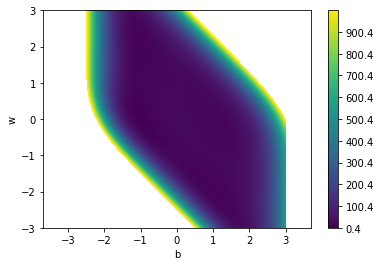

In [20]:
Min = np.min((Loss))
Max = Min+1000.
levels = np.arange(Min, Max, (Max-Min)/1000) 
plt.figure()
cb=plt.contourf(Wp, Bp, (Loss), levels=levels)
cbar=plt.colorbar(cb)
plt.xlabel("b")
plt.ylabel("w")
plt.axis('equal')
plt.show()

# Apprentissage

In [35]:
Nb_tirages = 1000

WEIGHTS = []
WEIGHTS_INIT=[]
for it in range(Nb_tirages):
  # Nouvelle initialisation
  w = 6 * np.random.random() - 3
  b = 6 * np.random.random() - 3
  WEIGHTS_INIT.append([w,b])
  params_init = [w, w, b, b]
  # Début du modèle
  model = build_poly(activation,loss,name_init,params_init,seed); 
  model_copy = build_poly(activation,loss,name_init,params_init,seed)
  # entrainement
  model, epoch, norme_grad, cost, temps = train(algo,model,model_copy,loss,x_train,y_train,eps,max_epochs,lr,seuil,f1,f2,rho,eps_egd,lambd,beta_1,beta_2,epsilon,amsgrad)
  print(it, model.get_weights())
  WEIGHTS.append(model.get_weights())
  print("temps: ", temps)


Training loss (for one batch) at step 2: 24.05752594
grad:  tf.Tensor(86.72749121629737, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12.42553300
grad:  tf.Tensor(22.587996439412606, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 9.41181881
grad:  tf.Tensor(20.46839727706916, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 7.91250743
grad:  tf.Tensor(33.8835198780236, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 5.06260176
grad:  tf.Tensor(39.120505743523, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1.43227178
grad:  tf.Tensor(26.628682929655263, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1.69432940
grad:  tf.Tensor(23.8528544866697, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 4.26404452
grad:  tf.Tensor(55.04510823318598, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 2.24539630
grad:  tf.Tensor(28.6532335267554, shap

Training loss (for one batch) at step 188: 0.00000005
grad:  tf.Tensor(0.005356017976685876, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000002
grad:  tf.Tensor(0.002784747025555407, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000007
grad:  tf.Tensor(0.006514257194260047, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000002
grad:  tf.Tensor(0.002996708007735451, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000002
grad:  tf.Tensor(0.003124791661871551, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000002
grad:  tf.Tensor(0.003707070464064035, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000000
grad:  tf.Tensor(0.0003709740016561123, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000002
grad:  tf.Tensor(0.0031439489522286593, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000001


Training loss (for one batch) at step 78: 8.39197764
grad:  tf.Tensor(9.190888219217745, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.37192172
grad:  tf.Tensor(9.127910589227257, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.35237547
grad:  tf.Tensor(9.031593688025119, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.33306028
grad:  tf.Tensor(8.888976157861213, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.31372883
grad:  tf.Tensor(8.69467170367518, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.29436331
grad:  tf.Tensor(8.45152944837372, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.27518175
grad:  tf.Tensor(8.169364346571825, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.25650368
grad:  tf.Tensor(7.862275609481352, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.23859090
grad:  tf.Tensor(7.545488900012465, s

Training loss (for one batch) at step 268: 8.00000001
grad:  tf.Tensor(0.0018077282688517976, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000001
grad:  tf.Tensor(0.0019390210923880182, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000001
grad:  tf.Tensor(0.0020244491663806755, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000002
grad:  tf.Tensor(0.0020704522148527983, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000002
grad:  tf.Tensor(0.0020818546496424663, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000001
grad:  tf.Tensor(0.002062750298102279, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000001
grad:  tf.Tensor(0.0020172201076059295, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000001
grad:  tf.Tensor(0.0019497250721745379, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.0000

Training loss (for one batch) at step 148: 16.00068225
grad:  tf.Tensor(0.11478298986252991, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00049347
grad:  tf.Tensor(0.10095331503845092, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00035085
grad:  tf.Tensor(0.08830597864334938, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00024345
grad:  tf.Tensor(0.07587546721505853, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00016341
grad:  tf.Tensor(0.0632791079626451, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00010502
grad:  tf.Tensor(0.05065142308398347, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00006386
grad:  tf.Tensor(0.038492668418891464, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00003627
grad:  tf.Tensor(0.027543622189550913, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00001895


Training loss (for one batch) at step 34: 17.50935422
grad:  tf.Tensor(22.09915317075413, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.05532546
grad:  tf.Tensor(25.513311348530262, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 14.12118338
grad:  tf.Tensor(28.07410904203368, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 11.76630435
grad:  tf.Tensor(27.699322994700253, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 9.44135685
grad:  tf.Tensor(20.732235483812396, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.16238568
grad:  tf.Tensor(3.427802132146384, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.82658844
grad:  tf.Tensor(23.936890426988, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.31839785
grad:  tf.Tensor(45.28456273201691, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.26406122
grad:  tf.Tensor(44.57981240

Training loss (for one batch) at step 216: 8.00000059
grad:  tf.Tensor(0.004451203415556918, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000043
grad:  tf.Tensor(0.007113664765835845, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000031
grad:  tf.Tensor(0.007737433393355224, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000019
grad:  tf.Tensor(0.005432691032237703, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000010
grad:  tf.Tensor(0.0019482010369890521, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000007
grad:  tf.Tensor(0.0023264817462941667, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000005
grad:  tf.Tensor(0.003313136077106468, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000002
grad:  tf.Tensor(0.0022454206166460486, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000

Training loss (for one batch) at step 92: 8.27533318
grad:  tf.Tensor(7.910725225515361, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.22571339
grad:  tf.Tensor(7.162236128418605, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.18275399
grad:  tf.Tensor(6.449937825541651, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.14589459
grad:  tf.Tensor(5.781661150093552, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.11461395
grad:  tf.Tensor(5.159948913802472, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.08844636
grad:  tf.Tensor(4.583175763194916, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.06694087
grad:  tf.Tensor(4.046911651680124, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.04961316
grad:  tf.Tensor(3.545361668920294, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.03592976
grad:  tf.Tensor(3.07279163681

Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.00022650027648365192, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.0002694811796378952, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.00029360261826901255, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00030134107753881435, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.0002962236197079018, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.0002820729455695304, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.00026230027025234083, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.00023946524007961443, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 

Training loss (for one batch) at step 158: 0.36100291
grad:  tf.Tensor(6.851173764953424, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.32770708
grad:  tf.Tensor(6.430332405192813, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.29747188
grad:  tf.Tensor(6.047841131288254, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.27004197
grad:  tf.Tensor(5.702740818684559, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.24514629
grad:  tf.Tensor(5.3915870752242885, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.22252017
grad:  tf.Tensor(5.109457956849757, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.20192022
grad:  tf.Tensor(4.850924777264586, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.18313240
grad:  tf.Tensor(4.610846283464353, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.16597439
grad:  tf.Tensor(4.384907

Training loss (for one batch) at step 38: 0.34147112
grad:  tf.Tensor(14.966757595102111, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.14607992
grad:  tf.Tensor(4.131214456029439, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.29230497
grad:  tf.Tensor(9.876691588744048, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.34200456
grad:  tf.Tensor(12.119578338589902, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.16093927
grad:  tf.Tensor(8.568751319181798, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.01054440
grad:  tf.Tensor(1.129990111507664, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.07404661
grad:  tf.Tensor(7.716638570536409, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.12910077
grad:  tf.Tensor(9.9782942247266, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.04580102
grad:  tf.Tensor(5.1115578486463065

Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.0012818831420943304, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000000
grad:  tf.Tensor(0.0006918464585728562, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.0012768577731009508, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00020200920964021468, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0009766440336903479, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.0007093940117781843, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.00045265456579549214, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.000895709679223415, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00

Training loss (for one batch) at step 104: 17.84575534
grad:  tf.Tensor(19.430189681484507, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 17.72828210
grad:  tf.Tensor(19.79354532522659, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 17.60510504
grad:  tf.Tensor(20.15996101852786, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 17.47601396
grad:  tf.Tensor(20.528409554467427, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 17.34080320
grad:  tf.Tensor(20.89771349276826, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 17.19927488
grad:  tf.Tensor(21.266528303806002, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 17.05124252
grad:  tf.Tensor(21.63332487793934, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.89653530
grad:  tf.Tensor(21.996371546572647, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.73500281
grad:  tf.Ten

Training loss (for one batch) at step 280: 9.61951892
grad:  tf.Tensor(4.5174219185062885, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 9.60778786
grad:  tf.Tensor(4.5088849419551496, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 9.59605153
grad:  tf.Tensor(4.500251125233129, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 9.58431098
grad:  tf.Tensor(4.4915197213559, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 9.57256718
grad:  tf.Tensor(4.482687720814945, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 9.56082111
grad:  tf.Tensor(4.473750793698597, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 9.54907373
grad:  tf.Tensor(4.464704073534762, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 9.53732601
grad:  tf.Tensor(4.455542754807547, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 9.52557893
grad:  tf.Tensor(4.4462625

Training loss (for one batch) at step 162: 8.00007842
grad:  tf.Tensor(0.1395938888153324, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00009415
grad:  tf.Tensor(0.15679667292206703, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00010478
grad:  tf.Tensor(0.1681411820939718, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00011017
grad:  tf.Tensor(0.1742643073323847, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00011072
grad:  tf.Tensor(0.1758348651688778, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00010718
grad:  tf.Tensor(0.17354073116187607, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00010049
grad:  tf.Tensor(0.16807279463429342, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00009160
grad:  tf.Tensor(0.16010646948646332, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00008143
grad:  tf.Tens

Training loss (for one batch) at step 42: 8.04382493
grad:  tf.Tensor(1.2497718844067531, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.14273759
grad:  tf.Tensor(7.802144139871789, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.33687632
grad:  tf.Tensor(12.573883427848193, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.44605285
grad:  tf.Tensor(14.426490460034307, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.41191515
grad:  tf.Tensor(13.948053003111731, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.27207253
grad:  tf.Tensor(11.519384260262612, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.11352105
grad:  tf.Tensor(7.487101241355668, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.01949000
grad:  tf.Tensor(2.447678359383262, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.01984629
grad:  tf.Tensor(2.76143799608

Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.001048869063209706, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0002971256680121618, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.000442649955372826, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0008539885180093304, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.0008208351048671694, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00043873150702845095, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(6.530413350570767e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.000443655802060988, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000

Training loss (for one batch) at step 120: 8.00000172
grad:  tf.Tensor(0.009467380032722099, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000371
grad:  tf.Tensor(0.036917551985318854, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000229
grad:  tf.Tensor(0.027294165110584297, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000055
grad:  tf.Tensor(0.005225029964365599, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000124
grad:  tf.Tensor(0.025903465845410204, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000077
grad:  tf.Tensor(0.021489313172340797, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000007
grad:  tf.Tensor(0.0012661323967057677, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000070
grad:  tf.Tensor(0.017293991681819, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000081
grad

Training loss (for one batch) at step 8: 471.50135649
grad:  tf.Tensor(1790.2877850005366, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 210.81671813
grad:  tf.Tensor(939.678366166042, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 94.60373933
grad:  tf.Tensor(489.5535557943528, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 43.87075777
grad:  tf.Tensor(251.0211522068907, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 22.39825258
grad:  tf.Tensor(123.7090363309696, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 13.88067547
grad:  tf.Tensor(55.220365074178105, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.01802749
grad:  tf.Tensor(18.42018454825866, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 10.54684409
grad:  tf.Tensor(5.404970511251676, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 11.01432545
grad:  tf.Tensor(14.2972

Training loss (for one batch) at step 200: 10.92205728
grad:  tf.Tensor(15.808180483855368, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 10.87075929
grad:  tf.Tensor(15.370561956525854, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 10.82181102
grad:  tf.Tensor(14.930868081443714, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 10.77519484
grad:  tf.Tensor(14.49017299809866, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 10.73088454
grad:  tf.Tensor(14.049572335286081, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 10.68884571
grad:  tf.Tensor(13.610177153944838, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 10.64903615
grad:  tf.Tensor(13.173107613240164, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 10.61140630
grad:  tf.Tensor(12.739486406192528, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 10.57589985
grad:  tf.

Training loss (for one batch) at step 90: 8.01839352
grad:  tf.Tensor(1.4469283319944766, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.01402456
grad:  tf.Tensor(0.644007124439413, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.01304393
grad:  tf.Tensor(0.8275288625289153, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.01359222
grad:  tf.Tensor(1.3501638545687094, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.01352351
grad:  tf.Tensor(1.5837359780894091, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.01195890
grad:  tf.Tensor(1.4796514966264218, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00949757
grad:  tf.Tensor(1.1183570104749307, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00730262
grad:  tf.Tensor(0.6527352584467132, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00607235
grad:  tf.Tensor(0.37935

Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(8.517664990018212e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(9.492991286543072e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.000130788256714161, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.0001343534562991821, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00010552651448886435, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(7.052748267494297e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(6.786179240592254e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(8.34184978571407e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.0000

Training loss (for one batch) at step 156: 16.85571276
grad:  tf.Tensor(7.197533757159239, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.84507398
grad:  tf.Tensor(7.106819502421872, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.83462978
grad:  tf.Tensor(7.0173528135085395, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.82437707
grad:  tf.Tensor(6.92912967428015, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.81431275
grad:  tf.Tensor(6.842145614706032, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.80443370
grad:  tf.Tensor(6.7563957209338845, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.79473679
grad:  tf.Tensor(6.671874647151284, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.78521888
grad:  tf.Tensor(6.588576628763516, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.77587683
grad:  tf.Tensor

Training loss (for one batch) at step 36: 16.00984423
grad:  tf.Tensor(0.8193020349872407, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.01171627
grad:  tf.Tensor(1.1879652867980381, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.04316275
grad:  tf.Tensor(2.1085437301561707, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.04196851
grad:  tf.Tensor(1.836085838665405, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.02479053
grad:  tf.Tensor(0.8476098679998841, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.02885540
grad:  tf.Tensor(1.0637589948110635, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.03939215
grad:  tf.Tensor(1.6850347961511192, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.02801108
grad:  tf.Tensor(1.3883477980539152, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.01035765
grad:  tf.Tensor(0.

Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.00020357843283891992, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(2.6211568488857423e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.0001532330497442396, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(9.99271290085175e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(8.047177885194314e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.00011974217537677226, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(3.8883620446044734e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(9.374456536226932e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 102: 9.96044800
grad:  tf.Tensor(6.5725639024293745, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 9.90868368
grad:  tf.Tensor(6.52878827489878, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 9.85699662
grad:  tf.Tensor(6.483274248867361, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 9.80543265
grad:  tf.Tensor(6.4358565201907725, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 9.75403699
grad:  tf.Tensor(6.3863686468261855, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 9.70285511
grad:  tf.Tensor(6.334659188535275, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 9.65193335
grad:  tf.Tensor(6.280602786173822, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 9.60131916
grad:  tf.Tensor(6.2241067457903805, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 9.55106109
grad:  tf.Tensor(6.1651

Training loss (for one batch) at step 288: 8.00413052
grad:  tf.Tensor(0.4034680314376371, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00370627
grad:  tf.Tensor(0.38238952329504, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00332274
grad:  tf.Tensor(0.3622481014749699, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00297635
grad:  tf.Tensor(0.34301272484308876, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00266380
grad:  tf.Tensor(0.3246526818419396, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00238203
grad:  tf.Tensor(0.3071376396413867, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00212825
grad:  tf.Tensor(0.2904376890606592, shape=(), dtype=float64)
15 [array([[1.9859871]]), array([-0.99774261])]
temps:  1.007197618484497
Training loss (for one batch) at step 2: 166.63111597
grad:  tf.Tensor(563.7232225951366, shape=(), dtype=float64)


Training loss (for one batch) at step 168: 8.00000824
grad:  tf.Tensor(0.04266918563737678, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000726
grad:  tf.Tensor(0.04213687474849606, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000575
grad:  tf.Tensor(0.03931230223362994, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000407
grad:  tf.Tensor(0.034343498647920516, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000250
grad:  tf.Tensor(0.027597522430996422, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000124
grad:  tf.Tensor(0.019692894297371057, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000042
grad:  tf.Tensor(0.011430868388650364, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000005
grad:  tf.Tensor(0.0036612325722728354, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000003
grad

Training loss (for one batch) at step 48: 17.88579186
grad:  tf.Tensor(33.43485628273761, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 17.70261638
grad:  tf.Tensor(33.87389443854578, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 17.48943128
grad:  tf.Tensor(34.38055061235811, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 17.24787037
grad:  tf.Tensor(34.94440946662544, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.97901879
grad:  tf.Tensor(35.55637923434794, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.68353206
grad:  tf.Tensor(36.20831622371991, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.36173051
grad:  tf.Tensor(36.892692831937545, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.01367697
grad:  tf.Tensor(37.60229974030893, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 15.63924353
grad:  tf.Tensor(38.32997

Training loss (for one batch) at step 234: 0.00047041
grad:  tf.Tensor(0.22775086828197408, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00043047
grad:  tf.Tensor(0.21877363950269105, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00039381
grad:  tf.Tensor(0.21023627930540828, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00036008
grad:  tf.Tensor(0.20191685816968763, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00032898
grad:  tf.Tensor(0.19367258861811226, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00030029
grad:  tf.Tensor(0.18543729902491615, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00027384
grad:  tf.Tensor(0.1772084697624958, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00024947
grad:  tf.Tensor(0.16902905761613934, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00022707
grad:  tf.T

Training loss (for one batch) at step 114: 16.00000688
grad:  tf.Tensor(0.0287418816425888, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000362
grad:  tf.Tensor(0.021111235233721073, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00000102
grad:  tf.Tensor(0.011149867510925806, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00000459
grad:  tf.Tensor(0.023590513440727937, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00000027
grad:  tf.Tensor(0.0042824361869112605, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000242
grad:  tf.Tensor(0.017306235766122523, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000137
grad:  tf.Tensor(0.013018083581915025, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000040
grad:  tf.Tensor(0.006913909410829197, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.000

Training loss (for one batch) at step 10: 41.35482900
grad:  tf.Tensor(163.29948418406263, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 22.78950680
grad:  tf.Tensor(87.78372095747832, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 13.06665994
grad:  tf.Tensor(42.80019825213895, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 7.63824148
grad:  tf.Tensor(22.079449959429436, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 4.11558330
grad:  tf.Tensor(21.87183058720541, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 1.57135637
grad:  tf.Tensor(22.378181723721912, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.25622940
grad:  tf.Tensor(12.540955845694327, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 0.94009351
grad:  tf.Tensor(12.927582077249067, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 2.61059976
grad:  tf.Tensor(30.3097035

Training loss (for one batch) at step 192: 0.00000238
grad:  tf.Tensor(0.020571243307090707, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000138
grad:  tf.Tensor(0.01727515100945948, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000074
grad:  tf.Tensor(0.015695834670057508, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000036
grad:  tf.Tensor(0.013133329617932543, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000012
grad:  tf.Tensor(0.00790039567750655, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000001
grad:  tf.Tensor(0.0015325026480919345, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000002
grad:  tf.Tensor(0.003961378305272216, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000006
grad:  tf.Tensor(0.005999912731076381, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000010
gra

Training loss (for one batch) at step 76: 16.00209184
grad:  tf.Tensor(0.21396616039944596, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00190634
grad:  tf.Tensor(0.25309017260446925, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00169320
grad:  tf.Tensor(0.31511510987410385, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00072578
grad:  tf.Tensor(0.1926614992835959, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00015820
grad:  tf.Tensor(0.06938521197046874, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00028965
grad:  tf.Tensor(0.19021642747861625, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00026540
grad:  tf.Tensor(0.17020485200688232, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00016600
grad:  tf.Tensor(0.059993270925412054, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00036119
grad:  tf.

Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(1.1279588138712269e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(1.937235158984356e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(1.099561198826553e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(8.90550595068877e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(1.3424611656135108e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(5.546988663419503e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(1.2429235164521256e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(7.324396496694994e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 150: 0.00000135
grad:  tf.Tensor(0.03192830937823894, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000007
grad:  tf.Tensor(0.004971969136254726, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000088
grad:  tf.Tensor(0.024151633000214646, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000023
grad:  tf.Tensor(0.011073294526857924, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000038
grad:  tf.Tensor(0.016755901719772412, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000027
grad:  tf.Tensor(0.014286656601435185, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000011
grad:  tf.Tensor(0.009233723448411208, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000029
grad:  tf.Tensor(0.014546201187206962, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000004
gra

Training loss (for one batch) at step 28: 8.80344136
grad:  tf.Tensor(11.657532224411142, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 9.06182154
grad:  tf.Tensor(13.5093439066176, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 9.17916823
grad:  tf.Tensor(14.19439249712363, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 9.14979890
grad:  tf.Tensor(13.95242820661861, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 9.00399023
grad:  tf.Tensor(12.92746606514314, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.79146438
grad:  tf.Tensor(11.218612125960748, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.56799581
grad:  tf.Tensor(8.936559550036883, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.38283833
grad:  tf.Tensor(6.282214785669065, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.26686559
grad:  tf.Tensor(3.749400510607146

Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0010082213834407899, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00113254719103688, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0009180901037177328, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0004815495822820211, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(3.628916862616999e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0004162843858236697, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00062260648915546, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.000612359818549207, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000

Training loss (for one batch) at step 102: 8.00000116
grad:  tf.Tensor(0.026383920938741506, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00005286
grad:  tf.Tensor(0.176959613420399, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00000265
grad:  tf.Tensor(0.022901256656589836, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00003759
grad:  tf.Tensor(0.14469514212336618, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00000456
grad:  tf.Tensor(0.02425868399029312, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00002608
grad:  tf.Tensor(0.11611457827990566, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00000407
grad:  tf.Tensor(0.027272145343517816, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00001631
grad:  tf.Tensor(0.09315939869271953, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00000259
grad:  tf

Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.257361182078555e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.7761905568909158e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(6.481105852682957e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(8.403485611811173e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(1.3106945381098454e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(5.650010633965759e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(5.218747239989671e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(9.640618571333257e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.0

Training loss (for one batch) at step 154: 0.00001131
grad:  tf.Tensor(0.08580575168667487, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000803
grad:  tf.Tensor(0.07397415452158296, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000171
grad:  tf.Tensor(0.03383782095311058, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000023
grad:  tf.Tensor(0.013135387031742725, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000289
grad:  tf.Tensor(0.04588358017938968, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000404
grad:  tf.Tensor(0.053366158570854416, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000215
grad:  tf.Tensor(0.03694718187915945, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000043
grad:  tf.Tensor(0.009377349134629264, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000084
grad:  

Training loss (for one batch) at step 28: 19.70110578
grad:  tf.Tensor(7.94410995432704, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 19.78481663
grad:  tf.Tensor(7.889451731864893, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 19.83047589
grad:  tf.Tensor(7.890098807606529, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 19.84394664
grad:  tf.Tensor(7.949131787665427, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 19.82936374
grad:  tf.Tensor(8.060559298128736, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 19.78952212
grad:  tf.Tensor(8.21357422913321, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 19.72627244
grad:  tf.Tensor(8.394917484398807, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 19.64086598
grad:  tf.Tensor(8.590111625018706, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 19.53424405
grad:  tf.Tensor(8.784093594

Training loss (for one batch) at step 218: 16.00006607
grad:  tf.Tensor(0.03683343263319528, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00005481
grad:  tf.Tensor(0.03353607489715983, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00004537
grad:  tf.Tensor(0.030454576994558787, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00003745
grad:  tf.Tensor(0.02758834000910802, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00003085
grad:  tf.Tensor(0.02493660946681473, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00002534
grad:  tf.Tensor(0.0224969186417713, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00002076
grad:  tf.Tensor(0.020264120102971614, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00001697
grad:  tf.Tensor(0.018230051412844145, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00001383

Training loss (for one batch) at step 100: 8.02297247
grad:  tf.Tensor(1.6374371924427567, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.02844322
grad:  tf.Tensor(2.7564734501895543, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.03258788
grad:  tf.Tensor(3.3146808728863317, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.03158045
grad:  tf.Tensor(3.293800524499142, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.02626089
grad:  tf.Tensor(2.7940444247726326, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.02008512
grad:  tf.Tensor(1.9853337742128423, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.01615410
grad:  tf.Tensor(1.1046573691081611, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.01530215
grad:  tf.Tensor(0.6075608478841089, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.01616658
grad:  tf.Tensor(0.

Training loss (for one batch) at step 284: 8.00004002
grad:  tf.Tensor(0.037747576121409936, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00003662
grad:  tf.Tensor(0.03614533019134953, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00003348
grad:  tf.Tensor(0.03463233656374729, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00003060
grad:  tf.Tensor(0.03317808751444674, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00002796
grad:  tf.Tensor(0.03175797732958631, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00002553
grad:  tf.Tensor(0.03035970487226872, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00002330
grad:  tf.Tensor(0.028984665286925657, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00002126
grad:  tf.Tensor(0.027644476025726054, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00001938
grad:  

Training loss (for one batch) at step 158: 8.00000073
grad:  tf.Tensor(0.015100686805910908, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000095
grad:  tf.Tensor(0.01653690834470103, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000007
grad:  tf.Tensor(0.0021964809654101756, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000046
grad:  tf.Tensor(0.012604126481266489, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000046
grad:  tf.Tensor(0.012456932912725531, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000001
grad:  tf.Tensor(0.0006346323041387844, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000028
grad:  tf.Tensor(0.009875298056256959, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000024
grad:  tf.Tensor(0.009022076010315655, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000001
g

Training loss (for one batch) at step 32: 10.03628740
grad:  tf.Tensor(18.206074219548128, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 10.14765145
grad:  tf.Tensor(16.227955627041574, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.26886083
grad:  tf.Tensor(14.959799873153942, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.38558666
grad:  tf.Tensor(14.16222578169079, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 10.49112991
grad:  tf.Tensor(13.672423828397218, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 10.58288065
grad:  tf.Tensor(13.381713398329245, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 10.66038707
grad:  tf.Tensor(13.21886405618176, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 10.72429262
grad:  tf.Tensor(13.137802739963632, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.77574931
grad:  tf.Tensor(13.

Training loss (for one batch) at step 212: 6.67323838
grad:  tf.Tensor(20.597222635889487, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 6.56433329
grad:  tf.Tensor(20.64239086602481, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 6.45419418
grad:  tf.Tensor(20.680719486933747, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 6.34288239
grad:  tf.Tensor(20.711901110460705, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 6.23046428
grad:  tf.Tensor(20.735634556047568, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 6.11701130
grad:  tf.Tensor(20.751626731160385, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 6.00259994
grad:  tf.Tensor(20.75959461889948, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 5.88731169
grad:  tf.Tensor(20.759267363032546, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 5.77123296
grad:  tf.Tensor(20.

Training loss (for one batch) at step 86: 8.00039628
grad:  tf.Tensor(0.2764393631184878, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00217903
grad:  tf.Tensor(1.0707497570049898, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00076999
grad:  tf.Tensor(0.5346034492757321, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00070091
grad:  tf.Tensor(0.5027781080780649, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00122822
grad:  tf.Tensor(0.7690731753597521, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00020146
grad:  tf.Tensor(0.13136171471614824, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00063715
grad:  tf.Tensor(0.5613875232041785, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00041789
grad:  tf.Tensor(0.45749347668062845, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00008640
grad:  tf.Tensor(0.1682

Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(1.3163851200595307e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(5.703782073097404e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(5.3775299006914375e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(4.695594022035864e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.9446318636108944e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(3.796461632181534e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(6.050006119464465e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(3.0345617364188148e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8

Training loss (for one batch) at step 160: 0.00000007
grad:  tf.Tensor(0.004285213906718823, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000024
grad:  tf.Tensor(0.005854583316431907, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000022
grad:  tf.Tensor(0.0071287635215929535, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000004
grad:  tf.Tensor(0.0031948651245224838, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000002
grad:  tf.Tensor(0.0024512566706351743, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000012
grad:  tf.Tensor(0.005205946643104113, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000009
grad:  tf.Tensor(0.003752345033565386, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000002
grad:  tf.Tensor(0.0016474312072045408, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.0000000

Training loss (for one batch) at step 46: 16.33631176
grad:  tf.Tensor(2.673897042107875, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.27710912
grad:  tf.Tensor(2.4314092353953023, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.21232232
grad:  tf.Tensor(2.2735544213684085, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.16082928
grad:  tf.Tensor(2.3734779852090524, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.13300068
grad:  tf.Tensor(2.7577252602341678, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.12433461
grad:  tf.Tensor(3.1983121888380044, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.12065633
grad:  tf.Tensor(3.4396952808168773, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.11046741
grad:  tf.Tensor(3.354315225982946, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.09300960
grad:  tf.Tensor(2.9

Training loss (for one batch) at step 234: 16.00002148
grad:  tf.Tensor(0.03138733348657619, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00001893
grad:  tf.Tensor(0.029491669864807515, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00001667
grad:  tf.Tensor(0.0277349086336499, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00001466
grad:  tf.Tensor(0.02607550053319405, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00001288
grad:  tf.Tensor(0.024479607103268783, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00001131
grad:  tf.Tensor(0.02293300527637528, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000992
grad:  tf.Tensor(0.0214422411071809, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000869
grad:  tf.Tensor(0.020026027573729947, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000761


Training loss (for one batch) at step 110: 16.03309697
grad:  tf.Tensor(1.090669222644224, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.03073398
grad:  tf.Tensor(1.014413557929195, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.02846016
grad:  tf.Tensor(0.9358093365416753, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.02633790
grad:  tf.Tensor(0.8588931072984879, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.02440353
grad:  tf.Tensor(0.7870606659723922, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.02267092
grad:  tf.Tensor(0.7229460366264514, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.02113631
grad:  tf.Tensor(0.6682907894983416, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.01978370
grad:  tf.Tensor(0.6238352846048894, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.01858975
grad:  tf.T

Training loss (for one batch) at step 288: 16.00004625
grad:  tf.Tensor(0.029120398971395504, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00004202
grad:  tf.Tensor(0.0277589717421764, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00003816
grad:  tf.Tensor(0.026453879209468515, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00003464
grad:  tf.Tensor(0.02520318463315795, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00003142
grad:  tf.Tensor(0.02400499678315749, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00002849
grad:  tf.Tensor(0.022857469168876432, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00002582
grad:  tf.Tensor(0.021758799653966855, shape=(), dtype=float64)
32 [array([[0.00196257]]), array([0.99877112])]
temps:  1.0266368389129639
Training loss (for one batch) at step 2: 130.89884355
grad:  tf.Tensor(449.83676472707765, shape

Training loss (for one batch) at step 162: 8.28162116
grad:  tf.Tensor(3.1455155286889247, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.23431572
grad:  tf.Tensor(2.9842692728848697, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.19293935
grad:  tf.Tensor(2.807973846622125, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.15652661
grad:  tf.Tensor(2.583369339425116, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.12476247
grad:  tf.Tensor(2.3080274310318747, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.09768705
grad:  tf.Tensor(2.005285726632485, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.07532336
grad:  tf.Tensor(1.712687190404481, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.05742495
grad:  tf.Tensor(1.4669930438273904, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.04342980
grad:  tf.Tensor(1.287

Training loss (for one batch) at step 36: 0.10970049
grad:  tf.Tensor(8.710617937602263, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.03842816
grad:  tf.Tensor(2.5746050089848342, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.12280343
grad:  tf.Tensor(7.874233113252441, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.08624555
grad:  tf.Tensor(6.876893726380892, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.00414991
grad:  tf.Tensor(0.8260321909734004, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.04240637
grad:  tf.Tensor(5.795864954139054, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.04784908
grad:  tf.Tensor(5.991907624018248, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.00444418
grad:  tf.Tensor(0.8727341443271533, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.02758250
grad:  tf.Tensor(4.2685523874399

Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.0010094057461706833, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
grad:  tf.Tensor(0.0004549805871765899, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.0007993486019022922, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000000
grad:  tf.Tensor(0.00038112206047673247, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.0007011220953208078, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.0002573013914910122, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0006025672206442275, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.00017709593645003963, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.0

Training loss (for one batch) at step 90: 16.00289698
grad:  tf.Tensor(0.3095291010557464, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00293969
grad:  tf.Tensor(0.28521847959919155, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00273235
grad:  tf.Tensor(0.27733522910834696, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00235815
grad:  tf.Tensor(0.28263715916367566, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00196437
grad:  tf.Tensor(0.294759977109837, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00159864
grad:  tf.Tensor(0.2959706313646194, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00123130
grad:  tf.Tensor(0.27068291241581693, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00087079
grad:  tf.Tensor(0.21915274358579945, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00057308
grad:  tf.

Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(2.822785303909618e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(2.4079418049072353e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(1.3866874478657407e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(1.6327622434325812e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(9.051075414854988e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(1.2211031116711137e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(1.1210206126328408e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(1.0489967040623852e-05, shape=(), dtype=float64)
Training loss (for one batch) at s

Training loss (for one batch) at step 144: 16.00000071
grad:  tf.Tensor(0.005630162170132339, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000006
grad:  tf.Tensor(0.0022689428972868975, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000020
grad:  tf.Tensor(0.0031013353084815357, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000061
grad:  tf.Tensor(0.004454206416690602, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000074
grad:  tf.Tensor(0.0036987602211093155, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000068
grad:  tf.Tensor(0.00437131535806766, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000033
grad:  tf.Tensor(0.0026098683932275777, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000010
grad:  tf.Tensor(0.0021428648622191598, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1

Training loss (for one batch) at step 38: 24.38773941
grad:  tf.Tensor(40.11486376039883, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 23.70428033
grad:  tf.Tensor(36.45042897185958, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 23.17450313
grad:  tf.Tensor(33.5426731625966, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 22.75809911
grad:  tf.Tensor(31.20815172018154, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 22.42656023
grad:  tf.Tensor(29.313645988291388, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 22.15937835
grad:  tf.Tensor(27.760771441520294, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.94156846
grad:  tf.Tensor(26.475759261923983, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.76202409
grad:  tf.Tensor(25.40254329197676, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 21.61240585
grad:  tf.Tensor(24.4979

Training loss (for one batch) at step 218: 19.35578880
grad:  tf.Tensor(9.640744355017473, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 19.34353358
grad:  tf.Tensor(9.553420709021024, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 19.33143979
grad:  tf.Tensor(9.467316441802605, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 19.31950477
grad:  tf.Tensor(9.382421382238315, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 19.30772586
grad:  tf.Tensor(9.298725309143046, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 19.29610044
grad:  tf.Tensor(9.21621795742913, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 19.28462589
grad:  tf.Tensor(9.13488902387056, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 19.27329963
grad:  tf.Tensor(9.054728172492286, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 19.26211910
grad:  tf.Tensor(8.

Training loss (for one batch) at step 92: 5.19907643
grad:  tf.Tensor(40.319909262045954, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 5.10410950
grad:  tf.Tensor(40.067724160212535, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 5.00857323
grad:  tf.Tensor(39.80565694497722, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 4.91265762
grad:  tf.Tensor(39.5338661463478, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 4.81653140
grad:  tf.Tensor(39.25249146992954, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 4.72034565
grad:  tf.Tensor(38.96165920652481, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 4.62423681
grad:  tf.Tensor(38.66148686031603, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 4.52832905
grad:  tf.Tensor(38.35208712759945, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 4.43273629
grad:  tf.Tensor(38.033571330

Training loss (for one batch) at step 272: 0.77100386
grad:  tf.Tensor(8.944593071730884, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.76204420
grad:  tf.Tensor(8.846524056851447, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.75324921
grad:  tf.Tensor(8.753180426842029, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.74460831
grad:  tf.Tensor(8.664265251330788, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.73611170
grad:  tf.Tensor(8.579491272547966, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.72775032
grad:  tf.Tensor(8.498581727348695, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.71951579
grad:  tf.Tensor(8.421271001868933, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.71140042
grad:  tf.Tensor(8.347305126875103, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.70339712
grad:  tf.Tensor(8.2764421

Training loss (for one batch) at step 146: 0.00024710
grad:  tf.Tensor(0.26200256802763733, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00018281
grad:  tf.Tensor(0.2267068063605559, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00012528
grad:  tf.Tensor(0.18885511326158305, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00007828
grad:  tf.Tensor(0.14712311810203849, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00004327
grad:  tf.Tensor(0.11106103533393673, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00001989
grad:  tf.Tensor(0.07520617342256997, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000651
grad:  tf.Tensor(0.04196598191884665, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000079
grad:  tf.Tensor(0.015772648411962926, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000025
grad:  tf.

Training loss (for one batch) at step 26: 8.01941810
grad:  tf.Tensor(3.0733965111936072, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.03571460
grad:  tf.Tensor(4.240954638256812, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.03045044
grad:  tf.Tensor(3.912040702566429, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.01171274
grad:  tf.Tensor(2.31009283468284, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.02628924
grad:  tf.Tensor(3.9156604109625266, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.00344409
grad:  tf.Tensor(1.1768547541482375, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.01921142
grad:  tf.Tensor(3.2891887522494265, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.00019223
grad:  tf.Tensor(0.23162156410542464, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.01304642
grad:  tf.Tensor(2.85236136373

Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.00039054751750828805, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0004193782237705468, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00023082561540008025, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(3.889371618929321e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0002336898651387445, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00028218112249714855, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00018703096448857934, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(2.6301070007178993e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 

Training loss (for one batch) at step 90: 8.02922279
grad:  tf.Tensor(0.8311099945891814, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.03203031
grad:  tf.Tensor(2.5827626370553087, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.03674886
grad:  tf.Tensor(3.4721750651009913, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.02868209
grad:  tf.Tensor(2.7641125455845064, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.01912580
grad:  tf.Tensor(1.1867718804574718, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.01858761
grad:  tf.Tensor(0.8515953268778558, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.02032801
grad:  tf.Tensor(1.4604571752695408, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.01688019
grad:  tf.Tensor(1.1999596887592623, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.01186338
grad:  tf.Tensor(0.5177

Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.00023812472001747014, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00036894609846729355, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.00022021244650256085, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(6.804510970831272e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.000202596666878842, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.00012932355183853538, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(5.3557646417687006e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.00015973134796467043, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 

Training loss (for one batch) at step 142: 0.00000151
grad:  tf.Tensor(0.02155072125571292, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000065
grad:  tf.Tensor(0.009611797242744835, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000064
grad:  tf.Tensor(0.02150478641257381, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000006
grad:  tf.Tensor(0.0032915676870458113, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000065
grad:  tf.Tensor(0.01858219457211516, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000039
grad:  tf.Tensor(0.008396393997931366, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000023
grad:  tf.Tensor(0.00961838367869266, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000015
grad:  tf.Tensor(0.010297766246693096, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000010
grad:

Training loss (for one batch) at step 16: 55.71128889
grad:  tf.Tensor(211.733552873907, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 35.80721602
grad:  tf.Tensor(145.19805541880757, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 23.84145123
grad:  tf.Tensor(100.73431389861135, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.79119925
grad:  tf.Tensor(70.53802891202317, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 12.75230224
grad:  tf.Tensor(49.677194093645, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.51893464
grad:  tf.Tensor(35.00519060007912, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 9.33334293
grad:  tf.Tensor(24.48840008212094, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.72986994
grad:  tf.Tensor(16.801289168969674, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.43300295
grad:  tf.Tensor(11.077287055

Training loss (for one batch) at step 196: 8.00021803
grad:  tf.Tensor(0.24863414873324094, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00017496
grad:  tf.Tensor(0.22251324972521594, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00013974
grad:  tf.Tensor(0.19854979921225685, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00011105
grad:  tf.Tensor(0.17670426809032544, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00008779
grad:  tf.Tensor(0.15690773860890497, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00006902
grad:  tf.Tensor(0.13905072855536849, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00005393
grad:  tf.Tensor(0.1229855538263238, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00004188
grad:  tf.Tensor(0.10853908834774227, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00003231
grad:  tf.T

Training loss (for one batch) at step 70: 10.10912027
grad:  tf.Tensor(7.238105460954897, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.06169985
grad:  tf.Tensor(7.095545666362388, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 10.01430342
grad:  tf.Tensor(6.961839352494778, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 9.96717433
grad:  tf.Tensor(6.83953234651761, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 9.92045698
grad:  tf.Tensor(6.729740999170146, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 9.87421894
grad:  tf.Tensor(6.632416753614116, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 9.82847224
grad:  tf.Tensor(6.546639598095376, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 9.78319236
grad:  tf.Tensor(6.470907351648984, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 9.73833427
grad:  tf.Tensor(6.40339549493097

Training loss (for one batch) at step 250: 8.01578585
grad:  tf.Tensor(0.7811651520453478, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.01439774
grad:  tf.Tensor(0.7466961770532833, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.01312086
grad:  tf.Tensor(0.7134299892079945, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.01194738
grad:  tf.Tensor(0.6813432642739043, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.01086993
grad:  tf.Tensor(0.6504120023914446, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00988155
grad:  tf.Tensor(0.6206116114967206, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00897570
grad:  tf.Tensor(0.5919169883992483, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00814625
grad:  tf.Tensor(0.5643025972252343, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00738744
grad:  tf.Tensor(0

Training loss (for one batch) at step 124: 16.00000094
grad:  tf.Tensor(0.008409478951934534, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000557
grad:  tf.Tensor(0.02089645295518408, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000486
grad:  tf.Tensor(0.012477126676551624, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000515
grad:  tf.Tensor(0.012910496233191768, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000469
grad:  tf.Tensor(0.015724856818410966, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000146
grad:  tf.Tensor(0.0056163390619704745, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000098
grad:  tf.Tensor(0.00987367197373366, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000066
grad:  tf.Tensor(0.008990268526053242, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.000

Training loss (for one batch) at step 20: 16.14997019
grad:  tf.Tensor(3.4694780556042804, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.22671640
grad:  tf.Tensor(3.1638952851596294, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.24421169
grad:  tf.Tensor(2.1401150009270573, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.27610724
grad:  tf.Tensor(2.52778538066382, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.35576629
grad:  tf.Tensor(3.983756439025201, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.44743794
grad:  tf.Tensor(5.0834256757662395, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.50273395
grad:  tf.Tensor(5.498299028137076, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.50777730
grad:  tf.Tensor(5.263050428240531, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.48474699
grad:  tf.Tensor(4.5745

Training loss (for one batch) at step 200: 16.00000002
grad:  tf.Tensor(0.0007185980046690957, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000001
grad:  tf.Tensor(0.0005329064298776619, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.0004765759576860021, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(0.00042140012367768766, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.000201232902440087, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.00019344958536048515, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(0.00045527550232594115, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.0005390287729915788, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 74: 1.05591232
grad:  tf.Tensor(13.498017770874876, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.97611747
grad:  tf.Tensor(12.373168940821976, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.89566364
grad:  tf.Tensor(11.872004591079492, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.81436281
grad:  tf.Tensor(11.909190995544163, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.73822720
grad:  tf.Tensor(12.155466779302609, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.66806303
grad:  tf.Tensor(12.18655270032689, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.60043271
grad:  tf.Tensor(11.741427046972643, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.53522647
grad:  tf.Tensor(10.870013627065674, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.47511184
grad:  tf.Tensor(9.859756955

Training loss (for one batch) at step 254: 0.00000002
grad:  tf.Tensor(0.0021533471168715796, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000001
grad:  tf.Tensor(0.0018616239756825011, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000001
grad:  tf.Tensor(0.00150193291929941, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(0.0010858453629831355, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000000
grad:  tf.Tensor(0.0007202994092575483, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(0.0004689574408888253, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(0.0003090191203337594, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.00018301395526127296, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.0000

Training loss (for one batch) at step 128: 0.00000224
grad:  tf.Tensor(0.03899268360599553, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000769
grad:  tf.Tensor(0.031222573501414427, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00001317
grad:  tf.Tensor(0.04507924752654216, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000826
grad:  tf.Tensor(0.03593219318434195, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000143
grad:  tf.Tensor(0.017291154197330686, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00000115
grad:  tf.Tensor(0.023710431407504128, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000355
grad:  tf.Tensor(0.019757818271304715, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000489
grad:  tf.Tensor(0.028661848086757882, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000218
grad:

Training loss (for one batch) at step 2: 107.58880402
grad:  tf.Tensor(562.5891802897459, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 23.08104919
grad:  tf.Tensor(148.02138031818805, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.74354339
grad:  tf.Tensor(10.675711057819802, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 10.81613638
grad:  tf.Tensor(30.454452089599314, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 14.89788928
grad:  tf.Tensor(40.17576214165872, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.17315842
grad:  tf.Tensor(41.58728214229188, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 20.39907855
grad:  tf.Tensor(41.00830173850171, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 21.76839113
grad:  tf.Tensor(40.10776251503154, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 22.48478447
grad:  tf.Tensor(39.2303063

Training loss (for one batch) at step 182: 8.00001717
grad:  tf.Tensor(0.03728613276662429, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00001588
grad:  tf.Tensor(0.03816655660713419, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00001400
grad:  tf.Tensor(0.03321470297651947, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00001201
grad:  tf.Tensor(0.024826707908787826, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00001040
grad:  tf.Tensor(0.017030612293650802, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000932
grad:  tf.Tensor(0.015063628700216014, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000860
grad:  tf.Tensor(0.01819150581776456, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000797
grad:  tf.Tensor(0.020842005120722, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000724
grad:  tf

Training loss (for one batch) at step 62: 26.04178543
grad:  tf.Tensor(38.15304364218074, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 25.89670117
grad:  tf.Tensor(37.40636481970434, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 25.76650713
grad:  tf.Tensor(36.7341463428599, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 25.64848250
grad:  tf.Tensor(36.122951499428915, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 25.54044123
grad:  tf.Tensor(35.56191703185324, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 25.44062100
grad:  tf.Tensor(35.04223642245787, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 25.34759726
grad:  tf.Tensor(34.556755251575765, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 25.26021604
grad:  tf.Tensor(34.09965179574105, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 25.17754100
grad:  tf.Tensor(33.66618

Training loss (for one batch) at step 242: 21.77537012
grad:  tf.Tensor(14.208914245388197, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 21.75431008
grad:  tf.Tensor(14.069095528889827, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 21.73356804
grad:  tf.Tensor(13.930898895896808, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 21.71313914
grad:  tf.Tensor(13.794303449677226, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 21.69301861
grad:  tf.Tensor(13.659288537952834, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 21.67320174
grad:  tf.Tensor(13.525833754284077, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 21.65368387
grad:  tf.Tensor(13.39391893913458, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 21.63446041
grad:  tf.Tensor(13.263524180636143, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 21.61552684
grad:  tf.

Training loss (for one batch) at step 126: 3.66391926
grad:  tf.Tensor(38.24340457737276, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 3.50660089
grad:  tf.Tensor(37.72261513133436, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 3.35187230
grad:  tf.Tensor(37.18153309538849, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 3.19992353
grad:  tf.Tensor(36.62044093658139, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 3.05093804
grad:  tf.Tensor(36.03969702343249, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 2.90509182
grad:  tf.Tensor(35.439737715142655, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 2.76255249
grad:  tf.Tensor(34.82107900447268, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 2.62347836
grad:  tf.Tensor(34.184317664665, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 2.48801759
grad:  tf.Tensor(33.5301318

Training loss (for one batch) at step 4: 0.99117596
grad:  tf.Tensor(23.305666817254604, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 5.05857938
grad:  tf.Tensor(41.36650101035004, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 6.92584541
grad:  tf.Tensor(43.325568872383315, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 6.56153968
grad:  tf.Tensor(42.704712018905674, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 4.67433860
grad:  tf.Tensor(39.7687676300298, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 2.11272384
grad:  tf.Tensor(30.882819018822182, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 0.24805506
grad:  tf.Tensor(11.294445606959583, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.47269130
grad:  tf.Tensor(19.430792604302223, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 1.93289886
grad:  tf.Tensor(44.2273019069168

Training loss (for one batch) at step 190: 0.00000005
grad:  tf.Tensor(0.006283792917189115, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000004
grad:  tf.Tensor(0.005665669765959526, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000000
grad:  tf.Tensor(0.00039966610859719793, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000003
grad:  tf.Tensor(0.004376730575865197, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000002
grad:  tf.Tensor(0.004185319245539933, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000000
grad:  tf.Tensor(0.0002919027904458314, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000001
grad:  tf.Tensor(0.0031680169278966563, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000001
grad:  tf.Tensor(0.003108510927430085, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.0000000

Training loss (for one batch) at step 66: 9.27236010
grad:  tf.Tensor(17.91004175458715, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 9.25698918
grad:  tf.Tensor(17.966485925188994, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 9.23821899
grad:  tf.Tensor(18.02317951083863, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 9.21650973
grad:  tf.Tensor(18.080042907642376, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 9.19224529
grad:  tf.Tensor(18.137043961274486, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 9.16574493
grad:  tf.Tensor(18.194179401289205, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 9.13727338
grad:  tf.Tensor(18.251462446369736, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 9.10704952
grad:  tf.Tensor(18.308914558001497, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 9.07525390
grad:  tf.Tensor(18.366559999

Training loss (for one batch) at step 252: 3.53753070
grad:  tf.Tensor(18.803254707000825, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 3.46152875
grad:  tf.Tensor(18.666706735543677, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 3.38621894
grad:  tf.Tensor(18.526526572886905, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 3.31163705
grad:  tf.Tensor(18.382850112215717, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 3.23781755
grad:  tf.Tensor(18.23581986372556, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 3.16479348
grad:  tf.Tensor(18.085584375706965, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 3.09259640
grad:  tf.Tensor(17.93229761450502, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 3.02125630
grad:  tf.Tensor(17.776118308112434, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 2.95080154
grad:  tf.Tensor(17.

Training loss (for one batch) at step 124: 0.00004240
grad:  tf.Tensor(0.08268973952599569, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00001036
grad:  tf.Tensor(0.038419126695146584, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00009822
grad:  tf.Tensor(0.11054338500677949, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00014433
grad:  tf.Tensor(0.12641859680181247, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00009305
grad:  tf.Tensor(0.10128916423730576, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00002018
grad:  tf.Tensor(0.05463953961457285, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000193
grad:  tf.Tensor(0.014587955163213363, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00003227
grad:  tf.Tensor(0.0648076073149454, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00005066
grad:  tf

Training loss (for one batch) at step 2: 5081.90319334
grad:  tf.Tensor(12226.085016714764, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 2511.33234661
grad:  tf.Tensor(6889.887068372102, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1186.88955809
grad:  tf.Tensor(3758.61030238955, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 546.52571453
grad:  tf.Tensor(2015.2254646796766, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 249.10519053
grad:  tf.Tensor(1072.6472795691068, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 114.17279677
grad:  tf.Tensor(568.3745564345415, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 53.99895960
grad:  tf.Tensor(298.1713599533112, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 27.76976610
grad:  tf.Tensor(152.24949008419165, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.84788213
grad:  tf.Tensor(7

Training loss (for one batch) at step 180: 12.71369924
grad:  tf.Tensor(19.785107414718027, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 12.64681188
grad:  tf.Tensor(19.461662993803273, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 12.58153054
grad:  tf.Tensor(19.12901713500683, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 12.51791262
grad:  tf.Tensor(18.787593945571462, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 12.45601065
grad:  tf.Tensor(18.437859249567833, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 12.39587196
grad:  tf.Tensor(18.080319938688962, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 12.33753838
grad:  tf.Tensor(17.71552301670025, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 12.28104604
grad:  tf.Tensor(17.34405433177975, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 12.22642508
grad:  tf.Te

Training loss (for one batch) at step 52: 19.67368118
grad:  tf.Tensor(8.17310228717875, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 19.46268083
grad:  tf.Tensor(8.54966104564644, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 19.21777722
grad:  tf.Tensor(8.825749941121787, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 18.94085668
grad:  tf.Tensor(8.964704946713113, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.63683290
grad:  tf.Tensor(8.932317098467726, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 18.31399397
grad:  tf.Tensor(8.701929969767846, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 17.98379736
grad:  tf.Tensor(8.260081122893387, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 17.65996351
grad:  tf.Tensor(7.611830087392056, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 17.35689576
grad:  tf.Tensor(6.785177118

Training loss (for one batch) at step 226: 16.00000011
grad:  tf.Tensor(0.0022573413488617355, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000009
grad:  tf.Tensor(0.0022455838111151735, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000007
grad:  tf.Tensor(0.002036513135573861, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000004
grad:  tf.Tensor(0.0016724380733437161, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000002
grad:  tf.Tensor(0.001212795837986996, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000001
grad:  tf.Tensor(0.0007205787127447069, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.00026339040099161986, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(0.00021458890571823705, shape=(), dtype=float64)
Training loss (for one batch) at step 24

Training loss (for one batch) at step 98: 0.06562824
grad:  tf.Tensor(5.41219124659898, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.08503052
grad:  tf.Tensor(6.815137083696969, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.09458995
grad:  tf.Tensor(7.471415588038787, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.09095596
grad:  tf.Tensor(7.456388790249665, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.07622148
grad:  tf.Tensor(6.88120744950477, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.05546922
grad:  tf.Tensor(5.872485479060153, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.03439611
grad:  tf.Tensor(4.567527467732564, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.01749002
grad:  tf.Tensor(3.1124172563007506, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00702656
grad:  tf.Tensor(1.667925776

Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.0010691376595744712, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.0006686993005722652, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(0.0002543146594526454, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(0.000162937219238665, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(0.0004352896972170942, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(0.0006038374082125922, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.0006537097817074504, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.000598545207026573, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000

Training loss (for one batch) at step 144: 16.00033021
grad:  tf.Tensor(0.07928278565011355, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00031281
grad:  tf.Tensor(0.07561584428834864, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00028046
grad:  tf.Tensor(0.07262414216939443, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00023825
grad:  tf.Tensor(0.06914846395775437, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00019028
grad:  tf.Tensor(0.06329639583166863, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00014151
grad:  tf.Tensor(0.054497225001786526, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00009732
grad:  tf.Tensor(0.043928475929289584, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00006163
grad:  tf.Tensor(0.033772044669658566, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.0000356

Training loss (for one batch) at step 14: 577.16335096
grad:  tf.Tensor(1787.1482418752753, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 367.37419946
grad:  tf.Tensor(1196.4900583794229, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 244.99384481
grad:  tf.Tensor(827.8933118035861, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 171.42736681
grad:  tf.Tensor(592.7551189988156, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 125.77547072
grad:  tf.Tensor(439.10062391492215, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 96.52458997
grad:  tf.Tensor(336.1627123237172, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 77.19064614
grad:  tf.Tensor(265.47120072299384, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 64.03008574
grad:  tf.Tensor(215.74586811944457, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 54.82393623
grad:  tf.Tensor

Training loss (for one batch) at step 188: 19.90613346
grad:  tf.Tensor(27.639270781908255, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 19.85177659
grad:  tf.Tensor(27.329062412153043, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 19.79832685
grad:  tf.Tensor(27.022901625899955, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 19.74576981
grad:  tf.Tensor(26.720733653455014, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 19.69409119
grad:  tf.Tensor(26.42250411236624, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 19.64327684
grad:  tf.Tensor(26.128159035165314, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 19.59331278
grad:  tf.Tensor(25.837644894816034, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 19.54418518
grad:  tf.Tensor(25.55090862795913, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 19.49588037
grad:  tf.T

Training loss (for one batch) at step 62: 9.59849770
grad:  tf.Tensor(9.528622460789473, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 9.44895666
grad:  tf.Tensor(10.92653511422882, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 9.14247962
grad:  tf.Tensor(10.749674178642673, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.71106264
grad:  tf.Tensor(8.714065794770244, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.31896261
grad:  tf.Tensor(4.906044797993088, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.13499403
grad:  tf.Tensor(2.5520892876274193, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.15013190
grad:  tf.Tensor(6.17523835917907, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.17330267
grad:  tf.Tensor(7.853421965772178, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.09813855
grad:  tf.Tensor(6.019747458310976

Training loss (for one batch) at step 238: 8.00000002
grad:  tf.Tensor(0.0017344096490854823, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000001
grad:  tf.Tensor(0.0007716385150284801, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000001
grad:  tf.Tensor(0.0011257533083590997, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000001
grad:  tf.Tensor(0.0013931447208796802, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.0007931133177096088, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.0003285800236843235, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.0008696525936302799, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(0.0007667329142383612, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.000

Training loss (for one batch) at step 106: 0.01263823
grad:  tf.Tensor(2.0686614978496345, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.01026881
grad:  tf.Tensor(1.997962145506969, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00751013
grad:  tf.Tensor(1.6306532357872507, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00512144
grad:  tf.Tensor(1.1386244366634464, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00345767
grad:  tf.Tensor(0.7560684660813579, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00212036
grad:  tf.Tensor(0.5401610504083096, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00102473
grad:  tf.Tensor(0.4205436941142311, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00042078
grad:  tf.Tensor(0.3992015814685923, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00019379
grad:  tf.Tensor(0.

Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(7.349990749601378e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.0001383830480116128, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.00014508915372231517, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(0.00011503286592575964, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(9.631298445950163e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(9.560392652160193e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.0001063594435778671, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(0.00010242135087862787, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.

Training loss (for one batch) at step 156: 8.00000280
grad:  tf.Tensor(0.020148071602529977, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000188
grad:  tf.Tensor(0.011166500785876055, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000135
grad:  tf.Tensor(0.00909504155773347, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000130
grad:  tf.Tensor(0.016599504588278302, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000080
grad:  tf.Tensor(0.011564926056030383, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000041
grad:  tf.Tensor(0.0033460357830762044, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000041
grad:  tf.Tensor(0.009905870889465783, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000023
grad:  tf.Tensor(0.008059261924170108, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000005
gr

Training loss (for one batch) at step 30: 18.97402672
grad:  tf.Tensor(83.58539693107981, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 17.30846338
grad:  tf.Tensor(71.52795181520945, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.12804605
grad:  tf.Tensor(62.30554473610549, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 15.27202165
grad:  tf.Tensor(55.133494163544675, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 14.63769841
grad:  tf.Tensor(49.474970750526616, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 14.15794097
grad:  tf.Tensor(44.9538094515654, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 13.78791381
grad:  tf.Tensor(41.300640064445204, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 13.49708191
grad:  tf.Tensor(38.318770648665975, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 13.26427232
grad:  tf.Tensor(35.862

Training loss (for one batch) at step 204: 9.43478159
grad:  tf.Tensor(17.247158556159825, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 9.38763483
grad:  tf.Tensor(17.30768912995862, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 9.33989392
grad:  tf.Tensor(17.37031179431513, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 9.29154464
grad:  tf.Tensor(17.43491298792421, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 9.24257295
grad:  tf.Tensor(17.50137914189584, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 9.19296508
grad:  tf.Tensor(17.569596644860788, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 9.14270750
grad:  tf.Tensor(17.639451801147025, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 9.09178697
grad:  tf.Tensor(17.710830782713728, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 9.04019053
grad:  tf.Tensor(17.78

Training loss (for one batch) at step 72: 15.48363946
grad:  tf.Tensor(24.85601163947952, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 15.45458303
grad:  tf.Tensor(24.83303919488153, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 15.42251046
grad:  tf.Tensor(24.806517952214573, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 15.38788068
grad:  tf.Tensor(24.776471856670934, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 15.35107595
grad:  tf.Tensor(24.7428985782964, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 15.31241521
grad:  tf.Tensor(24.70577782550175, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 15.27216515
grad:  tf.Tensor(24.665076709177544, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 15.23054933
grad:  tf.Tensor(24.620753220674167, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 15.18775582
grad:  tf.Tensor(24.572

Training loss (for one batch) at step 250: 12.28571267
grad:  tf.Tensor(8.127700815921889, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 12.27581380
grad:  tf.Tensor(7.900230593236692, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 12.26640809
grad:  tf.Tensor(7.677699620270962, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 12.25747536
grad:  tf.Tensor(7.460259318616106, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 12.24899560
grad:  tf.Tensor(7.248051153555447, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 12.24094900
grad:  tf.Tensor(7.041206371104374, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 12.23331598
grad:  tf.Tensor(6.8398457468242455, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 12.22607729
grad:  tf.Tensor(6.644079343388939, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 12.21921401
grad:  tf.Tensor

Training loss (for one batch) at step 120: 8.00018444
grad:  tf.Tensor(0.32698558371289216, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00017263
grad:  tf.Tensor(0.31679404943099937, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00006710
grad:  tf.Tensor(0.19257862426492736, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000574
grad:  tf.Tensor(0.022892218258151884, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00003138
grad:  tf.Tensor(0.12761284276895946, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00007029
grad:  tf.Tensor(0.199937961913696, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00005934
grad:  tf.Tensor(0.18387914060892804, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00001935
grad:  tf.Tensor(0.10108842160000933, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000191
grad:  tf.T

Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(3.002595067607133e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.559270878421213e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(2.6009146835424886e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(3.08552496916018e-05, shape=(), dtype=float64)
65 [array([[-2.]]), array([1.00000011])]
temps:  1.0457351207733154
Training loss (for one batch) at step 2: 17.09403415
grad:  tf.Tensor(9.696445668485548, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.33294345
grad:  tf.Tensor(5.004407121614366, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.85194312
grad:  tf.Tensor(11.20377079576146, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.20272194
grad:  tf.Tensor(4.80619297868556, shape=(), dtype=float64)
T

Training loss (for one batch) at step 162: 16.00000008
grad:  tf.Tensor(0.0030506143541808054, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000001
grad:  tf.Tensor(0.0011808182045574937, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000003
grad:  tf.Tensor(0.0018731625262893286, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000004
grad:  tf.Tensor(0.0018992104045917598, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000001
grad:  tf.Tensor(0.0007292218786000037, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000003
grad:  tf.Tensor(0.00191847622121436, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000000
grad:  tf.Tensor(0.0004829396322037954, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000001
grad:  tf.Tensor(0.0012967770643837013, shape=(), dtype=float64)
Training loss (for one batch) at step 178:

Training loss (for one batch) at step 46: 44.86004339
grad:  tf.Tensor(274.3825207804346, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 41.13824631
grad:  tf.Tensor(254.05298616894692, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 38.14471705
grad:  tf.Tensor(237.25927079158615, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 35.70776052
grad:  tf.Tensor(223.2542742066898, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 33.70062270
grad:  tf.Tensor(211.46541793772008, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 32.02860300
grad:  tf.Tensor(201.44962350747403, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 30.62015783
grad:  tf.Tensor(192.86100235486404, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 29.42068088
grad:  tf.Tensor(185.42739686025135, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 28.38810053
grad:  tf.Tensor(178

Training loss (for one batch) at step 220: 11.54029211
grad:  tf.Tensor(46.972548284068644, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.48141470
grad:  tf.Tensor(46.28583455488599, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.42396131
grad:  tf.Tensor(45.61102757650297, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.36789524
grad:  tf.Tensor(44.94792483199006, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 11.31318071
grad:  tf.Tensor(44.296327431518705, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.25978280
grad:  tf.Tensor(43.65604007668342, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.20766744
grad:  tf.Tensor(43.02687102257749, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 11.15680144
grad:  tf.Tensor(42.40863203784065, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 11.10715238
grad:  tf.Tenso

Training loss (for one batch) at step 90: 13.76757830
grad:  tf.Tensor(21.326828362516867, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 13.74518741
grad:  tf.Tensor(21.20805071336096, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 13.72232888
grad:  tf.Tensor(21.084697517034837, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 13.69910098
grad:  tf.Tensor(20.95713085897088, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 13.67558680
grad:  tf.Tensor(20.8256555584732, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 13.65185691
grad:  tf.Tensor(20.690529281671775, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 13.62797144
grad:  tf.Tensor(20.55197088190514, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 13.60398195
grad:  tf.Tensor(20.41016729670315, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 13.57993286
grad:  tf.Tensor(20.

Training loss (for one batch) at step 268: 12.44953834
grad:  tf.Tensor(5.600089323204598, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 12.44622650
grad:  tf.Tensor(5.468476630126491, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 12.44305406
grad:  tf.Tensor(5.339695750947697, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 12.44001572
grad:  tf.Tensor(5.213766268762918, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 12.43710623
grad:  tf.Tensor(5.090705433246071, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 12.43432047
grad:  tf.Tensor(4.970528167505687, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 12.43165344
grad:  tf.Tensor(4.853247073566169, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 12.42910024
grad:  tf.Tensor(4.738872435994441, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 12.42665609
grad:  tf.Tensor(

Training loss (for one batch) at step 140: 8.00000778
grad:  tf.Tensor(0.042716492085308325, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000563
grad:  tf.Tensor(0.03303644815434039, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000170
grad:  tf.Tensor(0.008307319529699882, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000252
grad:  tf.Tensor(0.026110828383668766, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000276
grad:  tf.Tensor(0.030458102331537607, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000056
grad:  tf.Tensor(0.013741428692188279, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000040
grad:  tf.Tensor(0.00972069532739661, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000172
grad:  tf.Tensor(0.022331522534946115, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000130
grad

Training loss (for one batch) at step 20: 12.48804289
grad:  tf.Tensor(32.47411627712886, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.94583317
grad:  tf.Tensor(33.17902790964583, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 11.31737458
grad:  tf.Tensor(31.466362629648554, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.54324331
grad:  tf.Tensor(28.006844174057534, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 9.71514701
grad:  tf.Tensor(22.78755376085345, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.99920015
grad:  tf.Tensor(15.647474544622186, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.55984296
grad:  tf.Tensor(7.185761879994856, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.44779808
grad:  tf.Tensor(4.897773672385196, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.52385014
grad:  tf.Tensor(11.30478751

Training loss (for one batch) at step 202: 8.00000001
grad:  tf.Tensor(0.0018908115207412772, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.0004247296198964021, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.0019162928902254836, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000001
grad:  tf.Tensor(0.0021978679645698438, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0013124725134325108, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0001723976621170179, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0012449676901350078, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.0015903929983055612, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.000

Training loss (for one batch) at step 78: 14.66515374
grad:  tf.Tensor(29.62169041876197, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 14.62119949
grad:  tf.Tensor(29.550621227688318, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 14.57500845
grad:  tf.Tensor(29.47328147193647, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 14.52693066
grad:  tf.Tensor(29.389912652424158, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 14.47726025
grad:  tf.Tensor(29.30070328368036, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 14.42624521
grad:  tf.Tensor(29.205799496237642, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 14.37409542
grad:  tf.Tensor(29.105313307878145, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 14.32098935
grad:  tf.Tensor(28.999329188882385, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 14.26707962
grad:  tf.Tensor(28.8

Training loss (for one batch) at step 262: 11.16413019
grad:  tf.Tensor(9.485545704017754, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 11.15315627
grad:  tf.Tensor(9.36922877104458, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 11.14242570
grad:  tf.Tensor(9.259862773856296, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 11.13192136
grad:  tf.Tensor(9.157315675546341, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 11.12162670
grad:  tf.Tensor(9.061439039026267, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 11.11152574
grad:  tf.Tensor(8.97206934600224, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 11.10160309
grad:  tf.Tensor(8.88902943219239, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 11.09184394
grad:  tf.Tensor(8.812130016820499, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 11.08223407
grad:  tf.Tensor(8.7

Training loss (for one batch) at step 140: 0.00000057
grad:  tf.Tensor(0.00930791884129346, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000090
grad:  tf.Tensor(0.01346762085633526, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000261
grad:  tf.Tensor(0.0193789228750123, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000145
grad:  tf.Tensor(0.013348010401368923, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000010
grad:  tf.Tensor(0.00766861799044893, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000077
grad:  tf.Tensor(0.01029350723394006, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000117
grad:  tf.Tensor(0.011841763143173038, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000036
grad:  tf.Tensor(0.007975944579457352, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000008
grad:  t

Training loss (for one batch) at step 18: 95.56323356
grad:  tf.Tensor(323.8703673983581, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 69.66955034
grad:  tf.Tensor(226.29774286177934, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 54.07803748
grad:  tf.Tensor(164.302318679226, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 44.34122866
grad:  tf.Tensor(123.72297273111407, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 38.04678790
grad:  tf.Tensor(96.378587171122, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 33.84527824
grad:  tf.Tensor(77.43667449400303, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 30.95771616
grad:  tf.Tensor(63.974117654381295, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 28.92024104
grad:  tf.Tensor(54.178907496532226, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 27.44824893
grad:  tf.Tensor(46.89979

Training loss (for one batch) at step 204: 20.95451321
grad:  tf.Tensor(9.78156950015261, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 20.94180517
grad:  tf.Tensor(9.685091417795567, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 20.92927972
grad:  tf.Tensor(9.589697004492352, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 20.91693452
grad:  tf.Tensor(9.495378644149135, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 20.90476721
grad:  tf.Tensor(9.402128653801928, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 20.89277544
grad:  tf.Tensor(9.309939292973603, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 20.88095685
grad:  tf.Tensor(9.218802772543128, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 20.86930911
grad:  tf.Tensor(9.128711263142401, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 20.85782987
grad:  tf.Tensor(9

Training loss (for one batch) at step 80: 16.00006004
grad:  tf.Tensor(0.08628188757633956, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00007222
grad:  tf.Tensor(0.09311481422631232, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00013588
grad:  tf.Tensor(0.12964035148043765, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00000022
grad:  tf.Tensor(0.005116751965679756, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00008513
grad:  tf.Tensor(0.10247344553034232, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00003656
grad:  tf.Tensor(0.06639605567394685, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00001639
grad:  tf.Tensor(0.045135878732232695, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00005249
grad:  tf.Tensor(0.08129593412949149, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00000097
grad:  t

Training loss (for one batch) at step 2: 21.03198641
grad:  tf.Tensor(7.856225380269945, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 18.54042859
grad:  tf.Tensor(12.089352310599748, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 14.98607490
grad:  tf.Tensor(15.390367663263746, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 11.23323558
grad:  tf.Tensor(11.809515137028644, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.57320504
grad:  tf.Tensor(10.97002644529078, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.69472364
grad:  tf.Tensor(23.66469793825294, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.32306903
grad:  tf.Tensor(11.259936152344382, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.42324265
grad:  tf.Tensor(8.452209910434089, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.46189919
grad:  tf.Tensor(18.80301704635

Training loss (for one batch) at step 186: 8.00000002
grad:  tf.Tensor(0.001345543470590634, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000003
grad:  tf.Tensor(0.0029039170214996087, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0005363907564884385, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002
grad:  tf.Tensor(0.0021334481579475895, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000002
grad:  tf.Tensor(0.001461847011194723, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0013081520530114179, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000001
grad:  tf.Tensor(0.0017387347273449963, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.00013827444529345575, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.0000

Training loss (for one batch) at step 62: 0.00229634
grad:  tf.Tensor(1.2216106755691416, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.01685882
grad:  tf.Tensor(3.536849354595649, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.01156545
grad:  tf.Tensor(2.9061798102766483, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.00034270
grad:  tf.Tensor(0.337068471783932, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00534526
grad:  tf.Tensor(1.987685305252049, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00832179
grad:  tf.Tensor(2.469590737684684, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00175561
grad:  tf.Tensor(1.139536773152929, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00085853
grad:  tf.Tensor(0.8074678634559973, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00437658
grad:  tf.Tensor(1.8317479666554

Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(4.5876433860811765e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.0003449912584673563, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00013758208535900112, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.0002094996657231997, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.00020926477134132078, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(7.259575505106345e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.00020587895314475932, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(3.8313437828495224e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 

Training loss (for one batch) at step 110: 0.00253947
grad:  tf.Tensor(1.111046072331303, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00196211
grad:  tf.Tensor(0.9316554649853884, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00127160
grad:  tf.Tensor(0.5830309926266475, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00092619
grad:  tf.Tensor(0.33124891854570504, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00070067
grad:  tf.Tensor(0.29561651735957106, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00035593
grad:  tf.Tensor(0.21833703008747776, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00008428
grad:  tf.Tensor(0.10602270642400011, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00004904
grad:  tf.Tensor(0.19195194371607907, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00009549
grad:  tf.Tens

Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.00011487385505307409, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(8.200706241855488e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(1.8118859549979483e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(4.2841560210303147e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(4.797117956775833e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(2.541273978713872e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(2.6545221494168405e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(2.761288190152541e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0

Training loss (for one batch) at step 152: 8.00000371
grad:  tf.Tensor(0.03400605592655834, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000324
grad:  tf.Tensor(0.033187664971112175, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000136
grad:  tf.Tensor(0.021404460655007777, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000028
grad:  tf.Tensor(0.005375983681475584, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000081
grad:  tf.Tensor(0.011633795256259894, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000178
grad:  tf.Tensor(0.020092271539856345, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000189
grad:  tf.Tensor(0.0203314547040325, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000123
grad:  tf.Tensor(0.01383858372369479, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000067
grad: 

Training loss (for one batch) at step 20: 9.80209854
grad:  tf.Tensor(25.77869148303431, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.86205115
grad:  tf.Tensor(18.98690006939561, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.12596396
grad:  tf.Tensor(6.788263129458113, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.14991220
grad:  tf.Tensor(9.311264852919969, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.58980470
grad:  tf.Tensor(21.057452337295995, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.55679806
grad:  tf.Tensor(20.4827563046987, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.15286956
grad:  tf.Tensor(10.119638135274775, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.01261381
grad:  tf.Tensor(1.31492252105893, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.16069943
grad:  tf.Tensor(8.490005436889968,

Training loss (for one batch) at step 198: 8.00000002
grad:  tf.Tensor(0.0018894481996015113, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000002
grad:  tf.Tensor(0.003054983729446423, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000001
grad:  tf.Tensor(0.001172489209665802, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000001
grad:  tf.Tensor(0.0015285949035197541, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.00230627146745311, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0008137136424132177, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.001154532364555496, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0016646813897392948, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000

Training loss (for one batch) at step 72: 0.04464496
grad:  tf.Tensor(4.293584692859975, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.08085011
grad:  tf.Tensor(6.669332794947899, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.09127323
grad:  tf.Tensor(7.224930370637826, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.07116204
grad:  tf.Tensor(6.080330600570076, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.04037129
grad:  tf.Tensor(3.8815712858179086, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.02008896
grad:  tf.Tensor(1.6836561452382641, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.01645320
grad:  tf.Tensor(1.8801094660822095, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.02169433
grad:  tf.Tensor(3.18786946466622, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.02492100
grad:  tf.Tensor(3.80818007049186

Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.0007195687607075871, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00011489132523388348, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.00045131383844326274, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.000719455091372792, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.0006682930048623556, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(0.0003839636264834668, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.0001537277697246824, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(0.0003702132479881556, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00

Training loss (for one batch) at step 116: 12.22087343
grad:  tf.Tensor(26.667900983285755, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 12.13759124
grad:  tf.Tensor(26.574208085804074, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 12.05403161
grad:  tf.Tensor(26.472256785703177, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 11.97026223
grad:  tf.Tensor(26.361820113355765, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 11.88635181
grad:  tf.Tensor(26.24267893784294, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 11.80237012
grad:  tf.Tensor(26.114623029004992, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 11.71838804
grad:  tf.Tensor(25.977452192910064, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 11.63447765
grad:  tf.Tensor(25.830977471737096, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 11.55071209
grad:  tf.

Training loss (for one batch) at step 290: 8.68399870
grad:  tf.Tensor(3.6331049200152363, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.68130908
grad:  tf.Tensor(3.5912097957314817, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.67868429
grad:  tf.Tensor(3.5537722429928373, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.67611630
grad:  tf.Tensor(3.5203534385452477, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.67359791
grad:  tf.Tensor(3.4905413791678637, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.67112271
grad:  tf.Tensor(3.463952228243973, shape=(), dtype=float64)
81 [array([[-1.72813445]]), array([0.75037307])]
temps:  1.0727529525756836
Training loss (for one batch) at step 2: 1370.77059021
grad:  tf.Tensor(3783.6061083930676, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 621.39045653
grad:  tf.Tensor(1900.6730569792946, shape=(), dtype=float

Training loss (for one batch) at step 158: 13.78067600
grad:  tf.Tensor(15.720845715054597, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 13.65874018
grad:  tf.Tensor(15.670962939387516, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 13.53649039
grad:  tf.Tensor(15.609200696885203, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 13.41410980
grad:  tf.Tensor(15.535170780966183, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 13.29178993
grad:  tf.Tensor(15.448523091127445, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 13.16972986
grad:  tf.Tensor(15.34895244136151, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 13.04813517
grad:  tf.Tensor(15.236205681341936, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 12.92721682
grad:  tf.Tensor(15.110089062347882, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 12.80718977
grad:  tf.

Training loss (for one batch) at step 26: 9.57961587
grad:  tf.Tensor(24.231582886856547, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.36341221
grad:  tf.Tensor(10.10213509183272, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.27376474
grad:  tf.Tensor(9.274334934318007, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 9.05700197
grad:  tf.Tensor(27.76882647663056, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 9.76685429
grad:  tf.Tensor(38.57506689045107, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 9.64294556
grad:  tf.Tensor(37.101357925569296, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.90549816
grad:  tf.Tensor(26.047130789448453, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.25664498
grad:  tf.Tensor(12.019241141038163, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.04385872
grad:  tf.Tensor(1.044549246984

Training loss (for one batch) at step 202: 8.00000006
grad:  tf.Tensor(0.006097752304015707, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000003
grad:  tf.Tensor(0.004371820600300391, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000000
grad:  tf.Tensor(0.0012261962982848414, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000001
grad:  tf.Tensor(0.0018311368059709412, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000002
grad:  tf.Tensor(0.003579897903865811, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000002
grad:  tf.Tensor(0.0035560722561818877, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000001
grad:  tf.Tensor(0.002090956151688944, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(4.690993084446443e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.0000000

Training loss (for one batch) at step 70: 8.00123771
grad:  tf.Tensor(0.5332353043332505, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00182499
grad:  tf.Tensor(0.3016654960246774, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00277373
grad:  tf.Tensor(0.559106572600049, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00237247
grad:  tf.Tensor(0.23834711287311225, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00216757
grad:  tf.Tensor(0.45312650807495675, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00128546
grad:  tf.Tensor(0.2757767759842859, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00063241
grad:  tf.Tensor(0.24296641204995345, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00027796
grad:  tf.Tensor(0.29526814776576904, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00000134
grad:  tf.Tensor(0.01970

Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(3.090479664456226e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(5.991157535773267e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(7.204687699009707e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(6.339117032003751e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(4.079782907139283e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(1.2499764098483e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(1.4397898567771486e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(3.169121623232513e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.0000

Training loss (for one batch) at step 118: 8.00006296
grad:  tf.Tensor(0.11481084224536761, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00000828
grad:  tf.Tensor(0.03453321811807362, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001417
grad:  tf.Tensor(0.06825633915972551, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00002597
grad:  tf.Tensor(0.07945690733412737, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00001258
grad:  tf.Tensor(0.02249964423503038, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00002250
grad:  tf.Tensor(0.07026953082899154, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00001265
grad:  tf.Tensor(0.055922860845094124, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000105
grad:  tf.Tensor(0.013125834343990436, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000817
grad:  t

Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(1.3368067745549804e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(4.481904393087912e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.2753681300619853e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(2.2114961929952045e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(9.264078178181102e-06, shape=(), dtype=float64)
85 [array([[2.00000003]]), array([-1.00000005])]
temps:  1.0514957904815674
Training loss (for one batch) at step 2: 19121.54418349
grad:  tf.Tensor(36324.13347004485, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 11007.65286173
grad:  tf.Tensor(23105.23599158274, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 6164.65712300
grad:  tf.Tensor(14402.962252153442, 

Training loss (for one batch) at step 158: 0.88773667
grad:  tf.Tensor(13.98386371848739, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.87804018
grad:  tf.Tensor(13.818616345249314, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.86850566
grad:  tf.Tensor(13.654900185059729, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.85913188
grad:  tf.Tensor(13.492768856626682, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.84991744
grad:  tf.Tensor(13.33227389538526, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.84086083
grad:  tf.Tensor(13.173464758319959, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.83196040
grad:  tf.Tensor(13.016388820437674, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.82321438
grad:  tf.Tensor(12.86109136472839, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.81462092
grad:  tf.Tensor(12.7

Training loss (for one batch) at step 26: 0.47782935
grad:  tf.Tensor(18.5082398250926, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 0.05468849
grad:  tf.Tensor(2.5460140550632553, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 0.19900169
grad:  tf.Tensor(10.891207509838253, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 0.42765170
grad:  tf.Tensor(16.33677812217394, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.52082375
grad:  tf.Tensor(17.41147627854648, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.53324226
grad:  tf.Tensor(15.10830523626853, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.62460653
grad:  tf.Tensor(11.215962060220424, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.83750436
grad:  tf.Tensor(9.112747515016236, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 1.02373099
grad:  tf.Tensor(9.35431448114346

Training loss (for one batch) at step 200: 0.00000360
grad:  tf.Tensor(0.03331342887066139, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000406
grad:  tf.Tensor(0.03492482239589879, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000433
grad:  tf.Tensor(0.03459699083360245, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000443
grad:  tf.Tensor(0.03394908904842366, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000437
grad:  tf.Tensor(0.03388155769009121, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000418
grad:  tf.Tensor(0.034148305686127395, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000391
grad:  tf.Tensor(0.03383250071186101, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000358
grad:  tf.Tensor(0.032308975354272636, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000321
grad:  t

Training loss (for one batch) at step 68: 38.56196797
grad:  tf.Tensor(231.93224795562202, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 37.52741001
grad:  tf.Tensor(226.02089988741358, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 36.58522684
grad:  tf.Tensor(220.5874140276442, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 35.72007564
grad:  tf.Tensor(215.55416335218484, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 34.91957807
grad:  tf.Tensor(210.85777145049147, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 34.17371343
grad:  tf.Tensor(206.44639086548224, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 33.47434482
grad:  tf.Tensor(202.2775317633252, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 32.81484663
grad:  tf.Tensor(198.31632021888163, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 32.18980974
grad:  tf.Tensor(194

Training loss (for one batch) at step 242: 13.40576166
grad:  tf.Tensor(54.9510929323531, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 13.33258419
grad:  tf.Tensor(54.16035140929118, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 13.26117454
grad:  tf.Tensor(53.38298256821064, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 13.19148708
grad:  tf.Tensor(52.61873723103899, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 13.12347737
grad:  tf.Tensor(51.86737147568727, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 13.05710218
grad:  tf.Tensor(51.12864653355448, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 12.99231937
grad:  tf.Tensor(50.40232868792552, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 12.92908797
grad:  tf.Tensor(49.68818917335664, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 12.86736806
grad:  tf.Tensor(4

Training loss (for one batch) at step 110: 8.00012639
grad:  tf.Tensor(0.15541786307583033, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00027382
grad:  tf.Tensor(0.1728946893896762, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00078784
grad:  tf.Tensor(0.4150795439418358, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00144604
grad:  tf.Tensor(0.6193104688672848, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00208992
grad:  tf.Tensor(0.7763894934296411, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00260840
grad:  tf.Tensor(0.8845179305189456, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00293772
grad:  tf.Tensor(0.9453469209363662, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00306218
grad:  tf.Tensor(0.9636661327888826, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00300505
grad:  tf.Tensor(

Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00020488018848719997, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.000210929494248236, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.00020600093902696116, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.0001938336284132194, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.00017749896584060416, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.00015905159280550163, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(0.00013957437215800223, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(0.00011945367843771289, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 

Training loss (for one batch) at step 152: 16.00000082
grad:  tf.Tensor(0.003893991927795524, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000045
grad:  tf.Tensor(0.0029523041223735802, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000010
grad:  tf.Tensor(0.0018334118804916603, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000001
grad:  tf.Tensor(0.000909666323141182, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000013
grad:  tf.Tensor(0.0019367307673277974, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000025
grad:  tf.Tensor(0.0023331954164627126, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000024
grad:  tf.Tensor(0.002122461688810086, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000012
grad:  tf.Tensor(0.0014724708071067226, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 

Training loss (for one batch) at step 34: 8.14900088
grad:  tf.Tensor(3.0355235988507423, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.05230114
grad:  tf.Tensor(1.5984504740536676, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.00953688
grad:  tf.Tensor(0.9480007713094397, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.01042572
grad:  tf.Tensor(1.7938706846307075, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.02543809
grad:  tf.Tensor(1.8850655283031181, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.04270283
grad:  tf.Tensor(1.4631986490193518, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.06290501
grad:  tf.Tensor(1.7898435051013388, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.07448727
grad:  tf.Tensor(2.228335119393316, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.06707036
grad:  tf.Tensor(1.960701457

Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0002829109581667409, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0002646097003271727, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00027025677634182646, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00014475828059969776, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00013792348236043689, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(8.298447444735908e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(9.4354500006516e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.0001453660635875138, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00

Training loss (for one batch) at step 94: 8.00462403
grad:  tf.Tensor(0.41166344811557876, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00445281
grad:  tf.Tensor(0.726997547667136, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00441051
grad:  tf.Tensor(0.9077171764956117, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00396380
grad:  tf.Tensor(0.8691733525538992, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00322984
grad:  tf.Tensor(0.6544998351515314, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00264128
grad:  tf.Tensor(0.3774299988505932, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00239216
grad:  tf.Tensor(0.23676447266373282, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00230081
grad:  tf.Tensor(0.3008048077241629, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00211416
grad:  tf.Tensor(0.3

Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(9.739041800248184e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(7.660162156429222e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(6.963887075665927e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(8.513172286660762e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(8.634672019586437e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(6.023804400166401e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.1041763699363366e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(2.2373352559025005e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.0

Training loss (for one batch) at step 140: 8.00000134
grad:  tf.Tensor(0.027123264647098883, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000116
grad:  tf.Tensor(0.01531760384403636, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000401
grad:  tf.Tensor(0.021622359087871777, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000635
grad:  tf.Tensor(0.019053688656741362, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000758
grad:  tf.Tensor(0.017787467050141052, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000753
grad:  tf.Tensor(0.020331926146097863, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000583
grad:  tf.Tensor(0.013627328949024365, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000413
grad:  tf.Tensor(0.016575235524958678, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000197
gra

Training loss (for one batch) at step 8: 33.92523306
grad:  tf.Tensor(85.94357711502846, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 23.81728644
grad:  tf.Tensor(44.81375204353389, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 19.43367107
grad:  tf.Tensor(24.509819265624625, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.53365446
grad:  tf.Tensor(13.170130723789008, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.81260024
grad:  tf.Tensor(6.494678284921402, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.67343341
grad:  tf.Tensor(3.7157831120851648, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.81334220
grad:  tf.Tensor(4.669883913861968, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 17.07054103
grad:  tf.Tensor(6.341045166985172, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 17.35837910
grad:  tf.Tensor(7.66728

Training loss (for one batch) at step 182: 16.07443818
grad:  tf.Tensor(1.2005287096114998, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.07090140
grad:  tf.Tensor(1.1708261587689788, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.06751432
grad:  tf.Tensor(1.1417746468551886, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.06427160
grad:  tf.Tensor(1.1133561767097302, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.06116805
grad:  tf.Tensor(1.0855539741598936, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.05819864
grad:  tf.Tensor(1.058352400582694, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.05535844
grad:  tf.Tensor(1.0317368291330595, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.05264271
grad:  tf.Tensor(1.005693509007321, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.05004679
grad:  tf.T

Training loss (for one batch) at step 50: 8.07679501
grad:  tf.Tensor(4.432720683552055, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.01358391
grad:  tf.Tensor(2.107797052454637, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00444987
grad:  tf.Tensor(0.4220363090040088, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.02473251
grad:  tf.Tensor(1.8721870280942614, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.05049378
grad:  tf.Tensor(3.1883508176818003, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.06694386
grad:  tf.Tensor(3.9870918994940703, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.06723628
grad:  tf.Tensor(4.177421390353536, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.05206270
grad:  tf.Tensor(3.747071608372435, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.02967078
grad:  tf.Tensor(2.808044737969

Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0008715343782243957, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0009080255628956045, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0006650562772437112, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0003170507487638502, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(3.2793001424804254e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00024181285769546914, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.0003848169719823236, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00043280496506040443, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.

Training loss (for one batch) at step 94: 16.00015645
grad:  tf.Tensor(0.053977568630448856, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00020137
grad:  tf.Tensor(0.11459341788966922, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00019209
grad:  tf.Tensor(0.1306838327194488, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00005262
grad:  tf.Tensor(0.06012998298629499, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00001922
grad:  tf.Tensor(0.04201330279369103, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00006380
grad:  tf.Tensor(0.08962160499073997, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00003901
grad:  tf.Tensor(0.06499359786192352, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00001806
grad:  tf.Tensor(0.018470896818159284, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00005019
gra

Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(1.091783357910083e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(3.069085666646756e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(8.674624372082697e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(5.380737435440244e-06, shape=(), dtype=float64)
96 [array([[-2.32919789e-08]]), array([1.])]
temps:  0.9716167449951172
Training loss (for one batch) at step 2: 15.78035244
grad:  tf.Tensor(23.260907165796652, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.13822580
grad:  tf.Tensor(43.695894800159046, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 12.92317564
grad:  tf.Tensor(28.859241294124658, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 10.65155614
grad:  tf.Tensor(10.650921281511573, shape=(), dty

Training loss (for one batch) at step 172: 8.00000011
grad:  tf.Tensor(0.005184554717036712, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000003
grad:  tf.Tensor(0.0009761493185079357, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000004
grad:  tf.Tensor(0.004382447669514885, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000000
grad:  tf.Tensor(0.0009270460375764509, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000002
grad:  tf.Tensor(0.0032934921348327685, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.0018633308516146575, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000003
grad:  tf.Tensor(0.0022066756355395884, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000003
grad:  tf.Tensor(0.002109119915297069, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.000000

Training loss (for one batch) at step 48: 21.17327858
grad:  tf.Tensor(8.981811040362011, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.11500686
grad:  tf.Tensor(8.561584901754909, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.06744268
grad:  tf.Tensor(8.212849425434097, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 21.02823119
grad:  tf.Tensor(7.921140393024217, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 20.99558769
grad:  tf.Tensor(7.675172060250305, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 20.96814480
grad:  tf.Tensor(7.46606216700683, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 20.94484465
grad:  tf.Tensor(7.286768290629377, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 20.92486172
grad:  tf.Tensor(7.131671636111529, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 20.90754687
grad:  tf.Tensor(6.99626545

Training loss (for one batch) at step 228: 20.47714956
grad:  tf.Tensor(3.6474788909897327, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 20.47378661
grad:  tf.Tensor(3.6308515978722076, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 20.47043971
grad:  tf.Tensor(3.6148086749782595, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 20.46710798
grad:  tf.Tensor(3.599351866549672, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 20.46379056
grad:  tf.Tensor(3.5844828075979325, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 20.46048659
grad:  tf.Tensor(3.570203023108017, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 20.45719517
grad:  tf.Tensor(3.5565139273089974, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 20.45391543
grad:  tf.Tensor(3.543416823029888, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 20.45064646
grad:  tf.Te

Training loss (for one batch) at step 102: 8.90067263
grad:  tf.Tensor(17.770941790051705, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.86424136
grad:  tf.Tensor(17.841235098650756, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.82707560
grad:  tf.Tensor(17.91189654997917, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.78918078
grad:  tf.Tensor(17.98287564076618, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.75056028
grad:  tf.Tensor(18.054123736828295, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.71121593
grad:  tf.Tensor(18.125593381297374, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.67114820
grad:  tf.Tensor(18.197237738619535, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.63035656
grad:  tf.Tensor(18.26901014616063, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.58883962
grad:  tf.Tensor(18.3

Training loss (for one batch) at step 276: 3.36363067
grad:  tf.Tensor(18.42732820329209, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 3.29235928
grad:  tf.Tensor(18.292296243128963, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 3.22178748
grad:  tf.Tensor(18.154078168992303, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 3.15194451
grad:  tf.Tensor(18.012804223874053, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 3.08285835
grad:  tf.Tensor(17.868609386951594, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 3.01455567
grad:  tf.Tensor(17.721632865534914, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 2.94706177
grad:  tf.Tensor(17.572017561726962, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 2.88040053
grad:  tf.Tensor(17.419909517834675, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 2.81459438
grad:  tf.Tensor(17

Training loss (for one batch) at step 144: 1.81191495
grad:  tf.Tensor(30.65201213526081, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 1.78387017
grad:  tf.Tensor(30.19098825570719, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 1.75645545
grad:  tf.Tensor(29.73650556827665, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 1.72965905
grad:  tf.Tensor(29.288523960533155, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 1.70346938
grad:  tf.Tensor(28.847004019450164, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 1.67787500
grad:  tf.Tensor(28.411906560916947, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 1.65286455
grad:  tf.Tensor(27.983192266291436, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 1.62842679
grad:  tf.Tensor(27.560821406109536, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1.60455058
grad:  tf.Tensor(27.1

Training loss (for one batch) at step 12: 4.78062512
grad:  tf.Tensor(27.3229617652971, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 2.53665635
grad:  tf.Tensor(31.75133947889076, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 1.18476709
grad:  tf.Tensor(22.740319264097433, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 2.04452123
grad:  tf.Tensor(13.265675293542554, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 4.23623354
grad:  tf.Tensor(32.12749623783674, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 4.29859236
grad:  tf.Tensor(25.560663563407388, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 3.62168014
grad:  tf.Tensor(14.012550323038074, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 3.80510109
grad:  tf.Tensor(23.188930298467096, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 4.37282292
grad:  tf.Tensor(30.70585954473

Training loss (for one batch) at step 186: 0.00000062
grad:  tf.Tensor(0.016676418855893976, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000026
grad:  tf.Tensor(0.010555941515797664, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000006
grad:  tf.Tensor(0.0027333901107520387, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000004
grad:  tf.Tensor(0.00492455230807349, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000005
grad:  tf.Tensor(0.005563551374060124, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000009
grad:  tf.Tensor(0.004144165191815213, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000017
grad:  tf.Tensor(0.004420823924921388, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000019
grad:  tf.Tensor(0.00503574904792955, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000018
gra

Training loss (for one batch) at step 60: 8.00647159
grad:  tf.Tensor(1.2416194753380327, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00385771
grad:  tf.Tensor(0.4385227795759553, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00687209
grad:  tf.Tensor(1.1900394437320485, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00569485
grad:  tf.Tensor(1.270955945699423, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00138018
grad:  tf.Tensor(0.6858574505021914, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00089806
grad:  tf.Tensor(0.21813630294114889, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00344522
grad:  tf.Tensor(0.7282580600396124, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00356093
grad:  tf.Tensor(0.7636675504829508, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00121099
grad:  tf.Tensor(0.35778830

Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00011398838650604972, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00034646463290357503, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0003639408772304514, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(5.2419619818401425e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00026933808632098485, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00029008401526454844, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(6.293487385713908e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00017404647509586995, shape=(), dtype=float64)
Training loss (for one batch) at step 238:

Training loss (for one batch) at step 82: 19.39071486
grad:  tf.Tensor(11.420995067100055, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 19.36686435
grad:  tf.Tensor(11.419302301933467, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 19.34310074
grad:  tf.Tensor(11.41960980311717, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 19.31935676
grad:  tf.Tensor(11.421760402556306, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 19.29557668
grad:  tf.Tensor(11.425629413386568, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 19.27171413
grad:  tf.Tensor(11.431118248905669, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 19.24773040
grad:  tf.Tensor(11.43814928901555, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 19.22359300
grad:  tf.Tensor(11.446661740825164, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 19.19927449
grad:  tf.Tensor(11.

Training loss (for one batch) at step 238: 16.36334420
grad:  tf.Tensor(15.028581915082887, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.29745034
grad:  tf.Tensor(15.100623285865602, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.23060044
grad:  tf.Tensor(15.17195914209308, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.16279111
grad:  tf.Tensor(15.242485924849634, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.09401996
grad:  tf.Tensor(15.31209616267879, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.02428564
grad:  tf.Tensor(15.380678415720105, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 15.95358793
grad:  tf.Tensor(15.44811722887946, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 15.88192783
grad:  tf.Tensor(15.514293095255027, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 15.80930761
grad:  tf.Te

Training loss (for one batch) at step 88: 0.00027723
grad:  tf.Tensor(0.32813450580278564, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.00012325
grad:  tf.Tensor(0.29848235781833193, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.00017495
grad:  tf.Tensor(0.3270682033192878, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.00015994
grad:  tf.Tensor(0.2095699517011491, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.00027475
grad:  tf.Tensor(0.33858191642681085, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00010542
grad:  tf.Tensor(0.12338262621077499, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00011515
grad:  tf.Tensor(0.261184038041366, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.00000051
grad:  tf.Tensor(0.01618359619555855, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00008392
grad:  tf.Tensor(0.2

Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(8.981823743245855e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00013596727653245535, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(3.776553614612385e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.00011321973244833244, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(8.00378363844473e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(3.3925636872459004e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(8.335433480862107e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(4.0176356491119566e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.

Training loss (for one batch) at step 94: 7.80935036
grad:  tf.Tensor(37.64119512885533, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 7.58839680
grad:  tf.Tensor(37.534767965164484, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 7.36535996
grad:  tf.Tensor(37.405738569091625, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 7.14057463
grad:  tf.Tensor(37.25285653951268, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 6.91438564
grad:  tf.Tensor(37.074892731554165, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 6.68714948
grad:  tf.Tensor(36.87064701090504, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 6.45923538
grad:  tf.Tensor(36.638957618413535, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 6.23102594
grad:  tf.Tensor(36.37871207831525, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 6.00291721
grad:  tf.Tensor(36.08885

Training loss (for one batch) at step 250: 0.22817550
grad:  tf.Tensor(5.187857648977192, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.21985822
grad:  tf.Tensor(5.089769446611598, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.21181113
grad:  tf.Tensor(4.993062715868449, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.20402724
grad:  tf.Tensor(4.897769722178821, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.19649960
grad:  tf.Tensor(4.8039133307835105, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.18922130
grad:  tf.Tensor(4.7115080401502425, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.18218548
grad:  tf.Tensor(4.620561090608664, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.17538540
grad:  tf.Tensor(4.531073573501066, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.16881439
grad:  tf.Tensor(4.44304

Training loss (for one batch) at step 106: 8.13842164
grad:  tf.Tensor(5.763033829088132, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.11529167
grad:  tf.Tensor(5.328974999901455, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.09524772
grad:  tf.Tensor(4.904471282386106, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.07800295
grad:  tf.Tensor(4.486397042864864, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.06327006
grad:  tf.Tensor(4.074122571101919, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.05078405
grad:  tf.Tensor(3.669560441285028, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.04030579
grad:  tf.Tensor(3.2766468992431723, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.03161255
grad:  tf.Tensor(2.9004187585356522, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.02448745
grad:  tf.Tensor(2.54594

Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.0006369232253311673, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.000397285800595398, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(0.00018628540604595858, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(8.927651514887519e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.0001453887723261564, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.0002631034162631703, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.00034957945730707213, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.0004076120635802383, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00

Training loss (for one batch) at step 112: 8.00131737
grad:  tf.Tensor(0.6193115004790166, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00108683
grad:  tf.Tensor(0.5584958728856935, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00074935
grad:  tf.Tensor(0.4522567244207666, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00042241
grad:  tf.Tensor(0.32366431208528507, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00017920
grad:  tf.Tensor(0.19388248700259994, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00004278
grad:  tf.Tensor(0.07836123143222055, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000281
grad:  tf.Tensor(0.022461589113833592, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00003003
grad:  tf.Tensor(0.09034420248336997, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00008551
grad:  tf.Te

Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.00011092073808609443, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(4.836064591310684e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(6.498837573216837e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(4.595779541755234e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(7.413382484415452e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(8.99852784373632e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(9.328220664854567e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(8.391108750116299e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.000

Training loss (for one batch) at step 118: 16.00021375
grad:  tf.Tensor(0.15928658150913758, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00019811
grad:  tf.Tensor(0.15650526998327693, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00012153
grad:  tf.Tensor(0.12238626116836822, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00004299
grad:  tf.Tensor(0.06970154173129986, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00001045
grad:  tf.Tensor(0.01804411793504919, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00002157
grad:  tf.Tensor(0.03675924128932356, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00004093
grad:  tf.Tensor(0.06185557549772407, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00004097
grad:  tf.Tensor(0.06579227265622237, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00002294
g

Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(2.802846619149254e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(3.712688088235154e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(2.990790808331778e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(1.312179139124087e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(7.301923676375155e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(1.7400910607228547e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(1.8176049332549073e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(1.0868841832402387e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 124: 0.00033702
grad:  tf.Tensor(0.24428956711521707, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00035194
grad:  tf.Tensor(0.2223900204572585, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00027681
grad:  tf.Tensor(0.17631706178344467, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00018126
grad:  tf.Tensor(0.17215098591217365, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00006963
grad:  tf.Tensor(0.10689582327666661, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000933
grad:  tf.Tensor(0.044065866794565714, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00001239
grad:  tf.Tensor(0.08524224782179594, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00002995
grad:  tf.Tensor(0.06982071667435036, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00005445
grad:  tf.

Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(3.861581302866486e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(4.7541085641459105e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(5.084641316004962e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(6.0376033077300474e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(3.804302756428887e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(3.438718022578155e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(1.2612268873021731e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(2.062402278038374e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.

Training loss (for one batch) at step 130: 8.03219962
grad:  tf.Tensor(1.979156872476931, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.02591965
grad:  tf.Tensor(1.7628017416577189, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.02068481
grad:  tf.Tensor(1.5647374304323345, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.01635493
grad:  tf.Tensor(1.3840104495550258, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.01280304
grad:  tf.Tensor(1.21961853252301, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00991496
grad:  tf.Tensor(1.070532982763503, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00758876
grad:  tf.Tensor(0.9357182587212287, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00573413
grad:  tf.Tensor(0.8141485812972501, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00427172
grad:  tf.Tensor(0.704

Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.00035078603027766103, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.0002793319068804633, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.0002163616491942707, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.0001613454700650954, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.00011373316861283892, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(7.300376044400698e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(3.8833006078567424e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(1.3065971397036574e-05, shape=(), dtype=float64)
110 [array([[2.00000054]]), array([-1.000000

Training loss (for one batch) at step 140: 25.89775888
grad:  tf.Tensor(52.171326524686016, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 25.76980248
grad:  tf.Tensor(51.53902432455317, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 25.64399949
grad:  tf.Tensor(50.91577747304183, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 25.52031748
grad:  tf.Tensor(50.30146967682103, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 25.39872431
grad:  tf.Tensor(49.695985285556496, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 25.27918806
grad:  tf.Tensor(49.09920910827727, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 25.16167706
grad:  tf.Tensor(48.51102629393717, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 25.04615983
grad:  tf.Tensor(47.93132226221801, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 24.93260511
grad:  tf.Tenso

Training loss (for one batch) at step 294: 20.35980504
grad:  tf.Tensor(22.438982660092226, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 20.32444629
grad:  tf.Tensor(22.222247399347406, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 20.28963462
grad:  tf.Tensor(22.008244492636937, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 20.25536031
grad:  tf.Tensor(21.796932482979443, shape=(), dtype=float64)
111 [array([[0.75861256]]), array([0.67844454])]
temps:  1.1818268299102783
Training loss (for one batch) at step 2: 359.86231803
grad:  tf.Tensor(1028.6315857192012, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 197.00743777
grad:  tf.Tensor(635.7100311662332, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 101.98748262
grad:  tf.Tensor(376.98305242228446, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 49.89545298
grad:  tf.Tensor(214.31792375202076, shape=(), dtype=flo

Training loss (for one batch) at step 148: 0.00005733
grad:  tf.Tensor(0.14011044250171023, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00007961
grad:  tf.Tensor(0.1532051275534436, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00009566
grad:  tf.Tensor(0.15312332158953568, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00010361
grad:  tf.Tensor(0.1554522596361602, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00010288
grad:  tf.Tensor(0.16291326294612402, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00009616
grad:  tf.Tensor(0.16747529813727666, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00008480
grad:  tf.Tensor(0.1591523886085873, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00007059
grad:  tf.Tensor(0.1388184741379107, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00005597
grad:  tf.Tens

Training loss (for one batch) at step 2: 1052.19962228
grad:  tf.Tensor(2794.389727098229, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 510.05828018
grad:  tf.Tensor(1434.5652718403803, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 259.86003596
grad:  tf.Tensor(749.8358082376104, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 145.17365224
grad:  tf.Tensor(415.6877815919177, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 90.16703339
grad:  tf.Tensor(249.28838633065408, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 61.84426906
grad:  tf.Tensor(161.53620114499356, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 46.16645441
grad:  tf.Tensor(111.64494192449474, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 36.95104057
grad:  tf.Tensor(81.06125027690965, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 31.28816566
grad:  tf.Tensor(61.0

Training loss (for one batch) at step 158: 18.32536827
grad:  tf.Tensor(6.478238435113911, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 18.28969495
grad:  tf.Tensor(6.440552301907679, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 18.25417346
grad:  tf.Tensor(6.402377265789932, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 18.21881509
grad:  tf.Tensor(6.363710873678828, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 18.18363108
grad:  tf.Tensor(6.324552811607294, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 18.14863259
grad:  tf.Tensor(6.284904829495644, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 18.11383063
grad:  tf.Tensor(6.2447706591478935, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 18.07923604
grad:  tf.Tensor(6.204155926054412, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 18.04485952
grad:  tf.Tensor

Training loss (for one batch) at step 8: 10.48178893
grad:  tf.Tensor(16.867734450525294, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.71486339
grad:  tf.Tensor(20.899558961795687, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.12163700
grad:  tf.Tensor(5.337010899817887, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.45556264
grad:  tf.Tensor(11.29269775150423, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 9.27370151
grad:  tf.Tensor(18.456609851822435, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.78759801
grad:  tf.Tensor(12.130480222045827, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.39059247
grad:  tf.Tensor(5.593037265595255, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.65824758
grad:  tf.Tensor(14.816084528311851, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.42288077
grad:  tf.Tensor(12.4102860622

Training loss (for one batch) at step 164: 8.00000010
grad:  tf.Tensor(0.004412973450332156, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000033
grad:  tf.Tensor(0.009307178821853768, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000011
grad:  tf.Tensor(0.002912249068772796, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000014
grad:  tf.Tensor(0.005898809258057357, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000006
grad:  tf.Tensor(0.004608927783135979, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000003
grad:  tf.Tensor(0.0023931851612625397, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000011
grad:  tf.Tensor(0.004937035127826138, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000004
grad:  tf.Tensor(0.0012628732273300487, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000006


Training loss (for one batch) at step 14: 9.04540588
grad:  tf.Tensor(13.143512275709215, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.97874409
grad:  tf.Tensor(14.123922937011736, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.26949336
grad:  tf.Tensor(5.921655192874427, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.06549472
grad:  tf.Tensor(4.383548290946565, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.23622248
grad:  tf.Tensor(8.953561175354567, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.23607255
grad:  tf.Tensor(7.079404581496401, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.16040230
grad:  tf.Tensor(2.682331387083137, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.19920167
grad:  tf.Tensor(4.296002635285208, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.23925399
grad:  tf.Tensor(6.25774615535888

Training loss (for one batch) at step 170: 8.00000005
grad:  tf.Tensor(0.0015660330294531275, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000012
grad:  tf.Tensor(0.0049422289006572865, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000005
grad:  tf.Tensor(0.002455678266908734, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000002
grad:  tf.Tensor(0.0024743656591108697, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000002
grad:  tf.Tensor(0.002714638887612294, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000003
grad:  tf.Tensor(0.001181225807114647, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000004
grad:  tf.Tensor(0.002411887657772686, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000001
grad:  tf.Tensor(0.0006405371392585103, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.0000000

Training loss (for one batch) at step 20: 2.81681982
grad:  tf.Tensor(30.98134636686424, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.88482189
grad:  tf.Tensor(17.17508746629104, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 0.35474407
grad:  tf.Tensor(9.443999570059283, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 1.33684297
grad:  tf.Tensor(33.56206310752169, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 2.27539310
grad:  tf.Tensor(47.651734926527794, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 1.76960871
grad:  tf.Tensor(41.483122090100615, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 0.60396945
grad:  tf.Tensor(22.241407809856312, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.05558309
grad:  tf.Tensor(3.374407144098287, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.22676096
grad:  tf.Tensor(11.285097019672

Training loss (for one batch) at step 176: 0.00000006
grad:  tf.Tensor(0.0065884561806077175, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000042
grad:  tf.Tensor(0.017755292399750235, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000035
grad:  tf.Tensor(0.01617627746088303, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000005
grad:  tf.Tensor(0.0053052432112287145, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000009
grad:  tf.Tensor(0.007039294073826609, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000022
grad:  tf.Tensor(0.012239178085766063, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000012
grad:  tf.Tensor(0.008788764159813157, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000000
grad:  tf.Tensor(0.0006974522415770462, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000006


Training loss (for one batch) at step 26: 20.68253063
grad:  tf.Tensor(14.390196548164774, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 20.84824659
grad:  tf.Tensor(14.510950765690469, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 20.93080761
grad:  tf.Tensor(14.578218215485455, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 20.94156695
grad:  tf.Tensor(14.616163096400705, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 20.89066781
grad:  tf.Tensor(14.632928825123237, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 20.78698099
grad:  tf.Tensor(14.6266743020714, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 20.63832386
grad:  tf.Tensor(14.589910059686863, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 20.45175498
grad:  tf.Tensor(14.512518893973029, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 20.23384662
grad:  tf.Tensor(14.

Training loss (for one batch) at step 182: 16.04153272
grad:  tf.Tensor(0.8552254399468086, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.03854876
grad:  tf.Tensor(0.8245791940796326, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.03575298
grad:  tf.Tensor(0.794730357729199, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.03313574
grad:  tf.Tensor(0.7656725727047529, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.03068770
grad:  tf.Tensor(0.7373973201514334, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.02839981
grad:  tf.Tensor(0.7098947490042468, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.02626337
grad:  tf.Tensor(0.6831543934166302, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.02426999
grad:  tf.Tensor(0.6571657083876187, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.02241160
grad:  tf.

Training loss (for one batch) at step 32: 0.09736668
grad:  tf.Tensor(3.402610780312267, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.01532607
grad:  tf.Tensor(1.7768497037759818, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.00820990
grad:  tf.Tensor(0.9601398480755503, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.05146354
grad:  tf.Tensor(2.6032764905190957, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.06180956
grad:  tf.Tensor(2.628385284858842, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.03122324
grad:  tf.Tensor(1.9658576436372772, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.00327635
grad:  tf.Tensor(1.0654879051256696, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.00660730
grad:  tf.Tensor(0.9044386015529363, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.02387964
grad:  tf.Tensor(1.7983920442

Training loss (for one batch) at step 188: 0.00000001
grad:  tf.Tensor(0.0011401869483820596, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000000
grad:  tf.Tensor(0.00038635526552072917, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000001
grad:  tf.Tensor(0.0010031099652776463, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000001
grad:  tf.Tensor(0.00098872375545617, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000000
grad:  tf.Tensor(0.00044814464542865826, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000000
grad:  tf.Tensor(0.0007009544922050126, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000000
grad:  tf.Tensor(0.0007227457924507924, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000000
grad:  tf.Tensor(0.0002461355563968125, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.000

Training loss (for one batch) at step 82: 0.65101777
grad:  tf.Tensor(18.73981960871549, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.63519918
grad:  tf.Tensor(18.35190350836883, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.62085508
grad:  tf.Tensor(17.995953636977696, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.60772611
grad:  tf.Tensor(17.666598651816745, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.59560388
grad:  tf.Tensor(17.359421527173396, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.58432051
grad:  tf.Tensor(17.070788752468548, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.57374035
grad:  tf.Tensor(16.797710921038558, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.56375363
grad:  tf.Tensor(16.537728668558554, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.55427132
grad:  tf.Tensor(16.288819161

Training loss (for one batch) at step 238: 0.24211177
grad:  tf.Tensor(6.433153382854465, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.24010242
grad:  tf.Tensor(6.36226647735947, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.23812828
grad:  tf.Tensor(6.292943692865778, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.23618836
grad:  tf.Tensor(6.22516197480942, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.23428169
grad:  tf.Tensor(6.158897998038465, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.23240732
grad:  tf.Tensor(6.0941281850707245, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.23056434
grad:  tf.Tensor(6.030828724622564, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.22875183
grad:  tf.Tensor(5.968975590402603, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.22696891
grad:  tf.Tensor(5.90854456

Training loss (for one batch) at step 88: 8.67527474
grad:  tf.Tensor(10.22852289176037, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.59302924
grad:  tf.Tensor(9.596980342423134, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.51753185
grad:  tf.Tensor(8.96364987366622, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.44873407
grad:  tf.Tensor(8.33321477619883, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.38650023
grad:  tf.Tensor(7.7102102903677, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.33061857
grad:  tf.Tensor(7.098954064231307, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.28081314
grad:  tf.Tensor(6.503477229864379, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.23675610
grad:  tf.Tensor(5.927458954592739, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.19808004
grad:  tf.Tensor(5.374167434042551, 

Training loss (for one batch) at step 246: 8.00000005
grad:  tf.Tensor(0.0024419461696402133, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000003
grad:  tf.Tensor(0.0019258884962985502, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000002
grad:  tf.Tensor(0.0014719316535867293, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000001
grad:  tf.Tensor(0.001079589684495942, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000001
grad:  tf.Tensor(0.0007470852902750147, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(0.0004727442110539963, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.0002597287985430194, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00014258092562997684, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.000

Training loss (for one batch) at step 96: 16.00001058
grad:  tf.Tensor(0.020578349084393106, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00001208
grad:  tf.Tensor(0.0178379679378997, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00006076
grad:  tf.Tensor(0.03685211445076502, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00008642
grad:  tf.Tensor(0.039867016925811086, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00007020
grad:  tf.Tensor(0.03773655374131987, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00002880
grad:  tf.Tensor(0.022994003408278736, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00000363
grad:  tf.Tensor(0.013569099503125109, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00000359
grad:  tf.Tensor(0.008262106901471826, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00001871

Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(7.680635246624549e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(1.2526449528414106e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(1.2513853570046191e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(8.918768358799895e-06, shape=(), dtype=float64)
121 [array([[-5.18035353e-08]]), array([1.00000005])]
temps:  1.0213046073913574
Training loss (for one batch) at step 2: 58.14783382
grad:  tf.Tensor(186.84494561064218, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 28.63454219
grad:  tf.Tensor(59.957776449379566, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 20.91810433
grad:  tf.Tensor(18.06749768003667, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 19.38221895
grad:  tf.Tensor(4.951552354685382, shap

Training loss (for one batch) at step 142: 16.00050771
grad:  tf.Tensor(0.10854379933453316, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00030167
grad:  tf.Tensor(0.09241687743380095, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00016626
grad:  tf.Tensor(0.0767561200268189, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00008083
grad:  tf.Tensor(0.0603598313142075, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00003128
grad:  tf.Tensor(0.0432651161828021, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000757
grad:  tf.Tensor(0.026460072087807, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000182
grad:  tf.Tensor(0.012525788869914883, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000742
grad:  tf.Tensor(0.011670598233710673, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00001879
grad

Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(5.817811913830497e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(5.3840745986896516e-05, shape=(), dtype=float64)
122 [array([[-4.62090004e-06]]), array([1.00000254])]
temps:  1.1753077507019043
Training loss (for one batch) at step 2: 4054.64139186
grad:  tf.Tensor(10210.455092459717, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1937.56344729
grad:  tf.Tensor(5632.378717687788, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 876.33038631
grad:  tf.Tensor(2998.9951271860746, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 379.53758021
grad:  tf.Tensor(1563.9333655819514, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 157.36809066
grad:  tf.Tensor(804.2699703140676, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 61.28208182
grad:  tf.Tensor(405.92272318611487, shape=

Training loss (for one batch) at step 148: 1.90525253
grad:  tf.Tensor(26.49539075119312, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 1.76984433
grad:  tf.Tensor(25.600321220379797, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 1.64151723
grad:  tf.Tensor(24.691255567772654, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 1.52030975
grad:  tf.Tensor(23.77113727174085, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 1.40621861
grad:  tf.Tensor(22.843073352636917, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 1.29919903
grad:  tf.Tensor(21.9103117644197, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1.19916561
grad:  tf.Tensor(20.976215960295157, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 1.10599382
grad:  tf.Tensor(20.044236947484496, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 1.01952209
grad:  tf.Tensor(19.11

Training loss (for one batch) at step 2: 42149.10042736
grad:  tf.Tensor(69686.15628570777, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 26102.73466229
grad:  tf.Tensor(46965.15108821825, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 15837.63371012
grad:  tf.Tensor(31158.519964761443, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 9509.44186380
grad:  tf.Tensor(20525.233386643355, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 5705.50464498
grad:  tf.Tensor(13536.908959384373, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 3448.99814551
grad:  tf.Tensor(9001.88868068533, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 2114.16273006
grad:  tf.Tensor(6068.624065492989, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 1320.28582168
grad:  tf.Tensor(4163.645004557909, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 842.77931620
grad:  t

Training loss (for one batch) at step 156: 8.59668352
grad:  tf.Tensor(47.01562039069485, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.53756489
grad:  tf.Tensor(46.3287305294187, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.47976304
grad:  tf.Tensor(45.65305489384175, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.42325015
grad:  tf.Tensor(44.98847831481588, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.36799874
grad:  tf.Tensor(44.33488519253274, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.31398163
grad:  tf.Tensor(43.69215947268469, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.26117196
grad:  tf.Tensor(43.06018465383789, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.20954319
grad:  tf.Tensor(42.43884381855233, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.15906914
grad:  tf.Tensor(41.8280196

Training loss (for one batch) at step 4: 52.43348743
grad:  tf.Tensor(104.13304383072403, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 36.75593796
grad:  tf.Tensor(58.91401952301453, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 28.18298449
grad:  tf.Tensor(33.22785688634715, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 23.33472439
grad:  tf.Tensor(18.878572561072456, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.40074354
grad:  tf.Tensor(11.140655182973005, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.48840899
grad:  tf.Tensor(7.191981166243246, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 17.20595878
grad:  tf.Tensor(4.885506012029908, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.41851204
grad:  tf.Tensor(2.885483974563646, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.08257996
grad:  tf.Tensor(1.9584293

Training loss (for one batch) at step 156: 16.00000608
grad:  tf.Tensor(0.013158313423385717, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000513
grad:  tf.Tensor(0.015052936745166489, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000442
grad:  tf.Tensor(0.016500063293023014, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000362
grad:  tf.Tensor(0.01587014081609176, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000264
grad:  tf.Tensor(0.013005479744121487, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000178
grad:  tf.Tensor(0.009079925427625308, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000123
grad:  tf.Tensor(0.005792166467083691, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000085
grad:  tf.Tensor(0.004060260534138828, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.000

Training loss (for one batch) at step 6: 10.04617981
grad:  tf.Tensor(15.443834601236201, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.09511479
grad:  tf.Tensor(3.538119507389072, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.58299287
grad:  tf.Tensor(26.267237186382324, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.71061644
grad:  tf.Tensor(20.772291723334572, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.99926013
grad:  tf.Tensor(7.740486578717581, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.51121891
grad:  tf.Tensor(8.142379489790686, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.21182441
grad:  tf.Tensor(7.886285454585938, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.15002371
grad:  tf.Tensor(5.119803045271791, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.32211440
grad:  tf.Tensor(3.50101201580220

Training loss (for one batch) at step 156: 8.00000021
grad:  tf.Tensor(0.005277313388080503, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000052
grad:  tf.Tensor(0.00510778866213641, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000041
grad:  tf.Tensor(0.005109271958355981, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000006
grad:  tf.Tensor(0.0023163661897175865, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000009
grad:  tf.Tensor(0.004436959669578031, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000017
grad:  tf.Tensor(0.002594892398165695, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000020
grad:  tf.Tensor(0.005073846678306927, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000007
grad:  tf.Tensor(0.0036412374927027214, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000001
g

Training loss (for one batch) at step 12: 51.13241303
grad:  tf.Tensor(195.94466987587992, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 33.71211705
grad:  tf.Tensor(128.43169847121857, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 23.69700040
grad:  tf.Tensor(84.78761909373999, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 17.92155271
grad:  tf.Tensor(56.08519246172755, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 14.59777283
grad:  tf.Tensor(36.94725408839262, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 12.70100732
grad:  tf.Tensor(24.088017218104056, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 11.63739218
grad:  tf.Tensor(15.516443279740251, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 11.05948524
grad:  tf.Tensor(10.11604131534129, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 10.76243748
grad:  tf.Tensor(7.377

Training loss (for one batch) at step 174: 8.01972991
grad:  tf.Tensor(1.117658339773234, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.01716722
grad:  tf.Tensor(1.0449179375623292, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.01490358
grad:  tf.Tensor(0.9761497140331351, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.01290890
grad:  tf.Tensor(0.9111592955130214, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.01115546
grad:  tf.Tensor(0.8497613966474342, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00961783
grad:  tf.Tensor(0.7917797424601707, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00827272
grad:  tf.Tensor(0.7370469244373604, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00709891
grad:  tf.Tensor(0.6854041989581395, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00607709
grad:  tf.Tensor(0.

Training loss (for one batch) at step 24: 26.64836993
grad:  tf.Tensor(38.82007943253217, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 24.91540162
grad:  tf.Tensor(30.247928736131087, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 23.76239023
grad:  tf.Tensor(24.35604682278661, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 22.97085574
grad:  tf.Tensor(20.183718833913407, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 22.41238562
grad:  tf.Tensor(17.151819493403263, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 22.00880236
grad:  tf.Tensor(14.899847584758378, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 21.71095591
grad:  tf.Tensor(13.196123416369932, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 21.48703293
grad:  tf.Tensor(11.887112035974349, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 21.31589404
grad:  tf.Tensor(10.

Training loss (for one batch) at step 182: 20.23585821
grad:  tf.Tensor(5.4522619955508915, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 20.22871445
grad:  tf.Tensor(5.4523069155784905, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 20.22153178
grad:  tf.Tensor(5.453166255796226, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 20.21430827
grad:  tf.Tensor(5.454843256348857, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 20.20704194
grad:  tf.Tensor(5.457340972965881, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 20.19973076
grad:  tf.Tensor(5.46066228446604, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 20.19237266
grad:  tf.Tensor(5.464809900529642, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 20.18496551
grad:  tf.Tensor(5.469786369716862, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 20.17750711
grad:  tf.Tensor

Training loss (for one batch) at step 34: 0.20304322
grad:  tf.Tensor(4.530046374313022, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.34310499
grad:  tf.Tensor(13.473461525485472, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.64754808
grad:  tf.Tensor(19.54927513246887, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.70873322
grad:  tf.Tensor(20.419445195647576, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.49395851
grad:  tf.Tensor(17.170617270560324, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.20284167
grad:  tf.Tensor(10.57513028167371, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.07039402
grad:  tf.Tensor(3.0733085313231503, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.16217053
grad:  tf.Tensor(8.257069079454544, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.30854533
grad:  tf.Tensor(13.57529818919

Training loss (for one batch) at step 190: 0.00000014
grad:  tf.Tensor(0.01007683825903752, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000012
grad:  tf.Tensor(0.008779609931222006, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000004
grad:  tf.Tensor(0.0030058546212087356, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000006
grad:  tf.Tensor(0.0045576298104992715, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000009
grad:  tf.Tensor(0.007166009230994385, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000006
grad:  tf.Tensor(0.005239831952294871, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000001
grad:  tf.Tensor(0.0012687910852756475, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000002
grad:  tf.Tensor(0.003721114554639451, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000003


Training loss (for one batch) at step 42: 25.62200286
grad:  tf.Tensor(153.70803830649575, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 23.22199149
grad:  tf.Tensor(137.22097089374606, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 21.38901562
grad:  tf.Tensor(124.03092482402457, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 19.96993096
grad:  tf.Tensor(113.3760368849546, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 18.85694683
grad:  tf.Tensor(104.6899970177863, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 17.97314356
grad:  tf.Tensor(97.54675112686202, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 17.26290375
grad:  tf.Tensor(91.6221438864177, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.68550512
grad:  tf.Tensor(86.66697760304793, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.21077463
grad:  tf.Tensor(82.4878

Training loss (for one batch) at step 198: 11.06872825
grad:  tf.Tensor(25.59344495477589, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 11.04622193
grad:  tf.Tensor(25.242868619238372, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 11.02420789
grad:  tf.Tensor(24.898253276851985, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 11.00267458
grad:  tf.Tensor(24.55953557810537, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 10.98161067
grad:  tf.Tensor(24.226652272348545, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 10.96100499
grad:  tf.Tensor(23.89954024435769, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 10.94084655
grad:  tf.Tensor(23.57813654795198, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 10.92112456
grad:  tf.Tensor(23.26237843672729, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 10.90182841
grad:  tf.Tens

Training loss (for one batch) at step 56: 16.00946283
grad:  tf.Tensor(0.44924282450360886, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00923195
grad:  tf.Tensor(0.7072542888187914, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.01323275
grad:  tf.Tensor(1.1164377061735846, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.01274679
grad:  tf.Tensor(1.1740636600336372, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00699032
grad:  tf.Tensor(0.8955640687165622, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00133837
grad:  tf.Tensor(0.40164223650972486, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00018644
grad:  tf.Tensor(0.13700538139294052, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00258793
grad:  tf.Tensor(0.5455470726316085, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00448313
grad:  tf.Tenso

Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(0.00034199436174494225, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(7.7102350012673e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(0.00023114749389517624, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.00032303996430828536, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(0.00022686505849582147, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(6.771166479301747e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.0001656744727900899, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.000206605642528569, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 76: 9.36602698
grad:  tf.Tensor(16.001515582494065, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.90782122
grad:  tf.Tensor(9.726752049922899, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.71821451
grad:  tf.Tensor(3.764495006119082, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.75962618
grad:  tf.Tensor(6.920231898923072, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.92885208
grad:  tf.Tensor(13.049096398782336, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 9.09535638
grad:  tf.Tensor(17.393498459733017, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 9.16074148
grad:  tf.Tensor(19.101127301453687, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 9.09923952
grad:  tf.Tensor(18.194704599335143, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.95178190
grad:  tf.Tensor(15.3114541252

Training loss (for one batch) at step 230: 8.01544542
grad:  tf.Tensor(0.5828382934015383, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.01429611
grad:  tf.Tensor(0.5611590262913551, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.01322349
grad:  tf.Tensor(0.5400936739461547, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.01222323
grad:  tf.Tensor(0.5196557766618156, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.01129114
grad:  tf.Tensor(0.4998377031186795, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.01042320
grad:  tf.Tensor(0.48061740952691084, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00961559
grad:  tf.Tensor(0.4619710217793902, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00886466
grad:  tf.Tensor(0.4438823669587122, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00816696
grad:  tf.Tensor(

Training loss (for one batch) at step 80: 3.49896310
grad:  tf.Tensor(37.58946443944558, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 3.43233187
grad:  tf.Tensor(37.37229374306674, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 3.36358056
grad:  tf.Tensor(37.142866899780486, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 3.29313626
grad:  tf.Tensor(36.901962589887695, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 3.22136153
grad:  tf.Tensor(36.65023312261087, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 3.14856535
grad:  tf.Tensor(36.38822807884808, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 3.07501225
grad:  tf.Tensor(36.116413539119385, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 3.00092987
grad:  tf.Tensor(35.83518784012509, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 2.92651525
grad:  tf.Tensor(35.544894572436

Training loss (for one batch) at step 236: 0.08357259
grad:  tf.Tensor(7.431727811684721, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.07744474
grad:  tf.Tensor(7.148728499259952, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.07173726
grad:  tf.Tensor(6.873458256764863, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.06642636
grad:  tf.Tensor(6.6058991856321505, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.06148912
grad:  tf.Tensor(6.346022193023048, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.05690350
grad:  tf.Tensor(6.093787475772529, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.05264837
grad:  tf.Tensor(5.849145024285734, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.04870345
grad:  tf.Tensor(5.612035143034475, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.04504940
grad:  tf.Tensor(5.382388

Training loss (for one batch) at step 80: 8.12688743
grad:  tf.Tensor(2.490177213270078, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.11965462
grad:  tf.Tensor(2.3520001818277905, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.11302443
grad:  tf.Tensor(2.2314569742402313, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.10690793
grad:  tf.Tensor(2.1258646116664726, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.10123458
grad:  tf.Tensor(2.032972116346713, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.09594790
grad:  tf.Tensor(1.950892030815629, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.09100233
grad:  tf.Tensor(1.878041796886724, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.08636070
grad:  tf.Tensor(1.8130936721771038, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.08199246
grad:  tf.Tensor(1.754932113067

Training loss (for one batch) at step 272: 8.00039723
grad:  tf.Tensor(0.20085695939327536, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00036754
grad:  tf.Tensor(0.19324994613680924, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00033991
grad:  tf.Tensor(0.18588328110550362, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00031422
grad:  tf.Tensor(0.17875205224901086, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00029035
grad:  tf.Tensor(0.17185126892616265, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00026817
grad:  tf.Tensor(0.16517587829996272, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00024757
grad:  tf.Tensor(0.15872078070000833, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00022846
grad:  tf.Tensor(0.15248084397218897, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00021073
grad:  tf.

Training loss (for one batch) at step 122: 0.00024308
grad:  tf.Tensor(0.32770111932903, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00025045
grad:  tf.Tensor(0.34700108361607346, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00015951
grad:  tf.Tensor(0.22225103340220562, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00010509
grad:  tf.Tensor(0.10832750941614715, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00007785
grad:  tf.Tensor(0.11940744332046987, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00002569
grad:  tf.Tensor(0.07580832479045385, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000098
grad:  tf.Tensor(0.026221591064895775, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00001787
grad:  tf.Tensor(0.08533296226735654, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00002509
grad:  tf.Te

Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(6.866402317776505e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(3.581071493462862e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(2.2961130207306392e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(4.9935128112133676e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(3.288705927673351e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(2.2862915044602138e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(2.175255148167887e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(1.9064224798817743e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0

Training loss (for one batch) at step 132: 16.00000348
grad:  tf.Tensor(0.00800412336497245, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000029
grad:  tf.Tensor(0.0024640754797504126, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000051
grad:  tf.Tensor(0.003265742167364812, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000231
grad:  tf.Tensor(0.006515826032889629, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000370
grad:  tf.Tensor(0.010169051027910667, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000463
grad:  tf.Tensor(0.01486619515022678, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000457
grad:  tf.Tensor(0.015809291076493495, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000343
grad:  tf.Tensor(0.012113847960457252, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.000

Training loss (for one batch) at step 12: 19.00983551
grad:  tf.Tensor(19.894236202978924, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.35872679
grad:  tf.Tensor(18.56181784023501, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.40317863
grad:  tf.Tensor(18.20902128662959, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 19.21662761
grad:  tf.Tensor(18.683815359761066, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 18.81530198
grad:  tf.Tensor(19.821463555929498, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 18.18186660
grad:  tf.Tensor(21.422925702503758, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 17.28297565
grad:  tf.Tensor(23.169740458927283, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.09423069
grad:  tf.Tensor(24.481490734520005, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 14.64840163
grad:  tf.Tensor(24.

Training loss (for one batch) at step 170: 8.00016030
grad:  tf.Tensor(0.06563622848351465, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00012910
grad:  tf.Tensor(0.05460650224243017, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00010283
grad:  tf.Tensor(0.05271898466637586, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00008005
grad:  tf.Tensor(0.05065682207391273, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00005983
grad:  tf.Tensor(0.0415986393048699, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00004324
grad:  tf.Tensor(0.03168929555629599, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00003075
grad:  tf.Tensor(0.02899091566405642, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00002121
grad:  tf.Tensor(0.027719750842774473, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00001367
grad:  tf.

Training loss (for one batch) at step 26: 8.28267877
grad:  tf.Tensor(13.592832729375141, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.11365502
grad:  tf.Tensor(8.282956074350421, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.01358950
grad:  tf.Tensor(2.265286881250908, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.12663977
grad:  tf.Tensor(8.125632463044738, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.09712707
grad:  tf.Tensor(7.222413577515118, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.00163185
grad:  tf.Tensor(0.9817462212297814, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.05128136
grad:  tf.Tensor(5.7377884154288, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.06048803
grad:  tf.Tensor(6.22071939947017, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.00300824
grad:  tf.Tensor(0.868052774845204, 

Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.003265488752521335, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0002757003531893023, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.0026732569082154414, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(7.353726683552595e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0021698931055313384, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(4.272480165327449e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000001
grad:  tf.Tensor(0.0017620678039152095, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(8.95335794937583e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000

Training loss (for one batch) at step 60: 16.03245631
grad:  tf.Tensor(0.9054514040252617, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.02886262
grad:  tf.Tensor(0.7992275351804472, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.02380929
grad:  tf.Tensor(0.7496313927505375, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.01880321
grad:  tf.Tensor(0.7709660011613247, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.01556262
grad:  tf.Tensor(0.8763354898402963, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.01412166
grad:  tf.Tensor(0.995027455273311, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.01314481
grad:  tf.Tensor(1.04171472391519, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.01160358
grad:  tf.Tensor(0.9811778145288055, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00969526
grad:  tf.Tensor(0.83

Training loss (for one batch) at step 216: 16.00000473
grad:  tf.Tensor(0.014985478818516406, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000411
grad:  tf.Tensor(0.013944378839854905, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000357
grad:  tf.Tensor(0.012905127315313961, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000310
grad:  tf.Tensor(0.011929269295217057, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000268
grad:  tf.Tensor(0.011062249486276822, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000232
grad:  tf.Tensor(0.010310212604959231, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000201
grad:  tf.Tensor(0.009642736510151214, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000173
grad:  tf.Tensor(0.009014121022422645, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00

Training loss (for one batch) at step 66: 17.23624485
grad:  tf.Tensor(10.433623107979562, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 17.17384466
grad:  tf.Tensor(10.218191891335817, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 17.11123687
grad:  tf.Tensor(9.992503134170411, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 17.04892984
grad:  tf.Tensor(9.757669127274813, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.98735647
grad:  tf.Tensor(9.514738790327172, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.92688336
grad:  tf.Tensor(9.264708916640673, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.86781872
grad:  tf.Tensor(9.00853250468286, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.81041920
grad:  tf.Tensor(8.747124900509347, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.75489566
grad:  tf.Tensor(8.481368

Training loss (for one batch) at step 226: 16.00694262
grad:  tf.Tensor(0.35401085466544596, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00678114
grad:  tf.Tensor(0.34990016215190006, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00662253
grad:  tf.Tensor(0.3458156348035, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00646679
grad:  tf.Tensor(0.3417572238908102, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00631388
grad:  tf.Tensor(0.3377250891628172, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00616379
grad:  tf.Tensor(0.3337194982855224, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00601648
grad:  tf.Tensor(0.32974075893735216, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00587195
grad:  tf.Tensor(0.32578917540221913, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00573015
grad:  t

Training loss (for one batch) at step 76: 8.00094122
grad:  tf.Tensor(0.7385440308374469, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00228587
grad:  tf.Tensor(1.1527353155978983, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00047885
grad:  tf.Tensor(0.49968701661272646, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00047094
grad:  tf.Tensor(0.4885885251824295, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00129713
grad:  tf.Tensor(0.8599254213897267, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00030720
grad:  tf.Tensor(0.37423349096202796, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00028919
grad:  tf.Tensor(0.36789699246806074, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00071496
grad:  tf.Tensor(0.6293381029841303, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00015480
grad:  tf.Tensor(0.26109

Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00040186098670499275, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(2.058540682093415e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00032684674434944693, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00010824139617284969, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00023116384199267873, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00015714451642263318, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00014118209746968448, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.00016914910894366082, shape=(), dtype=float64)
Training loss (for one batch) at step 248

Training loss (for one batch) at step 88: 22.67225006
grad:  tf.Tensor(11.53019898308706, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 22.59609813
grad:  tf.Tensor(11.98290170262807, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 22.51304252
grad:  tf.Tensor(12.463891993872913, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 22.42233564
grad:  tf.Tensor(12.97436921818362, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 22.32314418
grad:  tf.Tensor(13.51547291732803, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 22.21454146
grad:  tf.Tensor(14.088236380289583, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 22.09550001
grad:  tf.Tensor(14.69352774816867, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 21.96488445
grad:  tf.Tensor(15.331975387730566, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 21.82144554
grad:  tf.Tensor(16.

Training loss (for one batch) at step 244: 12.44820206
grad:  tf.Tensor(1.3279974523385825, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 12.44634185
grad:  tf.Tensor(1.352534511523981, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 12.44440772
grad:  tf.Tensor(1.37844319762363, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 12.44239295
grad:  tf.Tensor(1.405077765006281, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 12.44029176
grad:  tf.Tensor(1.432054328756472, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 12.43809929
grad:  tf.Tensor(1.4592348069481966, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 12.43581143
grad:  tf.Tensor(1.4866655183003392, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 12.43342441
grad:  tf.Tensor(1.5144996922853458, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 12.43093451
grad:  tf.Tens

Training loss (for one batch) at step 94: 13.51490832
grad:  tf.Tensor(24.722428978166505, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 13.46289839
grad:  tf.Tensor(24.67632723504197, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 13.41019816
grad:  tf.Tensor(24.626193958922308, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 13.35688277
grad:  tf.Tensor(24.5719123099201, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 13.30301917
grad:  tf.Tensor(24.513367400208967, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 13.24866769
grad:  tf.Tensor(24.45044617853452, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 13.19388340
grad:  tf.Tensor(24.38303742702788, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 13.13871715
grad:  tf.Tensor(24.311031852539582, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 13.08321646
grad:  tf.Tensor(

Training loss (for one batch) at step 250: 10.30834860
grad:  tf.Tensor(8.5801813196332, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 10.29638762
grad:  tf.Tensor(8.36827720161786, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 10.28495986
grad:  tf.Tensor(8.163010428003389, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 10.27404000
grad:  tf.Tensor(7.964519416045859, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 10.26360308
grad:  tf.Tensor(7.772922026872141, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 10.25362459
grad:  tf.Tensor(7.58831487673096, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 10.24408045
grad:  tf.Tensor(7.41077273482806, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 10.23494718
grad:  tf.Tensor(7.240348023463228, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 10.22620185
grad:  tf.Tensor(7.077

Training loss (for one batch) at step 108: 16.00000959
grad:  tf.Tensor(0.03301592210961333, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00001813
grad:  tf.Tensor(0.03599709265740617, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00004509
grad:  tf.Tensor(0.06081361274875636, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00002837
grad:  tf.Tensor(0.032860251092493034, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00002493
grad:  tf.Tensor(0.030124207620994783, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00002474
grad:  tf.Tensor(0.041979597638144274, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00000557
grad:  tf.Tensor(0.016229551036732293, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00000367
grad:  tf.Tensor(0.02108294935353456, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.000007

Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(2.5036220498383524e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(1.2001912579835226e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(2.6228518626237893e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(9.247250537786231e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(1.7946909580300257e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(9.504335721348886e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(1.0758638375421373e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(1.225427353489321e-05, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 116: 8.00000412
grad:  tf.Tensor(0.022970486169487655, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00003233
grad:  tf.Tensor(0.10528787754699379, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00002112
grad:  tf.Tensor(0.07390465782242832, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001512
grad:  tf.Tensor(0.03239028787074732, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00002730
grad:  tf.Tensor(0.07510961661509181, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000747
grad:  tf.Tensor(0.03711360700185715, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000323
grad:  tf.Tensor(0.03331929384664736, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00001110
grad:  tf.Tensor(0.0558617158284471, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000462
grad:  tf.

Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(4.950068905759448e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(3.132420210611591e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(2.9801754471296346e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(3.2622822890273135e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(1.5923736059944433e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(3.169514384551674e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(6.609895706919133e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.9240127610251238e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8

Training loss (for one batch) at step 114: 8.11241006
grad:  tf.Tensor(1.7547042328609541, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.09822592
grad:  tf.Tensor(1.7261021545713242, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.08463132
grad:  tf.Tensor(1.5403704187251068, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.07226111
grad:  tf.Tensor(1.2937903221011784, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.06172952
grad:  tf.Tensor(1.1385013815620109, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.05294908
grad:  tf.Tensor(1.1208929512012178, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.04532098
grad:  tf.Tensor(1.1255909589395425, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.03837432
grad:  tf.Tensor(1.0519935993862308, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.03209338
grad:  tf.Tensor(0

Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.0003385289026542556, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.0003790432419524556, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.0003017664571654711, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.00023718067446146235, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.0002795359206580201, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.0003137316454226102, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.0002813710684435563, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00022766217505848057, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.0

Training loss (for one batch) at step 120: 8.00000095
grad:  tf.Tensor(0.01801887525193955, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000386
grad:  tf.Tensor(0.03568901216428654, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000024
grad:  tf.Tensor(0.008828370626275592, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000284
grad:  tf.Tensor(0.031176216739029095, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000004
grad:  tf.Tensor(0.002055070306864577, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000189
grad:  tf.Tensor(0.025063449908430856, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000004
grad:  tf.Tensor(0.001959589141858133, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000126
grad:  tf.Tensor(0.019546439161460667, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000002
grad

Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(8.318526158059043e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(5.973382740148496e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(9.871114250654546e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.2554802676213228e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(7.463745342763335e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(5.610618178127503e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(3.08308209600902e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(6.326185224750118e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.000

Training loss (for one batch) at step 132: 8.00008776
grad:  tf.Tensor(0.09712189162210846, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00006932
grad:  tf.Tensor(0.07948875329840803, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00004769
grad:  tf.Tensor(0.0376241313927625, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00003779
grad:  tf.Tensor(0.04867180436459606, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00003642
grad:  tf.Tensor(0.08122460901623862, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00003205
grad:  tf.Tensor(0.08512396016236247, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00002280
grad:  tf.Tensor(0.060657553022347675, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00001559
grad:  tf.Tensor(0.025738043892513954, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00001357
grad:  tf

Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(4.03230882716879e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(2.6815178719321927e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(7.811744046662458e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.79686917196082e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.9326687924596845e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(8.380495923687439e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(1.1331637318772225e-05, shape=(), dtype=float64)
148 [array([[-1.99999973]]), array([0.99999968])]
temps:  1.171957015991211
Training loss (for one batch) at step 2: 339.18242086
grad:  tf.Tensor(791.1244764699452, 

Training loss (for one batch) at step 138: 16.00265282
grad:  tf.Tensor(0.36515177890388534, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00242384
grad:  tf.Tensor(0.3370576479137978, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00221781
grad:  tf.Tensor(0.31213682532290404, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00202879
grad:  tf.Tensor(0.29282124286256556, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00185191
grad:  tf.Tensor(0.27949831608524567, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00168692
grad:  tf.Tensor(0.27101032188613045, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00153578
grad:  tf.Tensor(0.265205011783492, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00139883
grad:  tf.Tensor(0.25952689179268273, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00127392
grad

Training loss (for one batch) at step 300: 16.00000010
grad:  tf.Tensor(0.002141644269425816, shape=(), dtype=float64)
149 [array([[-8.93339015e-05]]), array([1.00008742])]
temps:  1.1636242866516113
Training loss (for one batch) at step 2: 292.08873402
grad:  tf.Tensor(684.0776252290694, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 182.75662767
grad:  tf.Tensor(441.5682599897736, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 115.89554878
grad:  tf.Tensor(282.510677642355, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 76.17876051
grad:  tf.Tensor(181.83491353003558, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 52.84297740
grad:  tf.Tensor(119.39677930474284, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 39.07160034
grad:  tf.Tensor(80.77672378927467, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 30.80839747
grad:  tf.Tensor(56.38340472407542, shape=(), dtype=floa

Training loss (for one batch) at step 154: 16.00000284
grad:  tf.Tensor(0.01113715997608906, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000250
grad:  tf.Tensor(0.010723027145576198, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000221
grad:  tf.Tensor(0.010616118657354687, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000195
grad:  tf.Tensor(0.009849732127520537, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000172
grad:  tf.Tensor(0.008789908114761144, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000151
grad:  tf.Tensor(0.008270345573533372, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000133
grad:  tf.Tensor(0.008135857020085912, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000117
grad:  tf.Tensor(0.00766542193263234, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.0000

Training loss (for one batch) at step 8: 4838.43195829
grad:  tf.Tensor(11835.233429695882, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 2745.68157355
grad:  tf.Tensor(7482.785408788845, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1568.71352038
grad:  tf.Tensor(4772.096067706336, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 908.26706164
grad:  tf.Tensor(3086.6176997794314, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 535.38258423
grad:  tf.Tensor(2032.0134203417974, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 322.37390274
grad:  tf.Tensor(1364.3745957513918, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 198.84093641
grad:  tf.Tensor(935.2267569983665, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 125.97562884
grad:  tf.Tensor(654.5555443315912, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 82.23126719
grad:  tf.Te

Training loss (for one batch) at step 164: 7.76348866
grad:  tf.Tensor(13.537889613279237, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 7.75607627
grad:  tf.Tensor(13.53383952258527, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 7.74862129
grad:  tf.Tensor(13.530108135665179, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 7.74112364
grad:  tf.Tensor(13.526690435890668, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 7.73358322
grad:  tf.Tensor(13.523581402901602, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 7.72599995
grad:  tf.Tensor(13.520776005427024, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 7.71837372
grad:  tf.Tensor(13.518269196775373, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 7.71070445
grad:  tf.Tensor(13.51605591244888, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 7.70299201
grad:  tf.Tensor(13.

Training loss (for one batch) at step 14: 8.78707995
grad:  tf.Tensor(14.312143553423727, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.99614824
grad:  tf.Tensor(16.07018238900583, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.63646758
grad:  tf.Tensor(16.550976155645664, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.41978847
grad:  tf.Tensor(16.55961729412997, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.15308550
grad:  tf.Tensor(16.477680548723065, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 11.72456575
grad:  tf.Tensor(16.44191076631452, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 12.09116516
grad:  tf.Tensor(16.49578089954576, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 12.25813875
grad:  tf.Tensor(16.660859342257705, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 12.25871628
grad:  tf.Tensor(16.95701

Training loss (for one batch) at step 170: 8.00000196
grad:  tf.Tensor(0.024879090397670636, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000053
grad:  tf.Tensor(0.013153649401344407, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000001
grad:  tf.Tensor(0.002145779344323583, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000016
grad:  tf.Tensor(0.007091805638383156, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000060
grad:  tf.Tensor(0.013846196637759697, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000103
grad:  tf.Tensor(0.017869757625629284, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000128
grad:  tf.Tensor(0.019357224098376966, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000131
grad:  tf.Tensor(0.01882050365953012, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000117
gra

Training loss (for one batch) at step 20: 8.62757451
grad:  tf.Tensor(9.381334929382582, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.34894790
grad:  tf.Tensor(5.050392353496018, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.25194307
grad:  tf.Tensor(3.3840966781514457, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.30131160
grad:  tf.Tensor(7.035477988271974, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.29703988
grad:  tf.Tensor(8.592044648084212, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.15592547
grad:  tf.Tensor(6.589069478386176, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.01934578
grad:  tf.Tensor(2.2796536308710604, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.01538674
grad:  tf.Tensor(2.1724397972895546, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.08845232
grad:  tf.Tensor(5.0105090798372

Training loss (for one batch) at step 176: 8.00000004
grad:  tf.Tensor(0.003142655881703508, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000003
grad:  tf.Tensor(0.0016752193939271731, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000006
grad:  tf.Tensor(0.004003965568388428, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000003
grad:  tf.Tensor(0.002774147541089861, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000001
grad:  tf.Tensor(0.0007019325433243126, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000002
grad:  tf.Tensor(0.002653255595325259, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.0019972792948762244, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000001
grad:  tf.Tensor(0.0005514972413097981, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.0000000

Training loss (for one batch) at step 26: 16.72965831
grad:  tf.Tensor(6.000513184100279, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.56223864
grad:  tf.Tensor(3.66469938943466, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.45213143
grad:  tf.Tensor(2.804999601613958, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.46366495
grad:  tf.Tensor(4.314630171541056, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.52530220
grad:  tf.Tensor(5.665621646921211, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.54738282
grad:  tf.Tensor(6.200190278885326, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.49363906
grad:  tf.Tensor(5.916867108922649, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.38806900
grad:  tf.Tensor(4.958794673469873, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.28334273
grad:  tf.Tensor(3.58943583

Training loss (for one batch) at step 182: 16.00000008
grad:  tf.Tensor(0.0028639840823314992, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000007
grad:  tf.Tensor(0.001847797095303199, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000008
grad:  tf.Tensor(0.001240228602630149, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000010
grad:  tf.Tensor(0.0013915669951168894, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000008
grad:  tf.Tensor(0.0012333507992222425, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000005
grad:  tf.Tensor(0.0010548010406309545, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000003
grad:  tf.Tensor(0.0014254036212095512, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000003
grad:  tf.Tensor(0.0016280233963186829, shape=(), dtype=float64)
Training loss (for one batch) at step 198:

Training loss (for one batch) at step 32: 0.32874321
grad:  tf.Tensor(9.033928723913146, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.05785814
grad:  tf.Tensor(2.737766612664654, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.02285345
grad:  tf.Tensor(4.020695305503049, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.07954991
grad:  tf.Tensor(4.765139005139877, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.14213092
grad:  tf.Tensor(3.8069754259806157, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.20794474
grad:  tf.Tensor(5.683980930123533, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.19429161
grad:  tf.Tensor(5.22367212265484, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.12990825
grad:  tf.Tensor(3.6835247752646616, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.07205010
grad:  tf.Tensor(3.719929204885105

Training loss (for one batch) at step 188: 0.00000003
grad:  tf.Tensor(0.0028859995315837603, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000005
grad:  tf.Tensor(0.0023570573361054712, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000005
grad:  tf.Tensor(0.002836981448931779, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000002
grad:  tf.Tensor(0.0013619036009853182, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000000
grad:  tf.Tensor(0.0014921608628365383, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000001
grad:  tf.Tensor(0.0009451625250011718, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000002
grad:  tf.Tensor(0.0017379364251665687, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000002
grad:  tf.Tensor(0.001426014992062643, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000

Training loss (for one batch) at step 38: 10.20002528
grad:  tf.Tensor(13.417093834083511, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 9.97483913
grad:  tf.Tensor(11.126086602920312, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 9.81420374
grad:  tf.Tensor(9.42116788998848, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 9.69750588
grad:  tf.Tensor(8.18310671461687, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.61071022
grad:  tf.Tensor(7.3137873023002875, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 9.54422915
grad:  tf.Tensor(6.728507279097224, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 9.49150012
grad:  tf.Tensor(6.3535788619649605, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.44802818
grad:  tf.Tensor(6.127144477719843, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 9.41073700
grad:  tf.Tensor(6.0002915490085

Training loss (for one batch) at step 194: 8.10591670
grad:  tf.Tensor(2.3214826444689183, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.10017487
grad:  tf.Tensor(2.264135268330812, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.09469331
grad:  tf.Tensor(2.207475433272279, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.08946354
grad:  tf.Tensor(2.1515209878363213, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.08447714
grad:  tf.Tensor(2.096289080612149, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.07972578
grad:  tf.Tensor(2.0417961250093146, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.07520124
grad:  tf.Tensor(1.988057765246431, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.07089539
grad:  tf.Tensor(1.9350888438842475, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.06680023
grad:  tf.Tensor(1.882

Training loss (for one batch) at step 44: 23.94859980
grad:  tf.Tensor(11.461167567874297, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 23.93947037
grad:  tf.Tensor(11.531063480139625, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 23.92062226
grad:  tf.Tensor(11.67593094112547, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 23.89302930
grad:  tf.Tensor(11.885931608551019, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 23.85730208
grad:  tf.Tensor(12.153507309233161, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 23.81377188
grad:  tf.Tensor(12.472923871282976, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 23.76254682
grad:  tf.Tensor(12.839910319688727, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 23.70354934
grad:  tf.Tensor(13.251371736798282, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 23.63654064
grad:  tf.Tensor(13

Training loss (for one batch) at step 202: 5.42498684
grad:  tf.Tensor(14.493995952723182, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 5.22984561
grad:  tf.Tensor(14.504788266974716, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 5.03269424
grad:  tf.Tensor(14.49988903309571, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 4.83392927
grad:  tf.Tensor(14.479109554215126, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 4.63397026
grad:  tf.Tensor(14.442032532413192, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 4.43325786
grad:  tf.Tensor(14.38800936439501, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 4.23225412
grad:  tf.Tensor(14.316230195807364, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 4.03144333
grad:  tf.Tensor(14.225829881004087, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 3.83133221
grad:  tf.Tensor(14.

Training loss (for one batch) at step 54: 17.36580081
grad:  tf.Tensor(22.35814540572608, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 17.37504029
grad:  tf.Tensor(22.33502064194708, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 17.37291663
grad:  tf.Tensor(22.335504897142798, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 17.36125203
grad:  tf.Tensor(22.355803167413832, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 17.34152642
grad:  tf.Tensor(22.392602492962986, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 17.31494403
grad:  tf.Tensor(22.44304560952577, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 17.28248634
grad:  tf.Tensor(22.50468791516462, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 17.24495431
grad:  tf.Tensor(22.575448152765805, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 17.20300220
grad:  tf.Tensor(22.65

Training loss (for one batch) at step 210: 11.61405919
grad:  tf.Tensor(13.679862716507994, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.57104410
grad:  tf.Tensor(13.215258705862235, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.53051285
grad:  tf.Tensor(12.753701578975557, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 11.49240187
grad:  tf.Tensor(12.296543533012981, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.45663939
grad:  tf.Tensor(11.845129048810687, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.42314627
grad:  tf.Tensor(11.400785693625375, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.39183685
grad:  tf.Tensor(10.964814785131901, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.36261995
grad:  tf.Tensor(10.538481945646451, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.33539981
grad:  tf

Training loss (for one batch) at step 62: 8.00236752
grad:  tf.Tensor(0.5994997172013637, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00015346
grad:  tf.Tensor(0.089255278794347, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00068174
grad:  tf.Tensor(0.42618929256377436, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00119464
grad:  tf.Tensor(0.33048441407500334, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00144165
grad:  tf.Tensor(0.2929225159112515, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00092771
grad:  tf.Tensor(0.2983722910964233, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00010321
grad:  tf.Tensor(0.09565857788492585, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00024289
grad:  tf.Tensor(0.24703269671625744, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00037124
grad:  tf.Tensor(0.12423

Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.000136884048600178, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00011329815457922012, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(9.908596333146645e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0001470041126504073, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(7.961293908175814e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.00011285547684202546, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(6.880974298863265e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(5.9592676156555924e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.0

Training loss (for one batch) at step 70: 16.02791497
grad:  tf.Tensor(1.430450748549366, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.01737356
grad:  tf.Tensor(0.9770033274951175, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.01119905
grad:  tf.Tensor(0.5738033761027906, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00836074
grad:  tf.Tensor(0.3882304559543911, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00641373
grad:  tf.Tensor(0.3886920132852874, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00399788
grad:  tf.Tensor(0.3470347632936214, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00159547
grad:  tf.Tensor(0.21320225713195448, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00026057
grad:  tf.Tensor(0.0708735588900264, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00020601
grad:  tf.Tensor(0

Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.0003409192490847631, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.00021988310035898982, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.0001836993582253036, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.0001426145500280198, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(0.00012187934477674386, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.0001597731795312849, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.00017080555578791371, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(0.00011842975345371923, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 76: 8.00287753
grad:  tf.Tensor(1.2850104739297121, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00413387
grad:  tf.Tensor(1.5341360532210218, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00079728
grad:  tf.Tensor(0.5884989977570791, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00101820
grad:  tf.Tensor(0.6657333583292033, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00252247
grad:  tf.Tensor(1.1613208336435077, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00092840
grad:  tf.Tensor(0.6213914658160101, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00043091
grad:  tf.Tensor(0.3378104656528016, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00136444
grad:  tf.Tensor(0.835001067728882, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00071162
grad:  tf.Tensor(0.573198477

Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00040265343012161204, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0002738685486450126, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00019391983722436758, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00031151028085539583, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(2.7017434489586276e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.0002629758629110235, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00011418633761113686, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00015987465803926255, shape=(), dtype=float64)
Training loss (for one batch) at step 252:

Training loss (for one batch) at step 86: 8.00015053
grad:  tf.Tensor(0.10423464360575835, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00025569
grad:  tf.Tensor(0.2952631976106773, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00034439
grad:  tf.Tensor(0.29598257236063336, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00017235
grad:  tf.Tensor(0.09017414043087572, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00036499
grad:  tf.Tensor(0.29347540812208767, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00017309
grad:  tf.Tensor(0.20245802064641213, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00002791
grad:  tf.Tensor(0.0799463339738522, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00013213
grad:  tf.Tensor(0.21019686303000007, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00006477
grad:  tf.Tensor(0.

Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(7.157119220407982e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00012204048207741623, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(2.7865486879744842e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.0001014218709828739, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(2.6645296456267785e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(7.528797323922349e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(6.077319326800931e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(6.166444155009356e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.

Training loss (for one batch) at step 98: 8.00002131
grad:  tf.Tensor(0.05493286424358491, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00001696
grad:  tf.Tensor(0.04040189826841002, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00000019
grad:  tf.Tensor(0.005751468183263806, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00001048
grad:  tf.Tensor(0.03596340080460182, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00000948
grad:  tf.Tensor(0.03246517566766887, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00000094
grad:  tf.Tensor(0.014030831680046174, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00000485
grad:  tf.Tensor(0.03204971453578585, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00000511
grad:  tf.Tensor(0.016434579097514435, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00000104
grad:  t

Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(1.3363257524135841e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(8.699003662144155e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(6.928529891922271e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(3.081356673278053e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(9.717511206537625e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(8.152952042180503e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(7.834473356043417e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(7.591237121228751e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00

Training loss (for one batch) at step 126: 16.00112826
grad:  tf.Tensor(0.3153909425740732, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00097268
grad:  tf.Tensor(0.3121849176283386, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00077645
grad:  tf.Tensor(0.2889653117878893, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00055835
grad:  tf.Tensor(0.2497678782986169, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00035075
grad:  tf.Tensor(0.19971904063134885, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00018275
grad:  tf.Tensor(0.1441955833190183, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00007034
grad:  tf.Tensor(0.08824666654580604, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00001399
grad:  tf.Tensor(0.03629738655999033, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000198
grad: 

Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(5.4884402460005086e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(6.829389275470003e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(7.076956505724882e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(6.411758610345177e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(5.1163782807349654e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(3.56089252180457e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(2.2974517086136422e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(2.1489898096501115e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 136: 8.00001108
grad:  tf.Tensor(0.06512549126044623, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000604
grad:  tf.Tensor(0.021158446213826152, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00001148
grad:  tf.Tensor(0.0588674430109985, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000553
grad:  tf.Tensor(0.011379454465959386, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000811
grad:  tf.Tensor(0.047613853982778176, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000352
grad:  tf.Tensor(0.01598857124094747, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000395
grad:  tf.Tensor(0.035143914763885446, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000159
grad:  tf.Tensor(0.019852241474620207, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000127
grad: 

Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.5159874480977411e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.460243612195432e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(7.652597871382599e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(1.409580851595514e-05, shape=(), dtype=float64)
165 [array([[-2.00000009]]), array([1.00000014])]
temps:  1.1723318099975586
Training loss (for one batch) at step 2: 4036.35976526
grad:  tf.Tensor(9419.003530246968, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 2062.73041157
grad:  tf.Tensor(5305.755841040904, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1041.46151015
grad:  tf.Tensor(2934.2183646954763, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 536.17193232
grad:  tf.Tensor(1630.0716857078105, shape=

Training loss (for one batch) at step 144: 16.83931657
grad:  tf.Tensor(8.046211783835325, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.82729526
grad:  tf.Tensor(7.942785953437359, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.81549468
grad:  tf.Tensor(7.840588722727899, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.80391209
grad:  tf.Tensor(7.739620203210696, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.79254466
grad:  tf.Tensor(7.639880096809591, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.78138955
grad:  tf.Tensor(7.54136767482497, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.77044386
grad:  tf.Tensor(7.444081765237758, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.75970468
grad:  tf.Tensor(7.348020746697139, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.74916902
grad:  tf.Tensor(7

Training loss (for one batch) at step 300: 16.34772878
grad:  tf.Tensor(3.2186813531855667, shape=(), dtype=float64)
166 [array([[-0.21104946]]), array([1.15123741])]
temps:  1.1723027229309082
Training loss (for one batch) at step 2: 10.08125448
grad:  tf.Tensor(30.42939517044956, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 8.76814234
grad:  tf.Tensor(7.2711692887135335, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.81018573
grad:  tf.Tensor(15.173878486115543, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.20201060
grad:  tf.Tensor(2.340812056877905, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.31198305
grad:  tf.Tensor(13.109947789181025, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.02552016
grad:  tf.Tensor(2.5985243448021182, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.11375325
grad:  tf.Tensor(7.803722102005005, shape=(), dtype=float64)
Trainin

Training loss (for one batch) at step 152: 8.00000011
grad:  tf.Tensor(0.007898633570203602, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000008
grad:  tf.Tensor(0.006560912674626673, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000003
grad:  tf.Tensor(0.0008496246109171976, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000011
grad:  tf.Tensor(0.005647623143866248, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000011
grad:  tf.Tensor(0.00529630596376782, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000006
grad:  tf.Tensor(0.0013648867300551223, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000006
grad:  tf.Tensor(0.0036634332171722947, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000004
grad:  tf.Tensor(0.004127200784388452, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000000


Training loss (for one batch) at step 10: 21.42983443
grad:  tf.Tensor(20.960651170616803, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 19.74138819
grad:  tf.Tensor(8.138488763352989, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.43234897
grad:  tf.Tensor(4.448831199527423, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.65380854
grad:  tf.Tensor(6.111847580182081, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.05903697
grad:  tf.Tensor(7.9277699896631875, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 20.49630208
grad:  tf.Tensor(9.14251494301762, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.89935003
grad:  tf.Tensor(9.885017761703367, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.24250894
grad:  tf.Tensor(10.311626027240527, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 21.51972701
grad:  tf.Tensor(10.5408

Training loss (for one batch) at step 166: 17.11676321
grad:  tf.Tensor(3.879160536053948, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 17.07803719
grad:  tf.Tensor(3.827722437931763, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 17.04002445
grad:  tf.Tensor(3.7754004920031563, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 17.00274509
grad:  tf.Tensor(3.7222618881199243, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.96621743
grad:  tf.Tensor(3.6683770405644593, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.93045788
grad:  tf.Tensor(3.613817222326468, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.89548093
grad:  tf.Tensor(3.5586527863938446, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.86129906
grad:  tf.Tensor(3.5029519652875543, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.82792282
grad:  tf.Te

Training loss (for one batch) at step 16: 12.44771646
grad:  tf.Tensor(61.33167063941453, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.98209807
grad:  tf.Tensor(16.76378405849946, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.67589822
grad:  tf.Tensor(7.305411992809266, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.50729468
grad:  tf.Tensor(18.562363472474857, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.64062462
grad:  tf.Tensor(24.23592859149034, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 11.74828765
grad:  tf.Tensor(26.819412999900585, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 12.71788652
grad:  tf.Tensor(27.78721469541431, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 13.52549216
grad:  tf.Tensor(27.937260151682512, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 14.18102913
grad:  tf.Tensor(27.699152

Training loss (for one batch) at step 178: 9.42691902
grad:  tf.Tensor(18.248016482564907, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 9.34474372
grad:  tf.Tensor(17.594184470485978, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 9.26734277
grad:  tf.Tensor(16.930478768621878, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 9.19471050
grad:  tf.Tensor(16.259215791449307, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 9.12681243
grad:  tf.Tensor(15.582812314262478, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 9.06358599
grad:  tf.Tensor(14.903765317109709, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 9.00494162
grad:  tf.Tensor(14.224630259079735, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.95076441
grad:  tf.Tensor(13.547998173983785, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.90091603
grad:  tf.Tensor(1

Training loss (for one batch) at step 28: 16.00153074
grad:  tf.Tensor(0.387642789496387, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.13697306
grad:  tf.Tensor(4.029348968802029, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.41797585
grad:  tf.Tensor(7.477930686547272, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.56190980
grad:  tf.Tensor(8.802058096803346, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.45779468
grad:  tf.Tensor(7.712048884741814, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.23414360
grad:  tf.Tensor(5.060129378518098, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.06768686
grad:  tf.Tensor(2.05820232751331, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.02607840
grad:  tf.Tensor(1.0056632227469449, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.07072235
grad:  tf.Tensor(2.7371878

Training loss (for one batch) at step 184: 16.00000010
grad:  tf.Tensor(0.0035353023598225604, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000003
grad:  tf.Tensor(0.0017845729274317955, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000000
grad:  tf.Tensor(0.00038305972500796094, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000003
grad:  tf.Tensor(0.001979672197982826, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000005
grad:  tf.Tensor(0.002598598878897521, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000004
grad:  tf.Tensor(0.002163461464941336, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000001
grad:  tf.Tensor(0.001045583293933849, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.0003576323419264045, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 

Training loss (for one batch) at step 34: 9.17272599
grad:  tf.Tensor(11.044968129728604, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 9.34086699
grad:  tf.Tensor(12.507556308677733, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 9.47144997
grad:  tf.Tensor(13.815694316917586, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 9.57949192
grad:  tf.Tensor(15.014851735646092, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 9.67438781
grad:  tf.Tensor(16.098789765916685, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 9.75690092
grad:  tf.Tensor(17.02077055980783, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.82071366
grad:  tf.Tensor(17.714865744820862, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 9.85752777
grad:  tf.Tensor(18.124767293684815, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 9.86279633
grad:  tf.Tensor(18.23009193

Training loss (for one batch) at step 194: 8.00001192
grad:  tf.Tensor(0.05742428880357175, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000868
grad:  tf.Tensor(0.04940392480994197, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000615
grad:  tf.Tensor(0.041911104250975044, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000421
grad:  tf.Tensor(0.03490339468758285, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000276
grad:  tf.Tensor(0.02837716064707944, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000172
grad:  tf.Tensor(0.022366772128547898, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000100
grad:  tf.Tensor(0.01692993640519257, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000053
grad:  tf.Tensor(0.012125323981364846, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000024
grad:  

Training loss (for one batch) at step 46: 0.07537183
grad:  tf.Tensor(7.808220806172489, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.00139606
grad:  tf.Tensor(0.9822194711746106, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.06845612
grad:  tf.Tensor(6.905104166753919, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.07513071
grad:  tf.Tensor(7.147642943287948, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.01559483
grad:  tf.Tensor(2.6587135046817045, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.02480526
grad:  tf.Tensor(3.5160204553014016, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.04713110
grad:  tf.Tensor(5.605777014073163, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.01255608
grad:  tf.Tensor(2.6696017598044652, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00494592
grad:  tf.Tensor(1.848443926588

Training loss (for one batch) at step 202: 0.00000002
grad:  tf.Tensor(0.0031247333373338247, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000001
grad:  tf.Tensor(0.001539537270549893, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000001
grad:  tf.Tensor(0.002083286248892697, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000001
grad:  tf.Tensor(0.002108645562156078, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000000
grad:  tf.Tensor(0.0008013975656083526, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000001
grad:  tf.Tensor(0.0020212410168727072, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000000
grad:  tf.Tensor(0.0002884746450745351, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.0015369997311468434, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.000000

Training loss (for one batch) at step 54: 8.23266293
grad:  tf.Tensor(6.3169860776367965, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.14615140
grad:  tf.Tensor(1.7261859970665143, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.17569371
grad:  tf.Tensor(5.492645059659313, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.23345104
grad:  tf.Tensor(8.793102328490434, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.22648772
grad:  tf.Tensor(9.012672658989882, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.15659578
grad:  tf.Tensor(6.496528437910163, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.09208442
grad:  tf.Tensor(2.806852874996388, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.07433015
grad:  tf.Tensor(1.6925427106096542, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.08743988
grad:  tf.Tensor(3.8525862774456

Training loss (for one batch) at step 216: 8.00000002
grad:  tf.Tensor(0.0013276222371817106, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000002
grad:  tf.Tensor(0.0026063716532176155, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000002
grad:  tf.Tensor(0.0023537474687763656, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000001
grad:  tf.Tensor(0.0009870661971057067, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000001
grad:  tf.Tensor(0.0008774990484412632, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000001
grad:  tf.Tensor(0.0017289385637475243, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000001
grad:  tf.Tensor(0.0015651952013883176, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0006451927176434711, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.000

Training loss (for one batch) at step 70: 11.96630566
grad:  tf.Tensor(44.97066218933778, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.84613550
grad:  tf.Tensor(45.604044267915334, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 9.66512506
grad:  tf.Tensor(45.83467272203733, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.43924313
grad:  tf.Tensor(45.54546327217536, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 7.19139498
grad:  tf.Tensor(44.609021021410065, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 5.95191232
grad:  tf.Tensor(42.89638181964531, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 4.75807104
grad:  tf.Tensor(40.2916694901408, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 3.65211453
grad:  tf.Tensor(36.71388185416232, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 2.67735539
grad:  tf.Tensor(32.146355434647

Training loss (for one batch) at step 230: 0.00000397
grad:  tf.Tensor(0.03136006771987388, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000256
grad:  tf.Tensor(0.024803008326561037, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000155
grad:  tf.Tensor(0.018103672162265796, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000087
grad:  tf.Tensor(0.011942140885413578, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000046
grad:  tf.Tensor(0.0073099572581776535, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000025
grad:  tf.Tensor(0.005886634146246906, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000017
grad:  tf.Tensor(0.007323579333323538, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000014
grad:  tf.Tensor(0.009020856957603329, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000014
gr

Training loss (for one batch) at step 86: 10.82830590
grad:  tf.Tensor(14.02786667065085, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 10.37918104
grad:  tf.Tensor(6.9091683379607725, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 10.31544724
grad:  tf.Tensor(6.613998723308184, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 10.52114119
grad:  tf.Tensor(14.364617297721773, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 10.75873114
grad:  tf.Tensor(20.36074985819048, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 10.81636541
grad:  tf.Tensor(22.343826324186466, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 10.64620810
grad:  tf.Tensor(20.256622325380963, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 10.35678021
grad:  tf.Tensor(15.480076845485558, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 10.09037372
grad:  tf.Tensor(9.

Training loss (for one batch) at step 244: 8.01370328
grad:  tf.Tensor(0.5495901357341529, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.01217707
grad:  tf.Tensor(0.5187149300611635, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.01080574
grad:  tf.Tensor(0.48919064092145337, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00957549
grad:  tf.Tensor(0.46100941860821637, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00847353
grad:  tf.Tensor(0.4341491518027687, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00748796
grad:  tf.Tensor(0.40856353891093317, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00660781
grad:  tf.Tensor(0.3841938385652179, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00582298
grad:  tf.Tensor(0.3609883570580394, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00512418
grad:  tf.Tenso

Training loss (for one batch) at step 92: 0.00093487
grad:  tf.Tensor(0.6814252023901674, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.00048348
grad:  tf.Tensor(0.24305733084330006, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.00096314
grad:  tf.Tensor(0.6608655493904053, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00080245
grad:  tf.Tensor(0.6289557512165886, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00019539
grad:  tf.Tensor(0.19093193633296954, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.00021664
grad:  tf.Tensor(0.35772909997485186, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00031616
grad:  tf.Tensor(0.48459285442594763, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00007741
grad:  tf.Tensor(0.23310870114941248, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00006278
grad:  tf.Tensor(

Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.00018446614074303273, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.00012012075955268508, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.0002103569590631423, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(5.3036072528986985e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.0001352292206051563, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(0.00012727934619535472, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000000
grad:  tf.Tensor(4.612801910388399e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(0.00012427033407095368, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 

Training loss (for one batch) at step 104: 9.89412300
grad:  tf.Tensor(7.16397032509934, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 9.85049565
grad:  tf.Tensor(7.093146792079383, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 9.80704529
grad:  tf.Tensor(7.022073316459459, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 9.76379998
grad:  tf.Tensor(6.950781460411738, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 9.72078686
grad:  tf.Tensor(6.879291021828813, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 9.67803231
grad:  tf.Tensor(6.807612271237145, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 9.63556198
grad:  tf.Tensor(6.735747912919098, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 9.59340094
grad:  tf.Tensor(6.66369480248373, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 9.55157368
grad:  tf.Tensor(6.591445447

Training loss (for one batch) at step 260: 8.06124868
grad:  tf.Tensor(1.6231248512007943, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.05731044
grad:  tf.Tensor(1.5728739258635476, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.05359536
grad:  tf.Tensor(1.5236594733384021, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.05009306
grad:  tf.Tensor(1.47548475095225, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.04679351
grad:  tf.Tensor(1.4283517742687808, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.04368697
grad:  tf.Tensor(1.382261328695495, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.04076405
grad:  tf.Tensor(1.3372129862090705, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.03801564
grad:  tf.Tensor(1.2932051269741855, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.03543299
grad:  tf.Tensor(1.25

Training loss (for one batch) at step 110: 0.00164320
grad:  tf.Tensor(0.96224064457605, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00387057
grad:  tf.Tensor(1.2917898524860993, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00325861
grad:  tf.Tensor(0.7044177637152731, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00375056
grad:  tf.Tensor(0.8677842221328343, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00370110
grad:  tf.Tensor(1.0772197074776664, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00166220
grad:  tf.Tensor(0.5514339604109814, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00075513
grad:  tf.Tensor(0.4690271469897691, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00064812
grad:  tf.Tensor(0.6709354700574612, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00015321
grad:  tf.Tensor(0.2

Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(0.00015723657002077195, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.000384948649471006, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.0001409399437218369, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.0003183357240281124, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.00026408648652718195, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(0.0001779813368530107, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(0.00023222430708822465, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(1.357652028413174e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.0

Training loss (for one batch) at step 116: 10.39299678
grad:  tf.Tensor(15.643467600240482, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 10.11581154
grad:  tf.Tensor(11.922216186460815, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 9.96634792
grad:  tf.Tensor(10.167129888608981, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 9.90920463
grad:  tf.Tensor(11.173017822036734, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 9.89873939
grad:  tf.Tensor(13.623497914555779, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 9.89025831
grad:  tf.Tensor(15.978954247883083, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 9.85069733
grad:  tf.Tensor(17.507126382674343, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 9.76464454
grad:  tf.Tensor(18.007739509957307, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 9.63383751
grad:  tf.Tensor

Training loss (for one batch) at step 278: 0.00010704
grad:  tf.Tensor(0.10849026347864772, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00002807
grad:  tf.Tensor(0.05571485198670933, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000124
grad:  tf.Tensor(0.012384406975841407, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000541
grad:  tf.Tensor(0.024611364646150727, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00002575
grad:  tf.Tensor(0.0532871252838189, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00005230
grad:  tf.Tensor(0.07590339816177588, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00007873
grad:  tf.Tensor(0.09313121183317447, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00010134
grad:  tf.Tensor(0.10567660636169698, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00011831
grad:  tf

grad:  tf.Tensor(4.783056415745455, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.40426604
grad:  tf.Tensor(4.644875826172225, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.39053735
grad:  tf.Tensor(4.511232469392134, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.37724999
grad:  tf.Tensor(4.382052358237718, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.36439108
grad:  tf.Tensor(4.257262368399015, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.35194805
grad:  tf.Tensor(4.136789469713045, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.33990862
grad:  tf.Tensor(4.020560065146022, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.32826082
grad:  tf.Tensor(3.9084994235302446, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.31699291
grad:  tf.Tensor(3.800531195247963, shape=(), dtype=float64)
Training loss (for

Training loss (for one batch) at step 288: 8.02092596
grad:  tf.Tensor(1.0296433927472977, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.01999703
grad:  tf.Tensor(1.0093234279925827, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.01910475
grad:  tf.Tensor(0.9891916076140422, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.01824788
grad:  tf.Tensor(0.9692538474874157, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.01742524
grad:  tf.Tensor(0.9495159106972915, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.01663566
grad:  tf.Tensor(0.9299833783083099, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.01587800
grad:  tf.Tensor(0.910661623947226, shape=(), dtype=float64)
180 [array([[1.96222826]]), array([-0.99098179])]
temps:  1.1875360012054443
Training loss (for one batch) at step 2: 956.64622283
grad:  tf.Tensor(3159.64344353459, shape=(), dtype=float64

Training loss (for one batch) at step 140: 10.48960812
grad:  tf.Tensor(21.944332718408923, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 10.19961913
grad:  tf.Tensor(20.55425115507489, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 9.93610802
grad:  tf.Tensor(19.00134977977798, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 9.70185471
grad:  tf.Tensor(17.30556079851211, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 9.49872127
grad:  tf.Tensor(15.495151897095832, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.32748085
grad:  tf.Tensor(13.607083990421126, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.18772003
grad:  tf.Tensor(11.687264567199882, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.07783650
grad:  tf.Tensor(9.79113927897569, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.99514353
grad:  tf.Tensor(7.98

Training loss (for one batch) at step 2: 24.11104582
grad:  tf.Tensor(58.45839551084601, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 11.73635424
grad:  tf.Tensor(28.853912923864325, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 14.14265567
grad:  tf.Tensor(66.986642446156, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.53617881
grad:  tf.Tensor(56.70945050344164, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.11487778
grad:  tf.Tensor(8.621601705206562, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.45451567
grad:  tf.Tensor(20.648741085425492, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.17351897
grad:  tf.Tensor(27.425086722813393, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 9.79214275
grad:  tf.Tensor(25.548690683424844, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.74209126
grad:  tf.Tensor(17.121634491930

Training loss (for one batch) at step 164: 8.00000044
grad:  tf.Tensor(0.012373829158709427, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000041
grad:  tf.Tensor(0.012720337002395523, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000010
grad:  tf.Tensor(0.001901603641721711, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000026
grad:  tf.Tensor(0.011343440941695263, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000011
grad:  tf.Tensor(0.00709715043439703, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000004
grad:  tf.Tensor(0.004239886486773966, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000013
grad:  tf.Tensor(0.008555363126267597, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000001
grad:  tf.Tensor(0.0023456346489830176, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000005
gr

Training loss (for one batch) at step 16: 21.09240230
grad:  tf.Tensor(27.075075110782024, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 21.41000215
grad:  tf.Tensor(26.070342141403827, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.44337924
grad:  tf.Tensor(26.01944689885942, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.24088708
grad:  tf.Tensor(26.786488011641364, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 20.81355531
grad:  tf.Tensor(28.247415616819858, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.14731618
grad:  tf.Tensor(30.27758347482377, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 19.21092334
grad:  tf.Tensor(32.718383093461355, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 17.96413188
grad:  tf.Tensor(35.323411192120965, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.37144268
grad:  tf.Tensor(37.

Training loss (for one batch) at step 170: 0.00004190
grad:  tf.Tensor(0.09329906495807556, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00003293
grad:  tf.Tensor(0.07845856272095691, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00002254
grad:  tf.Tensor(0.054822898071540255, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00001490
grad:  tf.Tensor(0.04108900220315301, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00001038
grad:  tf.Tensor(0.04469265723101187, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000701
grad:  tf.Tensor(0.04713031582891625, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000367
grad:  tf.Tensor(0.038614761747859015, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000101
grad:  tf.Tensor(0.02094133577638884, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000001
grad:  t

Training loss (for one batch) at step 24: 17.57490240
grad:  tf.Tensor(9.885821340727826, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.89329294
grad:  tf.Tensor(7.940829779237793, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.35096369
grad:  tf.Tensor(5.025857603088397, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.06885447
grad:  tf.Tensor(1.5582818462301244, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.07219130
grad:  tf.Tensor(2.7614718345131544, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.25731917
grad:  tf.Tensor(6.087808296294555, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.43539957
grad:  tf.Tensor(8.159803492715307, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.45903656
grad:  tf.Tensor(8.400746355659374, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.32670671
grad:  tf.Tensor(6.96378

Training loss (for one batch) at step 178: 16.00000009
grad:  tf.Tensor(0.0033096086285603113, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000000
grad:  tf.Tensor(0.0002698041752225776, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000006
grad:  tf.Tensor(0.002426027122960326, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000013
grad:  tf.Tensor(0.0037300480970083143, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000012
grad:  tf.Tensor(0.0035653698335002177, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000005
grad:  tf.Tensor(0.0022518738173164013, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.0004821044915935795, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000001
grad:  tf.Tensor(0.001279194796737742, shape=(), dtype=float64)
Training loss (for one batch) at step 194:

Training loss (for one batch) at step 30: 16.18364940
grad:  tf.Tensor(4.9318167561693596, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.05809404
grad:  tf.Tensor(2.5814305853695196, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.00772500
grad:  tf.Tensor(0.4500779953410354, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.04827679
grad:  tf.Tensor(2.2829575213835684, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.07781540
grad:  tf.Tensor(2.967098733075738, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.04843061
grad:  tf.Tensor(2.3851206176010167, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.00709093
grad:  tf.Tensor(0.9031051805016513, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00777671
grad:  tf.Tensor(0.844659491688586, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.03169890
grad:  tf.Tensor(1.9

Training loss (for one batch) at step 186: 16.00000001
grad:  tf.Tensor(0.0011858133327015945, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000000
grad:  tf.Tensor(0.0003744234671213644, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.0012835561704216784, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000001
grad:  tf.Tensor(0.0008879926714630633, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.0002593692921698045, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000001
grad:  tf.Tensor(0.0009192554740772992, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.0005910166409523357, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.0002442355967503259, shape=(), dtype=float64)
Training loss (for one batch) at step 20

Training loss (for one batch) at step 44: 1.56920480
grad:  tf.Tensor(13.614041571589013, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 1.24852432
grad:  tf.Tensor(17.01031749354734, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.98406103
grad:  tf.Tensor(17.952510875407203, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.66833490
grad:  tf.Tensor(15.536212481090162, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.36238069
grad:  tf.Tensor(10.434339783781057, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.17636186
grad:  tf.Tensor(4.894403391974252, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.10735317
grad:  tf.Tensor(4.152002318399369, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.06187988
grad:  tf.Tensor(5.027763440411881, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.01676431
grad:  tf.Tensor(3.520052060928

Training loss (for one batch) at step 198: 0.00000009
grad:  tf.Tensor(0.003356004798920531, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000003
grad:  tf.Tensor(0.0019596873197713794, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000000
grad:  tf.Tensor(0.000940419861125408, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000002
grad:  tf.Tensor(0.0022893044175173022, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000004
grad:  tf.Tensor(0.0019636352124347725, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000005
grad:  tf.Tensor(0.0035372472283760705, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000006
grad:  tf.Tensor(0.005018053769264938, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000005
grad:  tf.Tensor(0.004366115956936064, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.0000000

Training loss (for one batch) at step 56: 16.00237075
grad:  tf.Tensor(0.2127128417057721, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00438884
grad:  tf.Tensor(0.5032425751160066, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00393450
grad:  tf.Tensor(0.5191878838851565, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00101440
grad:  tf.Tensor(0.16539717493449352, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00090861
grad:  tf.Tensor(0.31132320984461614, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00139842
grad:  tf.Tensor(0.4162793253169994, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00038895
grad:  tf.Tensor(0.1900057748247091, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00043262
grad:  tf.Tensor(0.1749239489895956, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00117210
grad:  tf.Tensor

Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(6.0593184696862575e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(0.00013374469140794637, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(7.457883641554556e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(8.817021863615202e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(9.270764082939014e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(4.1091007390124256e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(9.910575929261876e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(2.9432593998058198e-05, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 76: 0.00103118
grad:  tf.Tensor(0.8434865319299877, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00026892
grad:  tf.Tensor(0.19348730427226696, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00087123
grad:  tf.Tensor(0.7041814771213636, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00028243
grad:  tf.Tensor(0.3257311802726174, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00033953
grad:  tf.Tensor(0.4680309070585372, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00014420
grad:  tf.Tensor(0.3302471596607568, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.00017966
grad:  tf.Tensor(0.3142540223819491, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.00023817
grad:  tf.Tensor(0.3311623277199444, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.00013551
grad:  tf.Tensor(0.2325607

Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.00021043451196084659, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.00022635076139750415, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(2.805900461487144e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.0002010964608847132, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.00011060330727692031, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(8.642658022479002e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00014551470894077576, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(3.9543021362670405e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 

Training loss (for one batch) at step 110: 8.58436168
grad:  tf.Tensor(4.291187102826315, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.56675135
grad:  tf.Tensor(4.232079692358205, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.54938511
grad:  tf.Tensor(4.172099222467823, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.53228486
grad:  tf.Tensor(4.111667158231701, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.51546854
grad:  tf.Tensor(4.051130092116121, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.49895016
grad:  tf.Tensor(3.9907521670832584, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.48274011
grad:  tf.Tensor(3.930715884896488, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.46684570
grad:  tf.Tensor(3.871129167404175, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.45127164
grad:  tf.Tensor(3.812036

Training loss (for one batch) at step 272: 8.01008461
grad:  tf.Tensor(0.6268553759344477, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00940093
grad:  tf.Tensor(0.6055644409062675, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00875948
grad:  tf.Tensor(0.5848498255958157, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00815797
grad:  tf.Tensor(0.5647025161955921, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00759420
grad:  tf.Tensor(0.5451133372955933, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00706608
grad:  tf.Tensor(0.5260729690508282, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00657163
grad:  tf.Tensor(0.5075719639155594, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00610893
grad:  tf.Tensor(0.48960076292061083, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00567618
grad:  tf.Tensor(

Training loss (for one batch) at step 126: 13.82490563
grad:  tf.Tensor(14.974385768073361, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 13.65183810
grad:  tf.Tensor(14.81995863419135, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 13.48000258
grad:  tf.Tensor(14.637267044119538, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 13.31003854
grad:  tf.Tensor(14.425822525723198, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 13.14259905
grad:  tf.Tensor(14.185468585670206, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 12.97834059
grad:  tf.Tensor(13.916434828739073, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 12.81791136
grad:  tf.Tensor(13.619390677812657, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 12.66193860
grad:  tf.Tensor(13.295496690212929, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 12.51101500
grad:  tf.

Training loss (for one batch) at step 282: 8.74184020
grad:  tf.Tensor(4.701750382925498, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.71404360
grad:  tf.Tensor(4.628641718020739, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.68696108
grad:  tf.Tensor(4.555296822476759, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.66059095
grad:  tf.Tensor(4.481768869667034, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.63493063
grad:  tf.Tensor(4.408109957189533, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.60997664
grad:  tf.Tensor(4.33437109153338, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.58572465
grad:  tf.Tensor(4.26060216749941, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.56216951
grad:  tf.Tensor(4.186851943580137, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.53930533
grad:  tf.Tensor(4.113168014

Training loss (for one batch) at step 136: 22.12692694
grad:  tf.Tensor(35.97596430057226, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 22.04885441
grad:  tf.Tensor(35.55778038280902, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 21.97200079
grad:  tf.Tensor(35.14486188884805, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 21.89635158
grad:  tf.Tensor(34.7371599249434, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 21.82189238
grad:  tf.Tensor(34.33462584969586, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 21.74860882
grad:  tf.Tensor(33.937211023388, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 21.67648654
grad:  tf.Tensor(33.54486662638938, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 21.60551115
grad:  tf.Tensor(33.15754353275343, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 21.53566826
grad:  tf.Tensor(32.

Training loss (for one batch) at step 300: 18.57899999
grad:  tf.Tensor(14.787435719961355, shape=(), dtype=float64)
191 [array([[0.60657524]]), array([0.74147917])]
temps:  1.1492252349853516
Training loss (for one batch) at step 2: 341.51174231
grad:  tf.Tensor(872.9717929802836, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 191.86144330
grad:  tf.Tensor(494.8441458227344, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 115.75687697
grad:  tf.Tensor(296.8921241470902, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 75.22855856
grad:  tf.Tensor(185.9754994319571, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 52.97828516
grad:  tf.Tensor(119.90529728626802, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 40.59310657
grad:  tf.Tensor(79.2051115358139, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 33.61294713
grad:  tf.Tensor(53.87764619572089, shape=(), dtype=float64)
Tra

Training loss (for one batch) at step 168: 8.00146203
grad:  tf.Tensor(0.186408361975268, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00138355
grad:  tf.Tensor(0.17788668858669193, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00129916
grad:  tf.Tensor(0.17509438800645574, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00120440
grad:  tf.Tensor(0.1664745267961986, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00110842
grad:  tf.Tensor(0.15993612163862625, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00102250
grad:  tf.Tensor(0.1671756948806953, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00095064
grad:  tf.Tensor(0.18615794365506605, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00088868
grad:  tf.Tensor(0.20401221753477844, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00082985
grad:  tf.Tens

Training loss (for one batch) at step 40: 15.58569169
grad:  tf.Tensor(43.0541118892117, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 15.15917324
grad:  tf.Tensor(39.449542322489094, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.81925878
grad:  tf.Tensor(36.47365502082961, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 14.54456646
grad:  tf.Tensor(33.99381827643428, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 14.31958802
grad:  tf.Tensor(31.90884081011031, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 14.13291889
grad:  tf.Tensor(30.140596192406463, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 13.97606631
grad:  tf.Tensor(28.62813076910057, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 13.84263338
grad:  tf.Tensor(27.32345046203557, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 13.72775159
grad:  tf.Tensor(26.18846

Training loss (for one batch) at step 220: 11.31495425
grad:  tf.Tensor(11.022348289038893, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.28881433
grad:  tf.Tensor(11.098319976944541, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.26218507
grad:  tf.Tensor(11.177656291079604, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.23504663
grad:  tf.Tensor(11.260281227232161, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 11.20737888
grad:  tf.Tensor(11.346120891485091, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.17916138
grad:  tf.Tensor(11.435103475406278, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.15037338
grad:  tf.Tensor(11.52715921276036, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 11.12099382
grad:  tf.Tensor(11.622220318646022, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 11.09100128
grad:  tf.

Training loss (for one batch) at step 94: 21.03335958
grad:  tf.Tensor(7.720634900210441, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 21.02457775
grad:  tf.Tensor(7.650388504902279, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 21.01595985
grad:  tf.Tensor(7.581158988248433, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 21.00748721
grad:  tf.Tensor(7.512807146735146, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 20.99914478
grad:  tf.Tensor(7.445220957812211, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 20.99092053
grad:  tf.Tensor(7.378310669883526, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 20.98280482
grad:  tf.Tensor(7.312004761716394, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 20.97478999
grad:  tf.Tensor(7.246246617397714, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 20.96686996
grad:  tf.Tensor(7.1

Training loss (for one batch) at step 272: 20.56059130
grad:  tf.Tensor(3.356772948037183, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 20.55783423
grad:  tf.Tensor(3.3288810821835537, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 20.55511218
grad:  tf.Tensor(3.3014659082334545, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 20.55242441
grad:  tf.Tensor(3.2745273290453034, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 20.54977017
grad:  tf.Tensor(3.248065258497117, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 20.54714871
grad:  tf.Tensor(3.222079620958869, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 20.54455931
grad:  tf.Tensor(3.196570350628256, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 20.54200122
grad:  tf.Tensor(3.171537390731774, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 20.53947373
grad:  tf.Tens

Training loss (for one batch) at step 144: 1.93969886
grad:  tf.Tensor(22.928051546488476, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 1.91000985
grad:  tf.Tensor(22.636564168458122, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 1.88084171
grad:  tf.Tensor(22.345409242079675, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 1.85219733
grad:  tf.Tensor(22.054746042248677, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 1.82407877
grad:  tf.Tensor(21.764733225186923, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 1.79648735
grad:  tf.Tensor(21.475528743868146, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 1.76942362
grad:  tf.Tensor(21.18728973385981, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 1.74288743
grad:  tf.Tensor(20.900172374091362, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1.71687794
grad:  tf.Tensor(20

Training loss (for one batch) at step 16: 2.83090899
grad:  tf.Tensor(17.36536210870764, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.28076378
grad:  tf.Tensor(6.001700944176969, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 0.40723102
grad:  tf.Tensor(14.448152911071315, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 1.80536845
grad:  tf.Tensor(29.205056524151875, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 1.94924927
grad:  tf.Tensor(22.474120770039498, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 1.59772546
grad:  tf.Tensor(11.025164409793462, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 1.92265746
grad:  tf.Tensor(19.944017252910996, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 2.63473658
grad:  tf.Tensor(28.071827440265398, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 3.13919120
grad:  tf.Tensor(31.026340004

Training loss (for one batch) at step 194: 0.00000000
grad:  tf.Tensor(0.0004190581642474955, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000009
grad:  tf.Tensor(0.0031469470055532508, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000023
grad:  tf.Tensor(0.005702937072751596, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000037
grad:  tf.Tensor(0.009403924036169159, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000051
grad:  tf.Tensor(0.013070996809222473, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000059
grad:  tf.Tensor(0.014424681989036247, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000062
grad:  tf.Tensor(0.013399758291564418, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000060
grad:  tf.Tensor(0.011737295119430042, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000056


Training loss (for one batch) at step 66: 16.06501658
grad:  tf.Tensor(1.81054716330451, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.06101733
grad:  tf.Tensor(1.7053514782352712, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.05686359
grad:  tf.Tensor(1.5535133188152872, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.05293078
grad:  tf.Tensor(1.4184525292199865, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.04892956
grad:  tf.Tensor(1.3372818410135476, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.04473235
grad:  tf.Tensor(1.31146172821383, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.04065781
grad:  tf.Tensor(1.3165143889174227, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.03689005
grad:  tf.Tensor(1.3131382099798894, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.03328488
grad:  tf.Tensor(1.269

Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(3.050518289794303e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(7.528624546900976e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(3.114951410056849e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(5.910381460557452e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(9.30292345177075e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(0.00012136795842925995, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00013187106141525015, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00012903855292837604, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 114: 8.00002151
grad:  tf.Tensor(0.11359531137308722, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000441
grad:  tf.Tensor(0.050536302422906555, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001793
grad:  tf.Tensor(0.10261806572200435, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00000163
grad:  tf.Tensor(0.02293129722512947, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001357
grad:  tf.Tensor(0.08709271578066997, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000095
grad:  tf.Tensor(0.00676743722159701, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000934
grad:  tf.Tensor(0.07204027477629052, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000062
grad:  tf.Tensor(0.006655616143858135, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000590
grad:  t

Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(9.616100061414045e-06, shape=(), dtype=float64)
198 [array([[-1.99999999]]), array([0.99999999])]
temps:  1.0025787353515625
Training loss (for one batch) at step 2: 89.48906482
grad:  tf.Tensor(213.38732209251853, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 56.63144668
grad:  tf.Tensor(124.88945401519676, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 38.29725228
grad:  tf.Tensor(72.69249016819157, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 28.23911020
grad:  tf.Tensor(42.936670826170115, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 22.66536235
grad:  tf.Tensor(26.23008078479298, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 19.53230544
grad:  tf.Tensor(16.894579477132556, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.79761873
grad:  tf.Tensor(11.721939100258309, shape=(), dtype=float64

Training loss (for one batch) at step 174: 16.00000132
grad:  tf.Tensor(0.00798226680841951, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000101
grad:  tf.Tensor(0.006432826897481688, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000075
grad:  tf.Tensor(0.005291008134507061, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000052
grad:  tf.Tensor(0.00463538676154691, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000034
grad:  tf.Tensor(0.004176630886408764, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000021
grad:  tf.Tensor(0.0034857631209778855, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000012
grad:  tf.Tensor(0.0024477949684030996, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000006
grad:  tf.Tensor(0.001418249374340901, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00

Training loss (for one batch) at step 48: 21.72949832
grad:  tf.Tensor(9.156535452028454, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.70165319
grad:  tf.Tensor(9.158071126921126, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.66576260
grad:  tf.Tensor(9.154921816076012, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 21.62302838
grad:  tf.Tensor(9.14656589314232, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 21.57447770
grad:  tf.Tensor(9.132444333332774, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 21.52099323
grad:  tf.Tensor(9.112019084471905, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 21.46333823
grad:  tf.Tensor(9.08480597448374, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 21.40217745
grad:  tf.Tensor(9.050391621886819, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 21.33809428
grad:  tf.Tensor(9.008440644

Training loss (for one batch) at step 226: 17.69286609
grad:  tf.Tensor(4.4615740458121955, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 17.65678797
grad:  tf.Tensor(4.434022052375038, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 17.62094414
grad:  tf.Tensor(4.405551674496366, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 17.58535203
grad:  tf.Tensor(4.376186027945944, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 17.55002862
grad:  tf.Tensor(4.345948988827836, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 17.51499039
grad:  tf.Tensor(4.314865117663477, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 17.48025332
grad:  tf.Tensor(4.2829595854477756, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 17.44583286
grad:  tf.Tensor(4.25025810270247, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 17.41174390
grad:  tf.Tensor

Training loss (for one batch) at step 92: 8.00008783
grad:  tf.Tensor(0.04499323267149736, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00040956
grad:  tf.Tensor(0.4680596737728312, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00012164
grad:  tf.Tensor(0.2531991550951611, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00010509
grad:  tf.Tensor(0.24964371698543555, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00018768
grad:  tf.Tensor(0.33614253482573325, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00000734
grad:  tf.Tensor(0.03732420571224845, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00015318
grad:  tf.Tensor(0.2914890309939181, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00003932
grad:  tf.Tensor(0.11426763664358255, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00007923
grad:  tf.Tensor(

Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(4.345175944563504e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.6404316460843083e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(3.911775136974683e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.766568096190351e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(3.2291346903585325e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(7.865372448299949e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.388847847152754e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.3666181656930322e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.

Training loss (for one batch) at step 140: 9.76255293
grad:  tf.Tensor(16.0481691885695, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 9.71402875
grad:  tf.Tensor(16.16803245973421, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 9.66437504
grad:  tf.Tensor(16.288866307673118, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 9.61357002
grad:  tf.Tensor(16.410609845149523, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 9.56159186
grad:  tf.Tensor(16.533197858241437, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.50841864
grad:  tf.Tensor(16.656560614902347, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.45402849
grad:  tf.Tensor(16.78062366847131, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.39839961
grad:  tf.Tensor(16.90530765673739, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 9.34151030
grad:  tf.Tensor(17.030

Training loss (for one batch) at step 10: 4.83674656
grad:  tf.Tensor(52.633692737844456, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1.66738281
grad:  tf.Tensor(11.567081359055294, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 2.14002816
grad:  tf.Tensor(28.158943802134637, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 2.04148841
grad:  tf.Tensor(30.70193829248708, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.80693933
grad:  tf.Tensor(21.58623907831416, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 0.04406146
grad:  tf.Tensor(2.3492540663201678, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.79553472
grad:  tf.Tensor(23.649144937239015, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 1.18214531
grad:  tf.Tensor(28.446559565998925, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 0.58182626
grad:  tf.Tensor(13.686289286

Training loss (for one batch) at step 190: 0.00000005
grad:  tf.Tensor(0.004875542088067115, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000002
grad:  tf.Tensor(0.0034999327427311707, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000001
grad:  tf.Tensor(0.0025855327982210047, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000002
grad:  tf.Tensor(0.0037324975458991544, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000000
grad:  tf.Tensor(0.0009848334696702214, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000002
grad:  tf.Tensor(0.0034526688769410045, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000001
grad:  tf.Tensor(0.0010527984714992842, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000001
grad:  tf.Tensor(0.0024774361363296537, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.0000

Training loss (for one batch) at step 62: 11.03756688
grad:  tf.Tensor(9.394939169019553, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 10.99261149
grad:  tf.Tensor(9.371609516825293, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 10.94573290
grad:  tf.Tensor(9.333423056115025, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 10.89722198
grad:  tf.Tensor(9.282719309432688, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 10.84734001
grad:  tf.Tensor(9.221484990924697, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.79631939
grad:  tf.Tensor(9.151412751001821, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 10.74436544
grad:  tf.Tensor(9.073949179495255, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 10.69165877
grad:  tf.Tensor(8.990334009037097, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 10.63835777
grad:  tf.Tensor(8.9016321

Training loss (for one batch) at step 242: 8.06201635
grad:  tf.Tensor(1.6345015186688991, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.05753749
grad:  tf.Tensor(1.5775916263103802, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.05334388
grad:  tf.Tensor(1.5219958111785328, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.04942058
grad:  tf.Tensor(1.46771859384476, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.04575319
grad:  tf.Tensor(1.414762685113471, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.04232784
grad:  tf.Tensor(1.363128979399683, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.03913117
grad:  tf.Tensor(1.3128165591387226, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.03615034
grad:  tf.Tensor(1.263822710111985, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.03337303
grad:  tf.Tensor(1.2161

Training loss (for one batch) at step 120: 8.00003132
grad:  tf.Tensor(0.10276832234123101, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000276
grad:  tf.Tensor(0.029268446799926004, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000822
grad:  tf.Tensor(0.044890424272348836, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00002654
grad:  tf.Tensor(0.08571640991504961, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00002760
grad:  tf.Tensor(0.08309509326429376, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00001525
grad:  tf.Tensor(0.047487041781444396, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000960
grad:  tf.Tensor(0.02049729157959318, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00001294
grad:  tf.Tensor(0.04626248526558889, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00001286
grad:  

Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(3.47031604858412e-06, shape=(), dtype=float64)
205 [array([[2.00000012]]), array([-1.00000004])]
temps:  1.0353050231933594
Training loss (for one batch) at step 2: 381.41707498
grad:  tf.Tensor(1175.9869129178771, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 165.35238504
grad:  tf.Tensor(528.3537478348504, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 79.41787495
grad:  tf.Tensor(243.88685655966546, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 45.00503557
grad:  tf.Tensor(122.03689141902576, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 30.25290805
grad:  tf.Tensor(67.16313007064322, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 23.41775878
grad:  tf.Tensor(39.81909005150072, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 20.09824097
grad:  tf.Tensor(24.544921778435974, shape=(), dtype=float64

Training loss (for one batch) at step 172: 16.26944644
grad:  tf.Tensor(2.329458997516356, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.25904932
grad:  tf.Tensor(2.283561788324278, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.24899682
grad:  tf.Tensor(2.23814165264269, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.23928056
grad:  tf.Tensor(2.1932292069473793, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.22989225
grad:  tf.Tensor(2.1488530169865006, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.22082367
grad:  tf.Tensor(2.1050389920598556, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.21206662
grad:  tf.Tensor(2.0618100136581328, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.20361296
grad:  tf.Tensor(2.0191857532356137, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.19545462
grad:  tf.Ten

Training loss (for one batch) at step 44: 8.18867418
grad:  tf.Tensor(6.1808374641532895, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.08383882
grad:  tf.Tensor(4.323953586755324, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.01872404
grad:  tf.Tensor(2.2243817790504945, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00113949
grad:  tf.Tensor(0.3526772164621408, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.01643833
grad:  tf.Tensor(1.4147587483423867, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.04199341
grad:  tf.Tensor(2.5256718384858057, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.05944149
grad:  tf.Tensor(3.122374140195572, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.06053262
grad:  tf.Tensor(3.2207861111344296, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.04706705
grad:  tf.Tensor(2.8799031724

Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(8.469591423726906e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00020437463455741918, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0003530888113650243, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00038303454856659756, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00031531437519011067, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00018620817042730298, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(3.755706772731581e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00010263068969888062, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 

Training loss (for one batch) at step 98: 8.00035654
grad:  tf.Tensor(0.3456404306908025, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00009834
grad:  tf.Tensor(0.1743896924462643, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00002514
grad:  tf.Tensor(0.06759284470375554, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00013752
grad:  tf.Tensor(0.21320474045052173, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00011819
grad:  tf.Tensor(0.2017063072064668, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00002951
grad:  tf.Tensor(0.07498680289142962, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00004976
grad:  tf.Tensor(0.0808104065292789, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00007841
grad:  tf.Tensor(0.13567223155032507, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00002776
grad:  tf.Tenso

Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(8.806067218957897e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.0557128850552308e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.917722032600452e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(2.8919648888928093e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.6952336797976975e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(9.605767473935825e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(8.300446026813125e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(1.4179880891965299e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8

Training loss (for one batch) at step 150: 0.00000007
grad:  tf.Tensor(0.006991766918160486, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000354
grad:  tf.Tensor(0.051656528004399634, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000110
grad:  tf.Tensor(0.028106577587667447, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000093
grad:  tf.Tensor(0.023831299382362423, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000192
grad:  tf.Tensor(0.03649466484598154, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000003
grad:  tf.Tensor(0.0028930260234398568, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000109
grad:  tf.Tensor(0.02853210147613725, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000052
grad:  tf.Tensor(0.01915155078347975, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000021
grad

Training loss (for one batch) at step 22: 11.02442482
grad:  tf.Tensor(42.54158668853699, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.86031938
grad:  tf.Tensor(29.205769683033616, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.83916545
grad:  tf.Tensor(11.198060648088635, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.55430028
grad:  tf.Tensor(6.037152707746321, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.70195102
grad:  tf.Tensor(13.641637406792912, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.83676390
grad:  tf.Tensor(17.0331317243161, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.75562787
grad:  tf.Tensor(16.766758742458816, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.49373078
grad:  tf.Tensor(13.548578128073013, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.21470724
grad:  tf.Tensor(7.90343389982

Training loss (for one batch) at step 198: 8.00000002
grad:  tf.Tensor(0.003437166458944322, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000001
grad:  tf.Tensor(0.000891328106409764, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000001
grad:  tf.Tensor(0.0018017597601014154, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000002
grad:  tf.Tensor(0.0028787729262482074, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.0020834682300527566, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.00035541758928475014, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000001
grad:  tf.Tensor(0.0014632810128671447, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000001
grad:  tf.Tensor(0.0019025817723547483, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.0000

Training loss (for one batch) at step 72: 12.11521973
grad:  tf.Tensor(8.4626302078025, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 11.98942900
grad:  tf.Tensor(5.92832887040947, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 11.90222988
grad:  tf.Tensor(3.808884272092255, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 11.86162718
grad:  tf.Tensor(4.205407505790513, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 11.84261573
grad:  tf.Tensor(5.912781283310787, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 11.80993384
grad:  tf.Tensor(6.861247904051372, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.74683383
grad:  tf.Tensor(6.612634462051341, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 11.66309116
grad:  tf.Tensor(5.554689166456962, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 11.57883283
grad:  tf.Tensor(4.5078697981

Training loss (for one batch) at step 252: 8.00002343
grad:  tf.Tensor(0.02325341940825343, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00002108
grad:  tf.Tensor(0.02207564429765717, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00001860
grad:  tf.Tensor(0.020742646191160403, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00001613
grad:  tf.Tensor(0.01930022513007071, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00001376
grad:  tf.Tensor(0.01780598911322292, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00001154
grad:  tf.Tensor(0.016304436849408976, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000953
grad:  tf.Tensor(0.014817784206077354, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000775
grad:  tf.Tensor(0.013360584581497284, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000620
grad: 

Training loss (for one batch) at step 126: 16.00811160
grad:  tf.Tensor(0.6301309658750789, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00750808
grad:  tf.Tensor(0.591193340434538, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00694951
grad:  tf.Tensor(0.5592235480339499, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00642496
grad:  tf.Tensor(0.5359330212012662, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00593188
grad:  tf.Tensor(0.5200953970647462, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00547363
grad:  tf.Tensor(0.5084631907388033, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00505084
grad:  tf.Tensor(0.49700139502062046, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00465907
grad:  tf.Tensor(0.4823813606247605, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00429338
grad:  tf

Training loss (for one batch) at step 2: 342.60154057
grad:  tf.Tensor(1385.6316860988736, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 102.66556394
grad:  tf.Tensor(520.5123663276929, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 29.61249911
grad:  tf.Tensor(164.367920597702, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.95296018
grad:  tf.Tensor(32.94712410708012, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 11.86050831
grad:  tf.Tensor(12.101881553444178, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 14.00781434
grad:  tf.Tensor(23.59285360818523, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.20406481
grad:  tf.Tensor(24.238718802438083, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 17.84002922
grad:  tf.Tensor(21.47970840842302, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 18.94811466
grad:  tf.Tensor(18.075402

Training loss (for one batch) at step 182: 10.03393165
grad:  tf.Tensor(4.738599828485596, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 10.00557135
grad:  tf.Tensor(4.9410301907193785, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 9.97995484
grad:  tf.Tensor(5.261119423734816, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 9.95349966
grad:  tf.Tensor(5.521150357359322, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 9.92425492
grad:  tf.Tensor(5.650289182597642, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 9.89173872
grad:  tf.Tensor(5.63940705161652, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 9.85651918
grad:  tf.Tensor(5.511681186360242, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 9.81971878
grad:  tf.Tensor(5.307017322813067, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 9.78256415
grad:  tf.Tensor(5.07233

Training loss (for one batch) at step 62: 8.04180672
grad:  tf.Tensor(2.615466591898611, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.03792995
grad:  tf.Tensor(2.779492280356738, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.02588286
grad:  tf.Tensor(1.6945339311039547, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.01827953
grad:  tf.Tensor(0.6356069821863228, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.01748854
grad:  tf.Tensor(1.3676421110610024, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.01531418
grad:  tf.Tensor(1.58218752938326, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00956126
grad:  tf.Tensor(0.9740620204565551, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00563434
grad:  tf.Tensor(0.39311992340992924, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00526083
grad:  tf.Tensor(1.04219489347

Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00024311497824497637, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00013472110135642466, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(9.734231903167286e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.0001887872319777884, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(7.889422126902645e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(8.969600047868196e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(0.00013889173065904654, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(4.586240048753644e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.

Training loss (for one batch) at step 122: 19.78080865
grad:  tf.Tensor(29.756408806429988, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 19.71673280
grad:  tf.Tensor(29.418512342258794, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 19.65359137
grad:  tf.Tensor(29.084291902665644, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 19.59137407
grad:  tf.Tensor(28.75371172556822, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 19.53007135
grad:  tf.Tensor(28.42673995345741, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 19.46967422
grad:  tf.Tensor(28.103347601546872, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 19.41017404
grad:  tf.Tensor(27.78350773511983, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 19.35156243
grad:  tf.Tensor(27.467194817571052, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 19.29383116
grad:  tf.Te

Training loss (for one batch) at step 300: 16.74862083
grad:  tf.Tensor(10.86452615813631, shape=(), dtype=float64)
215 [array([[0.15617109]]), array([1.06510552])]
temps:  1.0395290851593018
Training loss (for one batch) at step 2: 40.39454922
grad:  tf.Tensor(116.76439393608874, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 21.95941064
grad:  tf.Tensor(39.413751871939475, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.92356503
grad:  tf.Tensor(11.802862270559714, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.12064485
grad:  tf.Tensor(1.6375596493157134, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.70006628
grad:  tf.Tensor(7.328905081480798, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.58594335
grad:  tf.Tensor(10.5554489992706, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.35367936
grad:  tf.Tensor(11.992724069750249, shape=(), dtype=float64)
Tra

Training loss (for one batch) at step 172: 16.00000020
grad:  tf.Tensor(0.004438081142868175, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000002
grad:  tf.Tensor(0.0006600279696038471, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000008
grad:  tf.Tensor(0.003020840366655845, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000022
grad:  tf.Tensor(0.005207605529111026, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000030
grad:  tf.Tensor(0.006078065792488907, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000026
grad:  tf.Tensor(0.005702240719951894, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000016
grad:  tf.Tensor(0.004369963599950036, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000006
grad:  tf.Tensor(0.0024991574139539194, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.

Training loss (for one batch) at step 42: 8.12532853
grad:  tf.Tensor(8.210312271722877, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.03114996
grad:  tf.Tensor(2.2192458664416637, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.04654215
grad:  tf.Tensor(3.6253312599613263, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.08691883
grad:  tf.Tensor(5.941544948781333, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.05768577
grad:  tf.Tensor(4.649373480215738, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.01634837
grad:  tf.Tensor(0.9529729087405019, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.02840143
grad:  tf.Tensor(3.2512444710536808, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.04089790
grad:  tf.Tensor(4.508608422083387, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.01673487
grad:  tf.Tensor(2.489677796401

Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0005220589740731336, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.000825036614584394, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(7.919225932813087e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0006438787934160067, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0003519866440385103, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00034921861087431016, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00046500665704071585, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(4.746135525802585e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00

Training loss (for one batch) at step 88: 8.06109933
grad:  tf.Tensor(1.835037003636132, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.04990400
grad:  tf.Tensor(1.7775847504317188, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.03964004
grad:  tf.Tensor(1.637614578929993, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.03038690
grad:  tf.Tensor(1.4219021685026816, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.02245972
grad:  tf.Tensor(1.1590686611759622, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.01612997
grad:  tf.Tensor(0.8934613907152186, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.01144412
grad:  tf.Tensor(0.6817022009758062, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00818902
grad:  tf.Tensor(0.5756561826966117, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00598263
grad:  tf.Tensor(0.5680276

Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.00015315486930877285, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.00011739957833657249, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(0.00012269551810730213, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.00013313615353367105, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00012533607806436832, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(9.704031244163981e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(5.5361630720549194e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(1.059804753546492e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278:

Training loss (for one batch) at step 132: 8.00000341
grad:  tf.Tensor(0.010249864564977788, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00001000
grad:  tf.Tensor(0.06836461032126313, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000509
grad:  tf.Tensor(0.048100756159609764, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000115
grad:  tf.Tensor(0.019556980001727592, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000501
grad:  tf.Tensor(0.0540861425560564, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000108
grad:  tf.Tensor(0.025284647744590032, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000105
grad:  tf.Tensor(0.025083103861765207, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000261
grad:  tf.Tensor(0.03918883565206506, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000027
grad: 

Training loss (for one batch) at step 2: 51.24118888
grad:  tf.Tensor(144.3893103714943, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 28.38222061
grad:  tf.Tensor(47.99239069248581, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 21.64394368
grad:  tf.Tensor(19.099729449023403, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 19.24468345
grad:  tf.Tensor(11.662330889524947, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 18.09759671
grad:  tf.Tensor(11.582027735557205, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.30760663
grad:  tf.Tensor(13.162440423571416, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.55090054
grad:  tf.Tensor(14.578280962811453, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 15.71226262
grad:  tf.Tensor(15.308018844470368, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 14.79113535
grad:  tf.Tensor(15.0288

Training loss (for one batch) at step 178: 0.00000558
grad:  tf.Tensor(0.04789145073407829, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00001942
grad:  tf.Tensor(0.04938016479954956, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00003951
grad:  tf.Tensor(0.08331983029920635, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00004465
grad:  tf.Tensor(0.07923299397766437, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00003802
grad:  tf.Tensor(0.06486195223087968, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00002769
grad:  tf.Tensor(0.06482149983088295, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00001399
grad:  tf.Tensor(0.04889094566789865, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000343
grad:  tf.Tensor(0.01944082832432809, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000090
grad:  tf.

Training loss (for one batch) at step 50: 0.01616330
grad:  tf.Tensor(3.0683493756024354, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.00120362
grad:  tf.Tensor(0.7438764981343629, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.01413785
grad:  tf.Tensor(2.0662859596941696, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.01747527
grad:  tf.Tensor(1.7770986653158483, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.01327394
grad:  tf.Tensor(1.7285903139370464, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.01074720
grad:  tf.Tensor(2.300223554121364, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00104519
grad:  tf.Tensor(0.44660572377118474, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.00292051
grad:  tf.Tensor(1.4635569800183372, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.00324481
grad:  tf.Tensor(1.08154023

Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.0001749805530381358, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.0002400524787693583, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.00015321089197668016, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.00011695220540072606, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.0002531128880475855, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(7.676140743593592e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00013423203110921262, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00010601391421712625, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0

Training loss (for one batch) at step 100: 8.00002844
grad:  tf.Tensor(0.05275788562612273, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00001383
grad:  tf.Tensor(0.0678043112424921, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00001052
grad:  tf.Tensor(0.0397453836744398, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00002504
grad:  tf.Tensor(0.06584934220103451, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00001334
grad:  tf.Tensor(0.04003480606607725, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00000744
grad:  tf.Tensor(0.04599426497517887, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00000313
grad:  tf.Tensor(0.024066701603648624, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00001147
grad:  tf.Tensor(0.0401198424247654, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000547
grad:  tf.Te

Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.131979704384154e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(7.145192173516283e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.8828344685991333e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(7.55279820718788e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(6.665965198533739e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.332711979797866e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(5.466271607643406e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(4.4952167073258675e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00

Training loss (for one batch) at step 144: 8.00000031
grad:  tf.Tensor(0.0035787501410455692, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000019
grad:  tf.Tensor(0.007513790377096824, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000049
grad:  tf.Tensor(0.004461541717247299, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000075
grad:  tf.Tensor(0.007190494959355225, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000027
grad:  tf.Tensor(0.003808429677603307, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000006
grad:  tf.Tensor(0.0045409868435347025, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000014
grad:  tf.Tensor(0.00322991411185942, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000031
grad:  tf.Tensor(0.005057818534883557, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000018
g

Training loss (for one batch) at step 12: 36.00982146
grad:  tf.Tensor(55.46516255219261, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 30.72554062
grad:  tf.Tensor(39.05260618141072, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 27.34599819
grad:  tf.Tensor(29.475157381888998, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 25.03981171
grad:  tf.Tensor(24.094580222201035, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 23.33337041
grad:  tf.Tensor(21.586455732780742, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.90609979
grad:  tf.Tensor(21.3346460247698, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 20.48002714
grad:  tf.Tensor(23.047407032536807, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 18.75191804
grad:  tf.Tensor(26.41809300830605, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.38333334
grad:  tf.Tensor(30.511

Training loss (for one batch) at step 186: 8.00002234
grad:  tf.Tensor(0.022655994281829118, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00001850
grad:  tf.Tensor(0.02426595338547264, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00001589
grad:  tf.Tensor(0.0324491258092171, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00001376
grad:  tf.Tensor(0.03525792126229808, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00001145
grad:  tf.Tensor(0.028691343762693115, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000951
grad:  tf.Tensor(0.01871129917497024, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000817
grad:  tf.Tensor(0.013838776996731103, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000692
grad:  tf.Tensor(0.012610807943600484, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000568
grad:  

Training loss (for one batch) at step 60: 8.00372776
grad:  tf.Tensor(0.6041870026457569, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.01065260
grad:  tf.Tensor(1.7320851079378052, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00880406
grad:  tf.Tensor(1.636539697040073, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00101959
grad:  tf.Tensor(0.49669331988707155, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00188922
grad:  tf.Tensor(0.801524263836101, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00477318
grad:  tf.Tensor(1.2848958770475685, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00208274
grad:  tf.Tensor(0.7525539209310778, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00118278
grad:  tf.Tensor(0.306083780842389, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00277624
grad:  tf.Tensor(0.8184860576

Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0001923230491957512, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.000227563062124526, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(4.306533878065059e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00018676680814108126, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(6.260488712146575e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.0001214358748774286, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(9.506915103188877e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(6.331984881771447e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.000

Training loss (for one batch) at step 102: 19.55605621
grad:  tf.Tensor(7.2027898650319795, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 19.54175181
grad:  tf.Tensor(7.254100445765456, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 19.52711775
grad:  tf.Tensor(7.3064756903644845, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 19.51214260
grad:  tf.Tensor(7.359927725355539, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 19.49681515
grad:  tf.Tensor(7.414468839956128, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 19.48112432
grad:  tf.Tensor(7.47011145582478, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 19.46505906
grad:  tf.Tensor(7.526868103064054, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 19.44860829
grad:  tf.Tensor(7.584751400343648, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 19.43176082
grad:  tf.Tensor

Training loss (for one batch) at step 276: 15.24031750
grad:  tf.Tensor(15.496819484010254, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 15.12710671
grad:  tf.Tensor(15.55961383258629, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 15.01236397
grad:  tf.Tensor(15.615444965462313, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 14.89617043
grad:  tf.Tensor(15.66385547899021, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 14.77861612
grad:  tf.Tensor(15.704382062137922, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 14.65980023
grad:  tf.Tensor(15.736557803069509, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 14.53983122
grad:  tf.Tensor(15.75991481688742, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 14.41882696
grad:  tf.Tensor(15.773987209156358, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 14.29691472
grad:  tf.Te

Training loss (for one batch) at step 144: 8.00000008
grad:  tf.Tensor(0.00469773839558535, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000008
grad:  tf.Tensor(0.0033581628743150735, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000011
grad:  tf.Tensor(0.0023348925429535245, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000003
grad:  tf.Tensor(0.0027270588869545455, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000006
grad:  tf.Tensor(0.002780600847204721, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000006
grad:  tf.Tensor(0.0019927444519953004, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000000
grad:  tf.Tensor(0.0011471585782163146, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000004
grad:  tf.Tensor(0.0025083334773514966, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.000000

Training loss (for one batch) at step 20: 18.87278792
grad:  tf.Tensor(10.894201509590612, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 18.06696131
grad:  tf.Tensor(8.568622471846682, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 17.45770514
grad:  tf.Tensor(5.626216511210435, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 17.15909358
grad:  tf.Tensor(3.962601018834077, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 17.14102581
grad:  tf.Tensor(6.0695756058968096, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 17.21544572
grad:  tf.Tensor(8.683669351694318, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 17.16490629
grad:  tf.Tensor(9.559914074823874, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.92672282
grad:  tf.Tensor(8.38668798547405, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.61230650
grad:  tf.Tensor(5.940598

Training loss (for one batch) at step 194: 16.00000005
grad:  tf.Tensor(0.0019866506860461105, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000004
grad:  tf.Tensor(0.0014463482411792184, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000002
grad:  tf.Tensor(0.0007331054368209857, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000002
grad:  tf.Tensor(0.000848541586154087, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000002
grad:  tf.Tensor(0.0012212356856113175, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000002
grad:  tf.Tensor(0.0011797602935445287, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000001
grad:  tf.Tensor(0.0007515994358809386, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.0002385257820335202, shape=(), dtype=float64)
Training loss (for one batch) at step 210

Training loss (for one batch) at step 74: 37.46535421
grad:  tf.Tensor(103.81644274711515, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 37.07882340
grad:  tf.Tensor(102.12616292850005, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 36.71233330
grad:  tf.Tensor(100.51930518970624, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 36.36295530
grad:  tf.Tensor(98.98356032747955, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 36.02830065
grad:  tf.Tensor(97.5088644534679, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 35.70641832
grad:  tf.Tensor(96.08698233441206, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 35.39571283
grad:  tf.Tensor(94.71116992250417, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 35.09487780
grad:  tf.Tensor(93.37590023329486, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 34.80284213
grad:  tf.Tensor(92.0766

Training loss (for one batch) at step 252: 22.87738559
grad:  tf.Tensor(34.85521139302638, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 22.81102353
grad:  tf.Tensor(34.495344698574016, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 22.74574236
grad:  tf.Tensor(34.14042897969875, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 22.68152173
grad:  tf.Tensor(33.790380228705615, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 22.61834172
grad:  tf.Tensor(33.44511604421212, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 22.55618280
grad:  tf.Tensor(33.10455560276386, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 22.49502586
grad:  tf.Tensor(32.76861963061341, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 22.43485217
grad:  tf.Tensor(32.437230375691605, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 22.37564340
grad:  tf.Tens

Training loss (for one batch) at step 122: 16.00000903
grad:  tf.Tensor(0.015653768678702898, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000578
grad:  tf.Tensor(0.010301818329805871, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000144
grad:  tf.Tensor(0.005216366843394684, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000013
grad:  tf.Tensor(0.003729876909481099, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000143
grad:  tf.Tensor(0.006692131137245605, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000277
grad:  tf.Tensor(0.00754745204569197, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000250
grad:  tf.Tensor(0.006779905453160063, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000105
grad:  tf.Tensor(0.005667759108273841, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.000

Training loss (for one batch) at step 32: 22.60465880
grad:  tf.Tensor(7.797751999892255, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 22.65495940
grad:  tf.Tensor(7.186950332238125, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 22.68626590
grad:  tf.Tensor(6.741277900584238, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 22.70457729
grad:  tf.Tensor(6.419023982316804, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 22.71384183
grad:  tf.Tensor(6.188306066945403, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 22.71667601
grad:  tf.Tensor(6.025394753782879, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 22.71482726
grad:  tf.Tensor(5.9129888710387375, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 22.70947257
grad:  tf.Tensor(5.8386557990349806, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 22.70141161
grad:  tf.Tensor(5.79354

Training loss (for one batch) at step 210: 11.89086849
grad:  tf.Tensor(4.118882720993885, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.87456520
grad:  tf.Tensor(4.0688443350581815, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.85759042
grad:  tf.Tensor(3.9976499566385173, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 11.84026711
grad:  tf.Tensor(3.9247523997709313, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.82282949
grad:  tf.Tensor(3.865649591064485, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.80540064
grad:  tf.Tensor(3.8297691219495267, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.78799920
grad:  tf.Tensor(3.8198122773094907, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.77056528
grad:  tf.Tensor(3.8327604667743707, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.75299480
grad:  tf.T

Training loss (for one batch) at step 80: 8.00027181
grad:  tf.Tensor(0.10681171426002266, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00000380
grad:  tf.Tensor(0.036007621951491646, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00019188
grad:  tf.Tensor(0.10857594314989324, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00041293
grad:  tf.Tensor(0.15006789346812496, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00035935
grad:  tf.Tensor(0.12439765127984713, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00013499
grad:  tf.Tensor(0.0740051431136973, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00000633
grad:  tf.Tensor(0.035109832175628276, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00005310
grad:  tf.Tensor(0.06587061400500265, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00013874
grad:  tf.Tensor(0

Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(1.2253772651467495e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(1.3080227155387277e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(1.71640631983513e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(1.1537636738407395e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(3.682711880567362e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(9.967854369188272e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(1.3121870417702531e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(8.47866811797886e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.0

Training loss (for one batch) at step 126: 16.00000067
grad:  tf.Tensor(0.009150981242317202, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000108
grad:  tf.Tensor(0.011522583712634905, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000143
grad:  tf.Tensor(0.013348655010733191, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000006
grad:  tf.Tensor(0.0025851465807225885, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000120
grad:  tf.Tensor(0.012109949695002094, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000013
grad:  tf.Tensor(0.0037741872606275994, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000053
grad:  tf.Tensor(0.008174021885189888, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000039
grad:  tf.Tensor(0.0070035114899476385, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16

Training loss (for one batch) at step 6: 0.35611212
grad:  tf.Tensor(10.628533380842098, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 0.19928501
grad:  tf.Tensor(4.716224376505104, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 1.05260637
grad:  tf.Tensor(9.866636325398082, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1.53891797
grad:  tf.Tensor(10.876209899647822, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1.40915702
grad:  tf.Tensor(10.526529853560342, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 0.86380041
grad:  tf.Tensor(8.752733633555227, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.27737086
grad:  tf.Tensor(5.328541239926797, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 0.00682293
grad:  tf.Tensor(1.6568862487285974, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.13638009
grad:  tf.Tensor(4.93959575208977

Training loss (for one batch) at step 180: 0.00000001
grad:  tf.Tensor(0.0009132373472459451, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000004
grad:  tf.Tensor(0.002343241644497084, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000003
grad:  tf.Tensor(0.0019360958075595465, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000000
grad:  tf.Tensor(0.000513100892044285, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000001
grad:  tf.Tensor(0.0010275936926855526, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000002
grad:  tf.Tensor(0.0016612961467168217, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000001
grad:  tf.Tensor(0.0010347519001830206, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000000
grad:  tf.Tensor(0.00010685022531829247, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.0000

Training loss (for one batch) at step 50: 13.10918182
grad:  tf.Tensor(56.831958223747584, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 12.69123855
grad:  tf.Tensor(52.143746044493874, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 12.36463066
grad:  tf.Tensor(48.30824304442239, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 12.10631486
grad:  tf.Tensor(45.14786029861857, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 11.89960467
grad:  tf.Tensor(42.52537532690107, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 11.73227963
grad:  tf.Tensor(40.33383240101986, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 11.59529235
grad:  tf.Tensor(38.489218471085046, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 11.48187462
grad:  tf.Tensor(36.925087035115695, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 11.38691314
grad:  tf.Tensor(35.58

Training loss (for one batch) at step 224: 9.94397825
grad:  tf.Tensor(13.818336824950006, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 9.93578618
grad:  tf.Tensor(13.721344832174518, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 9.92767329
grad:  tf.Tensor(13.62693423317793, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 9.91963694
grad:  tf.Tensor(13.535069865835778, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 9.91167456
grad:  tf.Tensor(13.445716124376537, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 9.90378358
grad:  tf.Tensor(13.358836991509145, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 9.89596150
grad:  tf.Tensor(13.274396070728168, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 9.88820586
grad:  tf.Tensor(13.192356618765588, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 9.88051424
grad:  tf.Tensor(13

Training loss (for one batch) at step 94: 23.91955671
grad:  tf.Tensor(44.597249480465464, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 23.81463413
grad:  tf.Tensor(44.06303090962867, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 23.71183522
grad:  tf.Tensor(43.53818997059322, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 23.61100127
grad:  tf.Tensor(43.02196501522565, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 23.51200235
grad:  tf.Tensor(42.513734939491066, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 23.41473194
grad:  tf.Tensor(42.012993088640414, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 23.31910245
grad:  tf.Tensor(41.519325862906975, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 23.22504162
grad:  tf.Tensor(41.03239518344152, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 23.13248956
grad:  tf.Tensor

Training loss (for one batch) at step 272: 18.96446596
grad:  tf.Tensor(16.508680298508835, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 18.94005366
grad:  tf.Tensor(16.342298058837716, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 18.91603226
grad:  tf.Tensor(16.178022746730313, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 18.89239486
grad:  tf.Tensor(16.015825367288805, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 18.86913469
grad:  tf.Tensor(15.855677382881437, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 18.84624510
grad:  tf.Tensor(15.697550707221092, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 18.82371953
grad:  tf.Tensor(15.541417699383036, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 18.80155158
grad:  tf.Tensor(15.387251157773777, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 18.77973491
grad:  tf

Training loss (for one batch) at step 140: 16.16390613
grad:  tf.Tensor(24.671884309208707, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.01310135
grad:  tf.Tensor(24.725464300915696, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 15.86015585
grad:  tf.Tensor(24.757137185058188, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 15.70530280
grad:  tf.Tensor(24.765253804276053, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 15.54880238
grad:  tf.Tensor(24.74815103408758, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 15.39094227
grad:  tf.Tensor(24.704166394898856, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 15.23203763
grad:  tf.Tensor(24.631654921839562, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 15.07243083
grad:  tf.Tensor(24.529008362374434, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 14.91249057
grad:  tf.

Training loss (for one batch) at step 8: 11.84182650
grad:  tf.Tensor(13.625991583980538, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 10.77574789
grad:  tf.Tensor(20.338918353876416, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 10.17776286
grad:  tf.Tensor(22.99287331210248, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 9.24314456
grad:  tf.Tensor(17.724481008234473, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.42694323
grad:  tf.Tensor(7.038709064120186, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.23103890
grad:  tf.Tensor(7.249870264566269, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.33913203
grad:  tf.Tensor(14.52212054946361, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.18462469
grad:  tf.Tensor(11.149072970149332, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.01085841
grad:  tf.Tensor(2.0945814662

Training loss (for one batch) at step 182: 8.00000008
grad:  tf.Tensor(0.0013491416465047394, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000007
grad:  tf.Tensor(0.0034181342453042333, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000003
grad:  tf.Tensor(0.0017903468707172198, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.0017939212019888174, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000001
grad:  tf.Tensor(0.0020287616010074504, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000000
grad:  tf.Tensor(0.0005134239154977716, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0018860049647452847, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.0004908206911636694, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.000

Training loss (for one batch) at step 50: 15.55803778
grad:  tf.Tensor(24.870670216647074, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 15.63500516
grad:  tf.Tensor(24.910331312188333, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 15.69131001
grad:  tf.Tensor(24.934543392320652, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 15.73033939
grad:  tf.Tensor(24.948846712848972, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 15.75493548
grad:  tf.Tensor(24.956650046528484, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 15.76747265
grad:  tf.Tensor(24.960000148815798, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 15.76992878
grad:  tf.Tensor(24.96007924814997, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 15.76394849
grad:  tf.Tensor(24.957526376822756, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 15.75089773
grad:  tf.Tensor(24

Training loss (for one batch) at step 232: 12.31947250
grad:  tf.Tensor(10.491325633259004, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 12.30299792
grad:  tf.Tensor(10.215432720601214, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 12.28727572
grad:  tf.Tensor(9.943134166720505, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 12.27228376
grad:  tf.Tensor(9.674697668345344, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 12.25799938
grad:  tf.Tensor(9.410382707195184, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 12.24439946
grad:  tf.Tensor(9.150439915248732, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 12.23146055
grad:  tf.Tensor(8.89511047117506, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 12.21915892
grad:  tf.Tensor(8.644625527448488, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 12.20747068
grad:  tf.Tensor

Training loss (for one batch) at step 102: 16.00001294
grad:  tf.Tensor(0.038751205610511985, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00004951
grad:  tf.Tensor(0.0764567843269715, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00001896
grad:  tf.Tensor(0.03887932354458891, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00001746
grad:  tf.Tensor(0.030750171405281676, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00002865
grad:  tf.Tensor(0.05130540544611529, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00000505
grad:  tf.Tensor(0.018342280514099727, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00000635
grad:  tf.Tensor(0.028232952517320685, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00001197
grad:  tf.Tensor(0.037597154296675296, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.000001

Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(5.5294144782075385e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(2.140659716563767e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(6.4301184583597005e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(1.598527863824783e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(9.966530943927601e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(1.093412778911527e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(1.2431437766237495e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(4.6100515342341045e-06, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 146: 9.21825292
grad:  tf.Tensor(8.741712176605768, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 9.13199362
grad:  tf.Tensor(6.555907358386845, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.08013339
grad:  tf.Tensor(4.841036728932255, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.05430193
grad:  tf.Tensor(3.9931360168911616, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.04577977
grad:  tf.Tensor(4.17280662510896, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 9.04649181
grad:  tf.Tensor(4.915496077545718, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 9.04981276
grad:  tf.Tensor(5.7160046010122985, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 9.05104804
grad:  tf.Tensor(6.33787674710432, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 9.04753939
grad:  tf.Tensor(6.7040103

Training loss (for one batch) at step 20: 11.38375442
grad:  tf.Tensor(15.017798656051616, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.22543340
grad:  tf.Tensor(14.462849355396271, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.84803382
grad:  tf.Tensor(13.753232126155165, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.31523313
grad:  tf.Tensor(12.773755969575168, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 9.70473511
grad:  tf.Tensor(11.423830360889902, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 9.10059620
grad:  tf.Tensor(9.627544850125767, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.58331115
grad:  tf.Tensor(7.3566189397076975, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.21608983
grad:  tf.Tensor(4.662844472843896, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.02935066
grad:  tf.Tensor(1.708582

Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.0004305634094672094, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000001
grad:  tf.Tensor(0.0008466064997092316, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000002
grad:  tf.Tensor(0.0017169746314706711, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000003
grad:  tf.Tensor(0.002070368554999264, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000003
grad:  tf.Tensor(0.0019212451907468316, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.0013925875584525564, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0006697306665468047, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(6.330162344921843e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.0000

Training loss (for one batch) at step 66: 8.02359981
grad:  tf.Tensor(3.4889708376221997, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00234605
grad:  tf.Tensor(0.26873702661305177, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.01762209
grad:  tf.Tensor(3.150571247998745, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.01206981
grad:  tf.Tensor(2.5863277842619703, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00110923
grad:  tf.Tensor(0.3796148599496192, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00977551
grad:  tf.Tensor(2.327283079368366, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00558725
grad:  tf.Tensor(1.7682791694798736, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00039833
grad:  tf.Tensor(0.40186325957508207, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00544397
grad:  tf.Tensor(1.82361633

Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00052777571577899, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00011373239269970293, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00041104224945239496, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.00014867433626481938, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.0003141172579047779, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00016034898569714914, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(0.00023696834041148906, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(0.00015830714058289442, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8

Training loss (for one batch) at step 108: 8.26461226
grad:  tf.Tensor(3.0079873765284257, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.25342166
grad:  tf.Tensor(2.9429725281864116, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.24263578
grad:  tf.Tensor(2.883386843205392, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.23221347
grad:  tf.Tensor(2.827375096208908, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.22212112
grad:  tf.Tensor(2.7733130830390733, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.21233374
grad:  tf.Tensor(2.7199190982103563, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.20283467
grad:  tf.Tensor(2.6662971300765546, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.19361457
grad:  tf.Tensor(2.611925173885585, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.18466977
grad:  tf.Tensor(2.55

Training loss (for one batch) at step 282: 8.00052243
grad:  tf.Tensor(0.14442296854974565, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00047243
grad:  tf.Tensor(0.1373627339660724, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00042695
grad:  tf.Tensor(0.1306043315573934, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00038559
grad:  tf.Tensor(0.12413729258657077, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00034801
grad:  tf.Tensor(0.117951375513773, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00031389
grad:  tf.Tensor(0.11203656906309045, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00028293
grad:  tf.Tensor(0.1063830947988558, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00025486
grad:  tf.Tensor(0.10098140915945156, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00022943
grad:  tf.Tenso

Training loss (for one batch) at step 154: 16.84751607
grad:  tf.Tensor(4.119151249603768, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.79628717
grad:  tf.Tensor(4.0114446676355735, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.74865230
grad:  tf.Tensor(3.9140940101968895, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.70430194
grad:  tf.Tensor(3.825314314344428, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.66293948
grad:  tf.Tensor(3.743213704611486, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.62428758
grad:  tf.Tensor(3.6659286693111652, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.58809242
grad:  tf.Tensor(3.5917342535759076, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.55412610
grad:  tf.Tensor(3.5191236946639823, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.52218740
grad:  tf.Te

Training loss (for one batch) at step 26: 10.91901854
grad:  tf.Tensor(30.666678730627893, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 9.70928594
grad:  tf.Tensor(20.62765307790708, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 9.01616686
grad:  tf.Tensor(13.269036410972529, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.64177222
grad:  tf.Tensor(7.94560891069055, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.46240994
grad:  tf.Tensor(4.531075002845474, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.40023460
grad:  tf.Tensor(3.709331915126511, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.40600652
grad:  tf.Tensor(4.956314650766302, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.44851782
grad:  tf.Tensor(6.571185795923817, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.50804632
grad:  tf.Tensor(8.02145383798198

Training loss (for one batch) at step 202: 8.00030341
grad:  tf.Tensor(0.2442039359839645, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00024781
grad:  tf.Tensor(0.2205647736758739, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00020166
grad:  tf.Tensor(0.19880854759847666, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00016347
grad:  tf.Tensor(0.17882432497937184, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00013199
grad:  tf.Tensor(0.1605039908223086, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00010613
grad:  tf.Tensor(0.14374249730938987, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00008496
grad:  tf.Tensor(0.1284380971861062, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00006771
grad:  tf.Tensor(0.11449255607598136, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00005371
grad:  tf.Tens

Training loss (for one batch) at step 74: 17.58674554
grad:  tf.Tensor(146.2633882251624, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 17.13755201
grad:  tf.Tensor(143.08207715090148, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.72159786
grad:  tf.Tensor(140.10935600923958, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.33368189
grad:  tf.Tensor(137.31276860881076, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 15.96958415
grad:  tf.Tensor(134.66570051037553, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 15.62587215
grad:  tf.Tensor(132.14630278667553, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 15.29974726
grad:  tf.Tensor(129.7366216042109, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 14.98892262
grad:  tf.Tensor(127.42189166416918, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 14.69152534
grad:  tf.Tensor(125

Training loss (for one batch) at step 252: 5.11350193
grad:  tf.Tensor(35.47697871221501, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 5.07691580
grad:  tf.Tensor(34.992809366346684, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 5.04116415
grad:  tf.Tensor(34.5177227939185, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 5.00622419
grad:  tf.Tensor(34.05157095612004, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 4.97207371
grad:  tf.Tensor(33.59420842267271, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 4.93869109
grad:  tf.Tensor(33.14549231910264, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 4.90605529
grad:  tf.Tensor(32.705282273907095, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 4.87414578
grad:  tf.Tensor(32.27344036569477, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 4.84294260
grad:  tf.Tensor(31.84983

Training loss (for one batch) at step 126: 0.00109461
grad:  tf.Tensor(0.6212463689553368, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00098852
grad:  tf.Tensor(0.5054155040797479, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00060767
grad:  tf.Tensor(0.278282896880358, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00057568
grad:  tf.Tensor(0.47726112001828047, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00020545
grad:  tf.Tensor(0.3006187934135321, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00002412
grad:  tf.Tensor(0.12377706059725663, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00016633
grad:  tf.Tensor(0.33385039304335573, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00013215
grad:  tf.Tensor(0.19853649790368394, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00017127
grad:  tf.Tenso

Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(5.694701346004503e-05, shape=(), dtype=float64)
248 [array([[4.28420477e-07]]), array([-1.00000029])]
temps:  1.0572535991668701
Training loss (for one batch) at step 2: 187.81708409
grad:  tf.Tensor(869.1382677173907, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 49.06562607
grad:  tf.Tensor(311.58498117876456, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 11.59719460
grad:  tf.Tensor(97.74562897537754, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 4.98832388
grad:  tf.Tensor(27.82135457288679, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 6.03105587
grad:  tf.Tensor(21.561998794772673, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.34927689
grad:  tf.Tensor(25.225549299157528, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.42167657
grad:  tf.Tensor(26.04949764846902, shape=(), dtype=float64

Training loss (for one batch) at step 168: 0.00008559
grad:  tf.Tensor(0.21450308037342541, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00009493
grad:  tf.Tensor(0.17673570505419012, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00010893
grad:  tf.Tensor(0.13995769272417696, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00012718
grad:  tf.Tensor(0.12246370042946872, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00014456
grad:  tf.Tensor(0.12704788742659234, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00015452
grad:  tf.Tensor(0.13791037278463897, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00015297
grad:  tf.Tensor(0.1419212072376313, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00014018
grad:  tf.Tensor(0.13542319869686953, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00012002
grad:  tf.T

Training loss (for one batch) at step 40: 8.02622263
grad:  tf.Tensor(1.2666212042816534, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.04388782
grad:  tf.Tensor(2.93934427613585, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.02181699
grad:  tf.Tensor(2.246631892693137, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.00013201
grad:  tf.Tensor(0.08175791580352267, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.01278368
grad:  tf.Tensor(1.8574271042430448, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.01762199
grad:  tf.Tensor(1.8843822415677738, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00804366
grad:  tf.Tensor(0.6180075103281287, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00889608
grad:  tf.Tensor(1.3426660122848406, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00915276
grad:  tf.Tensor(1.6683945014

Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0003024580581123997, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0001961393149198574, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00024917774608043393, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0001133261502173874, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00022605809756621144, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(9.034770835637174e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00022171113055408228, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(6.100387194312896e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.

Training loss (for one batch) at step 90: 8.00387927
grad:  tf.Tensor(0.7190354654036637, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00363850
grad:  tf.Tensor(0.9013731724652803, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00266423
grad:  tf.Tensor(0.7224882809043647, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00163442
grad:  tf.Tensor(0.33162082601763515, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00125796
grad:  tf.Tensor(0.2265647090455234, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00122377
grad:  tf.Tensor(0.43012979464493195, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00095909
grad:  tf.Tensor(0.41890660889574505, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00052229
grad:  tf.Tensor(0.21606800120882252, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00029779
grad:  tf.Tensor(0.

Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(7.85167382639422e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(1.1746941781580272e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(6.444212467064047e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(6.135547643279016e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.0679715609012357e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(3.8923483492120424e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(4.8487885737583564e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.791435349924765e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.

Training loss (for one batch) at step 138: 10.28124558
grad:  tf.Tensor(14.51376191007716, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 10.23960107
grad:  tf.Tensor(14.638374615012456, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 10.19689610
grad:  tf.Tensor(14.764474197889333, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 10.15310568
grad:  tf.Tensor(14.892028195552525, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 10.10820444
grad:  tf.Tensor(15.021000695051828, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 10.06216657
grad:  tf.Tensor(15.151352126744666, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 10.01496593
grad:  tf.Tensor(15.28303904791084, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.96657602
grad:  tf.Tensor(15.416013916821813, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.91697005
grad:  tf.Ten

Training loss (for one batch) at step 6: 9.33693531
grad:  tf.Tensor(35.08197816768455, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 13.28011929
grad:  tf.Tensor(41.054282605651444, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 15.63405386
grad:  tf.Tensor(40.037418288273926, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.62674271
grad:  tf.Tensor(38.923944786764515, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.63301510
grad:  tf.Tensor(39.063590174334955, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 15.83942176
grad:  tf.Tensor(40.38507662538608, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 14.30133498
grad:  tf.Tensor(42.28858156090263, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 12.04068705
grad:  tf.Tensor(43.650246347123975, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.17734832
grad:  tf.Tensor(42.55615

Training loss (for one batch) at step 186: 0.00000014
grad:  tf.Tensor(0.009918835576114064, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000032
grad:  tf.Tensor(0.014805035181949758, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000024
grad:  tf.Tensor(0.011475162748497554, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000011
grad:  tf.Tensor(0.004141168909263702, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000014
grad:  tf.Tensor(0.006616769936993598, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000021
grad:  tf.Tensor(0.010007131619226065, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000015
grad:  tf.Tensor(0.008125913868958664, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000005
grad:  tf.Tensor(0.003064695235780387, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000004
gr

Training loss (for one batch) at step 60: 1.14343971
grad:  tf.Tensor(12.662986113079732, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 1.14343996
grad:  tf.Tensor(11.081896500435978, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 1.09953260
grad:  tf.Tensor(11.046598241512385, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 1.02634952
grad:  tf.Tensor(12.274436422160234, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.97478090
grad:  tf.Tensor(14.16390270671631, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.94084751
grad:  tf.Tensor(15.409244853405413, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.89327465
grad:  tf.Tensor(15.277242842438008, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.83053382
grad:  tf.Tensor(13.91566654671084, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.77438042
grad:  tf.Tensor(12.095292888

Training loss (for one batch) at step 234: 0.00000054
grad:  tf.Tensor(0.011931849219311551, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000041
grad:  tf.Tensor(0.010200322528473894, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000031
grad:  tf.Tensor(0.00903446404405764, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000022
grad:  tf.Tensor(0.008102386248621652, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000016
grad:  tf.Tensor(0.007002795258367282, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000011
grad:  tf.Tensor(0.005659336068627847, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000007
grad:  tf.Tensor(0.004365201556413947, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000005
grad:  tf.Tensor(0.0034020692796020917, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000003
gr

Training loss (for one batch) at step 106: 8.00040888
grad:  tf.Tensor(0.26337281728256917, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00049272
grad:  tf.Tensor(0.2753489931182205, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00038968
grad:  tf.Tensor(0.24956056472774288, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00020086
grad:  tf.Tensor(0.1951484999750531, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00005537
grad:  tf.Tensor(0.1214027905423788, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000773
grad:  tf.Tensor(0.04133334061340476, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00003376
grad:  tf.Tensor(0.053980491866815604, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00008091
grad:  tf.Tensor(0.11858164170517868, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00010696
grad:  tf.Te

Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(3.0408016243100914e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(2.146799118497963e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(9.776694461541047e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(2.8735303397816222e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(1.2569409426458742e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.8672182721171537e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.895910173764714e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(1.3024852213079203e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 

Training loss (for one batch) at step 156: 0.00002492
grad:  tf.Tensor(0.09059319738091141, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00003687
grad:  tf.Tensor(0.1048673452388375, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00004600
grad:  tf.Tensor(0.10866950427398657, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00005139
grad:  tf.Tensor(0.11197162288623437, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00005261
grad:  tf.Tensor(0.11750890011648411, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00005056
grad:  tf.Tensor(0.12077832959311517, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00004593
grad:  tf.Tensor(0.115995855605431, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00003957
grad:  tf.Tensor(0.10389724024856276, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00003256
grad:  tf.Ten

Training loss (for one batch) at step 28: 21.85512026
grad:  tf.Tensor(35.711790060937254, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 20.71967829
grad:  tf.Tensor(30.453929663179974, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 19.90050686
grad:  tf.Tensor(26.46131179572402, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 19.29856198
grad:  tf.Tensor(23.369081212658465, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 18.84889369
grad:  tf.Tensor(20.935136986744073, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 18.50786924
grad:  tf.Tensor(18.99343585862656, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 18.24556732
grad:  tf.Tensor(17.42668603660488, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 18.04110124
grad:  tf.Tensor(16.149875775550058, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 17.87966112
grad:  tf.Tensor(15.1

Training loss (for one batch) at step 206: 16.52029783
grad:  tf.Tensor(4.279352571522327, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.51541270
grad:  tf.Tensor(4.234213492885215, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.51060300
grad:  tf.Tensor(4.189889849518009, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.50586698
grad:  tf.Tensor(4.146371116636016, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.50120293
grad:  tf.Tensor(4.103646636008509, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.49660914
grad:  tf.Tensor(4.061705626371776, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.49208396
grad:  tf.Tensor(4.02053719366177, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.48762576
grad:  tf.Tensor(3.98013034107142, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.48323293
grad:  tf.Tensor(3.

Training loss (for one batch) at step 76: 8.78602096
grad:  tf.Tensor(12.46231976425846, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.73613197
grad:  tf.Tensor(12.011433261286422, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.68781892
grad:  tf.Tensor(11.561815262387238, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.64125789
grad:  tf.Tensor(11.116236747215464, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.59655075
grad:  tf.Tensor(10.676849042024761, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.55374806
grad:  tf.Tensor(10.245287776771312, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.51286682
grad:  tf.Tensor(9.822764014365678, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.47390364
grad:  tf.Tensor(9.410142664296133, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.43684391
grad:  tf.Tensor(9.00800897252

Training loss (for one batch) at step 252: 8.00000021
grad:  tf.Tensor(0.007044099274402935, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000017
grad:  tf.Tensor(0.006348201712627499, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000014
grad:  tf.Tensor(0.0056797257934166024, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000011
grad:  tf.Tensor(0.005044035668006671, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000008
grad:  tf.Tensor(0.0044451507714580755, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000006
grad:  tf.Tensor(0.0038858853274961005, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000005
grad:  tf.Tensor(0.003367985151989658, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000004
grad:  tf.Tensor(0.00289226133673133, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000003


Training loss (for one batch) at step 120: 8.00001845
grad:  tf.Tensor(0.06362370662817937, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00009741
grad:  tf.Tensor(0.1661547931155644, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00018377
grad:  tf.Tensor(0.23147123026314542, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00023088
grad:  tf.Tensor(0.25690362973775305, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00022593
grad:  tf.Tensor(0.24787195465048995, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00018140
grad:  tf.Tensor(0.21463324707171902, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00011881
grad:  tf.Tensor(0.1681294809454485, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00005919
grad:  tf.Tensor(0.11694988761300294, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00001814
grad:  tf.Te

Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.103692365616209e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(2.3402169262274018e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(2.9383030343736153e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(3.0221403087957802e-05, shape=(), dtype=float64)
259 [array([[1.99999969]]), array([-0.99999978])]
temps:  1.0719761848449707
Training loss (for one batch) at step 2: 7921.02642232
grad:  tf.Tensor(17615.80227240531, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 4138.83640732
grad:  tf.Tensor(10392.721335070244, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2078.81251524
grad:  tf.Tensor(5967.12599703768, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1017.91227521
grad:  tf.Tensor(3380.8907673645567, shap

Training loss (for one batch) at step 162: 1.14085377
grad:  tf.Tensor(23.77566171027095, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 1.07681228
grad:  tf.Tensor(23.184100677442824, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 1.01531099
grad:  tf.Tensor(22.590575789428378, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.95633668
grad:  tf.Tensor(21.995827042416536, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.89987014
grad:  tf.Tensor(21.400603569585176, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.84588632
grad:  tf.Tensor(20.805660765944562, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.79435460
grad:  tf.Tensor(20.211757334597547, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.74523898
grad:  tf.Tensor(19.619652277001077, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.69849839
grad:  tf.Tensor(19

Training loss (for one batch) at step 32: 16.01924076
grad:  tf.Tensor(0.7269074697718083, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.01753927
grad:  tf.Tensor(1.24069157124937, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.00497515
grad:  tf.Tensor(0.7269907445288524, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.00106775
grad:  tf.Tensor(0.3484192537864404, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.00809749
grad:  tf.Tensor(0.881932689549374, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.00690860
grad:  tf.Tensor(0.5448021294159925, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00779206
grad:  tf.Tensor(0.46879953803518554, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.00749059
grad:  tf.Tensor(0.5988073154299799, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.00213142
grad:  tf.Tensor(0.1

Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(0.00012207148267611462, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(5.8657296910841356e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(9.098824879820506e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(6.201341518365088e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(6.927418563248623e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(6.580985880857461e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(2.09048475688702e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(5.70556654070358e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 22

Training loss (for one batch) at step 100: 18.17827322
grad:  tf.Tensor(30.72865297848076, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 17.48051855
grad:  tf.Tensor(31.47486801673819, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.73391873
grad:  tf.Tensor(31.93413455105197, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 15.94789229
grad:  tf.Tensor(32.01135399009342, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 15.13712915
grad:  tf.Tensor(31.601090000456686, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 14.32218393
grad:  tf.Tensor(30.595023643561348, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 13.52933974
grad:  tf.Tensor(28.895261951711994, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 12.78927322
grad:  tf.Tensor(26.435341157793538, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 12.13410511
grad:  tf.Ten

Training loss (for one batch) at step 272: 0.02233278
grad:  tf.Tensor(1.5481175145603638, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.01590110
grad:  tf.Tensor(1.3089614627039872, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.01106050
grad:  tf.Tensor(1.0936067586322424, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00748442
grad:  tf.Tensor(0.9009740439495444, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00489829
grad:  tf.Tensor(0.7298451432604685, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00307455
grad:  tf.Tensor(0.5789019390601011, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00182740
grad:  tf.Tensor(0.44676307488483735, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00100743
grad:  tf.Tensor(0.3320167803523227, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00049642
grad:  tf.Tensor(

Training loss (for one batch) at step 144: 9.46035674
grad:  tf.Tensor(6.23346117782965, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 9.43381709
grad:  tf.Tensor(6.181990467816267, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 9.40743782
grad:  tf.Tensor(6.130722343360355, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.38122703
grad:  tf.Tensor(6.079647440474522, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.35519266
grad:  tf.Tensor(6.028757328664584, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.32934251
grad:  tf.Tensor(5.9780443872485325, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 9.30368417
grad:  tf.Tensor(5.927501696086405, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 9.27822503
grad:  tf.Tensor(5.877122938715783, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 9.25297227
grad:  tf.Tensor(5.8269023

Training loss (for one batch) at step 16: 12.95346696
grad:  tf.Tensor(32.62920267147304, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 13.93426761
grad:  tf.Tensor(30.986529646839347, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 14.52408333
grad:  tf.Tensor(29.788683716899985, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 14.82953784
grad:  tf.Tensor(29.02683928960841, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 14.91951010
grad:  tf.Tensor(28.640217401494798, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 14.83771285
grad:  tf.Tensor(28.560556951565975, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 14.61149408
grad:  tf.Tensor(28.724415096264913, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 14.25759957
grad:  tf.Tensor(29.07438596481789, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 13.78593738
grad:  tf.Tensor(29.5

Training loss (for one batch) at step 190: 0.00000379
grad:  tf.Tensor(0.030849338405430287, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000274
grad:  tf.Tensor(0.021505977115090807, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000195
grad:  tf.Tensor(0.014672168603156547, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000156
grad:  tf.Tensor(0.01605114546874809, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000139
grad:  tf.Tensor(0.020352865867928414, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000119
grad:  tf.Tensor(0.021984335128425382, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000086
grad:  tf.Tensor(0.019803731879065842, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000047
grad:  tf.Tensor(0.01453484777940878, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000018
grad

Training loss (for one batch) at step 60: 0.00311296
grad:  tf.Tensor(1.0644929307702022, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.02225824
grad:  tf.Tensor(3.2335161357943805, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.02331053
grad:  tf.Tensor(2.462600920833187, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.02086574
grad:  tf.Tensor(1.6339812875278368, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.02274405
grad:  tf.Tensor(2.5371556563187365, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.01208130
grad:  tf.Tensor(1.7551083621464767, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00348442
grad:  tf.Tensor(0.7976877630040825, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00397820
grad:  tf.Tensor(1.7076219692549555, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00175613
grad:  tf.Tensor(1.016035015

Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.0002705624444597204, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.0004342194278341316, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.00018469520416470686, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.0002937430029473372, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00015465323196325043, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.0002585438753256248, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00019427818412916925, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00019674892304991957, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0

Training loss (for one batch) at step 102: 16.00127743
grad:  tf.Tensor(0.2707264468845785, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00094889
grad:  tf.Tensor(0.2400215398153135, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00064201
grad:  tf.Tensor(0.1867099999528384, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00040484
grad:  tf.Tensor(0.1273519124622333, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00024721
grad:  tf.Tensor(0.08049962877624117, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00013889
grad:  tf.Tensor(0.05254550406574559, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00005956
grad:  tf.Tensor(0.03365313806731345, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00001394
grad:  tf.Tensor(0.019611008845288574, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00000297
grad

Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(1.4485401843017269e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(6.697016435907359e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(3.999058035562075e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(1.15702658447512e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(1.385662692001178e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(1.2282909951190476e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(1.0528444807145333e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(1.0024752821051251e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 144: 5.26922521
grad:  tf.Tensor(15.664259431209839, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 5.25905777
grad:  tf.Tensor(15.633862345136832, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 5.24885286
grad:  tf.Tensor(15.603937898156493, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 5.23861092
grad:  tf.Tensor(15.574492615746191, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 5.22833236
grad:  tf.Tensor(15.54553169315086, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 5.21801750
grad:  tf.Tensor(15.517059144490132, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 5.20766663
grad:  tf.Tensor(15.489077928218586, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 5.19727997
grad:  tf.Tensor(15.461590053147994, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 5.18685772
grad:  tf.Tensor(15

Training loss (for one batch) at step 12: 28.51516405
grad:  tf.Tensor(47.34629559440495, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 24.82287451
grad:  tf.Tensor(31.177256903140837, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 22.92602145
grad:  tf.Tensor(21.232244681280072, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 21.96631053
grad:  tf.Tensor(15.190848347589393, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.48151685
grad:  tf.Tensor(11.516560688200705, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.22863205
grad:  tf.Tensor(9.181369956160605, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.08505072
grad:  tf.Tensor(7.568703929886087, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.99197354
grad:  tf.Tensor(6.358990189630219, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 20.92279146
grad:  tf.Tensor(5.403

Training loss (for one batch) at step 186: 8.32443944
grad:  tf.Tensor(7.261963531287316, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.30619395
grad:  tf.Tensor(7.092206050109783, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.27025062
grad:  tf.Tensor(5.849757849724089, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.23356280
grad:  tf.Tensor(4.088826844933686, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.20853538
grad:  tf.Tensor(2.5132741769129487, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.19637266
grad:  tf.Tensor(1.9641419128396955, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.19052953
grad:  tf.Tensor(2.353015611241349, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.18363585
grad:  tf.Tensor(2.6949629309264997, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.17216049
grad:  tf.Tensor(2.6553

Training loss (for one batch) at step 60: 0.00371141
grad:  tf.Tensor(1.3562371013046135, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00381943
grad:  tf.Tensor(0.7630050289555993, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.00478261
grad:  tf.Tensor(1.1936002268589752, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.00151257
grad:  tf.Tensor(0.5063065794785109, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.00118102
grad:  tf.Tensor(0.9203328182937558, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00031565
grad:  tf.Tensor(0.2797261357620462, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00174803
grad:  tf.Tensor(0.8274738883499666, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00126115
grad:  tf.Tensor(0.3985531908808231, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00113210
grad:  tf.Tensor(0.63854766

Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.00017996195006117838, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.00015130497662781318, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(6.887286760118724e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.00010936663503357096, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00011847200254853839, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(7.1625362253566e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(6.171059005647837e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(8.619534559399377e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.0

Training loss (for one batch) at step 122: 16.00001416
grad:  tf.Tensor(0.04070325218258705, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000342
grad:  tf.Tensor(0.015677368827048104, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000421
grad:  tf.Tensor(0.018821588577984452, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000931
grad:  tf.Tensor(0.032064274711692355, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000400
grad:  tf.Tensor(0.019816270918066023, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000092
grad:  tf.Tensor(0.006216182766748751, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000371
grad:  tf.Tensor(0.020769344486840292, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000232
grad:  tf.Tensor(0.0169869921338073, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000

Training loss (for one batch) at step 4: 84.49930109
grad:  tf.Tensor(284.4240423060687, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 41.29332342
grad:  tf.Tensor(112.4133966988903, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 26.89408065
grad:  tf.Tensor(45.94478050547964, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 22.05390857
grad:  tf.Tensor(19.073263678394245, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.51546228
grad:  tf.Tensor(7.3329652491466515, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 20.19740283
grad:  tf.Tensor(2.965694608751203, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 20.34392169
grad:  tf.Tensor(3.999043974155064, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.65115562
grad:  tf.Tensor(5.539934385795266, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 20.98858212
grad:  tf.Tensor(6.54537989

Training loss (for one batch) at step 178: 19.42302825
grad:  tf.Tensor(4.451502075669682, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 19.37150598
grad:  tf.Tensor(4.499004797495097, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 19.31843896
grad:  tf.Tensor(4.543598178616942, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 19.26386330
grad:  tf.Tensor(4.585119254281724, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 19.20782229
grad:  tf.Tensor(4.623417067837041, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 19.15036635
grad:  tf.Tensor(4.658353442897358, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 19.09155300
grad:  tf.Tensor(4.689803473294303, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 19.03144657
grad:  tf.Tensor(4.7176558008808955, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 18.97011805
grad:  tf.Tensor

Training loss (for one batch) at step 46: 0.00599634
grad:  tf.Tensor(0.8659725783853459, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.03161954
grad:  tf.Tensor(2.1298791472253997, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.03708945
grad:  tf.Tensor(2.1247304708747015, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.02505576
grad:  tf.Tensor(2.3182767835632254, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.00470973
grad:  tf.Tensor(0.8138432748776925, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.00174494
grad:  tf.Tensor(1.046386799118633, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.00790995
grad:  tf.Tensor(1.029015572477022, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.01389275
grad:  tf.Tensor(1.3024621555159297, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00964830
grad:  tf.Tensor(1.0223729579

Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.0002922714407088865, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000000
grad:  tf.Tensor(0.00011708775741540848, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.00020966386135527903, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00030890841283007236, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.00014577926477828414, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(7.978518296707615e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.00017084311318220962, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.0001881774899324523, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 

Training loss (for one batch) at step 88: 8.46690206
grad:  tf.Tensor(9.016189330798984, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.38614388
grad:  tf.Tensor(8.364750368447988, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.31490996
grad:  tf.Tensor(7.727081337478087, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.25310789
grad:  tf.Tensor(7.100354014732157, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.20035909
grad:  tf.Tensor(6.482185062015818, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.15604589
grad:  tf.Tensor(5.870975944022117, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.11938605
grad:  tf.Tensor(5.266259079158217, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.08951466
grad:  tf.Tensor(4.668977464502571, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.06555585
grad:  tf.Tensor(4.0816244134854

Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.00010340918682067153, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.0002351099239376235, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(0.0003388903833924193, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.0004119865589068027, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00045902922398396507, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.00048475406618307156, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.0004932705344708209, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.00048795186898408405, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8

Training loss (for one batch) at step 130: 8.00011945
grad:  tf.Tensor(0.08736701140251889, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00029026
grad:  tf.Tensor(0.18716411385160694, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00048611
grad:  tf.Tensor(0.27240142361491193, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00066560
grad:  tf.Tensor(0.33936554057854934, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00080564
grad:  tf.Tensor(0.38898635962727535, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00089636
grad:  tf.Tensor(0.4227782664127523, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00093692
grad:  tf.Tensor(0.4424077695805063, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00093217
grad:  tf.Tensor(0.44958967432665503, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00089017
grad:  tf.Te

Training loss (for one batch) at step 2: 3006.44825221
grad:  tf.Tensor(8063.80485598512, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1362.03921395
grad:  tf.Tensor(4276.550811997903, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 576.88011373
grad:  tf.Tensor(2170.7255874544317, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 230.75105673
grad:  tf.Tensor(1067.3886901938959, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 86.99789402
grad:  tf.Tensor(507.8778578419137, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 30.67921513
grad:  tf.Tensor(228.10272686071258, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.62769139
grad:  tf.Tensor(89.32314945027748, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 5.08153584
grad:  tf.Tensor(23.833019268567373, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 5.01208473
grad:  tf.Tensor(20.778

Training loss (for one batch) at step 176: 2.43871465
grad:  tf.Tensor(14.307061119776865, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 2.38159969
grad:  tf.Tensor(13.786091475254352, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 2.32901745
grad:  tf.Tensor(13.356551465358821, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 2.28013505
grad:  tf.Tensor(13.008510919517558, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 2.23422004
grad:  tf.Tensor(12.730519138305585, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 2.19064236
grad:  tf.Tensor(12.510526070875573, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 2.14887234
grad:  tf.Tensor(12.336724452586045, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 2.10847549
grad:  tf.Tensor(12.198212630864287, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 2.06910480
grad:  tf.Tensor(1

Training loss (for one batch) at step 44: 11.13370452
grad:  tf.Tensor(19.856047786894234, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 11.05989891
grad:  tf.Tensor(20.267165885231833, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.95330320
grad:  tf.Tensor(20.381384047560957, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.81163379
grad:  tf.Tensor(20.176700871394274, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 10.64135689
grad:  tf.Tensor(19.69074489423956, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 10.45410132
grad:  tf.Tensor(19.001385328716392, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 10.26104340
grad:  tf.Tensor(18.19712861434568, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 10.06915266
grad:  tf.Tensor(17.35332679623531, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 9.88075524
grad:  tf.Tensor(16.52

Training loss (for one batch) at step 218: 8.00000004
grad:  tf.Tensor(0.003558474704051895, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000001
grad:  tf.Tensor(0.0021456499808878743, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0008543909114973232, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0003234222897806904, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000001
grad:  tf.Tensor(0.001252440361874568, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000001
grad:  tf.Tensor(0.001973946126918696, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000002
grad:  tf.Tensor(0.002461585231673077, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000002
grad:  tf.Tensor(0.0027267173848629176, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.0000000

Training loss (for one batch) at step 86: 16.00037877
grad:  tf.Tensor(0.2174867513594268, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00004286
grad:  tf.Tensor(0.04647012241502193, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00022836
grad:  tf.Tensor(0.13742007360740635, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00051136
grad:  tf.Tensor(0.2169738457652584, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00046699
grad:  tf.Tensor(0.1841758407768052, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00030747
grad:  tf.Tensor(0.09373215918641245, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00028970
grad:  tf.Tensor(0.08641422513607655, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00027756
grad:  tf.Tensor(0.11673431097963921, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00014221
grad:  tf.T

Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(2.9115043465159062e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(1.796834874855483e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(1.8682354006353828e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(2.7984603768427454e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(1.563336324063553e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(7.500392019812121e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(1.7060941089103218e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(1.0148250455674897e-05, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 128: 8.00000192
grad:  tf.Tensor(0.01736239592985505, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000235
grad:  tf.Tensor(0.015687606719943032, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000150
grad:  tf.Tensor(0.017790554793672333, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000030
grad:  tf.Tensor(0.01014919747871161, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000097
grad:  tf.Tensor(0.01555228764875808, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000084
grad:  tf.Tensor(0.008862965353131674, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000084
grad:  tf.Tensor(0.012522612805318082, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000003
grad:  tf.Tensor(0.0025294150426764476, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000049
grad

Training loss (for one batch) at step 2: 2664.96129793
grad:  tf.Tensor(6612.349740914001, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1307.75478574
grad:  tf.Tensor(3580.5608667386346, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 637.56391582
grad:  tf.Tensor(1904.7202995044925, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 320.96944230
grad:  tf.Tensor(1022.8022837321486, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 172.32170096
grad:  tf.Tensor(566.8520573460605, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 100.83604418
grad:  tf.Tensor(329.35442534057427, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 64.92833090
grad:  tf.Tensor(202.45335685671162, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 45.89758922
grad:  tf.Tensor(132.02617724222185, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 35.23076568
grad:  tf.Tensor

Training loss (for one batch) at step 176: 16.45290177
grad:  tf.Tensor(3.507622950922156, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.44921633
grad:  tf.Tensor(3.4790170830545857, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.44556636
grad:  tf.Tensor(3.450890114138062, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.44195120
grad:  tf.Tensor(3.423235263048277, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.43837023
grad:  tf.Tensor(3.396045595591065, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.43482283
grad:  tf.Tensor(3.369314037382996, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.43130836
grad:  tf.Tensor(3.3430333866755584, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.42782622
grad:  tf.Tensor(3.3171963270648743, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.42437580
grad:  tf.Tens

Training loss (for one batch) at step 44: 8.12937071
grad:  tf.Tensor(5.350452741008765, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.11058543
grad:  tf.Tensor(5.509935636308239, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.02089055
grad:  tf.Tensor(2.3697346262604766, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00812619
grad:  tf.Tensor(1.6176806364539396, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.05338404
grad:  tf.Tensor(3.943740889823511, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.04862825
grad:  tf.Tensor(3.517629441808146, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.01370405
grad:  tf.Tensor(1.0708700485241507, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.01759390
grad:  tf.Tensor(2.1165518172996403, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.02943823
grad:  tf.Tensor(3.180094192703

Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0006702946701331786, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0006420018958877144, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00016631301004666886, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.000606576338561504, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00022585922453268383, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.000398268027856293, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0004100662829468679, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(9.306080091009918e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.000

Training loss (for one batch) at step 80: 8.08399934
grad:  tf.Tensor(3.202586747410944, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.07641361
grad:  tf.Tensor(2.8941796649869143, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.06838010
grad:  tf.Tensor(2.3148824563308454, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.06196162
grad:  tf.Tensor(1.695741993016615, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.05764649
grad:  tf.Tensor(1.289596282579783, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.05432021
grad:  tf.Tensor(1.1661236924273297, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.05068805
grad:  tf.Tensor(1.1303011293604173, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.04647509
grad:  tf.Tensor(1.07581505359485, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.04233129
grad:  tf.Tensor(1.0911649599194

Training loss (for one batch) at step 248: 8.00001917
grad:  tf.Tensor(0.026404405079817457, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00001677
grad:  tf.Tensor(0.02467514928579391, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00001466
grad:  tf.Tensor(0.023120307461239952, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00001280
grad:  tf.Tensor(0.02169312556454603, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00001117
grad:  tf.Tensor(0.0203390687252405, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000973
grad:  tf.Tensor(0.019019506547795592, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000847
grad:  tf.Tensor(0.01772530763023057, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000736
grad:  tf.Tensor(0.016474364353714844, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000640
grad:  

Training loss (for one batch) at step 120: 17.06869663
grad:  tf.Tensor(21.8164397943583, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.90629554
grad:  tf.Tensor(22.17939789823773, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.73679718
grad:  tf.Tensor(22.53433161381953, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.56010408
grad:  tf.Tensor(22.878697899233394, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.37615951
grad:  tf.Tensor(23.209665383647966, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.18495547
grad:  tf.Tensor(23.524098708798242, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 15.98654132
grad:  tf.Tensor(23.818545848945, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 15.78103310
grad:  tf.Tensor(24.089229640293272, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 15.56862329
grad:  tf.Tensor

Training loss (for one batch) at step 298: 9.70236944
grad:  tf.Tensor(4.572159734231347, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 9.68973591
grad:  tf.Tensor(4.5641026108071205, shape=(), dtype=float64)
282 [array([[-1.54876864]]), array([0.57268576])]
temps:  1.04384183883667
Training loss (for one batch) at step 2: 1260.99355301
grad:  tf.Tensor(3281.655472919498, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 677.37473666
grad:  tf.Tensor(1907.318857900752, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 378.90143597
grad:  tf.Tensor(1150.685981712824, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 222.03622960
grad:  tf.Tensor(724.2777235937718, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 135.71894695
grad:  tf.Tensor(472.3152935202667, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 86.25190458
grad:  tf.Tensor(316.6330996538657, shape=(), dtype=float64)
Tr

Training loss (for one batch) at step 166: 8.28435296
grad:  tf.Tensor(3.5517267433228192, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.26905348
grad:  tf.Tensor(3.462477496425149, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.25439502
grad:  tf.Tensor(3.374351715077449, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.24036276
grad:  tf.Tensor(3.287367398784733, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.22694148
grad:  tf.Tensor(3.2015417989040205, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.21411557
grad:  tf.Tensor(3.116891420736387, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.20186914
grad:  tf.Tensor(3.0334320223732325, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.19018603
grad:  tf.Tensor(2.951178610860044, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.17904989
grad:  tf.Tensor(2.8701

Training loss (for one batch) at step 34: 8.03529199
grad:  tf.Tensor(1.9121711663588201, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.00048666
grad:  tf.Tensor(0.15002906599766222, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.01622591
grad:  tf.Tensor(1.55200254159981, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.03450943
grad:  tf.Tensor(1.2259750177881796, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.04705972
grad:  tf.Tensor(1.7812854307625758, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.03101966
grad:  tf.Tensor(1.1625133467983313, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.01350040
grad:  tf.Tensor(1.1470679782614241, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.00054614
grad:  tf.Tensor(0.20360972226300567, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00424582
grad:  tf.Tensor(0.79974318

Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0002021420282351612, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0002566105900654388, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00016871989357322147, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(1.2449137044223963e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00012118440590570713, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00016811263142616352, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00012148835588845171, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(2.8422166869748752e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228:

Training loss (for one batch) at step 96: 17.68534978
grad:  tf.Tensor(19.481142086801185, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 17.56815289
grad:  tf.Tensor(19.85226376039603, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 17.44505197
grad:  tf.Tensor(20.2280524932005, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 17.31581659
grad:  tf.Tensor(20.607569126160577, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 17.18021648
grad:  tf.Tensor(20.989734021253714, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 17.03802468
grad:  tf.Tensor(21.373307949872636, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.88902118
grad:  tf.Tensor(21.756872185000667, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.73299706
grad:  tf.Tensor(22.138807835748427, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.56975930
grad:  tf.Tens

Training loss (for one batch) at step 274: 9.08758791
grad:  tf.Tensor(3.9990921110372115, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 9.07813116
grad:  tf.Tensor(3.9868059984677426, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 9.06869201
grad:  tf.Tensor(3.974473914833263, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 9.05927119
grad:  tf.Tensor(3.962088410914623, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 9.04986938
grad:  tf.Tensor(3.949641229529884, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 9.04048728
grad:  tf.Tensor(3.9371243551137227, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 9.03112561
grad:  tf.Tensor(3.9245307229837665, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 9.02178507
grad:  tf.Tensor(3.9118546210765257, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 9.01246642
grad:  tf.Tensor(3.89

Training loss (for one batch) at step 144: 8.00000073
grad:  tf.Tensor(0.015778733546029027, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000020
grad:  tf.Tensor(0.005398305841231448, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000088
grad:  tf.Tensor(0.015720960736711878, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000014
grad:  tf.Tensor(0.005966293069943767, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000025
grad:  tf.Tensor(0.009067244180066207, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000040
grad:  tf.Tensor(0.010796355659674522, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000004
grad:  tf.Tensor(0.001390065062161753, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000027
grad:  tf.Tensor(0.009654558432062877, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000010
gr

Training loss (for one batch) at step 34: 16.34168434
grad:  tf.Tensor(30.401701016371266, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.39290521
grad:  tf.Tensor(30.14366001291228, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.37761534
grad:  tf.Tensor(30.048681687797192, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.30668132
grad:  tf.Tensor(30.08889950848456, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.18804402
grad:  tf.Tensor(30.24111043334465, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.02751908
grad:  tf.Tensor(30.48599343683192, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 15.82935860
grad:  tf.Tensor(30.807344037036195, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 15.59665035
grad:  tf.Tensor(31.19138669801591, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 15.33160655
grad:  tf.Tensor(31.626

Training loss (for one batch) at step 206: 0.00292699
grad:  tf.Tensor(0.5699260815775832, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00250828
grad:  tf.Tensor(0.5275715972779197, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00214609
grad:  tf.Tensor(0.48821454968629957, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00183285
grad:  tf.Tensor(0.4513305016385582, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00156224
grad:  tf.Tensor(0.41662958029707337, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00132892
grad:  tf.Tensor(0.3840140786322415, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00112826
grad:  tf.Tensor(0.35350789296080054, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00095620
grad:  tf.Tensor(0.3251786637893611, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00080911
grad:  tf.Tenso

Training loss (for one batch) at step 74: 20.53005734
grad:  tf.Tensor(4.135358293258126, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 20.50340517
grad:  tf.Tensor(4.1996176654802975, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 20.47558169
grad:  tf.Tensor(4.274858091039252, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 20.44642351
grad:  tf.Tensor(4.360457294338325, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 20.41576530
grad:  tf.Tensor(4.455758852196835, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 20.38343919
grad:  tf.Tensor(4.560063657150822, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 20.34927460
grad:  tf.Tensor(4.672622908210349, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 20.31309843
grad:  tf.Tensor(4.7926322836809065, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 20.27473568
grad:  tf.Tensor(4.91922

Training loss (for one batch) at step 248: 16.13277928
grad:  tf.Tensor(1.7477332690894305, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.12562706
grad:  tf.Tensor(1.6973753406891465, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.11884502
grad:  tf.Tensor(1.648503042551673, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.11241472
grad:  tf.Tensor(1.601079665840298, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.10631858
grad:  tf.Tensor(1.5550653366717786, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.10053988
grad:  tf.Tensor(1.5104179827345672, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.09506269
grad:  tf.Tensor(1.467094163083424, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.08987186
grad:  tf.Tensor(1.4250497704542398, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.08495299
grad:  tf.Te

Training loss (for one batch) at step 118: 16.00003072
grad:  tf.Tensor(0.04688778681589876, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00021453
grad:  tf.Tensor(0.13739259779252433, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00036650
grad:  tf.Tensor(0.18054538273383347, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00035620
grad:  tf.Tensor(0.17529262569046766, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00021923
grad:  tf.Tensor(0.13112663226726912, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00007673
grad:  tf.Tensor(0.06498592644216669, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00001842
grad:  tf.Tensor(0.02243302367195312, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00004516
grad:  tf.Tensor(0.07371432424514605, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00009580
g

Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(5.302825438225362e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(3.410706206013314e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(1.0979293387484704e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(1.3922336847804547e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(2.4362467782873978e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(2.3845443163634234e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(1.4400045152795756e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(2.510860122703585e-06, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 144: 16.00001437
grad:  tf.Tensor(0.022348379173606638, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00001421
grad:  tf.Tensor(0.023819299946985985, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00001332
grad:  tf.Tensor(0.02530796595780231, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00001189
grad:  tf.Tensor(0.024994080097928834, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000997
grad:  tf.Tensor(0.022244707684459797, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000796
grad:  tf.Tensor(0.018330911785849714, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000610
grad:  tf.Tensor(0.01496261946899794, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000438
grad:  tf.Tensor(0.012774593199885708, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.0000

Training loss (for one batch) at step 10: 16.04099463
grad:  tf.Tensor(0.8547834962526445, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.09139827
grad:  tf.Tensor(2.5659587386136224, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.02985991
grad:  tf.Tensor(0.9435516538231813, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.02629973
grad:  tf.Tensor(1.631289781715493, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.01837527
grad:  tf.Tensor(1.4869241375954119, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.00492624
grad:  tf.Tensor(0.5130079437671546, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.02742934
grad:  tf.Tensor(1.6431366758136454, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.01348480
grad:  tf.Tensor(0.7145916755684295, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.01559139
grad:  tf.Tensor(0.

Training loss (for one batch) at step 192: 16.00000000
grad:  tf.Tensor(0.0002504641018973199, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.00017361874064884917, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000000
grad:  tf.Tensor(9.150638005572265e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.00018300856591048635, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.00012827326921081587, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(4.9905427925758404e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.00012548813635283, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(0.00011768969989301585, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 98: 8.07257595
grad:  tf.Tensor(4.897423343295949, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.03537392
grad:  tf.Tensor(2.9321679269254766, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.01288654
grad:  tf.Tensor(0.8246470213189578, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.02656374
grad:  tf.Tensor(3.54417803568865, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.02954947
grad:  tf.Tensor(3.9895325565216986, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.01093137
grad:  tf.Tensor(2.0846518581498534, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00476097
grad:  tf.Tensor(0.6139626352121281, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.01212372
grad:  tf.Tensor(2.1723370342622523, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.01094843
grad:  tf.Tensor(2.156

Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.00019735716441850418, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.0005110074752069149, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.0002597298427282304, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.00021917001144581611, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.00041324737405191753, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00018971274063910249, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.0001656268263530755, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.00028710569158726815, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 

Training loss (for one batch) at step 142: 19.19583791
grad:  tf.Tensor(8.673121882313135, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 19.15742213
grad:  tf.Tensor(8.792625800077758, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 19.11766276
grad:  tf.Tensor(8.914812973581837, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 19.07650659
grad:  tf.Tensor(9.039702807364453, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 19.03389842
grad:  tf.Tensor(9.167311414636433, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 18.98978100
grad:  tf.Tensor(9.297651176954218, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 18.94409504
grad:  tf.Tensor(9.430730256849767, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 18.89677913
grad:  tf.Tensor(9.566552059895686, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 18.84776976
grad:  tf.Tensor(

Training loss (for one batch) at step 10: 15.77520520
grad:  tf.Tensor(34.022684532917395, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.44033108
grad:  tf.Tensor(32.79708475791636, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.24841591
grad:  tf.Tensor(31.74835851019637, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 18.43701482
grad:  tf.Tensor(31.208099881129524, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 18.15072024
grad:  tf.Tensor(31.166616572723026, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 17.46953114
grad:  tf.Tensor(31.53727550743598, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.43480445
grad:  tf.Tensor(32.147782298335166, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 15.07332923
grad:  tf.Tensor(32.65156335716476, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 13.42896722
grad:  tf.Tensor(32.40

Training loss (for one batch) at step 184: 8.00000007
grad:  tf.Tensor(0.0040956240241990525, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000033
grad:  tf.Tensor(0.012933901816188576, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000045
grad:  tf.Tensor(0.015407971205789014, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000029
grad:  tf.Tensor(0.0117089521119262, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000010
grad:  tf.Tensor(0.00443131065155247, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000009
grad:  tf.Tensor(0.003614576684691631, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000018
grad:  tf.Tensor(0.008388309910063507, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000020
grad:  tf.Tensor(0.009194570324227207, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000013
grad

Training loss (for one batch) at step 54: 1.10257509
grad:  tf.Tensor(12.785538165274664, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 1.10777823
grad:  tf.Tensor(12.25821678214974, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 1.08911398
grad:  tf.Tensor(12.717007829949752, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 1.06237159
grad:  tf.Tensor(13.79037182061414, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 1.03825278
grad:  tf.Tensor(14.75213684995269, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 1.00843449
grad:  tf.Tensor(14.968207076932638, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.96819959
grad:  tf.Tensor(14.331300482981195, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.92520584
grad:  tf.Tensor(13.244465239925823, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.88419804
grad:  tf.Tensor(12.2997735867

Training loss (for one batch) at step 240: 0.00000044
grad:  tf.Tensor(0.010912954355283172, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000035
grad:  tf.Tensor(0.009833126234396632, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000027
grad:  tf.Tensor(0.00880282117132855, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000021
grad:  tf.Tensor(0.007703809005140564, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000016
grad:  tf.Tensor(0.006595350401019492, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000012
grad:  tf.Tensor(0.005619519273310931, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000008
grad:  tf.Tensor(0.004828552195508979, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000006
grad:  tf.Tensor(0.004147194608424057, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000004
gra

Training loss (for one batch) at step 114: 0.00005099
grad:  tf.Tensor(0.07721454809108677, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00004393
grad:  tf.Tensor(0.07074213197558397, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00001690
grad:  tf.Tensor(0.06926723857288787, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00000004
grad:  tf.Tensor(0.0056242436398163355, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00001111
grad:  tf.Tensor(0.0567712694736357, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00001916
grad:  tf.Tensor(0.048496348498535936, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00001472
grad:  tf.Tensor(0.041872418268279775, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00000276
grad:  tf.Tensor(0.021816996163665715, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000112
grad: 

Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(6.152969712295222e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(2.361303556772299e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(3.101044575165986e-06, shape=(), dtype=float64)
296 [array([[-5.33603524e-08]]), array([-0.99999996])]
temps:  1.0155742168426514
Training loss (for one batch) at step 2: 970.29692963
grad:  tf.Tensor(2739.667451373822, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 438.08767258
grad:  tf.Tensor(1344.4546120463583, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 203.95711642
grad:  tf.Tensor(656.0728281173447, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 103.97958321
grad:  tf.Tensor(332.06742998509657, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 60.18026675
grad:  tf.Tensor(179.52231023213352, shape=()

Training loss (for one batch) at step 172: 16.61204582
grad:  tf.Tensor(3.5318208143737904, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.60184433
grad:  tf.Tensor(3.498083006511112, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.59178386
grad:  tf.Tensor(3.4648436052913207, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.58186224
grad:  tf.Tensor(3.432082230621707, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.57207733
grad:  tf.Tensor(3.399778827221244, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.56242707
grad:  tf.Tensor(3.3679137438668807, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.55290945
grad:  tf.Tensor(3.3364678036320297, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.54352254
grad:  tf.Tensor(3.3054223653075594, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.53426447
grad:  tf.Te

Training loss (for one batch) at step 42: 20.81466174
grad:  tf.Tensor(28.78362839436332, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 20.84047332
grad:  tf.Tensor(28.689036050145354, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 20.83077067
grad:  tf.Tensor(28.717689163707387, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 20.79093758
grad:  tf.Tensor(28.85065839425963, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 20.72504267
grad:  tf.Tensor(29.072156436675655, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 20.63615814
grad:  tf.Tensor(29.36907246322214, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 20.52659182
grad:  tf.Tensor(29.730533784656824, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 20.39805783
grad:  tf.Tensor(30.147512675578938, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 20.25180353
grad:  tf.Tensor(30.6

Training loss (for one batch) at step 216: 1.06327461
grad:  tf.Tensor(9.44527122486185, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 1.02003915
grad:  tf.Tensor(9.285228169349697, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.97795872
grad:  tf.Tensor(9.124391667750729, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.93703726
grad:  tf.Tensor(8.963035968563398, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.89727555
grad:  tf.Tensor(8.801377201196106, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.85867153
grad:  tf.Tensor(8.639581161175983, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.82122070
grad:  tf.Tensor(8.4777739675612, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.78491651
grad:  tf.Tensor(8.316053582613508, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.74975066
grad:  tf.Tensor(8.1545006724

Training loss (for one batch) at step 84: 0.67094704
grad:  tf.Tensor(11.130626402766312, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.59313375
grad:  tf.Tensor(10.75381563073457, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.52098082
grad:  tf.Tensor(10.500096748873169, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.45478595
grad:  tf.Tensor(10.124901961753359, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.39380720
grad:  tf.Tensor(9.498741436904039, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.33820828
grad:  tf.Tensor(8.693438461563371, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.28835513
grad:  tf.Tensor(7.899868373144604, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.24376778
grad:  tf.Tensor(7.265751866032733, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.20405973
grad:  tf.Tensor(6.801883893975

Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.0008800071501845496, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(0.0010069734775810407, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000000
grad:  tf.Tensor(0.0010281468461548276, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(0.0010136011888878047, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(0.0010160149739695545, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.0010231306182902444, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.0009890694218406737, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.0009012322510408508, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.000

Training loss (for one batch) at step 128: 14.06174308
grad:  tf.Tensor(15.702709232039489, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 13.93721360
grad:  tf.Tensor(15.67269529060466, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 13.81188047
grad:  tf.Tensor(15.630753379175646, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 13.68592998
grad:  tf.Tensor(15.576357572456262, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 13.55956037
grad:  tf.Tensor(15.509011427485673, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 13.43298124
grad:  tf.Tensor(15.428255748538223, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 13.30641273
grad:  tf.Tensor(15.333676940332051, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 13.18008447
grad:  tf.Tensor(15.224915901076486, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 13.05423435
grad:  tf.

Training loss (for one batch) at step 6: 110.28522685
grad:  tf.Tensor(384.1684116235113, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 54.67994102
grad:  tf.Tensor(179.1955517285619, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 32.44074781
grad:  tf.Tensor(88.16976666479181, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 23.11325416
grad:  tf.Tensor(45.686956415152515, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.04158953
grad:  tf.Tensor(24.212953323422415, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 17.26937214
grad:  tf.Tensor(12.321292479998153, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.57414209
grad:  tf.Tensor(5.32944792150554, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.40512712
grad:  tf.Tensor(2.5354706279776034, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.49282009
grad:  tf.Tensor(4.36372

Training loss (for one batch) at step 186: 16.09649690
grad:  tf.Tensor(1.295042299617327, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.09456281
grad:  tf.Tensor(1.2808922022315299, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.09266140
grad:  tf.Tensor(1.2671891095361094, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.09079082
grad:  tf.Tensor(1.2538459604318808, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.08894959
grad:  tf.Tensor(1.2407923378766967, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.08713658
grad:  tf.Tensor(1.2279718406532978, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.08535087
grad:  tf.Tensor(1.2153397528114822, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.08359177
grad:  tf.Tensor(1.2028610061190501, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.08185874
grad:  tf.

Training loss (for one batch) at step 62: 16.14105348
grad:  tf.Tensor(2.3567952716449505, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.12100135
grad:  tf.Tensor(1.9929560847207828, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.10318535
grad:  tf.Tensor(1.7245219592123988, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.08610539
grad:  tf.Tensor(1.5577192611836945, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.06989590
grad:  tf.Tensor(1.4724577948483406, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.05578026
grad:  tf.Tensor(1.4407746130869594, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.04430208
grad:  tf.Tensor(1.4161368389680198, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.03485329
grad:  tf.Tensor(1.3461278767924805, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.02666648
grad:  tf.Tensor(1

Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(0.00011025301006539642, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.0001006628802821883, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(0.00010205486688778155, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(0.0001127283169379559, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(0.00012988772050724775, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00014075679238509953, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00013317496397091314, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(0.00010981528349203512, shape=(), dtype=float64)
Training loss (for one batch) at s

Training loss (for one batch) at step 110: 0.22350918
grad:  tf.Tensor(10.218082781604915, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.02270996
grad:  tf.Tensor(4.012173280529342, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.03523591
grad:  tf.Tensor(2.2139657135643374, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.15781882
grad:  tf.Tensor(5.734500059123181, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.27926372
grad:  tf.Tensor(7.231642165412413, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.34903959
grad:  tf.Tensor(7.015520742919362, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.37411635
grad:  tf.Tensor(6.210688774789371, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.37461942
grad:  tf.Tensor(6.065344572807326, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.35287145
grad:  tf.Tensor(6.44885

Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.0011351386960791745, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.0005735834156015071, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(0.00032131560515134545, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(0.0008334149960507267, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000001
grad:  tf.Tensor(0.0010243976226482448, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000001
grad:  tf.Tensor(0.0009455657114552539, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000001
grad:  tf.Tensor(0.000880668638361029, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000001
grad:  tf.Tensor(0.0008887165713790298, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.000

Training loss (for one batch) at step 152: 16.01559626
grad:  tf.Tensor(0.5392590956986254, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.01473176
grad:  tf.Tensor(0.5232788362349465, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.01390624
grad:  tf.Tensor(0.5073602836543144, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.01311957
grad:  tf.Tensor(0.49166611374682273, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.01237125
grad:  tf.Tensor(0.47632587503751656, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.01166044
grad:  tf.Tensor(0.4614309953426872, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.01098599
grad:  tf.Tensor(0.4470349642913801, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.01034651
grad:  tf.Tensor(0.43315739620140964, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00974049
grad: 

Training loss (for one batch) at step 20: 16.02340154
grad:  tf.Tensor(1.0741295664582742, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.01529043
grad:  tf.Tensor(0.8091276784428129, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.10074527
grad:  tf.Tensor(2.0379859674851293, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.16899061
grad:  tf.Tensor(2.5457021637844237, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.16739261
grad:  tf.Tensor(2.559935810131969, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.10789340
grad:  tf.Tensor(2.088450294167162, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.03759045
grad:  tf.Tensor(1.249681214663768, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.00137500
grad:  tf.Tensor(0.2612672809610633, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.01109579
grad:  tf.Tensor(0.72

Training loss (for one batch) at step 194: 16.00000034
grad:  tf.Tensor(0.005947082252332584, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00065639
grad:  tf.Tensor(0.25775524378401077, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00014751
grad:  tf.Tensor(0.12178052713471735, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00027136
grad:  tf.Tensor(0.16484060288513408, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00022999
grad:  tf.Tensor(0.1517099144555014, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00008459
grad:  tf.Tensor(0.09256237365790451, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00021520
grad:  tf.Tensor(0.14779570490148117, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00001445
grad:  tf.Tensor(0.03798637369135774, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00017171
g

Training loss (for one batch) at step 62: 0.87929289
grad:  tf.Tensor(14.247827993962357, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.85677332
grad:  tf.Tensor(14.166676759636735, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.82471334
grad:  tf.Tensor(13.253259265703766, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.79328133
grad:  tf.Tensor(12.111730029620137, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.76265982
grad:  tf.Tensor(11.360789273199442, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.72704156
grad:  tf.Tensor(11.234167128439026, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.68873019
grad:  tf.Tensor(11.567363362126981, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.65232111
grad:  tf.Tensor(11.934392865526792, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.61614300
grad:  tf.Tensor(11.9160849

Training loss (for one batch) at step 236: 0.00000055
grad:  tf.Tensor(0.012229734936939737, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000050
grad:  tf.Tensor(0.011894526474867339, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000046
grad:  tf.Tensor(0.011455972949802669, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000041
grad:  tf.Tensor(0.010771608951649367, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000035
grad:  tf.Tensor(0.00993916462032423, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000031
grad:  tf.Tensor(0.009162838998697647, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000026
grad:  tf.Tensor(0.008518457103340548, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000022
grad:  tf.Tensor(0.007909709001433897, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000018
gra

Training loss (for one batch) at step 104: 8.00008590
grad:  tf.Tensor(0.22448313325601582, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00001486
grad:  tf.Tensor(0.05569188244125445, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00012670
grad:  tf.Tensor(0.2534803285570198, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00016189
grad:  tf.Tensor(0.2782288586552382, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00008613
grad:  tf.Tensor(0.1485324533221258, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00007149
grad:  tf.Tensor(0.05708308005467916, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00012354
grad:  tf.Tensor(0.1675484692341192, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00012305
grad:  tf.Tensor(0.1639405476728646, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00007960
grad:  tf.Tenso

Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.7266561939489437e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.6438815070902516e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(3.767812040974878e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.2213778029283532e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.1685825675835579e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(2.517839430101255e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(1.3126301229121919e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(1.2936702465799216e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294:

Training loss (for one batch) at step 144: 16.83713798
grad:  tf.Tensor(80.10719497057228, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.69667002
grad:  tf.Tensor(78.85635054447297, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.55955934
grad:  tf.Tensor(77.62598054705262, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.42573279
grad:  tf.Tensor(76.41578555007582, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.29511857
grad:  tf.Tensor(75.2254697559047, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.16764613
grad:  tf.Tensor(74.05474043992385, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.04324609
grad:  tf.Tensor(72.90330754946473, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 15.92185026
grad:  tf.Tensor(71.7708834268671, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 15.80339155
grad:  tf.Tensor(70

Training loss (for one batch) at step 18: 465.80098945
grad:  tf.Tensor(1479.1777723917492, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 325.39439154
grad:  tf.Tensor(1072.904664263274, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 236.79138054
grad:  tf.Tensor(802.5500897125626, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 179.26229698
grad:  tf.Tensor(618.6664299838035, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 140.84210736
grad:  tf.Tensor(490.8114560070328, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 114.47908892
grad:  tf.Tensor(399.9761570114178, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 95.92177672
grad:  tf.Tensor(334.0949491711132, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 82.54582982
grad:  tf.Tensor(285.37286255321584, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 72.69239550
grad:  tf.Tensor(2

Training loss (for one batch) at step 202: 23.02147319
grad:  tf.Tensor(43.79081015692411, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 22.92386064
grad:  tf.Tensor(43.299890026489635, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 22.82791760
grad:  tf.Tensor(42.81607020647013, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 22.73361294
grad:  tf.Tensor(42.339229344666286, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 22.64091605
grad:  tf.Tensor(41.869248046640735, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 22.54979690
grad:  tf.Tensor(41.406008870465214, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 22.46022602
grad:  tf.Tensor(40.94939631916411, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 22.37217445
grad:  tf.Tensor(40.49929683104394, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 22.28561378
grad:  tf.Ten

Training loss (for one batch) at step 72: 17.33159637
grad:  tf.Tensor(28.438898823716507, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 17.19296729
grad:  tf.Tensor(28.617500135303047, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 17.04843253
grad:  tf.Tensor(28.799114000586204, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.89825204
grad:  tf.Tensor(28.982452528887617, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.74263574
grad:  tf.Tensor(29.166259693814602, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.58175481
grad:  tf.Tensor(29.349288342425083, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.41575128
grad:  tf.Tensor(29.530280399066374, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.24474638
grad:  tf.Tensor(29.707949786346667, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.06884777
grad:  tf.Tensor(2

Training loss (for one batch) at step 252: 8.05439706
grad:  tf.Tensor(1.0801863660054432, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.05395551
grad:  tf.Tensor(1.0730515965104523, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.05351851
grad:  tf.Tensor(1.0667693931403601, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.05308542
grad:  tf.Tensor(1.061169683900547, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.05265565
grad:  tf.Tensor(1.0560972616861148, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.05222873
grad:  tf.Tensor(1.05141659200406, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.05180424
grad:  tf.Tensor(1.0470139086418961, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.05138188
grad:  tf.Tensor(1.042797270355212, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.05096140
grad:  tf.Tensor(1.038

Training loss (for one batch) at step 128: 8.00007685
grad:  tf.Tensor(0.1275529032637492, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00020464
grad:  tf.Tensor(0.1472938878855185, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00035708
grad:  tf.Tensor(0.1549623202676876, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00050231
grad:  tf.Tensor(0.15749505598870536, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00062501
grad:  tf.Tensor(0.16199497004159463, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00071673
grad:  tf.Tensor(0.17054304764098882, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00077193
grad:  tf.Tensor(0.1799435886305492, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00078814
grad:  tf.Tensor(0.18563427359444043, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00076746
grad:  tf.Tens

Training loss (for one batch) at step 8: 8.27991545
grad:  tf.Tensor(8.414593325057028, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.86872512
grad:  tf.Tensor(17.087746183923784, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.53782019
grad:  tf.Tensor(22.179847013085777, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.91087456
grad:  tf.Tensor(17.943280134970433, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.12125447
grad:  tf.Tensor(3.7397858660428756, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.48125075
grad:  tf.Tensor(16.99243426027674, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.64574361
grad:  tf.Tensor(20.8650545192363, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.09586132
grad:  tf.Tensor(5.748604149715204, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.15913333
grad:  tf.Tensor(8.10074988877758

Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.0021550739914744637, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0019462313256339544, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.0016317515206418288, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.0016749740469304893, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0012443822896879232, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(0.001411053529221286, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.0009662086970615816, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000000
grad:  tf.Tensor(0.001166399189377129, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000

Training loss (for one batch) at step 68: 8.29491191
grad:  tf.Tensor(33.51518962838852, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.21116529
grad:  tf.Tensor(33.4839246134051, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.12143074
grad:  tf.Tensor(33.44763667563814, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.02654192
grad:  tf.Tensor(33.40590942169433, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 7.92719818
grad:  tf.Tensor(33.35835477991467, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 7.82398831
grad:  tf.Tensor(33.304610546304524, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 7.71741027
grad:  tf.Tensor(33.24433703374296, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 7.60788747
grad:  tf.Tensor(33.177213558961284, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 7.49578229
grad:  tf.Tensor(33.10293518088555

Training loss (for one batch) at step 250: 0.78554581
grad:  tf.Tensor(9.633903405192902, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.76416582
grad:  tf.Tensor(9.497759374855997, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.74333523
grad:  tf.Tensor(9.36440891867764, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.72303499
grad:  tf.Tensor(9.233595465628479, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.70324751
grad:  tf.Tensor(9.10508965824687, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.68395651
grad:  tf.Tensor(8.978688092394183, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.66514691
grad:  tf.Tensor(8.854211834352528, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.64680472
grad:  tf.Tensor(8.73150477963125, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.62891688
grad:  tf.Tensor(8.6104319108

Training loss (for one batch) at step 124: 11.95688255
grad:  tf.Tensor(8.881043128982178, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 11.94224460
grad:  tf.Tensor(8.872735022810046, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 11.92747363
grad:  tf.Tensor(8.86859611825901, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 11.91255840
grad:  tf.Tensor(8.868582252117406, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 11.89748752
grad:  tf.Tensor(8.872649077487157, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 11.88224944
grad:  tf.Tensor(8.88075171290468, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 11.86683244
grad:  tf.Tensor(8.892844512176238, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 11.85122459
grad:  tf.Tensor(8.908880933340678, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 11.83541373
grad:  tf.Tensor(8.

Training loss (for one batch) at step 300: 8.11003775
grad:  tf.Tensor(19.100894460650924, shape=(), dtype=float64)
314 [array([[0.55595785]]), array([-1.0851445])]
temps:  1.0365891456604004
Training loss (for one batch) at step 2: 9.75360268
grad:  tf.Tensor(24.561224068925842, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 8.44647358
grad:  tf.Tensor(17.799299122885486, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.21616405
grad:  tf.Tensor(11.936304673413328, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.34131115
grad:  tf.Tensor(12.700806795412417, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.32997663
grad:  tf.Tensor(12.558654188019515, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.02421646
grad:  tf.Tensor(3.649437640635322, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.28595996
grad:  tf.Tensor(14.166256674175008, shape=(), dtype=float64)
Training

Training loss (for one batch) at step 168: 8.00000003
grad:  tf.Tensor(0.0040151058846253865, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000003
grad:  tf.Tensor(0.004429628899943414, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000000
grad:  tf.Tensor(0.0008090070149501336, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000001
grad:  tf.Tensor(0.002846599298169654, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000002
grad:  tf.Tensor(0.003316606063825785, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000000
grad:  tf.Tensor(0.0008433376176983115, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000001
grad:  tf.Tensor(0.001876055391284394, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000001
grad:  tf.Tensor(0.002505441158705267, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000000

Training loss (for one batch) at step 48: 16.01364867
grad:  tf.Tensor(0.5069751588332704, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.01640306
grad:  tf.Tensor(0.640582118012399, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.01297819
grad:  tf.Tensor(0.5215036300091106, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.00708844
grad:  tf.Tensor(0.35858145871084285, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.00186374
grad:  tf.Tensor(0.1855788735355928, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00013523
grad:  tf.Tensor(0.13038204575823445, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00102809
grad:  tf.Tensor(0.13845280362876583, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00300943
grad:  tf.Tensor(0.2876405293917989, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00383496
grad:  tf.Tensor

Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(8.62377063008901e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(5.213421145041878e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(1.8530050785898714e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(3.184052488013695e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(5.4006834241858866e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(4.748191692863113e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(2.6062246268349323e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(1.3802900760288557e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 108: 8.00005382
grad:  tf.Tensor(0.1796359535761252, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00001235
grad:  tf.Tensor(0.0857389633653271, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00006203
grad:  tf.Tensor(0.19270159168108023, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00000206
grad:  tf.Tensor(0.03034222689563745, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00003398
grad:  tf.Tensor(0.14159729055110667, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001600
grad:  tf.Tensor(0.09608148920883294, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00000842
grad:  tf.Tensor(0.06822287580352038, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00002103
grad:  tf.Tensor(0.11087043208829889, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000045
grad:  tf.Te

Training loss (for one batch) at step 2: 24.96453299
grad:  tf.Tensor(36.38269088710994, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 20.42502834
grad:  tf.Tensor(15.486657704661575, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 18.33111605
grad:  tf.Tensor(7.137511866703648, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 17.24976883
grad:  tf.Tensor(5.332691773645458, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.58941486
grad:  tf.Tensor(5.168597451391369, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.17367269
grad:  tf.Tensor(3.942740831432434, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.04849931
grad:  tf.Tensor(1.6460237177594008, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.23063444
grad:  tf.Tensor(2.4598781913992354, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.47848550
grad:  tf.Tensor(4.18104586

Training loss (for one batch) at step 176: 16.00000008
grad:  tf.Tensor(0.0012396611755413763, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000005
grad:  tf.Tensor(0.0011006768378628116, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000001
grad:  tf.Tensor(0.0003665218792366967, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000000
grad:  tf.Tensor(0.0006464922661760194, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000002
grad:  tf.Tensor(0.0008129848588105073, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000002
grad:  tf.Tensor(0.0006085497777251663, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000003
grad:  tf.Tensor(0.0011414036936657902, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000003
grad:  tf.Tensor(0.00135662857958838, shape=(), dtype=float64)
Training loss (for one batch) at step 192:

Training loss (for one batch) at step 60: 16.05986648
grad:  tf.Tensor(1.0902372454465221, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.04960966
grad:  tf.Tensor(0.9329190881897315, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.04052377
grad:  tf.Tensor(1.0076550189657283, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.03755230
grad:  tf.Tensor(1.3342024028909767, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.03897729
grad:  tf.Tensor(1.6497684144463611, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.04012538
grad:  tf.Tensor(1.807200812643709, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.03804832
grad:  tf.Tensor(1.7720313462188935, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.03328848
grad:  tf.Tensor(1.5752985200162548, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.02840217
grad:  tf.Tensor(1.

Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(0.0002916550688524238, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.0002716158137467563, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.0002816699422373608, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(0.000275728698818381, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(0.00022262302625960967, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.00013059173895534908, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(3.9560624803473134e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(5.684477315001642e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 102: 8.50988858
grad:  tf.Tensor(4.10002375819071, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.49061075
grad:  tf.Tensor(4.011933907175364, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.47181812
grad:  tf.Tensor(3.9267605014881246, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.45353061
grad:  tf.Tensor(3.845129260337603, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.43575361
grad:  tf.Tensor(3.7672364861163445, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.41848185
grad:  tf.Tensor(3.692925344308906, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.40170322
grad:  tf.Tensor(3.6217804590561986, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.38540206
grad:  tf.Tensor(3.553228082174615, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.36956190
grad:  tf.Tensor(3.48663

Training loss (for one batch) at step 276: 8.00158866
grad:  tf.Tensor(0.2511787427908866, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00144367
grad:  tf.Tensor(0.23951231225717362, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00131106
grad:  tf.Tensor(0.2283112370948131, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00118987
grad:  tf.Tensor(0.21756121165375686, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00107918
grad:  tf.Tensor(0.2072481339202427, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00097816
grad:  tf.Tensor(0.19735811695860964, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00088602
grad:  tf.Tensor(0.18787749921007357, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00080204
grad:  tf.Tensor(0.17879285374734105, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00072556
grad:  tf.Ten

Training loss (for one batch) at step 144: 0.00000309
grad:  tf.Tensor(0.033782625087736565, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000243
grad:  tf.Tensor(0.038745510803834024, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000649
grad:  tf.Tensor(0.04218070618874411, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000882
grad:  tf.Tensor(0.037621434740376894, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000921
grad:  tf.Tensor(0.04672708162140278, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000402
grad:  tf.Tensor(0.0219876702666826, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000203
grad:  tf.Tensor(0.03177091525531255, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000006
grad:  tf.Tensor(0.002645592751102877, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000201
grad:  

Training loss (for one batch) at step 12: 16.45496512
grad:  tf.Tensor(3.164063998540559, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.43618172
grad:  tf.Tensor(3.659662949090752, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.31449806
grad:  tf.Tensor(3.181763400244186, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.16037465
grad:  tf.Tensor(1.969014862310101, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.04912964
grad:  tf.Tensor(0.9284389364338735, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.00279362
grad:  tf.Tensor(0.4893533483290718, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.02254526
grad:  tf.Tensor(0.7674977870202395, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.07223101
grad:  tf.Tensor(1.275466613566103, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.09716179
grad:  tf.Tensor(1.6102

Training loss (for one batch) at step 186: 16.00000000
grad:  tf.Tensor(0.0004459004313863928, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000001
grad:  tf.Tensor(0.0004480333354962735, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000000
grad:  tf.Tensor(0.00031644550396890247, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000000
grad:  tf.Tensor(0.0001511791818799676, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.00014995627392689711, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000000
grad:  tf.Tensor(0.00033036930895389205, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.0002510848437500323, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.00011674334524273245, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 86: 16.00002807
grad:  tf.Tensor(0.03490574389847867, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00001430
grad:  tf.Tensor(0.019084850456645288, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00009616
grad:  tf.Tensor(0.06293621937094193, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00012306
grad:  tf.Tensor(0.06385205350123843, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00006466
grad:  tf.Tensor(0.04359941180556663, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00000645
grad:  tf.Tensor(0.018597332085869903, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00000898
grad:  tf.Tensor(0.017289541339450702, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00004019
grad:  tf.Tensor(0.04011863255261192, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00004354
grad:

Training loss (for one batch) at step 2: 7189.73442800
grad:  tf.Tensor(15451.368291139212, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 3861.38006080
grad:  tf.Tensor(9147.362645986483, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2034.43419520
grad:  tf.Tensor(5310.342206301293, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1076.22713329
grad:  tf.Tensor(3076.421179049063, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 583.85049758
grad:  tf.Tensor(1805.5356684120443, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 330.52042953
grad:  tf.Tensor(1085.679897692102, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 197.91054648
grad:  tf.Tensor(674.0384837693131, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 126.53425527
grad:  tf.Tensor(434.15189904526505, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 86.78272357
grad:  tf.Tenso

Training loss (for one batch) at step 176: 21.09015057
grad:  tf.Tensor(10.060085024087064, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 21.07690503
grad:  tf.Tensor(9.959828770861758, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 21.06384189
grad:  tf.Tensor(9.860584004289638, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 21.05095943
grad:  tf.Tensor(9.762347124180758, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 21.03825592
grad:  tf.Tensor(9.665114288003842, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 21.02572959
grad:  tf.Tensor(9.568881425291433, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 21.01337864
grad:  tf.Tensor(9.473644251784938, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 21.00120124
grad:  tf.Tensor(9.379398283254158, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 20.98919557
grad:  tf.Tensor

Training loss (for one batch) at step 44: 1.29873973
grad:  tf.Tensor(13.580834775515715, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 1.37079737
grad:  tf.Tensor(16.675631063716136, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 1.44418040
grad:  tf.Tensor(18.6157492923134, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 1.46996969
grad:  tf.Tensor(18.705929079155304, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 1.45425785
grad:  tf.Tensor(17.24779079623553, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 1.43654840
grad:  tf.Tensor(15.203078193629066, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 1.42671747
grad:  tf.Tensor(13.705802907562912, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 1.40005662
grad:  tf.Tensor(13.29534678056393, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 1.35018765
grad:  tf.Tensor(13.87972870871

Training loss (for one batch) at step 218: 0.00000211
grad:  tf.Tensor(0.024794372214453995, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000160
grad:  tf.Tensor(0.021241058933374624, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000119
grad:  tf.Tensor(0.017855786038459505, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000086
grad:  tf.Tensor(0.015104803329076818, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000061
grad:  tf.Tensor(0.012965901437158719, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000042
grad:  tf.Tensor(0.01105266405353409, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000028
grad:  tf.Tensor(0.009032268832826833, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000017
grad:  tf.Tensor(0.0069637939216611695, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000010
gr

Training loss (for one batch) at step 86: 21.85518054
grad:  tf.Tensor(33.13709566187454, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 21.78363648
grad:  tf.Tensor(32.74407474516855, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 21.71407319
grad:  tf.Tensor(32.36077817571982, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 21.64625664
grad:  tf.Tensor(31.985974921328026, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 21.57999643
grad:  tf.Tensor(31.61866204350121, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 21.51513761
grad:  tf.Tensor(31.258023238408956, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 21.45155418
grad:  tf.Tensor(30.903394833883326, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 21.38914362
grad:  tf.Tensor(30.554237886808092, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 21.32782255
grad:  tf.Tensor(30.

Training loss (for one batch) at step 260: 18.54428168
grad:  tf.Tensor(12.737141532009467, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 18.52686980
grad:  tf.Tensor(12.608846195194062, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 18.50973370
grad:  tf.Tensor(12.48222067022724, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 18.49286851
grad:  tf.Tensor(12.357244575984234, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 18.47626940
grad:  tf.Tensor(12.233897787568303, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 18.45993167
grad:  tf.Tensor(12.112160434939591, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 18.44385063
grad:  tf.Tensor(11.992012901365348, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 18.42802172
grad:  tf.Tensor(11.873435821704952, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 18.41244042
grad:  tf.

Training loss (for one batch) at step 128: 0.00331998
grad:  tf.Tensor(0.7354634996860666, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00028878
grad:  tf.Tensor(0.39759771173170866, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00083149
grad:  tf.Tensor(0.3081730095700411, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00337581
grad:  tf.Tensor(0.6534114311354773, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00580137
grad:  tf.Tensor(0.8586602983910798, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00682380
grad:  tf.Tensor(0.8845210371416262, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00644042
grad:  tf.Tensor(0.8524538924326779, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00506796
grad:  tf.Tensor(0.7916529102348941, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00318713
grad:  tf.Tensor(

Training loss (for one batch) at step 2: 116.01426400
grad:  tf.Tensor(283.6155471452947, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 68.31570869
grad:  tf.Tensor(187.18794338441847, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 37.67485551
grad:  tf.Tensor(106.64732952290485, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 29.99634553
grad:  tf.Tensor(56.350653084179584, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 27.52374920
grad:  tf.Tensor(88.65572278878552, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 21.12189473
grad:  tf.Tensor(69.76111349444322, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 14.94689265
grad:  tf.Tensor(32.26786422481214, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 11.82338777
grad:  tf.Tensor(14.265364073535418, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.01982013
grad:  tf.Tensor(23.72183

Training loss (for one batch) at step 176: 8.00000057
grad:  tf.Tensor(0.013200020122689591, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000051
grad:  tf.Tensor(0.01214883143814434, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000033
grad:  tf.Tensor(0.0060007486616353144, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000029
grad:  tf.Tensor(0.0032118165377444485, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000033
grad:  tf.Tensor(0.0066768803404266535, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000028
grad:  tf.Tensor(0.006016063096837242, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000018
grad:  tf.Tensor(0.002417944474660996, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000015
grad:  tf.Tensor(0.0038481629008140414, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000016

Training loss (for one batch) at step 44: 18.13881462
grad:  tf.Tensor(32.75192889060998, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 18.28696580
grad:  tf.Tensor(32.53716229781549, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.39188801
grad:  tf.Tensor(32.37940440436522, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 18.46114990
grad:  tf.Tensor(32.273812934766326, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 18.50086474
grad:  tf.Tensor(32.214413093917976, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 18.51597611
grad:  tf.Tensor(32.19500015932825, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 18.51048902
grad:  tf.Tensor(32.20962314211844, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 18.48765468
grad:  tf.Tensor(32.252821460048864, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.45011771
grad:  tf.Tensor(32.319

Training loss (for one batch) at step 218: 9.04056667
grad:  tf.Tensor(13.5373281449124, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 9.00354083
grad:  tf.Tensor(13.322023316448732, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.96772370
grad:  tf.Tensor(13.135120365699311, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.93294835
grad:  tf.Tensor(12.974951320065205, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.89905906
grad:  tf.Tensor(12.839664338981901, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.86591161
grad:  tf.Tensor(12.727282852418142, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.83337337
grad:  tf.Tensor(12.635763338146583, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.80132324
grad:  tf.Tensor(12.56304892353822, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.76965139
grad:  tf.Tensor(12.5

Training loss (for one batch) at step 86: 10.25046272
grad:  tf.Tensor(26.368144487733826, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 9.94118254
grad:  tf.Tensor(26.337408615422937, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 9.62582731
grad:  tf.Tensor(26.283625992177747, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 9.30479815
grad:  tf.Tensor(26.204903251198168, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.97855025
grad:  tf.Tensor(26.09924270325608, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.64760213
grad:  tf.Tensor(25.964546097453603, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.31254512
grad:  tf.Tensor(25.798630636057485, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 7.97405252
grad:  tf.Tensor(25.599261526229192, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 7.63288816
grad:  tf.Tensor(25.36420

Training loss (for one batch) at step 260: 0.00075708
grad:  tf.Tensor(0.29271824520188533, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00064108
grad:  tf.Tensor(0.26959860393789875, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00054213
grad:  tf.Tensor(0.24815233326203065, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00045783
grad:  tf.Tensor(0.22825330924727777, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00038609
grad:  tf.Tensor(0.2097861108509318, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00032512
grad:  tf.Tensor(0.1926463281058456, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00027337
grad:  tf.Tensor(0.17674043858489683, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00022951
grad:  tf.Tensor(0.16198516592718193, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00019238
grad:  tf.Te

Training loss (for one batch) at step 128: 10.90835453
grad:  tf.Tensor(6.733343176106954, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 10.88044430
grad:  tf.Tensor(6.745614125930682, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 10.85218744
grad:  tf.Tensor(6.756837562133747, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 10.82359118
grad:  tf.Tensor(6.76698255769318, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 10.79466324
grad:  tf.Tensor(6.776019604528328, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 10.76541186
grad:  tf.Tensor(6.783920700945515, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 10.73584578
grad:  tf.Tensor(6.7906594290458395, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 10.70597422
grad:  tf.Tensor(6.796211023164009, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 10.67580694
grad:  tf.Tensor(

Training loss (for one batch) at step 2: 44.45838586
grad:  tf.Tensor(117.65475942299723, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 25.83999856
grad:  tf.Tensor(48.3537375740107, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 19.64908539
grad:  tf.Tensor(20.218608454645132, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 18.03469626
grad:  tf.Tensor(8.023592373966402, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 18.10033929
grad:  tf.Tensor(6.325069685878796, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.62379154
grad:  tf.Tensor(7.746442800653774, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.13604868
grad:  tf.Tensor(8.400382431705086, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.51084402
grad:  tf.Tensor(8.525549499776155, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 19.74349704
grad:  tf.Tensor(8.5628460938

Training loss (for one batch) at step 178: 16.00000075
grad:  tf.Tensor(0.008504559264973448, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000045
grad:  tf.Tensor(0.006270335649065558, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000017
grad:  tf.Tensor(0.0032269179027336337, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000006
grad:  tf.Tensor(0.0010639962404069422, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000009
grad:  tf.Tensor(0.00300066192190753, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000017
grad:  tf.Tensor(0.004562943545064347, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000020
grad:  tf.Tensor(0.005009381575779382, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000016
grad:  tf.Tensor(0.004409282368595388, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.0

Training loss (for one batch) at step 46: 8.00534476
grad:  tf.Tensor(1.7703131623349915, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.00260388
grad:  tf.Tensor(1.2602524677090206, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00359128
grad:  tf.Tensor(1.4831238436121945, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00191051
grad:  tf.Tensor(1.0638655022869428, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00228196
grad:  tf.Tensor(1.1617286965490905, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00147266
grad:  tf.Tensor(0.9465561356496659, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.00121881
grad:  tf.Tensor(0.8603803747604403, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.00130575
grad:  tf.Tensor(0.879493186933128, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00055305
grad:  tf.Tensor(0.572767786

Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00025398547347442186, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(6.563448543575838e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00011598641371645619, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0002109638388186881, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0001952240482311325, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(9.898830139337951e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(2.0432105421426953e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00010813602689883244, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8

Training loss (for one batch) at step 106: 16.00025777
grad:  tf.Tensor(0.09121047226704095, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00025673
grad:  tf.Tensor(0.12215334704203855, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00012721
grad:  tf.Tensor(0.09245596170820364, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00001181
grad:  tf.Tensor(0.024091606374426155, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00001988
grad:  tf.Tensor(0.045025115162036, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00007619
grad:  tf.Tensor(0.0798731614090104, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00007815
grad:  tf.Tensor(0.07056051593736677, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00004201
grad:  tf.Tensor(0.03284867433210745, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00003447
gra

Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(1.5385931020995937e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(3.8805714769988975e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(8.271802765329768e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(9.683660894046778e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(4.025609022516626e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(3.7697787129705204e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(6.148682666167029e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(3.534962457242125e-06, shape=(), dtype=float64)
334 [array([[-2.32390221e-07]]), arra

Training loss (for one batch) at step 164: 12.02319069
grad:  tf.Tensor(16.499981796885415, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 11.99842133
grad:  tf.Tensor(16.31279679435172, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 11.97403060
grad:  tf.Tensor(16.12410089245091, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 11.95002514
grad:  tf.Tensor(15.93398529688623, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 11.92641110
grad:  tf.Tensor(15.742544175844749, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 11.90319412
grad:  tf.Tensor(15.54987457301362, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 11.88037933
grad:  tf.Tensor(15.356076311013707, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 11.85797134
grad:  tf.Tensor(15.161251885552959, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 11.83597422
grad:  tf.Ten

Training loss (for one batch) at step 44: 18.09767443
grad:  tf.Tensor(8.681761743489467, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 18.05643065
grad:  tf.Tensor(8.262780232406014, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.02339406
grad:  tf.Tensor(7.927926463489059, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 17.99616587
grad:  tf.Tensor(7.658047576779512, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 17.97306289
grad:  tf.Tensor(7.4384551216847985, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 17.95289903
grad:  tf.Tensor(7.2578944673161505, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 17.93483509
grad:  tf.Tensor(7.1077400656561025, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 17.91827491
grad:  tf.Tensor(6.98137196444992, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 17.90279333
grad:  tf.Tensor(6.87369

Training loss (for one batch) at step 224: 16.88534020
grad:  tf.Tensor(4.220310596046989, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.87483695
grad:  tf.Tensor(4.194908869304148, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.86440622
grad:  tf.Tensor(4.1695447107670836, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.85404858
grad:  tf.Tensor(4.144218565427047, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.84376456
grad:  tf.Tensor(4.11893094663293, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.83355469
grad:  tf.Tensor(4.0936824326145045, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.82341946
grad:  tf.Tensor(4.068473663014842, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.81335935
grad:  tf.Tensor(4.0433053354409765, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.80337480
grad:  tf.Tenso

Training loss (for one batch) at step 102: 16.04134866
grad:  tf.Tensor(1.3553828081407673, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.03817080
grad:  tf.Tensor(1.2643893555461423, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.03496706
grad:  tf.Tensor(1.162607237278692, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.03189300
grad:  tf.Tensor(1.0566523268455643, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.02905653
grad:  tf.Tensor(0.952483066212809, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.02651910
grad:  tf.Tensor(0.8552624546982737, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.02430203
grad:  tf.Tensor(0.7691847418245871, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.02239557
grad:  tf.Tensor(0.6972205657066602, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.02076882
grad:  tf.T

Training loss (for one batch) at step 286: 16.00001954
grad:  tf.Tensor(0.018931449966639365, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00001750
grad:  tf.Tensor(0.01791833474339831, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00001567
grad:  tf.Tensor(0.01695373946547358, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00001402
grad:  tf.Tensor(0.016035673772879778, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00001253
grad:  tf.Tensor(0.015162206056453352, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00001120
grad:  tf.Tensor(0.014331464283691628, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00001000
grad:  tf.Tensor(0.01354163635715013, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00000892
grad:  tf.Tensor(0.012790970013208319, shape=(), dtype=float64)
337 [array([[0.00114945]]), array([0.99928125])]
te

Training loss (for one batch) at step 160: 0.00000267
grad:  tf.Tensor(0.029204075129860653, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000037
grad:  tf.Tensor(0.008816082210909001, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000010
grad:  tf.Tensor(0.007488341243551537, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000097
grad:  tf.Tensor(0.014997138756085153, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000211
grad:  tf.Tensor(0.021297295483515406, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000280
grad:  tf.Tensor(0.027444448473140474, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000283
grad:  tf.Tensor(0.028564671153142252, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000226
grad:  tf.Tensor(0.023539149287475747, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000144
gr

Training loss (for one batch) at step 34: 21.39167840
grad:  tf.Tensor(9.518603422988702, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 21.46075793
grad:  tf.Tensor(8.876153939026828, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 21.50807073
grad:  tf.Tensor(8.387889169014892, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 21.53977795
grad:  tf.Tensor(8.021317026986475, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 21.56010313
grad:  tf.Tensor(7.750716399496548, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 21.57196497
grad:  tf.Tensor(7.556038318606276, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 21.57739854
grad:  tf.Tensor(7.421811565758284, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 21.57783602
grad:  tf.Tensor(7.3361670332382545, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.57429437
grad:  tf.Tensor(7.290022

Training loss (for one batch) at step 216: 11.29680816
grad:  tf.Tensor(4.504907486462078, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.27988003
grad:  tf.Tensor(4.4744974135630375, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.26337556
grad:  tf.Tensor(4.478953927016108, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.24704615
grad:  tf.Tensor(4.503542904456848, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.23068902
grad:  tf.Tensor(4.536401994286109, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.21415785
grad:  tf.Tensor(4.569266074035161, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 11.19736231
grad:  tf.Tensor(4.597263419637082, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.18026033
grad:  tf.Tensor(4.618268458385733, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.16284653
grad:  tf.Tensor

Training loss (for one batch) at step 94: 8.44835812
grad:  tf.Tensor(9.777324605948074, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.39572365
grad:  tf.Tensor(9.348227478857076, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.34731877
grad:  tf.Tensor(8.888653672112424, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.30292702
grad:  tf.Tensor(8.40083676448553, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.26241166
grad:  tf.Tensor(7.889756202149068, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.22569187
grad:  tf.Tensor(7.36249380311708, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.19270011
grad:  tf.Tensor(6.827402807772181, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.16334080
grad:  tf.Tensor(6.293235250401842, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.13746425
grad:  tf.Tensor(5.768354913699

Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.00014932687555086296, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.0002178957525707021, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00027183384312243637, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.00031202727528048557, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.00033924987995091407, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.000354299347561262, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.0003581440079184663, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.0003520145697711649, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.

Training loss (for one batch) at step 154: 16.00001808
grad:  tf.Tensor(0.043608244525928506, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000831
grad:  tf.Tensor(0.02601495265203002, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000407
grad:  tf.Tensor(0.012266149888635208, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000339
grad:  tf.Tensor(0.008463671888049109, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000470
grad:  tf.Tensor(0.01565047770660597, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000687
grad:  tf.Tensor(0.02295966825053399, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000912
grad:  tf.Tensor(0.028648944841416356, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00001098
grad:  tf.Tensor(0.03265131585981956, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.000012

Training loss (for one batch) at step 28: 20.64347935
grad:  tf.Tensor(9.105758515082842, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 20.75962502
grad:  tf.Tensor(8.009915168736743, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 20.83637943
grad:  tf.Tensor(7.173452262997955, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 20.88685449
grad:  tf.Tensor(6.540083600188428, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 20.91960483
grad:  tf.Tensor(6.064052403656692, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 20.94023614
grad:  tf.Tensor(5.709153145108894, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 20.95244279
grad:  tf.Tensor(5.447333394877701, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 20.95867560
grad:  tf.Tensor(5.257227469100996, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 20.96057209
grad:  tf.Tensor(5.1227805

Training loss (for one batch) at step 208: 10.06784186
grad:  tf.Tensor(5.133797835103986, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 10.03920954
grad:  tf.Tensor(5.059993921267694, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 10.01022548
grad:  tf.Tensor(4.9692065394563905, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 9.98122842
grad:  tf.Tensor(4.877131756002492, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 9.95246222
grad:  tf.Tensor(4.7960810881712, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 9.92405523
grad:  tf.Tensor(4.7333380336220205, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 9.89602931
grad:  tf.Tensor(4.690780821593656, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 9.86832823
grad:  tf.Tensor(4.665775902178112, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 9.84085401
grad:  tf.Tensor(4.6529

Training loss (for one batch) at step 82: 10.88416008
grad:  tf.Tensor(6.770156759090682, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 10.80655234
grad:  tf.Tensor(6.776704598234782, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 10.72773764
grad:  tf.Tensor(6.78579235371981, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 10.64767292
grad:  tf.Tensor(6.79384912582326, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 10.56634477
grad:  tf.Tensor(6.797776534343123, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 10.48378441
grad:  tf.Tensor(6.795123918431322, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 10.40007413
grad:  tf.Tensor(6.784131110855482, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 10.31534679
grad:  tf.Tensor(6.763685109121522, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 10.22978045
grad:  tf.Tensor(6.733228233

Training loss (for one batch) at step 262: 8.00001571
grad:  tf.Tensor(0.02511871929722917, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00001106
grad:  tf.Tensor(0.0210755288410775, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000764
grad:  tf.Tensor(0.01752024114540123, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000516
grad:  tf.Tensor(0.014405911673900007, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000340
grad:  tf.Tensor(0.01168911444473532, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000217
grad:  tf.Tensor(0.009329757734820946, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000132
grad:  tf.Tensor(0.0072909024300691705, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000076
grad:  tf.Tensor(0.005538587772846662, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000041
grad: 

Training loss (for one batch) at step 136: 11.62837530
grad:  tf.Tensor(6.786264893417011, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 11.56365761
grad:  tf.Tensor(6.54094558439261, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 11.50505266
grad:  tf.Tensor(6.3907806230493795, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 11.45087368
grad:  tf.Tensor(6.324029370851448, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 11.39956466
grad:  tf.Tensor(6.3231836674263135, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 11.34976440
grad:  tf.Tensor(6.368486541419923, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 11.30034817
grad:  tf.Tensor(6.441142379305654, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 11.25044593
grad:  tf.Tensor(6.525424157646862, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 11.19943872
grad:  tf.Tensor

Training loss (for one batch) at step 8: 271.26851770
grad:  tf.Tensor(807.8937710695845, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 163.54490147
grad:  tf.Tensor(526.0856767703276, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 98.85768457
grad:  tf.Tensor(341.4750439420011, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 60.26077457
grad:  tf.Tensor(222.35152649881059, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 37.34494015
grad:  tf.Tensor(145.79811359816307, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 23.89324483
grad:  tf.Tensor(96.27297661675655, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.18095461
grad:  tf.Tensor(63.79075849740924, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.93318402
grad:  tf.Tensor(42.13614959334309, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.73838186
grad:  tf.Tensor(27.4596

Training loss (for one batch) at step 182: 8.00007378
grad:  tf.Tensor(0.14213329192085672, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00004906
grad:  tf.Tensor(0.1157323981294496, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00003153
grad:  tf.Tensor(0.09298033064159182, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00001940
grad:  tf.Tensor(0.07340407827585739, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00001128
grad:  tf.Tensor(0.05653924779041268, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000606
grad:  tf.Tensor(0.04197158273196664, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000288
grad:  tf.Tensor(0.029364840229473922, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000111
grad:  tf.Tensor(0.018471802115175157, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000026
grad:  tf

Training loss (for one batch) at step 50: 0.31773943
grad:  tf.Tensor(16.516106378030834, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.15035727
grad:  tf.Tensor(11.12855067023915, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.00875406
grad:  tf.Tensor(2.6009603926490437, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.03176516
grad:  tf.Tensor(4.594093516584866, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.10865631
grad:  tf.Tensor(8.401879088017903, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.11447222
grad:  tf.Tensor(8.624611837912642, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.05070540
grad:  tf.Tensor(5.824863871615394, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.00213568
grad:  tf.Tensor(1.1657784488056653, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.01563441
grad:  tf.Tensor(3.4713770225130

Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.0004942852864394119, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.001648531183745557, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0013270945853444424, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(5.197441382739794e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.0010244879151740855, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.001096026039001282, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.0002949047860748224, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.0005908512139257001, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000

Training loss (for one batch) at step 100: 16.00880984
grad:  tf.Tensor(0.6318381630088864, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00726294
grad:  tf.Tensor(0.5435275022165313, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00596106
grad:  tf.Tensor(0.47377030858195723, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00483806
grad:  tf.Tensor(0.42576317940546915, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00387776
grad:  tf.Tensor(0.3952362904379904, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00308740
grad:  tf.Tensor(0.3735087725048609, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00244817
grad:  tf.Tensor(0.34990008991066646, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00192123
grad:  tf.Tensor(0.31668761454191585, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00148329
grad:

Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(1.607750272984697e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(2.0634615754964052e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(2.5579049608962416e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(2.7989353259860054e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(2.6784508122336768e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(2.3704239025518225e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(2.1125310086450148e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.99874066084589e-05, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 154: 8.00000014
grad:  tf.Tensor(0.0024855158318278824, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000040
grad:  tf.Tensor(0.009356877212801725, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000011
grad:  tf.Tensor(0.0035876676762586156, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000012
grad:  tf.Tensor(0.0062537982205658794, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000005
grad:  tf.Tensor(0.0035511359262099668, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000014
grad:  tf.Tensor(0.00461171840213645, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000009
grad:  tf.Tensor(0.003379589876171205, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000005
grad:  tf.Tensor(0.003523368059496657, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000003

Training loss (for one batch) at step 26: 0.03477986
grad:  tf.Tensor(3.9081372654726265, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 0.11274943
grad:  tf.Tensor(8.398952127695596, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 0.16534696
grad:  tf.Tensor(4.351573129636337, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 0.30371287
grad:  tf.Tensor(7.176643789752815, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.28224489
grad:  tf.Tensor(6.153471603331956, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.18428769
grad:  tf.Tensor(5.1416589382535856, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.09323678
grad:  tf.Tensor(5.35954900499292, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.00584924
grad:  tf.Tensor(0.8084314591293786, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.02385207
grad:  tf.Tensor(3.42965250716876

Training loss (for one batch) at step 206: 0.00000001
grad:  tf.Tensor(0.0007640741922546742, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000000
grad:  tf.Tensor(0.0006513715256948848, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000000
grad:  tf.Tensor(0.0005990577349463092, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000000
grad:  tf.Tensor(0.0004839425258763878, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000000
grad:  tf.Tensor(0.0006638260946868111, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.0005297614811022963, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
grad:  tf.Tensor(0.00012278537100235187, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.0003536036401129803, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00

Training loss (for one batch) at step 80: 19.98982265
grad:  tf.Tensor(8.799979804933987, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 19.91873015
grad:  tf.Tensor(9.334548990316827, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 19.83789147
grad:  tf.Tensor(9.912745803888745, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 19.74580714
grad:  tf.Tensor(10.537741024523713, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 19.64073310
grad:  tf.Tensor(11.212767561545466, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 19.52064427
grad:  tf.Tensor(11.941008230776957, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 19.38319511
grad:  tf.Tensor(12.725430082033554, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 19.22567891
grad:  tf.Tensor(13.568543962673061, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 19.04498860
grad:  tf.Tensor(14.4

Training loss (for one batch) at step 260: 8.33212834
grad:  tf.Tensor(2.475721157138484, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.31862375
grad:  tf.Tensor(2.4308335360113977, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.30553370
grad:  tf.Tensor(2.3861690285910107, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.29285220
grad:  tf.Tensor(2.341723601693643, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.28057307
grad:  tf.Tensor(2.2975024088988762, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.26869000
grad:  tf.Tensor(2.253521823885804, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.25719654
grad:  tf.Tensor(2.209806094046148, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.24608600
grad:  tf.Tensor(2.166381584502964, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.23535152
grad:  tf.Tensor(2.1232

Training loss (for one batch) at step 134: 12.77003270
grad:  tf.Tensor(13.224274253089478, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 12.75922523
grad:  tf.Tensor(13.089024436903333, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 12.74854348
grad:  tf.Tensor(12.953113188892944, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 12.73799108
grad:  tf.Tensor(12.816589838274641, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 12.72757138
grad:  tf.Tensor(12.679502752662662, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 12.71728740
grad:  tf.Tensor(12.54189956325083, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 12.70714194
grad:  tf.Tensor(12.403827346666652, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 12.69713750
grad:  tf.Tensor(12.265332770649575, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 12.68727638
grad:  tf.

Training loss (for one batch) at step 8: 51.38947414
grad:  tf.Tensor(219.4509357224132, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 30.59320544
grad:  tf.Tensor(125.25554006537864, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.74197992
grad:  tf.Tensor(72.12950771267737, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.01731670
grad:  tf.Tensor(40.79793041636482, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 13.79414754
grad:  tf.Tensor(21.72192570962385, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.81681914
grad:  tf.Tensor(9.892410789253146, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 12.45965823
grad:  tf.Tensor(3.034834256313861, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 12.40279062
grad:  tf.Tensor(3.830417347130684, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 12.48057894
grad:  tf.Tensor(6.7639198

Training loss (for one batch) at step 188: 8.00881667
grad:  tf.Tensor(0.6623520402321693, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00730313
grad:  tf.Tensor(0.6024966747287296, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00602445
grad:  tf.Tensor(0.5465611725705333, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00494857
grad:  tf.Tensor(0.4944768264391834, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00404708
grad:  tf.Tensor(0.446151894943918, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00329488
grad:  tf.Tensor(0.40147292924465966, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00266997
grad:  tf.Tensor(0.360306887843562, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00215308
grad:  tf.Tensor(0.3225038732137579, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00172749
grad:  tf.Tensor(0.

Training loss (for one batch) at step 62: 19.15775036
grad:  tf.Tensor(25.589975905059763, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 19.12364815
grad:  tf.Tensor(25.65217142768457, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 19.08255643
grad:  tf.Tensor(25.726399879900388, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 19.03541548
grad:  tf.Tensor(25.810297462363845, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 18.98299419
grad:  tf.Tensor(25.90184868978589, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 18.92592190
grad:  tf.Tensor(25.99933402841123, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 18.86471421
grad:  tf.Tensor(26.101282258045707, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 18.79979388
grad:  tf.Tensor(26.20642827593601, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 18.73150804
grad:  tf.Tensor(26.31

Training loss (for one batch) at step 236: 12.36598559
grad:  tf.Tensor(6.273520650462632, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 12.35585104
grad:  tf.Tensor(5.921767605051388, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 12.34675900
grad:  tf.Tensor(5.591554519040745, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 12.33860578
grad:  tf.Tensor(5.283206215067778, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 12.33129392
grad:  tf.Tensor(4.9969240300259585, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 12.32473246
grad:  tf.Tensor(4.7327767819443025, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 12.31883695
grad:  tf.Tensor(4.4906906453317985, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 12.31352945
grad:  tf.Tensor(4.270438692929158, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 12.30873844
grad:  tf.Tens

Training loss (for one batch) at step 98: 8.00011192
grad:  tf.Tensor(0.0883419312023505, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00016379
grad:  tf.Tensor(0.16386908403945882, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00005010
grad:  tf.Tensor(0.05521972812587534, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00003276
grad:  tf.Tensor(0.09970861420643698, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00002212
grad:  tf.Tensor(0.07026905124805519, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00004661
grad:  tf.Tensor(0.06254080465513989, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00005486
grad:  tf.Tensor(0.07720507050226327, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00001741
grad:  tf.Tensor(0.03439961035821658, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00001374
grad:  tf.Te

Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(2.1112960894424674e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(1.3886549998135487e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(9.974869383525872e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(1.3456271762261327e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(6.420731091957296e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.4371490491531826e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(2.129757087758115e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.011916357495666e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8

Training loss (for one batch) at step 138: 16.00000087
grad:  tf.Tensor(0.004090965499898657, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000076
grad:  tf.Tensor(0.0040910079428858005, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000022
grad:  tf.Tensor(0.0020698141924618825, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000001
grad:  tf.Tensor(0.0012832415833970337, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000019
grad:  tf.Tensor(0.0019292771663107502, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000035
grad:  tf.Tensor(0.002522022485459119, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000023
grad:  tf.Tensor(0.002324564273820134, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000003
grad:  tf.Tensor(0.0008039818928506947, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 

Training loss (for one batch) at step 44: 12.46533393
grad:  tf.Tensor(25.329937253261253, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 12.63711861
grad:  tf.Tensor(25.53730623036965, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 12.77288444
grad:  tf.Tensor(25.675448337086344, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 12.87809493
grad:  tf.Tensor(25.76777048877926, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 12.95754481
grad:  tf.Tensor(25.82945213998359, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 13.01535861
grad:  tf.Tensor(25.870335375168168, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 13.05504083
grad:  tf.Tensor(25.896789279879616, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 13.07954572
grad:  tf.Tensor(25.912919205749322, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 13.09135090
grad:  tf.Tensor(25.9

Training loss (for one batch) at step 218: 9.63966039
grad:  tf.Tensor(12.217624632435347, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 9.61815730
grad:  tf.Tensor(11.926316883221654, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 9.59753000
grad:  tf.Tensor(11.637869822428932, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 9.57775832
grad:  tf.Tensor(11.352595529657338, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 9.55882108
grad:  tf.Tensor(11.070799863374086, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 9.54069624
grad:  tf.Tensor(10.792781549615691, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 9.52336099
grad:  tf.Tensor(10.518831286845193, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 9.50679185
grad:  tf.Tensor(10.249230868739422, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 9.49096476
grad:  tf.Tensor(9

Training loss (for one batch) at step 86: 16.00692520
grad:  tf.Tensor(0.8969244200678068, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.01309786
grad:  tf.Tensor(1.2372852831585948, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.01504032
grad:  tf.Tensor(1.3240562287608135, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.01218644
grad:  tf.Tensor(1.183764822430046, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00693721
grad:  tf.Tensor(0.880263712199843, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00235101
grad:  tf.Tensor(0.4946057115378454, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00020596
grad:  tf.Tensor(0.1087708290414339, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00044078
grad:  tf.Tensor(0.23404399785590196, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00180296
grad:  tf.Tensor(

Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(0.00013600182840402714, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(0.00017562286878396692, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(0.00016313286834118674, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(0.00011131517779142588, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(4.1165582036772555e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(2.7087512582800735e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(7.325267114396906e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(9.080023368591541e-05, shape=(), dtype=float64)
Training loss (for one batch) at s

Training loss (for one batch) at step 128: 16.00002164
grad:  tf.Tensor(0.044820544678352565, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000944
grad:  tf.Tensor(0.01670002065005395, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00001109
grad:  tf.Tensor(0.021516521177736996, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00001231
grad:  tf.Tensor(0.030049452575819625, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000512
grad:  tf.Tensor(0.020235312010074172, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000010
grad:  tf.Tensor(0.0013251283867539675, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000250
grad:  tf.Tensor(0.016264879733250075, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000465
grad:  tf.Tensor(0.020427112376783407, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00

Training loss (for one batch) at step 2: 2164.55429530
grad:  tf.Tensor(5525.294978292868, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1042.67169613
grad:  tf.Tensor(2933.348763845455, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 501.48212812
grad:  tf.Tensor(1531.8604355666155, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 251.36153876
grad:  tf.Tensor(810.6832706251516, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 135.91612534
grad:  tf.Tensor(445.29535606687074, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 80.98657183
grad:  tf.Tensor(258.03173572600383, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 53.51085760
grad:  tf.Tensor(159.05490792716125, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 38.93735632
grad:  tf.Tensor(104.37236155440382, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 30.74170909
grad:  tf.Tensor(7

Training loss (for one batch) at step 176: 16.51986732
grad:  tf.Tensor(3.333647300485923, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.51574892
grad:  tf.Tensor(3.3164381022487803, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.51164559
grad:  tf.Tensor(3.2993625564335574, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.50755746
grad:  tf.Tensor(3.2824176521277595, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.50348464
grad:  tf.Tensor(3.265600392780899, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.49942723
grad:  tf.Tensor(3.2489078003859273, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.49538536
grad:  tf.Tensor(3.232336919500863, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.49135911
grad:  tf.Tensor(3.2158848210901247, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.48734861
grad:  tf.Te

Training loss (for one batch) at step 44: 23.46977233
grad:  tf.Tensor(46.51877520776713, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 22.93445469
grad:  tf.Tensor(43.859567943563036, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 22.49877252
grad:  tf.Tensor(41.66659752778237, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 22.14014045
grad:  tf.Tensor(39.839779466254846, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.84167428
grad:  tf.Tensor(38.302937859378694, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 21.59059056
grad:  tf.Tensor(36.99739485024402, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 21.37710005
grad:  tf.Tensor(35.877474107443604, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 21.19363057
grad:  tf.Tensor(34.90729482507781, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 21.03427262
grad:  tf.Tensor(34.05

Training loss (for one batch) at step 218: 17.60774774
grad:  tf.Tensor(13.157414967120769, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 17.58856575
grad:  tf.Tensor(13.010101789130006, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 17.56971490
grad:  tf.Tensor(12.864584012097026, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 17.55118983
grad:  tf.Tensor(12.720842147718805, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 17.53298522
grad:  tf.Tensor(12.578856823040576, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 17.51509583
grad:  tf.Tensor(12.438608787973692, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 17.49751645
grad:  tf.Tensor(12.300078922200166, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 17.48024196
grad:  tf.Tensor(12.16324824149655, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 17.46326728
grad:  tf.

Training loss (for one batch) at step 86: 18.41815751
grad:  tf.Tensor(9.892095314631684, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 18.35875531
grad:  tf.Tensor(9.708465834806319, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 18.30050765
grad:  tf.Tensor(9.521854662232231, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 18.24351922
grad:  tf.Tensor(9.332729250311138, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 18.18787847
grad:  tf.Tensor(9.14155485065747, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 18.13365909
grad:  tf.Tensor(8.948795256291717, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 18.08092128
grad:  tf.Tensor(8.754913144285549, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 18.02971287
grad:  tf.Tensor(8.560370054495772, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 17.98007024
grad:  tf.Tensor(8.365626

Training loss (for one batch) at step 260: 16.54997024
grad:  tf.Tensor(2.896379586448642, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.54073075
grad:  tf.Tensor(2.874919224097032, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.53158551
grad:  tf.Tensor(2.853433986583216, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.52253499
grad:  tf.Tensor(2.831926440009503, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.51357964
grad:  tf.Tensor(2.8103992029307916, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.50471984
grad:  tf.Tensor(2.788854935127203, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.49595595
grad:  tf.Tensor(2.7672963282767062, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.48728831
grad:  tf.Tensor(2.745726098171884, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.47871720
grad:  tf.Tenso

Training loss (for one batch) at step 128: 8.00000064
grad:  tf.Tensor(0.014787217426037702, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000960
grad:  tf.Tensor(0.049535815459268995, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00001197
grad:  tf.Tensor(0.05162242413886635, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000265
grad:  tf.Tensor(0.010471953078226556, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000630
grad:  tf.Tensor(0.04518568816634793, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000387
grad:  tf.Tensor(0.03638448700511662, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000047
grad:  tf.Tensor(0.008291785243419005, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000445
grad:  tf.Tensor(0.03699711291562835, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000240
grad: 

Training loss (for one batch) at step 2: 107.79401781
grad:  tf.Tensor(266.48990538188707, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 67.83050413
grad:  tf.Tensor(155.1009922611383, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 46.00913500
grad:  tf.Tensor(90.25426477814469, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 33.95636187
grad:  tf.Tensor(53.078260219753446, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 27.13876324
grad:  tf.Tensor(31.68307580286854, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 23.07842930
grad:  tf.Tensor(19.281924531907425, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 20.47504911
grad:  tf.Tensor(12.168586373746166, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 18.68536852
grad:  tf.Tensor(8.149246836077777, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 17.43045272
grad:  tf.Tensor(5.663936

Training loss (for one batch) at step 176: 16.00000003
grad:  tf.Tensor(0.001781333806873365, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000002
grad:  tf.Tensor(0.0008804548602644968, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000008
grad:  tf.Tensor(0.00275394939829023, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000013
grad:  tf.Tensor(0.003688214051073221, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000015
grad:  tf.Tensor(0.003565389097361834, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000015
grad:  tf.Tensor(0.002866566488906719, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000017
grad:  tf.Tensor(0.002274359406874642, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000019
grad:  tf.Tensor(0.0020764527758128292, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.0

Training loss (for one batch) at step 44: 16.01574065
grad:  tf.Tensor(1.171520080001744, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.00451432
grad:  tf.Tensor(0.4608921986775875, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.02201594
grad:  tf.Tensor(1.6301071941419052, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.03851906
grad:  tf.Tensor(2.2336602313611036, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.03405949
grad:  tf.Tensor(2.1081656127723702, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.01545081
grad:  tf.Tensor(1.4064409700192377, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.00172689
grad:  tf.Tensor(0.45086082534323896, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00160696
grad:  tf.Tensor(0.43866810872717077, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00860714
grad:  tf.Tensor(

Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(0.0002019588717151847, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(0.00010336753678396629, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.000288690380817292, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(0.0002801106240013035, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.00011525619908291607, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(8.432622405737067e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.00019874738213629305, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.00017834181315014538, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 122: 16.00000357
grad:  tf.Tensor(0.017625261252356857, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000057
grad:  tf.Tensor(0.004730107588707782, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000211
grad:  tf.Tensor(0.016191525229506565, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000021
grad:  tf.Tensor(0.004734651766877752, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000115
grad:  tf.Tensor(0.011339776102723865, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000096
grad:  tf.Tensor(0.009456128157810443, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000052
grad:  tf.Tensor(0.005278473989033171, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000083
grad:  tf.Tensor(0.009126759508657668, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00

Training loss (for one batch) at step 22: 4.83731164
grad:  tf.Tensor(40.152601346645895, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 2.36015943
grad:  tf.Tensor(32.182231910525104, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 0.55726933
grad:  tf.Tensor(17.236106527530346, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 0.10493885
grad:  tf.Tensor(5.942092996661184, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 0.99379861
grad:  tf.Tensor(29.612051033704173, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 2.06569907
grad:  tf.Tensor(45.59390561430754, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 2.06671650
grad:  tf.Tensor(45.63278277258954, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 1.13643066
grad:  tf.Tensor(32.12862644012498, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.29255448
grad:  tf.Tensor(14.17801271369

Training loss (for one batch) at step 196: 0.00000011
grad:  tf.Tensor(0.009261334702266111, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000003
grad:  tf.Tensor(0.0044502180860906265, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000001
grad:  tf.Tensor(0.0016978458351346376, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000005
grad:  tf.Tensor(0.00574415936126501, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000005
grad:  tf.Tensor(0.006289483600029327, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000002
grad:  tf.Tensor(0.003664694031676148, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000000
grad:  tf.Tensor(0.0003654527446339679, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000002
grad:  tf.Tensor(0.0033641911130326088, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000002

Training loss (for one batch) at step 64: 8.00638259
grad:  tf.Tensor(0.788986201565457, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00324917
grad:  tf.Tensor(0.6908576304440178, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00001130
grad:  tf.Tensor(0.02145258240131756, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00184539
grad:  tf.Tensor(0.5536076404858926, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00271402
grad:  tf.Tensor(0.5167454536808852, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00145697
grad:  tf.Tensor(0.2623579562915699, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00114767
grad:  tf.Tensor(0.5544273230333436, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00065982
grad:  tf.Tensor(0.47147632819470625, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00022775
grad:  tf.Tensor(0.0970210

Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.0001548929162819723, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00011241710666439905, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(7.695112334607424e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(7.794568347735887e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(4.773902431296625e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(6.340488298212208e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(3.953592084531466e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(6.060320289229586e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00

Training loss (for one batch) at step 106: 16.00503677
grad:  tf.Tensor(0.48025535081278775, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00445059
grad:  tf.Tensor(0.4253011943552043, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00393043
grad:  tf.Tensor(0.3848006057209404, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00344508
grad:  tf.Tensor(0.3604059336212952, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00299737
grad:  tf.Tensor(0.34870884185160655, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00260472
grad:  tf.Tensor(0.3430949884584162, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00226660
grad:  tf.Tensor(0.33527831828234805, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00196617
grad:  tf.Tensor(0.31892090353491004, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00169318
grad:

Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(2.747092529826113e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(2.0403170244639828e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(1.6384059438313515e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(1.3099989467714007e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(7.98859914533889e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(1.2545647355084026e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(5.922101100758859e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.0093721427087318e-05, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 148: 0.00000213
grad:  tf.Tensor(0.03989962849140174, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000007
grad:  tf.Tensor(0.006275464124356256, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000171
grad:  tf.Tensor(0.034960215889388836, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000019
grad:  tf.Tensor(0.010554421831654654, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000079
grad:  tf.Tensor(0.024339377319818764, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000050
grad:  tf.Tensor(0.019496506602902846, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000017
grad:  tf.Tensor(0.011254381620609788, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000057
grad:  tf.Tensor(0.020691361469166662, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000001
gra

Training loss (for one batch) at step 16: 63.72509196
grad:  tf.Tensor(203.7030866635004, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 46.43503029
grad:  tf.Tensor(138.47651234575872, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 36.31887034
grad:  tf.Tensor(98.8505862342219, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 30.12092777
grad:  tf.Tensor(73.74252837795039, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 26.16398446
grad:  tf.Tensor(57.16139366722546, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 23.54606583
grad:  tf.Tensor(45.779347969053, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 21.76056896
grad:  tf.Tensor(37.69031732148001, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 20.51086330
grad:  tf.Tensor(31.765934155047667, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 19.61649979
grad:  tf.Tensor(27.3149285

Training loss (for one batch) at step 190: 16.24717620
grad:  tf.Tensor(4.150196912746678, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.24328133
grad:  tf.Tensor(4.092288343686071, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.23947285
grad:  tf.Tensor(4.0351879854008, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.23574906
grad:  tf.Tensor(3.978892129378655, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.23210826
grad:  tf.Tensor(3.9233968691995122, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.22854877
grad:  tf.Tensor(3.8686981089883212, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.22506893
grad:  tf.Tensor(3.814791571579988, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.22166707
grad:  tf.Tensor(3.761672806390574, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.21834156
grad:  tf.Tensor(

Training loss (for one batch) at step 60: 1.54545238
grad:  tf.Tensor(19.490952133194032, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 1.49217593
grad:  tf.Tensor(18.24432791272508, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 1.45020768
grad:  tf.Tensor(17.230444685875273, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 1.41670970
grad:  tf.Tensor(16.40216687420604, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 1.38961084
grad:  tf.Tensor(15.722039093523222, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 1.36738647
grad:  tf.Tensor(15.160301975440357, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 1.34890461
grad:  tf.Tensor(14.693316525789148, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 1.33331755
grad:  tf.Tensor(14.30230513969654, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 1.31998519
grad:  tf.Tensor(13.9723448451

Training loss (for one batch) at step 234: 0.94486808
grad:  tf.Tensor(9.165503478395337, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.94084679
grad:  tf.Tensor(9.141088791514065, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.93682936
grad:  tf.Tensor(9.116968565292694, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.93281570
grad:  tf.Tensor(9.093132726941441, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.92880573
grad:  tf.Tensor(9.069571370352403, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.92479938
grad:  tf.Tensor(9.046274759976601, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.92079659
grad:  tf.Tensor(9.023233334261436, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.91679728
grad:  tf.Tensor(9.000437708664913, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.91280140
grad:  tf.Tensor(8.9778786

Training loss (for one batch) at step 102: 12.43318210
grad:  tf.Tensor(2.0774197775567496, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 12.41282050
grad:  tf.Tensor(2.3608529270884304, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 12.38625041
grad:  tf.Tensor(2.667492758893706, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 12.35176635
grad:  tf.Tensor(2.9972623716041364, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 12.30742332
grad:  tf.Tensor(3.3529364792278016, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 12.25096053
grad:  tf.Tensor(3.7357014257972065, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 12.17975386
grad:  tf.Tensor(4.1426220849379565, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 12.09085069
grad:  tf.Tensor(4.566209631208596, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 11.98111382
grad:  tf.T

Training loss (for one batch) at step 276: 8.00000055
grad:  tf.Tensor(0.004695155099708837, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000057
grad:  tf.Tensor(0.004783918480141718, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000054
grad:  tf.Tensor(0.004655401516389281, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000047
grad:  tf.Tensor(0.0043423271587515275, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000037
grad:  tf.Tensor(0.003886032853007084, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000028
grad:  tf.Tensor(0.003338419891976296, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000019
grad:  tf.Tensor(0.0027491772783419057, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000011
grad:  tf.Tensor(0.00215314752815786, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000006
g

Training loss (for one batch) at step 144: 0.00000206
grad:  tf.Tensor(0.022271276266810566, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00002357
grad:  tf.Tensor(0.13336076949247, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00004990
grad:  tf.Tensor(0.19150241546322425, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00004996
grad:  tf.Tensor(0.18651649115841842, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00002961
grad:  tf.Tensor(0.13195260040678353, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00001292
grad:  tf.Tensor(0.057268384104538335, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00001280
grad:  tf.Tensor(0.04856476253571552, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00002195
grad:  tf.Tensor(0.09580255346665952, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00002629
grad:  tf.T

Training loss (for one batch) at step 12: 169.15639752
grad:  tf.Tensor(852.987606708404, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 74.37847169
grad:  tf.Tensor(468.6563687589542, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 30.76164013
grad:  tf.Tensor(253.33576998727523, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.31070198
grad:  tf.Tensor(131.02732022854886, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 3.23159377
grad:  tf.Tensor(60.491600357032034, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.44756008
grad:  tf.Tensor(19.227009954421742, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 0.06169243
grad:  tf.Tensor(5.63037213755916, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 0.69214576
grad:  tf.Tensor(20.209111770445883, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 1.68476447
grad:  tf.Tensor(29.1599545

Training loss (for one batch) at step 186: 0.42902982
grad:  tf.Tensor(15.90533530139496, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.39111795
grad:  tf.Tensor(15.231343362345411, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.35595142
grad:  tf.Tensor(14.568601052350843, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.32340718
grad:  tf.Tensor(13.918077053677766, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.29335996
grad:  tf.Tensor(13.2806811805213, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.26568318
grad:  tf.Tensor(12.657260381108737, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.24024972
grad:  tf.Tensor(12.048595323083315, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.21693278
grad:  tf.Tensor(11.455397590393222, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.19560661
grad:  tf.Tensor(10.8

Training loss (for one batch) at step 62: 8.01329098
grad:  tf.Tensor(2.6514722491496068, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00068244
grad:  tf.Tensor(0.33725234352534367, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00623813
grad:  tf.Tensor(1.9355852233254847, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00852133
grad:  tf.Tensor(2.2932999427393814, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00092234
grad:  tf.Tensor(0.7482052652014176, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00195747
grad:  tf.Tensor(1.072663668212715, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00495647
grad:  tf.Tensor(1.6972013654118585, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00139293
grad:  tf.Tensor(0.8687160460739884, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00068441
grad:  tf.Tensor(0.54022270

Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00021536371302614048, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00034184990330778304, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(4.623267871748483e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.000289582680756715, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(7.353433845297869e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.00021049447821437054, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00013524373822650345, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00012267156071148696, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8

Training loss (for one batch) at step 128: 16.00002076
grad:  tf.Tensor(0.051028291510028294, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000262
grad:  tf.Tensor(0.018123460488878296, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000116
grad:  tf.Tensor(0.012081627269815962, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000949
grad:  tf.Tensor(0.03454067658518502, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00001717
grad:  tf.Tensor(0.04647368584819194, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00001797
grad:  tf.Tensor(0.04752169908372698, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00001240
grad:  tf.Tensor(0.03942704686106817, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000520
grad:  tf.Tensor(0.025365326181756433, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.000000

Training loss (for one batch) at step 2: 20.74918355
grad:  tf.Tensor(23.540205088767323, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 18.35693699
grad:  tf.Tensor(4.793281703001338, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 18.90660414
grad:  tf.Tensor(9.2717232611269, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 19.37676963
grad:  tf.Tensor(11.539592806636524, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 19.21361838
grad:  tf.Tensor(11.968127124056714, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.53056476
grad:  tf.Tensor(11.008602340366737, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.64266690
grad:  tf.Tensor(8.54146590981699, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.92741752
grad:  tf.Tensor(4.865781822896838, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.64377859
grad:  tf.Tensor(3.5541612724

Training loss (for one batch) at step 176: 16.00000001
grad:  tf.Tensor(0.0011518230711918232, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000002
grad:  tf.Tensor(0.0011413025895868976, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000006
grad:  tf.Tensor(0.002273989167677656, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000005
grad:  tf.Tensor(0.0018887281133351155, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000003
grad:  tf.Tensor(0.0007969428223504752, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000003
grad:  tf.Tensor(0.0012622959137605105, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000003
grad:  tf.Tensor(0.0015754546170907234, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.0009365925825167866, shape=(), dtype=float64)
Training loss (for one batch) at step 192

Training loss (for one batch) at step 44: 10.46680256
grad:  tf.Tensor(47.398577722371535, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.69424598
grad:  tf.Tensor(21.72723284678742, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.13745447
grad:  tf.Tensor(1.8403211426041417, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.59243654
grad:  tf.Tensor(13.193418096899983, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.06588761
grad:  tf.Tensor(17.933811527604224, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 9.10856018
grad:  tf.Tensor(18.260963907159425, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.75735073
grad:  tf.Tensor(15.132656871942412, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.31207712
grad:  tf.Tensor(8.390089279818781, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.13027329
grad:  tf.Tensor(2.397815610

Training loss (for one batch) at step 218: 8.00000008
grad:  tf.Tensor(0.0014019087031578613, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000009
grad:  tf.Tensor(0.0037344967584408816, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000010
grad:  tf.Tensor(0.005249403562092028, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000009
grad:  tf.Tensor(0.003913413566306305, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000007
grad:  tf.Tensor(0.0014764309636583087, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000007
grad:  tf.Tensor(0.00197717324622516, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000007
grad:  tf.Tensor(0.002196316302128542, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000005
grad:  tf.Tensor(0.0011574223876907764, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000005

Training loss (for one batch) at step 86: 19.12403963
grad:  tf.Tensor(8.830551264434858, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 19.09292977
grad:  tf.Tensor(8.745745272560178, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 19.06182976
grad:  tf.Tensor(8.659237083161246, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 19.03080129
grad:  tf.Tensor(8.571228682990894, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 18.99989774
grad:  tf.Tensor(8.481906470494494, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 18.96916538
grad:  tf.Tensor(8.391444058437402, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 18.93864440
grad:  tf.Tensor(8.300004589353726, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 18.90836973
grad:  tf.Tensor(8.207742640745899, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 18.87837175
grad:  tf.Tensor(8.11480

Training loss (for one batch) at step 260: 17.43226805
grad:  tf.Tensor(4.249383913895351, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 17.41893626
grad:  tf.Tensor(4.235080828873656, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 17.40563509
grad:  tf.Tensor(4.220756628743184, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 17.39236517
grad:  tf.Tensor(4.206400843493264, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 17.37912720
grad:  tf.Tensor(4.192004048447087, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 17.36592192
grad:  tf.Tensor(4.17755778857377, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 17.35275015
grad:  tf.Tensor(4.163054506529472, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 17.33961274
grad:  tf.Tensor(4.148487474502683, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 17.32651060
grad:  tf.Tensor(4

Training loss (for one batch) at step 128: 16.00007251
grad:  tf.Tensor(0.04620067120343064, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00006048
grad:  tf.Tensor(0.049024443840390265, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00004913
grad:  tf.Tensor(0.05128055982606197, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00003752
grad:  tf.Tensor(0.04766329603557072, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00002549
grad:  tf.Tensor(0.037315696026921356, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00001586
grad:  tf.Tensor(0.02465734034137541, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000946
grad:  tf.Tensor(0.015207423681002825, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000478
grad:  tf.Tensor(0.009835484633098067, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.000001

Training loss (for one batch) at step 4: 19329.66420511
grad:  tf.Tensor(35467.79354865826, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 11653.05408390
grad:  tf.Tensor(23202.264743591808, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 6996.57286833
grad:  tf.Tensor(15110.532916203108, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 4234.07026178
grad:  tf.Tensor(9892.007966623041, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 2608.90949960
grad:  tf.Tensor(6562.657080268224, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1649.63115558
grad:  tf.Tensor(4439.90083355511, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 1076.36097130
grad:  tf.Tensor(3076.638151287115, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 727.29991967
grad:  tf.Tensor(2189.8229435914545, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 509.84853932
grad:  tf

Training loss (for one batch) at step 178: 29.03402820
grad:  tf.Tensor(71.49891093355508, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 28.84552690
grad:  tf.Tensor(70.63591348604486, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 28.66046115
grad:  tf.Tensor(69.78679611743863, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 28.47876133
grad:  tf.Tensor(68.9513005751753, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 28.30035914
grad:  tf.Tensor(68.12917285556502, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 28.12518761
grad:  tf.Tensor(67.32016320924487, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 27.95318104
grad:  tf.Tensor(66.52402614068839, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 27.78427505
grad:  tf.Tensor(65.74052040197739, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 27.61840652
grad:  tf.Tensor(6

Training loss (for one batch) at step 46: 8.01016151
grad:  tf.Tensor(2.353595091793111, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.00213620
grad:  tf.Tensor(0.6334190995554717, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00919154
grad:  tf.Tensor(2.0697771469626054, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00297272
grad:  tf.Tensor(0.4468484744948702, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00733697
grad:  tf.Tensor(1.6661571872425711, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00225960
grad:  tf.Tensor(0.32443419950604757, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.00466403
grad:  tf.Tensor(1.4034616956397161, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.00096567
grad:  tf.Tensor(0.2844793905878442, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00241842
grad:  tf.Tensor(1.10366626

Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0003374034574243179, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00016615620965808304, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(7.053977766572436e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00021858225679336285, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.00022334299691769468, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00011444288801805015, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(3.748512745486651e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00013586226862515575, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 

Training loss (for one batch) at step 96: 8.01537019
grad:  tf.Tensor(2.208600471557778, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.01713177
grad:  tf.Tensor(2.2758406268612856, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.01757346
grad:  tf.Tensor(2.238634999270281, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.01687752
grad:  tf.Tensor(2.1288217982860513, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.01526839
grad:  tf.Tensor(1.9735371373375374, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.01301497
grad:  tf.Tensor(1.7930771727153678, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.01043498
grad:  tf.Tensor(1.600739413123292, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00785504
grad:  tf.Tensor(1.4039988454937673, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00554160
grad:  tf.Tensor(1.2062

Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00031568202012096156, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.00023028644568843235, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.00015166819646879006, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(8.406931140634716e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.8446644122722484e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.6789852764371983e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(5.224600420315782e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(8.001139726719866e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 

Training loss (for one batch) at step 138: 16.00000960
grad:  tf.Tensor(0.014209330179727152, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000790
grad:  tf.Tensor(0.01611573046110145, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000391
grad:  tf.Tensor(0.011404888656831346, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000082
grad:  tf.Tensor(0.0039018574667669444, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000059
grad:  tf.Tensor(0.00860172921550823, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000143
grad:  tf.Tensor(0.01212782672720653, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000134
grad:  tf.Tensor(0.009629252059808488, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000079
grad:  tf.Tensor(0.004087741199549759, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.0000

Training loss (for one batch) at step 8: 8.16586761
grad:  tf.Tensor(7.823880857234222, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.81858846
grad:  tf.Tensor(18.76919801925407, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.52626619
grad:  tf.Tensor(24.143859714997518, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.89154988
grad:  tf.Tensor(19.546343532043547, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.05122679
grad:  tf.Tensor(5.0611064606549, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.34366091
grad:  tf.Tensor(15.70096913341824, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.65488647
grad:  tf.Tensor(22.408937545011213, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.12100744
grad:  tf.Tensor(9.000267288002458, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.06336960
grad:  tf.Tensor(5.8393985622502615

Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.0037353456883935333, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.00019193695417774192, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002
grad:  tf.Tensor(0.003020931659339642, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0007596799960797493, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0022930417955746877, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.001062454138751825, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0016638170791284086, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(0.0011653571758633954, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.0000

Training loss (for one batch) at step 64: 16.32910575
grad:  tf.Tensor(2.4475398121491283, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.32671558
grad:  tf.Tensor(2.410005238447121, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.32468499
grad:  tf.Tensor(2.3808259732836157, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.32292074
grad:  tf.Tensor(2.3578550205050073, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.32135475
grad:  tf.Tensor(2.3395088238470816, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.31993700
grad:  tf.Tensor(2.3246205283845898, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.31863047
grad:  tf.Tensor(2.312329413329032, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.31740759
grad:  tf.Tensor(2.301998864116083, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.31624765
grad:  tf.Tensor(2.29

Training loss (for one batch) at step 248: 16.22345006
grad:  tf.Tensor(1.9211694670469392, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.22228032
grad:  tf.Tensor(1.9164283643264999, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.22111105
grad:  tf.Tensor(1.9116764838427398, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.21994230
grad:  tf.Tensor(1.9069139160105684, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.21877415
grad:  tf.Tensor(1.9021407527197347, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.21760664
grad:  tf.Tensor(1.89735708733434, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.21643986
grad:  tf.Tensor(1.8925630146894759, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.21527385
grad:  tf.Tensor(1.8877586310852303, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.21410867
grad:  tf.T

Training loss (for one batch) at step 126: 0.00000600
grad:  tf.Tensor(0.025895331631110585, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00000092
grad:  tf.Tensor(0.011403301605277673, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000105
grad:  tf.Tensor(0.012127909063338979, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00000331
grad:  tf.Tensor(0.0191431286574474, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000102
grad:  tf.Tensor(0.011779003246366593, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000023
grad:  tf.Tensor(0.005995504837879928, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00000167
grad:  tf.Tensor(0.0136395936056242, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000081
grad:  tf.Tensor(0.009884286688094547, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000003
grad: 

Training loss (for one batch) at step 16: 20.34788858
grad:  tf.Tensor(12.129575712178061, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.93410370
grad:  tf.Tensor(12.85091916228387, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.37163426
grad:  tf.Tensor(13.168538051000763, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.66494313
grad:  tf.Tensor(13.296336298044684, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.83000478
grad:  tf.Tensor(13.361514511748593, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 21.88418924
grad:  tf.Tensor(13.426993628958854, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 21.84260318
grad:  tf.Tensor(13.511640657021998, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 21.71754463
grad:  tf.Tensor(13.606297986074978, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 21.51925277
grad:  tf.Tensor(13

Training loss (for one batch) at step 196: 16.00024649
grad:  tf.Tensor(0.06727817398271119, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00019540
grad:  tf.Tensor(0.05995730733502639, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00015405
grad:  tf.Tensor(0.05326769044490398, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00012074
grad:  tf.Tensor(0.04716310959430077, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00009405
grad:  tf.Tensor(0.04160782737960094, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00007277
grad:  tf.Tensor(0.03657280990763859, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00005592
grad:  tf.Tensor(0.032031360198682975, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00004265
grad:  tf.Tensor(0.027955341634676573, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00003227

Training loss (for one batch) at step 70: 8.53528578
grad:  tf.Tensor(8.225030962904293, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.46706058
grad:  tf.Tensor(7.027763833475974, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.38330267
grad:  tf.Tensor(4.527450573786061, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.32460219
grad:  tf.Tensor(2.520679997974171, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.29785925
grad:  tf.Tensor(3.063629595149096, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.28296446
grad:  tf.Tensor(4.171710102457255, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.25969678
grad:  tf.Tensor(4.452273586422872, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.22405788
grad:  tf.Tensor(3.8330335710746097, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.18617360
grad:  tf.Tensor(2.659143275041546

Training loss (for one batch) at step 250: 8.00000001
grad:  tf.Tensor(0.0007956095750501662, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000001
grad:  tf.Tensor(0.0007351868864489405, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000001
grad:  tf.Tensor(0.00045974818915426533, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000001
grad:  tf.Tensor(0.00037453464481133425, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.0005102754128859753, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00048487257839062377, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.0002955120530838282, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.0002037567308110657, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.

Training loss (for one batch) at step 124: 17.36334317
grad:  tf.Tensor(22.83824093383206, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 17.22427826
grad:  tf.Tensor(23.078328632316282, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 17.08090895
grad:  tf.Tensor(23.308666834269353, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.93325741
grad:  tf.Tensor(23.52763937121243, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.78136977
grad:  tf.Tensor(23.733512005853793, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.62531891
grad:  tf.Tensor(23.924431465854493, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.46520743
grad:  tf.Tensor(24.09842612198819, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.30117060
grad:  tf.Tensor(24.25340864960528, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.13337931
grad:  tf.Ten

Training loss (for one batch) at step 300: 11.02469057
grad:  tf.Tensor(4.648149901661728, shape=(), dtype=float64)
390 [array([[-1.34916838]]), array([0.37324758])]
temps:  1.0315301418304443
Training loss (for one batch) at step 2: 113.87068853
grad:  tf.Tensor(412.69149766506933, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 53.92547140
grad:  tf.Tensor(217.44000508020713, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 25.15180159
grad:  tf.Tensor(103.52068283842226, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 13.08890076
grad:  tf.Tensor(41.830273721625645, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.90149717
grad:  tf.Tensor(10.874766907505288, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.11378673
grad:  tf.Tensor(5.485517787890147, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.68727757
grad:  tf.Tensor(11.842806103737594, shape=(), dtype=float64)
Tr

Training loss (for one batch) at step 174: 8.00000121
grad:  tf.Tensor(0.017071598236362208, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000034
grad:  tf.Tensor(0.00836799358874907, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000001
grad:  tf.Tensor(0.0010803624007229417, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000009
grad:  tf.Tensor(0.004837229701380803, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000037
grad:  tf.Tensor(0.00925101046683949, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000063
grad:  tf.Tensor(0.012330912561024353, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000075
grad:  tf.Tensor(0.014035375553697582, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000073
grad:  tf.Tensor(0.014256381244952819, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000058
gra

Training loss (for one batch) at step 48: 19.69047585
grad:  tf.Tensor(26.833884219626366, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 19.48307374
grad:  tf.Tensor(25.780772211111653, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 19.30892396
grad:  tf.Tensor(24.884491900116686, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 19.16110092
grad:  tf.Tensor(24.11442549595418, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 19.03426170
grad:  tf.Tensor(23.446448953294187, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 18.92424736
grad:  tf.Tensor(22.861400411312037, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.82779506
grad:  tf.Tensor(22.34395650278996, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 18.74232744
grad:  tf.Tensor(21.88179493229103, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 18.66579662
grad:  tf.Tensor(21.4

Training loss (for one batch) at step 224: 16.60515134
grad:  tf.Tensor(7.754868943617618, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.59473829
grad:  tf.Tensor(7.654682315275356, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.58454337
grad:  tf.Tensor(7.555772931263807, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.57456245
grad:  tf.Tensor(7.45812894666671, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.56479148
grad:  tf.Tensor(7.361738529767224, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.55522643
grad:  tf.Tensor(7.2665898676168785, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.54586334
grad:  tf.Tensor(7.172671171243315, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.53669829
grad:  tf.Tensor(7.0799706805140366, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.52772741
grad:  tf.Tensor

Training loss (for one batch) at step 92: 18.45838211
grad:  tf.Tensor(8.395584037560528, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 18.37600031
grad:  tf.Tensor(8.091317378901012, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 18.29814235
grad:  tf.Tensor(7.789412464456719, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 18.22477828
grad:  tf.Tensor(7.491849360921102, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 18.15583281
grad:  tf.Tensor(7.20059925249782, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 18.09118919
grad:  tf.Tensor(6.9175927117889096, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 18.03069363
grad:  tf.Tensor(6.6446833335989846, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 17.97416015
grad:  tf.Tensor(6.383607084432496, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 17.92137583
grad:  tf.Tensor(6.1

Training loss (for one batch) at step 266: 16.28553500
grad:  tf.Tensor(2.153566736334143, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.27623132
grad:  tf.Tensor(2.1207656185703683, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.26716482
grad:  tf.Tensor(2.088165543356403, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.25833225
grad:  tf.Tensor(2.055773530006526, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.24973026
grad:  tf.Tensor(2.0235963723517254, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.24135545
grad:  tf.Tensor(1.9916406381661855, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.23320435
grad:  tf.Tensor(1.9599126687102524, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.22527345
grad:  tf.Tensor(1.9284185784142702, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.21755918
grad:  tf.Te

Training loss (for one batch) at step 134: 8.02991231
grad:  tf.Tensor(2.129135998493031, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.02812691
grad:  tf.Tensor(2.0592116794905215, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.02642950
grad:  tf.Tensor(1.990831184694718, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.02481722
grad:  tf.Tensor(1.9240229587938984, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.02328716
grad:  tf.Tensor(1.8588072319503504, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.02183640
grad:  tf.Tensor(1.795196973350465, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.02046200
grad:  tf.Tensor(1.7331987430990325, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.01916101
grad:  tf.Tensor(1.6728134544640703, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.01793053
grad:  tf.Tensor(1.61

Training loss (for one batch) at step 2: 35.18783039
grad:  tf.Tensor(74.48901852396001, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 24.93673616
grad:  tf.Tensor(34.40287789481542, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 21.28818205
grad:  tf.Tensor(15.76990708642759, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 19.93297801
grad:  tf.Tensor(8.347591631105228, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 19.30365712
grad:  tf.Tensor(6.757275666463492, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.87649898
grad:  tf.Tensor(7.601192029113689, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.42629077
grad:  tf.Tensor(8.805718877556115, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 17.85258564
grad:  tf.Tensor(9.417434740348567, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 17.17357373
grad:  tf.Tensor(8.87432419406

Training loss (for one batch) at step 176: 16.00000014
grad:  tf.Tensor(0.003996124826643542, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000007
grad:  tf.Tensor(0.002874106464377569, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000002
grad:  tf.Tensor(0.0009399556575162538, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000005
grad:  tf.Tensor(0.0013938581787835242, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000009
grad:  tf.Tensor(0.0021679228598593925, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000008
grad:  tf.Tensor(0.0017660404412833115, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000004
grad:  tf.Tensor(0.0008672323059892642, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000003
grad:  tf.Tensor(0.001385967460639542, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 

Training loss (for one batch) at step 44: 29.43106088
grad:  tf.Tensor(74.81630753008307, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 28.49249453
grad:  tf.Tensor(70.60424399795869, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 27.72445780
grad:  tf.Tensor(67.12509780349518, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 27.08866633
grad:  tf.Tensor(64.2207121191012, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 26.55642580
grad:  tf.Tensor(61.770897893538255, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 26.10595511
grad:  tf.Tensor(59.68324341182507, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 25.72053298
grad:  tf.Tensor(57.885955913641155, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 25.38719397
grad:  tf.Tensor(56.32275473632998, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 25.09579669
grad:  tf.Tensor(54.94917

Training loss (for one batch) at step 218: 18.57159364
grad:  tf.Tensor(20.885762422883573, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 18.53507165
grad:  tf.Tensor(20.656475189409832, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 18.49916645
grad:  tf.Tensor(20.430059025678087, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 18.46386784
grad:  tf.Tensor(20.20647460002788, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 18.42916575
grad:  tf.Tensor(19.985683044682805, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 18.39505027
grad:  tf.Tensor(19.76764596063804, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 18.36151160
grad:  tf.Tensor(19.552325421676496, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 18.32854009
grad:  tf.Tensor(19.33968397757182, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 18.29612625
grad:  tf.Te

Training loss (for one batch) at step 86: 8.00057056
grad:  tf.Tensor(0.11896930033732228, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00112347
grad:  tf.Tensor(0.6902969069485052, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00135254
grad:  tf.Tensor(0.8381957393144983, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00049322
grad:  tf.Tensor(0.4843747626673467, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00006327
grad:  tf.Tensor(0.08803633497547587, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00042145
grad:  tf.Tensor(0.4901606748528304, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00048904
grad:  tf.Tensor(0.538231500901895, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00011430
grad:  tf.Tensor(0.26147287600132835, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00003030
grad:  tf.Tensor(0.1229

Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00012267207966631732, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(3.584536918364977e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(7.103985833862519e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(8.831701448720098e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(1.8629096779796427e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(5.8512779789558525e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(6.049208504680313e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(8.551929669510433e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.

Training loss (for one batch) at step 138: 16.00000017
grad:  tf.Tensor(0.00453800490553105, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000387
grad:  tf.Tensor(0.02164264625286681, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000684
grad:  tf.Tensor(0.02859089684875632, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000532
grad:  tf.Tensor(0.024922065245970664, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000179
grad:  tf.Tensor(0.013732815586695738, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000020
grad:  tf.Tensor(0.0019198018995687824, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000117
grad:  tf.Tensor(0.0117051928415633, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000239
grad:  tf.Tensor(0.0171943144904179, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000208

Training loss (for one batch) at step 6: 25.21807990
grad:  tf.Tensor(37.77321387358097, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 20.27915814
grad:  tf.Tensor(19.949056849115674, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 18.00447103
grad:  tf.Tensor(15.188997732039246, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.67897304
grad:  tf.Tensor(14.699636731830179, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 15.74165216
grad:  tf.Tensor(15.155832596988501, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 14.97318027
grad:  tf.Tensor(15.433240689581055, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 14.28689210
grad:  tf.Tensor(15.147251215186937, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 13.66350436
grad:  tf.Tensor(14.141066135620493, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 13.12120971
grad:  tf.Tensor(12.3

Training loss (for one batch) at step 180: 8.00000399
grad:  tf.Tensor(0.01574613369227614, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00001070
grad:  tf.Tensor(0.023004528331711717, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00001778
grad:  tf.Tensor(0.027934105325668264, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00002375
grad:  tf.Tensor(0.031244226344236892, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00002790
grad:  tf.Tensor(0.03348024152829341, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00003000
grad:  tf.Tensor(0.03479434791168134, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00003012
grad:  tf.Tensor(0.03508444469465303, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00002854
grad:  tf.Tensor(0.03426859273705988, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00002570
grad:  

Training loss (for one batch) at step 48: 8.00461975
grad:  tf.Tensor(1.185950390008961, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00451550
grad:  tf.Tensor(1.2121651553941877, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00330790
grad:  tf.Tensor(1.0172155814856318, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00230870
grad:  tf.Tensor(0.8878819220257222, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00192160
grad:  tf.Tensor(0.9301256952321698, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.00074538
grad:  tf.Tensor(0.6008211645981093, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.00120202
grad:  tf.Tensor(0.851434181811154, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00019483
grad:  tf.Tensor(0.3207688531883396, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00109166
grad:  tf.Tensor(0.7567264022

Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00011090997702805127, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0001971463891167145, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00018731800282979316, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.00010456393010700537, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(1.9828254682027455e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(9.118808756040598e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00012407453255175387, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00010739382660837155, shape=(), dtype=float64)
Training loss (for one batch) at step 238:

Training loss (for one batch) at step 130: 8.04275516
grad:  tf.Tensor(3.2170766070113497, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.03618212
grad:  tf.Tensor(2.9729793252980565, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.03046513
grad:  tf.Tensor(2.743055614499862, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.02552032
grad:  tf.Tensor(2.526230487600675, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.02126715
grad:  tf.Tensor(2.3214754066010688, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.01762883
grad:  tf.Tensor(2.127869830895563, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.01453300
grad:  tf.Tensor(1.944644514503448, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.01191250
grad:  tf.Tensor(1.7712054321324542, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00970590
grad:  tf.Tensor(1.607

Training loss (for one batch) at step 4: 14.42443039
grad:  tf.Tensor(23.074080950933702, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 14.72120709
grad:  tf.Tensor(23.922070008478723, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 13.31317303
grad:  tf.Tensor(17.29593899625425, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 12.51117386
grad:  tf.Tensor(3.520228801607943, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 13.44798442
grad:  tf.Tensor(26.86372568031119, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 13.04695986
grad:  tf.Tensor(19.90881294019702, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 12.47232754
grad:  tf.Tensor(1.0128474370701832, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.79141203
grad:  tf.Tensor(11.879146541235546, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 12.93232788
grad:  tf.Tensor(13.94637

Training loss (for one batch) at step 188: 8.00000195
grad:  tf.Tensor(0.007154861889716217, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000136
grad:  tf.Tensor(0.005679983946874269, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000080
grad:  tf.Tensor(0.004954072201185521, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000035
grad:  tf.Tensor(0.0031061015373836658, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000010
grad:  tf.Tensor(0.0023253559133812546, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.000930037958264042, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000003
grad:  tf.Tensor(0.0016953280662072292, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000011
grad:  tf.Tensor(0.0017040060193868846, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.0000001

Training loss (for one batch) at step 66: 16.00236092
grad:  tf.Tensor(0.366374684511564, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00539038
grad:  tf.Tensor(0.7901971693009586, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00667464
grad:  tf.Tensor(0.9134659597374912, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00402351
grad:  tf.Tensor(0.7099941669448396, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00079989
grad:  tf.Tensor(0.30523644086630874, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00019868
grad:  tf.Tensor(0.13029240865448843, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00149031
grad:  tf.Tensor(0.4236345280446071, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00213070
grad:  tf.Tensor(0.5126428293089219, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00130730
grad:  tf.Tensor(

Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(6.268585493830806e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(7.054839776080394e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(2.895304382149756e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(3.1567642581708056e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(5.804536670155526e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(4.325994206649434e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(3.545035865018955e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(3.109180205377998e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 122: 8.03919251
grad:  tf.Tensor(1.231653141444917, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.03418056
grad:  tf.Tensor(1.144317169556183, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.02974430
grad:  tf.Tensor(1.065137971664557, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.02582936
grad:  tf.Tensor(0.9939118305781274, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.02237812
grad:  tf.Tensor(0.9291852881771586, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.01933549
grad:  tf.Tensor(0.8689158102694005, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.01665286
grad:  tf.Tensor(0.8111840776828183, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.01428974
grad:  tf.Tensor(0.7547112829774121, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.01221321
grad:  tf.Tensor(0.69

Training loss (for one batch) at step 2: 1363.64014226
grad:  tf.Tensor(4236.569257165993, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 542.30293679
grad:  tf.Tensor(2025.570884726505, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 198.22379755
grad:  tf.Tensor(907.3666773213362, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 69.10960240
grad:  tf.Tensor(380.96935889352386, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 25.57702591
grad:  tf.Tensor(143.08840099180975, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 13.39699003
grad:  tf.Tensor(38.70806808933343, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 11.83172411
grad:  tf.Tensor(8.108978141361032, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 13.38137216
grad:  tf.Tensor(24.07210760255705, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 15.48575725
grad:  tf.Tensor(29.4243

Training loss (for one batch) at step 182: 11.71269027
grad:  tf.Tensor(5.559995455034203, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 11.69966479
grad:  tf.Tensor(5.668917505467712, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 11.68800586
grad:  tf.Tensor(5.8717082769412965, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 11.67643876
grad:  tf.Tensor(6.0967023583971365, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 11.66411605
grad:  tf.Tensor(6.2995064755241055, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 11.65055663
grad:  tf.Tensor(6.458081975270455, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 11.63556871
grad:  tf.Tensor(6.56585834257309, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 11.61916821
grad:  tf.Tensor(6.62598480624713, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 11.60150193
grad:  tf.Tensor

Training loss (for one batch) at step 62: 8.02311224
grad:  tf.Tensor(1.0358287041288983, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.01684645
grad:  tf.Tensor(0.7598190540436028, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.01029879
grad:  tf.Tensor(0.67174352992859, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00486611
grad:  tf.Tensor(0.6291922277145487, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00112965
grad:  tf.Tensor(0.2854645820984966, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00045508
grad:  tf.Tensor(0.5242358490369278, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00062947
grad:  tf.Tensor(0.12111532964395705, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00221957
grad:  tf.Tensor(0.4683679972301786, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00304007
grad:  tf.Tensor(0.331746963

Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(9.432663327914262e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(5.616076102945551e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(1.950829102279255e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(3.644981092163099e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(5.973678898089473e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(6.283684423810058e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(5.26570993744602e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(2.97491768544933e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000

Training loss (for one batch) at step 122: 11.05845882
grad:  tf.Tensor(12.12169113910725, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 10.86000845
grad:  tf.Tensor(7.5247645241076695, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 10.74830666
grad:  tf.Tensor(4.9095236129954145, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 10.70309630
grad:  tf.Tensor(5.345325122911696, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 10.68679088
grad:  tf.Tensor(6.809386443001657, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 10.66733755
grad:  tf.Tensor(7.874856476809851, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 10.62722300
grad:  tf.Tensor(8.28672515462251, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 10.56326878
grad:  tf.Tensor(8.091589390239722, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 10.48227297
grad:  tf.Tensor

Training loss (for one batch) at step 2: 40.06657737
grad:  tf.Tensor(233.05725826760607, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12.44683323
grad:  tf.Tensor(26.427789658658373, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 13.16038265
grad:  tf.Tensor(23.896764496113647, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.61644120
grad:  tf.Tensor(30.474412974760543, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 18.99109059
grad:  tf.Tensor(28.391134972806572, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.33734408
grad:  tf.Tensor(25.532562790730594, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 21.02297931
grad:  tf.Tensor(23.596022827988058, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 21.28492071
grad:  tf.Tensor(22.786726744719427, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 21.24068969
grad:  tf.Tensor(22.98

Training loss (for one batch) at step 182: 0.00004195
grad:  tf.Tensor(0.0713315053259534, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00002739
grad:  tf.Tensor(0.054989942101848495, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00001533
grad:  tf.Tensor(0.04282458458079585, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000680
grad:  tf.Tensor(0.032954104985863084, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000172
grad:  tf.Tensor(0.01950631567459478, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000001
grad:  tf.Tensor(0.0032212243627044272, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000093
grad:  tf.Tensor(0.012525981260998678, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000285
grad:  tf.Tensor(0.02135064283881924, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000441
grad: 

Training loss (for one batch) at step 62: 16.00265934
grad:  tf.Tensor(0.5653794063763138, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00163859
grad:  tf.Tensor(0.31514819452482795, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00229004
grad:  tf.Tensor(0.24853235983752106, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00407325
grad:  tf.Tensor(0.46387795846746444, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00353001
grad:  tf.Tensor(0.3876589273094734, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00212246
grad:  tf.Tensor(0.1982587352571721, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00173994
grad:  tf.Tensor(0.2884867015151174, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00107317
grad:  tf.Tensor(0.2830138492331714, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00012962
grad:  tf.Tenso

Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(3.572581950042997e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(4.933758078815841e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(2.5649855597216246e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(4.407485858539735e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(1.721823561348854e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(2.739471685669385e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(2.0531348935316778e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(1.6999522335300414e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 122: 16.00000554
grad:  tf.Tensor(0.01887961904505144, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000103
grad:  tf.Tensor(0.004739415058967593, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000152
grad:  tf.Tensor(0.01366809222567002, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000381
grad:  tf.Tensor(0.021740171685253107, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000301
grad:  tf.Tensor(0.0194174732014774, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000092
grad:  tf.Tensor(0.00991083067147706, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000091
grad:  tf.Tensor(0.004173863493410865, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000193
grad:  tf.Tensor(0.00865193746126689, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000162

Training loss (for one batch) at step 2: 14.60215824
grad:  tf.Tensor(40.87562657246985, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 9.21532535
grad:  tf.Tensor(18.53170164520867, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 11.74061481
grad:  tf.Tensor(57.08749417563185, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.54105232
grad:  tf.Tensor(9.683775757922252, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.00404048
grad:  tf.Tensor(19.06179046472802, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.68425981
grad:  tf.Tensor(25.05279462707383, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 9.06239934
grad:  tf.Tensor(20.731992446894846, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.15264443
grad:  tf.Tensor(7.1301396951167755, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.28143038
grad:  tf.Tensor(13.256672148929441

Training loss (for one batch) at step 182: 8.00000001
grad:  tf.Tensor(0.002925921794508916, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000003
grad:  tf.Tensor(0.004163816677521402, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000000
grad:  tf.Tensor(0.0010797917184756946, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000003
grad:  tf.Tensor(0.003745704036988605, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.00040457294880815174, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002
grad:  tf.Tensor(0.0029325827670783843, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0010961899381483737, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0021074812360885485, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000

Training loss (for one batch) at step 62: 23.51593833
grad:  tf.Tensor(8.57117083755474, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 23.46105594
grad:  tf.Tensor(8.973181944249818, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 23.39953394
grad:  tf.Tensor(9.416284412904538, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 23.33047651
grad:  tf.Tensor(9.903062584653796, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 23.25281858
grad:  tf.Tensor(10.436424598416183, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 23.16530082
grad:  tf.Tensor(11.019553743169674, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 23.06644016
grad:  tf.Tensor(11.655846800786813, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 22.95449572
grad:  tf.Tensor(12.348830223804478, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 22.82743040
grad:  tf.Tensor(13.102

Training loss (for one batch) at step 242: 7.36178509
grad:  tf.Tensor(13.574658217786881, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 7.04788246
grad:  tf.Tensor(13.813550945045822, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 6.72013227
grad:  tf.Tensor(14.025619074165103, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 6.37925199
grad:  tf.Tensor(14.205548711976387, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 6.02626239
grad:  tf.Tensor(14.347673590734239, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 5.66252002
grad:  tf.Tensor(14.44607130531124, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 5.28974339
grad:  tf.Tensor(14.494690980919064, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 4.91002902
grad:  tf.Tensor(14.4875152520624, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 4.52585362
grad:  tf.Tensor(14.4

Training loss (for one batch) at step 122: 8.00001267
grad:  tf.Tensor(0.06296206239838639, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000039
grad:  tf.Tensor(0.008529767997707143, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00001447
grad:  tf.Tensor(0.0642839089264963, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00002825
grad:  tf.Tensor(0.08780148659805881, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00002595
grad:  tf.Tensor(0.07732791961055467, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00001477
grad:  tf.Tensor(0.045298263903933676, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000673
grad:  tf.Tensor(0.01656095030303259, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000405
grad:  tf.Tensor(0.027188251814233667, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000348
grad:  t

Training loss (for one batch) at step 2: 18.44130713
grad:  tf.Tensor(55.56312581048068, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12.57143065
grad:  tf.Tensor(28.449625921410455, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 14.07779832
grad:  tf.Tensor(61.781088742431926, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 10.23624719
grad:  tf.Tensor(17.752483910485925, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.72950062
grad:  tf.Tensor(17.711975058651166, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 10.18674297
grad:  tf.Tensor(26.139339518024364, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 9.66737083
grad:  tf.Tensor(23.72182444193249, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.63189932
grad:  tf.Tensor(13.651246274361025, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.19478918
grad:  tf.Tensor(4.138236256

Training loss (for one batch) at step 182: 8.00000005
grad:  tf.Tensor(0.002639146244522399, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000004
grad:  tf.Tensor(0.0031695151677345224, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000004
grad:  tf.Tensor(0.0037215659807597985, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.0007470103508803123, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000002
grad:  tf.Tensor(0.003232207740465706, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000000
grad:  tf.Tensor(0.0010368149224229623, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0021513679296040473, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0018483771954604063, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000

Training loss (for one batch) at step 62: 0.78465251
grad:  tf.Tensor(9.98696540105407, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.80362134
grad:  tf.Tensor(8.982428528885466, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.75925894
grad:  tf.Tensor(9.300479624340598, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.70042172
grad:  tf.Tensor(11.024569249907023, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.67891132
grad:  tf.Tensor(13.222318111097511, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.66646065
grad:  tf.Tensor(14.262688063260908, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.62932499
grad:  tf.Tensor(13.616984890170395, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.58205973
grad:  tf.Tensor(11.787232652405468, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.55054885
grad:  tf.Tensor(9.887229902535

Training loss (for one batch) at step 242: 0.00000025
grad:  tf.Tensor(0.00863833557726287, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000024
grad:  tf.Tensor(0.008080029932906007, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000023
grad:  tf.Tensor(0.007660678698745621, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000021
grad:  tf.Tensor(0.007524394223252614, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000019
grad:  tf.Tensor(0.007472678816155253, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000017
grad:  tf.Tensor(0.0071980350929240315, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000015
grad:  tf.Tensor(0.006618901705002326, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000013
grad:  tf.Tensor(0.0059515717158021755, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000011
g

Training loss (for one batch) at step 122: 0.06747828
grad:  tf.Tensor(6.816135012576445, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.09134915
grad:  tf.Tensor(8.188421246619328, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.10652648
grad:  tf.Tensor(8.972919429905808, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.11119737
grad:  tf.Tensor(9.222297242795467, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.10617234
grad:  tf.Tensor(9.014912379926912, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.09387109
grad:  tf.Tensor(8.443133668880296, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.07735379
grad:  tf.Tensor(7.603502261718735, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.05956036
grad:  tf.Tensor(6.588896522442374, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.04282936
grad:  tf.Tensor(5.4830518

Training loss (for one batch) at step 2: 8137.64540490
grad:  tf.Tensor(17152.693207427736, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 4422.86405260
grad:  tf.Tensor(10261.848467451973, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2358.05893081
grad:  tf.Tensor(6022.970179541429, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1260.55974363
grad:  tf.Tensor(3526.7916382431576, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 689.20544909
grad:  tf.Tensor(2090.623089193331, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 391.67072050
grad:  tf.Tensor(1268.5211591605066, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 234.22898220
grad:  tf.Tensor(793.8750167432131, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 148.68231292
grad:  tf.Tensor(514.876058941147, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 100.65135305
grad:  tf.Tens

Training loss (for one batch) at step 180: 20.11973061
grad:  tf.Tensor(11.538137349590297, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 20.10386922
grad:  tf.Tensor(11.426521854193595, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 20.08822009
grad:  tf.Tensor(11.316260632547749, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 20.07278060
grad:  tf.Tensor(11.207346722776117, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 20.05754812
grad:  tf.Tensor(11.0997729080198, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 20.04252002
grad:  tf.Tensor(10.993531732863763, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 20.02769364
grad:  tf.Tensor(10.888615519230857, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 20.01306630
grad:  tf.Tensor(10.785016381704047, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 19.99863532
grad:  tf.T

Training loss (for one batch) at step 54: 17.49110786
grad:  tf.Tensor(6.26846451071192, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 17.48943974
grad:  tf.Tensor(6.294239058011351, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 17.48464355
grad:  tf.Tensor(6.306245320018028, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 17.47717013
grad:  tf.Tensor(6.306467074346555, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 17.46742513
grad:  tf.Tensor(6.296611522492072, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 17.45576789
grad:  tf.Tensor(6.278141455042036, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 17.44251312
grad:  tf.Tensor(6.252308437156431, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 17.42793414
grad:  tf.Tensor(6.220183672493116, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 17.41226684
grad:  tf.Tensor(6.18268532

Training loss (for one batch) at step 232: 16.34728245
grad:  tf.Tensor(2.621060604722811, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.34042788
grad:  tf.Tensor(2.594787034249495, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.33368191
grad:  tf.Tensor(2.568680098353245, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.32704340
grad:  tf.Tensor(2.5427375794235028, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.32051121
grad:  tf.Tensor(2.516957617072434, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.31408424
grad:  tf.Tensor(2.4913386756171505, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.30776137
grad:  tf.Tensor(2.465879513173899, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.30154151
grad:  tf.Tensor(2.4405791523999034, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.29542355
grad:  tf.Tens

Training loss (for one batch) at step 104: 17.08153897
grad:  tf.Tensor(32.66484947766176, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.93263299
grad:  tf.Tensor(32.76827311223829, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.78104208
grad:  tf.Tensor(32.85981231209335, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.62686949
grad:  tf.Tensor(32.938501216731936, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.47022770
grad:  tf.Tensor(33.003354749259195, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.31123954
grad:  tf.Tensor(33.0533702118935, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.15003920
grad:  tf.Tensor(33.08752968436757, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 15.98677300
grad:  tf.Tensor(33.104803225163266, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 15.82160015
grad:  tf.Tenso

Training loss (for one batch) at step 284: 9.18981772
grad:  tf.Tensor(11.457060631686796, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 9.15795944
grad:  tf.Tensor(11.50545498895858, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 9.12570096
grad:  tf.Tensor(11.553999210002884, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 9.09303845
grad:  tf.Tensor(11.60268654322445, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 9.05996805
grad:  tf.Tensor(11.65150987757851, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 9.02648591
grad:  tf.Tensor(11.70046156011781, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.99258816
grad:  tf.Tensor(11.749533309127798, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.95827095
grad:  tf.Tensor(11.798716191484973, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.92353041
grad:  tf.Tensor(11.84

Training loss (for one batch) at step 158: 16.17305634
grad:  tf.Tensor(2.9627962695805348, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.16799252
grad:  tf.Tensor(2.8797033577938165, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.16317502
grad:  tf.Tensor(2.7989499155490494, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.15859261
grad:  tf.Tensor(2.720547016769612, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.15423430
grad:  tf.Tensor(2.644501663820773, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.15008935
grad:  tf.Tensor(2.5708167868977583, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.14614731
grad:  tf.Tensor(2.499491247762492, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.14239796
grad:  tf.Tensor(2.4305198487843835, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.13883144
grad:  tf.Te

Training loss (for one batch) at step 32: 0.68546415
grad:  tf.Tensor(25.016751598802973, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.46041225
grad:  tf.Tensor(19.507321729319017, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 0.10110344
grad:  tf.Tensor(4.999678049115132, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.22425873
grad:  tf.Tensor(8.866976712421181, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.37712958
grad:  tf.Tensor(13.072344991179907, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.23779248
grad:  tf.Tensor(10.559514606591597, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.03541678
grad:  tf.Tensor(2.8594709976295793, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.06668344
grad:  tf.Tensor(7.184166747549248, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.14617770
grad:  tf.Tensor(11.0153535656

Training loss (for one batch) at step 212: 0.00000000
grad:  tf.Tensor(0.000727597412537471, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000001
grad:  tf.Tensor(0.0019538683910975026, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.00045271670962570654, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
grad:  tf.Tensor(0.0014451677929443625, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.0010727144118321662, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000000
grad:  tf.Tensor(0.0006753559052366046, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.0012651636731301637, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00024058673345495144, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00

Training loss (for one batch) at step 82: 8.35885772
grad:  tf.Tensor(11.873104027848278, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.18316044
grad:  tf.Tensor(3.061967852276294, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.22553938
grad:  tf.Tensor(4.676750729657446, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.34313512
grad:  tf.Tensor(8.575873245591573, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.42428561
grad:  tf.Tensor(10.435433097519336, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.42348774
grad:  tf.Tensor(10.566612349325183, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.35077469
grad:  tf.Tensor(9.266905057334139, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.24806082
grad:  tf.Tensor(6.813921873925464, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.16311795
grad:  tf.Tensor(3.6451356248508

Training loss (for one batch) at step 256: 8.00009070
grad:  tf.Tensor(0.05323172611135292, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00007937
grad:  tf.Tensor(0.04933674941795511, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00006939
grad:  tf.Tensor(0.04556218254597104, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00006060
grad:  tf.Tensor(0.04210031913991979, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00005286
grad:  tf.Tensor(0.03905152302106516, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00004606
grad:  tf.Tensor(0.03642210024418674, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00004008
grad:  tf.Tensor(0.03415111685442415, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00003484
grad:  tf.Tensor(0.03213680441689488, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00003026
grad:  tf.

Training loss (for one batch) at step 124: 0.00000002
grad:  tf.Tensor(0.0037150709236969627, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00000286
grad:  tf.Tensor(0.04611436847934348, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00000148
grad:  tf.Tensor(0.03331220669044113, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000016
grad:  tf.Tensor(0.01095972538281238, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00000172
grad:  tf.Tensor(0.035925373870993364, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000058
grad:  tf.Tensor(0.020684428683855133, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000018
grad:  tf.Tensor(0.011561225761010489, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00000096
grad:  tf.Tensor(0.02672941434458577, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000026
grad:

Training loss (for one batch) at step 62: 16.08832904
grad:  tf.Tensor(1.7209488108044546, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.07819875
grad:  tf.Tensor(1.6684747659472343, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.06881751
grad:  tf.Tensor(1.7051336648419744, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.06170573
grad:  tf.Tensor(1.7956386633974286, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.05672176
grad:  tf.Tensor(1.8752151038835994, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.05247723
grad:  tf.Tensor(1.8814185523657616, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.04798222
grad:  tf.Tensor(1.790431848663113, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.04345050
grad:  tf.Tensor(1.6253800015331186, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.03959837
grad:  tf.Tensor(1.

Training loss (for one batch) at step 232: 16.00003672
grad:  tf.Tensor(0.04150195533856045, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00003261
grad:  tf.Tensor(0.03907604628492186, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00002893
grad:  tf.Tensor(0.03675961623234978, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00002564
grad:  tf.Tensor(0.03457637629295513, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00002271
grad:  tf.Tensor(0.03253552660537646, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00002009
grad:  tf.Tensor(0.030626105468453787, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00001776
grad:  tf.Tensor(0.02882405733829519, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00001569
grad:  tf.Tensor(0.02710578516565553, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00001385


Training loss (for one batch) at step 108: 20.49539550
grad:  tf.Tensor(4.955377035552166, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 20.45892099
grad:  tf.Tensor(5.019218809804779, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 20.42100602
grad:  tf.Tensor(5.090307232026504, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 20.38153494
grad:  tf.Tensor(5.16810705486322, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 20.34039182
grad:  tf.Tensor(5.252010980350258, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 20.29746136
grad:  tf.Tensor(5.341343057391465, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 20.25263006
grad:  tf.Tensor(5.435362735188996, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 20.20578746
grad:  tf.Tensor(5.533269455457514, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 20.15682766
grad:  tf.Tensor(5

Training loss (for one batch) at step 286: 16.17752136
grad:  tf.Tensor(2.0478796715136016, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.16951154
grad:  tf.Tensor(1.999394686046819, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.16184984
grad:  tf.Tensor(1.951945876440675, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.15452168
grad:  tf.Tensor(1.9055312814431102, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.14751307
grad:  tf.Tensor(1.8601452703525239, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.14081058
grad:  tf.Tensor(1.8157790134757046, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.13440129
grad:  tf.Tensor(1.7724209323501035, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.12827283
grad:  tf.Tensor(1.7300571240724834, shape=(), dtype=float64)
425 [array([[-0.1328791]]), array([1.09035864])]
temps:  1.0251274

Training loss (for one batch) at step 160: 9.70434145
grad:  tf.Tensor(20.73632978264156, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 9.56154638
grad:  tf.Tensor(19.859535926490853, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 9.42812454
grad:  tf.Tensor(18.946651542211107, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 9.30432518
grad:  tf.Tensor(18.002784574670454, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 9.19028923
grad:  tf.Tensor(17.033665154486993, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 9.08604550
grad:  tf.Tensor(16.04558542861915, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.99150995
grad:  tf.Tensor(15.045322570877056, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.90648812
grad:  tf.Tensor(14.04004697588047, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.83068083
grad:  tf.Tensor(13.0

Training loss (for one batch) at step 36: 19.63121704
grad:  tf.Tensor(16.598161884443567, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 19.36971652
grad:  tf.Tensor(15.984905060249726, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 19.15770207
grad:  tf.Tensor(15.5398159292112, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 18.98325050
grad:  tf.Tensor(15.214032226536693, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 18.83767941
grad:  tf.Tensor(14.97406779357968, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 18.71454106
grad:  tf.Tensor(14.796688582873447, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.60896598
grad:  tf.Tensor(14.665575182073791, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 18.51722350
grad:  tf.Tensor(14.569124490847692, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 18.43642022
grad:  tf.Tensor(14.4

Training loss (for one batch) at step 214: 13.19382719
grad:  tf.Tensor(16.573764238392588, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 13.10337904
grad:  tf.Tensor(16.51843132156245, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 13.01296634
grad:  tf.Tensor(16.457118469446975, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 12.92265661
grad:  tf.Tensor(16.38969736954419, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 12.83251917
grad:  tf.Tensor(16.316050208369028, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 12.74262500
grad:  tf.Tensor(16.23607081164939, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 12.65304656
grad:  tf.Tensor(16.149665809391408, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 12.56385752
grad:  tf.Tensor(16.056755819105376, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 12.47513258
grad:  tf.Te

Training loss (for one batch) at step 82: 25.53231121
grad:  tf.Tensor(50.47679388691471, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 25.40069520
grad:  tf.Tensor(49.821458822243514, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 25.27354033
grad:  tf.Tensor(49.18664797596643, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 25.15027558
grad:  tf.Tensor(48.56963022441926, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 25.03043526
grad:  tf.Tensor(47.968174848389204, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 24.91363941
grad:  tf.Tensor(47.38046023480997, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 24.79957790
grad:  tf.Tensor(46.804999217871625, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 24.68799750
grad:  tf.Tensor(46.24057795992143, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 24.57869122
grad:  tf.Tensor(45.686

Training loss (for one batch) at step 264: 19.64718422
grad:  tf.Tensor(18.079076387825697, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 19.61941471
grad:  tf.Tensor(17.89716392321008, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 19.59208640
grad:  tf.Tensor(17.717587901930013, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 19.56519150
grad:  tf.Tensor(17.540315369168727, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 19.53872234
grad:  tf.Tensor(17.365313893001467, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 19.51267139
grad:  tf.Tensor(17.192551558038705, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 19.48703128
grad:  tf.Tensor(17.021996958963374, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 19.46179473
grad:  tf.Tensor(16.853619193977547, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 19.43695461
grad:  tf.

Training loss (for one batch) at step 138: 8.00051513
grad:  tf.Tensor(0.11813803717085573, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00034091
grad:  tf.Tensor(0.18044254435666976, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00021860
grad:  tf.Tensor(0.19801818071527189, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00010528
grad:  tf.Tensor(0.14215445680358385, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00002976
grad:  tf.Tensor(0.04555899615440708, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00001115
grad:  tf.Tensor(0.0586992460654501, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00002084
grad:  tf.Tensor(0.11200909356868259, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00002381
grad:  tf.Tensor(0.11031461680553792, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00001856
grad:  tf.T

Training loss (for one batch) at step 10: 16.68965828
grad:  tf.Tensor(3.356182178672788, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.20816843
grad:  tf.Tensor(2.105561266220289, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.00832939
grad:  tf.Tensor(0.630331554897829, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.08185223
grad:  tf.Tensor(2.1372591828117784, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.22219950
grad:  tf.Tensor(2.446025949591033, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.33499194
grad:  tf.Tensor(2.582488496023212, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.39133590
grad:  tf.Tensor(3.100612739987232, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.33919165
grad:  tf.Tensor(2.9505928841385485, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.21759340
grad:  tf.Tensor(2.12358

Training loss (for one batch) at step 190: 16.00000000
grad:  tf.Tensor(0.00029147381447077586, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000001
grad:  tf.Tensor(0.00037031328634091733, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000001
grad:  tf.Tensor(0.0004899896796056477, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000001
grad:  tf.Tensor(0.0003141865997802646, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.00020807085094363685, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(7.004386075964472e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(0.00019864450241479655, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.00026294608915348897, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 74: 23.40728065
grad:  tf.Tensor(135.1063229892495, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 23.00382437
grad:  tf.Tensor(132.2557620493386, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 22.62996111
grad:  tf.Tensor(129.59115003096142, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 22.28103724
grad:  tf.Tensor(127.08333308794487, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 21.95327749
grad:  tf.Tensor(124.70841946095102, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 21.64361174
grad:  tf.Tensor(122.44680829428894, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 21.34953780
grad:  tf.Tensor(120.28240450376535, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 21.06901210
grad:  tf.Tensor(118.20198169113387, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 20.80036223
grad:  tf.Tensor(116

Training loss (for one batch) at step 254: 11.94117099
grad:  tf.Tensor(32.93592678929291, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 11.90810824
grad:  tf.Tensor(32.469767602353876, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 11.87583433
grad:  tf.Tensor(32.011467750210585, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 11.84432897
grad:  tf.Tensor(31.56089953619374, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 11.81357237
grad:  tf.Tensor(31.117937670826453, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 11.78354522
grad:  tf.Tensor(30.68245923316206, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 11.75422872
grad:  tf.Tensor(30.25434363193425, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 11.72560452
grad:  tf.Tensor(29.8334725665772, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 11.69765472
grad:  tf.Tenso

Training loss (for one batch) at step 126: 16.00002232
grad:  tf.Tensor(0.020404141664427257, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00001680
grad:  tf.Tensor(0.02183225744903034, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000756
grad:  tf.Tensor(0.015132655560172743, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000120
grad:  tf.Tensor(0.004999256215993258, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000126
grad:  tf.Tensor(0.01223129727249966, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000289
grad:  tf.Tensor(0.014300962040634756, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000304
grad:  tf.Tensor(0.008800503983393887, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000356
grad:  tf.Tensor(0.01027081586282034, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000

Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(2.103647683472352e-06, shape=(), dtype=float64)
432 [array([[1.72132544e-07]]), array([0.99999993])]
temps:  1.0583257675170898
Training loss (for one batch) at step 2: 51.86222735
grad:  tf.Tensor(153.79796568893053, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 26.36384508
grad:  tf.Tensor(58.30679103548331, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 17.27643903
grad:  tf.Tensor(30.615617329257994, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 13.06279160
grad:  tf.Tensor(21.59650450281738, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 10.86009573
grad:  tf.Tensor(15.42980828183916, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.99658346
grad:  tf.Tensor(8.685625714651215, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.23979059
grad:  tf.Tensor(8.199393901414904, shape=(), dtype=float64

Training loss (for one batch) at step 168: 8.00000334
grad:  tf.Tensor(0.011683951396549852, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000231
grad:  tf.Tensor(0.013245284653473743, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000157
grad:  tf.Tensor(0.014563785482922259, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000083
grad:  tf.Tensor(0.012064080816125663, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000023
grad:  tf.Tensor(0.006415540292323705, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000001
grad:  tf.Tensor(0.0005804313794141622, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000011
grad:  tf.Tensor(0.005494698865375602, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000029
grad:  tf.Tensor(0.00792753761023575, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000036
gr

Training loss (for one batch) at step 36: 21.09112271
grad:  tf.Tensor(25.321428465494336, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 21.33139529
grad:  tf.Tensor(24.5383128358023, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 21.50900296
grad:  tf.Tensor(23.93053308820185, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 21.63728341
grad:  tf.Tensor(23.475896278047696, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 21.72631824
grad:  tf.Tensor(23.152824639319434, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 21.78376553
grad:  tf.Tensor(22.94167502310738, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 21.81547786
grad:  tf.Tensor(22.825199084973942, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.82595627
grad:  tf.Tensor(22.78857587977778, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.81868278
grad:  tf.Tensor(22.819

Training loss (for one batch) at step 210: 9.23028916
grad:  tf.Tensor(11.449974881823442, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 9.18720145
grad:  tf.Tensor(11.522353366473803, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 9.14323080
grad:  tf.Tensor(11.591204796321204, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 9.09838369
grad:  tf.Tensor(11.656972576570865, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 9.05267512
grad:  tf.Tensor(11.720350763231112, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 9.00612321
grad:  tf.Tensor(11.782116811994921, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.95874537
grad:  tf.Tensor(11.84301728628412, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.91055594
grad:  tf.Tensor(11.903697495545504, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.86156490
grad:  tf.Tensor(11

Training loss (for one batch) at step 78: 17.15166112
grad:  tf.Tensor(4.8442413095819905, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 17.14724377
grad:  tf.Tensor(4.80597313665694, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 17.14305023
grad:  tf.Tensor(4.771091232161645, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 17.13903666
grad:  tf.Tensor(4.738994472256046, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 17.13516786
grad:  tf.Tensor(4.709195673467756, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 17.13141548
grad:  tf.Tensor(4.681299415850705, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 17.12775667
grad:  tf.Tensor(4.654984388864933, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 17.12417297
grad:  tf.Tensor(4.629989280682392, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 17.12064948
grad:  tf.Tensor(4.6061014

Training loss (for one batch) at step 252: 16.86038511
grad:  tf.Tensor(3.561260079130744, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.85711982
grad:  tf.Tensor(3.5534290477648223, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.85385475
grad:  tf.Tensor(3.545663198103624, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.85058990
grad:  tf.Tensor(3.5379602757043966, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.84732528
grad:  tf.Tensor(3.53031806375396, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.84406090
grad:  tf.Tensor(3.522734383619833, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.84079675
grad:  tf.Tensor(3.515207095329449, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.83753286
grad:  tf.Tensor(3.5077340979805047, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.83426924
grad:  tf.Tenso

Training loss (for one batch) at step 120: 23.48147569
grad:  tf.Tensor(24.46399378038596, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 23.43619725
grad:  tf.Tensor(24.208997001865917, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 23.39149737
grad:  tf.Tensor(23.95659833621055, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 23.34736948
grad:  tf.Tensor(23.706770524220683, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 23.30380782
grad:  tf.Tensor(23.459490921212275, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 23.26080726
grad:  tf.Tensor(23.214740367095253, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 23.21836309
grad:  tf.Tensor(22.972502277479933, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 23.17647095
grad:  tf.Tensor(22.73276191561913, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 23.13512666
grad:  tf.Te

Training loss (for one batch) at step 294: 21.20102363
grad:  tf.Tensor(10.1456175148516, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 21.18837320
grad:  tf.Tensor(10.049888065368556, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 21.17591247
grad:  tf.Tensor(9.955221585298197, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 21.16363848
grad:  tf.Tensor(9.861605083804402, shape=(), dtype=float64)
436 [array([[1.09428077]]), array([0.17517564])]
temps:  1.062032699584961
Training loss (for one batch) at step 2: 1135.88618830
grad:  tf.Tensor(3224.5554293898444, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 503.81215069
grad:  tf.Tensor(1587.8707474717348, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 224.96199507
grad:  tf.Tensor(766.4182773913406, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 107.55685398
grad:  tf.Tensor(375.1075499219126, shape=(), dtype=float64

Training loss (for one batch) at step 162: 17.59226745
grad:  tf.Tensor(5.200119571211648, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 17.57565634
grad:  tf.Tensor(5.131471598035364, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 17.55938936
grad:  tf.Tensor(5.065491306872617, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 17.54345022
grad:  tf.Tensor(5.00214719773245, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 17.52782291
grad:  tf.Tensor(4.941399218353575, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 17.51249172
grad:  tf.Tensor(4.883199263697265, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 17.49744133
grad:  tf.Tensor(4.827491737350265, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 17.48265681
grad:  tf.Tensor(4.774214166764433, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 17.46812369
grad:  tf.Tensor(4

Training loss (for one batch) at step 30: 54.67189454
grad:  tf.Tensor(313.15781639735843, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 42.72872167
grad:  tf.Tensor(250.01853303919194, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 34.58662974
grad:  tf.Tensor(203.47221800933, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 28.93497755
grad:  tf.Tensor(168.63055174079958, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 24.94364522
grad:  tf.Tensor(142.17765448645775, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 22.07787341
grad:  tf.Tensor(121.8289126797936, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 19.98747533
grad:  tf.Tensor(105.98596704665944, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 18.43947702
grad:  tf.Tensor(93.51378597672345, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 17.27650951
grad:  tf.Tensor(83.594

Training loss (for one batch) at step 204: 11.52902663
grad:  tf.Tensor(16.204238571375942, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 11.51858003
grad:  tf.Tensor(15.99813703694271, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 11.50834385
grad:  tf.Tensor(15.795614907530865, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 11.49831320
grad:  tf.Tensor(15.59664446333122, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.48848328
grad:  tf.Tensor(15.401197660714839, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.47884935
grad:  tf.Tensor(15.209246151813637, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 11.46940673
grad:  tf.Tensor(15.020761302563264, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.46015080
grad:  tf.Tensor(14.835714209248604, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.45107702
grad:  tf.T

Training loss (for one batch) at step 72: 16.01753824
grad:  tf.Tensor(0.7701698018574101, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.02732818
grad:  tf.Tensor(1.2853759387462769, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.03015223
grad:  tf.Tensor(1.4725680242280124, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.02359434
grad:  tf.Tensor(1.315482251842701, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.01269042
grad:  tf.Tensor(0.9116972478216988, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00410188
grad:  tf.Tensor(0.4082530089805152, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00108479
grad:  tf.Tensor(0.208598520314015, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00251059
grad:  tf.Tensor(0.5542889040808721, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00507679
grad:  tf.Tensor(0.7

Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(0.00016979284144986006, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(5.837586297005294e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(9.329823793694e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00016964493657601346, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00018672446391198116, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(0.00014533908072673343, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(6.797902861012948e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(1.655534188426756e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 118: 0.00000570
grad:  tf.Tensor(0.06188013013759808, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00001886
grad:  tf.Tensor(0.11341442393116904, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00002196
grad:  tf.Tensor(0.10652457686276684, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00001293
grad:  tf.Tensor(0.05738968657600374, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00002314
grad:  tf.Tensor(0.11205378683563953, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00000396
grad:  tf.Tensor(0.024374184553476688, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000918
grad:  tf.Tensor(0.0806188619900477, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00000280
grad:  tf.Tensor(0.04472004854276137, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000474
grad:  tf.

Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(1.7137464698999687e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(9.774775464529809e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(1.2172962043588046e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(1.1613036103625017e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(7.95689780930883e-06, shape=(), dtype=float64)
440 [array([[-3.16270844e-08]]), array([-0.99999999])]
temps:  1.0612201690673828
Training loss (for one batch) at step 2: 16.44740011
grad:  tf.Tensor(2.649061020124068, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.35258542
grad:  tf.Tensor(5.114456518827078, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.03652440
grad:  tf.Tensor(0.8333123038056588, sha

Training loss (for one batch) at step 150: 16.00000007
grad:  tf.Tensor(0.0018775983586368894, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000010
grad:  tf.Tensor(0.0020558767888184475, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000003
grad:  tf.Tensor(0.0007772553923071327, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000002
grad:  tf.Tensor(0.001651603048835373, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000002
grad:  tf.Tensor(0.0008482220982078506, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000004
grad:  tf.Tensor(0.001273828299742101, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000003
grad:  tf.Tensor(0.0011745513625431934, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000000
grad:  tf.Tensor(0.0002615401441314053, shape=(), dtype=float64)
Training loss (for one batch) at step 166:

Training loss (for one batch) at step 38: 0.41898328
grad:  tf.Tensor(8.105856644354827, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.42916799
grad:  tf.Tensor(7.213519031763948, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.50785343
grad:  tf.Tensor(9.32883098071639, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 0.61668942
grad:  tf.Tensor(11.835587688503914, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.73376272
grad:  tf.Tensor(14.017579021326165, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.84699227
grad:  tf.Tensor(15.796246000712697, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.95016427
grad:  tf.Tensor(17.216756536957675, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 1.04053362
grad:  tf.Tensor(18.34117260464989, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 1.11736610
grad:  tf.Tensor(19.225689236553

Training loss (for one batch) at step 212: 0.41504513
grad:  tf.Tensor(9.304677555668386, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.40814516
grad:  tf.Tensor(9.161730631636274, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.40141493
grad:  tf.Tensor(9.021415374033682, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.39485017
grad:  tf.Tensor(8.8837459417607, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.38844665
grad:  tf.Tensor(8.7487334248657, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.38220011
grad:  tf.Tensor(8.616385839133834, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.37610638
grad:  tf.Tensor(8.486708127273516, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.37016128
grad:  tf.Tensor(8.359702166940242, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.36436070
grad:  tf.Tensor(8.23536678581

Training loss (for one batch) at step 80: 8.76302939
grad:  tf.Tensor(12.386620682730417, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.69991282
grad:  tf.Tensor(12.056221358656142, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.63908727
grad:  tf.Tensor(11.665535470624116, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.58059806
grad:  tf.Tensor(11.217003330539965, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.52475202
grad:  tf.Tensor(10.721218859641064, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.47196647
grad:  tf.Tensor(10.194080564199425, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.42257437
grad:  tf.Tensor(9.653255571101825, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.37671100
grad:  tf.Tensor(9.114994445017413, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.33432293
grad:  tf.Tensor(8.5919546718

Training loss (for one batch) at step 254: 8.00000003
grad:  tf.Tensor(0.002923957207788359, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000003
grad:  tf.Tensor(0.0027409505088900952, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000002
grad:  tf.Tensor(0.002544522525744794, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000002
grad:  tf.Tensor(0.002336372766118065, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000002
grad:  tf.Tensor(0.0021179604992145593, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000001
grad:  tf.Tensor(0.0018918924812946192, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000001
grad:  tf.Tensor(0.00166251715154476, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000001
grad:  tf.Tensor(0.001435643799578403, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000001


Training loss (for one batch) at step 122: 8.00002290
grad:  tf.Tensor(0.06614138723185947, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00002344
grad:  tf.Tensor(0.06964804763783763, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000591
grad:  tf.Tensor(0.015445578603763955, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000889
grad:  tf.Tensor(0.052211598000740704, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000349
grad:  tf.Tensor(0.03309065107046399, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000460
grad:  tf.Tensor(0.02283338610498084, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000923
grad:  tf.Tensor(0.0399782567160056, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000327
grad:  tf.Tensor(0.012531914516532442, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000315
grad:  t

Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(2.0405041813170584e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(9.02328728660443e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(2.7926121206349546e-06, shape=(), dtype=float64)
444 [array([[2.00000007]]), array([-0.99999999])]
temps:  1.0655875205993652
Training loss (for one batch) at step 2: 1091.11342505
grad:  tf.Tensor(3104.731090639569, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 484.27806573
grad:  tf.Tensor(1519.7976326794703, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 218.51920647
grad:  tf.Tensor(728.9140739531971, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 107.39760913
grad:  tf.Tensor(355.4402874408239, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 60.62200384
grad:  tf.Tensor(181.64103583154898, shape=(), dt

Training loss (for one batch) at step 164: 10.02476387
grad:  tf.Tensor(7.115958519935628, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 9.99153756
grad:  tf.Tensor(7.003162072641343, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 9.95930457
grad:  tf.Tensor(6.902103640239453, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 9.92794782
grad:  tf.Tensor(6.811854123178459, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 9.89735908
grad:  tf.Tensor(6.731408947878509, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 9.86743954
grad:  tf.Tensor(6.659721920916731, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 9.83810000
grad:  tf.Tensor(6.595736867819318, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 9.80926095
grad:  tf.Tensor(6.538415678966765, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 9.78085239
grad:  tf.Tensor(6.486761

Training loss (for one batch) at step 30: 13.64341705
grad:  tf.Tensor(16.0161139035593, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 13.85151348
grad:  tf.Tensor(16.072310479838066, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 14.00514032
grad:  tf.Tensor(16.08898819742681, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 14.11434147
grad:  tf.Tensor(16.076814127881523, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 14.18721430
grad:  tf.Tensor(16.042571525601, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 14.23029384
grad:  tf.Tensor(15.990375794926928, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 14.24887906
grad:  tf.Tensor(15.92256925537693, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.24729449
grad:  tf.Tensor(15.840348812637838, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 14.22909496
grad:  tf.Tensor(15.74419

Training loss (for one batch) at step 204: 1.51310526
grad:  tf.Tensor(13.85236805948516, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 1.28124797
grad:  tf.Tensor(13.294675157063482, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 1.08313573
grad:  tf.Tensor(12.830632776408995, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.91328127
grad:  tf.Tensor(12.386759461810744, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.76644662
grad:  tf.Tensor(11.884957574149407, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.63836884
grad:  tf.Tensor(11.265305788429869, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.52609160
grad:  tf.Tensor(10.498778138486331, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.42788946
grad:  tf.Tensor(9.589119485612487, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.34289965
grad:  tf.Tensor(8.5

Training loss (for one batch) at step 72: 8.00587648
grad:  tf.Tensor(1.7909719706862168, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00840814
grad:  tf.Tensor(2.1928757808799264, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00662466
grad:  tf.Tensor(1.954507399786659, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00269443
grad:  tf.Tensor(1.237455918472692, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00030182
grad:  tf.Tensor(0.3072761597550064, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00070217
grad:  tf.Tensor(0.5593203454481852, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00215185
grad:  tf.Tensor(1.092868288686684, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00248042
grad:  tf.Tensor(1.1918580503671619, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00141499
grad:  tf.Tensor(0.89866740618

Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(3.900130777521209e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00016583739237969992, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00023298875704851914, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(0.00015927545094994542, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(2.1112737388539817e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(0.00012655963879818627, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.00017312817395455547, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.0001249627580515981, shape=(), dtype=float64)
Training loss (for one batch) at step 262:

Training loss (for one batch) at step 102: 16.00097722
grad:  tf.Tensor(0.18434967765324511, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00068644
grad:  tf.Tensor(0.1348683085634486, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00043345
grad:  tf.Tensor(0.10459207928381567, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00023375
grad:  tf.Tensor(0.08773184570819922, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00011442
grad:  tf.Tensor(0.08153103210327359, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00005409
grad:  tf.Tensor(0.07161841570606937, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00001765
grad:  tf.Tensor(0.04600545123216074, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000109
grad:  tf.Tensor(0.00903767502159584, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00000935
gr

Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(4.420855097274798e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(2.7864511053276042e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(5.097591124379534e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(4.7092374479320074e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(4.461645018456845e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(5.0925740804454744e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(6.313803026243885e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(7.813567441942753e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 106: 0.00657399
grad:  tf.Tensor(1.5034341633776405, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00804916
grad:  tf.Tensor(1.8408538256217752, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00839816
grad:  tf.Tensor(1.802522260403374, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00806408
grad:  tf.Tensor(1.5248337947808133, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00768259
grad:  tf.Tensor(1.2604382221061232, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00697532
grad:  tf.Tensor(1.1265726305874915, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00581775
grad:  tf.Tensor(1.1063366636502323, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00467173
grad:  tf.Tensor(1.1568657296040965, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00371546
grad:  tf.Tensor(1.

Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.0003383540990267886, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.0003115376756648192, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.00030049760970581545, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.00020812625816951045, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(5.702376147122115e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(7.860890980083824e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(9.832995645206467e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(8.0896009523584e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.000

Training loss (for one batch) at step 124: 16.31737503
grad:  tf.Tensor(15.00156587948572, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.24866923
grad:  tf.Tensor(15.077027986826568, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.17867705
grad:  tf.Tensor(15.151862773328928, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.10739025
grad:  tf.Tensor(15.225933743012597, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.03480198
grad:  tf.Tensor(15.299097717044443, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 15.96090696
grad:  tf.Tensor(15.371204667939798, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 15.88570153
grad:  tf.Tensor(15.442097568615916, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 15.80918383
grad:  tf.Tensor(15.51161225873872, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 15.73135388
grad:  tf.T

Training loss (for one batch) at step 290: 9.92627549
grad:  tf.Tensor(7.205778712249531, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 9.89889197
grad:  tf.Tensor(7.09940940877995, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 9.87228991
grad:  tf.Tensor(7.001140535789137, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 9.84640067
grad:  tf.Tensor(6.910539834166933, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 9.82115985
grad:  tf.Tensor(6.8271367992481595, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 9.79650740
grad:  tf.Tensor(6.750433351018966, shape=(), dtype=float64)
450 [array([[1.530913]]), array([-0.92879382])]
temps:  1.1224138736724854
Training loss (for one batch) at step 2: 1230.99948222
grad:  tf.Tensor(2756.3448861339034, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 774.94644733
grad:  tf.Tensor(1908.7708065944373, shape=(), dtype=float64)
Tr

Training loss (for one batch) at step 142: 0.01770813
grad:  tf.Tensor(2.2024683450875395, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.01489803
grad:  tf.Tensor(2.0234402035057397, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.01247815
grad:  tf.Tensor(1.8559622647023377, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.01040356
grad:  tf.Tensor(1.6973496572002298, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00863303
grad:  tf.Tensor(1.5487141148391521, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00712899
grad:  tf.Tensor(1.4098261187158707, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00585737
grad:  tf.Tensor(1.2792962875169442, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00478748
grad:  tf.Tensor(1.1585269968481997, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00389179
grad:  tf.Tensor(1

Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(0.00029892398486236715, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(0.0003124796464269824, shape=(), dtype=float64)
451 [array([[-2.20184031e-06]]), array([-0.9999978])]
temps:  1.1789913177490234
Training loss (for one batch) at step 2: 302.61110402
grad:  tf.Tensor(1273.38877560656, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 84.79814770
grad:  tf.Tensor(464.13037789636354, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 21.69778137
grad:  tf.Tensor(134.55834223562377, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 9.67432603
grad:  tf.Tensor(14.559771879652258, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 11.21936332
grad:  tf.Tensor(30.56080289615184, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 15.25919075
grad:  tf.Tensor(44.160459280783336, shape=(), dtype=

Training loss (for one batch) at step 150: 8.03553932
grad:  tf.Tensor(0.9959565716542622, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.03424858
grad:  tf.Tensor(0.9881044289942971, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.03295897
grad:  tf.Tensor(0.9678542871858846, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.03167995
grad:  tf.Tensor(0.9378711258917026, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.03042743
grad:  tf.Tensor(0.9029491958105436, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.02921654
grad:  tf.Tensor(0.8682167630897573, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.02805706
grad:  tf.Tensor(0.837660577756304, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.02695184
grad:  tf.Tensor(0.8132132790791318, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.02589784
grad:  tf.Tensor(0.

Training loss (for one batch) at step 2: 12.96176943
grad:  tf.Tensor(17.836045845120495, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 13.68255566
grad:  tf.Tensor(36.9003956912638, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 11.89932840
grad:  tf.Tensor(6.642025036061839, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.22090090
grad:  tf.Tensor(14.754757608975638, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 12.15439713
grad:  tf.Tensor(16.127388118115178, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 11.33189630
grad:  tf.Tensor(8.069042019341198, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 11.12271186
grad:  tf.Tensor(10.80134803947234, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 10.97487806
grad:  tf.Tensor(15.248802793500028, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 10.30907530
grad:  tf.Tensor(5.49154569

Training loss (for one batch) at step 158: 8.00000116
grad:  tf.Tensor(0.006229157554637116, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000124
grad:  tf.Tensor(0.009594315389371362, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000096
grad:  tf.Tensor(0.007947352616882222, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000059
grad:  tf.Tensor(0.005411617524712056, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000034
grad:  tf.Tensor(0.007317742142229619, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000007
grad:  tf.Tensor(0.0012658702333767247, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000005
grad:  tf.Tensor(0.005685663955769114, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000004
grad:  tf.Tensor(0.002754790060011375, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000011
g

Training loss (for one batch) at step 14: 18.04657624
grad:  tf.Tensor(19.444338004014373, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 18.96675155
grad:  tf.Tensor(15.928864651677175, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 19.53099866
grad:  tf.Tensor(13.0579062348157, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 19.87672259
grad:  tf.Tensor(10.854625717187462, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.08937230
grad:  tf.Tensor(9.214544686694715, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 20.22039238
grad:  tf.Tensor(8.0189356058496, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.30050176
grad:  tf.Tensor(7.166166724157535, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 20.34805721
grad:  tf.Tensor(6.576933887297783, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 20.37405846
grad:  tf.Tensor(6.1918978

Training loss (for one batch) at step 170: 8.39154159
grad:  tf.Tensor(2.6858880930688196, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.36797536
grad:  tf.Tensor(2.597280563375672, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.34553190
grad:  tf.Tensor(2.5192886011941784, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.32418842
grad:  tf.Tensor(2.452143534642278, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.30387116
grad:  tf.Tensor(2.3902669504480114, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.28450196
grad:  tf.Tensor(2.3271207998149666, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.26603153
grad:  tf.Tensor(2.2591738255398837, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.24844525
grad:  tf.Tensor(2.187023107426124, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.23174698
grad:  tf.Tensor(2.11

Training loss (for one batch) at step 12: 16.18905439
grad:  tf.Tensor(3.3644601037880575, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.09872524
grad:  tf.Tensor(2.642521254497624, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.31587297
grad:  tf.Tensor(6.687039782567124, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.34332564
grad:  tf.Tensor(7.15592349417116, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.13874198
grad:  tf.Tensor(4.385731528360542, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.01591338
grad:  tf.Tensor(0.8372528536096222, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.07021133
grad:  tf.Tensor(2.3101964953393153, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.15920601
grad:  tf.Tensor(3.7056153672009677, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.15997032
grad:  tf.Tensor(3.6507

Training loss (for one batch) at step 172: 16.00000003
grad:  tf.Tensor(0.0018515226676854377, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000001
grad:  tf.Tensor(0.0005599242629729213, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000004
grad:  tf.Tensor(0.0020003935125478683, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000003
grad:  tf.Tensor(0.0014832340380188716, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000001
grad:  tf.Tensor(0.0004890829187471615, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000002
grad:  tf.Tensor(0.0014095465427445646, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000001
grad:  tf.Tensor(0.0009801802236155228, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000000
grad:  tf.Tensor(0.00028653496989978914, shape=(), dtype=float64)
Training loss (for one batch) at step 1

Training loss (for one batch) at step 36: 16.08022243
grad:  tf.Tensor(2.849783541013984, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.04898394
grad:  tf.Tensor(2.45835154662618, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.00938216
grad:  tf.Tensor(1.0851917403969922, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.00977988
grad:  tf.Tensor(0.5620646239905339, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.03621740
grad:  tf.Tensor(1.4729334983086466, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.04843896
grad:  tf.Tensor(1.6477624210947075, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.03782157
grad:  tf.Tensor(1.1728139181959027, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.02571998
grad:  tf.Tensor(0.6993168520776369, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.02444756
grad:  tf.Tensor(1.09

Training loss (for one batch) at step 180: 16.00000002
grad:  tf.Tensor(0.001321875809536265, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000000
grad:  tf.Tensor(0.00022257847500829848, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000002
grad:  tf.Tensor(0.0012792763148636009, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000002
grad:  tf.Tensor(0.0010175576302208136, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000002
grad:  tf.Tensor(0.0006163741592090657, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000002
grad:  tf.Tensor(0.0011949951246640936, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000001
grad:  tf.Tensor(0.0009131872211284591, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.0002462170964302001, shape=(), dtype=float64)
Training loss (for one batch) at step 19

Training loss (for one batch) at step 30: 28.26087497
grad:  tf.Tensor(109.98587358896539, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 24.56689487
grad:  tf.Tensor(94.19046837222507, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 21.78893386
grad:  tf.Tensor(81.69108185071522, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 19.67354370
grad:  tf.Tensor(71.69357965066082, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 18.04302100
grad:  tf.Tensor(63.61661108256126, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.77127732
grad:  tf.Tensor(57.02920423521431, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 15.76782943
grad:  tf.Tensor(51.60809158875259, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.96704028
grad:  tf.Tensor(47.108118653706114, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 14.32080205
grad:  tf.Tensor(43.3414

Training loss (for one batch) at step 190: 8.90257326
grad:  tf.Tensor(6.08021581673394, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.88444497
grad:  tf.Tensor(5.975724992633782, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.86664876
grad:  tf.Tensor(5.874273788726156, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.84917729
grad:  tf.Tensor(5.775778800035176, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.83202348
grad:  tf.Tensor(5.680157614114444, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.81518049
grad:  tf.Tensor(5.587328783433727, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.79864170
grad:  tf.Tensor(5.497211803850617, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.78240074
grad:  tf.Tensor(5.409727099068982, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.76645142
grad:  tf.Tensor(5.32479601

Training loss (for one batch) at step 46: 3.62023051
grad:  tf.Tensor(37.22229135020611, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 3.83952262
grad:  tf.Tensor(38.04625933760295, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 4.01355000
grad:  tf.Tensor(38.65472599897105, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 4.14794276
grad:  tf.Tensor(39.09976227596242, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 4.24811007
grad:  tf.Tensor(39.418933815473686, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 4.31900726
grad:  tf.Tensor(39.63967032608342, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 4.36504575
grad:  tf.Tensor(39.78224849824785, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 4.39008077
grad:  tf.Tensor(39.861843639382855, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 4.39743953
grad:  tf.Tensor(39.8899525145546

Training loss (for one batch) at step 200: 0.68652260
grad:  tf.Tensor(15.675212486604382, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.66443562
grad:  tf.Tensor(15.286263619210116, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.64329970
grad:  tf.Tensor(14.903597995251129, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.62308500
grad:  tf.Tensor(14.527456345671686, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.60376143
grad:  tf.Tensor(14.158066426687363, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.58529874
grad:  tf.Tensor(13.79564252702758, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.56766664
grad:  tf.Tensor(13.440385012173683, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.55083484
grad:  tf.Tensor(13.092479905821694, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.53477317
grad:  tf.Tensor(12

Training loss (for one batch) at step 54: 16.01513171
grad:  tf.Tensor(0.5422467541674786, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.01530537
grad:  tf.Tensor(0.7592164670660014, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.01441613
grad:  tf.Tensor(0.941565037932354, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00705278
grad:  tf.Tensor(0.6065213557802872, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00189774
grad:  tf.Tensor(0.19484301938048482, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00228245
grad:  tf.Tensor(0.5030206901396557, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00236075
grad:  tf.Tensor(0.5368413020218906, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00100828
grad:  tf.Tensor(0.24757092019719176, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00164549
grad:  tf.Tensor(

Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(2.9863920571805812e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.0002592402696637841, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(0.00020537549532491405, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(0.0001429984693886501, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(0.00022129596373124397, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(8.486305027125877e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(0.00012755485215120774, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.00012621146304579047, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 72: 13.63235253
grad:  tf.Tensor(118.33867861043653, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 13.28583352
grad:  tf.Tensor(115.63486989257228, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 12.96880279
grad:  tf.Tensor(113.1367470952568, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 12.67635994
grad:  tf.Tensor(110.81081979283874, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 12.40454867
grad:  tf.Tensor(108.62967584318609, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 12.15016560
grad:  tf.Tensor(106.57084835485821, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.91061032
grad:  tf.Tensor(104.61590396383532, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 11.68376705
grad:  tf.Tensor(102.74970591585576, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 11.46791064
grad:  tf.Tensor(10

Training loss (for one batch) at step 230: 4.85251971
grad:  tf.Tensor(33.84757643657644, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 4.81788280
grad:  tf.Tensor(33.380920115570014, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 4.78403256
grad:  tf.Tensor(32.92312336456071, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 4.75094768
grad:  tf.Tensor(32.47405008581128, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 4.71860740
grad:  tf.Tensor(32.033566123073214, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 4.68699144
grad:  tf.Tensor(31.60153923774838, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 4.65608003
grad:  tf.Tensor(31.177839083444525, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 4.62585390
grad:  tf.Tensor(30.7623371790837, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 4.59629424
grad:  tf.Tensor(30.3549

Training loss (for one batch) at step 76: 8.95156891
grad:  tf.Tensor(13.219398746457646, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.85090983
grad:  tf.Tensor(12.817625654387218, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.75620515
grad:  tf.Tensor(12.358245660833312, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.66724301
grad:  tf.Tensor(11.828984056287135, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.58392468
grad:  tf.Tensor(11.228202928979913, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.50645376
grad:  tf.Tensor(10.564985455976498, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.43523895
grad:  tf.Tensor(9.856728369936775, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.37064839
grad:  tf.Tensor(9.125167126654652, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.31280503
grad:  tf.Tensor(8.3921768410

Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0010079803648710521, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00030202812103335524, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00033490267767211264, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.0008403108758145431, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000001
grad:  tf.Tensor(0.0012568376128268518, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000001
grad:  tf.Tensor(0.0015772609405590788, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000001
grad:  tf.Tensor(0.0017989878250456912, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000001
grad:  tf.Tensor(0.001923972392316664, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00

Training loss (for one batch) at step 84: 0.00013713
grad:  tf.Tensor(0.14576352784530724, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00055028
grad:  tf.Tensor(0.6053524466255631, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.00019131
grad:  tf.Tensor(0.34920057316083836, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.00016035
grad:  tf.Tensor(0.3388073845836938, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.00021818
grad:  tf.Tensor(0.4057512873429174, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.00004717
grad:  tf.Tensor(0.13292828598740483, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.00022304
grad:  tf.Tensor(0.3684179948512894, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00002930
grad:  tf.Tensor(0.05789258330391235, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00012931
grad:  tf.Tensor(0.306

Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.00020441506049997287, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(4.065244090967437e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00018505069411863767, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(4.614628430308121e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.0001264463213408944, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(8.968485980769366e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(6.379862592116292e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.00010561996540438346, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.

Training loss (for one batch) at step 104: 16.07156213
grad:  tf.Tensor(23.92944186999283, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 15.98459991
grad:  tf.Tensor(24.03203653297516, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 15.89589027
grad:  tf.Tensor(24.130046349147786, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 15.80546293
grad:  tf.Tensor(24.223002280017738, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 15.71334987
grad:  tf.Tensor(24.31042300402979, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 15.61958599
grad:  tf.Tensor(24.391814103305308, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 15.52420970
grad:  tf.Tensor(24.46666758278581, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 15.42726350
grad:  tf.Tensor(24.534461700400424, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 15.32879446
grad:  tf.Ten

Training loss (for one batch) at step 256: 10.64819683
grad:  tf.Tensor(5.343472833193315, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 10.64028204
grad:  tf.Tensor(5.248178800412923, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 10.63268804
grad:  tf.Tensor(5.166889275925492, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 10.62536499
grad:  tf.Tensor(5.098124910521648, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 10.61826881
grad:  tf.Tensor(5.040441328503522, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 10.61136077
grad:  tf.Tensor(4.992457842133372, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 10.60460701
grad:  tf.Tensor(4.952879634630339, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 10.59797814
grad:  tf.Tensor(4.92051327821167, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 10.59144882
grad:  tf.Tensor(4

Training loss (for one batch) at step 114: 8.00001156
grad:  tf.Tensor(0.045264971933234276, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00001091
grad:  tf.Tensor(0.04257565558382776, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001745
grad:  tf.Tensor(0.06993114775359077, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00000280
grad:  tf.Tensor(0.024299580440949653, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000402
grad:  tf.Tensor(0.03701837593443312, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00000680
grad:  tf.Tensor(0.04641281255889897, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000244
grad:  tf.Tensor(0.010935746923981445, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000568
grad:  tf.Tensor(0.03325418824590815, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000279
grad:  

Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.0800148090858246e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(3.714933151295252e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(8.412631161317065e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(4.3712863361497634e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(6.9603469277353954e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(5.155022836841139e-06, shape=(), dtype=float64)
464 [array([[2.00000003]]), array([-1.00000001])]
temps:  1.0724127292633057
Training loss (for one batch) at step 2: 20.51337076
grad:  tf.Tensor(1.780481157440654, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 20.66172041
grad:  tf.Tensor(6.219141051907194, sha

Training loss (for one batch) at step 142: 16.00000097
grad:  tf.Tensor(0.005006489417717758, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000002
grad:  tf.Tensor(0.0016745576697518836, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000075
grad:  tf.Tensor(0.004269410091027005, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000168
grad:  tf.Tensor(0.005576638202120674, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000170
grad:  tf.Tensor(0.005584143660705334, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000093
grad:  tf.Tensor(0.004569957470588433, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000018
grad:  tf.Tensor(0.0020514120433762486, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000003
grad:  tf.Tensor(0.00144240263308964, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.0

Training loss (for one batch) at step 24: 17.36382560
grad:  tf.Tensor(15.15752470059531, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.77187453
grad:  tf.Tensor(10.531852483745016, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.43024235
grad:  tf.Tensor(7.159239822733417, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.23998114
grad:  tf.Tensor(4.654211530555233, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.14155568
grad:  tf.Tensor(2.8050572495697024, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.09839053
grad:  tf.Tensor(1.579054170937132, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.08773910
grad:  tf.Tensor(1.2520130098303515, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.09539345
grad:  tf.Tensor(1.703196999352961, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.11250955
grad:  tf.Tensor(2.2957

Training loss (for one batch) at step 176: 16.06976629
grad:  tf.Tensor(1.8803503851679613, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.06823147
grad:  tf.Tensor(1.840143142239794, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.06675254
grad:  tf.Tensor(1.800836744732294, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.06532755
grad:  tf.Tensor(1.762431363883779, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.06395456
grad:  tf.Tensor(1.724926316054152, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.06263170
grad:  tf.Tensor(1.6883200715137803, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.06135710
grad:  tf.Tensor(1.652610263400628, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.06012894
grad:  tf.Tensor(1.6177936969576359, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.05894544
grad:  tf.Tens

Training loss (for one batch) at step 26: 19.82471618
grad:  tf.Tensor(11.61400810214393, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 19.57020999
grad:  tf.Tensor(12.478264207017443, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 19.25950893
grad:  tf.Tensor(13.320745132796205, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 18.89299265
grad:  tf.Tensor(14.134548732135244, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 18.47009856
grad:  tf.Tensor(14.904371607648674, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 17.99008945
grad:  tf.Tensor(15.604976036483674, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 17.45313234
grad:  tf.Tensor(16.198589459283347, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.86169893
grad:  tf.Tensor(16.631940647242377, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.22230191
grad:  tf.Tensor(16

Training loss (for one batch) at step 180: 0.00070547
grad:  tf.Tensor(0.3104709529218361, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00072765
grad:  tf.Tensor(0.2871884518791512, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00068224
grad:  tf.Tensor(0.2760561957721889, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00058639
grad:  tf.Tensor(0.2720678840478971, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00044893
grad:  tf.Tensor(0.2475082446510727, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00029655
grad:  tf.Tensor(0.19563562282250926, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00016645
grad:  tf.Tensor(0.13644747567429902, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00007916
grad:  tf.Tensor(0.09948646737303653, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00003058
grad:  tf.Tenso

Training loss (for one batch) at step 20: 16.45803453
grad:  tf.Tensor(3.091375858278493, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.51144791
grad:  tf.Tensor(3.191665017843124, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.41845078
grad:  tf.Tensor(2.920000811159881, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.25933021
grad:  tf.Tensor(2.465312507069711, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.10758598
grad:  tf.Tensor(1.6035105550668438, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.01927943
grad:  tf.Tensor(0.6254770356338609, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.00420971
grad:  tf.Tensor(0.6372966940969113, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.03287393
grad:  tf.Tensor(0.7924417955816205, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.07490915
grad:  tf.Tensor(1.139

Training loss (for one batch) at step 176: 16.00000007
grad:  tf.Tensor(0.0012218084915601867, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000005
grad:  tf.Tensor(0.001056018783820139, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000001
grad:  tf.Tensor(0.00044298640072976125, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000000
grad:  tf.Tensor(0.00011801607551008712, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000001
grad:  tf.Tensor(0.0005168321286342966, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000003
grad:  tf.Tensor(0.0007848389865325453, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000002
grad:  tf.Tensor(0.00059738058326489, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.00033779126373783674, shape=(), dtype=float64)
Training loss (for one batch) at step 19

Training loss (for one batch) at step 38: 1.82383809
grad:  tf.Tensor(35.52069594313932, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 2.59453399
grad:  tf.Tensor(48.35391351887425, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 2.36033119
grad:  tf.Tensor(46.669320525051994, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 1.37680756
grad:  tf.Tensor(33.49350639328007, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 0.48448667
grad:  tf.Tensor(16.58693800941067, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 0.12575942
grad:  tf.Tensor(3.7243168363837706, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.19440619
grad:  tf.Tensor(9.71360106244544, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.39412940
grad:  tf.Tensor(15.374448520426238, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.50740732
grad:  tf.Tensor(17.5804973580241

Training loss (for one batch) at step 196: 0.00000008
grad:  tf.Tensor(0.006569454439428406, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000004
grad:  tf.Tensor(0.0028263206522968053, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000012
grad:  tf.Tensor(0.008348205964565673, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000017
grad:  tf.Tensor(0.010295542147285062, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000011
grad:  tf.Tensor(0.00824910463908465, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000004
grad:  tf.Tensor(0.003749804098957453, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000002
grad:  tf.Tensor(0.0020000042979784285, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000004
grad:  tf.Tensor(0.00516492278489984, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000005
gr

Training loss (for one batch) at step 54: 8.93295045
grad:  tf.Tensor(18.115000064484075, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.58395257
grad:  tf.Tensor(4.666872703237682, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 9.10216335
grad:  tf.Tensor(14.46614706066066, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 9.46820528
grad:  tf.Tensor(17.972890743971018, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 9.34043780
grad:  tf.Tensor(17.31378495551176, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.86401645
grad:  tf.Tensor(12.961042495231748, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.43212538
grad:  tf.Tensor(4.940038242506301, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.38802570
grad:  tf.Tensor(7.336196048937415, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.60212451
grad:  tf.Tensor(15.724031718520

Training loss (for one batch) at step 212: 8.00000007
grad:  tf.Tensor(0.006194485592820095, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000002
grad:  tf.Tensor(0.0023412842860289053, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000012
grad:  tf.Tensor(0.007886469438858418, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000011
grad:  tf.Tensor(0.007484372814009839, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000004
grad:  tf.Tensor(0.002595715003155233, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000006
grad:  tf.Tensor(0.0030905345755484325, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000009
grad:  tf.Tensor(0.005088041010536264, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000006
grad:  tf.Tensor(0.003088779921636747, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000004


Training loss (for one batch) at step 66: 0.12656730
grad:  tf.Tensor(3.6763971226658656, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.10987566
grad:  tf.Tensor(5.1066856768106685, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.12224258
grad:  tf.Tensor(7.213421811790894, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.13261093
grad:  tf.Tensor(8.030739110865737, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.12265216
grad:  tf.Tensor(7.27723006590262, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.11006423
grad:  tf.Tensor(5.6358674751399205, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.11061786
grad:  tf.Tensor(4.294045983371122, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.11323792
grad:  tf.Tensor(3.8496460261579952, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.10611041
grad:  tf.Tensor(3.9933451053887

Training loss (for one batch) at step 216: 0.00016597
grad:  tf.Tensor(0.2148021262761968, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00014399
grad:  tf.Tensor(0.19992220894698454, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00012472
grad:  tf.Tensor(0.18702101462607917, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00010788
grad:  tf.Tensor(0.17496807863307104, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00009318
grad:  tf.Tensor(0.16280466168057248, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00008036
grad:  tf.Tensor(0.1505468220773283, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00006920
grad:  tf.Tensor(0.1389691692889586, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00005949
grad:  tf.Tensor(0.12872685459571864, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00005107
grad:  tf.Ten

Training loss (for one batch) at step 66: 19.72102731
grad:  tf.Tensor(16.837661204248498, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 19.68111888
grad:  tf.Tensor(16.988839714800907, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 19.63768630
grad:  tf.Tensor(17.152191381636822, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 19.59096266
grad:  tf.Tensor(17.32618543722665, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 19.54112421
grad:  tf.Tensor(17.509551436753718, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 19.48830073
grad:  tf.Tensor(17.701228996848116, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 19.43258382
grad:  tf.Tensor(17.900325934626736, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 19.37403367
grad:  tf.Tensor(18.106083390016792, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 19.31268451
grad:  tf.Tensor(18

Training loss (for one batch) at step 228: 11.54699255
grad:  tf.Tensor(4.553553712144308, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.53838045
grad:  tf.Tensor(4.428359553713722, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.53046814
grad:  tf.Tensor(4.341492779039559, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 11.52306999
grad:  tf.Tensor(4.285370233914634, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 11.51603432
grad:  tf.Tensor(4.252837147834267, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 11.50923981
grad:  tf.Tensor(4.2375711441393795, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 11.50259164
grad:  tf.Tensor(4.234292358150888, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 11.49601762
grad:  tf.Tensor(4.238808610474469, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 11.48946443
grad:  tf.Tensor

Training loss (for one batch) at step 88: 16.00135344
grad:  tf.Tensor(0.3924253660697089, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00135284
grad:  tf.Tensor(0.39337392584713454, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00103454
grad:  tf.Tensor(0.32603619323093874, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00074519
grad:  tf.Tensor(0.22661782744034228, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00069698
grad:  tf.Tensor(0.145845986579466, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00079155
grad:  tf.Tensor(0.12198544224067441, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00081692
grad:  tf.Tensor(0.12211235761823767, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00070554
grad:  tf.Tensor(0.1148273206799886, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00056068
grad:  tf.T

Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(0.00020658008334669583, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(0.00015423228246280507, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(0.00011611379947158208, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(9.319539783411314e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(8.157647180443242e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(7.647053148247993e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(6.983981192725086e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(5.5699533643485266e-05, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 114: 16.00001567
grad:  tf.Tensor(0.017579949185825863, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00002207
grad:  tf.Tensor(0.02036854795078826, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00001680
grad:  tf.Tensor(0.0212515031555552, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00000629
grad:  tf.Tensor(0.010851380866288899, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00000035
grad:  tf.Tensor(0.0027874095696503475, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000152
grad:  tf.Tensor(0.005738806073516526, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000522
grad:  tf.Tensor(0.011674910100281955, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000653
grad:  tf.Tensor(0.011730271870110054, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.0000

Training loss (for one batch) at step 8: 9.84489473
grad:  tf.Tensor(25.406342111813284, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 7.05638402
grad:  tf.Tensor(22.121755815633104, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 5.72992798
grad:  tf.Tensor(32.176072252974365, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 4.33398274
grad:  tf.Tensor(37.44292482291126, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 2.65923371
grad:  tf.Tensor(34.381730245272394, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 1.72133260
grad:  tf.Tensor(19.444875762119068, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 2.93346721
grad:  tf.Tensor(18.8986080288307, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 4.58626371
grad:  tf.Tensor(34.91318750336454, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 4.09977298
grad:  tf.Tensor(25.618828824782

Training loss (for one batch) at step 172: 0.00000062
grad:  tf.Tensor(0.012600180706661919, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000025
grad:  tf.Tensor(0.011972949400333301, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000007
grad:  tf.Tensor(0.004255126615197114, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000043
grad:  tf.Tensor(0.007780300249744266, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000065
grad:  tf.Tensor(0.00895224241142642, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000060
grad:  tf.Tensor(0.009352455005477527, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000060
grad:  tf.Tensor(0.014754860155204644, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000054
grad:  tf.Tensor(0.01597387190845768, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000031
grad

Training loss (for one batch) at step 36: 13.98997780
grad:  tf.Tensor(14.35570098030575, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 13.93522973
grad:  tf.Tensor(14.386828025661334, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 13.85075329
grad:  tf.Tensor(14.380563547354852, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 13.74087811
grad:  tf.Tensor(14.34320875268211, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 13.60941246
grad:  tf.Tensor(14.278070864792985, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 13.45970551
grad:  tf.Tensor(14.186621882126767, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 13.29471393
grad:  tf.Tensor(14.06925093862497, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 13.11706416
grad:  tf.Tensor(13.925760085016543, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 12.92910664
grad:  tf.Tensor(13.7

Training loss (for one batch) at step 198: 8.00004717
grad:  tf.Tensor(0.04683333337272992, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00003903
grad:  tf.Tensor(0.04185817773242728, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00003170
grad:  tf.Tensor(0.037215192315452034, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00002527
grad:  tf.Tensor(0.032891711152336175, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00001973
grad:  tf.Tensor(0.02887071455082549, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00001509
grad:  tf.Tensor(0.025137807855940695, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00001127
grad:  tf.Tensor(0.021684554461852162, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000820
grad:  tf.Tensor(0.018508831001285714, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000579
grad:

Training loss (for one batch) at step 64: 1.62556888
grad:  tf.Tensor(13.466626509613034, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 1.49534352
grad:  tf.Tensor(14.94827123904449, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 1.39330674
grad:  tf.Tensor(16.5360101187292, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 1.29827464
grad:  tf.Tensor(17.112062003096025, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 1.18764143
grad:  tf.Tensor(16.314021012527856, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 1.07257348
grad:  tf.Tensor(14.54036704990414, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.97207266
grad:  tf.Tensor(12.64511135906479, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.88200755
grad:  tf.Tensor(11.378621815876626, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.78916612
grad:  tf.Tensor(10.942396904896

Training loss (for one batch) at step 238: 0.00000001
grad:  tf.Tensor(0.0021366923762995683, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000001
grad:  tf.Tensor(0.0010416505137062454, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00044167800977778387, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00012855154856693623, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00024238120838159435, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.0005012337162089936, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.0008570520544239264, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.001252957160674282, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.0

Training loss (for one batch) at step 104: 0.00202369
grad:  tf.Tensor(0.6467927070487763, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00092173
grad:  tf.Tensor(0.3413090939925728, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00024911
grad:  tf.Tensor(0.16535742756782437, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00000078
grad:  tf.Tensor(0.011883738312057152, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00013257
grad:  tf.Tensor(0.12187060579512386, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00036705
grad:  tf.Tensor(0.21469203384967386, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00056306
grad:  tf.Tensor(0.3462017975876681, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00070848
grad:  tf.Tensor(0.46870930650549353, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00072620
grad:  tf.Te

Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(6.84440082693976e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(9.097316297782261e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(0.00010752633378257951, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(8.978820188202785e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(5.2203461194448606e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(2.65194956314369e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(1.0785408837397404e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(1.057909389919946e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00

Training loss (for one batch) at step 142: 8.00011212
grad:  tf.Tensor(0.18469223342478605, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00010892
grad:  tf.Tensor(0.1802482381805439, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00009392
grad:  tf.Tensor(0.16350194066679868, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00007323
grad:  tf.Tensor(0.1389384630811581, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00005186
grad:  tf.Tensor(0.11087575638268064, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00003282
grad:  tf.Tensor(0.08276172973999447, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00001767
grad:  tf.Tensor(0.056834668582431636, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000719
grad:  tf.Tensor(0.03417483429886936, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000153
grad:  tf.T

Training loss (for one batch) at step 10: 124.58101012
grad:  tf.Tensor(623.993714926939, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 52.47197044
grad:  tf.Tensor(299.31443095859373, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 24.24120248
grad:  tf.Tensor(134.45676836952802, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 14.31383229
grad:  tf.Tensor(50.856451227866195, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.78512558
grad:  tf.Tensor(9.877232513681479, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 12.06760186
grad:  tf.Tensor(14.224334317332948, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 13.26536272
grad:  tf.Tensor(23.93988012748866, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 14.62321872
grad:  tf.Tensor(28.366348196252325, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 15.86511555
grad:  tf.Tensor(29.9

Training loss (for one batch) at step 180: 12.52001978
grad:  tf.Tensor(20.025368467719726, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 12.42019049
grad:  tf.Tensor(19.257969435495998, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 12.32659576
grad:  tf.Tensor(18.48139324971743, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 12.23920444
grad:  tf.Tensor(17.699650798799397, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 12.15793819
grad:  tf.Tensor(16.916948096629596, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 12.08267322
grad:  tf.Tensor(16.137648989912012, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 12.01324299
grad:  tf.Tensor(15.366233576496969, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 11.94944164
grad:  tf.Tensor(14.60725239743379, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 11.89102814
grad:  tf.T

Training loss (for one batch) at step 46: 8.10619606
grad:  tf.Tensor(6.020179273440773, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.01750897
grad:  tf.Tensor(2.4831416088047744, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.01181692
grad:  tf.Tensor(1.6878716058517866, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.05776438
grad:  tf.Tensor(4.070732435776603, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.04830470
grad:  tf.Tensor(3.7606050999780045, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00669869
grad:  tf.Tensor(1.392287815861, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.00599035
grad:  tf.Tensor(1.3840879908538928, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.02671822
grad:  tf.Tensor(2.8802387226876607, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.01961772
grad:  tf.Tensor(2.38871857786696

Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0005956856834295271, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0006559615843761019, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(5.361318530160259e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0005754232855816641, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0003860181050167733, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00019558831597100583, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00045202393366875463, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0001600169791496582, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.0

Training loss (for one batch) at step 90: 0.49307513
grad:  tf.Tensor(9.750116124612816, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.44353355
grad:  tf.Tensor(9.485059882381927, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.39732585
grad:  tf.Tensor(9.346638619686491, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.35473568
grad:  tf.Tensor(9.122413206015176, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.31504223
grad:  tf.Tensor(8.681781563449217, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.27819620
grad:  tf.Tensor(8.057284700770072, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.24462661
grad:  tf.Tensor(7.399617400367856, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.21413962
grad:  tf.Tensor(6.854747408057387, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.18632168
grad:  tf.Tensor(6.471289597320

Training loss (for one batch) at step 266: 0.00000001
grad:  tf.Tensor(0.0018116119358238796, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000001
grad:  tf.Tensor(0.0016711349920475176, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000001
grad:  tf.Tensor(0.0015259308836783865, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000001
grad:  tf.Tensor(0.0013395400483365294, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.0011310680742856274, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(0.000947143210141307, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(0.0008076079560598821, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(0.0006934422437728816, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.0000

Training loss (for one batch) at step 134: 8.25335573
grad:  tf.Tensor(2.320967443406728, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.23696937
grad:  tf.Tensor(2.154613619582187, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.22196230
grad:  tf.Tensor(2.0693594523741137, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.20811642
grad:  tf.Tensor(2.0486258949871012, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.19503543
grad:  tf.Tensor(2.042143755753254, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.18240901
grad:  tf.Tensor(2.0079857361061975, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.17015041
grad:  tf.Tensor(1.93388482134165, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.15836420
grad:  tf.Tensor(1.834279461123893, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.14721316
grad:  tf.Tensor(1.73531

Training loss (for one batch) at step 2: 20.82739111
grad:  tf.Tensor(14.38352868492538, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.96069555
grad:  tf.Tensor(17.665491985750737, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 13.29319590
grad:  tf.Tensor(11.064709591978822, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.51722393
grad:  tf.Tensor(13.099551634237566, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 13.04111585
grad:  tf.Tensor(30.08161119022556, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 10.44783186
grad:  tf.Tensor(20.695095427821776, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.35196222
grad:  tf.Tensor(3.810005859350367, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.68299910
grad:  tf.Tensor(13.838690836367666, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.76633807
grad:  tf.Tensor(22.44548321

Training loss (for one batch) at step 174: 8.00000023
grad:  tf.Tensor(0.007974881755643948, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000004
grad:  tf.Tensor(0.003397212518773846, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000005
grad:  tf.Tensor(0.003870929902545369, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000012
grad:  tf.Tensor(0.0057251368899648835, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.001271446349218479, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000005
grad:  tf.Tensor(0.004046165581167153, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000005
grad:  tf.Tensor(0.004122342168867084, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000000
grad:  tf.Tensor(0.0002784275273270452, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000004


Training loss (for one batch) at step 40: 18.38091584
grad:  tf.Tensor(10.65971567956426, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 18.37856911
grad:  tf.Tensor(10.666309469335939, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 18.35587268
grad:  tf.Tensor(10.646746807817161, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 18.31602747
grad:  tf.Tensor(10.603242261137162, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.26185919
grad:  tf.Tensor(10.53664119819054, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 18.19586591
grad:  tf.Tensor(10.447042276447295, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 18.12026529
grad:  tf.Tensor(10.334213253998996, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 18.03703640
grad:  tf.Tensor(10.197863683458872, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 17.94795439
grad:  tf.Tensor(10.

Training loss (for one batch) at step 212: 16.03272243
grad:  tf.Tensor(0.7896858582423033, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.03111373
grad:  tf.Tensor(0.7698493038630719, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.02957660
grad:  tf.Tensor(0.7504211704843826, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.02810829
grad:  tf.Tensor(0.7313942688121952, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.02670610
grad:  tf.Tensor(0.7127616833295995, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.02536744
grad:  tf.Tensor(0.6945167694315711, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.02408979
grad:  tf.Tensor(0.6766531463326646, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.02287069
grad:  tf.Tensor(0.6591646852002983, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.02170780
grad:  tf

Training loss (for one batch) at step 80: 8.00151214
grad:  tf.Tensor(0.7113193674595581, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00389310
grad:  tf.Tensor(1.0186951595234504, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00365763
grad:  tf.Tensor(0.7510731436336192, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00309619
grad:  tf.Tensor(0.3568042681473198, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00398701
grad:  tf.Tensor(0.6605412267754437, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00406050
grad:  tf.Tensor(0.8028661057036887, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00230750
grad:  tf.Tensor(0.5405380628947415, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00084172
grad:  tf.Tensor(0.1848093051014593, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00065508
grad:  tf.Tensor(0.38368614

Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(8.230884134896595e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(0.00014011121884137655, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(6.38099930768762e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(7.703799344210892e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00010738867580232291, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(4.9366941444607325e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(6.770117107645382e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(7.447772713353008e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.0

Training loss (for one batch) at step 120: 20.88553476
grad:  tf.Tensor(31.875631017890946, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 20.81912881
grad:  tf.Tensor(31.510846514022933, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 20.75370317
grad:  tf.Tensor(31.15023573927888, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 20.68924473
grad:  tf.Tensor(30.793749405339153, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 20.62574151
grad:  tf.Tensor(30.441344415610452, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 20.56318243
grad:  tf.Tensor(30.092982364891768, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 20.50155703
grad:  tf.Tensor(29.748628335535557, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 20.44085535
grad:  tf.Tensor(29.40824993598667, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 20.38106771
grad:  tf.T

Training loss (for one batch) at step 294: 17.74760618
grad:  tf.Tensor(12.213112446406557, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 17.73173001
grad:  tf.Tensor(12.089008416566756, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 17.71611430
grad:  tf.Tensor(11.966436522805386, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 17.70075442
grad:  tf.Tensor(11.845377425011609, shape=(), dtype=float64)
487 [array([[0.48446174]]), array([0.81278945])]
temps:  1.0634758472442627
Training loss (for one batch) at step 2: 5794.46835162
grad:  tf.Tensor(12815.593316690809, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 3062.71839069
grad:  tf.Tensor(7455.347423852383, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1593.99707974
grad:  tf.Tensor(4257.143566268209, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 838.78721350
grad:  tf.Tensor(2433.7246986714695, shape=(), dtype=

Training loss (for one batch) at step 162: 17.10993365
grad:  tf.Tensor(11.621606683377765, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 17.09014036
grad:  tf.Tensor(11.475377642789946, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 17.07071460
grad:  tf.Tensor(11.330779124831487, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 17.05165168
grad:  tf.Tensor(11.187804066875975, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 17.03294689
grad:  tf.Tensor(11.046444977948871, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 17.01459546
grad:  tf.Tensor(10.906693959682059, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.99659259
grad:  tf.Tensor(10.768542727825787, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.97893343
grad:  tf.Tensor(10.631982633994255, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.96161313
grad:  tf

Training loss (for one batch) at step 26: 31.73962319
grad:  tf.Tensor(75.22618612766342, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 28.56066215
grad:  tf.Tensor(60.176196800570054, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 26.38991250
grad:  tf.Tensor(49.4583144521927, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 24.86966338
grad:  tf.Tensor(41.64130050843381, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 23.78062831
grad:  tf.Tensor(35.81836417800528, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 22.98450840
grad:  tf.Tensor(31.399750964153753, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 22.39177977
grad:  tf.Tensor(27.992069089553517, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 21.94309907
grad:  tf.Tensor(25.326522991248005, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 21.59826981
grad:  tf.Tensor(23.215

Training loss (for one batch) at step 198: 19.33954636
grad:  tf.Tensor(7.766611941864284, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 19.33046660
grad:  tf.Tensor(7.7062539370195875, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 19.32147956
grad:  tf.Tensor(7.64679965927078, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 19.31258376
grad:  tf.Tensor(7.588244109416613, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 19.30377774
grad:  tf.Tensor(7.530582091124435, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 19.29506002
grad:  tf.Tensor(7.473808218760999, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 19.28642912
grad:  tf.Tensor(7.417916924958942, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 19.27788356
grad:  tf.Tensor(7.3629024679260455, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 19.26942188
grad:  tf.Tensor

Training loss (for one batch) at step 66: 16.01006358
grad:  tf.Tensor(0.6020472010769018, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00663003
grad:  tf.Tensor(0.6027847948278612, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00218113
grad:  tf.Tensor(0.3178844742035112, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00031916
grad:  tf.Tensor(0.12491678662904344, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00096842
grad:  tf.Tensor(0.339297389082441, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00140583
grad:  tf.Tensor(0.3285556638833087, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00149140
grad:  tf.Tensor(0.18524194047242667, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00216202
grad:  tf.Tensor(0.24207243412084742, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00253434
grad:  tf.Tensor

Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(7.322500194644241e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(9.877487585896917e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(6.189959697056694e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(2.996750083003277e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(6.693015658914135e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(3.737865752160889e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(5.451381951233241e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(5.267675157918276e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 25

Training loss (for one batch) at step 102: 0.00303205
grad:  tf.Tensor(0.5824063828108049, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00148706
grad:  tf.Tensor(0.40823566769883124, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00027488
grad:  tf.Tensor(0.17559586351305678, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00002835
grad:  tf.Tensor(0.06978332090766856, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00046424
grad:  tf.Tensor(0.22686472508459538, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00091162
grad:  tf.Tensor(0.3199044841084985, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00093505
grad:  tf.Tensor(0.32702735117605214, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00057290
grad:  tf.Tensor(0.2508222640450311, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00017306
grad:  tf.Ten

Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(5.4821209533781265e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(6.453811931250325e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(4.946809605847256e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(1.87429130861405e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(1.3832628891401336e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(3.412722319647278e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(3.8183775912733393e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(2.807088658860499e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.0

Training loss (for one batch) at step 144: 0.00006923
grad:  tf.Tensor(0.22840882429563483, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00006634
grad:  tf.Tensor(0.21797755205396685, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00003749
grad:  tf.Tensor(0.14758875314624764, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00001823
grad:  tf.Tensor(0.059000863347876395, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00002394
grad:  tf.Tensor(0.07165473830805634, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00003970
grad:  tf.Tensor(0.12580675246363934, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00004435
grad:  tf.Tensor(0.13998329331295273, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00003362
grad:  tf.Tensor(0.11377882032423815, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00001923
grad:  tf

Training loss (for one batch) at step 12: 13.58435318
grad:  tf.Tensor(78.87938557974553, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.55268527
grad:  tf.Tensor(48.76540916992978, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.05033726
grad:  tf.Tensor(2.9822790699530826, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.95391469
grad:  tf.Tensor(18.62264585181293, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.03443228
grad:  tf.Tensor(24.54846192670921, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 10.06207380
grad:  tf.Tensor(24.428559570112558, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.22343909
grad:  tf.Tensor(19.801472759645552, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.32093859
grad:  tf.Tensor(8.403718437846567, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.33062438
grad:  tf.Tensor(10.34013058

Training loss (for one batch) at step 186: 8.00000010
grad:  tf.Tensor(0.007125407774257072, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.0007738798117990207, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000008
grad:  tf.Tensor(0.006021424689395785, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000004
grad:  tf.Tensor(0.0038333394967015526, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000002
grad:  tf.Tensor(0.0023909743256919037, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000005
grad:  tf.Tensor(0.0048296523079936786, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000001
grad:  tf.Tensor(0.001601835489667766, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000002
grad:  tf.Tensor(0.0027927944769122882, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.000000

Training loss (for one batch) at step 60: 8.00875963
grad:  tf.Tensor(2.24948868742712, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00861920
grad:  tf.Tensor(2.2826554932784116, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.00015158
grad:  tf.Tensor(0.26103510282934966, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00421169
grad:  tf.Tensor(1.574043065695975, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00477069
grad:  tf.Tensor(1.6684856639425227, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00023450
grad:  tf.Tensor(0.24598652646735056, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00256017
grad:  tf.Tensor(1.1889568184605503, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00276128
grad:  tf.Tensor(1.2214688852395537, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00035836
grad:  tf.Tensor(0.106329429

Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00019766101758393056, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.000240085157869001, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00019603325886510334, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.0001696163147360756, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00018537996949062662, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00011151138113770897, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.00016219077156960006, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(7.283161433402216e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8

Training loss (for one batch) at step 102: 16.00003293
grad:  tf.Tensor(0.06436501374010693, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00000926
grad:  tf.Tensor(0.018064363128033455, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00003385
grad:  tf.Tensor(0.041751634411497415, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00003989
grad:  tf.Tensor(0.04502953246647549, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00001830
grad:  tf.Tensor(0.01832351033527453, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00001826
grad:  tf.Tensor(0.039063158271135344, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00001267
grad:  tf.Tensor(0.03774172949242346, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000024
grad:  tf.Tensor(0.004922088672107092, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.000005

Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(2.116547714840524e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(5.999745666958113e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(1.481643939029771e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(5.522308647512078e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(3.5128898100289405e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(2.7475626579873814e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(2.8460903737172318e-06, shape=(), dtype=float64)
495 [array([[-1.10276928e-08]]), array([0.99999999])]
temps:  1.0410480499267578
Training loss (for one batch) at step 2: 392.65499839
grad:  tf.Tensor(905.0

Training loss (for one batch) at step 154: 16.00620465
grad:  tf.Tensor(0.552865381282644, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00571911
grad:  tf.Tensor(0.5210439457787089, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00527170
grad:  tf.Tensor(0.4915435051255984, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00485759
grad:  tf.Tensor(0.4663166380070358, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00447209
grad:  tf.Tensor(0.44595977126207187, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00411306
grad:  tf.Tensor(0.42987677623106896, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00378024
grad:  tf.Tensor(0.4166459727940778, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00347314
grad:  tf.Tensor(0.404476440908559, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00318996
grad:  tf

Training loss (for one batch) at step 22: 44.71298270
grad:  tf.Tensor(187.3150834987961, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 33.10972946
grad:  tf.Tensor(144.19543443891465, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 25.28868677
grad:  tf.Tensor(112.25876765137225, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 19.97389240
grad:  tf.Tensor(88.3100677259786, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.33424749
grad:  tf.Tensor(70.12872011161188, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 13.82405650
grad:  tf.Tensor(56.158216429635964, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 12.08189216
grad:  tf.Tensor(45.297658622380254, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.86620886
grad:  tf.Tensor(36.76098525363929, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.01411895
grad:  tf.Tensor(29.981

Training loss (for one batch) at step 196: 8.00001746
grad:  tf.Tensor(0.05554796048801096, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00001620
grad:  tf.Tensor(0.0529706504875998, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00001502
grad:  tf.Tensor(0.05054735453385665, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00001393
grad:  tf.Tensor(0.04826598980809981, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00001291
grad:  tf.Tensor(0.046115447443888194, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00001197
grad:  tf.Tensor(0.0440855325194203, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00001108
grad:  tf.Tensor(0.04216690406950375, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00001026
grad:  tf.Tensor(0.04035101595031163, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000950
grad:  tf.T

Training loss (for one batch) at step 58: 0.02780949
grad:  tf.Tensor(3.8597639050471813, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.02871806
grad:  tf.Tensor(3.846361691438987, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00805614
grad:  tf.Tensor(1.1661231014936928, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.01203611
grad:  tf.Tensor(2.5846002117108786, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.01432109
grad:  tf.Tensor(3.1843623729519273, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.00160764
grad:  tf.Tensor(1.026683885593946, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00320881
grad:  tf.Tensor(1.5419321158325594, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00754052
grad:  tf.Tensor(2.3036840097434585, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00241148
grad:  tf.Tensor(1.0240755016

Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00027053681634793596, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0006413571333959708, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.00040509590868398115, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.00044454676760566077, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.0004684553389134979, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.0002217225532415957, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.0004120259924986727, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(7.35715924852139e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.0

Training loss (for one batch) at step 88: 12.13677855
grad:  tf.Tensor(11.934857617651149, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 12.13296753
grad:  tf.Tensor(11.881322187258093, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 12.12881240
grad:  tf.Tensor(11.821329483511564, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 12.12437831
grad:  tf.Tensor(11.755947139702547, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 12.11971966
grad:  tf.Tensor(11.686065639526001, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 12.11488183
grad:  tf.Tensor(11.612428913115908, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 12.10990264
grad:  tf.Tensor(11.535659578076785, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 12.10481365
grad:  tf.Tensor(11.456279785500923, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 12.09964115
grad:  tf.Tenso

Training loss (for one batch) at step 256: 11.79776098
grad:  tf.Tensor(6.190899279169257, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 11.79508689
grad:  tf.Tensor(6.163301258613572, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 11.79242636
grad:  tf.Tensor(6.136824862691368, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 11.78977853
grad:  tf.Tensor(6.111453871374448, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 11.78714257
grad:  tf.Tensor(6.087171456386899, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 11.78451763
grad:  tf.Tensor(6.063960224642396, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 11.78190288
grad:  tf.Tensor(6.041802262304213, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 11.77929753
grad:  tf.Tensor(6.020679179277859, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 11.77670075
grad:  tf.Tensor(

Training loss (for one batch) at step 122: 17.42231528
grad:  tf.Tensor(5.824948218376035, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 17.41072340
grad:  tf.Tensor(5.785409038450622, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 17.39917803
grad:  tf.Tensor(5.7463996153261, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 17.38767930
grad:  tf.Tensor(5.70790803803667, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 17.37622733
grad:  tf.Tensor(5.6699230941133525, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 17.36482227
grad:  tf.Tensor(5.63243410080763, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 17.35346424
grad:  tf.Tensor(5.595430771490859, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 17.34215341
grad:  tf.Tensor(5.558903110845574, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 17.33088991
grad:  tf.Tensor(5.5

Training loss (for one batch) at step 290: 16.62196454
grad:  tf.Tensor(3.540232782165886, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.61471762
grad:  tf.Tensor(3.5189165287343322, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.60752814
grad:  tf.Tensor(3.4976636226051325, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.60039613
grad:  tf.Tensor(3.476473834978527, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.59332159
grad:  tf.Tensor(3.4553469891622175, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.58630455
grad:  tf.Tensor(3.4342829576485823, shape=(), dtype=float64)
500 [array([[-0.30639969]]), array([1.16342548])]
temps:  1.0970604419708252
Training loss (for one batch) at step 2: 8554.72089854
grad:  tf.Tensor(18782.95295924346, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 4503.75984750
grad:  tf.Tensor(11131.429915609744, shape=(), dtype

Training loss (for one batch) at step 150: 13.32892001
grad:  tf.Tensor(24.15171379020781, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 13.27162681
grad:  tf.Tensor(23.888914970281736, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 13.21510222
grad:  tf.Tensor(23.62030693237044, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 13.15938050
grad:  tf.Tensor(23.34603195006309, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 13.10449459
grad:  tf.Tensor(23.066246642353235, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 13.05047602
grad:  tf.Tensor(22.78112206179868, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 12.99735480
grad:  tf.Tensor(22.490843731151806, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 12.94515936
grad:  tf.Tensor(22.1956116264881, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 12.89391643
grad:  tf.Tenso

Training loss (for one batch) at step 12: 8.05462521
grad:  tf.Tensor(3.8451217685951775, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.02239560
grad:  tf.Tensor(2.7649785962380062, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.08105115
grad:  tf.Tensor(4.864373634276669, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.03929133
grad:  tf.Tensor(1.2974605902529524, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.05329058
grad:  tf.Tensor(3.3946947496211037, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.00448549
grad:  tf.Tensor(1.156364875174827, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.02171604
grad:  tf.Tensor(2.1623419337383734, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.02849428
grad:  tf.Tensor(1.8996033387173037, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.01611555
grad:  tf.Tensor(1.3409203775

Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0004952184794559421, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000000
grad:  tf.Tensor(0.0005021769939719972, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0002328219588753367, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.00020332915852931595, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.0004505252531419429, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0002607723690113389, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(9.405908510243241e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.000222395906739227, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.000

Training loss (for one batch) at step 64: 7.22050275
grad:  tf.Tensor(44.26348535619496, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 7.14173193
grad:  tf.Tensor(44.20518355359276, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 7.05197090
grad:  tf.Tensor(44.13646918892149, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 6.95292654
grad:  tf.Tensor(44.05720077745394, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 6.84602881
grad:  tf.Tensor(43.967153139904774, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 6.73247848
grad:  tf.Tensor(43.86605266820178, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 6.61328703
grad:  tf.Tensor(43.7535989555745, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 6.48930967
grad:  tf.Tensor(43.629477853269236, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 6.36127298
grad:  tf.Tensor(43.49336924279117

Training loss (for one batch) at step 240: 0.04079129
grad:  tf.Tensor(4.347564156399446, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.03758239
grad:  tf.Tensor(4.090899681623716, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.03472369
grad:  tf.Tensor(3.848842852517636, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.03217885
grad:  tf.Tensor(3.6210156997476575, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.02991463
grad:  tf.Tensor(3.407022155174244, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.02790076
grad:  tf.Tensor(3.206449962219297, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.02610974
grad:  tf.Tensor(3.0188722988094003, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.02451666
grad:  tf.Tensor(2.843849107288851, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.02309900
grad:  tf.Tensor(2.68092

Training loss (for one batch) at step 108: 8.00005116
grad:  tf.Tensor(0.12789691803183714, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00000542
grad:  tf.Tensor(0.02977211678694691, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00002177
grad:  tf.Tensor(0.08596950100998588, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00002652
grad:  tf.Tensor(0.09542180502196099, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000035
grad:  tf.Tensor(0.008677517374548027, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001461
grad:  tf.Tensor(0.07014810243386833, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00001098
grad:  tf.Tensor(0.06140892413354601, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000165
grad:  tf.Tensor(0.010984021586026333, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001003
grad:  t

Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.397082208685309e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(4.548066222141777e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.3107436373244691e-05, shape=(), dtype=float64)
504 [array([[2.00000002]]), array([-1.00000001])]
temps:  1.0153357982635498
Training loss (for one batch) at step 2: 13.56133393
grad:  tf.Tensor(13.310374569193318, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12.64750614
grad:  tf.Tensor(9.183660271070833, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 12.60907632
grad:  tf.Tensor(20.646078764520702, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 10.40894735
grad:  tf.Tensor(10.91377206195599, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.09727525
grad:  tf.Tensor(6.926781391905321, shape=(), dtype=fl

Training loss (for one batch) at step 160: 8.00000026
grad:  tf.Tensor(0.006528688480201512, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000038
grad:  tf.Tensor(0.010739636859550464, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000001
grad:  tf.Tensor(0.0017600742752205893, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000018
grad:  tf.Tensor(0.0075860930053834544, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000015
grad:  tf.Tensor(0.006031136852247753, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000009
grad:  tf.Tensor(0.0028412192756692182, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000009
grad:  tf.Tensor(0.005189135878433209, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000001
grad:  tf.Tensor(0.0007626137967276021, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.0000000

Training loss (for one batch) at step 22: 16.05393255
grad:  tf.Tensor(2.3209057571882337, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.28286337
grad:  tf.Tensor(6.406601548822302, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.47237863
grad:  tf.Tensor(8.531348322617674, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.40967300
grad:  tf.Tensor(7.8927008363303495, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.18977499
grad:  tf.Tensor(5.201859588165913, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.02696510
grad:  tf.Tensor(1.8678732349119092, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.00893893
grad:  tf.Tensor(1.036006680775359, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.07747982
grad:  tf.Tensor(2.9951908537702203, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.13550851
grad:  tf.Tensor(3.908

Training loss (for one batch) at step 190: 16.00000002
grad:  tf.Tensor(0.0017362783272972641, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000000
grad:  tf.Tensor(0.0007086442663155635, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.0005160479494448694, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000001
grad:  tf.Tensor(0.001201930748806863, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000001
grad:  tf.Tensor(0.0011004025682955234, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.00040909155520022937, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(0.00038061704285402375, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000001
grad:  tf.Tensor(0.0008089804822357068, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 76: 16.00277812
grad:  tf.Tensor(0.5835801717949723, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00130700
grad:  tf.Tensor(0.3375420168239088, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00121192
grad:  tf.Tensor(0.14859549115864545, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00225227
grad:  tf.Tensor(0.29763798438856376, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00257147
grad:  tf.Tensor(0.3488294136253938, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00169840
grad:  tf.Tensor(0.24327358048756773, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00081844
grad:  tf.Tensor(0.1238626906104396, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00067064
grad:  tf.Tensor(0.21933447100450254, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00074729
grad:  tf.Tens

Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.00012587252993761117, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(7.830865617609508e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(2.1900514613995172e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(6.35663447017845e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(5.6750347720558534e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(1.4373370555378712e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(3.581414669756755e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(4.113927234304946e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 106: 16.00327913
grad:  tf.Tensor(0.45591952707380135, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00256289
grad:  tf.Tensor(0.4133781511043839, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00190487
grad:  tf.Tensor(0.3402175944941834, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00138771
grad:  tf.Tensor(0.25644554012501203, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00103870
grad:  tf.Tensor(0.185782291900072, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00079176
grad:  tf.Tensor(0.14067859709199723, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00057569
grad:  tf.Tensor(0.11520186092722051, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00038403
grad:  tf.Tensor(0.10165896595677984, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00024666
grad:

Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(5.079367852672636e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(3.8812920326352617e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(3.3389777096034136e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(3.246455026729026e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(3.5475652952555714e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(3.912552421211657e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(3.787848818732301e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(3.059279590094019e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 136: 8.01651534
grad:  tf.Tensor(0.7187413244263365, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.01421496
grad:  tf.Tensor(0.6259158670780213, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.01218797
grad:  tf.Tensor(0.5321496941710028, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.01048260
grad:  tf.Tensor(0.4839592973674686, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00904728
grad:  tf.Tensor(0.47718669033004535, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00778826
grad:  tf.Tensor(0.46948858846987784, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00664742
grad:  tf.Tensor(0.43486288134065676, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00562510
grad:  tf.Tensor(0.37946273425518967, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00474486
grad:  tf.Tens

Training loss (for one batch) at step 2: 63.63277933
grad:  tf.Tensor(207.88707720997974, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 29.63903061
grad:  tf.Tensor(73.9931097611748, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 19.30831106
grad:  tf.Tensor(26.872293618068557, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.41626329
grad:  tf.Tensor(7.75279868355221, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.07002727
grad:  tf.Tensor(2.103999159375027, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.62725932
grad:  tf.Tensor(7.466512813828606, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.41637261
grad:  tf.Tensor(10.519436950299, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 18.14750620
grad:  tf.Tensor(12.09705159320003, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 18.71427043
grad:  tf.Tensor(12.812884049318

Training loss (for one batch) at step 172: 16.00000215
grad:  tf.Tensor(0.013859562154959627, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000195
grad:  tf.Tensor(0.013339576855364896, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000154
grad:  tf.Tensor(0.011664022236286178, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000107
grad:  tf.Tensor(0.00921650729199967, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000066
grad:  tf.Tensor(0.006425467154523425, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000039
grad:  tf.Tensor(0.0037878309176615755, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000027
grad:  tf.Tensor(0.00222608365690627, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000025
grad:  tf.Tensor(0.002803353825929184, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.000

Training loss (for one batch) at step 44: 9.34758948
grad:  tf.Tensor(9.98911477470304, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.15760509
grad:  tf.Tensor(9.022830233689247, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.95949108
grad:  tf.Tensor(7.711189746344215, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.77865993
grad:  tf.Tensor(6.2141181551804525, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.63307449
grad:  tf.Tensor(4.84099438212298, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.52861801
grad:  tf.Tensor(4.078322246291261, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.45826620
grad:  tf.Tensor(4.196356096682072, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.40635020
grad:  tf.Tensor(4.746205375083604, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.35652854
grad:  tf.Tensor(5.132781071595622, 

Training loss (for one batch) at step 220: 8.00000001
grad:  tf.Tensor(0.0014028155038331423, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000001
grad:  tf.Tensor(0.0011303349287871823, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000001
grad:  tf.Tensor(0.0007101488638865421, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000001
grad:  tf.Tensor(0.0005479921400461338, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000001
grad:  tf.Tensor(0.0007556537818435571, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000001
grad:  tf.Tensor(0.0008982948964124836, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000001
grad:  tf.Tensor(0.0008374864873925458, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0006137865665875382, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.000

Training loss (for one batch) at step 88: 16.80076324
grad:  tf.Tensor(8.11696317418543, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.76501579
grad:  tf.Tensor(7.925780074752128, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.73028612
grad:  tf.Tensor(7.733354331325507, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.69662867
grad:  tf.Tensor(7.54008114246353, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.66408567
grad:  tf.Tensor(7.346334363934679, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.63268867
grad:  tf.Tensor(7.152468987761618, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.60245978
grad:  tf.Tensor(6.958823136980808, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.57341273
grad:  tf.Tensor(6.765719654588953, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.54555390
grad:  tf.Tensor(6.573467

Training loss (for one batch) at step 266: 16.05725250
grad:  tf.Tensor(1.0014411228769042, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.05625980
grad:  tf.Tensor(0.9928417173498439, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.05527967
grad:  tf.Tensor(0.9842873704301522, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.05431205
grad:  tf.Tensor(0.9757761936850583, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.05335685
grad:  tf.Tensor(0.9673066420846936, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.05241401
grad:  tf.Tensor(0.9588774636747058, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.05148345
grad:  tf.Tensor(0.9504876560431373, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.05056511
grad:  tf.Tensor(0.942136428754425, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.04965891
grad:  tf.

Training loss (for one batch) at step 138: 0.00004245
grad:  tf.Tensor(0.10201649085034273, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00002812
grad:  tf.Tensor(0.08945323843472931, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00001205
grad:  tf.Tensor(0.054808727203540734, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000206
grad:  tf.Tensor(0.02072639649230355, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000025
grad:  tf.Tensor(0.005534815161479026, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000376
grad:  tf.Tensor(0.03175369451389847, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000798
grad:  tf.Tensor(0.047452266566309485, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000952
grad:  tf.Tensor(0.04763602466558298, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000777
grad:  

Training loss (for one batch) at step 10: 10.16349528
grad:  tf.Tensor(44.361233457654656, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.11605670
grad:  tf.Tensor(7.5185563457493485, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.09909483
grad:  tf.Tensor(26.886745556776123, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 12.72238861
grad:  tf.Tensor(33.00899783534417, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 15.03881944
grad:  tf.Tensor(33.94392867185967, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.87337134
grad:  tf.Tensor(33.05370403895792, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 18.26972607
grad:  tf.Tensor(31.7010835782586, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 19.31501274
grad:  tf.Tensor(30.399484139392847, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.08968834
grad:  tf.Tensor(29.3077

Training loss (for one batch) at step 186: 8.01974730
grad:  tf.Tensor(0.8155178788991462, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.01926118
grad:  tf.Tensor(0.7525508001502935, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.01881846
grad:  tf.Tensor(0.7006313904561677, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.01841863
grad:  tf.Tensor(0.6622024845440202, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.01805638
grad:  tf.Tensor(0.6373150155536501, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.01772375
grad:  tf.Tensor(0.6238864843422606, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.01741206
grad:  tf.Tensor(0.6185586779787229, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.01711332
grad:  tf.Tensor(0.6177458499412622, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.01682116
grad:  tf.Tensor(0

Training loss (for one batch) at step 62: 19.63102492
grad:  tf.Tensor(12.244379280071906, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 19.55057849
grad:  tf.Tensor(12.654750363594435, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 19.46189402
grad:  tf.Tensor(13.096870658988047, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 19.36434122
grad:  tf.Tensor(13.57099219848739, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 19.25717520
grad:  tf.Tensor(14.07748962350077, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 19.13953381
grad:  tf.Tensor(14.616784727331174, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 19.01043397
grad:  tf.Tensor(15.189264669468834, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 18.86876764
grad:  tf.Tensor(15.79518918663389, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 18.71329806
grad:  tf.Tensor(16.4

Training loss (for one batch) at step 238: 8.34768401
grad:  tf.Tensor(2.525960691097126, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.33898138
grad:  tf.Tensor(2.498039678290739, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.33042664
grad:  tf.Tensor(2.4702037104835464, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.32201912
grad:  tf.Tensor(2.442405097707218, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.31375818
grad:  tf.Tensor(2.4146111048837966, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.30564333
grad:  tf.Tensor(2.3868083790628454, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.29767412
grad:  tf.Tensor(2.359001325730703, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.28985015
grad:  tf.Tensor(2.3312066519114474, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.28217098
grad:  tf.Tensor(2.303

Training loss (for one batch) at step 106: 16.38984837
grad:  tf.Tensor(14.483896282713255, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.27081090
grad:  tf.Tensor(14.607538108977037, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.14844661
grad:  tf.Tensor(14.726124156070188, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.02277308
grad:  tf.Tensor(14.838892077348241, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 15.89382372
grad:  tf.Tensor(14.945029028391813, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 15.76164936
grad:  tf.Tensor(15.043672166409394, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 15.62631998
grad:  tf.Tensor(15.133909853717643, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 15.48792639
grad:  tf.Tensor(15.214783712091615, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 15.34658196
grad:  tf

Training loss (for one batch) at step 280: 9.16019444
grad:  tf.Tensor(5.592667932893063, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 9.12796556
grad:  tf.Tensor(5.535634638164003, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 9.09622979
grad:  tf.Tensor(5.477832859989474, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 9.06499572
grad:  tf.Tensor(5.419301960213139, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 9.03427128
grad:  tf.Tensor(5.360082085348983, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 9.00406372
grad:  tf.Tensor(5.300213935845074, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.97437962
grad:  tf.Tensor(5.239738548045699, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.94522486
grad:  tf.Tensor(5.178697096466901, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.91660461
grad:  tf.Tensor(5.1171307

Training loss (for one batch) at step 148: 0.00000095
grad:  tf.Tensor(0.017971802349423274, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000039
grad:  tf.Tensor(0.007023541462223771, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000017
grad:  tf.Tensor(0.010378590606011075, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000019
grad:  tf.Tensor(0.009777927369177292, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000026
grad:  tf.Tensor(0.005452621478673847, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000031
grad:  tf.Tensor(0.01044921620118871, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000007
grad:  tf.Tensor(0.005216649366527506, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000003
grad:  tf.Tensor(0.003986606881318145, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000016
gra

Training loss (for one batch) at step 16: 10.91375360
grad:  tf.Tensor(29.825298600891767, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.65909646
grad:  tf.Tensor(12.766193020359454, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.01895891
grad:  tf.Tensor(2.449895776989008, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.16686347
grad:  tf.Tensor(4.110282815151739, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.63371417
grad:  tf.Tensor(8.191463149994581, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 9.16563192
grad:  tf.Tensor(10.9032886838521, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 9.64077739
grad:  tf.Tensor(12.801250095176707, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 10.01616899
grad:  tf.Tensor(14.235734150464431, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 10.29266760
grad:  tf.Tensor(15.427846258

Training loss (for one batch) at step 190: 8.00000679
grad:  tf.Tensor(0.04352067729572606, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000521
grad:  tf.Tensor(0.038538785722743336, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000382
grad:  tf.Tensor(0.03325388428080177, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000266
grad:  tf.Tensor(0.027806207217427388, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000174
grad:  tf.Tensor(0.0223916002716015, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000106
grad:  tf.Tensor(0.017228627613458142, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000058
grad:  tf.Tensor(0.012513015260975298, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000028
grad:  tf.Tensor(0.008378731956258075, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000010
grad: 

Training loss (for one batch) at step 58: 16.01213842
grad:  tf.Tensor(0.7211399423907635, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00938356
grad:  tf.Tensor(0.4111295712491615, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00973535
grad:  tf.Tensor(0.6026439788267072, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00899891
grad:  tf.Tensor(0.7062086512191369, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00516836
grad:  tf.Tensor(0.5106881320118798, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00178979
grad:  tf.Tensor(0.18909711536934623, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00121136
grad:  tf.Tensor(0.3041633093077867, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00141535
grad:  tf.Tensor(0.4184194993087019, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00075112
grad:  tf.Tensor(

Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.00011945241868906842, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(3.283637118171782e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(7.287494609505863e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(9.153458124743076e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(4.349571293435958e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(6.767387079057212e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(6.325492873779372e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(1.7889131631363782e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 94: 4.72971261
grad:  tf.Tensor(28.304328389893527, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 4.69804373
grad:  tf.Tensor(28.117045072454736, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 4.66604079
grad:  tf.Tensor(27.924933201214838, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 4.63379766
grad:  tf.Tensor(27.728591939049597, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 4.60139377
grad:  tf.Tensor(27.52853692417124, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 4.56889655
grad:  tf.Tensor(27.325214685410938, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 4.53636341
grad:  tf.Tensor(27.119014585084994, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 4.50384343
grad:  tf.Tensor(26.910278719994047, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 4.47137872
grad:  tf.Tensor(26.69

Training loss (for one batch) at step 262: 2.76552622
grad:  tf.Tensor(14.098285622757503, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 2.75087802
grad:  tf.Tensor(14.031476376034515, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 2.73630617
grad:  tf.Tensor(13.966727094594733, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 2.72180690
grad:  tf.Tensor(13.903967329818311, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 2.70737657
grad:  tf.Tensor(13.843126776228825, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 2.69301170
grad:  tf.Tensor(13.78413543953516, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 2.67870893
grad:  tf.Tensor(13.72692379482716, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 2.66446504
grad:  tf.Tensor(13.671422934633368, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 2.65027695
grad:  tf.Tensor(13.

Training loss (for one batch) at step 124: 16.00000576
grad:  tf.Tensor(0.025305914041664237, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000069
grad:  tf.Tensor(0.003971454098205347, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000683
grad:  tf.Tensor(0.019547595630366572, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00001081
grad:  tf.Tensor(0.023282778312448054, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000809
grad:  tf.Tensor(0.013716287232285497, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000662
grad:  tf.Tensor(0.015024820251851822, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000673
grad:  tf.Tensor(0.0221764322680812, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000390
grad:  tf.Tensor(0.017728862479158943, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.0000

Training loss (for one batch) at step 2: 17.47869628
grad:  tf.Tensor(26.143731692109995, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12.57011687
grad:  tf.Tensor(6.7002830364744, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 14.76426542
grad:  tf.Tensor(44.62836372307835, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.50266432
grad:  tf.Tensor(1.3664682260388228, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 13.36093501
grad:  tf.Tensor(17.696843211228764, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 13.71045330
grad:  tf.Tensor(20.012384693774543, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 12.97301642
grad:  tf.Tensor(13.91404903351785, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 12.51050852
grad:  tf.Tensor(2.4804857431277747, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 13.04253487
grad:  tf.Tensor(19.5300124

Training loss (for one batch) at step 170: 8.00005912
grad:  tf.Tensor(0.03714722711760336, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00004671
grad:  tf.Tensor(0.034037506272875, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00003123
grad:  tf.Tensor(0.02677450187351225, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00001713
grad:  tf.Tensor(0.02036312308218302, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000683
grad:  tf.Tensor(0.012770407180969778, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000140
grad:  tf.Tensor(0.007631626481640622, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.00161776389255023, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000132
grad:  tf.Tensor(0.006912262320686784, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000356
grad:  tf

Training loss (for one batch) at step 32: 16.06296614
grad:  tf.Tensor(1.6308988376168607, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.04676695
grad:  tf.Tensor(1.4242097767622839, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.10491200
grad:  tf.Tensor(3.131695998307944, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.17672326
grad:  tf.Tensor(4.234799246002401, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.21638755
grad:  tf.Tensor(4.659892631033357, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.21367310
grad:  tf.Tensor(4.494724821519009, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.18737845
grad:  tf.Tensor(3.8807945792630654, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.16537926
grad:  tf.Tensor(3.0314171016188647, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.16373979
grad:  tf.Tensor(2.257

Training loss (for one batch) at step 194: 16.00000008
grad:  tf.Tensor(0.0012656853075213206, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000008
grad:  tf.Tensor(0.0016759451970902231, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000008
grad:  tf.Tensor(0.002216627280765941, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000009
grad:  tf.Tensor(0.002497142057099815, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000008
grad:  tf.Tensor(0.0023741857952551022, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000007
grad:  tf.Tensor(0.001970236353712528, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000006
grad:  tf.Tensor(0.0015386089025001928, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000006
grad:  tf.Tensor(0.001259825557705047, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 1

Training loss (for one batch) at step 58: 16.21428074
grad:  tf.Tensor(2.1626961773734896, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.21785386
grad:  tf.Tensor(2.294961237669326, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.18672390
grad:  tf.Tensor(2.1049029778115624, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.13667869
grad:  tf.Tensor(1.6836316237626179, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.09050332
grad:  tf.Tensor(1.3465883855715446, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.06466764
grad:  tf.Tensor(1.5625895892088146, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.06127264
grad:  tf.Tensor(2.1687634925096115, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.06923655
grad:  tf.Tensor(2.7069459571547103, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.07396877
grad:  tf.Tensor(2.

Training loss (for one batch) at step 226: 16.00003001
grad:  tf.Tensor(0.036557201914813875, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00002640
grad:  tf.Tensor(0.034275055261147394, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00002321
grad:  tf.Tensor(0.03225297118575639, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00002038
grad:  tf.Tensor(0.03041299701335287, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00001788
grad:  tf.Tensor(0.028668912993663993, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00001567
grad:  tf.Tensor(0.02695410085240304, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00001372
grad:  tf.Tensor(0.025239679210624925, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00001199
grad:  tf.Tensor(0.02353701990968338, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.000010

Training loss (for one batch) at step 88: 8.08416144
grad:  tf.Tensor(2.29450824392829, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.08483098
grad:  tf.Tensor(3.0576682544426395, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.08005577
grad:  tf.Tensor(3.194390253660902, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.06929463
grad:  tf.Tensor(2.7492300241077707, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.05686477
grad:  tf.Tensor(1.925095001072286, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.04746486
grad:  tf.Tensor(1.1202284185419613, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.04265421
grad:  tf.Tensor(1.090067999605582, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.04050643
grad:  tf.Tensor(1.572128599784391, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.03801927
grad:  tf.Tensor(1.82651070180

Training loss (for one batch) at step 256: 8.00000002
grad:  tf.Tensor(0.0008533751962121588, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000001
grad:  tf.Tensor(0.0006985084402517792, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000001
grad:  tf.Tensor(0.0004971279402337155, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000001
grad:  tf.Tensor(0.00045929839166061466, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000001
grad:  tf.Tensor(0.000526473570167595, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000001
grad:  tf.Tensor(0.0005122922129443765, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.00039429065028838547, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00026994033451595967, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.0

Training loss (for one batch) at step 118: 17.55050832
grad:  tf.Tensor(5.505630145509, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 17.53572905
grad:  tf.Tensor(5.480668778397256, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 17.52094662
grad:  tf.Tensor(5.455590631491824, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 17.50616473
grad:  tf.Tensor(5.430395528583639, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 17.49138695
grad:  tf.Tensor(5.405083701865634, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 17.47661679
grad:  tf.Tensor(5.37965572831597, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 17.46185764
grad:  tf.Tensor(5.354112478118418, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 17.44711282
grad:  tf.Tensor(5.328455072815378, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 17.43238559
grad:  tf.Tensor(5.30

Training loss (for one batch) at step 290: 16.50431075
grad:  tf.Tensor(3.1744971508912476, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.49625960
grad:  tf.Tensor(3.1488455638573742, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.48830834
grad:  tf.Tensor(3.1232995397179133, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.48045645
grad:  tf.Tensor(3.0978605295632797, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.47270337
grad:  tf.Tensor(3.07252993661813, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.46504853
grad:  tf.Tensor(3.047309116923621, shape=(), dtype=float64)
526 [array([[-0.27240137]]), array([1.14709567])]
temps:  1.0874650478363037
Training loss (for one batch) at step 2: 4067.57773581
grad:  tf.Tensor(8974.723446338461, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 2284.98073288
grad:  tf.Tensor(5433.802782020665, shape=(), dtype=f

Training loss (for one batch) at step 158: 10.46463677
grad:  tf.Tensor(11.20958349153428, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 10.43395572
grad:  tf.Tensor(11.025432589623223, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 10.40374900
grad:  tf.Tensor(10.846561794360031, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 10.37399827
grad:  tf.Tensor(10.672817584950206, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 10.34468609
grad:  tf.Tensor(10.504050016363479, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 10.31579583
grad:  tf.Tensor(10.340112636612956, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 10.28731173
grad:  tf.Tensor(10.180862411462595, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 10.25921877
grad:  tf.Tensor(10.026159655183164, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 10.23150269
grad:  tf.

Training loss (for one batch) at step 28: 8.09230741
grad:  tf.Tensor(5.83454525705471, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.08905748
grad:  tf.Tensor(1.9832240178019138, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.28594031
grad:  tf.Tensor(5.840063591609248, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.36326071
grad:  tf.Tensor(7.319443424196697, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.22192949
grad:  tf.Tensor(5.435633935155951, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.05595502
grad:  tf.Tensor(1.9302066794942858, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.01435821
grad:  tf.Tensor(2.148337473457501, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.05998845
grad:  tf.Tensor(4.136609949821977, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.09203683
grad:  tf.Tensor(4.349067718159296

Training loss (for one batch) at step 202: 8.00000001
grad:  tf.Tensor(0.0015063292681913587, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.000546216928507334, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.0007371142622386725, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0008995192990516312, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0003259131716324389, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.000402531665212834, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0006419707399469837, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00031809317987829686, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.0000

Training loss (for one batch) at step 68: 11.17498422
grad:  tf.Tensor(12.669140306645286, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 11.15911348
grad:  tf.Tensor(12.615297672782685, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 11.14266510
grad:  tf.Tensor(12.578738301628736, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 11.12565906
grad:  tf.Tensor(12.556530888319692, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 11.10811579
grad:  tf.Tensor(12.546322641302758, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 11.09005442
grad:  tf.Tensor(12.546220737073265, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 11.07149183
grad:  tf.Tensor(12.554699169988071, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 11.05244223
grad:  tf.Tensor(12.57052528013731, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.03291700
grad:  tf.Tensor(12

Training loss (for one batch) at step 234: 7.56628479
grad:  tf.Tensor(19.696335659087225, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 7.47980590
grad:  tf.Tensor(19.78637977471289, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 7.39206328
grad:  tf.Tensor(19.873014162715013, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 7.30307229
grad:  tf.Tensor(19.956024136637044, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 7.21285088
grad:  tf.Tensor(20.035191584635967, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 7.12141968
grad:  tf.Tensor(20.110295433879166, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 7.02880210
grad:  tf.Tensor(20.181112172322862, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 6.93502444
grad:  tf.Tensor(20.247416430061815, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 6.84011594
grad:  tf.Tensor(20

Training loss (for one batch) at step 96: 5.49152556
grad:  tf.Tensor(24.312174501781264, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 5.44443882
grad:  tf.Tensor(24.244491026853204, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 5.39679342
grad:  tf.Tensor(24.174399988650865, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 5.34865158
grad:  tf.Tensor(24.10200400832268, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 5.30006724
grad:  tf.Tensor(24.027388590569654, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 5.25108749
grad:  tf.Tensor(23.950625074452702, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 5.20175378
grad:  tf.Tensor(23.87177312114179, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 5.15210298
grad:  tf.Tensor(23.790882813953942, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 5.10216814
grad:  tf.Tensor(23.70

Training loss (for one batch) at step 264: 1.70773918
grad:  tf.Tensor(14.108493979116801, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 1.67719837
grad:  tf.Tensor(13.981505087645516, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 1.64708441
grad:  tf.Tensor(13.855327178813777, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 1.61739449
grad:  tf.Tensor(13.729961868725468, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 1.58812564
grad:  tf.Tensor(13.605409471982751, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 1.55927483
grad:  tf.Tensor(13.481669102491933, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 1.53083890
grad:  tf.Tensor(13.358738775349174, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 1.50281463
grad:  tf.Tensor(13.236615509053347, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 1.47519872
grad:  tf.Tensor(1

Training loss (for one batch) at step 126: 8.00003024
grad:  tf.Tensor(0.02634679584412325, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00002084
grad:  tf.Tensor(0.04333596823205997, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000993
grad:  tf.Tensor(0.026217068304955585, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000386
grad:  tf.Tensor(0.02141300659706575, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000242
grad:  tf.Tensor(0.033659120356639684, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000010
grad:  tf.Tensor(0.007600848593826676, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000136
grad:  tf.Tensor(0.022566500413843293, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000242
grad:  tf.Tensor(0.022681703946502058, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000290
grad:

Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.7716792375217567e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(7.195151908554073e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(3.0202814598576334e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(5.395201914904013e-06, shape=(), dtype=float64)
531 [array([[-2.00000017]]), array([1.00000014])]
temps:  1.0924382209777832
Training loss (for one batch) at step 2: 326.16472134
grad:  tf.Tensor(1075.5407944458543, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 130.81570285
grad:  tf.Tensor(456.76312568891854, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 58.17182743
grad:  tf.Tensor(193.0184724759047, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 31.88075516
grad:  tf.Tensor(84.76747126587142, shape=(), 

Training loss (for one batch) at step 156: 16.19621718
grad:  tf.Tensor(1.8112752331878312, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.19026064
grad:  tf.Tensor(1.784105256414923, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.18443491
grad:  tf.Tensor(1.7572298588480182, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.17873982
grad:  tf.Tensor(1.7306646922328426, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.17317466
grad:  tf.Tensor(1.7044106835228492, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.16773833
grad:  tf.Tensor(1.678458119324337, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.16242945
grad:  tf.Tensor(1.6527903807840472, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.15724646
grad:  tf.Tensor(1.627387151301457, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.15218771
grad:  tf.Te

Training loss (for one batch) at step 18: 26.53945218
grad:  tf.Tensor(216.40361996816262, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 12.14740929
grad:  tf.Tensor(125.20417095181287, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 5.47989312
grad:  tf.Tensor(70.35816853395617, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 2.64757908
grad:  tf.Tensor(37.349992165036575, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 1.70216927
grad:  tf.Tensor(19.00045813142396, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 1.65941405
grad:  tf.Tensor(13.76433988990004, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 2.02026548
grad:  tf.Tensor(16.912785473431875, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 2.53289003
grad:  tf.Tensor(21.02607780656488, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 3.07263610
grad:  tf.Tensor(24.278414988

Training loss (for one batch) at step 186: 1.80728763
grad:  tf.Tensor(18.07023677825818, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 1.76451308
grad:  tf.Tensor(17.75939557793499, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 1.72285357
grad:  tf.Tensor(17.451816209158004, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 1.68229428
grad:  tf.Tensor(17.147794244418705, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 1.64281895
grad:  tf.Tensor(16.847614349033, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 1.60440995
grad:  tf.Tensor(16.55154897674196, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 1.56704845
grad:  tf.Tensor(16.25985710742143, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 1.53071445
grad:  tf.Tensor(15.97278303891152, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 1.49538694
grad:  tf.Tensor(15.690555

Training loss (for one batch) at step 48: 11.74171539
grad:  tf.Tensor(33.42900224267764, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.50087777
grad:  tf.Tensor(29.199694176549258, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.47241214
grad:  tf.Tensor(23.5467781115237, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.72324072
grad:  tf.Tensor(16.491727077904116, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.29150549
grad:  tf.Tensor(8.39425435887753, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.16385366
grad:  tf.Tensor(2.175929802777197, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.26506691
grad:  tf.Tensor(9.151133518201801, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.47297863
grad:  tf.Tensor(15.884996653765503, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.65918711
grad:  tf.Tensor(20.351778590395

Training loss (for one batch) at step 216: 8.00193204
grad:  tf.Tensor(0.212572426426217, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00180635
grad:  tf.Tensor(0.20548998333314694, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00168818
grad:  tf.Tensor(0.19858005579122387, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00157713
grad:  tf.Tensor(0.19185975110135603, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00147283
grad:  tf.Tensor(0.18534607448266832, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00137493
grad:  tf.Tensor(0.17904389454713163, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00128305
grad:  tf.Tensor(0.17294346533711905, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00119687
grad:  tf.Tensor(0.1670262499706761, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00111605
grad:  tf.Ten

Training loss (for one batch) at step 78: 12.00334816
grad:  tf.Tensor(16.380408453476328, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 11.30779617
grad:  tf.Tensor(20.312249783158087, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 9.95655182
grad:  tf.Tensor(25.784903827412727, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 7.46005683
grad:  tf.Tensor(31.811100042062165, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 3.60458411
grad:  tf.Tensor(32.76061573979738, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.27608000
grad:  tf.Tensor(13.238170641341608, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 2.12691375
grad:  tf.Tensor(38.649692566619976, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 3.78987470
grad:  tf.Tensor(57.17336388418418, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.97821023
grad:  tf.Tensor(22.8631204

Training loss (for one batch) at step 246: 0.00000388
grad:  tf.Tensor(0.04359171662617855, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000288
grad:  tf.Tensor(0.03412442890810483, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000222
grad:  tf.Tensor(0.022666976995365948, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000194
grad:  tf.Tensor(0.0165232517016791, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000154
grad:  tf.Tensor(0.014626943417880017, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000110
grad:  tf.Tensor(0.015767498410418183, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000090
grad:  tf.Tensor(0.019164676489093875, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000077
grad:  tf.Tensor(0.0197579704875759, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000056
grad:  t

Training loss (for one batch) at step 114: 0.00309958
grad:  tf.Tensor(1.2394243530128268, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00374756
grad:  tf.Tensor(0.6419291866503297, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00725175
grad:  tf.Tensor(1.301829388777897, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00851544
grad:  tf.Tensor(1.4487807759614453, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00656057
grad:  tf.Tensor(0.9885013318539406, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00478851
grad:  tf.Tensor(0.7753109944171341, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00375813
grad:  tf.Tensor(0.9951335313110592, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00199869
grad:  tf.Tensor(0.8095540017150139, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00039425
grad:  tf.Tensor(0.

Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(0.00025350696039535, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.00017129175697687776, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.00022860048866154935, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(0.00010252586278597583, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(9.810246048250516e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(0.0001748189038391113, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.00011104957062947833, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(0.0001257654805853992, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.0

Training loss (for one batch) at step 148: 10.03719607
grad:  tf.Tensor(5.263010787410871, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.98262964
grad:  tf.Tensor(5.493283209580514, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.92336620
grad:  tf.Tensor(5.486105478310514, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.86011643
grad:  tf.Tensor(5.270455501205128, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 9.79552237
grad:  tf.Tensor(4.964133575948836, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 9.73222963
grad:  tf.Tensor(4.70001126075545, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 9.67160863
grad:  tf.Tensor(4.558007983681227, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 9.61355576
grad:  tf.Tensor(4.533708633134102, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 9.55707791
grad:  tf.Tensor(4.5654961

Training loss (for one batch) at step 20: 9.74119156
grad:  tf.Tensor(8.45394399183792, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.85653787
grad:  tf.Tensor(10.364583035964642, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.62343382
grad:  tf.Tensor(18.503979469589222, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 11.54331382
grad:  tf.Tensor(22.77078738026364, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 12.41747523
grad:  tf.Tensor(24.803865139356922, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 13.17795374
grad:  tf.Tensor(25.62275103034275, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 13.81198938
grad:  tf.Tensor(25.802756233650584, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 14.32843789
grad:  tf.Tensor(25.66505494474268, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 14.74308995
grad:  tf.Tensor(25.38752

Training loss (for one batch) at step 192: 10.20068036
grad:  tf.Tensor(16.717954099263935, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 10.13887646
grad:  tf.Tensor(16.211677464044115, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 10.08014549
grad:  tf.Tensor(15.700905266513344, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 10.02447384
grad:  tf.Tensor(15.187082946917597, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 9.97183415
grad:  tf.Tensor(14.671698764055808, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 9.92218573
grad:  tf.Tensor(14.156274355564669, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 9.87547519
grad:  tf.Tensor(13.64235475024844, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 9.83163713
grad:  tf.Tensor(13.131497938400646, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 9.79059506
grad:  tf.Tenso

Training loss (for one batch) at step 60: 21.60866212
grad:  tf.Tensor(12.12214451505188, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 21.57084472
grad:  tf.Tensor(11.884878845846014, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 21.53767156
grad:  tf.Tensor(11.67558125883469, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 21.50826333
grad:  tf.Tensor(11.489084935320891, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 21.48191670
grad:  tf.Tensor(11.321216357823454, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 21.45806673
grad:  tf.Tensor(11.168593802989156, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 21.43625811
grad:  tf.Tensor(11.028470331124808, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 21.41612283
grad:  tf.Tensor(10.898610372354623, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 21.39736286
grad:  tf.Tensor(10.

Training loss (for one batch) at step 234: 20.62232405
grad:  tf.Tensor(5.462796477494819, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 20.61623319
grad:  tf.Tensor(5.423143793014299, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 20.61020341
grad:  tf.Tensor(5.384178943449429, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 20.60423347
grad:  tf.Tensor(5.34590194225846, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 20.59832213
grad:  tf.Tensor(5.308312787057049, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 20.59246814
grad:  tf.Tensor(5.2714114604746065, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 20.58667026
grad:  tf.Tensor(5.235197930804698, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 20.58092725
grad:  tf.Tensor(5.199672152456229, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 20.57523784
grad:  tf.Tensor(

Training loss (for one batch) at step 104: 8.00009763
grad:  tf.Tensor(0.16494588686744838, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00006443
grad:  tf.Tensor(0.06005276196092279, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00009824
grad:  tf.Tensor(0.11205192970411608, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00014459
grad:  tf.Tensor(0.18390257915323027, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00011965
grad:  tf.Tensor(0.1797607178158628, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00004389
grad:  tf.Tensor(0.10761965967157475, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000220
grad:  tf.Tensor(0.010701417445346148, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001717
grad:  tf.Tensor(0.0764228846241963, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00003981
grad:  tf.T

Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(2.5141647462924694e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(4.53707684753706e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.5079858198941027e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.8993789594957996e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(1.08484228436115e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(6.239829492741373e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(8.561061323790054e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(4.882021765092606e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00

Training loss (for one batch) at step 146: 8.00000068
grad:  tf.Tensor(0.012733115697290739, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000031
grad:  tf.Tensor(0.008469134584445625, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000087
grad:  tf.Tensor(0.005916939299688605, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000121
grad:  tf.Tensor(0.00827717319441339, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000057
grad:  tf.Tensor(0.005217786844297698, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000007
grad:  tf.Tensor(0.003518206723008206, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000020
grad:  tf.Tensor(0.006173410129675137, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000034
grad:  tf.Tensor(0.0044862545016620785, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000031
gr

Training loss (for one batch) at step 8: 543.36247211
grad:  tf.Tensor(1415.3056114225499, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 341.92191719
grad:  tf.Tensor(978.532816322484, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 213.82850664
grad:  tf.Tensor(675.7607641404871, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 133.10063047
grad:  tf.Tensor(468.62836332422677, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 82.43124833
grad:  tf.Tensor(329.0864122329439, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 50.88746628
grad:  tf.Tensor(237.44113347687096, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 31.70255204
grad:  tf.Tensor(179.01591307603087, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.15797900
grad:  tf.Tensor(139.51446154051106, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 12.68286679
grad:  tf.Tensor(10

Training loss (for one batch) at step 174: 0.00265066
grad:  tf.Tensor(0.851893272571747, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00235898
grad:  tf.Tensor(0.8039294264424209, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00209646
grad:  tf.Tensor(0.762309117990034, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00186071
grad:  tf.Tensor(0.7226674363786703, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00164920
grad:  tf.Tensor(0.6814589341215552, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00145966
grad:  tf.Tensor(0.6387642402499051, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00129017
grad:  tf.Tensor(0.5975632273507788, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00113878
grad:  tf.Tensor(0.5606289919830093, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00100372
grad:  tf.Tensor(0.5

Training loss (for one batch) at step 40: 8.06182933
grad:  tf.Tensor(3.190633557825396, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.10137121
grad:  tf.Tensor(4.063029691677982, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.07662757
grad:  tf.Tensor(2.513733872582041, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.04534440
grad:  tf.Tensor(1.5310974549915746, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.02423227
grad:  tf.Tensor(2.021090575255962, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00554714
grad:  tf.Tensor(1.3552233141716525, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00674234
grad:  tf.Tensor(0.514038860006317, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.02288978
grad:  tf.Tensor(1.321004103190164, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.02672008
grad:  tf.Tensor(1.33038400083062

Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.0002558210374493197, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00044729185073386085, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00017426673969622275, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0002546924864278151, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00011820614937674558, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00020397039038363548, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.00014980125467810583, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00015205839926707993, shape=(), dtype=float64)
Training loss (for one batch) at step 232:

Training loss (for one batch) at step 84: 8.00163067
grad:  tf.Tensor(0.2694687457440985, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00366185
grad:  tf.Tensor(0.7700401721469033, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00642781
grad:  tf.Tensor(1.234125499049495, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00877669
grad:  tf.Tensor(1.5462387294829867, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00985693
grad:  tf.Tensor(1.685007713433938, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00937885
grad:  tf.Tensor(1.655460302978182, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00767520
grad:  tf.Tensor(1.4847647986573693, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00544029
grad:  tf.Tensor(1.2159388241836975, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00333472
grad:  tf.Tensor(0.8985223034

Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.0002944773643835754, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00023479337452612462, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.00016749135494880914, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.000101795245992997, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(4.20329510442935e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(1.52179709889153e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(5.830518315905043e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(9.400463094357354e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.0000

Training loss (for one batch) at step 124: 8.00060456
grad:  tf.Tensor(0.4880399627061671, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00031334
grad:  tf.Tensor(0.27929688459970603, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00017176
grad:  tf.Tensor(0.07382620214660066, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00019229
grad:  tf.Tensor(0.16955110444136176, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00027047
grad:  tf.Tensor(0.2927367700444323, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00029822
grad:  tf.Tensor(0.3334456399672011, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00024510
grad:  tf.Tensor(0.2947154939470288, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00015579
grad:  tf.Tensor(0.19965927449081944, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00009122
grad:  tf.Tens

Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(6.0672945133068025e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(8.651662998536797e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(7.910620403460721e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(4.7403722969046825e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(1.4059189606857896e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(3.456751131905218e-05, shape=(), dtype=float64)
545 [array([[-2.00000074]]), array([1.00000088])]
temps:  1.1020541191101074
Training loss (for one batch) at step 2: 21467.00942700
grad:  tf.Tensor(39974.88875836837, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 12494.73031711
grad:  tf.Tensor(25650.1935793081

Training loss (for one batch) at step 156: 2.16300152
grad:  tf.Tensor(14.202495274358979, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 2.15411971
grad:  tf.Tensor(14.132798410605655, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 2.14526273
grad:  tf.Tensor(14.06397935237332, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 2.13643059
grad:  tf.Tensor(13.996046900396605, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 2.12762327
grad:  tf.Tensor(13.929008443196564, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 2.11884068
grad:  tf.Tensor(13.862870031810195, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 2.11008270
grad:  tf.Tensor(13.797636445490056, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 2.10134916
grad:  tf.Tensor(13.733311250167445, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 2.09263985
grad:  tf.Tensor(13

Training loss (for one batch) at step 24: 54.60818466
grad:  tf.Tensor(168.76188208104506, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 45.69510708
grad:  tf.Tensor(131.8432650357282, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 39.71842220
grad:  tf.Tensor(106.1584942127704, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 35.59460226
grad:  tf.Tensor(87.84388210701788, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 32.67452235
grad:  tf.Tensor(74.48581541108325, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 30.55797193
grad:  tf.Tensor(64.54088034828366, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 28.99134792
grad:  tf.Tensor(56.999017616914514, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 27.80974321
grad:  tf.Tensor(51.18413809095999, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 26.90330756
grad:  tf.Tensor(46.6337

Training loss (for one batch) at step 198: 21.03137575
grad:  tf.Tensor(13.502770548958388, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 21.01149629
grad:  tf.Tensor(13.367102059619485, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 20.99190729
grad:  tf.Tensor(13.233055505352016, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 20.97260476
grad:  tf.Tensor(13.100616246310455, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 20.95358470
grad:  tf.Tensor(12.969769595013444, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 20.93484314
grad:  tf.Tensor(12.840500830509567, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 20.91637614
grad:  tf.Tensor(12.712795211724567, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 20.89817975
grad:  tf.Tensor(12.58663799001779, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 20.88025007
grad:  tf.

Training loss (for one batch) at step 66: 0.14899896
grad:  tf.Tensor(9.872140601570282, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.05393203
grad:  tf.Tensor(6.02406459881905, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00491152
grad:  tf.Tensor(1.2139836236719959, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.01830018
grad:  tf.Tensor(3.4794428533442217, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.04442714
grad:  tf.Tensor(5.887533168602502, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.04153667
grad:  tf.Tensor(5.7298612521775025, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.02507581
grad:  tf.Tensor(3.850129770537783, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.02480606
grad:  tf.Tensor(2.0738851388164745, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.03851232
grad:  tf.Tensor(2.1206440894162

Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.0012020588494835395, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.0010299978657761083, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.000298872982456006, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00048686856555183155, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.0008472496023149347, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.000682979461065558, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.0003406699633583219, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.0003451859749868304, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.0000

Training loss (for one batch) at step 108: 8.00263306
grad:  tf.Tensor(0.26937438307844275, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00225581
grad:  tf.Tensor(0.28603419986390205, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00167642
grad:  tf.Tensor(0.19528043585343421, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00118883
grad:  tf.Tensor(0.2289225408368899, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00069922
grad:  tf.Tensor(0.14948709071695057, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00035786
grad:  tf.Tensor(0.12331493096025864, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00014459
grad:  tf.Tensor(0.11646857677858191, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00002197
grad:  tf.Tensor(0.03264096111307709, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001682
grad:  tf.T

Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(3.1694855465633876e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(9.669346517284847e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(2.1523407892875994e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(7.677058459577248e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(1.9317709640831735e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(1.4930811380201387e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.7859822346151603e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.6958274045268916e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298:

Training loss (for one batch) at step 150: 18.49243226
grad:  tf.Tensor(5.317610309251057, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 18.48389209
grad:  tf.Tensor(5.300847953422966, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 18.47534556
grad:  tf.Tensor(5.284335297857557, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 18.46679283
grad:  tf.Tensor(5.26807418742802, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 18.45823399
grad:  tf.Tensor(5.252066046630529, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 18.44966912
grad:  tf.Tensor(5.236311894822615, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 18.44109825
grad:  tf.Tensor(5.220812360282595, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 18.43252138
grad:  tf.Tensor(5.205567693388337, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 18.42393849
grad:  tf.Tensor(5

Training loss (for one batch) at step 18: 4.25037383
grad:  tf.Tensor(19.4503032197244, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 5.90932538
grad:  tf.Tensor(33.65034508926101, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.01225035
grad:  tf.Tensor(40.826854264489604, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.99401481
grad:  tf.Tensor(43.64915733869491, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 11.68109923
grad:  tf.Tensor(44.253173081224055, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 13.05232493
grad:  tf.Tensor(43.81272367309258, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 14.13984943
grad:  tf.Tensor(42.9462530378708, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 14.98931491
grad:  tf.Tensor(41.97136849259372, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 15.64483228
grad:  tf.Tensor(41.0445172508

Training loss (for one batch) at step 192: 1.58052379
grad:  tf.Tensor(11.034216207692513, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 1.54877105
grad:  tf.Tensor(10.922956446638157, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 1.51766144
grad:  tf.Tensor(10.826260761969367, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 1.48704236
grad:  tf.Tensor(10.738698398114405, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 1.45680654
grad:  tf.Tensor(10.656191145523904, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 1.42688313
grad:  tf.Tensor(10.575824889151377, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 1.39722964
grad:  tf.Tensor(10.495640799029436, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 1.36782496
grad:  tf.Tensor(10.414429872028919, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 1.33866327
grad:  tf.Tensor(1

Training loss (for one batch) at step 60: 21.17786395
grad:  tf.Tensor(4.607098240662865, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 21.16449858
grad:  tf.Tensor(4.643899486288722, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 21.15046601
grad:  tf.Tensor(4.689580732090923, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 21.13575298
grad:  tf.Tensor(4.744106427796343, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 21.12033331
grad:  tf.Tensor(4.807600499055211, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 21.10416882
grad:  tf.Tensor(4.880320702329515, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 21.08720961
grad:  tf.Tensor(4.962640301132757, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 21.06939392
grad:  tf.Tensor(5.055034917655003, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 21.05064759
grad:  tf.Tensor(5.1580731

Training loss (for one batch) at step 234: 9.74391069
grad:  tf.Tensor(4.632111004661253, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 9.71230985
grad:  tf.Tensor(4.599879023600394, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 9.68083887
grad:  tf.Tensor(4.568991903951323, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 9.64953889
grad:  tf.Tensor(4.54105515650006, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 9.61842634
grad:  tf.Tensor(4.516294211919295, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 9.58749966
grad:  tf.Tensor(4.493915359710235, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 9.55674846
grad:  tf.Tensor(4.472624459905514, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 9.52616200
grad:  tf.Tensor(4.45111178939846, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 9.49573496
grad:  tf.Tensor(4.428385699

Training loss (for one batch) at step 102: 14.19955018
grad:  tf.Tensor(22.329090057006216, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 14.16712830
grad:  tf.Tensor(22.200272890306646, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 14.13459613
grad:  tf.Tensor(22.067879073927617, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 14.10199706
grad:  tf.Tensor(21.931972192001425, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 14.06936968
grad:  tf.Tensor(21.79260701334742, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 14.03674870
grad:  tf.Tensor(21.6498314490285, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 14.00416552
grad:  tf.Tensor(21.50368820438459, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 13.97164884
grad:  tf.Tensor(21.354216175884595, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 13.93922510
grad:  tf.Ten

Training loss (for one batch) at step 276: 12.54911654
grad:  tf.Tensor(4.998277752199216, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 12.54595924
grad:  tf.Tensor(4.8447346811689025, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 12.54297623
grad:  tf.Tensor(4.6943883757561675, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 12.54015979
grad:  tf.Tensor(4.547242721309575, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 12.53750241
grad:  tf.Tensor(4.4032980110902615, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 12.53499678
grad:  tf.Tensor(4.262551050235601, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 12.53263580
grad:  tf.Tensor(4.12499526527743, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 12.53041260
grad:  tf.Tensor(3.990620818652065, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 12.52832051
grad:  tf.Tenso

Training loss (for one batch) at step 142: 8.00000330
grad:  tf.Tensor(0.02866215695789524, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000095
grad:  tf.Tensor(0.007354152339860968, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000139
grad:  tf.Tensor(0.019230712860046094, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000053
grad:  tf.Tensor(0.013504316393525452, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000043
grad:  tf.Tensor(0.008323374885770743, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000116
grad:  tf.Tensor(0.015286511175679723, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000036
grad:  tf.Tensor(0.003887416283114273, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000053
grad:  tf.Tensor(0.012501317497235131, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000017
gra

Training loss (for one batch) at step 10: 34.70899971
grad:  tf.Tensor(87.62313291575104, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 25.87352309
grad:  tf.Tensor(67.77077130008684, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.40649024
grad:  tf.Tensor(34.72687901410379, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 14.21038460
grad:  tf.Tensor(19.777165504797246, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.55200336
grad:  tf.Tensor(26.44782541693049, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.97202500
grad:  tf.Tensor(31.314120804377197, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.56275599
grad:  tf.Tensor(32.125082046489524, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.99349297
grad:  tf.Tensor(30.397579247380268, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.24170410
grad:  tf.Tensor(26.78

Training loss (for one batch) at step 184: 8.00000011
grad:  tf.Tensor(0.003155635504828025, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000014
grad:  tf.Tensor(0.006220773953146915, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000010
grad:  tf.Tensor(0.005604741755387416, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000004
grad:  tf.Tensor(0.0022383745191454384, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002
grad:  tf.Tensor(0.0020268676840351405, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000004
grad:  tf.Tensor(0.004471682902783597, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000004
grad:  tf.Tensor(0.004459540729668499, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000001
grad:  tf.Tensor(0.0023621355615767244, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000

Training loss (for one batch) at step 52: 12.68593349
grad:  tf.Tensor(7.416010295816923, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 12.72482895
grad:  tf.Tensor(8.221453858926548, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 12.72020597
grad:  tf.Tensor(8.160441275776227, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 12.67987084
grad:  tf.Tensor(7.380798304749885, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 12.62166383
grad:  tf.Tensor(6.109285056182391, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 12.56404788
grad:  tf.Tensor(4.594728540174188, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 12.51959577
grad:  tf.Tensor(3.071069901283438, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 12.49294721
grad:  tf.Tensor(1.7799452731614136, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 12.48222795
grad:  tf.Tensor(1.172587

Training loss (for one batch) at step 222: 0.00001396
grad:  tf.Tensor(0.07960963263094091, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00003016
grad:  tf.Tensor(0.06156217588290964, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00005609
grad:  tf.Tensor(0.08289748704554631, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00007765
grad:  tf.Tensor(0.10688461272193633, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00008372
grad:  tf.Tensor(0.10910580566943437, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00007555
grad:  tf.Tensor(0.0951479043332602, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00006116
grad:  tf.Tensor(0.0822585010591192, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00004549
grad:  tf.Tensor(0.07682479224958604, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00002959
grad:  tf.Te

Training loss (for one batch) at step 90: 8.00310167
grad:  tf.Tensor(0.8530187180027363, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00172306
grad:  tf.Tensor(0.41185929441273295, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00117604
grad:  tf.Tensor(0.21918502544466054, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00120341
grad:  tf.Tensor(0.49063725765978355, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00094739
grad:  tf.Tensor(0.49629278166716545, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00042198
grad:  tf.Tensor(0.2530278398037701, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00018266
grad:  tf.Tensor(0.11569684262263653, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00025960
grad:  tf.Tensor(0.338036756541607, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00024961
grad:  tf.Tensor(0.

Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(3.305973496938804e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(5.9539002048480885e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(7.417827152618379e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(2.6955502363222553e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(4.862217170272204e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(6.643119643705525e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(3.38605167104659e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.2747932624124417e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.0

Training loss (for one batch) at step 132: 8.74896649
grad:  tf.Tensor(11.73512340686352, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.56142197
grad:  tf.Tensor(8.798369961649515, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.39765482
grad:  tf.Tensor(4.672999281594562, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.32711384
grad:  tf.Tensor(2.7680906736711974, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.34407941
grad:  tf.Tensor(6.3875358359866015, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.37870145
grad:  tf.Tensor(9.079921068237915, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.36682595
grad:  tf.Tensor(9.404165349272093, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.30650414
grad:  tf.Tensor(7.5904703663060085, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.24099716
grad:  tf.Tensor(4.6986

Training loss (for one batch) at step 2: 13464.99945675
grad:  tf.Tensor(27280.367632506615, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 7459.73674149
grad:  tf.Tensor(16839.955072515902, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 4002.63085439
grad:  tf.Tensor(10156.880866835265, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 2108.54917739
grad:  tf.Tensor(6059.05620152296, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 1103.24956729
grad:  tf.Tensor(3612.5646783090656, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 578.02552182
grad:  tf.Tensor(2168.587912275134, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 304.75311186
grad:  tf.Tensor(1316.0499788407883, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 162.17195030
grad:  tf.Tensor(808.4701838411692, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 87.35654609
grad:  tf.Te

Training loss (for one batch) at step 178: 5.84357836
grad:  tf.Tensor(22.607517449443677, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 5.80660522
grad:  tf.Tensor(22.350241182792082, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 5.77024671
grad:  tf.Tensor(22.095785138896257, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 5.73449616
grad:  tf.Tensor(21.84434374184419, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 5.69934616
grad:  tf.Tensor(21.596106438208555, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 5.66478855
grad:  tf.Tensor(21.35125711546739, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 5.63081451
grad:  tf.Tensor(21.109973526011334, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 5.59741456
grad:  tf.Tensor(20.87242672027962, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 5.56457861
grad:  tf.Tensor(20.6

Training loss (for one batch) at step 46: 34.09842713
grad:  tf.Tensor(91.90224203531578, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 33.04626957
grad:  tf.Tensor(87.22222951856814, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 32.17541051
grad:  tf.Tensor(83.3159390615093, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 31.44638480
grad:  tf.Tensor(80.02127122954822, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 30.82927959
grad:  tf.Tensor(77.21367332617464, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 30.30116285
grad:  tf.Tensor(74.7964632606524, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 29.84427630
grad:  tf.Tensor(72.6939183880179, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 29.44474592
grad:  tf.Tensor(70.84626821199647, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 29.09164866
grad:  tf.Tensor(69.206016515

Training loss (for one batch) at step 220: 20.57847114
grad:  tf.Tensor(26.05069986294969, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 20.53070742
grad:  tf.Tensor(25.770118691981008, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 20.48373511
grad:  tf.Tensor(25.493286131044126, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 20.43754032
grad:  tf.Tensor(25.220145967737444, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 20.39210938
grad:  tf.Tensor(24.95064278695675, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 20.34742884
grad:  tf.Tensor(24.684721970895765, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 20.30348547
grad:  tf.Tensor(24.422329698093638, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 20.26026627
grad:  tf.Tensor(24.163412941604005, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 20.21775843
grad:  tf.T

Training loss (for one batch) at step 88: 0.19102197
grad:  tf.Tensor(6.635649421600771, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.18032438
grad:  tf.Tensor(6.617647450746173, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.16993253
grad:  tf.Tensor(6.56274212933027, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.15969426
grad:  tf.Tensor(6.358751417227606, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.14971656
grad:  tf.Tensor(6.054385418808334, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.14013207
grad:  tf.Tensor(5.786002277409696, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.13084746
grad:  tf.Tensor(5.629028607804171, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.12193442
grad:  tf.Tensor(5.538441179845942, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.11344385
grad:  tf.Tensor(5.41101449292828

Training loss (for one batch) at step 262: 0.00000100
grad:  tf.Tensor(0.01685368050229368, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000077
grad:  tf.Tensor(0.014799478625996442, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000059
grad:  tf.Tensor(0.01297409275294289, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000045
grad:  tf.Tensor(0.011361743977249358, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000034
grad:  tf.Tensor(0.009907413906590506, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000026
grad:  tf.Tensor(0.008585326783668095, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000019
grad:  tf.Tensor(0.007410784667673936, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000014
grad:  tf.Tensor(0.006385826222090254, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000011
grad

Training loss (for one batch) at step 130: 8.00001010
grad:  tf.Tensor(0.048274256966913315, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000186
grad:  tf.Tensor(0.021218559981350586, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000157
grad:  tf.Tensor(0.022600588947873597, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000459
grad:  tf.Tensor(0.03364495136779341, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000296
grad:  tf.Tensor(0.012192193513440612, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000351
grad:  tf.Tensor(0.022255874592819885, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000129
grad:  tf.Tensor(0.01615970493106611, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000020
grad:  tf.Tensor(0.007646604146204413, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000161
grad

Training loss (for one batch) at step 2: 19.92217293
grad:  tf.Tensor(23.74817073264747, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 17.46770984
grad:  tf.Tensor(4.30249046296094, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 18.07610729
grad:  tf.Tensor(9.540391586356925, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 18.60683561
grad:  tf.Tensor(11.92321754299316, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 18.47216685
grad:  tf.Tensor(12.130785283044936, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.82586492
grad:  tf.Tensor(10.79685429496031, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.01876663
grad:  tf.Tensor(7.920891799699876, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.42891639
grad:  tf.Tensor(3.837070671526445, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.27804684
grad:  tf.Tensor(2.97314456556

Training loss (for one batch) at step 176: 16.00000003
grad:  tf.Tensor(0.001527950400287542, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000002
grad:  tf.Tensor(0.0009853151013211243, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000006
grad:  tf.Tensor(0.002216222184374429, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000005
grad:  tf.Tensor(0.001999337093640051, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000002
grad:  tf.Tensor(0.0007538114117853102, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000002
grad:  tf.Tensor(0.0009779876034562301, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000002
grad:  tf.Tensor(0.0015039804384645542, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.0010091432959820333, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 

Training loss (for one batch) at step 44: 9.13279732
grad:  tf.Tensor(12.506413888013842, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.19600775
grad:  tf.Tensor(13.89365013407094, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 9.26907816
grad:  tf.Tensor(15.282427750715618, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 9.34213815
grad:  tf.Tensor(16.507136582547677, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.40988632
grad:  tf.Tensor(17.534217584366257, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 9.46976580
grad:  tf.Tensor(18.374805074204993, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 9.52084215
grad:  tf.Tensor(19.052804022541796, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 9.56311212
grad:  tf.Tensor(19.59356829685891, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 9.59707937
grad:  tf.Tensor(20.020129452

Training loss (for one batch) at step 214: 8.65282939
grad:  tf.Tensor(14.230389698665135, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.64001528
grad:  tf.Tensor(14.170910722701588, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.62724638
grad:  tf.Tensor(14.11339390829782, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.61451998
grad:  tf.Tensor(14.057827634354052, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.60183338
grad:  tf.Tensor(14.004198298699855, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.58918383
grad:  tf.Tensor(13.952490384689312, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.57656861
grad:  tf.Tensor(13.902686532186033, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.56398499
grad:  tf.Tensor(13.854767612587107, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.55143026
grad:  tf.Tensor(13

Training loss (for one batch) at step 76: 16.00475498
grad:  tf.Tensor(0.4174358628878963, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00233925
grad:  tf.Tensor(0.27372600914915635, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00080421
grad:  tf.Tensor(0.1738421855261035, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00012946
grad:  tf.Tensor(0.0999179114902749, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00004101
grad:  tf.Tensor(0.03590204562476894, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00026566
grad:  tf.Tensor(0.0975339692336349, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00064235
grad:  tf.Tensor(0.1836931252442281, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00097733
grad:  tf.Tensor(0.22574269201623612, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00116517
grad:  tf.Tenso

Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(2.086113559268072e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(3.505978623479767e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(4.8155761094570114e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(6.330706264136776e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(7.02227183322074e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(6.009092093710161e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(4.413084006443064e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(3.2713584503046295e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 142: 0.00004702
grad:  tf.Tensor(0.18430118679440582, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00001590
grad:  tf.Tensor(0.10799855706122584, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000008
grad:  tf.Tensor(0.007603350268457717, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000815
grad:  tf.Tensor(0.07713843346358153, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00001948
grad:  tf.Tensor(0.11867408731206576, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00001732
grad:  tf.Tensor(0.10983389324559009, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000699
grad:  tf.Tensor(0.06341380878943154, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000202
grad:  tf.Tensor(0.014903117763459614, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000516
grad:  t

Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(4.504640907398823e-05, shape=(), dtype=float64)
566 [array([[-3.67897028e-08]]), array([-0.99999983])]
temps:  1.1423125267028809
Training loss (for one batch) at step 2: 209.12694031
grad:  tf.Tensor(493.0545076694184, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 131.40998517
grad:  tf.Tensor(310.63381914527474, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 85.17701662
grad:  tf.Tensor(193.7439074642938, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 58.40791051
grad:  tf.Tensor(121.02534813625505, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 42.94259476
grad:  tf.Tensor(76.20418700511459, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 33.78011713
grad:  tf.Tensor(48.41924373661964, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 28.04382774
grad:  tf.Tensor(31.093549648318856, shape=(), dtype=fl

Training loss (for one batch) at step 154: 16.00009257
grad:  tf.Tensor(0.05754356626261483, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00007491
grad:  tf.Tensor(0.0558761449462571, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00006106
grad:  tf.Tensor(0.0553494366262684, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00005006
grad:  tf.Tensor(0.0533380214325808, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00004049
grad:  tf.Tensor(0.04837073399834048, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00003218
grad:  tf.Tensor(0.041061945908260865, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00002560
grad:  tf.Tensor(0.03344600778775545, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00002055
grad:  tf.Tensor(0.027422296453389065, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00001636
gr

Training loss (for one batch) at step 14: 9.15872724
grad:  tf.Tensor(17.389353228687284, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 10.03943272
grad:  tf.Tensor(26.793950005992084, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 10.16782448
grad:  tf.Tensor(27.673039090709654, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 9.44751027
grad:  tf.Tensor(23.67180189929921, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.46307003
grad:  tf.Tensor(14.319152112303208, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.03063161
grad:  tf.Tensor(1.3215470014651982, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.41176893
grad:  tf.Tensor(17.168332097107328, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.69212685
grad:  tf.Tensor(23.104481999256645, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.32872984
grad:  tf.Tensor(15.331084

Training loss (for one batch) at step 178: 8.00000009
grad:  tf.Tensor(0.003981570716003192, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000011
grad:  tf.Tensor(0.005337092158392491, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000015
grad:  tf.Tensor(0.007499820381482177, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000005
grad:  tf.Tensor(0.00222994081056863, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000006
grad:  tf.Tensor(0.004558676006034663, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000007
grad:  tf.Tensor(0.00566158148119851, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000002
grad:  tf.Tensor(0.0013779347703165733, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000003
grad:  tf.Tensor(0.0034344373539527857, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000003
gr

Training loss (for one batch) at step 22: 13.76803582
grad:  tf.Tensor(41.81253340760394, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 15.09133730
grad:  tf.Tensor(39.496751139287994, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.05486605
grad:  tf.Tensor(37.452924756069514, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.74814290
grad:  tf.Tensor(35.776044087901404, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 17.23815997
grad:  tf.Tensor(34.46881727879881, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 17.57372762
grad:  tf.Tensor(33.49827764784452, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 17.79008147
grad:  tf.Tensor(32.820921830818044, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 17.91263744
grad:  tf.Tensor(32.39341718650084, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 17.95978657
grad:  tf.Tensor(32.17

Training loss (for one batch) at step 178: 0.00252936
grad:  tf.Tensor(0.8152819574851761, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00211243
grad:  tf.Tensor(0.6807427755724461, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00177687
grad:  tf.Tensor(0.5601036811288396, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00151989
grad:  tf.Tensor(0.4627296828761446, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00133064
grad:  tf.Tensor(0.39640125402762166, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00119402
grad:  tf.Tensor(0.36344406765431414, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00109407
grad:  tf.Tensor(0.3572258156957497, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00101643
grad:  tf.Tensor(0.36530709480969487, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00094978
grad:  tf.Tenso

Training loss (for one batch) at step 30: 8.03657627
grad:  tf.Tensor(3.39052778663721, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.05471527
grad:  tf.Tensor(4.133402632017899, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.01328166
grad:  tf.Tensor(1.8431831821928186, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.01045054
grad:  tf.Tensor(1.5386081906202334, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.02667227
grad:  tf.Tensor(2.9926367405451804, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.00763447
grad:  tf.Tensor(1.621811187420008, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.00591225
grad:  tf.Tensor(0.9503870857073528, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.01686257
grad:  tf.Tensor(2.0543133421127555, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.00457555
grad:  tf.Tensor(1.044142132249

Training loss (for one batch) at step 188: 8.00000000
grad:  tf.Tensor(0.0007373720144307435, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0010229929207577764, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000000
grad:  tf.Tensor(0.0006887351778011578, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0008425658086750629, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.0006788492319407687, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.0005934149697118772, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0005610247414497408, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(0.0004361881705093481, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.000

Training loss (for one batch) at step 54: 31.54586923
grad:  tf.Tensor(81.72169265938923, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 30.97863534
grad:  tf.Tensor(79.16408986948714, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 30.48747906
grad:  tf.Tensor(76.93783285777656, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 30.05760986
grad:  tf.Tensor(74.9800347507853, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 29.67737888
grad:  tf.Tensor(73.24072222693263, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 29.33755097
grad:  tf.Tensor(71.67995687847358, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 29.03076328
grad:  tf.Tensor(70.26566644956544, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 28.75111773
grad:  tf.Tensor(68.9719921709635, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 28.49387076
grad:  tf.Tensor(67.77801607

Training loss (for one batch) at step 204: 20.92976283
grad:  tf.Tensor(29.935944212063475, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 20.87105010
grad:  tf.Tensor(29.605450697698174, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 20.81332152
grad:  tf.Tensor(29.279441592174088, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 20.75655998
grad:  tf.Tensor(28.95784927078589, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 20.70074867
grad:  tf.Tensor(28.64060696436274, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 20.64587100
grad:  tf.Tensor(28.327648768805425, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 20.59191066
grad:  tf.Tensor(28.018909652863833, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 20.53885157
grad:  tf.Tensor(27.71432546427037, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 20.48667791
grad:  tf.Te

Training loss (for one batch) at step 58: 9.50356039
grad:  tf.Tensor(6.81338705542869, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 9.49352671
grad:  tf.Tensor(6.859259223619943, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 9.48040213
grad:  tf.Tensor(6.872899757166361, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 9.46458889
grad:  tf.Tensor(6.8574508797192495, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 9.44651380
grad:  tf.Tensor(6.817040593412819, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 9.42659879
grad:  tf.Tensor(6.756215130443343, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 9.40524041
grad:  tf.Tensor(6.679549112580704, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 9.38279685
grad:  tf.Tensor(6.5913828908894505, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 9.35958072
grad:  tf.Tensor(6.495652469785346

Training loss (for one batch) at step 214: 8.18320506
grad:  tf.Tensor(2.533312795833315, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.17573655
grad:  tf.Tensor(2.4848369750643857, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.16850753
grad:  tf.Tensor(2.436767063621614, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.16151360
grad:  tf.Tensor(2.389115599278223, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.15475027
grad:  tf.Tensor(2.3418946659975064, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.14821301
grad:  tf.Tensor(2.295115887616854, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.14189719
grad:  tf.Tensor(2.248790421940248, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.13579818
grad:  tf.Tensor(2.202928955425101, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.12991125
grad:  tf.Tensor(2.15754

Training loss (for one batch) at step 66: 16.00258622
grad:  tf.Tensor(0.49155300808226166, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00392054
grad:  tf.Tensor(0.5197544766248572, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.01432688
grad:  tf.Tensor(1.2228557438272853, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.02232858
grad:  tf.Tensor(1.5867384439938121, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.02168994
grad:  tf.Tensor(1.5807188456111259, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.01403745
grad:  tf.Tensor(1.269407791853663, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00534894
grad:  tf.Tensor(0.7743303799050356, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00052726
grad:  tf.Tensor(0.23045627462279872, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00051901
grad:  tf.Tensor(

Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(7.963718905138235e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.00014886000333863648, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.0002833872825109168, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(0.00030455949215900537, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(0.00022457137747547827, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(8.734104424702499e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(5.239444012088271e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(0.00014798264559441078, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 88: 16.00022368
grad:  tf.Tensor(0.1628683221226593, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00021988
grad:  tf.Tensor(0.16182160844441096, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00002137
grad:  tf.Tensor(0.046853076041729176, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00005437
grad:  tf.Tensor(0.08259016343230909, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00013252
grad:  tf.Tensor(0.12916706851533052, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00004304
grad:  tf.Tensor(0.07336865906672341, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00000547
grad:  tf.Tensor(0.02611538625201239, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00006189
grad:  tf.Tensor(0.08808923985169469, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00004302
grad:  

Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(2.8107415405098646e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(7.281141778219731e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(7.264167249541843e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(1.0455921009254314e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(6.476299155638918e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(3.421912508782056e-05, shape=(), dtype=float64)
574 [array([[-3.3995815e-08]]), array([1.00000002])]
temps:  1.026503086090088
Training loss (for one batch) at step 2: 2176.39676326
grad:  tf.Tensor(5626.322006049378, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1033.24350883
grad:  tf.Tensor(2971.846035

Training loss (for one batch) at step 138: 18.48241476
grad:  tf.Tensor(5.636346792666655, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 18.47251212
grad:  tf.Tensor(5.6101626393583635, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 18.46262572
grad:  tf.Tensor(5.584313468187434, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 18.45275596
grad:  tf.Tensor(5.558807916691024, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 18.44290316
grad:  tf.Tensor(5.5336538309996355, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 18.43306751
grad:  tf.Tensor(5.508858295661865, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 18.42324916
grad:  tf.Tensor(5.484427658743863, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 18.41344817
grad:  tf.Tensor(5.460367553266762, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 18.40366451
grad:  tf.Tenso

Training loss (for one batch) at step 300: 17.70690123
grad:  tf.Tensor(4.493081593466395, shape=(), dtype=float64)
575 [array([[0.52332935]]), array([0.58924369])]
temps:  1.1726434230804443
Training loss (for one batch) at step 2: 9.00875124
grad:  tf.Tensor(20.634053320614047, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 8.03461527
grad:  tf.Tensor(3.2396583276268553, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.45699544
grad:  tf.Tensor(10.329029023363784, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.25412440
grad:  tf.Tensor(5.675014018487082, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 8.13290459
grad:  tf.Tensor(3.4848526098254573, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.11486819
grad:  tf.Tensor(6.300479673462264, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.05363573
grad:  tf.Tensor(2.1124101151926795, shape=(), dtype=float64)
Training 

Training loss (for one batch) at step 150: 8.00000005
grad:  tf.Tensor(0.002401546908841697, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000016
grad:  tf.Tensor(0.004119349057403936, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000001
grad:  tf.Tensor(0.0015967359617744888, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000005
grad:  tf.Tensor(0.002848803888140079, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000007
grad:  tf.Tensor(0.0035252302499546233, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000001
grad:  tf.Tensor(0.001519073570128914, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000004
grad:  tf.Tensor(0.003198443504810975, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000003
grad:  tf.Tensor(0.0010333751867139358, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000001

Training loss (for one batch) at step 32: 16.05650224
grad:  tf.Tensor(2.653542296243697, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.04709060
grad:  tf.Tensor(2.490860132806409, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.00809334
grad:  tf.Tensor(1.007214167694976, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.00693467
grad:  tf.Tensor(0.6963181212718569, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.02834085
grad:  tf.Tensor(1.6205803189846795, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.02712479
grad:  tf.Tensor(1.541017825033446, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00929261
grad:  tf.Tensor(0.6793569158745527, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.00608128
grad:  tf.Tensor(0.6247907862030679, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.01379356
grad:  tf.Tensor(1.273

Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.0004088233318976046, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(0.00012827812806818286, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.0004133045139048829, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(0.00015707202899166878, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.0002655271735691914, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.0003009559119236944, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(4.7337089532806785e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.00023812784655714405, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 88: 16.00003221
grad:  tf.Tensor(0.036510153706730726, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00001726
grad:  tf.Tensor(0.03310860909340332, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00000147
grad:  tf.Tensor(0.012588075700200705, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00001079
grad:  tf.Tensor(0.03212617746261012, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00001039
grad:  tf.Tensor(0.014955436370268247, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00000807
grad:  tf.Tensor(0.01803091184227635, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00000344
grad:  tf.Tensor(0.020408428678732105, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00000154
grad:  tf.Tensor(0.0055332848146069855, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00000618
g

Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(9.052676214563772e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(4.233571648500513e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(4.665331779182071e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(6.193671584691848e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(7.4624311141816e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(7.02519199543394e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(6.0535576863330355e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(3.002939683856519e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 262:

Training loss (for one batch) at step 130: 16.00000410
grad:  tf.Tensor(0.017679220614934543, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000393
grad:  tf.Tensor(0.01467912145282444, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000251
grad:  tf.Tensor(0.007197477162395669, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000280
grad:  tf.Tensor(0.013420189895390967, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000105
grad:  tf.Tensor(0.008134901490394478, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000021
grad:  tf.Tensor(0.004434813686653028, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000077
grad:  tf.Tensor(0.009559764981595713, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000043
grad:  tf.Tensor(0.004530003681528212, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.000

Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(4.0507730650450065e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.6863978795274956e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(3.2308203481195673e-06, shape=(), dtype=float64)
579 [array([[-2.96392207e-10]]), array([1.])]
temps:  1.1346111297607422
Training loss (for one batch) at step 2: 15.17103611
grad:  tf.Tensor(51.292619460780365, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 7.95194854
grad:  tf.Tensor(19.255822350094597, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 5.57064316
grad:  tf.Tensor(31.02386159043858, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 2.55169111
grad:  tf.Tensor(31.616882605061598, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 0.16855940
grad:  tf.Tensor(6.701468107451933, shape=(), dtype=flo

Training loss (for one batch) at step 144: 0.00000342
grad:  tf.Tensor(0.049038540738588904, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000016
grad:  tf.Tensor(0.0057669416071060905, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000281
grad:  tf.Tensor(0.037912922510321995, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000189
grad:  tf.Tensor(0.023278518360322582, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000153
grad:  tf.Tensor(0.024640325804850264, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000155
grad:  tf.Tensor(0.030914604049061812, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000007
grad:  tf.Tensor(0.00313197997072464, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000081
grad:  tf.Tensor(0.02470210486078724, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000033
gra

Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(1.6485234182913623e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(6.383471669939182e-06, shape=(), dtype=float64)
580 [array([[8.82530626e-10]]), array([-1.00000004])]
temps:  1.1868362426757812
Training loss (for one batch) at step 2: 68.82811461
grad:  tf.Tensor(216.668618167917, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 34.01387433
grad:  tf.Tensor(72.81288948869268, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 24.01568400
grad:  tf.Tensor(25.78283639898824, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 21.03397061
grad:  tf.Tensor(9.955376929159732, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 20.09905336
grad:  tf.Tensor(5.35261353874174, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 19.80753130
grad:  tf.Tensor(6.207357105743482, shape=(), dtype=float

Training loss (for one batch) at step 148: 0.00134759
grad:  tf.Tensor(0.5240828285758323, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00063977
grad:  tf.Tensor(0.32081171686287796, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00021443
grad:  tf.Tensor(0.16288217637606328, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00010066
grad:  tf.Tensor(0.23971906672413382, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00008918
grad:  tf.Tensor(0.25057139289089025, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00010016
grad:  tf.Tensor(0.15822243951268913, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00017790
grad:  tf.Tensor(0.14478145736578849, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00028012
grad:  tf.Tensor(0.22631926244077827, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00030700
grad:  tf.T

Training loss (for one batch) at step 2: 808.53408004
grad:  tf.Tensor(2374.260884582779, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 352.05984476
grad:  tf.Tensor(1131.4312368379587, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 157.98328340
grad:  tf.Tensor(533.3600688707832, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 78.27692674
grad:  tf.Tensor(259.4535932805955, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 44.80948413
grad:  tf.Tensor(133.97913921480722, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 29.95008297
grad:  tf.Tensor(74.21701336272726, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 22.91329194
grad:  tf.Tensor(43.76103576298433, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.40339487
grad:  tf.Tensor(26.861330641190925, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 17.60947875
grad:  tf.Tensor(16.6265

Training loss (for one batch) at step 160: 16.10869860
grad:  tf.Tensor(1.850865654731438, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.10542056
grad:  tf.Tensor(1.7899867088097505, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.10233798
grad:  tf.Tensor(1.732725210249306, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.09943526
grad:  tf.Tensor(1.678962382992444, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.09669783
grad:  tf.Tensor(1.6285695830385867, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.09411211
grad:  tf.Tensor(1.5814093468493855, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.09166547
grad:  tf.Tensor(1.537336583659342, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.08934622
grad:  tf.Tensor(1.4961998944061123, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.08714356
grad:  tf.Ten

Training loss (for one batch) at step 16: 196.52749948
grad:  tf.Tensor(675.5402936824303, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 131.60700631
grad:  tf.Tensor(459.3679647111923, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 93.40229879
grad:  tf.Tensor(324.2851399675552, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 70.10968119
grad:  tf.Tensor(237.50262420579568, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 55.40481228
grad:  tf.Tensor(180.151912175804, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 45.80791475
grad:  tf.Tensor(141.18339869158473, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 39.34813903
grad:  tf.Tensor(113.99283147066474, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 34.87542552
grad:  tf.Tensor(94.54432433699031, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 31.69843313
grad:  tf.Tensor(80.31

Training loss (for one batch) at step 166: 19.32379165
grad:  tf.Tensor(16.632894344898464, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 19.29712204
grad:  tf.Tensor(16.453127816340793, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 19.27085579
grad:  tf.Tensor(16.275483810969682, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 19.24498809
grad:  tf.Tensor(16.099948351519966, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 19.21951409
grad:  tf.Tensor(15.926507049034436, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 19.19442891
grad:  tf.Tensor(15.755145130583625, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 19.16972762
grad:  tf.Tensor(15.585847467160002, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 19.14540528
grad:  tf.Tensor(15.418598601416074, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 19.12145691
grad:  tf

Training loss (for one batch) at step 6: 4.18581830
grad:  tf.Tensor(19.783843886620648, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1.84605648
grad:  tf.Tensor(24.923170414963174, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 0.43216548
grad:  tf.Tensor(19.02547191146367, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 0.37276878
grad:  tf.Tensor(6.220656290078597, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1.33092542
grad:  tf.Tensor(14.786297832745312, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 1.61555962
grad:  tf.Tensor(11.75211223634386, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 1.55374110
grad:  tf.Tensor(12.55915723385547, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 1.04874103
grad:  tf.Tensor(10.734019110394833, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.42855364
grad:  tf.Tensor(6.71940625285208

Training loss (for one batch) at step 166: 0.00000022
grad:  tf.Tensor(0.0050906089701644505, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000035
grad:  tf.Tensor(0.007751724449949941, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000014
grad:  tf.Tensor(0.004580864386948888, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000000
grad:  tf.Tensor(0.0016583326981752962, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000009
grad:  tf.Tensor(0.004525776367904555, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000014
grad:  tf.Tensor(0.004303481692682485, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000007
grad:  tf.Tensor(0.0031506115252293307, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000001
grad:  tf.Tensor(0.0026257245166232245, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.0000000

Training loss (for one batch) at step 18: 8.13618586
grad:  tf.Tensor(6.715641476655356, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.23613871
grad:  tf.Tensor(10.33845541125438, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.03322282
grad:  tf.Tensor(3.894148948206157, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.07292125
grad:  tf.Tensor(6.890601249755212, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.09750571
grad:  tf.Tensor(8.004105656444432, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.00691624
grad:  tf.Tensor(0.9242200406184073, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.08527243
grad:  tf.Tensor(6.453406352500405, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.04262275
grad:  tf.Tensor(4.004695139489591, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.03295597
grad:  tf.Tensor(3.1007082225891, 

Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0003054361611754412, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0005703528930958156, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00019494788737365443, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00031323170594296383, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.000406938295572498, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(8.271484094299171e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.000271096502299087, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.00027880103358390076, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00

Training loss (for one batch) at step 70: 8.00033931
grad:  tf.Tensor(0.13313032973743083, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00028843
grad:  tf.Tensor(0.2780674956116794, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00000754
grad:  tf.Tensor(0.018799137084305053, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00025498
grad:  tf.Tensor(0.23659711256204718, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00014925
grad:  tf.Tensor(0.09868628614462341, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00007897
grad:  tf.Tensor(0.1372633135249201, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00005821
grad:  tf.Tensor(0.12078757518741133, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00007952
grad:  tf.Tensor(0.07280595202385189, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00009429
grad:  tf.Tensor(0.1

Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(1.8186383509683068e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(1.238188358250947e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(3.0576418717727056e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(3.0822291139416046e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(2.434248637489883e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(1.4168087078029612e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(3.873066572110044e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(1.7074252067776777e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 

Training loss (for one batch) at step 114: 16.20336290
grad:  tf.Tensor(4.559230867542647, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.18865356
grad:  tf.Tensor(4.393667209295555, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.17480615
grad:  tf.Tensor(4.23064376083591, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.16179402
grad:  tf.Tensor(4.070330115260247, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.14958889
grad:  tf.Tensor(3.912883889796263, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.13816125
grad:  tf.Tensor(3.758450862705024, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.12748059
grad:  tf.Tensor(3.607165095128226, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.11751568
grad:  tf.Tensor(3.459149047990249, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.10823481
grad:  tf.Tensor(3

Training loss (for one batch) at step 274: 16.00370865
grad:  tf.Tensor(0.2621704945674307, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00363446
grad:  tf.Tensor(0.2595329675068002, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00356149
grad:  tf.Tensor(0.2569149809483328, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00348970
grad:  tf.Tensor(0.2543152526889186, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00341910
grad:  tf.Tensor(0.25173280301238327, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00334965
grad:  tf.Tensor(0.24916689881343282, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00328135
grad:  tf.Tensor(0.24661700655339303, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00321417
grad:  tf.Tensor(0.24408275283661104, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00314811
grad:

Training loss (for one batch) at step 136: 8.00000891
grad:  tf.Tensor(0.05277602496930096, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000192
grad:  tf.Tensor(0.0254909198193083, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000044
grad:  tf.Tensor(0.009151016000921337, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000394
grad:  tf.Tensor(0.03275874532908614, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000522
grad:  tf.Tensor(0.03646058532799083, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000295
grad:  tf.Tensor(0.022338703969414685, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000147
grad:  tf.Tensor(0.007890341445853934, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000217
grad:  tf.Tensor(0.020916058353155277, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000242
grad:  

Training loss (for one batch) at step 2: 111.49163980
grad:  tf.Tensor(577.8829162370121, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 24.01614698
grad:  tf.Tensor(155.69736272925772, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.37181502
grad:  tf.Tensor(14.638493103007065, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 9.79891663
grad:  tf.Tensor(25.762160372071882, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 13.48320977
grad:  tf.Tensor(34.835462083597456, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.49887059
grad:  tf.Tensor(35.24010117190526, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.58821741
grad:  tf.Tensor(33.74583873106063, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.94508496
grad:  tf.Tensor(32.20865743861787, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.76844116
grad:  tf.Tensor(31.0108381

Training loss (for one batch) at step 160: 8.00189519
grad:  tf.Tensor(0.24817101720761636, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00174071
grad:  tf.Tensor(0.23866028303027628, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00158876
grad:  tf.Tensor(0.21754738953257072, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00144628
grad:  tf.Tensor(0.1931233643869621, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00131861
grad:  tf.Tensor(0.17460288759355208, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00120635
grad:  tf.Tensor(0.16626970442049566, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00110613
grad:  tf.Tensor(0.16468352381811974, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00101357
grad:  tf.Tensor(0.16316906860700403, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00092593
grad:  tf.T

Training loss (for one batch) at step 14: 10.05641492
grad:  tf.Tensor(21.219499568007322, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 11.52156261
grad:  tf.Tensor(21.55905675441522, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.65293836
grad:  tf.Tensor(21.333076349012607, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 13.49388162
grad:  tf.Tensor(20.90450914778329, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 14.10536298
grad:  tf.Tensor(20.44801091051963, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 14.54026322
grad:  tf.Tensor(20.033503706244762, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 14.83941332
grad:  tf.Tensor(19.68275092333829, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 15.03321196
grad:  tf.Tensor(19.396491908542384, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 15.14413355
grad:  tf.Tensor(19.16

Training loss (for one batch) at step 176: 0.00221361
grad:  tf.Tensor(0.794653389442041, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00152791
grad:  tf.Tensor(0.6907922444453455, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00095209
grad:  tf.Tensor(0.5455372649504616, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00051856
grad:  tf.Tensor(0.37908381618474285, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00024023
grad:  tf.Tensor(0.21696859347944913, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00009880
grad:  tf.Tensor(0.10438116929778321, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00005254
grad:  tf.Tensor(0.12748023797474659, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00005425
grad:  tf.Tensor(0.19121083088194102, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00006765
grad:  tf.Tens

Training loss (for one batch) at step 24: 16.18684719
grad:  tf.Tensor(4.532213871274286, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.00444592
grad:  tf.Tensor(0.6915723144252645, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.07323309
grad:  tf.Tensor(3.1408763903819326, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.26560531
grad:  tf.Tensor(6.218000917895489, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.40836740
grad:  tf.Tensor(7.854465893415726, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.39957937
grad:  tf.Tensor(7.755894989998766, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.26731401
grad:  tf.Tensor(6.223000746883497, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.11381377
grad:  tf.Tensor(3.925307414390653, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.02090178
grad:  tf.Tensor(1.53186

Training loss (for one batch) at step 182: 16.00000006
grad:  tf.Tensor(0.002647139926791659, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000001
grad:  tf.Tensor(0.0007117628349682189, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000001
grad:  tf.Tensor(0.0011346582355264109, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000004
grad:  tf.Tensor(0.002221131361686247, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000004
grad:  tf.Tensor(0.0023495583741660756, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000002
grad:  tf.Tensor(0.0016466089699947446, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.0005048913560297987, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000000
grad:  tf.Tensor(0.0006006668387708166, shape=(), dtype=float64)
Training loss (for one batch) at step 198:

Training loss (for one batch) at step 38: 8.26809617
grad:  tf.Tensor(9.005383862905854, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.18340213
grad:  tf.Tensor(7.190320676956258, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.05942747
grad:  tf.Tensor(2.8648805621260234, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.07530049
grad:  tf.Tensor(2.8678982847809973, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.14112154
grad:  tf.Tensor(5.660490204452136, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.09994570
grad:  tf.Tensor(4.983877050175839, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.01545633
grad:  tf.Tensor(1.6247488669652426, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.01349161
grad:  tf.Tensor(2.123394447632999, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.05151361
grad:  tf.Tensor(3.9915968326570

Training loss (for one batch) at step 206: 8.00000000
grad:  tf.Tensor(0.0002454388965938416, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000001
grad:  tf.Tensor(0.0014487890785507501, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0008171306329747578, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0006968663448611209, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0011395620450648021, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00024261800305713422, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0008197259002907512, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0007717047989620186, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00

Training loss (for one batch) at step 62: 11.56086201
grad:  tf.Tensor(12.01300196889864, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 11.30389027
grad:  tf.Tensor(11.580200969731674, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 11.05164161
grad:  tf.Tensor(11.11965295894065, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 10.80567070
grad:  tf.Tensor(10.635269559619465, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 10.56736227
grad:  tf.Tensor(10.13171963632104, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.33792093
grad:  tf.Tensor(9.61429685977234, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 10.11836379
grad:  tf.Tensor(9.088730896546686, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 9.90951764
grad:  tf.Tensor(8.560945466711258, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 9.71202136
grad:  tf.Tensor(8.03677382

Training loss (for one batch) at step 228: 8.00000026
grad:  tf.Tensor(0.004077012979082068, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000017
grad:  tf.Tensor(0.003514568587377879, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000010
grad:  tf.Tensor(0.0029780431016966495, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000005
grad:  tf.Tensor(0.002461329096651048, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000003
grad:  tf.Tensor(0.00196391729757117, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000001
grad:  tf.Tensor(0.0014922636095333803, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.0010623202664487592, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.0007097308181783782, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000

Training loss (for one batch) at step 90: 8.65230320
grad:  tf.Tensor(18.43622045550034, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.61802105
grad:  tf.Tensor(18.495435511979817, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.58284386
grad:  tf.Tensor(18.554917940103945, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.54681163
grad:  tf.Tensor(18.61462102008796, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.50995661
grad:  tf.Tensor(18.674500913186602, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.47230470
grad:  tf.Tensor(18.734515519496984, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.43387653
grad:  tf.Tensor(18.79462362258807, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.39468844
grad:  tf.Tensor(18.854784248784377, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.35475327
grad:  tf.Tensor(18.914956

Training loss (for one batch) at step 258: 3.60239349
grad:  tf.Tensor(18.872564597065814, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 3.53297023
grad:  tf.Tensor(18.75442178094227, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 3.46406047
grad:  tf.Tensor(18.63307275500445, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 3.39569283
grad:  tf.Tensor(18.508609684731596, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 3.32789517
grad:  tf.Tensor(18.381129843317463, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 3.26069449
grad:  tf.Tensor(18.25073531184163, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 3.19411687
grad:  tf.Tensor(18.117532652789173, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 3.12818741
grad:  tf.Tensor(17.981632558725266, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 3.06293020
grad:  tf.Tensor(17.8

Training loss (for one batch) at step 120: 17.77101467
grad:  tf.Tensor(18.28237528491746, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 17.73767082
grad:  tf.Tensor(18.07285052893741, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 17.70481851
grad:  tf.Tensor(17.86523486845135, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 17.67245290
grad:  tf.Tensor(17.65951375629446, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 17.64056964
grad:  tf.Tensor(17.455676042357794, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 17.60916480
grad:  tf.Tensor(17.253713127553862, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 17.57823469
grad:  tf.Tensor(17.05361828139427, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 17.54777580
grad:  tf.Tensor(16.85538609373481, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 17.51778473
grad:  tf.Tenso

Training loss (for one batch) at step 284: 16.29953126
grad:  tf.Tensor(6.653717197652094, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.29243881
grad:  tf.Tensor(6.56800455154617, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.28549965
grad:  tf.Tensor(6.483295263149968, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.27871083
grad:  tf.Tensor(6.399578383066461, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.27206946
grad:  tf.Tensor(6.31684307087881, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.26557269
grad:  tf.Tensor(6.235078594892435, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.25921772
grad:  tf.Tensor(6.154274331814439, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.25300179
grad:  tf.Tensor(6.0744197663745565, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.24692220
grad:  tf.Tensor(5

Training loss (for one batch) at step 140: 0.00003816
grad:  tf.Tensor(0.13568357091563288, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000560
grad:  tf.Tensor(0.04660067856872609, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000204
grad:  tf.Tensor(0.039181911686482496, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00001205
grad:  tf.Tensor(0.08410838496528487, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00002310
grad:  tf.Tensor(0.09080052787015475, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00003560
grad:  tf.Tensor(0.08505765600662633, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00004574
grad:  tf.Tensor(0.08633810950017158, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00004807
grad:  tf.Tensor(0.09490729999251869, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00004521
grad:  tf

Training loss (for one batch) at step 2: 18.73271555
grad:  tf.Tensor(5.2066035235958825, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 17.41024060
grad:  tf.Tensor(4.605590225725535, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.41698918
grad:  tf.Tensor(2.5822455826652395, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.02787580
grad:  tf.Tensor(1.54701640762581, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.15856173
grad:  tf.Tensor(2.436259929707622, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.43872216
grad:  tf.Tensor(3.125204575491314, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.49407744
grad:  tf.Tensor(3.1706416662208623, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.32457381
grad:  tf.Tensor(2.534850776470436, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.11885705
grad:  tf.Tensor(1.525302006

Training loss (for one batch) at step 168: 16.00000006
grad:  tf.Tensor(0.0010797293089101565, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000005
grad:  tf.Tensor(0.001026333317422041, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000001
grad:  tf.Tensor(0.00044673269941044013, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000000
grad:  tf.Tensor(0.0002286558748133924, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000002
grad:  tf.Tensor(0.0006346948398401578, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000002
grad:  tf.Tensor(0.0006866411000101607, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000001
grad:  tf.Tensor(0.0004075587250152301, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000000
grad:  tf.Tensor(0.00014447799238626047, shape=(), dtype=float64)
Training loss (for one batch) at step 1

Training loss (for one batch) at step 68: 9.34962139
grad:  tf.Tensor(6.534305914308186, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 9.28963573
grad:  tf.Tensor(6.438432323019182, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 9.22726216
grad:  tf.Tensor(6.293053731639048, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 9.16359619
grad:  tf.Tensor(6.109016071138824, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 9.09976495
grad:  tf.Tensor(5.899184437977611, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 9.03678935
grad:  tf.Tensor(5.677115856277534, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.97549072
grad:  tf.Tensor(5.455694624772256, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.91644237
grad:  tf.Tensor(5.245728889110689, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.85996321
grad:  tf.Tensor(5.054690759715146,

Training loss (for one batch) at step 232: 8.00000233
grad:  tf.Tensor(0.009703379668071187, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000144
grad:  tf.Tensor(0.007645982724308978, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000085
grad:  tf.Tensor(0.005865305289145882, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000047
grad:  tf.Tensor(0.004336075114311685, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000023
grad:  tf.Tensor(0.003036757745458409, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000009
grad:  tf.Tensor(0.0019492660210763547, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000003
grad:  tf.Tensor(0.0010640894545493476, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.0004387443629536811, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000

Training loss (for one batch) at step 100: 8.00279360
grad:  tf.Tensor(0.9570693855977004, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00483537
grad:  tf.Tensor(1.1995138111129935, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00674992
grad:  tf.Tensor(1.3602937435197673, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00820316
grad:  tf.Tensor(1.4560166735018363, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00900702
grad:  tf.Tensor(1.5009279739723165, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00912507
grad:  tf.Tensor(1.5058693365145575, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00865179
grad:  tf.Tensor(1.4782868509805545, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00775916
grad:  tf.Tensor(1.4228218048493282, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00663306
grad:  tf.Tensor(1

Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.00017955914891661884, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(7.923837337282551e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.5505371934401766e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(6.656745410889057e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.00010955532247431575, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.00013872815375681527, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.00015694746902886238, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00016655941637533998, shape=(), dtype=float64)
Training loss (for one batch) at step 286:

Training loss (for one batch) at step 130: 5.02871535
grad:  tf.Tensor(20.31759397556529, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 4.99471847
grad:  tf.Tensor(20.299066520688797, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 4.96049614
grad:  tf.Tensor(20.279607948303642, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 4.92605487
grad:  tf.Tensor(20.25920401633282, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 4.89140106
grad:  tf.Tensor(20.237840573452857, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 4.85654105
grad:  tf.Tensor(20.215503605043427, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 4.82148115
grad:  tf.Tensor(20.192179275256052, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 4.78622764
grad:  tf.Tensor(20.167853965706747, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 4.75078679
grad:  tf.Tensor(20.

Training loss (for one batch) at step 290: 2.14760068
grad:  tf.Tensor(15.450300155106074, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 2.11661173
grad:  tf.Tensor(15.353446583842127, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 2.08589028
grad:  tf.Tensor(15.256202845628035, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 2.05543900
grad:  tf.Tensor(15.158593310848858, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 2.02526041
grad:  tf.Tensor(15.060642219789623, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 1.99535686
grad:  tf.Tensor(14.962373657744065, shape=(), dtype=float64)
600 [array([[0.24058884]]), array([-1.09959822])]
temps:  1.1411354541778564
Training loss (for one batch) at step 2: 12448.44865016
grad:  tf.Tensor(25581.272319759802, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 6836.57776604
grad:  tf.Tensor(15683.31498653658, shape=(), dtype=fl

Training loss (for one batch) at step 146: 7.31839103
grad:  tf.Tensor(27.94495028485388, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 7.26422239
grad:  tf.Tensor(27.65520881012917, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 7.21075488
grad:  tf.Tensor(27.364082103624558, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 7.15800212
grad:  tf.Tensor(27.07180012559498, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 7.10597635
grad:  tf.Tensor(26.778598341819173, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 7.05468843
grad:  tf.Tensor(26.48471736853161, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 7.00414782
grad:  tf.Tensor(26.190402572285137, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 6.95436262
grad:  tf.Tensor(25.89590362654704, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 6.90533954
grad:  tf.Tensor(25.601

Training loss (for one batch) at step 2: 40.39351474
grad:  tf.Tensor(74.72737300484786, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 28.54838320
grad:  tf.Tensor(39.1520920601422, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 22.40469571
grad:  tf.Tensor(19.98585522562489, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 19.20229385
grad:  tf.Tensor(10.195154971065685, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 17.47029043
grad:  tf.Tensor(5.559775808394428, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.52309099
grad:  tf.Tensor(3.3037477468707377, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.07912610
grad:  tf.Tensor(1.465139853859595, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.01290519
grad:  tf.Tensor(0.619817763945789, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.18048984
grad:  tf.Tensor(2.4976484728

Training loss (for one batch) at step 168: 16.00000005
grad:  tf.Tensor(0.0017307365136813332, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000009
grad:  tf.Tensor(0.0013584432297324533, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000017
grad:  tf.Tensor(0.002918573689612631, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000025
grad:  tf.Tensor(0.003992179056692246, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000026
grad:  tf.Tensor(0.0038729149375533903, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000023
grad:  tf.Tensor(0.00299100128420738, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000019
grad:  tf.Tensor(0.0021644892071718117, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000014
grad:  tf.Tensor(0.0016813741224807283, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 1

Training loss (for one batch) at step 28: 16.59370020
grad:  tf.Tensor(15.50773430395911, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.27457398
grad:  tf.Tensor(15.471975645826454, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.00922139
grad:  tf.Tensor(15.492577660960388, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 15.78266556
grad:  tf.Tensor(15.53706386362966, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 15.58448808
grad:  tf.Tensor(15.588798101869285, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 15.40727064
grad:  tf.Tensor(15.639424639134266, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 15.24562727
grad:  tf.Tensor(15.684895210820166, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 15.09558305
grad:  tf.Tensor(15.723363354703178, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.95416446
grad:  tf.Tensor(15.

Training loss (for one batch) at step 192: 9.43066009
grad:  tf.Tensor(6.014544813348085, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 9.39907938
grad:  tf.Tensor(5.970528525759382, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 9.36775462
grad:  tf.Tensor(5.925553257373291, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 9.33669924
grad:  tf.Tensor(5.879665579331064, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 9.30592604
grad:  tf.Tensor(5.832907510762021, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 9.27544713
grad:  tf.Tensor(5.785316828853464, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 9.24527403
grad:  tf.Tensor(5.736927580263836, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 9.21541765
grad:  tf.Tensor(5.68777070047828, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 9.18588837
grad:  tf.Tensor(5.63787466

Training loss (for one batch) at step 48: 15.17140657
grad:  tf.Tensor(24.664843094883043, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 15.26171343
grad:  tf.Tensor(24.648738140110574, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 15.32825793
grad:  tf.Tensor(24.63120219473674, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 15.37501583
grad:  tf.Tensor(24.61596113666562, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 15.40529209
grad:  tf.Tensor(24.604726653021117, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 15.42182546
grad:  tf.Tensor(24.598018492120904, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 15.42688159
grad:  tf.Tensor(24.59567735149406, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 15.42233320
grad:  tf.Tensor(24.597181889083334, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 15.40972767
grad:  tf.Tensor(24.6

Training loss (for one batch) at step 208: 11.58895599
grad:  tf.Tensor(14.536107334582537, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 11.55573796
grad:  tf.Tensor(14.215722494623874, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.52373289
grad:  tf.Tensor(13.8954138825799, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.49292923
grad:  tf.Tensor(13.57563609309948, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 11.46331288
grad:  tf.Tensor(13.256846865451621, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.43486735
grad:  tf.Tensor(12.939505499207913, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.40757383
grad:  tf.Tensor(12.624071236293693, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.38141134
grad:  tf.Tensor(12.311001616624832, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.35635688
grad:  tf.Te

Training loss (for one batch) at step 66: 8.00072689
grad:  tf.Tensor(0.17420204725841806, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00168810
grad:  tf.Tensor(0.3734750440776827, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00117946
grad:  tf.Tensor(0.22025968897229534, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00048667
grad:  tf.Tensor(0.23967444831239024, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00004244
grad:  tf.Tensor(0.12021085840449501, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00031245
grad:  tf.Tensor(0.16040585239058786, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00060539
grad:  tf.Tensor(0.21554540235975853, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00040440
grad:  tf.Tensor(0.13233987448545584, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00015157
grad:  tf.Tensor(0.1

Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(7.44626255857552e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(3.684704575363535e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(6.322269665790968e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(7.968531574538236e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(6.028625864598846e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(1.6947616328357578e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(3.1382597118123995e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(4.569639733801971e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00

Training loss (for one batch) at step 80: 16.00288549
grad:  tf.Tensor(0.37175902425174806, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00386474
grad:  tf.Tensor(0.49602877000620776, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00440714
grad:  tf.Tensor(0.5395698914080622, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00439359
grad:  tf.Tensor(0.5043718347619507, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00409128
grad:  tf.Tensor(0.42679942019497535, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00371458
grad:  tf.Tensor(0.3504586002585678, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00323674
grad:  tf.Tensor(0.2975870245357857, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00260839
grad:  tf.Tensor(0.265627664805302, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00193530
grad:  tf.Tensor

Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(9.894541614379878e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.00013353365632819727, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(0.00013908841530172055, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(0.00011597603508319472, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(8.574025449513024e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(6.534411341951345e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(5.3966027061989434e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(4.964429691371109e-05, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 108: 16.00003810
grad:  tf.Tensor(0.06385939369734875, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00000697
grad:  tf.Tensor(0.02958389604277423, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00000679
grad:  tf.Tensor(0.02032492980774579, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00002818
grad:  tf.Tensor(0.04727725625394167, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00002846
grad:  tf.Tensor(0.039518200685592336, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00002084
grad:  tf.Tensor(0.01965705912132999, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00002306
grad:  tf.Tensor(0.03133610870280293, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00001856
grad:  tf.Tensor(0.03260850111029522, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000643


Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(5.860966115702272e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(8.616767620405037e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(1.0848293504833481e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(4.895400684039221e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(8.593093823729172e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(6.190371183694921e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(2.310551051208623e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(6.2306394135993925e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 118: 17.57528865
grad:  tf.Tensor(16.81991632405141, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 17.54683280
grad:  tf.Tensor(16.628031286483765, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 17.51879418
grad:  tf.Tensor(16.437858389526195, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 17.49116787
grad:  tf.Tensor(16.249380087844155, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 17.46394964
grad:  tf.Tensor(16.062583310141743, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 17.43713575
grad:  tf.Tensor(15.877458427104926, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 17.41072282
grad:  tf.Tensor(15.693998414361197, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 17.38470775
grad:  tf.Tensor(15.512198175639789, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 17.35908761
grad:  tf.

Training loss (for one batch) at step 284: 16.30817646
grad:  tf.Tensor(6.051435274939623, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.30218356
grad:  tf.Tensor(5.974053185035098, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.29631859
grad:  tf.Tensor(5.89760903002948, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.29057906
grad:  tf.Tensor(5.82209296393767, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.28496252
grad:  tf.Tensor(5.747495233872768, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.27946654
grad:  tf.Tensor(5.673806180102781, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.27408875
grad:  tf.Tensor(5.601016236039223, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.26882680
grad:  tf.Tensor(5.52911592816183, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.26367841
grad:  tf.Tensor(5.4

Training loss (for one batch) at step 148: 1.99831233
grad:  tf.Tensor(17.736440686218188, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 1.87150426
grad:  tf.Tensor(16.847819124573416, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 1.75507627
grad:  tf.Tensor(16.005594835629683, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 1.64838061
grad:  tf.Tensor(15.217438022078987, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 1.55070226
grad:  tf.Tensor(14.4894236566827, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 1.46128179
grad:  tf.Tensor(13.825637054410414, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1.37933864
grad:  tf.Tensor(13.227878473210586, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 1.30409363
grad:  tf.Tensor(12.695523970250175, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 1.23478957
grad:  tf.Tensor(12.

Training loss (for one batch) at step 2: 262.01050727
grad:  tf.Tensor(630.7348731729312, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 162.14531587
grad:  tf.Tensor(396.1329748646456, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 103.95064332
grad:  tf.Tensor(247.43085593245166, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 70.60083252
grad:  tf.Tensor(155.8951354876227, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 51.36376305
grad:  tf.Tensor(100.67979766895478, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 40.02646739
grad:  tf.Tensor(67.30197194270119, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 33.16126194
grad:  tf.Tensor(46.70750524134506, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 28.88713649
grad:  tf.Tensor(33.58590501559105, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 26.15601230
grad:  tf.Tensor(24.89735

Training loss (for one batch) at step 162: 16.00005135
grad:  tf.Tensor(0.07041897703658483, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00004118
grad:  tf.Tensor(0.06019466348893325, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00003149
grad:  tf.Tensor(0.04586333901201194, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00002620
grad:  tf.Tensor(0.03257065439428596, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00002459
grad:  tf.Tensor(0.024510668180648336, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00002338
grad:  tf.Tensor(0.0214697147925978, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00002048
grad:  tf.Tensor(0.0199559773736636, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00001643
grad:  tf.Tensor(0.019252302273899274, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00001302
g

Training loss (for one batch) at step 18: 10.98093794
grad:  tf.Tensor(29.15301380542405, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.19738738
grad:  tf.Tensor(25.932087846026036, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.29005017
grad:  tf.Tensor(19.80203644827456, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.55389790
grad:  tf.Tensor(10.848912447105056, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.24203375
grad:  tf.Tensor(2.683539456620516, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.31881895
grad:  tf.Tensor(11.118295892556782, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.42972238
grad:  tf.Tensor(16.072174227878318, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.31465359
grad:  tf.Tensor(14.173799139888217, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.09749967
grad:  tf.Tensor(7.651247040

Training loss (for one batch) at step 178: 8.00000013
grad:  tf.Tensor(0.0033750158553788544, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000014
grad:  tf.Tensor(0.0038766707251064966, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000019
grad:  tf.Tensor(0.007039744248987076, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000017
grad:  tf.Tensor(0.005675433917676191, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000012
grad:  tf.Tensor(0.0019598689941607975, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000013
grad:  tf.Tensor(0.0032326335683040943, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000012
grad:  tf.Tensor(0.003971652646870179, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000008
grad:  tf.Tensor(0.002040237968992408, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.0000000

Training loss (for one batch) at step 40: 8.59394242
grad:  tf.Tensor(14.239053605868117, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 11.19015050
grad:  tf.Tensor(53.15739932483012, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 11.14453297
grad:  tf.Tensor(52.60240023600131, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.94333886
grad:  tf.Tensor(22.242978813061686, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.41965680
grad:  tf.Tensor(4.2346813908706205, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 9.08235920
grad:  tf.Tensor(15.628370474736471, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.56041174
grad:  tf.Tensor(19.373994602027075, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 9.41687071
grad:  tf.Tensor(18.57880922171537, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.84483179
grad:  tf.Tensor(13.68407812

Training loss (for one batch) at step 198: 8.00000041
grad:  tf.Tensor(0.01165250606625951, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000017
grad:  tf.Tensor(0.002784305789890095, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000031
grad:  tf.Tensor(0.010779269763398191, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000021
grad:  tf.Tensor(0.009437939545393449, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000002
grad:  tf.Tensor(0.0012624408969203968, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000008
grad:  tf.Tensor(0.0067779360471921625, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000012
grad:  tf.Tensor(0.008368313143112366, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000002
grad:  tf.Tensor(0.0035743119653568385, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000002


Training loss (for one batch) at step 56: 22.13318546
grad:  tf.Tensor(10.60510048661152, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 22.11529585
grad:  tf.Tensor(10.692474605127204, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 22.09395344
grad:  tf.Tensor(10.80372381955225, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 22.06945790
grad:  tf.Tensor(10.935966191004894, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 22.04202380
grad:  tf.Tensor(11.086931555891306, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 22.01179789
grad:  tf.Tensor(11.254841857500484, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 21.97887178
grad:  tf.Tensor(11.438315808060256, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 21.94329156
grad:  tf.Tensor(11.636292495217361, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 21.90506494
grad:  tf.Tensor(11.

Training loss (for one batch) at step 214: 12.34991017
grad:  tf.Tensor(3.1239549965996316, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 12.34562440
grad:  tf.Tensor(2.967212421761624, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 12.34130931
grad:  tf.Tensor(2.804562848633729, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 12.33709949
grad:  tf.Tensor(2.64911242977714, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 12.33307778
grad:  tf.Tensor(2.511166615926803, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 12.32928139
grad:  tf.Tensor(2.3977205356616054, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 12.32571150
grad:  tf.Tensor(2.3121797556491384, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 12.32234393
grad:  tf.Tensor(2.2544982939692173, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 12.31913923
grad:  tf.Tens

Training loss (for one batch) at step 72: 1.23419664
grad:  tf.Tensor(14.594657834469212, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 1.13649442
grad:  tf.Tensor(14.499096197686717, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 1.04108977
grad:  tf.Tensor(14.125831020475971, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.94819666
grad:  tf.Tensor(13.435251391513098, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.85914631
grad:  tf.Tensor(12.690513912989106, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.77403753
grad:  tf.Tensor(12.144080874090994, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.69313773
grad:  tf.Tensor(11.78930842199209, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.61714842
grad:  tf.Tensor(11.41054153001752, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.54599587
grad:  tf.Tensor(10.836175440

Training loss (for one batch) at step 236: 0.00000014
grad:  tf.Tensor(0.006262837406816322, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000010
grad:  tf.Tensor(0.005470464310828036, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000007
grad:  tf.Tensor(0.004587103875885818, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000005
grad:  tf.Tensor(0.0037560638545721253, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000003
grad:  tf.Tensor(0.0030823850172005977, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000002
grad:  tf.Tensor(0.0024792905595994214, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000001
grad:  tf.Tensor(0.001857398170571419, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000001
grad:  tf.Tensor(0.0012870629118207047, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.0000000

Training loss (for one batch) at step 102: 16.80684220
grad:  tf.Tensor(7.052228709273968, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.78255856
grad:  tf.Tensor(6.901356011787176, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.75899299
grad:  tf.Tensor(6.750952003185881, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.73615347
grad:  tf.Tensor(6.6012126580057835, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.71404432
grad:  tf.Tensor(6.452325039295827, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.69266656
grad:  tf.Tensor(6.304468075916147, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.67201836
grad:  tf.Tensor(6.157813165060201, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.65209527
grad:  tf.Tensor(6.012524627733858, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.63289056
grad:  tf.Tensor

Training loss (for one batch) at step 276: 16.15974461
grad:  tf.Tensor(1.6434148832230118, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.15752507
grad:  tf.Tensor(1.6321926421025703, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.15532632
grad:  tf.Tensor(1.621025743271556, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.15314824
grad:  tf.Tensor(1.6099101906417517, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.15099077
grad:  tf.Tensor(1.5988424914479182, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.14885383
grad:  tf.Tensor(1.5878196040948196, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.14673736
grad:  tf.Tensor(1.576838890783509, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.14464130
grad:  tf.Tensor(1.5658980745640212, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.14256560
grad:  tf.T

Training loss (for one batch) at step 144: 0.00000061
grad:  tf.Tensor(0.008724566698064956, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000279
grad:  tf.Tensor(0.0404679225568925, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000046
grad:  tf.Tensor(0.015150495113086403, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000109
grad:  tf.Tensor(0.02850711206690631, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000077
grad:  tf.Tensor(0.022252529035068438, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000048
grad:  tf.Tensor(0.017139890842879275, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000094
grad:  tf.Tensor(0.025483348928639796, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000013
grad:  tf.Tensor(0.004966346405089182, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000060
grad:

Training loss (for one batch) at step 10: 32.52162238
grad:  tf.Tensor(66.17037811152576, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 26.19786888
grad:  tf.Tensor(41.94662362217896, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 22.98609699
grad:  tf.Tensor(27.261728089224352, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 21.40144457
grad:  tf.Tensor(18.247892026688213, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.66706102
grad:  tf.Tensor(12.875169214693715, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 20.36295654
grad:  tf.Tensor(9.815930661236035, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.26416014
grad:  tf.Tensor(8.08895496823728, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 20.25440027
grad:  tf.Tensor(7.031596073970202, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.27682894
grad:  tf.Tensor(6.28472

Training loss (for one batch) at step 184: 16.12271301
grad:  tf.Tensor(1.6610615156695785, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.11384787
grad:  tf.Tensor(1.5922713147796461, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.10559818
grad:  tf.Tensor(1.5268968590100818, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.09792204
grad:  tf.Tensor(1.4647675339567447, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.09078038
grad:  tf.Tensor(1.4057004346267328, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.08413691
grad:  tf.Tensor(1.349508846949318, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.07795791
grad:  tf.Tensor(1.296008376929546, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.07221206
grad:  tf.Tensor(1.2450210323995217, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.06687027
grad:  tf.T

Training loss (for one batch) at step 48: 0.11850129
grad:  tf.Tensor(5.548755953261873, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.22386423
grad:  tf.Tensor(8.604884204489197, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.28643647
grad:  tf.Tensor(9.746986207488776, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.28413479
grad:  tf.Tensor(9.102452626331237, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.22875021
grad:  tf.Tensor(7.86820772113305, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.14788268
grad:  tf.Tensor(6.575060072650843, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.07377813
grad:  tf.Tensor(4.89318810688629, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.02330720
grad:  tf.Tensor(2.5934121705648563, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.00203002
grad:  tf.Tensor(0.5094957028837673,

Training loss (for one batch) at step 214: 0.00000000
grad:  tf.Tensor(0.0006277475234437158, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.0005047998866673765, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
grad:  tf.Tensor(0.0010521356487957602, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000001
grad:  tf.Tensor(0.0013520252973454171, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000001
grad:  tf.Tensor(0.0015436329016431446, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000001
grad:  tf.Tensor(0.0012435414426560313, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.000779428254148819, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.00040929484458368683, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.000

Training loss (for one batch) at step 74: 16.75818341
grad:  tf.Tensor(34.872993130261136, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.66213469
grad:  tf.Tensor(34.955268151117465, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.56155026
grad:  tf.Tensor(35.036073821931986, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.45687680
grad:  tf.Tensor(35.114384096864804, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.34848938
grad:  tf.Tensor(35.18927321575713, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.23670492
grad:  tf.Tensor(35.259896038783445, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.12179340
grad:  tf.Tensor(35.32547152847386, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00398709
grad:  tf.Tensor(35.38526904970051, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 15.88348821
grad:  tf.Tensor(35.4

Training loss (for one batch) at step 238: 8.47329231
grad:  tf.Tensor(13.263309338531206, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.44255427
grad:  tf.Tensor(13.184829766218813, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.41214834
grad:  tf.Tensor(13.119778169377305, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.38200511
grad:  tf.Tensor(13.066923656717188, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.35206112
grad:  tf.Tensor(13.025074741731276, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.32225863
grad:  tf.Tensor(12.99309268497563, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.29254533
grad:  tf.Tensor(12.969901712255892, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.26287405
grad:  tf.Tensor(12.954496268721414, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.23320243
grad:  tf.Tensor(12

Training loss (for one batch) at step 94: 4.12016431
grad:  tf.Tensor(20.608461790624983, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 4.09959086
grad:  tf.Tensor(20.54445860522844, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 4.07885569
grad:  tf.Tensor(20.481938267271346, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 4.05796888
grad:  tf.Tensor(20.42063432907938, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 4.03693952
grad:  tf.Tensor(20.360330242718202, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 4.01577579
grad:  tf.Tensor(20.300849776186883, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 3.99448508
grad:  tf.Tensor(20.24204931837985, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 3.97307409
grad:  tf.Tensor(20.183811680638975, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 3.95154894
grad:  tf.Tensor(20.1260

Training loss (for one batch) at step 260: 2.24433789
grad:  tf.Tensor(15.73962051109431, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 2.22269084
grad:  tf.Tensor(15.674123293971153, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 2.20112730
grad:  tf.Tensor(15.608385184050537, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 2.17964906
grad:  tf.Tensor(15.542408459081932, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 2.15825791
grad:  tf.Tensor(15.476195622109037, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 2.13695558
grad:  tf.Tensor(15.409749397145841, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 2.11574379
grad:  tf.Tensor(15.34307272463082, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 2.09462423
grad:  tf.Tensor(15.276168756670387, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 2.07359857
grad:  tf.Tensor(15.

Training loss (for one batch) at step 124: 9.72099861
grad:  tf.Tensor(6.353113232486423, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 9.68957794
grad:  tf.Tensor(6.320617885386602, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 9.65821794
grad:  tf.Tensor(6.28764887270739, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 9.62692035
grad:  tf.Tensor(6.253927482338949, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 9.59569119
grad:  tf.Tensor(6.21925433406675, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 9.56453989
grad:  tf.Tensor(6.1834959645043694, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 9.53347847
grad:  tf.Tensor(6.146572235639734, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 9.50252081
grad:  tf.Tensor(6.108444897588232, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 9.47168211
grad:  tf.Tensor(6.06910750

Training loss (for one batch) at step 278: 8.14410324
grad:  tf.Tensor(2.265102323606944, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.13746118
grad:  tf.Tensor(2.2155477184807975, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.13107439
grad:  tf.Tensor(2.166600080552651, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.12493594
grad:  tf.Tensor(2.1182683441025536, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.11903891
grad:  tf.Tensor(2.070560814186276, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.11337642
grad:  tf.Tensor(2.023485171213536, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.10794167
grad:  tf.Tensor(1.9770484762336882, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.10272789
grad:  tf.Tensor(1.9312571769161495, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.09772839
grad:  tf.Tensor(1.886

Training loss (for one batch) at step 138: 8.00000209
grad:  tf.Tensor(0.03268800961907237, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000162
grad:  tf.Tensor(0.02932628170084496, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000052
grad:  tf.Tensor(0.015874375330584823, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000146
grad:  tf.Tensor(0.029302788970867834, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000002
grad:  tf.Tensor(0.0029255916931602128, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000103
grad:  tf.Tensor(0.024825814280034785, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000007
grad:  tf.Tensor(0.005684536562707879, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000059
grad:  tf.Tensor(0.018493276148676508, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000022
gra

Training loss (for one batch) at step 10: 24.11525745
grad:  tf.Tensor(204.22247665042028, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 5.65244770
grad:  tf.Tensor(74.2395511377963, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1.44051417
grad:  tf.Tensor(17.939124828870654, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 2.07500802
grad:  tf.Tensor(19.440476703361046, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 4.06074109
grad:  tf.Tensor(29.664779146837326, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 6.16327431
grad:  tf.Tensor(34.05847981391288, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 7.99738834
grad:  tf.Tensor(35.36892186519292, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.48616650
grad:  tf.Tensor(35.26917081267094, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.65556521
grad:  tf.Tensor(34.5965890136

Training loss (for one batch) at step 182: 0.68771268
grad:  tf.Tensor(9.276868772216622, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.64485337
grad:  tf.Tensor(8.981090358304039, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.60420625
grad:  tf.Tensor(8.685154943087399, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.56572551
grad:  tf.Tensor(8.391047307800905, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.52935835
grad:  tf.Tensor(8.100614700892965, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.49504383
grad:  tf.Tensor(7.815468391232515, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.46271301
grad:  tf.Tensor(7.53692627928001, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.43229000
grad:  tf.Tensor(7.265990680044849, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.40369349
grad:  tf.Tensor(7.00335431

Training loss (for one batch) at step 46: 21.54826133
grad:  tf.Tensor(23.19169111490109, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 21.58813275
grad:  tf.Tensor(23.050695629783338, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.60610904
grad:  tf.Tensor(22.987730217802458, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.60587262
grad:  tf.Tensor(22.99053867913733, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 21.59029938
grad:  tf.Tensor(23.04874703079239, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 21.56164474
grad:  tf.Tensor(23.15364166366922, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 21.52168258
grad:  tf.Tensor(23.2979403588315, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 21.47180976
grad:  tf.Tensor(23.475575631037138, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 21.41312543
grad:  tf.Tensor(23.6814

Training loss (for one batch) at step 220: 9.86998806
grad:  tf.Tensor(10.338457387128013, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 9.83630142
grad:  tf.Tensor(10.404968478910837, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 9.80195817
grad:  tf.Tensor(10.469885460668623, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 9.76695516
grad:  tf.Tensor(10.533379286324061, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 9.73129411
grad:  tf.Tensor(10.595778639740253, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 9.69497876
grad:  tf.Tensor(10.657476953128743, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 9.65801293
grad:  tf.Tensor(10.718868062976666, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 9.62039923
grad:  tf.Tensor(10.780305338498007, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 9.58213835
grad:  tf.Tensor(1

Training loss (for one batch) at step 82: 8.00064895
grad:  tf.Tensor(0.3681246278211249, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00196636
grad:  tf.Tensor(0.908762789927375, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00406986
grad:  tf.Tensor(1.4124181264810451, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00255997
grad:  tf.Tensor(1.030144604460617, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00086188
grad:  tf.Tensor(0.17649728801194522, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00167210
grad:  tf.Tensor(0.7290338808347182, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00227673
grad:  tf.Tensor(0.9660512757501974, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00121448
grad:  tf.Tensor(0.5756254534502082, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00061540
grad:  tf.Tensor(0.158813727

Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00022245496636980294, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.0004483820100442576, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00019696121905458898, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.00020615452106093236, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.0003265811025247356, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.0001087951258600622, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(0.0001853946000419346, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(0.00023308309968632262, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8

Training loss (for one batch) at step 94: 16.03682312
grad:  tf.Tensor(1.0591753499907364, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.03270618
grad:  tf.Tensor(1.1714986997702228, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.03040966
grad:  tf.Tensor(1.3109413260455915, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.02916408
grad:  tf.Tensor(1.4164563685509306, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.02782034
grad:  tf.Tensor(1.445344418546628, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.02580551
grad:  tf.Tensor(1.3875102766157361, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.02336750
grad:  tf.Tensor(1.2622504684690363, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.02111354
grad:  tf.Tensor(1.1061072197457202, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.01941670
grad:  tf.Ten

Training loss (for one batch) at step 258: 16.00001228
grad:  tf.Tensor(0.023777071357090538, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00001079
grad:  tf.Tensor(0.022279561423762712, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000947
grad:  tf.Tensor(0.020839283041798103, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000830
grad:  tf.Tensor(0.019470301977778638, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000727
grad:  tf.Tensor(0.018186480245067645, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000636
grad:  tf.Tensor(0.016995108282405615, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000556
grad:  tf.Tensor(0.01589416938961847, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000486
grad:  tf.Tensor(0.01487348427830977, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.0000

Training loss (for one batch) at step 120: 8.00004582
grad:  tf.Tensor(0.052997645528348916, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00002678
grad:  tf.Tensor(0.03928495857230505, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001609
grad:  tf.Tensor(0.05221287128999163, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000375
grad:  tf.Tensor(0.009518410951151197, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000314
grad:  tf.Tensor(0.04117900543922886, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000147
grad:  tf.Tensor(0.027387075836242395, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000216
grad:  tf.Tensor(0.01871864880624622, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000552
grad:  tf.Tensor(0.035209404059657015, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000564
grad: 

Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(1.6102356848384663e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(7.965236942655472e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.3504279272140293e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(6.552191784679932e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.2732284564567093e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(5.800449440442801e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(9.822713200698294e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(6.286253752230757e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.

Training loss (for one batch) at step 134: 16.00000012
grad:  tf.Tensor(0.0018192018030675431, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000087
grad:  tf.Tensor(0.005147306633452613, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000073
grad:  tf.Tensor(0.004506705952113508, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000008
grad:  tf.Tensor(0.0015552979989512253, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000013
grad:  tf.Tensor(0.0019491150489437331, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000044
grad:  tf.Tensor(0.0036667064201589246, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000025
grad:  tf.Tensor(0.00260929104857765, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000000
grad:  tf.Tensor(0.0003232303215950061, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 1

Training loss (for one batch) at step 40: 16.17954824
grad:  tf.Tensor(2.7798676195032015, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.19662176
grad:  tf.Tensor(2.786380026444937, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.20812458
grad:  tf.Tensor(2.780587675432605, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.21389595
grad:  tf.Tensor(2.863599510716514, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.21500254
grad:  tf.Tensor(2.9603994691324003, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.21199577
grad:  tf.Tensor(2.946099603474572, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.20555103
grad:  tf.Tensor(2.832639524466422, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.19654846
grad:  tf.Tensor(2.7396434743162814, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.18541549
grad:  tf.Tensor(2.7130

Training loss (for one batch) at step 200: 16.00000012
grad:  tf.Tensor(0.002442602987068786, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000011
grad:  tf.Tensor(0.0022489745817092627, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000009
grad:  tf.Tensor(0.0020960311821826244, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000008
grad:  tf.Tensor(0.0019325929843642742, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000006
grad:  tf.Tensor(0.001701099982754936, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000005
grad:  tf.Tensor(0.0015015264880439878, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000004
grad:  tf.Tensor(0.001326707127895699, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000003
grad:  tf.Tensor(0.0011127162551413865, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 

Training loss (for one batch) at step 62: 16.33818525
grad:  tf.Tensor(4.9150608219045715, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.32834101
grad:  tf.Tensor(4.767842019787876, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.31985149
grad:  tf.Tensor(4.63929752135143, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.31244136
grad:  tf.Tensor(4.526117250463897, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.30589625
grad:  tf.Tensor(4.4255975550620805, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.30004821
grad:  tf.Tensor(4.335526789483455, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.29476490
grad:  tf.Tensor(4.254093448169024, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.28994151
grad:  tf.Tensor(4.179812169815984, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.28549463
grad:  tf.Tensor(4.111463

Training loss (for one batch) at step 222: 16.13978414
grad:  tf.Tensor(1.8959740504769762, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.13863366
grad:  tf.Tensor(1.8804714702870546, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.13749589
grad:  tf.Tensor(1.8652618740288052, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.13637053
grad:  tf.Tensor(1.850339592370399, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.13525728
grad:  tf.Tensor(1.8356989386083282, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.13415585
grad:  tf.Tensor(1.821334215377725, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.13306596
grad:  tf.Tensor(1.8072397211814983, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.13198735
grad:  tf.Tensor(1.793409756730903, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.13091974
grad:  tf.Te

Training loss (for one batch) at step 80: 0.41487216
grad:  tf.Tensor(7.971092741184083, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.32099977
grad:  tf.Tensor(8.047408210022706, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.24835779
grad:  tf.Tensor(8.187354223636198, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.18889988
grad:  tf.Tensor(7.726238520820132, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.13577216
grad:  tf.Tensor(6.469632503936952, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.09300221
grad:  tf.Tensor(4.794868389850222, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.06325994
grad:  tf.Tensor(3.3451974708712084, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.04138218
grad:  tf.Tensor(2.4507435819079695, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.02372816
grad:  tf.Tensor(1.96495321822955

Training loss (for one batch) at step 244: 0.00000002
grad:  tf.Tensor(0.002337049276608264, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000001
grad:  tf.Tensor(0.002038239631657581, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000001
grad:  tf.Tensor(0.0015256911644982694, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000001
grad:  tf.Tensor(0.001163703548633047, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.0010134378580521487, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(0.0009890952390301452, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(0.0008759715637040157, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.0005524470120983462, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.000000

Training loss (for one batch) at step 96: 8.13418603
grad:  tf.Tensor(2.36392223855124, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.20427273
grad:  tf.Tensor(6.100433024106519, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.27689923
grad:  tf.Tensor(8.379999655976812, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.30630953
grad:  tf.Tensor(9.192812568823442, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.28332310
grad:  tf.Tensor(8.774284726392194, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.22446401
grad:  tf.Tensor(7.349508028042123, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.15762843
grad:  tf.Tensor(5.175008397920089, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.10809184
grad:  tf.Tensor(2.6586941433161972, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.08791939
grad:  tf.Tensor(1.450699019

Training loss (for one batch) at step 264: 8.00032639
grad:  tf.Tensor(0.09761162648020064, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00029540
grad:  tf.Tensor(0.09252504617754785, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00026717
grad:  tf.Tensor(0.0879180091906856, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00024148
grad:  tf.Tensor(0.08374118439380679, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00021811
grad:  tf.Tensor(0.07990135268550326, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00019686
grad:  tf.Tensor(0.07628531161135468, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00017757
grad:  tf.Tensor(0.0727851282790586, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00016007
grad:  tf.Tensor(0.06932206471668657, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00014419
grad:  tf.Te

Training loss (for one batch) at step 124: 8.00000763
grad:  tf.Tensor(0.03928490328222023, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00002594
grad:  tf.Tensor(0.11541119552889127, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000371
grad:  tf.Tensor(0.02817013387898941, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00001208
grad:  tf.Tensor(0.0806729954250138, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000696
grad:  tf.Tensor(0.06206857683029053, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000229
grad:  tf.Tensor(0.03563323730209446, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000751
grad:  tf.Tensor(0.06716977558833152, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000004
grad:  tf.Tensor(0.0021135580009044616, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000497
grad:  tf

Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(2.593730402656256e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(1.981769802441917e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(2.0936101291296786e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(2.731521591506509e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.6756300514163342e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(4.1935078726356825e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(1.2949213140165708e-05, shape=(), dtype=float64)
633 [array([[-1.99999999]]), array([1.00000002])]
temps:  1.128326416015625
Training loss (for one batch) at step 2: 1429.55781449
grad:  tf.Tensor(3927.9832201574

Training loss (for one batch) at step 142: 20.38403969
grad:  tf.Tensor(3.5915714125586744, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 20.37813923
grad:  tf.Tensor(3.572569827202687, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 20.37225934
grad:  tf.Tensor(3.554115584998984, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 20.36639924
grad:  tf.Tensor(3.5362260645463612, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 20.36055807
grad:  tf.Tensor(3.51891791224195, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 20.35473485
grad:  tf.Tensor(3.502207016653179, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 20.34892851
grad:  tf.Tensor(3.4861084809861604, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 20.34313790
grad:  tf.Tensor(3.4706365943981745, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 20.33736177
grad:  tf.Tens

Training loss (for one batch) at step 298: 19.84861497
grad:  tf.Tensor(3.8853137646899385, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 19.83857599
grad:  tf.Tensor(3.902979774163987, shape=(), dtype=float64)
634 [array([[0.83415652]]), array([0.24617142])]
temps:  1.1749212741851807
Training loss (for one batch) at step 2: 660.71668005
grad:  tf.Tensor(1733.1653654225609, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 386.54077940
grad:  tf.Tensor(1095.1050896343763, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 225.03029886
grad:  tf.Tensor(697.203001943204, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 130.14410462
grad:  tf.Tensor(442.6222373883108, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 75.68261374
grad:  tf.Tensor(279.74858139917285, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 45.15730501
grad:  tf.Tensor(176.11357176295297, shape=(), dtype=float64

Training loss (for one batch) at step 154: 8.00019306
grad:  tf.Tensor(0.2191186783601751, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00022047
grad:  tf.Tensor(0.23031551228211466, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00023582
grad:  tf.Tensor(0.23543097498765497, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00023976
grad:  tf.Tensor(0.23559181058374898, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00023391
grad:  tf.Tensor(0.23176373608868003, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00022035
grad:  tf.Tensor(0.22476503283796104, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00020135
grad:  tf.Tensor(0.21528353549752663, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00017901
grad:  tf.Tensor(0.20389487423101582, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00015521
grad:  tf.T

Training loss (for one batch) at step 10: 6139.87053771
grad:  tf.Tensor(14362.069543130414, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 3732.35888317
grad:  tf.Tensor(9588.106669274117, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 2301.07540514
grad:  tf.Tensor(6488.711759684447, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 1445.66856499
grad:  tf.Tensor(4468.752135881118, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 928.67910260
grad:  tf.Tensor(3140.13180068726, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 611.41908337
grad:  tf.Tensor(2254.917117189393, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 413.21726961
grad:  tf.Tensor(1656.0792474924076, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 286.96920593
grad:  tf.Tensor(1244.1986505650643, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 204.91645746
grad:  tf.T

Training loss (for one batch) at step 172: 10.15100907
grad:  tf.Tensor(47.752284754102156, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 10.08968824
grad:  tf.Tensor(47.04522729805473, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 10.02979376
grad:  tf.Tensor(46.350076404634855, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 9.97129287
grad:  tf.Tensor(45.66667871983754, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 9.91415332
grad:  tf.Tensor(44.994881444940525, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 9.85834338
grad:  tf.Tensor(44.33453242813497, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 9.80383183
grad:  tf.Tensor(43.685480254789894, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 9.75058798
grad:  tf.Tensor(43.04757433512294, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 9.69858167
grad:  tf.Tensor(42

Training loss (for one batch) at step 28: 16.06726648
grad:  tf.Tensor(1.1804076699001076, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.05564302
grad:  tf.Tensor(1.9927775410131934, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.07427798
grad:  tf.Tensor(2.8432599428758834, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.04178871
grad:  tf.Tensor(2.2198594682814674, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.00292981
grad:  tf.Tensor(0.5436030923801826, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.01543703
grad:  tf.Tensor(1.297779283662771, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.03957499
grad:  tf.Tensor(2.1297673062599576, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.02841082
grad:  tf.Tensor(1.599302506345082, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.01421696
grad:  tf.Tensor(0.5

Training loss (for one batch) at step 172: 16.00000004
grad:  tf.Tensor(0.0021930564098046963, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000001
grad:  tf.Tensor(0.0005426977806135061, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000004
grad:  tf.Tensor(0.0017979663832598924, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000003
grad:  tf.Tensor(0.0015547287308580098, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000001
grad:  tf.Tensor(0.0005168129850256323, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000002
grad:  tf.Tensor(0.0013040971681268897, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000000
grad:  tf.Tensor(0.00042148794144859097, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000001
grad:  tf.Tensor(0.0008195391835845169, shape=(), dtype=float64)
Training loss (for one batch) at step 1

Training loss (for one batch) at step 62: 8.06451402
grad:  tf.Tensor(2.863333267235263, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.02624220
grad:  tf.Tensor(1.3493863669305717, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.01018851
grad:  tf.Tensor(1.0643934833302335, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.01107694
grad:  tf.Tensor(1.9365220208553038, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00859752
grad:  tf.Tensor(1.5780744667100504, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00833903
grad:  tf.Tensor(0.634506852650783, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.01599354
grad:  tf.Tensor(1.1886261228830124, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.01809990
grad:  tf.Tensor(1.424072515732988, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.01063256
grad:  tf.Tensor(0.84685611454

Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0004403623964704534, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0004665689236588776, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00014346725073033847, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.0004196346632387784, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0002911961876798137, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00023437361745389922, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0003231991955356791, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(7.737451106861964e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.0

Training loss (for one batch) at step 82: 11.77415371
grad:  tf.Tensor(7.822200315545604, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.73995600
grad:  tf.Tensor(7.758128155407938, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 11.70536875
grad:  tf.Tensor(7.694876303773105, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 11.67042647
grad:  tf.Tensor(7.632993317557245, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 11.63515540
grad:  tf.Tensor(7.572939568523672, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 11.59957477
grad:  tf.Tensor(7.515095686872213, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 11.56369793
grad:  tf.Tensor(7.459769683866981, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 11.52753327
grad:  tf.Tensor(7.40720306889178, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 11.49108513
grad:  tf.Tensor(7.35757621

Training loss (for one batch) at step 246: 8.58452485
grad:  tf.Tensor(4.30516033091874, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.56059675
grad:  tf.Tensor(4.231928966914818, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.53738188
grad:  tf.Tensor(4.158688608203948, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.51487323
grad:  tf.Tensor(4.085479072378105, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.49306308
grad:  tf.Tensor(4.012339646516984, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.47194298
grad:  tf.Tensor(3.939309133528786, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.45150390
grad:  tf.Tensor(3.866425886358248, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.43173616
grad:  tf.Tensor(3.793727829942623, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.41262957
grad:  tf.Tensor(3.72125247

Training loss (for one batch) at step 116: 25.48640506
grad:  tf.Tensor(37.390489841684236, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 25.40575081
grad:  tf.Tensor(36.97009411370129, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 25.32626091
grad:  tf.Tensor(36.554812719324275, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 25.24791520
grad:  tf.Tensor(36.14456048176272, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 25.17069582
grad:  tf.Tensor(35.73926410857718, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 25.09458676
grad:  tf.Tensor(35.338859557189586, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 25.01957340
grad:  tf.Tensor(34.94328990870919, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 24.94564218
grad:  tf.Tensor(34.55250365778123, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 24.87278036
grad:  tf.Tens

Training loss (for one batch) at step 270: 21.79222521
grad:  tf.Tensor(16.543756869124316, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 21.76745669
grad:  tf.Tensor(16.38508789530195, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 21.74306083
grad:  tf.Tensor(16.228350906504897, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 21.71903145
grad:  tf.Tensor(16.073518684130182, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 21.69536248
grad:  tf.Tensor(15.920564439291995, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 21.67204793
grad:  tf.Tensor(15.769461807859122, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 21.64908192
grad:  tf.Tensor(15.620184845409174, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 21.62645868
grad:  tf.Tensor(15.472708022111723, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 21.60417253
grad:  tf.

Training loss (for one batch) at step 120: 0.00222620
grad:  tf.Tensor(0.7570685288005384, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00201076
grad:  tf.Tensor(0.9575744428795381, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00159531
grad:  tf.Tensor(0.9641291984096169, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00091580
grad:  tf.Tensor(0.7757797239536003, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00029061
grad:  tf.Tensor(0.4568018978178983, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00001864
grad:  tf.Tensor(0.10082999795457329, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00011929
grad:  tf.Tensor(0.2321664746200447, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00037075
grad:  tf.Tensor(0.4442752278083797, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00053085
grad:  tf.Tensor(

Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.00021433491895504297, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.00010203918236455867, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(7.483178360536369e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(0.0001374175361456905, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(0.0001532873520900799, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.0001152279137451962, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(4.86922325280388e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(4.273851112117532e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00

Training loss (for one batch) at step 144: 8.00000025
grad:  tf.Tensor(0.008737661402908669, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000086
grad:  tf.Tensor(0.022758504124278354, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000108
grad:  tf.Tensor(0.024522567784745763, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000030
grad:  tf.Tensor(0.00263513000658488, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000116
grad:  tf.Tensor(0.019599245396752236, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000104
grad:  tf.Tensor(0.014714710751454432, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000080
grad:  tf.Tensor(0.007163732281989056, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000118
grad:  tf.Tensor(0.01699231477648309, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000078
grad

Training loss (for one batch) at step 10: 130.83603228
grad:  tf.Tensor(662.3924830981985, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 54.88649413
grad:  tf.Tensor(343.56104013574446, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 22.90211536
grad:  tf.Tensor(177.35900154051686, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 10.05370808
grad:  tf.Tensor(90.13792939050843, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 5.46073879
grad:  tf.Tensor(45.03500802354738, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 4.35998857
grad:  tf.Tensor(24.63876227920338, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 4.66390825
grad:  tf.Tensor(20.028426337297866, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 5.46183355
grad:  tf.Tensor(21.58870065902649, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 6.36444933
grad:  tf.Tensor(23.6339834

Training loss (for one batch) at step 172: 4.11105770
grad:  tf.Tensor(21.31652020017755, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 3.99094121
grad:  tf.Tensor(21.04110598071551, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 3.87263728
grad:  tf.Tensor(20.760735472991694, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 3.75623390
grad:  tf.Tensor(20.47593794361987, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 3.64181303
grad:  tf.Tensor(20.187271678481817, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 3.52945008
grad:  tf.Tensor(19.895318914783207, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 3.41921352
grad:  tf.Tensor(19.600680110075242, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 3.31116449
grad:  tf.Tensor(19.303967627107543, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 3.20535655
grad:  tf.Tensor(19.0

Training loss (for one batch) at step 32: 13.81179915
grad:  tf.Tensor(33.58546306075135, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 14.54196373
grad:  tf.Tensor(34.36737257942584, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 15.14550424
grad:  tf.Tensor(34.69029099596493, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 15.63554399
grad:  tf.Tensor(34.76357724929644, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.02775706
grad:  tf.Tensor(34.710584935195484, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.33734807
grad:  tf.Tensor(34.60297434694397, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.57789105
grad:  tf.Tensor(34.481345714795204, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.76102333
grad:  tf.Tensor(34.36767905138925, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.89651090
grad:  tf.Tensor(34.2728

Training loss (for one batch) at step 194: 9.80085869
grad:  tf.Tensor(20.096573542559376, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 9.73696843
grad:  tf.Tensor(19.599809649235933, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 9.67578842
grad:  tf.Tensor(19.113326015415254, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 9.61723376
grad:  tf.Tensor(18.638610682347156, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 9.56121201
grad:  tf.Tensor(18.177094251240934, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 9.50762410
grad:  tf.Tensor(17.73013462781251, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 9.45636524
grad:  tf.Tensor(17.299001606635752, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 9.40732592
grad:  tf.Tensor(16.88486158009001, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 9.36039282
grad:  tf.Tensor(16.

Training loss (for one batch) at step 56: 11.52621447
grad:  tf.Tensor(11.892918876120856, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 11.55696267
grad:  tf.Tensor(12.344840315032506, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 11.58222240
grad:  tf.Tensor(12.698789811672258, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 11.60248586
grad:  tf.Tensor(12.973401492033773, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 11.61831241
grad:  tf.Tensor(13.18354629017554, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 11.63026628
grad:  tf.Tensor(13.341111000822496, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 11.63888226
grad:  tf.Tensor(13.455630137369866, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 11.64464850
grad:  tf.Tensor(13.534783311392605, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 11.64799968
grad:  tf.Tensor(13

Training loss (for one batch) at step 222: 11.19375457
grad:  tf.Tensor(7.187752666205493, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.18971886
grad:  tf.Tensor(7.1136646543081, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.18574684
grad:  tf.Tensor(7.040792736968732, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 11.18183722
grad:  tf.Tensor(6.9691516549854775, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.17798873
grad:  tf.Tensor(6.898755077214477, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.17420006
grad:  tf.Tensor(6.829615579755707, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 11.17046989
grad:  tf.Tensor(6.761744626618744, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 11.16679692
grad:  tf.Tensor(6.695152551994367, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 11.16317982
grad:  tf.Tensor(6

Training loss (for one batch) at step 72: 12.02748998
grad:  tf.Tensor(7.8597125460481685, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 11.99969315
grad:  tf.Tensor(7.807497612372709, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 11.97119645
grad:  tf.Tensor(7.751555753348455, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 11.94209489
grad:  tf.Tensor(7.69311239775216, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 11.91246705
grad:  tf.Tensor(7.6332216674463576, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 11.88237706
grad:  tf.Tensor(7.572790271889522, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.85187649
grad:  tf.Tensor(7.512596838045893, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 11.82100605
grad:  tf.Tensor(7.4533076068040724, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 11.78979709
grad:  tf.Tensor(7.39548

Training loss (for one batch) at step 238: 8.86553876
grad:  tf.Tensor(5.027698912909922, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.83498620
grad:  tf.Tensor(4.958585937002375, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.80513554
grad:  tf.Tensor(4.889038945830751, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.77598920
grad:  tf.Tensor(4.819103945567091, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.74754854
grad:  tf.Tensor(4.748825761782552, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.71981385
grad:  tf.Tensor(4.678248127853207, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.69278442
grad:  tf.Tensor(4.607413774623815, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.66645862
grad:  tf.Tensor(4.53636451907571, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.64083386
grad:  tf.Tensor(4.46514134

Training loss (for one batch) at step 98: 16.00051066
grad:  tf.Tensor(0.18197788203335022, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00025995
grad:  tf.Tensor(0.07982410572219713, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00023165
grad:  tf.Tensor(0.09157691882059667, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00030062
grad:  tf.Tensor(0.1509940596004636, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00029563
grad:  tf.Tensor(0.1653355148300262, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00018307
grad:  tf.Tensor(0.13147129938909713, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00005806
grad:  tf.Tensor(0.0670461644837774, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00000979
grad:  tf.Tensor(0.015283652203737098, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00003393
grad

Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(2.676675787613375e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(3.640744250098511e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(2.8093143561626444e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(8.392175404671733e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(1.1679527056014383e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(2.2230796801130097e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(2.026931672347621e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(9.565917609618498e-06, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 130: 16.64105326
grad:  tf.Tensor(29.91910144634959, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.46123665
grad:  tf.Tensor(29.911195473637825, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.27963148
grad:  tf.Tensor(29.87598410016523, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.09654499
grad:  tf.Tensor(29.811803058003175, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 15.91231139
grad:  tf.Tensor(29.717011451732038, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 15.72729152
grad:  tf.Tensor(29.590009831284938, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 15.54187201
grad:  tf.Tensor(29.42926033638422, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 15.35646405
grad:  tf.Tensor(29.233308877828, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 15.17150160
grad:  tf.Tenso

Training loss (for one batch) at step 296: 11.06963049
grad:  tf.Tensor(7.604336130984174, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 11.05153109
grad:  tf.Tensor(7.653907154993125, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 11.03312537
grad:  tf.Tensor(7.703974802371709, shape=(), dtype=float64)
648 [array([[-0.73385484]]), array([-0.29921211])]
temps:  1.1144568920135498
Training loss (for one batch) at step 2: 932.46594291
grad:  tf.Tensor(2696.2646016701037, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 409.79803240
grad:  tf.Tensor(1303.566728408403, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 183.86749766
grad:  tf.Tensor(621.5296464618722, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 89.89702089
grad:  tf.Tensor(304.0457932115863, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 50.19927177
grad:  tf.Tensor(156.86304716048036, shape=(), dtype=float64

Training loss (for one batch) at step 158: 16.05960837
grad:  tf.Tensor(1.9040490802261754, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.05658507
grad:  tf.Tensor(1.8242165481521935, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.05378389
grad:  tf.Tensor(1.7476037636219681, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.05118953
grad:  tf.Tensor(1.6741880790241364, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.04878744
grad:  tf.Tensor(1.6039411893222928, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.04656377
grad:  tf.Tensor(1.5368292433536421, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.04450540
grad:  tf.Tensor(1.4728129426320853, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.04259993
grad:  tf.Tensor(1.411847628355466, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.04083568
grad:  tf.

Training loss (for one batch) at step 18: 18.30017393
grad:  tf.Tensor(9.225968502973977, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 17.19580206
grad:  tf.Tensor(7.281178413356815, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.65095449
grad:  tf.Tensor(7.035899050154896, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.50113066
grad:  tf.Tensor(7.981360363624116, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.48417006
grad:  tf.Tensor(8.563196038802612, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.38940699
grad:  tf.Tensor(7.67264562046249, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.20973130
grad:  tf.Tensor(5.430535815325357, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.05664286
grad:  tf.Tensor(2.6462211916446936, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.00207970
grad:  tf.Tensor(0.1965636

Training loss (for one batch) at step 186: 16.00000095
grad:  tf.Tensor(0.005458263773647649, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000075
grad:  tf.Tensor(0.005347124958470984, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000059
grad:  tf.Tensor(0.005413714480143903, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000046
grad:  tf.Tensor(0.005289081037140314, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000035
grad:  tf.Tensor(0.004727758642276668, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000026
grad:  tf.Tensor(0.0037928476987062446, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000018
grad:  tf.Tensor(0.0027820428914616855, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000013
grad:  tf.Tensor(0.0020010844850646, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00

Training loss (for one batch) at step 44: 10.22385961
grad:  tf.Tensor(17.99242784754107, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 10.25702965
grad:  tf.Tensor(18.71951854593615, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.26742532
grad:  tf.Tensor(19.181355222155936, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.24581206
grad:  tf.Tensor(19.32153972301008, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 10.19106108
grad:  tf.Tensor(19.142750044788986, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 10.11046269
grad:  tf.Tensor(18.70447718749073, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 10.01514504
grad:  tf.Tensor(18.098565513077173, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 9.91457066
grad:  tf.Tensor(17.418978593743123, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 9.81355216
grad:  tf.Tensor(16.7405

Training loss (for one batch) at step 208: 8.00000128
grad:  tf.Tensor(0.01906047202232036, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000121
grad:  tf.Tensor(0.018687976570435662, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000110
grad:  tf.Tensor(0.017862441934922445, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000096
grad:  tf.Tensor(0.016667496095354055, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000081
grad:  tf.Tensor(0.015212097889330206, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000066
grad:  tf.Tensor(0.013613498646665067, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000053
grad:  tf.Tensor(0.011978264957160992, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000040
grad:  tf.Tensor(0.010387895506825355, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000030
gra

Training loss (for one batch) at step 68: 8.00938854
grad:  tf.Tensor(1.1492410587185506, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.01033606
grad:  tf.Tensor(1.1811962922326404, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.01527170
grad:  tf.Tensor(2.0540485875503367, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.01063797
grad:  tf.Tensor(1.3127892825440524, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00746889
grad:  tf.Tensor(0.556248817748266, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00939109
grad:  tf.Tensor(1.4681218942660696, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00692508
grad:  tf.Tensor(1.1600927985042593, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00373916
grad:  tf.Tensor(0.3012791894606352, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00415140
grad:  tf.Tensor(0.976116793

Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.0003047068527277351, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00022698672526872554, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.0003325377695854561, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(5.527118307617276e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.0002794840704801169, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(9.159897738409607e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00018857704514964611, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00015130764074577747, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.

Training loss (for one batch) at step 98: 8.00008983
grad:  tf.Tensor(0.20951255844321953, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00038077
grad:  tf.Tensor(0.46876428827770367, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00007688
grad:  tf.Tensor(0.18840720308575332, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00011299
grad:  tf.Tensor(0.2387940316828031, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00019661
grad:  tf.Tensor(0.32949449278475446, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00001493
grad:  tf.Tensor(0.050748264342203184, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00009926
grad:  tf.Tensor(0.23623694097805448, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00007672
grad:  tf.Tensor(0.20914587335157495, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00000594
grad:  tf.T

Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(6.194919723459297e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(6.92830006890941e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(4.1494725845939546e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(6.184455642096972e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(2.5861516107968644e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(5.3004142143841134e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(1.5232578679268403e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(4.461877951893651e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.

Training loss (for one batch) at step 124: 0.03330255
grad:  tf.Tensor(2.963221937252918, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.02651222
grad:  tf.Tensor(2.6190980135389696, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.02088858
grad:  tf.Tensor(2.326907802501358, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.01627254
grad:  tf.Tensor(2.0834955371121247, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.01252814
grad:  tf.Tensor(1.8576472437901672, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00951812
grad:  tf.Tensor(1.6245939924222987, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00712586
grad:  tf.Tensor(1.3901992269395216, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00525102
grad:  tf.Tensor(1.1795830352793508, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00379833
grad:  tf.Tensor(1.0

Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(0.00020299307160437849, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.0002200759306673083, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(0.00023675517083920021, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(0.00024376203939626011, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(0.00023700460589308977, shape=(), dtype=float64)
654 [array([[1.67596564e-06]]), array([-1.00000164])]
temps:  1.1115784645080566
Training loss (for one batch) at step 2: 7913.06307108
grad:  tf.Tensor(16735.3572420524, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 4294.69898394
grad:  tf.Tensor(9989.07995590257, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2288.89892117
grad:  tf.Tensor(5851.186771099007,

Training loss (for one batch) at step 154: 17.28671331
grad:  tf.Tensor(15.124562874240215, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 17.26112421
grad:  tf.Tensor(14.94538083336925, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 17.23596190
grad:  tf.Tensor(14.768018841881899, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 17.21122224
grad:  tf.Tensor(14.592469422284811, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 17.18690098
grad:  tf.Tensor(14.418724590788147, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 17.16299381
grad:  tf.Tensor(14.246775870090802, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 17.13949636
grad:  tf.Tensor(14.076614306005224, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 17.11640415
grad:  tf.Tensor(13.908230486911833, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 17.09371266
grad:  tf.

Training loss (for one batch) at step 14: 16.49658153
grad:  tf.Tensor(23.61698726224489, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 13.73231628
grad:  tf.Tensor(25.280222746324515, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.58869201
grad:  tf.Tensor(30.714649393875707, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.92931415
grad:  tf.Tensor(32.168505458065745, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.25376480
grad:  tf.Tensor(30.70845626316147, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.45412938
grad:  tf.Tensor(27.241215004400253, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 9.61154039
grad:  tf.Tensor(21.902484035797517, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.89359190
grad:  tf.Tensor(14.606903992684968, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.46497464
grad:  tf.Tensor(6.0740

Training loss (for one batch) at step 182: 8.00000005
grad:  tf.Tensor(0.005110808406604729, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000009
grad:  tf.Tensor(0.007275875486729967, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000006
grad:  tf.Tensor(0.005630198297813789, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.0017999770298189142, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000004
grad:  tf.Tensor(0.0023240034218303305, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000006
grad:  tf.Tensor(0.004104114600257368, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000005
grad:  tf.Tensor(0.0033890652358323364, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000003
grad:  tf.Tensor(0.0011726425630002029, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.0000000

Training loss (for one batch) at step 44: 9.95566830
grad:  tf.Tensor(58.15418215822216, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.30415591
grad:  tf.Tensor(50.59851726477092, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.82826786
grad:  tf.Tensor(44.63956382884553, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.47615251
grad:  tf.Tensor(39.91093741180348, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.21224315
grad:  tf.Tensor(36.13785929413317, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.01187707
grad:  tf.Tensor(33.11175929338515, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 7.85777207
grad:  tf.Tensor(30.672683974112054, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 7.73769319
grad:  tf.Tensor(28.696927486797538, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 7.64289131
grad:  tf.Tensor(27.0881830644450

Training loss (for one batch) at step 210: 6.58201267
grad:  tf.Tensor(14.964012969217105, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 6.57234759
grad:  tf.Tensor(14.93696104731303, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 6.56267108
grad:  tf.Tensor(14.910875694161211, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 6.55298231
grad:  tf.Tensor(14.885735108898103, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 6.54328048
grad:  tf.Tensor(14.861517587124604, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 6.53356479
grad:  tf.Tensor(14.838201540698048, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 6.52383445
grad:  tf.Tensor(14.81576551647053, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 6.51408868
grad:  tf.Tensor(14.7941882139786, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 6.50432672
grad:  tf.Tensor(14.77

Training loss (for one batch) at step 72: 0.00173761
grad:  tf.Tensor(0.7211303575381268, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00098407
grad:  tf.Tensor(0.35041659976500134, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00022741
grad:  tf.Tensor(0.28459845099212033, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00023896
grad:  tf.Tensor(0.29721537804540743, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00053671
grad:  tf.Tensor(0.24493112373384343, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00062826
grad:  tf.Tensor(0.4486147480599295, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00014075
grad:  tf.Tensor(0.125397906463068, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00007834
grad:  tf.Tensor(0.24089783313965266, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.00019278
grad:  tf.Tensor(0.1649

Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(8.981932140353091e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00010660570140337214, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(2.767840421251891e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(4.007831329751838e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(5.515676960118805e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(6.403278700394221e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(4.981918538963619e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(3.40352983751399e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.000

Training loss (for one batch) at step 102: 9.21259192
grad:  tf.Tensor(22.89167655552559, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 9.17147206
grad:  tf.Tensor(22.773877588315194, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 9.13030118
grad:  tf.Tensor(22.660560409526667, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 9.08907040
grad:  tf.Tensor(22.551524065887126, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 9.04777171
grad:  tf.Tensor(22.44659985820889, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 9.00639780
grad:  tf.Tensor(22.345644861022087, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.96494184
grad:  tf.Tensor(22.24853661393829, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.92339740
grad:  tf.Tensor(22.155168778129646, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.88175831
grad:  tf.Tensor(22.0

Training loss (for one batch) at step 270: 5.10561543
grad:  tf.Tensor(20.304679152934526, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 5.04736397
grad:  tf.Tensor(20.27157368795432, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 4.98903743
grad:  tf.Tensor(20.236505409773937, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 4.93064868
grad:  tf.Tensor(20.199436644773176, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 4.87221088
grad:  tf.Tensor(20.16033206543727, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 4.81373748
grad:  tf.Tensor(20.119158750603717, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 4.75524221
grad:  tf.Tensor(20.07588624407947, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 4.69673905
grad:  tf.Tensor(20.030486611314075, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 4.63824222
grad:  tf.Tensor(19.9

Training loss (for one batch) at step 128: 17.04292410
grad:  tf.Tensor(4.09707404378408, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 17.02137974
grad:  tf.Tensor(4.000342112609866, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 17.00084688
grad:  tf.Tensor(3.9155341374366333, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.98118103
grad:  tf.Tensor(3.841316731722742, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.96225427
grad:  tf.Tensor(3.776340536196894, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.94395478
grad:  tf.Tensor(3.7192858114069485, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.92618601
grad:  tf.Tensor(3.668900059196574, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.90886577
grad:  tf.Tensor(3.624026342015048, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.89192504
grad:  tf.Tensor

Training loss (for one batch) at step 292: 16.13033573
grad:  tf.Tensor(1.4881532826637547, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.12599995
grad:  tf.Tensor(1.4642624397770707, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.12178367
grad:  tf.Tensor(1.4405925393711039, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.11768461
grad:  tf.Tensor(1.417145722882455, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.11370051
grad:  tf.Tensor(1.3939240061235414, shape=(), dtype=float64)
660 [array([[0.13245153]]), array([0.91249059])]
temps:  1.1223809719085693
Training loss (for one batch) at step 2: 20.45143882
grad:  tf.Tensor(1.5553858628066097, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 20.36750311
grad:  tf.Tensor(5.012055687190782, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 19.72843397
grad:  tf.Tensor(4.133612853606803, shape=(), dtype=float6

Training loss (for one batch) at step 152: 16.00000091
grad:  tf.Tensor(0.0044440435037178885, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000079
grad:  tf.Tensor(0.003906059883201171, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000034
grad:  tf.Tensor(0.002503692301677793, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000002
grad:  tf.Tensor(0.0007642922155861239, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000006
grad:  tf.Tensor(0.0011227798309622256, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000025
grad:  tf.Tensor(0.0023140563892307575, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000029
grad:  tf.Tensor(0.0024157815685104935, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000017
grad:  tf.Tensor(0.0017863198161562604, shape=(), dtype=float64)
Training loss (for one batch) at step 168:

Training loss (for one batch) at step 58: 11.63812583
grad:  tf.Tensor(41.61392475948973, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 11.51319403
grad:  tf.Tensor(41.71195246407957, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 11.37167739
grad:  tf.Tensor(41.82136344801323, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 11.21563573
grad:  tf.Tensor(41.93815155481806, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 11.04677160
grad:  tf.Tensor(42.05876937281368, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 10.86649869
grad:  tf.Tensor(42.180055212323204, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 10.67599747
grad:  tf.Tensor(42.29916525764759, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.47626070
grad:  tf.Tensor(42.41351274253757, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 10.26813081
grad:  tf.Tensor(42.52071

Training loss (for one batch) at step 224: 0.03611909
grad:  tf.Tensor(2.048855036511722, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.03506890
grad:  tf.Tensor(2.0253790124926274, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.03404034
grad:  tf.Tensor(2.0007204872124693, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.03303169
grad:  tf.Tensor(1.9747030588076682, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.03204233
grad:  tf.Tensor(1.947340545445671, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.03107236
grad:  tf.Tensor(1.9187686664558492, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.03012228
grad:  tf.Tensor(1.8891936750765248, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.02919272
grad:  tf.Tensor(1.8588548175703814, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.02828437
grad:  tf.Tensor(1.8

Training loss (for one batch) at step 86: 8.07040759
grad:  tf.Tensor(3.3628459351296853, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.05821287
grad:  tf.Tensor(2.8224068863136766, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.03740563
grad:  tf.Tensor(1.1360900581442808, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.03200672
grad:  tf.Tensor(1.7654124060478953, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.03726631
grad:  tf.Tensor(3.1467268267314488, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.03431678
grad:  tf.Tensor(3.1184344687062406, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.02388760
grad:  tf.Tensor(1.8871786820780436, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.01896015
grad:  tf.Tensor(0.65839088871, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.02018204
grad:  tf.Tensor(1.17953813374

Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(0.0006051195447263155, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(0.0003011792756058189, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.00029154769271694914, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.0005590877085446757, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.0003761890801113145, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(5.7971903119353354e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(0.000336979510026408, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.00028517408340029764, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.0

Training loss (for one batch) at step 112: 8.00451746
grad:  tf.Tensor(1.1020099248508666, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00277187
grad:  tf.Tensor(0.8885521343775036, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00152802
grad:  tf.Tensor(0.6799727481239187, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00071594
grad:  tf.Tensor(0.4787402323080832, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00024793
grad:  tf.Tensor(0.28878854982897867, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00003933
grad:  tf.Tensor(0.11562680393619319, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001219
grad:  tf.Tensor(0.040339670569150624, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00009376
grad:  tf.Tensor(0.16288268103357842, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00021913
grad:  tf.Ten

Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(9.83818800066406e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(0.00011937266101374866, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00013158031237011318, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(0.00013630580590206126, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.0001341763888437498, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.0001254585760729482, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.00011056003115740257, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(9.050326905918925e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.

Training loss (for one batch) at step 146: 8.00000067
grad:  tf.Tensor(0.013748266594978204, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000081
grad:  tf.Tensor(0.011799417565853725, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000057
grad:  tf.Tensor(0.00571482857703999, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000080
grad:  tf.Tensor(0.012755793547005533, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000029
grad:  tf.Tensor(0.007305353430295892, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000008
grad:  tf.Tensor(0.004548026079360306, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000024
grad:  tf.Tensor(0.008777127341125996, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000013
grad:  tf.Tensor(0.0034695720437199606, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000024
gr

Training loss (for one batch) at step 26: 35.27682673
grad:  tf.Tensor(252.72651263666734, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 23.50688680
grad:  tf.Tensor(182.1169246666447, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.33121962
grad:  tf.Tensor(132.87054725833002, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.91971657
grad:  tf.Tensor(97.97122516102736, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 9.19239952
grad:  tf.Tensor(72.89822859527547, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 7.50234592
grad:  tf.Tensor(54.69884415118972, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 6.45664493
grad:  tf.Tensor(41.42328742978379, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 5.81368200
grad:  tf.Tensor(31.77479537006603, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 5.42327435
grad:  tf.Tensor(24.885459705

Training loss (for one batch) at step 200: 4.37250536
grad:  tf.Tensor(15.004901163016088, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 4.36124034
grad:  tf.Tensor(14.9801577950094, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 4.34994955
grad:  tf.Tensor(14.955915426566492, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 4.33863276
grad:  tf.Tensor(14.932164755134393, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 4.32728976
grad:  tf.Tensor(14.908896267509283, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 4.31592032
grad:  tf.Tensor(14.886100259365325, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 4.30452424
grad:  tf.Tensor(14.863766854317992, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 4.29310128
grad:  tf.Tensor(14.841886022512993, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 4.28165125
grad:  tf.Tensor(14.

Training loss (for one batch) at step 68: 0.60015557
grad:  tf.Tensor(11.459920020760373, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.60757639
grad:  tf.Tensor(11.640868658062441, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.61290188
grad:  tf.Tensor(11.775880459674916, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.61641044
grad:  tf.Tensor(11.872258422806048, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.61836141
grad:  tf.Tensor(11.936246859708069, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.61898915
grad:  tf.Tensor(11.973137336943843, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.61850104
grad:  tf.Tensor(11.987389512832113, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.61707790
grad:  tf.Tensor(11.982749062566722, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.61487558
grad:  tf.Tensor(11.9623552

Training loss (for one batch) at step 242: 0.28685865
grad:  tf.Tensor(6.165187068406359, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.28413603
grad:  tf.Tensor(6.120160409428239, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.28144166
grad:  tf.Tensor(6.075885627471955, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.27877502
grad:  tf.Tensor(6.032347709787876, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.27613558
grad:  tf.Tensor(5.989531469318809, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.27352283
grad:  tf.Tensor(5.947421574286983, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.27093625
grad:  tf.Tensor(5.906002577148074, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.26837535
grad:  tf.Tensor(5.865258942846209, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.26583966
grad:  tf.Tensor(5.8251750

Training loss (for one batch) at step 106: 0.00009082
grad:  tf.Tensor(0.18001781025771668, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00014523
grad:  tf.Tensor(0.3239754397645554, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00022582
grad:  tf.Tensor(0.41324961737108257, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00001134
grad:  tf.Tensor(0.08203027873443307, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00010392
grad:  tf.Tensor(0.274831168440841, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00012477
grad:  tf.Tensor(0.2975300156360574, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00001727
grad:  tf.Tensor(0.04936546409120433, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00007756
grad:  tf.Tensor(0.2159845672562752, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00004956
grad:  tf.Tenso

Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(5.990436606651158e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(5.8303216801234037e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(3.0315845833017478e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(5.184494873645923e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(1.2107789304563078e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(4.436941472778044e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(6.431862184320278e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(3.843496654253978e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.

Training loss (for one batch) at step 144: 20.45283352
grad:  tf.Tensor(9.27638881969554, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 20.44153938
grad:  tf.Tensor(9.193194678870869, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 20.43036549
grad:  tf.Tensor(9.11082405930079, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 20.41931131
grad:  tf.Tensor(9.029280976466502, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 20.40837628
grad:  tf.Tensor(8.948569238927785, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 20.39755975
grad:  tf.Tensor(8.868692411007508, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 20.38686109
grad:  tf.Tensor(8.789653785362765, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 20.37627957
grad:  tf.Tensor(8.711456363551621, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 20.36581444
grad:  tf.Tensor(8.

Training loss (for one batch) at step 2: 88.70745077
grad:  tf.Tensor(202.66391648033823, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 56.86269444
grad:  tf.Tensor(117.57691130029127, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 39.15379624
grad:  tf.Tensor(67.27703059216431, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 29.41564012
grad:  tf.Tensor(38.526566142427015, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 23.91323582
grad:  tf.Tensor(22.33662875127737, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.62808630
grad:  tf.Tensor(13.342311343054439, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.55387031
grad:  tf.Tensor(8.385182222396471, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 17.22992957
grad:  tf.Tensor(5.453243370821248, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.46426661
grad:  tf.Tensor(3.6007756

Training loss (for one batch) at step 174: 16.00000108
grad:  tf.Tensor(0.007152788450849913, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000081
grad:  tf.Tensor(0.0071539264217546725, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000058
grad:  tf.Tensor(0.006308330572493102, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000036
grad:  tf.Tensor(0.004675134139390091, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000020
grad:  tf.Tensor(0.0028479036938448294, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000012
grad:  tf.Tensor(0.0015886561932468809, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000007
grad:  tf.Tensor(0.0011152647283881585, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000002
grad:  tf.Tensor(0.0007046027123643175, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 

Training loss (for one batch) at step 108: 5.09641617
grad:  tf.Tensor(33.3625772834972, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 4.45748588
grad:  tf.Tensor(29.998760757051723, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 3.91337771
grad:  tf.Tensor(26.347181589407466, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 3.46944414
grad:  tf.Tensor(22.59092847889951, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 3.12453040
grad:  tf.Tensor(18.99620768082541, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 2.87070632
grad:  tf.Tensor(15.924684282029029, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 2.69401847
grad:  tf.Tensor(13.796149961106305, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 2.57625470
grad:  tf.Tensor(12.898522202579127, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 2.49744205
grad:  tf.Tensor(13.10

Training loss (for one batch) at step 280: 0.00229566
grad:  tf.Tensor(0.5006557622069546, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00199064
grad:  tf.Tensor(0.46633424474376634, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00172385
grad:  tf.Tensor(0.4340653448151591, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00149083
grad:  tf.Tensor(0.40375099139684156, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00128759
grad:  tf.Tensor(0.3752956837977582, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00111056
grad:  tf.Tensor(0.3486064167545663, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00095658
grad:  tf.Tensor(0.32359274061074816, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00082282
grad:  tf.Tensor(0.3001669156255099, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00070680
grad:  tf.Tenso

Training loss (for one batch) at step 144: 16.87111834
grad:  tf.Tensor(7.273770978345311, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.86326324
grad:  tf.Tensor(7.194548045613983, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.85552071
grad:  tf.Tensor(7.116126876162465, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.84788991
grad:  tf.Tensor(7.038511096149193, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.84036993
grad:  tf.Tensor(6.961704126223263, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.83295987
grad:  tf.Tensor(6.885709140735997, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.82565876
grad:  tf.Tensor(6.810529037188193, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.81846562
grad:  tf.Tensor(6.736166413995106, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.81137943
grad:  tf.Tensor(

Training loss (for one batch) at step 10: 20.86269324
grad:  tf.Tensor(6.068188321332202, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 20.48646429
grad:  tf.Tensor(0.9824919462597655, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 20.54991934
grad:  tf.Tensor(2.8680853134311937, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 20.74011809
grad:  tf.Tensor(4.673712121770907, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.93251055
grad:  tf.Tensor(5.854886207686116, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.07965330
grad:  tf.Tensor(6.6836832219058575, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.16814125
grad:  tf.Tensor(7.332695166271659, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.19896763
grad:  tf.Tensor(7.902599223743425, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 21.17803637
grad:  tf.Tensor(8.4468

Training loss (for one batch) at step 170: 0.01064528
grad:  tf.Tensor(1.2874781204304797, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.01344544
grad:  tf.Tensor(1.3514813973098982, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.01432472
grad:  tf.Tensor(1.2946164453222058, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.01374734
grad:  tf.Tensor(1.2433544757346242, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.01209774
grad:  tf.Tensor(1.20996149802337, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00963631
grad:  tf.Tensor(1.1208858307824197, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00679217
grad:  tf.Tensor(0.9371461273097157, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00416344
grad:  tf.Tensor(0.698721680279399, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00219754
grad:  tf.Tensor(0.49

Training loss (for one batch) at step 22: 16.00387904
grad:  tf.Tensor(0.642630431693796, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.01524168
grad:  tf.Tensor(0.6105249675264653, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.04781788
grad:  tf.Tensor(1.0695394017896434, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.06880236
grad:  tf.Tensor(1.301272440543587, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.06114915
grad:  tf.Tensor(1.0339802871901513, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.03865192
grad:  tf.Tensor(0.8713795464048217, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.01218606
grad:  tf.Tensor(0.4782309593008174, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.00183596
grad:  tf.Tensor(0.44474083433193456, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.00340708
grad:  tf.Tensor(0.

Training loss (for one batch) at step 180: 16.00000000
grad:  tf.Tensor(0.000295444120537657, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000000
grad:  tf.Tensor(0.0002200061915571334, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000001
grad:  tf.Tensor(0.0003381852141626358, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000001
grad:  tf.Tensor(0.0003957570446917322, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000000
grad:  tf.Tensor(0.0002650349512445625, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000000
grad:  tf.Tensor(0.0001148339705147648, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000000
grad:  tf.Tensor(0.00015797838150761063, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000000
grad:  tf.Tensor(0.0002721436849924552, shape=(), dtype=float64)
Training loss (for one batch) at step 19

Training loss (for one batch) at step 66: 16.12901079
grad:  tf.Tensor(3.2605508416498132, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.13203233
grad:  tf.Tensor(3.4201867962624357, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.12617380
grad:  tf.Tensor(3.3863009890936833, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.11307521
grad:  tf.Tensor(3.1896343816137485, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.09557996
grad:  tf.Tensor(2.86961883701803, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.07675707
grad:  tf.Tensor(2.4687552418223397, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.05917707
grad:  tf.Tensor(2.0287064407204496, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.04452594
grad:  tf.Tensor(1.5884396349959893, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.03353244
grad:  tf.Tensor(1.1

Training loss (for one batch) at step 228: 16.00000002
grad:  tf.Tensor(0.0006742079991906721, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000002
grad:  tf.Tensor(0.0007537747704967003, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000002
grad:  tf.Tensor(0.0007999011741925817, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000001
grad:  tf.Tensor(0.0007930663711380004, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000001
grad:  tf.Tensor(0.000734544422096538, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000001
grad:  tf.Tensor(0.0006357088642897801, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000001
grad:  tf.Tensor(0.0005130074082132325, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(0.0003857206637105528, shape=(), dtype=float64)
Training loss (for one batch) at step 244

Training loss (for one batch) at step 80: 9.28640982
grad:  tf.Tensor(14.371208972707612, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.88634037
grad:  tf.Tensor(13.048081092804226, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.49640170
grad:  tf.Tensor(12.472744733918267, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.12405969
grad:  tf.Tensor(13.143907150340548, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 7.74493253
grad:  tf.Tensor(14.46321811371027, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 7.32349737
grad:  tf.Tensor(15.451293057279187, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 6.84082293
grad:  tf.Tensor(15.647584920310273, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 6.30515970
grad:  tf.Tensor(15.245331765414116, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 5.73914686
grad:  tf.Tensor(14.74973786

Training loss (for one batch) at step 238: 0.00000309
grad:  tf.Tensor(0.01850229875479595, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000251
grad:  tf.Tensor(0.016631484237568196, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000185
grad:  tf.Tensor(0.014260651252171502, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000123
grad:  tf.Tensor(0.01166451942787834, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000072
grad:  tf.Tensor(0.009011723589322342, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000035
grad:  tf.Tensor(0.0063789474974184895, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000013
grad:  tf.Tensor(0.003833944128945755, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000002
grad:  tf.Tensor(0.0014959625216330345, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
gr

Training loss (for one batch) at step 94: 0.01527308
grad:  tf.Tensor(2.4397303995401947, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.00536093
grad:  tf.Tensor(1.8357330036308193, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00072015
grad:  tf.Tensor(0.4013425633951711, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00822226
grad:  tf.Tensor(1.7822218828134588, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.00947861
grad:  tf.Tensor(1.4112815637392009, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00846467
grad:  tf.Tensor(1.1036363425188096, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00834791
grad:  tf.Tensor(1.6441231167302637, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00347819
grad:  tf.Tensor(0.9485343497841665, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00093221
grad:  tf.Tensor(0.55

Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(0.0004052950875984932, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.0005398600794210994, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(0.00016765245805948996, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000000
grad:  tf.Tensor(0.00041390581603644285, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(0.00013452283192978682, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(0.00039914613494115413, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.00023128111773077973, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.00026206055135555875, shape=(), dtype=float64)
Training loss (for one batch) at step 272:

Training loss (for one batch) at step 116: 8.00003873
grad:  tf.Tensor(0.12136696855941473, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00001218
grad:  tf.Tensor(0.061464104900594, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00002398
grad:  tf.Tensor(0.11643901990621526, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00000037
grad:  tf.Tensor(0.014745802264118802, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001693
grad:  tf.Tensor(0.09910625445987226, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000261
grad:  tf.Tensor(0.016376128754211825, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00001368
grad:  tf.Tensor(0.07712242000411339, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000649
grad:  tf.Tensor(0.03249427075575482, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00001019
grad:  tf.

Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(2.1024111951000168e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(2.7615550295505445e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(2.821194870729453e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(1.1693890056958247e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(2.7682240725978736e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(4.852117316066248e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(2.111298721185196e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(1.1538079294175625e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 

Training loss (for one batch) at step 126: 16.56689754
grad:  tf.Tensor(9.225440874981164, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.55511109
grad:  tf.Tensor(9.112311817946663, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.54351810
grad:  tf.Tensor(9.000096286762114, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.53211700
grad:  tf.Tensor(8.88879444200498, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.52090628
grad:  tf.Tensor(8.778407618204117, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.50988454
grad:  tf.Tensor(8.668937989026714, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.49905039
grad:  tf.Tensor(8.56038829681691, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.48840247
grad:  tf.Tensor(8.452761635048114, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.47793940
grad:  tf.Tensor(8.

Training loss (for one batch) at step 276: 16.10153685
grad:  tf.Tensor(3.254906135515222, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.09924643
grad:  tf.Tensor(3.2061741358278115, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.09701434
grad:  tf.Tensor(3.158105083085836, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.09483924
grad:  tf.Tensor(3.110692644900754, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.09271981
grad:  tf.Tensor(3.0639305133572825, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.09065477
grad:  tf.Tensor(3.0178124063505964, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.08864284
grad:  tf.Tensor(2.9723320688423422, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.08668278
grad:  tf.Tensor(2.9274832740384933, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.08477336
grad:  tf.Te

Training loss (for one batch) at step 146: 16.00000006
grad:  tf.Tensor(0.0015796354310913762, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000002
grad:  tf.Tensor(0.0006245530587388621, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000014
grad:  tf.Tensor(0.002181470736522236, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000016
grad:  tf.Tensor(0.0018527262162661077, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000006
grad:  tf.Tensor(0.001063628634150723, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000000
grad:  tf.Tensor(0.0007227535523570256, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000004
grad:  tf.Tensor(0.0013063774020741637, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000007
grad:  tf.Tensor(0.0011319131769370518, shape=(), dtype=float64)
Training loss (for one batch) at step 162:

Training loss (for one batch) at step 34: 8.10998051
grad:  tf.Tensor(2.2289083443754047, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.38409563
grad:  tf.Tensor(12.370504672654633, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.40006383
grad:  tf.Tensor(13.165324593034722, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.07402900
grad:  tf.Tensor(5.739034908681177, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.07096913
grad:  tf.Tensor(6.607629281672677, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.21749636
grad:  tf.Tensor(12.278897664975089, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.04305714
grad:  tf.Tensor(5.2221733068570275, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.03610421
grad:  tf.Tensor(4.33369896194348, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.12460415
grad:  tf.Tensor(8.001786497462

Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.0011425770994306136, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000005
grad:  tf.Tensor(0.005216478616019428, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0004496386737813489, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000004
grad:  tf.Tensor(0.004205864273723518, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000001
grad:  tf.Tensor(0.000942207987550588, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000002
grad:  tf.Tensor(0.003281396159887799, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000001
grad:  tf.Tensor(0.001278393729095309, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000001
grad:  tf.Tensor(0.0024537642885863373, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000

Training loss (for one batch) at step 56: 16.07622414
grad:  tf.Tensor(2.2727862758041306, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.03315305
grad:  tf.Tensor(1.3695065113205245, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.01012733
grad:  tf.Tensor(0.49286128893656656, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00604775
grad:  tf.Tensor(0.6470571179077039, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.01215788
grad:  tf.Tensor(1.2352265897109145, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.01827798
grad:  tf.Tensor(1.5434577458164833, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.01875372
grad:  tf.Tensor(1.5285899753000312, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.01418994
grad:  tf.Tensor(1.2484263803573714, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00874101
grad:  tf.Tensor(

Training loss (for one batch) at step 222: 16.00000001
grad:  tf.Tensor(0.0005381491017436524, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(0.0005175368859442138, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.0003660051712462299, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.00019811685660685866, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.00021170129477132837, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.00029382973374407197, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(0.0002933100361478234, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.00020507298856086475, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 82: 8.00059162
grad:  tf.Tensor(0.35385110990257224, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00046697
grad:  tf.Tensor(0.15881295549581687, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00043879
grad:  tf.Tensor(0.21715151356343187, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00016279
grad:  tf.Tensor(0.1741219642241007, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00001349
grad:  tf.Tensor(0.0543721201207503, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00019413
grad:  tf.Tensor(0.17802486136571974, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00017713
grad:  tf.Tensor(0.09536478955856717, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00014852
grad:  tf.Tensor(0.1407444552557548, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00007671
grad:  tf.Tensor(0.139

Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(3.8750586140884926e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(3.333029773861714e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(3.347882193943378e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(2.3634533323703113e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(3.643532871809811e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(2.392635202110243e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(2.3720134659831564e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(1.638115993428201e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.

Training loss (for one batch) at step 110: 33.74549015
grad:  tf.Tensor(87.30999999646775, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 33.48908680
grad:  tf.Tensor(86.15633911165888, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 33.23743588
grad:  tf.Tensor(85.02148983671941, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 32.99040535
grad:  tf.Tensor(83.90494501274706, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 32.74787721
grad:  tf.Tensor(82.80625710792499, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 32.50974480
grad:  tf.Tensor(81.72502648934305, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 32.27591056
grad:  tf.Tensor(80.66089191630911, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 32.04628432
grad:  tf.Tensor(79.6135228520537, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 31.82078178
grad:  tf.Tensor(7

Training loss (for one batch) at step 268: 22.83668057
grad:  tf.Tensor(34.58925047653867, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 22.77262968
grad:  tf.Tensor(34.241281266617406, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 22.70960289
grad:  tf.Tensor(33.89801573521964, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 22.64758103
grad:  tf.Tensor(33.5593743212563, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 22.58654536
grad:  tf.Tensor(33.22527902377135, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 22.52647749
grad:  tf.Tensor(32.89565337119717, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 22.46735945
grad:  tf.Tensor(32.57042239104303, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 22.40917362
grad:  tf.Tensor(32.24951258002614, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 22.35190276
grad:  tf.Tensor(

Training loss (for one batch) at step 118: 16.85674155
grad:  tf.Tensor(4.383545526042919, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.82685075
grad:  tf.Tensor(4.2702820072191665, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.79824721
grad:  tf.Tensor(4.163086322266085, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.77086081
grad:  tf.Tensor(4.0618307825789115, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.74462197
grad:  tf.Tensor(3.966316406784417, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.71946248
grad:  tf.Tensor(3.876283053087846, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.69531632
grad:  tf.Tensor(3.7914205913647296, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.67212021
grad:  tf.Tensor(3.7113806302044137, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.64981412
grad:  tf.Ten

Training loss (for one batch) at step 272: 16.04727254
grad:  tf.Tensor(0.957436125171319, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.04524523
grad:  tf.Tensor(0.9363942489172263, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.04329786
grad:  tf.Tensor(0.9157437457359644, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.04142760
grad:  tf.Tensor(0.8954790752224988, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.03963172
grad:  tf.Tensor(0.875594746688688, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.03790756
grad:  tf.Tensor(0.8560853179764051, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.03625255
grad:  tf.Tensor(0.8369453942019538, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 16.03466417
grad:  tf.Tensor(0.8181696264906553, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.03314003
grad:  tf.T

Training loss (for one batch) at step 130: 0.00247514
grad:  tf.Tensor(0.8157221168284583, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00230685
grad:  tf.Tensor(0.7576849629141349, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00206004
grad:  tf.Tensor(0.7216207005912025, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00177167
grad:  tf.Tensor(0.6988598024932804, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00147617
grad:  tf.Tensor(0.6635044716758166, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00118638
grad:  tf.Tensor(0.5963633667348127, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00091816
grad:  tf.Tensor(0.5052647307572558, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00068659
grad:  tf.Tensor(0.4160782017666235, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00049240
grad:  tf.Tensor(0

Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(0.0001369465544002419, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(0.00014838255475435198, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.00016171023564862198, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(0.00016329235110726646, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(0.0001480116822655233, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(0.0001271793573188239, shape=(), dtype=float64)
686 [array([[9.64947193e-07]]), array([-1.00000089])]
temps:  1.1280150413513184
Training loss (for one batch) at step 2: 11.55274411
grad:  tf.Tensor(22.644109509109363, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 9.05678415
grad:  tf.Tensor(12.951916344350257

Training loss (for one batch) at step 146: 8.00000038
grad:  tf.Tensor(0.010229357127902386, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000009
grad:  tf.Tensor(0.0031181584457430516, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000071
grad:  tf.Tensor(0.010980207497636818, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000067
grad:  tf.Tensor(0.006991471320412191, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000047
grad:  tf.Tensor(0.005839622285759385, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000018
grad:  tf.Tensor(0.005817925736889627, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000001
grad:  tf.Tensor(0.0009767223160620044, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000023
grad:  tf.Tensor(0.005343173946510237, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000024


Training loss (for one batch) at step 2: 24.36348528
grad:  tf.Tensor(30.53020264572639, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 19.52755520
grad:  tf.Tensor(14.202946880241452, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 17.28004237
grad:  tf.Tensor(6.07220208105327, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.31788446
grad:  tf.Tensor(2.509999898674887, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.01491507
grad:  tf.Tensor(1.0462751538370665, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.09390959
grad:  tf.Tensor(1.2848460839732008, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.33071907
grad:  tf.Tensor(2.3421509553288202, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.51849948
grad:  tf.Tensor(2.829278144953044, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.62572277
grad:  tf.Tensor(3.50938678

Training loss (for one batch) at step 164: 16.00000006
grad:  tf.Tensor(0.0010850555906661175, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000017
grad:  tf.Tensor(0.0018610663566680998, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000022
grad:  tf.Tensor(0.00263135453270625, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000020
grad:  tf.Tensor(0.0030539848764420626, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000013
grad:  tf.Tensor(0.002375240889320525, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000005
grad:  tf.Tensor(0.00112953543868084, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000001
grad:  tf.Tensor(0.0004844185869107396, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000000
grad:  tf.Tensor(0.000376788295390152, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.

Training loss (for one batch) at step 16: 1.08052359
grad:  tf.Tensor(19.589292770840416, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.78120995
grad:  tf.Tensor(25.40706154513787, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 0.12473536
grad:  tf.Tensor(9.246113158745548, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 0.37404949
grad:  tf.Tensor(8.602381482355796, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 0.92224152
grad:  tf.Tensor(14.128074425874555, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 1.04245174
grad:  tf.Tensor(12.835823074116295, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 0.89234032
grad:  tf.Tensor(10.252470820324197, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 0.70308540
grad:  tf.Tensor(11.292362021518345, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 0.38898308
grad:  tf.Tensor(9.55298140230

Training loss (for one batch) at step 170: 0.00000046
grad:  tf.Tensor(0.0076517274394125095, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000034
grad:  tf.Tensor(0.00743467297810182, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000010
grad:  tf.Tensor(0.004094199858178994, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000002
grad:  tf.Tensor(0.0036966676174421797, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000007
grad:  tf.Tensor(0.003303288071784223, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000015
grad:  tf.Tensor(0.004905829054754601, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000013
grad:  tf.Tensor(0.004061859536560444, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000006
grad:  tf.Tensor(0.003567665210457578, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000001
g

Training loss (for one batch) at step 24: 17.67121566
grad:  tf.Tensor(5.66122206699582, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.83538307
grad:  tf.Tensor(4.089137877266442, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.32702444
grad:  tf.Tensor(2.802719211030785, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.17745340
grad:  tf.Tensor(4.019028823865196, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.28897868
grad:  tf.Tensor(6.502191851214046, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.44074069
grad:  tf.Tensor(8.139128392707061, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.44369565
grad:  tf.Tensor(8.006097604905358, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.29388869
grad:  tf.Tensor(6.253576636940013, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.11676254
grad:  tf.Tensor(3.69253252

Training loss (for one batch) at step 192: 16.00000016
grad:  tf.Tensor(0.0018617949578009902, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000015
grad:  tf.Tensor(0.002502067967263186, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000016
grad:  tf.Tensor(0.0033051970891818075, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000016
grad:  tf.Tensor(0.003695700597805722, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000015
grad:  tf.Tensor(0.0035132924394605082, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000013
grad:  tf.Tensor(0.0029098222221772057, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000011
grad:  tf.Tensor(0.002206952777166939, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000010
grad:  tf.Tensor(0.0017063922954208045, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 

Training loss (for one batch) at step 40: 23.15108184
grad:  tf.Tensor(7.712888337418725, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 23.16596344
grad:  tf.Tensor(7.489544328454195, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 23.17316770
grad:  tf.Tensor(7.339300532177407, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 23.17445253
grad:  tf.Tensor(7.24711704604669, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 23.17104421
grad:  tf.Tensor(7.201694788979369, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 23.16380404
grad:  tf.Tensor(7.19457300668447, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 23.15333901
grad:  tf.Tensor(7.219426803161741, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 23.14007582
grad:  tf.Tensor(7.271535399714597, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 23.12431068
grad:  tf.Tensor(7.347386888

Training loss (for one batch) at step 194: 12.49763419
grad:  tf.Tensor(0.8821843456789944, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 12.49635373
grad:  tf.Tensor(0.366331993847985, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 12.49650908
grad:  tf.Tensor(0.5295979747284512, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 12.49736618
grad:  tf.Tensor(0.8959585613821843, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 12.49836133
grad:  tf.Tensor(1.1810808859167556, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 12.49912962
grad:  tf.Tensor(1.3656438271958704, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 12.49949172
grad:  tf.Tensor(1.4563676021020922, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 12.49941600
grad:  tf.Tensor(1.4656820794220493, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 12.49897055
grad:  tf.

Training loss (for one batch) at step 54: 0.00155293
grad:  tf.Tensor(0.6179676178712747, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.00319116
grad:  tf.Tensor(1.4460068223911038, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.00419158
grad:  tf.Tensor(0.816878343482722, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.00764721
grad:  tf.Tensor(1.3971291137868602, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.00433357
grad:  tf.Tensor(0.7578778962674002, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.00237868
grad:  tf.Tensor(1.0294359753398379, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.00009178
grad:  tf.Tensor(0.25750371836699765, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.00181612
grad:  tf.Tensor(0.8816468042454572, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00199259
grad:  tf.Tensor(0.49174484

Training loss (for one batch) at step 212: 0.00000000
grad:  tf.Tensor(0.00048420084979003007, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000000
grad:  tf.Tensor(0.00043316057262124597, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000000
grad:  tf.Tensor(0.0002693364353962271, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
grad:  tf.Tensor(0.00030057408765002413, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000000
grad:  tf.Tensor(0.00033983654483964545, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000000
grad:  tf.Tensor(0.00024369902364639907, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.00017282099775037084, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00022594751572775032, shape=(), dtype=float64)
Training loss (for one batch) at step 228

Training loss (for one batch) at step 56: 1.13919580
grad:  tf.Tensor(11.603556985324579, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.88551564
grad:  tf.Tensor(9.61312202765996, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.84381493
grad:  tf.Tensor(13.672778055074474, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.82410580
grad:  tf.Tensor(16.410160503745196, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.72463093
grad:  tf.Tensor(16.817528292432083, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.53803745
grad:  tf.Tensor(15.094678555448274, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.31849316
grad:  tf.Tensor(11.613799956137825, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.13801447
grad:  tf.Tensor(6.93628538464969, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.04467020
grad:  tf.Tensor(2.375005939850

Training loss (for one batch) at step 214: 0.00000009
grad:  tf.Tensor(0.006816750949118231, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000003
grad:  tf.Tensor(0.003098455699944471, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000001
grad:  tf.Tensor(0.0013395619539140566, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000002
grad:  tf.Tensor(0.00395082661562785, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000003
grad:  tf.Tensor(0.005010848546683364, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000003
grad:  tf.Tensor(0.004319408497940312, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000001
grad:  tf.Tensor(0.0024598221910315295, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000001
grad:  tf.Tensor(0.0009234343764259298, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000001


Training loss (for one batch) at step 72: 21.67383118
grad:  tf.Tensor(4.592445093657835, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 21.64871877
grad:  tf.Tensor(4.607928645547003, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 21.62313071
grad:  tf.Tensor(4.62878303062537, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 21.59702392
grad:  tf.Tensor(4.655856824610082, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 21.57034416
grad:  tf.Tensor(4.690127812100087, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 21.54302412
grad:  tf.Tensor(4.732714870700275, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 21.51498119
grad:  tf.Tensor(4.784890336689416, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 21.48611466
grad:  tf.Tensor(4.848092470018258, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 21.45630247
grad:  tf.Tensor(4.92393763

Training loss (for one batch) at step 230: 9.37476882
grad:  tf.Tensor(4.366586378771847, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 9.33167912
grad:  tf.Tensor(4.306963750038833, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 9.28916219
grad:  tf.Tensor(4.247013180806967, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 9.24731593
grad:  tf.Tensor(4.191346499043729, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 9.20618034
grad:  tf.Tensor(4.141246350514182, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 9.16575038
grad:  tf.Tensor(4.095156924552641, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 9.12600204
grad:  tf.Tensor(4.05017431948649, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 9.08691733
grad:  tf.Tensor(4.003649118229904, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 9.04849837
grad:  tf.Tensor(3.95419621

Training loss (for one batch) at step 84: 20.14513925
grad:  tf.Tensor(9.778489543736212, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 20.09857796
grad:  tf.Tensor(10.089191501799505, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 20.04838907
grad:  tf.Tensor(10.416304227316795, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 19.99426156
grad:  tf.Tensor(10.760400695276811, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 19.93585195
grad:  tf.Tensor(11.122080380465608, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 19.87278191
grad:  tf.Tensor(11.501957213102964, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 19.80463563
grad:  tf.Tensor(11.90064618429173, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 19.73095708
grad:  tf.Tensor(12.31874795086342, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 19.65124711
grad:  tf.Tensor(12.

Training loss (for one batch) at step 226: 9.93843541
grad:  tf.Tensor(4.7632619495684425, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 9.91765779
grad:  tf.Tensor(4.737137509275627, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 9.89687897
grad:  tf.Tensor(4.711996813400551, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 9.87612772
grad:  tf.Tensor(4.689230333489911, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 9.85541846
grad:  tf.Tensor(4.669476020892693, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 9.83475390
grad:  tf.Tensor(4.65272954003173, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 9.81412875
grad:  tf.Tensor(4.63852639039005, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 9.79353356
grad:  tf.Tensor(4.626146683763365, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 9.77295809
grad:  tf.Tensor(4.61480196

Training loss (for one batch) at step 106: 0.00010709
grad:  tf.Tensor(0.10952022993192614, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00021457
grad:  tf.Tensor(0.16088250406154672, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00018410
grad:  tf.Tensor(0.14910098907361619, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00012055
grad:  tf.Tensor(0.18985041309011363, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00004213
grad:  tf.Tensor(0.13440737103315864, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00000119
grad:  tf.Tensor(0.025068245219665924, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00002597
grad:  tf.Tensor(0.11734550664453682, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00004409
grad:  tf.Tensor(0.09466091645426974, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00005677
grad:  tf

Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(3.585410612118812e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(7.92336851292372e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(9.12584736244196e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(0.00010199507777329644, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000000
grad:  tf.Tensor(1.629195529399151e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000000
grad:  tf.Tensor(6.156149739782363e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(4.194826295393343e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(4.662450967856999e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.0000

Training loss (for one batch) at step 108: 8.48408303
grad:  tf.Tensor(24.43753142872564, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.22653091
grad:  tf.Tensor(24.341822765759645, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 7.96594347
grad:  tf.Tensor(24.231455730827772, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 7.70258547
grad:  tf.Tensor(24.105040791392685, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 7.43676743
grad:  tf.Tensor(23.961078379704198, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 7.16885090
grad:  tf.Tensor(23.797986604092518, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 6.89925309
grad:  tf.Tensor(23.61414102566077, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 6.62845066
grad:  tf.Tensor(23.40792733865974, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 6.35698199
grad:  tf.Tensor(23.1

Training loss (for one batch) at step 268: 0.00928324
grad:  tf.Tensor(1.0338841102013148, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00825896
grad:  tf.Tensor(0.9743499181499364, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00734369
grad:  tf.Tensor(0.9180395423292607, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00652625
grad:  tf.Tensor(0.8647979182126038, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00579655
grad:  tf.Tensor(0.8144731329993329, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00514550
grad:  tf.Tensor(0.7669172019746409, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00456493
grad:  tf.Tensor(0.7219867560371669, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00404748
grad:  tf.Tensor(0.6795435919677743, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00358655
grad:  tf.Tensor(0

Training loss (for one batch) at step 116: 16.00089864
grad:  tf.Tensor(0.2752038277166778, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00079324
grad:  tf.Tensor(0.26309646398651354, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00064089
grad:  tf.Tensor(0.23560270439362577, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00047385
grad:  tf.Tensor(0.1973289467519111, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00032169
grad:  tf.Tensor(0.15315726565894083, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00020382
grad:  tf.Tensor(0.10803115468895734, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00012709
grad:  tf.Tensor(0.06750118585494512, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00008754
grad:  tf.Tensor(0.0412329305569584, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00007453
grad

Training loss (for one batch) at step 286: 16.00000000
grad:  tf.Tensor(2.7567069187489012e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 16.00000000
grad:  tf.Tensor(1.5238116928517315e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(7.959692473906593e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(1.2082284457886105e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.7756713542903556e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(2.0856431269996777e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(2.1045773131863162e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(1.8734160219110888e-05, shape=(), dtype=float64)
698 [array([[-4.51575234e-07]]), 

Training loss (for one batch) at step 142: 16.00000006
grad:  tf.Tensor(0.0019034741402397584, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000082
grad:  tf.Tensor(0.008819995413839142, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000060
grad:  tf.Tensor(0.0059623521780791, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000042
grad:  tf.Tensor(0.0038904827497154505, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000062
grad:  tf.Tensor(0.00726402333319148, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000020
grad:  tf.Tensor(0.003626386020626698, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000010
grad:  tf.Tensor(0.002999746717891953, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000019
grad:  tf.Tensor(0.004904628027768603, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.000

Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(3.54334894061163e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(1.0623067368786017e-06, shape=(), dtype=float64)
699 [array([[-3.05578177e-09]]), array([0.99999998])]
temps:  1.1762144565582275
Training loss (for one batch) at step 2: 192.75197288
grad:  tf.Tensor(646.7316092468797, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 78.78588795
grad:  tf.Tensor(261.0165890741131, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 37.99290688
grad:  tf.Tensor(112.40158977257575, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 22.33186183
grad:  tf.Tensor(57.53955698005759, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 15.25207447
grad:  tf.Tensor(35.88187523574761, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 11.58330962
grad:  tf.Tensor(24.823214891917782, shape=(), dtype

Training loss (for one batch) at step 140: 8.03260672
grad:  tf.Tensor(1.1150329336283318, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.02834155
grad:  tf.Tensor(1.0425097802811374, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.02455937
grad:  tf.Tensor(0.9727259434034405, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.02121553
grad:  tf.Tensor(0.9056113917214633, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.01826922
grad:  tf.Tensor(0.841294274876997, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.01568264
grad:  tf.Tensor(0.7800070907593522, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.01342032
grad:  tf.Tensor(0.7219792089206832, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.01144880
grad:  tf.Tensor(0.667348754091245, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00973660
grad:  tf.Tensor(0.6

Training loss (for one batch) at step 290: 8.00000001
grad:  tf.Tensor(0.000537247412387912, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000001
grad:  tf.Tensor(0.0004676732144084436, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.0004041844836759829, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(0.000346297311828007, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(0.00029361445668168486, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(0.0002458987652555432, shape=(), dtype=float64)
700 [array([[2.00001092]]), array([-1.0000019])]
temps:  1.2285711765289307
Training loss (for one batch) at step 2: 2739.16463086
grad:  tf.Tensor(5992.437992172035, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 1636.69909889
grad:  tf.Tensor(3801.2424667106748, sha

Training loss (for one batch) at step 140: 8.21350461
grad:  tf.Tensor(3.263930702746375, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.20496185
grad:  tf.Tensor(3.158416324717952, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.19675383
grad:  tf.Tensor(3.057189172909751, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.18886832
grad:  tf.Tensor(2.9601682343467335, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.18129339
grad:  tf.Tensor(2.8672694375960535, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.17401745
grad:  tf.Tensor(2.778405177559808, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.16702928
grad:  tf.Tensor(2.693483927414629, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.16031793
grad:  tf.Tensor(2.6124099374609617, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.15387282
grad:  tf.Tensor(2.5350

Training loss (for one batch) at step 300: 8.00599794
grad:  tf.Tensor(0.5994627185365048, shape=(), dtype=float64)
701 [array([[1.97726403]]), array([-0.99411378])]
temps:  1.1768524646759033
Training loss (for one batch) at step 2: 520.88465432
grad:  tf.Tensor(1539.423764677046, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 232.96146094
grad:  tf.Tensor(721.5183615025537, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 112.94899471
grad:  tf.Tensor(346.1834772497016, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 62.84653021
grad:  tf.Tensor(178.9000522594888, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 40.58607576
grad:  tf.Tensor(101.5194734397995, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 29.85414143
grad:  tf.Tensor(62.59452524124095, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 24.31947956
grad:  tf.Tensor(40.911911763761985, shape=(), dtype=float64)
Tr

Training loss (for one batch) at step 152: 16.80895059
grad:  tf.Tensor(4.020744825548981, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.78494319
grad:  tf.Tensor(3.958533750076073, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.76158393
grad:  tf.Tensor(3.897725288847424, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.73885328
grad:  tf.Tensor(3.8382173742197105, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.71673247
grad:  tf.Tensor(3.7799111140975468, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.69520353
grad:  tf.Tensor(3.722712036755844, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.67424932
grad:  tf.Tensor(3.6665310820442927, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.65385347
grad:  tf.Tensor(3.6112853500787514, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.63400044
grad:  tf.Ten

Training loss (for one batch) at step 4: 1381.86247691
grad:  tf.Tensor(3816.504775973441, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 664.98637040
grad:  tf.Tensor(2026.5564303533154, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 327.24647569
grad:  tf.Tensor(1079.50757473947, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 170.24819258
grad:  tf.Tensor(588.1961823835456, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 96.22946792
grad:  tf.Tensor(332.1715742524613, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 60.20538951
grad:  tf.Tensor(195.90169427796653, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 41.93721040
grad:  tf.Tensor(121.00320547934082, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 32.25655451
grad:  tf.Tensor(78.20151627555316, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 26.90560895
grad:  tf.Tensor(52.68

Training loss (for one batch) at step 164: 18.87690494
grad:  tf.Tensor(4.879717140370711, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 18.87048900
grad:  tf.Tensor(4.8784195768302885, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 18.86403422
grad:  tf.Tensor(4.877149546059082, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 18.85754078
grad:  tf.Tensor(4.875906117829501, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 18.85100881
grad:  tf.Tensor(4.874688319928345, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 18.84443848
grad:  tf.Tensor(4.873495141153214, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 18.83782994
grad:  tf.Tensor(4.872325534048122, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 18.83118333
grad:  tf.Tensor(4.871178417422355, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 18.82449879
grad:  tf.Tensor

Training loss (for one batch) at step 10: 15.43784309
grad:  tf.Tensor(25.048028128042095, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.90227943
grad:  tf.Tensor(24.59317476898799, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.59644966
grad:  tf.Tensor(20.932424516096646, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 20.66170312
grad:  tf.Tensor(17.05721298747951, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 21.30981114
grad:  tf.Tensor(13.788748966789493, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.69817186
grad:  tf.Tensor(11.252822681216706, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 21.92805980
grad:  tf.Tensor(9.368953573449094, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 22.06161134
grad:  tf.Tensor(8.010307406416645, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 22.13634946
grad:  tf.Tensor(7.053

Training loss (for one batch) at step 168: 10.16689277
grad:  tf.Tensor(5.308005481437032, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 10.10631386
grad:  tf.Tensor(5.110348774078111, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 10.04554947
grad:  tf.Tensor(4.901000799002462, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 9.98602169
grad:  tf.Tensor(4.753509700513846, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 9.92819333
grad:  tf.Tensor(4.692639428351446, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 9.87171410
grad:  tf.Tensor(4.695744984699643, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 9.81587467
grad:  tf.Tensor(4.719344926459738, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 9.76005709
grad:  tf.Tensor(4.726468969703371, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 9.70399146
grad:  tf.Tensor(4.6996

Training loss (for one batch) at step 12: 16.20844114
grad:  tf.Tensor(2.983042744633482, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.44262801
grad:  tf.Tensor(3.893255384306267, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.63010265
grad:  tf.Tensor(4.347353748757621, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.73099880
grad:  tf.Tensor(4.794128949375213, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.74262511
grad:  tf.Tensor(4.921603468856717, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.67668680
grad:  tf.Tensor(4.592966333505642, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.55644966
grad:  tf.Tensor(4.183702666596431, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.40782072
grad:  tf.Tensor(3.7960513581632407, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.25859292
grad:  tf.Tensor(3.141178

Training loss (for one batch) at step 176: 16.00000006
grad:  tf.Tensor(0.0016627159208307677, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000001
grad:  tf.Tensor(0.0007431141851172049, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000000
grad:  tf.Tensor(3.973982124156415e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000001
grad:  tf.Tensor(0.0007476531982510954, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000003
grad:  tf.Tensor(0.0011044108548957231, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000003
grad:  tf.Tensor(0.0012405645307286223, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000003
grad:  tf.Tensor(0.0010694713254297379, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000001
grad:  tf.Tensor(0.000726440120813661, shape=(), dtype=float64)
Training loss (for one batch) at step 192

Training loss (for one batch) at step 68: 8.00914393
grad:  tf.Tensor(1.3532115684446246, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00205322
grad:  tf.Tensor(0.46293950794215616, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00153595
grad:  tf.Tensor(0.7008455673007231, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00337417
grad:  tf.Tensor(1.0413314185431362, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00143949
grad:  tf.Tensor(0.48560828271389583, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00170825
grad:  tf.Tensor(0.499788252998696, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00296229
grad:  tf.Tensor(0.8618562898687939, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00117138
grad:  tf.Tensor(0.47710178391491725, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00036996
grad:  tf.Tensor(0.250734

Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00027318834301955514, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00021716750364028447, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00017263979983553899, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00023595135374288758, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(4.573789683325318e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00021454811238512983, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(6.970246078638789e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00014671649173221896, shape=(), dtype=float64)
Training loss (for one batch) at step 246:

Training loss (for one batch) at step 84: 19.07483976
grad:  tf.Tensor(18.901910915419975, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 19.00751953
grad:  tf.Tensor(19.117307926488238, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 18.93743772
grad:  tf.Tensor(19.336726302380157, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 18.86457244
grad:  tf.Tensor(19.55970472577432, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 18.78889197
grad:  tf.Tensor(19.785798348162693, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 18.71035679
grad:  tf.Tensor(20.01456812144674, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 18.62892124
grad:  tf.Tensor(20.245571534016506, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 18.54453515
grad:  tf.Tensor(20.478354475719538, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 18.45714512
grad:  tf.Tensor(20

Training loss (for one batch) at step 242: 11.44259405
grad:  tf.Tensor(4.3128611907147505, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 11.43590735
grad:  tf.Tensor(4.311758141652822, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 11.42926341
grad:  tf.Tensor(4.316326951582792, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 11.42262307
grad:  tf.Tensor(4.3242737829927185, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 11.41595850
grad:  tf.Tensor(4.333951747743488, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 11.40925077
grad:  tf.Tensor(4.3442377849495015, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 11.40248781
grad:  tf.Tensor(4.354416164800472, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 11.39566262
grad:  tf.Tensor(4.364075673723241, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 11.38877185
grad:  tf.Tens

Training loss (for one batch) at step 106: 16.00000484
grad:  tf.Tensor(0.016522452665770102, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00000399
grad:  tf.Tensor(0.022013608595108102, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00000195
grad:  tf.Tensor(0.011350363773593861, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00000562
grad:  tf.Tensor(0.01911347408162162, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00000339
grad:  tf.Tensor(0.011711337289800687, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000329
grad:  tf.Tensor(0.017128727062446125, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00000041
grad:  tf.Tensor(0.006118080717250071, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00000152
grad:  tf.Tensor(0.013263992503832579, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.000

Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(2.670702269757291e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(5.604189532297258e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(3.5066619013288965e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(2.268072926441743e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(4.844599392096421e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(1.8280606722196498e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(2.2029265482430543e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(3.111497283743206e-06, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 140: 8.00000183
grad:  tf.Tensor(0.01363161136393193, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000177
grad:  tf.Tensor(0.008448400821172921, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000114
grad:  tf.Tensor(0.013172528886253546, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000017
grad:  tf.Tensor(0.007120049951815447, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000031
grad:  tf.Tensor(0.007032014766569472, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000084
grad:  tf.Tensor(0.010571616307997947, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000055
grad:  tf.Tensor(0.004726591494652114, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000025
grad:  tf.Tensor(0.006407657500440827, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000002
gra

Training loss (for one batch) at step 2: 29.56185364
grad:  tf.Tensor(188.17961393836518, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 9.02802376
grad:  tf.Tensor(11.085463163508486, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 11.61394118
grad:  tf.Tensor(33.67885613847769, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 15.55484865
grad:  tf.Tensor(42.16439674816475, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 17.81973760
grad:  tf.Tensor(43.18759621725401, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.53471071
grad:  tf.Tensor(42.59521770859309, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.09421977
grad:  tf.Tensor(41.65346970413874, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.80669854
grad:  tf.Tensor(40.55080526865943, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 14.90728068
grad:  tf.Tensor(38.891767224

Training loss (for one batch) at step 176: 8.00000057
grad:  tf.Tensor(0.0183236143507261, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000051
grad:  tf.Tensor(0.017341462155625445, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000014
grad:  tf.Tensor(0.008782765202008328, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.0022007848113801735, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000018
grad:  tf.Tensor(0.010095628020785891, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000024
grad:  tf.Tensor(0.011965694488670953, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000011
grad:  tf.Tensor(0.008022923769543631, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000001
grad:  tf.Tensor(0.0011692850318118426, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000005
gr

Training loss (for one batch) at step 38: 16.02285046
grad:  tf.Tensor(1.6546231882237916, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.03815360
grad:  tf.Tensor(2.1340437821132086, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.01908485
grad:  tf.Tensor(1.296109920250986, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00961446
grad:  tf.Tensor(0.44069972698059295, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.01874753
grad:  tf.Tensor(1.151969902435115, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.01661096
grad:  tf.Tensor(1.187689401467757, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.00356791
grad:  tf.Tensor(0.4845815192411141, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.00185831
grad:  tf.Tensor(0.4750473193114414, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.00721775
grad:  tf.Tensor(0.9

Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.00018872734804126714, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(0.0003133506981653226, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.0003089955617923641, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(8.668645448050419e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(0.0003039357815981139, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.00011508980667164145, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(0.0001854238151424396, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(0.00015363923927082072, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 64: 0.00639367
grad:  tf.Tensor(2.171961185514367, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.00615850
grad:  tf.Tensor(2.0582064104101407, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.00160408
grad:  tf.Tensor(0.4190675742610284, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 0.00599414
grad:  tf.Tensor(1.7679578764250485, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00399930
grad:  tf.Tensor(1.3603289591485876, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00112618
grad:  tf.Tensor(0.5204594556704579, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00279527
grad:  tf.Tensor(1.3959360642403185, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00078470
grad:  tf.Tensor(0.7657540419256971, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00048587
grad:  tf.Tensor(0.564215672

Training loss (for one batch) at step 224: 0.00000000
grad:  tf.Tensor(0.000492714422119785, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.00044202622325204016, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0004099501667915286, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.00040305726455282893, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.00028073129777266475, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(0.00032309611050321377, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.0002186724948357364, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.00027131782900709315, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0

Training loss (for one batch) at step 66: 2.93173223
grad:  tf.Tensor(54.809659235859534, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 2.78310345
grad:  tf.Tensor(53.02154657082354, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 2.65448616
grad:  tf.Tensor(51.443873956561504, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 2.54201308
grad:  tf.Tensor(50.039420192828736, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 2.44263694
grad:  tf.Tensor(48.77790573574424, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 2.35394296
grad:  tf.Tensor(47.63463225077028, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 2.27400800
grad:  tf.Tensor(46.58940978411585, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 2.20129378
grad:  tf.Tensor(45.625704758843796, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 2.13456520
grad:  tf.Tensor(44.72995906788

Training loss (for one batch) at step 244: 0.36432768
grad:  tf.Tensor(12.017653795686108, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.35828972
grad:  tf.Tensor(11.822574358504188, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.35241714
grad:  tf.Tensor(11.631035511279702, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.34670526
grad:  tf.Tensor(11.44299286911155, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.34114951
grad:  tf.Tensor(11.25840234951528, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.33574543
grad:  tf.Tensor(11.077220175800532, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.33048865
grad:  tf.Tensor(10.899402879540691, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.32537493
grad:  tf.Tensor(10.724907302182343, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.32040013
grad:  tf.Tensor(10.

Training loss (for one batch) at step 94: 19.27806337
grad:  tf.Tensor(5.550610720352457, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 19.21046586
grad:  tf.Tensor(5.341106135876552, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 19.14781614
grad:  tf.Tensor(5.166575040579005, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 19.08937871
grad:  tf.Tensor(5.02818940442317, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 19.03438543
grad:  tf.Tensor(4.924999150578309, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 18.98206957
grad:  tf.Tensor(4.854043370939895, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 18.93169779
grad:  tf.Tensor(4.8107538443147, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 18.88259775
grad:  tf.Tensor(4.7895604103604805, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 18.83417974
grad:  tf.Tensor(4.784

Training loss (for one batch) at step 250: 16.15691499
grad:  tf.Tensor(1.625711697481373, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.14679002
grad:  tf.Tensor(1.5749229309319568, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.13722765
grad:  tf.Tensor(1.5251356159510687, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.12820390
grad:  tf.Tensor(1.4763603937657306, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.11969525
grad:  tf.Tensor(1.4286059336303536, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.11167868
grad:  tf.Tensor(1.3818790064350797, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.10413166
grad:  tf.Tensor(1.3361845591561474, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.09703224
grad:  tf.Tensor(1.2915257898038939, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.09035904
grad:  tf.

Training loss (for one batch) at step 104: 16.00040255
grad:  tf.Tensor(0.17457229829833154, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00024739
grad:  tf.Tensor(0.09562599937943758, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00020701
grad:  tf.Tensor(0.06414696831947171, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00025398
grad:  tf.Tensor(0.10822336840660815, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00028752
grad:  tf.Tensor(0.13697742379283798, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00024714
grad:  tf.Tensor(0.13063720444438426, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00015627
grad:  tf.Tensor(0.09536536855807447, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00007751
grad:  tf.Tensor(0.04877725578158216, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00004620
g

Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(2.1665513979944235e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(3.470555383032872e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(4.617890816343309e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(3.86926120485822e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(1.7443879469105745e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(7.447517943811668e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(2.3765121698300682e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(2.742481653418862e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 112: 8.00006796
grad:  tf.Tensor(0.11661502927284303, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00001092
grad:  tf.Tensor(0.030920643277493942, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00004360
grad:  tf.Tensor(0.12228802443430706, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00004962
grad:  tf.Tensor(0.12812813789584707, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00001423
grad:  tf.Tensor(0.0546442237751206, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001346
grad:  tf.Tensor(0.04720188047800247, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00003457
grad:  tf.Tensor(0.09834520041788877, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00002482
grad:  tf.Tensor(0.08265151282222728, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00000455
grad:  tf.

Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(2.078784237278927e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(5.182337840309232e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(4.612539062153037e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(1.1155147153389994e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(4.2745035760326474e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(3.40489916617222e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(4.635623978595275e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(3.1788022119072756e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.0

Training loss (for one batch) at step 124: 8.03818317
grad:  tf.Tensor(3.04025489493813, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.03053287
grad:  tf.Tensor(2.7112426695270844, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.02417693
grad:  tf.Tensor(2.4062898783364703, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.01894092
grad:  tf.Tensor(2.1253995913583683, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.01466646
grad:  tf.Tensor(1.868103131317387, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.01121134
grad:  tf.Tensor(1.6335529530350175, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00844892
grad:  tf.Tensor(1.4206184945967053, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00626710
grad:  tf.Tensor(1.227978423392236, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00456706
grad:  tf.Tensor(1.054

Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(3.45306481822152e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(4.758030115781884e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.00011244628588947494, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.00016275197224588256, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.00019951252175092935, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.0002241197729464191, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(0.0002381367439140512, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(0.00024321161525653036, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.

Training loss (for one batch) at step 136: 16.00003415
grad:  tf.Tensor(0.05829256269223046, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00003558
grad:  tf.Tensor(0.05225325472602647, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00003238
grad:  tf.Tensor(0.039335588942660746, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00003046
grad:  tf.Tensor(0.026874753960492992, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00003218
grad:  tf.Tensor(0.0246760080808279, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00003555
grad:  tf.Tensor(0.030953271478432857, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00003695
grad:  tf.Tensor(0.0358021752772256, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00003435
grad:  tf.Tensor(0.035615933272313195, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00002843

Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(9.266635470479436e-06, shape=(), dtype=float64)
718 [array([[8.06157568e-07]]), array([0.9999996])]
temps:  1.1377429962158203
Training loss (for one batch) at step 2: 1947.19303622
grad:  tf.Tensor(5647.741754524762, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 825.63414132
grad:  tf.Tensor(2836.688850181246, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 325.34606221
grad:  tf.Tensor(1350.8510603576003, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 122.02520431
grad:  tf.Tensor(615.4537407612822, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 45.49609064
grad:  tf.Tensor(264.4147464654527, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 19.34606039
grad:  tf.Tensor(100.03198651327247, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 12.17350967
grad:  tf.Tensor(24.793761369504548, shape=(), dtype=f

Training loss (for one batch) at step 166: 12.21135083
grad:  tf.Tensor(19.869454082001486, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 12.05524999
grad:  tf.Tensor(18.584516821700195, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 11.91523135
grad:  tf.Tensor(17.284112788580117, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 11.79099529
grad:  tf.Tensor(15.986708419817123, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 11.68195923
grad:  tf.Tensor(14.712427635409243, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 11.58728200
grad:  tf.Tensor(13.48274466441805, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 11.50589970
grad:  tf.Tensor(12.320036325779105, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 11.43657119
grad:  tf.Tensor(11.246895529193923, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 11.37793029
grad:  tf.

Training loss (for one batch) at step 28: 13.48325001
grad:  tf.Tensor(19.549181512141832, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 14.16703381
grad:  tf.Tensor(22.420327080397396, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 14.78743689
grad:  tf.Tensor(23.959019208723415, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 15.32042159
grad:  tf.Tensor(24.730615591577997, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 15.76468957
grad:  tf.Tensor(25.06699548869823, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.12807810
grad:  tf.Tensor(25.163351886099868, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.42129285
grad:  tf.Tensor(25.134296184358544, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.65514280
grad:  tf.Tensor(25.04658699436938, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.83943269
grad:  tf.Tensor(24.

Training loss (for one batch) at step 182: 13.35536466
grad:  tf.Tensor(19.271860367221173, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 13.29624101
grad:  tf.Tensor(18.938649630742766, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 13.23865456
grad:  tf.Tensor(18.59769985664618, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 13.18264639
grad:  tf.Tensor(18.2494161044816, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 13.12825322
grad:  tf.Tensor(17.89423435512899, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 13.07550728
grad:  tf.Tensor(17.532620546781196, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 13.02443608
grad:  tf.Tensor(17.165069390131492, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 12.97506233
grad:  tf.Tensor(16.79210296427962, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 12.92740380
grad:  tf.Tens

Training loss (for one batch) at step 22: 16.47293764
grad:  tf.Tensor(3.112944288902612, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.34520870
grad:  tf.Tensor(2.776413562762007, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.18423917
grad:  tf.Tensor(2.0616204526820687, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.05892170
grad:  tf.Tensor(1.0673020338082815, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.00451909
grad:  tf.Tensor(0.4223835741632673, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.01124623
grad:  tf.Tensor(0.4793549695805003, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.05104823
grad:  tf.Tensor(0.9508986991636919, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.08450387
grad:  tf.Tensor(1.2920721358221527, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.09258609
grad:  tf.Tensor(1.4

Training loss (for one batch) at step 186: 16.00000002
grad:  tf.Tensor(0.0007299819405580979, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000001
grad:  tf.Tensor(0.00044815808016417574, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.00000000
grad:  tf.Tensor(0.0001113030696471593, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000000
grad:  tf.Tensor(0.0001901642108985277, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000001
grad:  tf.Tensor(0.000419838005850229, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000001
grad:  tf.Tensor(0.0004056154214841711, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.0002955293354984683, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.000121041046316477, shape=(), dtype=float64)
Training loss (for one batch) at step 202

Training loss (for one batch) at step 54: 16.01584571
grad:  tf.Tensor(1.0338800896469338, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.00994929
grad:  tf.Tensor(0.6379602837580585, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00598274
grad:  tf.Tensor(0.34903716021651443, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00635278
grad:  tf.Tensor(0.6386482842349877, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00520023
grad:  tf.Tensor(0.6780334090810858, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00162154
grad:  tf.Tensor(0.3756911833267095, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00010905
grad:  tf.Tensor(0.08679964337316902, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00131546
grad:  tf.Tensor(0.402701902081574, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00181693
grad:  tf.Tensor(

Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.00017139186223328684, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(6.916707305337743e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.00012168738098518143, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.00012726054781077507, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(3.2489748715190554e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(9.10576630328371e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(7.131815458546827e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(2.645700909056666e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 86: 0.06366448
grad:  tf.Tensor(4.6719142561637215, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.06220686
grad:  tf.Tensor(4.550126139812489, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.06093696
grad:  tf.Tensor(4.443292148788216, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.05981685
grad:  tf.Tensor(4.348770136757863, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.05881698
grad:  tf.Tensor(4.264399408083589, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.05791418
grad:  tf.Tensor(4.188411739297723, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.05709017
grad:  tf.Tensor(4.119359079640207, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.05633048
grad:  tf.Tensor(4.056054805573035, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.05562357
grad:  tf.Tensor(3.9975259675994

Training loss (for one batch) at step 248: 0.02988136
grad:  tf.Tensor(2.0400304127231723, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.02965892
grad:  tf.Tensor(2.026270775398728, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.02943837
grad:  tf.Tensor(2.012743288372333, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.02921967
grad:  tf.Tensor(1.9994430469385036, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.02900280
grad:  tf.Tensor(1.9863651602983952, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.02878770
grad:  tf.Tensor(1.973504756365614, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.02857434
grad:  tf.Tensor(1.960856986382801, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.02836268
grad:  tf.Tensor(1.9484170293467167, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.02815269
grad:  tf.Tensor(1.936

Training loss (for one batch) at step 104: 16.00193045
grad:  tf.Tensor(0.2859099142286925, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00142357
grad:  tf.Tensor(0.1775369410252175, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00127091
grad:  tf.Tensor(0.15813035297481454, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00132255
grad:  tf.Tensor(0.2073633706813371, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00145755
grad:  tf.Tensor(0.26509009462747635, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00158989
grad:  tf.Tensor(0.31008071737951326, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00166793
grad:  tf.Tensor(0.3381237677457704, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00166964
grad:  tf.Tensor(0.34956317433961864, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 16.00159536
grad:

Training loss (for one batch) at step 268: 16.00000010
grad:  tf.Tensor(0.001366391669838446, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000009
grad:  tf.Tensor(0.0012558374280802916, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000007
grad:  tf.Tensor(0.0011534617505424554, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000006
grad:  tf.Tensor(0.0010590299561869033, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000005
grad:  tf.Tensor(0.0009721427860496176, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000004
grad:  tf.Tensor(0.0008922453627781431, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000004
grad:  tf.Tensor(0.0008186795110034979, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000003
grad:  tf.Tensor(0.0007507585930860982, shape=(), dtype=float64)
Training loss (for one batch) at step 284

Training loss (for one batch) at step 122: 16.07537465
grad:  tf.Tensor(1.3222166437098106, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.07107127
grad:  tf.Tensor(1.2668367732594663, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.06698447
grad:  tf.Tensor(1.2130818200503017, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.06312151
grad:  tf.Tensor(1.1618803357326868, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.05948165
grad:  tf.Tensor(1.1138331556507537, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.05605802
grad:  tf.Tensor(1.0692374710819899, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.05283955
grad:  tf.Tensor(1.0281297674579073, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.04981270
grad:  tf.Tensor(0.9903416830012336, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.04696294
grad:  tf

Training loss (for one batch) at step 288: 16.00016781
grad:  tf.Tensor(0.05575866497647313, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 16.00015294
grad:  tf.Tensor(0.0532273513722854, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00013933
grad:  tf.Tensor(0.05079874691752567, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00012686
grad:  tf.Tensor(0.04846927980276593, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00011545
grad:  tf.Tensor(0.04623546676302234, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00010501
grad:  tf.Tensor(0.044093914266487615, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00009547
grad:  tf.Tensor(0.042041319376036494, shape=(), dtype=float64)
725 [array([[-0.00375529]]), array([1.00239041])]
temps:  1.1367616653442383
Training loss (for one batch) at step 2: 18.10828027
grad:  tf.Tensor(54.74400350421994, shape=(

Training loss (for one batch) at step 142: 0.00000796
grad:  tf.Tensor(0.07643419606649045, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000172
grad:  tf.Tensor(0.026339328255696542, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000896
grad:  tf.Tensor(0.07782072165773482, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000175
grad:  tf.Tensor(0.033458391222497455, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000221
grad:  tf.Tensor(0.040766217226225705, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00000430
grad:  tf.Tensor(0.0557955355275841, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000018
grad:  tf.Tensor(0.00620157865167917, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000254
grad:  tf.Tensor(0.04334713790248291, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000164
grad:  t

Training loss (for one batch) at step 2: 258.39157018
grad:  tf.Tensor(1105.8131309526123, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 72.73013647
grad:  tf.Tensor(387.144420840288, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 21.59791338
grad:  tf.Tensor(106.61023013769932, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.39761913
grad:  tf.Tensor(10.101743253592678, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 13.40859251
grad:  tf.Tensor(19.427601315939793, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 15.91856844
grad:  tf.Tensor(25.04773904836123, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.98933909
grad:  tf.Tensor(23.29568674509023, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 19.40923442
grad:  tf.Tensor(19.708671612161456, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.32236175
grad:  tf.Tensor(16.13979

Training loss (for one batch) at step 162: 11.32831608
grad:  tf.Tensor(14.415267590644449, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 10.94051587
grad:  tf.Tensor(9.225842030344177, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 10.76565535
grad:  tf.Tensor(4.986247827848838, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 10.76812606
grad:  tf.Tensor(6.846464159372481, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 10.86695160
grad:  tf.Tensor(11.423011969830277, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 10.96584431
grad:  tf.Tensor(14.898281196227202, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 10.99383030
grad:  tf.Tensor(16.39562625779763, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 10.93062995
grad:  tf.Tensor(15.89168960137431, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 10.80183471
grad:  tf.Tens

Training loss (for one batch) at step 46: 20.54513727
grad:  tf.Tensor(17.521391703877917, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 20.40378479
grad:  tf.Tensor(17.090555407625168, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 20.28448871
grad:  tf.Tensor(16.741477042454665, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 20.18266287
grad:  tf.Tensor(16.455869067080027, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 20.09475271
grad:  tf.Tensor(16.219960787392555, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 20.01797523
grad:  tf.Tensor(16.023277050875716, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 19.95013287
grad:  tf.Tensor(15.85777578275517, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 19.88947791
grad:  tf.Tensor(15.717231426945975, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 19.83461202
grad:  tf.Tensor(15

Training loss (for one batch) at step 220: 16.56911907
grad:  tf.Tensor(15.814703242005736, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.51197012
grad:  tf.Tensor(15.86023708155409, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.45420511
grad:  tf.Tensor(15.90587594055761, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.39581921
grad:  tf.Tensor(15.951559457974733, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.33680800
grad:  tf.Tensor(15.997225410623406, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.27716741
grad:  tf.Tensor(16.0428096799794, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.21689385
grad:  tf.Tensor(16.08824622034949, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.15598417
grad:  tf.Tensor(16.13346702870905, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.09443571
grad:  tf.Tenso

Training loss (for one batch) at step 100: 8.39917047
grad:  tf.Tensor(4.106673280302708, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.34555948
grad:  tf.Tensor(4.365585137173387, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.41082297
grad:  tf.Tensor(9.481380100169599, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.44869438
grad:  tf.Tensor(11.73370196082689, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.38284423
grad:  tf.Tensor(10.265005911764943, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.27473708
grad:  tf.Tensor(6.388507210315436, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.21121032
grad:  tf.Tensor(2.521648630775856, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.20565926
grad:  tf.Tensor(2.8429931402781414, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.21614488
grad:  tf.Tensor(4.49686

Training loss (for one batch) at step 254: 8.00000032
grad:  tf.Tensor(0.006041778358883171, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000028
grad:  tf.Tensor(0.005753738648518153, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000022
grad:  tf.Tensor(0.0038658837081257907, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000017
grad:  tf.Tensor(0.0020668025578668417, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000015
grad:  tf.Tensor(0.0023618144691530483, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000013
grad:  tf.Tensor(0.002690689005300969, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000010
grad:  tf.Tensor(0.002006917627348477, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000007
grad:  tf.Tensor(0.0013048084383845927, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.0000000

Training loss (for one batch) at step 114: 8.23000778
grad:  tf.Tensor(2.3297032830847653, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.20126587
grad:  tf.Tensor(2.206419139538268, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.17450284
grad:  tf.Tensor(1.975321862241985, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.15051907
grad:  tf.Tensor(1.7487926708739971, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.12967861
grad:  tf.Tensor(1.6252071760283704, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.11152637
grad:  tf.Tensor(1.5788361675688307, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.09532442
grad:  tf.Tensor(1.5101591524679632, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.08071889
grad:  tf.Tensor(1.3745774451730055, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.06781336
grad:  tf.Tensor(1.2

Training loss (for one batch) at step 282: 8.00000001
grad:  tf.Tensor(0.0004206277966764459, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000001
grad:  tf.Tensor(0.00041005696621728024, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000001
grad:  tf.Tensor(0.00036905828918574096, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(0.00031202130673652984, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(0.00027706623101873677, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(0.0002598448118328141, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(0.00022891219814020529, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(0.00018424305822765073, shape=(), dtype=float64)
Training loss (for one batch) at step 298:

Training loss (for one batch) at step 142: 20.73519832
grad:  tf.Tensor(6.2424444244730015, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 20.72892594
grad:  tf.Tensor(6.184256605695586, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 20.72272386
grad:  tf.Tensor(6.126518668294648, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 20.71659197
grad:  tf.Tensor(6.069235284580952, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 20.71053013
grad:  tf.Tensor(6.012411077565874, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 20.70453819
grad:  tf.Tensor(5.956050581262251, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 20.69861596
grad:  tf.Tensor(5.900158210035208, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 20.69276322
grad:  tf.Tensor(5.844738235331484, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 20.68697973
grad:  tf.Tensor

Training loss (for one batch) at step 4: 4196.43082705
grad:  tf.Tensor(10448.6479913736, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2119.63739471
grad:  tf.Tensor(5999.188021140333, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1049.09778018
grad:  tf.Tensor(3400.4424869795116, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 515.93177563
grad:  tf.Tensor(1924.2012451134003, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 254.83498943
grad:  tf.Tensor(1094.3087494341612, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 127.70341554
grad:  tf.Tensor(626.8467803935443, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 65.86837602
grad:  tf.Tensor(360.9553822504704, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 35.86478496
grad:  tf.Tensor(207.57392717290094, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.45324111
grad:  tf.Tensor(

Training loss (for one batch) at step 172: 11.27669526
grad:  tf.Tensor(18.19869245427681, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 11.23916035
grad:  tf.Tensor(17.96538417019519, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 11.20230503
grad:  tf.Tensor(17.72902442526848, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 11.16614347
grad:  tf.Tensor(17.48977430985589, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 11.13068872
grad:  tf.Tensor(17.247802817040068, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 11.09595267
grad:  tf.Tensor(17.0032866309711, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 11.06194598
grad:  tf.Tensor(16.75640988379076, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 11.02867811
grad:  tf.Tensor(16.50736388132039, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 10.99615726
grad:  tf.Tensor(

Training loss (for one batch) at step 34: 15.40128003
grad:  tf.Tensor(15.929042166106564, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 15.19484962
grad:  tf.Tensor(15.93791396375986, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 15.01041092
grad:  tf.Tensor(15.946499824308756, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 14.84241913
grad:  tf.Tensor(15.950829895224528, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 14.68677911
grad:  tf.Tensor(15.948971146453788, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.54042904
grad:  tf.Tensor(15.939989377854886, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 14.40105803
grad:  tf.Tensor(15.923403095491468, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 14.26691066
grad:  tf.Tensor(15.898901567858035, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 14.13664948
grad:  tf.Tensor(15

Training loss (for one batch) at step 198: 9.23361209
grad:  tf.Tensor(5.718115619391756, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 9.20413904
grad:  tf.Tensor(5.669072613173228, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 9.17498529
grad:  tf.Tensor(5.619302203061013, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 9.14616066
grad:  tf.Tensor(5.5688315090068965, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 9.11767447
grad:  tf.Tensor(5.517686149373146, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 9.08953557
grad:  tf.Tensor(5.465890770819907, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 9.06175234
grad:  tf.Tensor(5.413469502101254, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 9.03433272
grad:  tf.Tensor(5.360446323710659, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 9.00728422
grad:  tf.Tensor(5.306845

Training loss (for one batch) at step 60: 8.05661671
grad:  tf.Tensor(3.930284718020848, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.05285920
grad:  tf.Tensor(3.5091210997161277, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.03665444
grad:  tf.Tensor(2.3335887039962224, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.02626890
grad:  tf.Tensor(1.1292832245640205, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.02827598
grad:  tf.Tensor(1.5167533818332235, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.03415893
grad:  tf.Tensor(2.319495205272347, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.03288042
grad:  tf.Tensor(2.4802282589942166, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.02311223
grad:  tf.Tensor(1.973016473949727, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.01219263
grad:  tf.Tensor(1.09821877487

Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0005998735841638272, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0002666351010557916, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0004764709675262093, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.0005689709523123064, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.000379376538500143, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(5.564812807086485e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0002583544039589912, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.000363530051101249, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000

Training loss (for one batch) at step 88: 19.52727968
grad:  tf.Tensor(172.6486576091689, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 19.05148723
grad:  tf.Tensor(169.49885990963878, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 18.59452843
grad:  tf.Tensor(166.4503206230002, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 18.15453069
grad:  tf.Tensor(163.49239115240795, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 17.72994074
grad:  tf.Tensor(160.61625394028846, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 17.31946527
grad:  tf.Tensor(157.8145946196745, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.92202260
grad:  tf.Tensor(155.0813327478562, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.53670355
grad:  tf.Tensor(152.41140051509538, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.16273952
grad:  tf.Tensor(14

Training loss (for one batch) at step 252: 4.14904086
grad:  tf.Tensor(45.552927344571444, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 4.09593190
grad:  tf.Tensor(44.88630275373484, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 4.04413292
grad:  tf.Tensor(44.23141664307128, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 3.99360864
grad:  tf.Tensor(43.5880595541421, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 3.94432469
grad:  tf.Tensor(42.95602633998785, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 3.89624767
grad:  tf.Tensor(42.33511607734516, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 3.84934504
grad:  tf.Tensor(41.72513197971913, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 3.80358518
grad:  tf.Tensor(41.12588131136508, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 3.75893730
grad:  tf.Tensor(40.537175

Training loss (for one batch) at step 116: 1.71837835
grad:  tf.Tensor(29.420407338939636, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 1.66566786
grad:  tf.Tensor(29.069177068969342, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 1.61363793
grad:  tf.Tensor(28.71335370014437, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 1.56232603
grad:  tf.Tensor(28.353133694024237, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 1.51176641
grad:  tf.Tensor(27.98871302659376, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 1.46199038
grad:  tf.Tensor(27.620288321083244, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 1.41302658
grad:  tf.Tensor(27.24805775616831, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 1.36490121
grad:  tf.Tensor(26.87222178165171, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 1.31763811
grad:  tf.Tensor(26.49

Training loss (for one batch) at step 290: 0.01979630
grad:  tf.Tensor(2.832392482363212, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.01890389
grad:  tf.Tensor(2.726366161066876, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.01807431
grad:  tf.Tensor(2.624653244133474, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.01730305
grad:  tf.Tensor(2.527150764773332, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.01658589
grad:  tf.Tensor(2.433755054654002, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.01591885
grad:  tf.Tensor(2.344361853668457, shape=(), dtype=float64)
736 [array([[-0.01320292]]), array([-0.98520179])]
temps:  1.0594820976257324
Training loss (for one batch) at step 2: 54.50547117
grad:  tf.Tensor(151.42784016912188, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 28.84072851
grad:  tf.Tensor(75.26222097120827, shape=(), dtype=float64)
Tra

Training loss (for one batch) at step 158: 8.00000009
grad:  tf.Tensor(0.0028573382331174416, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000052
grad:  tf.Tensor(0.015089383725675164, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000085
grad:  tf.Tensor(0.019573464677248676, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000049
grad:  tf.Tensor(0.010616762551698503, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000043
grad:  tf.Tensor(0.004796930483437516, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000069
grad:  tf.Tensor(0.012275966150691247, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000060
grad:  tf.Tensor(0.01005054003889788, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000039
grad:  tf.Tensor(0.0030080548393225273, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000043
g

Training loss (for one batch) at step 24: 21.84017839
grad:  tf.Tensor(84.30551653602161, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 17.83413125
grad:  tf.Tensor(65.17910560592291, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 15.13382164
grad:  tf.Tensor(50.94000507230864, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 13.29764146
grad:  tf.Tensor(40.2107802010379, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 12.03853129
grad:  tf.Tensor(32.03832855646518, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 11.16799987
grad:  tf.Tensor(25.755156561786404, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.56109117
grad:  tf.Tensor(20.888374278069243, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.13422644
grad:  tf.Tensor(17.099187164263398, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 9.83104202
grad:  tf.Tensor(14.14208

Training loss (for one batch) at step 192: 8.07296244
grad:  tf.Tensor(2.026384368360394, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.06899394
grad:  tf.Tensor(1.9769135385471632, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.06520818
grad:  tf.Tensor(1.9279915264942655, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.06159889
grad:  tf.Tensor(1.8796369699300364, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.05815984
grad:  tf.Tensor(1.8318678668254802, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.05488495
grad:  tf.Tensor(1.78470152775708, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.05176819
grad:  tf.Tensor(1.7381545307952166, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.04880367
grad:  tf.Tensor(1.692242679268611, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.04598560
grad:  tf.Tensor(1.646

Training loss (for one batch) at step 52: 0.17969753
grad:  tf.Tensor(9.80412411794853, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.20159434
grad:  tf.Tensor(10.066864691299175, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.19505796
grad:  tf.Tensor(8.61591055245987, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.20051934
grad:  tf.Tensor(6.6394001141722265, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.22536423
grad:  tf.Tensor(5.523470770773462, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.24040392
grad:  tf.Tensor(5.414573875445622, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.23501250
grad:  tf.Tensor(5.9648328882494415, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 0.22931604
grad:  tf.Tensor(7.215733580503462, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 0.23317041
grad:  tf.Tensor(8.46996170417847,

Training loss (for one batch) at step 226: 0.00005391
grad:  tf.Tensor(0.12274265522633403, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00004504
grad:  tf.Tensor(0.11206466843682802, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00003753
grad:  tf.Tensor(0.10258663887341458, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00003120
grad:  tf.Tensor(0.09390306555075906, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00002588
grad:  tf.Tensor(0.08562095716266913, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00002141
grad:  tf.Tensor(0.07767845344818874, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00001766
grad:  tf.Tensor(0.07030477779081576, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00001454
grad:  tf.Tensor(0.06371477425846947, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00001193
grad:  tf.

Training loss (for one batch) at step 94: 4.03157019
grad:  tf.Tensor(38.17813773868133, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 3.92848090
grad:  tf.Tensor(37.90583067799586, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 3.82513634
grad:  tf.Tensor(37.622578381637815, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 3.72171382
grad:  tf.Tensor(37.3284184628844, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 3.61837452
grad:  tf.Tensor(37.02338576823042, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 3.51526626
grad:  tf.Tensor(36.70751580603012, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 3.41252566
grad:  tf.Tensor(36.38084779183093, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 3.31027997
grad:  tf.Tensor(36.04342736552103, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 3.20864842
grad:  tf.Tensor(35.695309023

Training loss (for one batch) at step 266: 0.03191992
grad:  tf.Tensor(3.022834189661869, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.03044163
grad:  tf.Tensor(2.883620125710411, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.02908959
grad:  tf.Tensor(2.7527019903622056, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.02785190
grad:  tf.Tensor(2.6298087651136357, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.02671767
grad:  tf.Tensor(2.51466172270932, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.02567692
grad:  tf.Tensor(2.4069747000511157, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.02472053
grad:  tf.Tensor(2.3064544313618613, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.02384023
grad:  tf.Tensor(2.2128009809191806, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.02302846
grad:  tf.Tensor(2.125

Training loss (for one batch) at step 134: 16.23040119
grad:  tf.Tensor(2.2133763030070677, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.21818556
grad:  tf.Tensor(2.149345374588543, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.20650758
grad:  tf.Tensor(2.0855878625481394, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.19535927
grad:  tf.Tensor(2.02251679795738, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.18473013
grad:  tf.Tensor(1.9604801214988756, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.17460732
grad:  tf.Tensor(1.8997549899791477, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.16497593
grad:  tf.Tensor(1.8405479966389635, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.15581944
grad:  tf.Tensor(1.7829997882260251, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.14712018
grad:  tf.Te

Training loss (for one batch) at step 2: 8228.71161352
grad:  tf.Tensor(18243.14310810414, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 4302.76129024
grad:  tf.Tensor(10771.166251492488, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 2161.87684187
grad:  tf.Tensor(6184.206812598622, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1058.90424401
grad:  tf.Tensor(3499.6853568096562, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 511.04564666
grad:  tf.Tensor(1972.2069988214723, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 244.34680173
grad:  tf.Tensor(1112.607576178105, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 115.91375856
grad:  tf.Tensor(628.2949761563635, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 54.63035916
grad:  tf.Tensor(353.06894480054444, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 25.85344286
grad:  tf.Tenso

Training loss (for one batch) at step 176: 5.12290657
grad:  tf.Tensor(26.66926171028295, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 5.04356743
grad:  tf.Tensor(26.15217790889313, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 4.96671980
grad:  tf.Tensor(25.637981338453233, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 4.89233723
grad:  tf.Tensor(25.127658339304297, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 4.82038691
grad:  tf.Tensor(24.622190654667257, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 4.75082992
grad:  tf.Tensor(24.122549693637392, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 4.68362163
grad:  tf.Tensor(23.62969059912902, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 4.61871204
grad:  tf.Tensor(23.144546163531015, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 4.55604617
grad:  tf.Tensor(22.6

Training loss (for one batch) at step 42: 16.01740537
grad:  tf.Tensor(1.4962898644060314, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00287402
grad:  tf.Tensor(0.38647930443603434, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.01315745
grad:  tf.Tensor(0.8646934087540824, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.02683103
grad:  tf.Tensor(1.3173444830701693, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.02447554
grad:  tf.Tensor(1.0320783905654831, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.01837802
grad:  tf.Tensor(0.5736887230575994, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.01858290
grad:  tf.Tensor(0.8591252112972726, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.01521717
grad:  tf.Tensor(0.9293860430976335, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00625916
grad:  tf.Tensor(

Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.00013509150554767875, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(0.0001749913519495795, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(0.00016306897229553108, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(6.925268088260821e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.00017540638659393294, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(9.435362391516871e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(0.00012425773244466006, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.00010354395776354628, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 100: 8.00003593
grad:  tf.Tensor(0.10303969540484345, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00002826
grad:  tf.Tensor(0.03368041364022041, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00004364
grad:  tf.Tensor(0.08055456027265999, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00000594
grad:  tf.Tensor(0.015454717831842256, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00001311
grad:  tf.Tensor(0.0646659402408904, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00000924
grad:  tf.Tensor(0.020009924251317437, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00001985
grad:  tf.Tensor(0.06124184242376864, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00000521
grad:  tf.Tensor(0.020669334403838894, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000517
grad:  t

Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.0446004700463864e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(6.250951827403099e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(9.73041497777306e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(4.443680373719811e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(5.16915676265088e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(7.755041178046366e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.955368356112214e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(5.478536690555001e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.0000

Training loss (for one batch) at step 150: 0.01061478
grad:  tf.Tensor(1.7127853130079882, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00958676
grad:  tf.Tensor(1.6247147450683794, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00864651
grad:  tf.Tensor(1.541412230437268, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00778770
grad:  tf.Tensor(1.4670445028940144, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00700461
grad:  tf.Tensor(1.3956434867442304, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00629155
grad:  tf.Tensor(1.3221315202726482, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00564331
grad:  tf.Tensor(1.2501476871965982, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00505485
grad:  tf.Tensor(1.1846769452964332, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00452149
grad:  tf.Tensor(1.

Training loss (for one batch) at step 10: 477.14649937
grad:  tf.Tensor(1410.8886069019097, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 308.78422308
grad:  tf.Tensor(968.5301657793374, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 209.06069124
grad:  tf.Tensor(691.2227112685564, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 147.40108292
grad:  tf.Tensor(510.15741213548387, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 107.78868070
grad:  tf.Tensor(387.54658751737094, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 81.49163683
grad:  tf.Tensor(301.88852807727153, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 63.54158533
grad:  tf.Tensor(240.44219554836124, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 50.99426511
grad:  tf.Tensor(195.3568025281353, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 42.04045752
grad:  tf.Tensor

Training loss (for one batch) at step 178: 10.70748602
grad:  tf.Tensor(10.015015308132574, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 10.68136829
grad:  tf.Tensor(9.885794664616697, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 10.65551196
grad:  tf.Tensor(9.760551838012473, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 10.62990527
grad:  tf.Tensor(9.639156694087122, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 10.60453704
grad:  tf.Tensor(9.521481913983246, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 10.57939673
grad:  tf.Tensor(9.407402982375151, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 10.55447437
grad:  tf.Tensor(9.296798176050093, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 10.52976054
grad:  tf.Tensor(9.189548552560824, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 10.50524636
grad:  tf.Tensor

Training loss (for one batch) at step 40: 10.32554911
grad:  tf.Tensor(6.7534328272486075, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 10.27824585
grad:  tf.Tensor(6.841876674150302, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 10.24356714
grad:  tf.Tensor(7.062127874969485, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 10.21543318
grad:  tf.Tensor(7.321677231435756, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.19003566
grad:  tf.Tensor(7.574065758834297, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.16505077
grad:  tf.Tensor(7.798575017897741, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 10.13912155
grad:  tf.Tensor(7.98769797751878, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 10.11151620
grad:  tf.Tensor(8.140369052210486, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 10.08190210
grad:  tf.Tensor(8.2584856

Training loss (for one batch) at step 208: 8.06809609
grad:  tf.Tensor(1.8372263558533144, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.06328506
grad:  tf.Tensor(1.774787862245772, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.05876983
grad:  tf.Tensor(1.7137733805571633, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.05453589
grad:  tf.Tensor(1.6541793858754745, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.05056915
grad:  tf.Tensor(1.5960014057052054, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.04685592
grad:  tf.Tensor(1.5392340144861643, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.04338299
grad:  tf.Tensor(1.4838708295335359, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.04013758
grad:  tf.Tensor(1.4299045086622846, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.03710737
grad:  tf.Tensor(1.

Training loss (for one batch) at step 70: 0.00351854
grad:  tf.Tensor(1.572855445689514, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00265520
grad:  tf.Tensor(0.5398718465624526, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00691733
grad:  tf.Tensor(1.4320695574465, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00662787
grad:  tf.Tensor(1.2315920674018168, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00418293
grad:  tf.Tensor(0.7291155050999265, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00326585
grad:  tf.Tensor(1.0955214076842108, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00064328
grad:  tf.Tensor(0.47090265614386223, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00037321
grad:  tf.Tensor(0.521191102929867, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00112234
grad:  tf.Tensor(0.721404802261

Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(2.820580127254968e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.000270119887120261, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.0001434690289067126, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.0002420091685845176, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(8.818312864103045e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00016151265995428647, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(7.054503673808796e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.0001461452995905333, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.000

Training loss (for one batch) at step 100: 8.66378100
grad:  tf.Tensor(8.138590927553205, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.61830292
grad:  tf.Tensor(7.850594726375255, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.57492483
grad:  tf.Tensor(7.562200504422382, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.53364979
grad:  tf.Tensor(7.274317225863225, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.49446893
grad:  tf.Tensor(6.987818975258076, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.45736260
grad:  tf.Tensor(6.703541025685863, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.42230134
grad:  tf.Tensor(6.422275834655107, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.38924701
grad:  tf.Tensor(6.144769115488486, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.35815378
grad:  tf.Tensor(5.8717161

Training loss (for one batch) at step 270: 8.00000033
grad:  tf.Tensor(0.004995572088979199, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000021
grad:  tf.Tensor(0.003995723681186739, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000013
grad:  tf.Tensor(0.0031364630966321007, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000008
grad:  tf.Tensor(0.0024018499249065395, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000004
grad:  tf.Tensor(0.001777426615958095, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000002
grad:  tf.Tensor(0.001250166845936643, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000001
grad:  tf.Tensor(0.0008085100418131048, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(0.00044287555469229456, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.000000

Training loss (for one batch) at step 132: 8.00001954
grad:  tf.Tensor(0.06760559713855949, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00001274
grad:  tf.Tensor(0.017250607559387125, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00001591
grad:  tf.Tensor(0.05547921330462628, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000877
grad:  tf.Tensor(0.017473968732037236, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000852
grad:  tf.Tensor(0.043093699389033464, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000336
grad:  tf.Tensor(0.016187262611929792, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000293
grad:  tf.Tensor(0.03264886147250996, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000061
grad:  tf.Tensor(0.015171824486562041, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000101
grad:

Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(9.411844337939174e-06, shape=(), dtype=float64)
750 [array([[-1.99999981]]), array([0.99999983])]
temps:  1.101172924041748
Training loss (for one batch) at step 2: 491.63570319
grad:  tf.Tensor(1517.9908517880976, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 244.87745809
grad:  tf.Tensor(827.6831803620613, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 128.96377733
grad:  tf.Tensor(471.53035889420096, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 71.89913559
grad:  tf.Tensor(277.95955262627075, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 42.65117504
grad:  tf.Tensor(166.92752751267395, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 27.37745711
grad:  tf.Tensor(100.84206023743822, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.38319518
grad:  tf.Tensor(60.51593029161957, shape=(), dtype=float

Training loss (for one batch) at step 162: 8.00164075
grad:  tf.Tensor(0.3375589678932673, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00117840
grad:  tf.Tensor(0.29478960851792885, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00083122
grad:  tf.Tensor(0.2560285248569718, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00057424
grad:  tf.Tensor(0.22088814809154664, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00038709
grad:  tf.Tensor(0.18902584022904226, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00025332
grad:  tf.Tensor(0.16014569381877308, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00015981
grad:  tf.Tensor(0.13399845719100476, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00009620
grad:  tf.Tensor(0.11037997606348557, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00005442
grad:  tf.Te

Training loss (for one batch) at step 24: 19.95196154
grad:  tf.Tensor(7.792925567470905, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 19.92704921
grad:  tf.Tensor(8.542004613250496, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 19.88578224
grad:  tf.Tensor(9.186920854353172, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 19.82674434
grad:  tf.Tensor(9.753470747046599, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 19.75031785
grad:  tf.Tensor(10.26163369815949, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 19.65748844
grad:  tf.Tensor(10.726207518302987, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 19.54927790
grad:  tf.Tensor(11.158091425090925, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 19.42650740
grad:  tf.Tensor(11.565359862640314, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 19.28972685
grad:  tf.Tensor(11.953

Training loss (for one batch) at step 192: 8.84058434
grad:  tf.Tensor(4.946239980919172, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.77252557
grad:  tf.Tensor(4.7811706468384285, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.70811028
grad:  tf.Tensor(4.613926789762281, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.64734486
grad:  tf.Tensor(4.445139544735402, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.59021176
grad:  tf.Tensor(4.275429587078598, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.53667107
grad:  tf.Tensor(4.105401862708903, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.48666227
grad:  tf.Tensor(3.9356392125260466, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.44010609
grad:  tf.Tensor(3.7666959893254157, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.39690654
grad:  tf.Tensor(3.5990

Training loss (for one batch) at step 58: 19.65840149
grad:  tf.Tensor(7.22081476154082, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 19.63930771
grad:  tf.Tensor(7.248897593166375, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 19.62149213
grad:  tf.Tensor(7.279977117894795, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 19.60464965
grad:  tf.Tensor(7.313446105243023, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 19.58853568
grad:  tf.Tensor(7.348887416485455, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 19.57295297
grad:  tf.Tensor(7.386014484380124, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 19.55774146
grad:  tf.Tensor(7.424630750935974, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 19.54277060
grad:  tf.Tensor(7.46460193523988, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 19.52793328
grad:  tf.Tensor(7.505837009

Training loss (for one batch) at step 226: 16.65156362
grad:  tf.Tensor(14.114690371328539, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.56845069
grad:  tf.Tensor(14.228606473118282, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.48354121
grad:  tf.Tensor(14.34098893605594, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.39682626
grad:  tf.Tensor(14.451605229359707, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.30830002
grad:  tf.Tensor(14.560209820640695, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.21796003
grad:  tf.Tensor(14.666543915074673, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.12580753
grad:  tf.Tensor(14.77033524721652, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.03184777
grad:  tf.Tensor(14.871297934994494, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 15.93609031
grad:  tf.T

Training loss (for one batch) at step 88: 8.37258596
grad:  tf.Tensor(9.471952604321022, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.15765728
grad:  tf.Tensor(2.58981372077648, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.38768506
grad:  tf.Tensor(13.622126912860779, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.79107357
grad:  tf.Tensor(22.8232315499752, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 9.03797761
grad:  tf.Tensor(27.256441607981696, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.97138429
grad:  tf.Tensor(26.18679979372533, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.68264364
grad:  tf.Tensor(20.89642858631961, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.37227941
grad:  tf.Tensor(13.669147727567278, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.17898303
grad:  tf.Tensor(6.575161051834

Training loss (for one batch) at step 256: 8.00132996
grad:  tf.Tensor(0.1952973569100628, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00122464
grad:  tf.Tensor(0.18643284788411907, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00112704
grad:  tf.Tensor(0.17834130945011775, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00103664
grad:  tf.Tensor(0.17101142388399962, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00095295
grad:  tf.Tensor(0.1643407362673399, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00087554
grad:  tf.Tensor(0.15816899354628244, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00080398
grad:  tf.Tensor(0.1523110439214422, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00073788
grad:  tf.Tensor(0.14659162535733045, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00067685
grad:  tf.Ten

Training loss (for one batch) at step 118: 0.00169037
grad:  tf.Tensor(0.644035777574856, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00149838
grad:  tf.Tensor(0.46716005278763145, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00120318
grad:  tf.Tensor(0.39024498368116667, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00078987
grad:  tf.Tensor(0.362185844362548, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00049041
grad:  tf.Tensor(0.3968786340096648, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00031238
grad:  tf.Tensor(0.3961306776582706, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00014222
grad:  tf.Tensor(0.27842960147604734, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00002902
grad:  tf.Tensor(0.0899668203063631, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00001877
grad:  tf.Tensor(

Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(2.1465514640810296e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(3.631122214616458e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(5.02139599305413e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(8.690607255490159e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(9.004790608457767e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(6.153723330223263e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(4.0351620647974604e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(3.1894961183818407e-05, shape=(), dtype=float64)
755 [array([[3.15974053e-07]]), array([-1.0000

Training loss (for one batch) at step 148: 16.00018517
grad:  tf.Tensor(0.09546197467544151, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00015192
grad:  tf.Tensor(0.08721825450291358, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00012384
grad:  tf.Tensor(0.07745341061769263, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00010054
grad:  tf.Tensor(0.06748693299124121, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00008140
grad:  tf.Tensor(0.05880187629930666, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00006555
grad:  tf.Tensor(0.05215849604963448, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00005241
grad:  tf.Tensor(0.04741492842780622, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00004168
grad:  tf.Tensor(0.04380361864535102, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00003303
g

Training loss (for one batch) at step 10: 12.53942310
grad:  tf.Tensor(35.066082745254924, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.96803494
grad:  tf.Tensor(9.885764366793124, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.13282569
grad:  tf.Tensor(5.21374901774771, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.51385778
grad:  tf.Tensor(10.780525753833206, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.35264628
grad:  tf.Tensor(13.81499307719108, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.25073762
grad:  tf.Tensor(15.394538880584317, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.01180050
grad:  tf.Tensor(16.293745342745396, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 11.56673278
grad:  tf.Tensor(16.92373248395936, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 11.92188645
grad:  tf.Tensor(17.5098911

Training loss (for one batch) at step 178: 8.00000308
grad:  tf.Tensor(0.027959486144382324, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000176
grad:  tf.Tensor(0.02177355576486044, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000081
grad:  tf.Tensor(0.015393366851298725, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000025
grad:  tf.Tensor(0.008990077700889545, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000002
grad:  tf.Tensor(0.0028652095542011057, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000003
grad:  tf.Tensor(0.0027219149710975173, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000018
grad:  tf.Tensor(0.0071179593355078586, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000034
grad:  tf.Tensor(0.010159442635212446, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000047


Training loss (for one batch) at step 40: 8.05955300
grad:  tf.Tensor(1.8021728007717295, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.10494632
grad:  tf.Tensor(5.079824752858277, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.08722383
grad:  tf.Tensor(5.272943041552, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.01307344
grad:  tf.Tensor(2.147004366067728, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.01581458
grad:  tf.Tensor(1.7960356101703292, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.05972424
grad:  tf.Tensor(3.8470155351171473, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.04555883
grad:  tf.Tensor(3.1053107938721842, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.01204557
grad:  tf.Tensor(0.748383277574178, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.01818773
grad:  tf.Tensor(2.330126256806059

Training loss (for one batch) at step 208: 8.00000001
grad:  tf.Tensor(0.0012939106218424977, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0005874632353162366, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0006969368010006829, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.000773651602892104, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00014341825235276054, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.000700465856021231, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00027209085401807154, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0004820746391950386, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.000

Training loss (for one batch) at step 70: 22.17145175
grad:  tf.Tensor(5.513065773464648, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 22.15023654
grad:  tf.Tensor(5.5728772761226, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 22.12820552
grad:  tf.Tensor(5.640063090899188, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 22.10530882
grad:  tf.Tensor(5.715133771773414, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 22.08148581
grad:  tf.Tensor(5.798684097813271, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 22.05666433
grad:  tf.Tensor(5.891390739978353, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 22.03075968
grad:  tf.Tensor(5.99401114862425, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 22.00367335
grad:  tf.Tensor(6.107383330189871, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 21.97529138
grad:  tf.Tensor(6.2324262780

Training loss (for one batch) at step 238: 10.89411282
grad:  tf.Tensor(4.747018937783713, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 10.86272285
grad:  tf.Tensor(4.749674298127081, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 10.83099989
grad:  tf.Tensor(4.751689577026985, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 10.79899033
grad:  tf.Tensor(4.754961821927935, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 10.76672148
grad:  tf.Tensor(4.760325008613512, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 10.73420322
grad:  tf.Tensor(4.767660958036693, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 10.70143372
grad:  tf.Tensor(4.776220138160795, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 10.66840627
grad:  tf.Tensor(4.784998401666336, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 10.63511522
grad:  tf.Tensor(

Training loss (for one batch) at step 100: 8.08891163
grad:  tf.Tensor(3.8202801707185325, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.10154498
grad:  tf.Tensor(4.719993621435089, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.10710246
grad:  tf.Tensor(5.115090217431426, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.10424676
grad:  tf.Tensor(5.066276434257119, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.09465437
grad:  tf.Tensor(4.65200410957258, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.08156644
grad:  tf.Tensor(3.961637041380301, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.06841690
grad:  tf.Tensor(3.095804101673851, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.05780493
grad:  tf.Tensor(2.173161178001214, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.05096174
grad:  tf.Tensor(1.3649967

Training loss (for one batch) at step 268: 8.00080742
grad:  tf.Tensor(0.13559180889454603, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00075247
grad:  tf.Tensor(0.1309200576328368, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00070098
grad:  tf.Tensor(0.12638071555006333, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00065274
grad:  tf.Tensor(0.12197223220381194, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00060757
grad:  tf.Tensor(0.1176930100105722, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00056530
grad:  tf.Tensor(0.1135409702962886, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00052576
grad:  tf.Tensor(0.10951347728670162, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00048878
grad:  tf.Tensor(0.1056075462836458, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00045422
grad:  tf.Tens

Training loss (for one batch) at step 130: 8.00046768
grad:  tf.Tensor(0.18727305732260055, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00027674
grad:  tf.Tensor(0.12107926670127411, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00012856
grad:  tf.Tensor(0.08004690018316518, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00005621
grad:  tf.Tensor(0.09780588948123438, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00001315
grad:  tf.Tensor(0.06676910853736263, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00001503
grad:  tf.Tensor(0.024705960206356493, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00005767
grad:  tf.Tensor(0.07152229503310197, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00008355
grad:  tf.Tensor(0.07863971941583495, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00007964
grad:  tf

Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(1.5743921526903927e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(2.0832960201834154e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(1.016654358647042e-05, shape=(), dtype=float64)
761 [array([[2.00000059]]), array([-1.00000014])]
temps:  1.1101698875427246
Training loss (for one batch) at step 2: 36997.20827510
grad:  tf.Tensor(62512.35861275373, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 22666.56123955
grad:  tf.Tensor(41752.056419236076, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 13596.59964302
grad:  tf.Tensor(27435.07273558664, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8070.67688612
grad:  tf.Tensor(17896.881989716516, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 4789.24902641
grad:  tf.Tensor(11691.116536739455, sh

Training loss (for one batch) at step 162: 13.74745415
grad:  tf.Tensor(36.46251908239421, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 13.70720532
grad:  tf.Tensor(35.91829185040056, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 13.66788653
grad:  tf.Tensor(35.38176283640643, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 13.62947999
grad:  tf.Tensor(34.852854138559614, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 13.59196805
grad:  tf.Tensor(34.33148714608686, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 13.55533322
grad:  tf.Tensor(33.81758258350201, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 13.51955818
grad:  tf.Tensor(33.31106056622753, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 13.48462575
grad:  tf.Tensor(32.81184066439597, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 13.45051896
grad:  tf.Tensor

Training loss (for one batch) at step 26: 19.27168764
grad:  tf.Tensor(10.501338075774907, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 18.59032446
grad:  tf.Tensor(8.629150807513632, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 18.05409243
grad:  tf.Tensor(6.345418453742354, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 17.73067669
grad:  tf.Tensor(4.581756404292726, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 17.61794781
grad:  tf.Tensor(5.113857581320708, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 17.62853721
grad:  tf.Tensor(7.179801040663054, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 17.62619456
grad:  tf.Tensor(8.770461819046666, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 17.50976021
grad:  tf.Tensor(9.034352252139096, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 17.27537596
grad:  tf.Tensor(7.987503

Training loss (for one batch) at step 194: 16.00000002
grad:  tf.Tensor(0.0013675716904170306, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000000
grad:  tf.Tensor(0.00020943229343937153, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000002
grad:  tf.Tensor(0.0010929731747484476, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000004
grad:  tf.Tensor(0.0017155930523642241, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000005
grad:  tf.Tensor(0.0018064359756667986, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000004
grad:  tf.Tensor(0.0014662851365000043, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000003
grad:  tf.Tensor(0.0009621873794964745, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000003
grad:  tf.Tensor(0.0007574413464503546, shape=(), dtype=float64)
Training loss (for one batch) at step 2

Training loss (for one batch) at step 64: 8.00728674
grad:  tf.Tensor(1.5776769771023615, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00209665
grad:  tf.Tensor(0.6692143472574734, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00210090
grad:  tf.Tensor(0.5130007453759119, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00466137
grad:  tf.Tensor(1.075650272570081, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00323465
grad:  tf.Tensor(0.9300540085250133, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00035790
grad:  tf.Tensor(0.268072271171572, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00058117
grad:  tf.Tensor(0.44571760020221524, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00183702
grad:  tf.Tensor(0.7594483686924689, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00119948
grad:  tf.Tensor(0.555508217

Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(4.418073407896911e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00015797894389206563, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00015441397688680656, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(1.3536556310957399e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(0.0001250729369877013, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(9.014908797056343e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(3.7524553124955305e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(9.376662758390739e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8

Training loss (for one batch) at step 106: 0.00013555
grad:  tf.Tensor(0.17859219674308072, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00004496
grad:  tf.Tensor(0.15814226333875428, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00005431
grad:  tf.Tensor(0.19097620172111443, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00005592
grad:  tf.Tensor(0.08449597897120761, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00012881
grad:  tf.Tensor(0.19477517492016003, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00008655
grad:  tf.Tensor(0.1061868158505234, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00006399
grad:  tf.Tensor(0.13869358790308794, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00002146
grad:  tf.Tensor(0.09704748555657353, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00000453
grad:  tf.T

Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(2.2120551139501802e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(3.511960468362634e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(2.1947308307428647e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(3.1092061707303926e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(6.1759186818157824e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(2.2925365164477237e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(1.1134507442191753e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(2.079897442533207e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292:

Training loss (for one batch) at step 144: 8.00024437
grad:  tf.Tensor(0.24140591447874046, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00018321
grad:  tf.Tensor(0.20634670312589065, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00012658
grad:  tf.Tensor(0.17217501821360962, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00007943
grad:  tf.Tensor(0.1395172244693769, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00004434
grad:  tf.Tensor(0.1084901450369289, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00002118
grad:  tf.Tensor(0.07900475293714639, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000792
grad:  tf.Tensor(0.051046001829239684, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000187
grad:  tf.Tensor(0.024967168843194613, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000063
grad:  tf.

Training loss (for one batch) at step 6: 10.82661985
grad:  tf.Tensor(30.890914238226298, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 9.83096508
grad:  tf.Tensor(14.412010472576885, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 10.58684401
grad:  tf.Tensor(27.01258135327336, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 10.82827069
grad:  tf.Tensor(28.239776090200884, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.75515635
grad:  tf.Tensor(24.904980053833246, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 10.77733729
grad:  tf.Tensor(21.16838142710865, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 10.99511500
grad:  tf.Tensor(18.40331152731681, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.28689230
grad:  tf.Tensor(16.675950788269684, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.48770970
grad:  tf.Tensor(15.6473

Training loss (for one batch) at step 174: 8.00000012
grad:  tf.Tensor(0.0056909372954883014, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000037
grad:  tf.Tensor(0.010019958350964234, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000052
grad:  tf.Tensor(0.011638909002868918, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000049
grad:  tf.Tensor(0.0108022911627987, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000033
grad:  tf.Tensor(0.008254495894969141, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000016
grad:  tf.Tensor(0.004943689298330707, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000005
grad:  tf.Tensor(0.0018082624531791274, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.001349372478263987, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000003
gr

Training loss (for one batch) at step 36: 3.71646850
grad:  tf.Tensor(18.94410829209264, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 3.94458551
grad:  tf.Tensor(19.714718821564286, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 4.17279973
grad:  tf.Tensor(20.63938990239972, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 4.38383180
grad:  tf.Tensor(21.50281325318929, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 4.57008699
grad:  tf.Tensor(22.241700940109606, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 4.72926741
grad:  tf.Tensor(22.85031857793433, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 4.86188341
grad:  tf.Tensor(23.34211596716356, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 4.96984084
grad:  tf.Tensor(23.735038008548123, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 5.05564381
grad:  tf.Tensor(24.046256366909

Training loss (for one batch) at step 206: 2.43365762
grad:  tf.Tensor(17.259741823883786, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 2.39782957
grad:  tf.Tensor(17.11989407745277, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 2.36236630
grad:  tf.Tensor(16.980521405556058, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 2.32726968
grad:  tf.Tensor(16.841666862327273, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 2.29254131
grad:  tf.Tensor(16.70337173287738, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 2.25818247
grad:  tf.Tensor(16.565675457013054, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 2.22419417
grad:  tf.Tensor(16.428615560491483, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 2.19057717
grad:  tf.Tensor(16.29222759419782, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 2.15733195
grad:  tf.Tensor(16.1

Training loss (for one batch) at step 70: 16.00021687
grad:  tf.Tensor(0.13164487036941028, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00005226
grad:  tf.Tensor(0.07823625406845652, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00018630
grad:  tf.Tensor(0.09156757505138503, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00028288
grad:  tf.Tensor(0.09703118748849286, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00020884
grad:  tf.Tensor(0.08495928484220933, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00012660
grad:  tf.Tensor(0.0952453049809972, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00000794
grad:  tf.Tensor(0.023647622687783348, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00005788
grad:  tf.Tensor(0.0759850558771195, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00006404
grad:  tf.T

Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(2.2286756201310998e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(2.0396943989910328e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(1.2521112879497342e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(2.0460019178824924e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(1.1329922096831112e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(1.0578880938168749e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(1.4665717756490362e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(7.935465753819251e-06, shape=(), dtype=float64)
Training loss (for one batch) at 

Training loss (for one batch) at step 130: 8.00000451
grad:  tf.Tensor(0.03876200753937141, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00000078
grad:  tf.Tensor(0.010472753787964258, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00000227
grad:  tf.Tensor(0.02594187334596813, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00000288
grad:  tf.Tensor(0.030548595687265596, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000020
grad:  tf.Tensor(0.00554423733394391, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000116
grad:  tf.Tensor(0.019752992184586947, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000116
grad:  tf.Tensor(0.01957857104782878, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000035
grad:  tf.Tensor(0.003753105784708532, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000097
grad: 

Training loss (for one batch) at step 2: 20.06038256
grad:  tf.Tensor(7.637055446357034, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 18.66549756
grad:  tf.Tensor(7.303938557681157, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 17.50738411
grad:  tf.Tensor(7.1099974322765425, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.48719753
grad:  tf.Tensor(3.362368873316561, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 16.26780947
grad:  tf.Tensor(4.7501097753587285, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.28737707
grad:  tf.Tensor(6.466193275715071, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.11951906
grad:  tf.Tensor(3.4483756654427213, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.15310699
grad:  tf.Tensor(1.8865560767144396, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.34266214
grad:  tf.Tensor(3.9703021

Training loss (for one batch) at step 170: 16.00000009
grad:  tf.Tensor(0.001926457234383533, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000005
grad:  tf.Tensor(0.000935528867416193, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000003
grad:  tf.Tensor(0.0014060177409501236, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000000
grad:  tf.Tensor(0.00029950106963518356, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000001
grad:  tf.Tensor(0.0010422040232619908, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000002
grad:  tf.Tensor(0.0007795122477361297, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000002
grad:  tf.Tensor(0.0008969350707691208, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000002
grad:  tf.Tensor(0.0007611684829308627, shape=(), dtype=float64)
Training loss (for one batch) at step 186

Training loss (for one batch) at step 34: 10.94873002
grad:  tf.Tensor(18.656617576775325, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.41381112
grad:  tf.Tensor(17.423823460983552, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 9.86312265
grad:  tf.Tensor(15.99703384058825, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 9.32737462
grad:  tf.Tensor(14.30888150492495, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.84636007
grad:  tf.Tensor(12.26707849265522, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.45838610
grad:  tf.Tensor(9.786237683849373, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.18798131
grad:  tf.Tensor(6.829436404450745, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.04020328
grad:  tf.Tensor(3.469617783529288, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00148542
grad:  tf.Tensor(0.249154863144

Training loss (for one batch) at step 208: 8.00000004
grad:  tf.Tensor(0.0031389635376264198, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000004
grad:  tf.Tensor(0.003356335245793527, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000003
grad:  tf.Tensor(0.0030215339696919442, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000002
grad:  tf.Tensor(0.002248102928228296, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000001
grad:  tf.Tensor(0.0012623915474119542, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00030831497504189175, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0004732715478314265, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.001005907617026741, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000

Training loss (for one batch) at step 72: 19.97997270
grad:  tf.Tensor(30.479470458494667, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 19.89660952
grad:  tf.Tensor(30.0543191958669, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 19.81801482
grad:  tf.Tensor(29.651778368723118, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 19.74341621
grad:  tf.Tensor(29.268109441636284, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 19.67218598
grad:  tf.Tensor(28.90025865456557, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 19.60381371
grad:  tf.Tensor(28.54573119447256, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 19.53788420
grad:  tf.Tensor(28.202489124639857, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 19.47405975
grad:  tf.Tensor(27.868868325160772, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 19.41206567
grad:  tf.Tensor(27.54

Training loss (for one batch) at step 240: 16.78848597
grad:  tf.Tensor(11.355803695142349, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.77209331
grad:  tf.Tensor(11.221015402645559, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.75601263
grad:  tf.Tensor(11.087765316312275, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.74023869
grad:  tf.Tensor(10.956035911833848, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.72476633
grad:  tf.Tensor(10.825809830382815, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.70959045
grad:  tf.Tensor(10.697069880641331, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.69470602
grad:  tf.Tensor(10.569799040538683, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.68010807
grad:  tf.Tensor(10.443980458716103, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.66579170
grad:  tf

Training loss (for one batch) at step 102: 16.00128207
grad:  tf.Tensor(0.2726455481579449, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00091910
grad:  tf.Tensor(0.21559900722045774, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00062705
grad:  tf.Tensor(0.15455514610553897, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00041378
grad:  tf.Tensor(0.10697088991906338, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00024972
grad:  tf.Tensor(0.07622458641490513, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00012428
grad:  tf.Tensor(0.05588755417227645, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00004794
grad:  tf.Tensor(0.04493063952102995, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00001665
grad:  tf.Tensor(0.040260457826716715, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.00000791
g

Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(3.685859802292847e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(2.641798288539858e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(1.2879070802010271e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(5.4466776003835525e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(5.669955456966588e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(4.734744130933064e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 16.00000000
grad:  tf.Tensor(5.991647243576361e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 16.00000000
grad:  tf.Tensor(8.130736557414807e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 132: 3.96535962
grad:  tf.Tensor(38.611488664930015, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 3.72128509
grad:  tf.Tensor(37.79235828443723, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 3.48438322
grad:  tf.Tensor(36.928091299512545, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 3.25518762
grad:  tf.Tensor(36.02019449795342, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 3.03419277
grad:  tf.Tensor(35.07055635775691, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 2.82184756
grad:  tf.Tensor(34.08145426668128, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 2.61854927
grad:  tf.Tensor(33.05555656070459, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 2.42463803
grad:  tf.Tensor(31.99591884899534, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 2.24039191
grad:  tf.Tensor(30.9059

Training loss (for one batch) at step 300: 0.09337256
grad:  tf.Tensor(3.1147035148541216, shape=(), dtype=float64)
775 [array([[-0.04889436]]), array([-0.967597])]
temps:  1.102975606918335
Training loss (for one batch) at step 2: 10788.67487399
grad:  tf.Tensor(21743.91763043463, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 6023.73274902
grad:  tf.Tensor(13314.938458802015, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 3300.75557677
grad:  tf.Tensor(8006.881462025714, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 1810.05246334
grad:  tf.Tensor(4801.109929618444, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 1011.16132613
grad:  tf.Tensor(2910.0066959129986, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 583.73567468
grad:  tf.Tensor(1801.928492007109, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 351.95012004
grad:  tf.Tensor(1148.5779529343858, shape=(), dtype=f

Training loss (for one batch) at step 162: 18.37241573
grad:  tf.Tensor(20.56659910354835, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 18.33496193
grad:  tf.Tensor(20.331386804158786, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 18.29811496
grad:  tf.Tensor(20.098868568793126, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 18.26186766
grad:  tf.Tensor(19.869022454684234, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 18.22621278
grad:  tf.Tensor(19.641826085699435, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 18.19114304
grad:  tf.Tensor(19.417256686289413, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 18.15665111
grad:  tf.Tensor(19.195291116154664, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 18.12272964
grad:  tf.Tensor(18.975905905072487, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 18.08937125
grad:  tf.

Training loss (for one batch) at step 24: 18.71700068
grad:  tf.Tensor(64.78736394600598, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 15.81927175
grad:  tf.Tensor(49.586816342874926, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 13.88667577
grad:  tf.Tensor(38.3505613942922, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 12.58704861
grad:  tf.Tensor(29.955887242940072, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.70612431
grad:  tf.Tensor(23.632955930081632, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 11.10422011
grad:  tf.Tensor(18.847522701603285, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.68939834
grad:  tf.Tensor(15.224504203927278, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.40062519
grad:  tf.Tensor(12.4968711052067, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 10.19707603
grad:  tf.Tensor(10.470

Training loss (for one batch) at step 196: 8.14567285
grad:  tf.Tensor(2.593173537850498, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.13818927
grad:  tf.Tensor(2.5332991692308133, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.13102170
grad:  tf.Tensor(2.474031920371886, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.12416106
grad:  tf.Tensor(2.4153909321465323, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.11759825
grad:  tf.Tensor(2.3573948450238147, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.11132423
grad:  tf.Tensor(2.300061764338012, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.10532999
grad:  tf.Tensor(2.2434092251850575, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.09960657
grad:  tf.Tensor(2.187454157288646, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.09414508
grad:  tf.Tensor(2.132

Training loss (for one batch) at step 64: 16.09994644
grad:  tf.Tensor(2.519155059925385, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.11355345
grad:  tf.Tensor(2.972083426062479, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.12093091
grad:  tf.Tensor(3.230992735068376, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.12020220
grad:  tf.Tensor(3.2979623323849343, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.11187502
grad:  tf.Tensor(3.195022240662617, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.09801561
grad:  tf.Tensor(2.9552398477001547, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.08134378
grad:  tf.Tensor(2.6168611094203036, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.06446661
grad:  tf.Tensor(2.2190110407896553, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.04937628
grad:  tf.Tensor(1.798

Training loss (for one batch) at step 244: 16.00000001
grad:  tf.Tensor(0.0004544715752646535, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(0.0003549686264563735, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(0.00027110766344369395, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(0.0002196510996281041, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00020544322850238927, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00021213403555551635, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(0.00021902103834036855, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(0.00021523494506185358, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 118: 0.00409627
grad:  tf.Tensor(1.091018455934912, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00431803
grad:  tf.Tensor(1.1954381856147775, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00423864
grad:  tf.Tensor(1.1730612190401415, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00393345
grad:  tf.Tensor(1.0565840408226514, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00352758
grad:  tf.Tensor(0.9237779668665204, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00304320
grad:  tf.Tensor(0.8278636345816226, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00250167
grad:  tf.Tensor(0.7758057790716711, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00198106
grad:  tf.Tensor(0.7444935539652783, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00152015
grad:  tf.Tensor(0.

Training loss (for one batch) at step 292: 0.00000000
grad:  tf.Tensor(0.00012821637587852414, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(9.960871985111304e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(5.610363931558813e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(1.821408488257415e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(1.3351817988053148e-05, shape=(), dtype=float64)
779 [array([[-3.35592806e-08]]), array([-0.99999993])]
temps:  1.0583128929138184
Training loss (for one batch) at step 2: 338.20145204
grad:  tf.Tensor(1273.751804757689, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 126.04578875
grad:  tf.Tensor(565.4376724022759, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 49.60347019
grad:  tf.Tensor(255.21567383673337, s

Training loss (for one batch) at step 158: 8.90891288
grad:  tf.Tensor(5.145963472903719, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.83699776
grad:  tf.Tensor(4.995052656655129, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.76879817
grad:  tf.Tensor(4.84174074851064, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.70432366
grad:  tf.Tensor(4.686158894080066, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.64355952
grad:  tf.Tensor(4.528442723192415, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.58646935
grad:  tf.Tensor(4.368754180824079, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.53299734
grad:  tf.Tensor(4.207299626227732, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.48307053
grad:  tf.Tensor(4.044343213390202, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.43660078
grad:  tf.Tensor(3.88021493

Training loss (for one batch) at step 26: 10.94781156
grad:  tf.Tensor(6.878048254168416, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 10.97270530
grad:  tf.Tensor(7.433306642990093, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 11.30051304
grad:  tf.Tensor(13.325963434286418, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.73070756
grad:  tf.Tensor(17.347834762406187, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 12.16836394
grad:  tf.Tensor(19.947467800732674, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 12.57144178
grad:  tf.Tensor(21.621447524736944, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 12.92415715
grad:  tf.Tensor(22.701749739956647, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 13.22345401
grad:  tf.Tensor(23.40114645389381, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 13.47212598
grad:  tf.Tensor(23.8

Training loss (for one batch) at step 198: 11.32665800
grad:  tf.Tensor(15.419056016081436, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 11.29524435
grad:  tf.Tensor(15.14646895266568, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 11.26471656
grad:  tf.Tensor(14.87294813549162, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 11.23507406
grad:  tf.Tensor(14.598774388481967, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 11.20631470
grad:  tf.Tensor(14.324233230111867, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 11.17843477
grad:  tf.Tensor(14.049614161750577, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 11.15142903
grad:  tf.Tensor(13.775209928604108, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.12529077
grad:  tf.Tensor(13.501315755996531, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.10001181
grad:  tf.T

Training loss (for one batch) at step 60: 10.67896541
grad:  tf.Tensor(7.046048523578589, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 10.64978968
grad:  tf.Tensor(7.088611651255584, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 10.62017125
grad:  tf.Tensor(7.121928673605995, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 10.59002136
grad:  tf.Tensor(7.146384002047103, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 10.55930191
grad:  tf.Tensor(7.162668723723118, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 10.52800724
grad:  tf.Tensor(7.171600179682962, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 10.49615193
grad:  tf.Tensor(7.174017923525463, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 10.46376257
grad:  tf.Tensor(7.1707260428913875, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 10.43087238
grad:  tf.Tensor(7.162463

Training loss (for one batch) at step 228: 8.26837676
grad:  tf.Tensor(3.1617905224864966, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.25634401
grad:  tf.Tensor(3.099411890936417, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.24474012
grad:  tf.Tensor(3.037441043222496, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.23355593
grad:  tf.Tensor(2.9758994602224402, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.22278217
grad:  tf.Tensor(2.914808315681548, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.21240943
grad:  tf.Tensor(2.8541884550626313, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.20242822
grad:  tf.Tensor(2.7940603715613843, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.19282899
grad:  tf.Tensor(2.734444179606915, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.18360213
grad:  tf.Tensor(2.675

Training loss (for one batch) at step 90: 17.02582402
grad:  tf.Tensor(13.205048476227672, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 17.00478326
grad:  tf.Tensor(13.047569121220217, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.98426867
grad:  tf.Tensor(12.892923880035053, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.96422659
grad:  tf.Tensor(12.74075212451615, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.94461353
grad:  tf.Tensor(12.590761303601916, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.92539432
grad:  tf.Tensor(12.442714764974061, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.90654049
grad:  tf.Tensor(12.296421712444747, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.88802906
grad:  tf.Tensor(12.151728924320619, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.86984147
grad:  tf.Tenso

Training loss (for one batch) at step 258: 16.13342968
grad:  tf.Tensor(4.312282684455155, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.12971413
grad:  tf.Tensor(4.248465090942419, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.12609150
grad:  tf.Tensor(4.185449140459809, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.12255981
grad:  tf.Tensor(4.123227145273145, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.11911711
grad:  tf.Tensor(4.061791438285111, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.11576149
grad:  tf.Tensor(4.001134375222997, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.11249105
grad:  tf.Tensor(3.94124833670106, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.10930394
grad:  tf.Tensor(3.8821257301628846, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.10619834
grad:  tf.Tensor(

Training loss (for one batch) at step 114: 8.00002754
grad:  tf.Tensor(0.10554550291780915, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00001949
grad:  tf.Tensor(0.08839474848133898, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00003853
grad:  tf.Tensor(0.1431749163239287, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00000383
grad:  tf.Tensor(0.02153485745385382, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001971
grad:  tf.Tensor(0.1034088761936714, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.00001132
grad:  tf.Tensor(0.07925179543139886, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.00000245
grad:  tf.Tensor(0.036689935827317034, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.00001248
grad:  tf.Tensor(0.08662732579482874, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00000076
grad:  tf.T

Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(5.26075987163055e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(2.6355430288532216e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(4.468011891308203e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.8532494668702204e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(3.682644075642039e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(1.358372662062804e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(3.0399035890960195e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.0257428085530384e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.

Training loss (for one batch) at step 136: 16.00000139
grad:  tf.Tensor(0.011936072758133803, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000587
grad:  tf.Tensor(0.027116232367678652, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000685
grad:  tf.Tensor(0.02935032706009149, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000312
grad:  tf.Tensor(0.01977793165841097, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000014
grad:  tf.Tensor(0.004196082577375888, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000083
grad:  tf.Tensor(0.010183145756601175, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000254
grad:  tf.Tensor(0.01786191773677289, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000230
grad:  tf.Tensor(0.016992494996971926, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00000

Training loss (for one batch) at step 8: 10.26198940
grad:  tf.Tensor(8.914403104696962, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.58425134
grad:  tf.Tensor(16.86521793305358, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.26031153
grad:  tf.Tensor(21.814480575758832, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.13446746
grad:  tf.Tensor(5.617655069751906, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.85913520
grad:  tf.Tensor(13.222158276068596, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.46897882
grad:  tf.Tensor(18.409181911960285, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.73911340
grad:  tf.Tensor(9.799569230114665, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.38581270
grad:  tf.Tensor(7.066016695667058, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.51220033
grad:  tf.Tensor(13.577633054438

Training loss (for one batch) at step 182: 8.00000007
grad:  tf.Tensor(0.003862239902911723, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000002
grad:  tf.Tensor(0.0008711031081606652, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000003
grad:  tf.Tensor(0.0030509661943046015, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.0011459210786203473, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000002
grad:  tf.Tensor(0.002013224244104697, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002
grad:  tf.Tensor(0.0017772024522269031, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0010545256349247412, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0018492800721364002, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000

Training loss (for one batch) at step 48: 21.23532173
grad:  tf.Tensor(25.6851510109463, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 20.99677703
grad:  tf.Tensor(25.827715616210387, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 20.73615728
grad:  tf.Tensor(26.020366810157892, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 20.45467096
grad:  tf.Tensor(26.262430462088062, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 20.15301035
grad:  tf.Tensor(26.552531902580927, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 19.83144042
grad:  tf.Tensor(26.88844643439317, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 19.48987706
grad:  tf.Tensor(27.266952729046714, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 19.12795940
grad:  tf.Tensor(27.683671941224475, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 18.74512026
grad:  tf.Tensor(28.1

Training loss (for one batch) at step 216: 8.01482706
grad:  tf.Tensor(0.5750159481412396, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.01446202
grad:  tf.Tensor(0.5670151276417646, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.01410387
grad:  tf.Tensor(0.5591005755074571, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.01375285
grad:  tf.Tensor(0.5514351019031749, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.01340905
grad:  tf.Tensor(0.5440969574493414, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.01307238
grad:  tf.Tensor(0.5370872015259731, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.01274266
grad:  tf.Tensor(0.530351602673049, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.01241968
grad:  tf.Tensor(0.5238080891216558, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.01210320
grad:  tf.Tensor(0.

Training loss (for one batch) at step 68: 4.99177523
grad:  tf.Tensor(63.858736739674626, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 4.82598827
grad:  tf.Tensor(62.05451663676829, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 4.67997866
grad:  tf.Tensor(60.442598706178224, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 4.55005778
grad:  tf.Tensor(58.98944268676281, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 4.43329521
grad:  tf.Tensor(57.66771606841084, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 4.32735192
grad:  tf.Tensor(56.45509662964796, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 4.23035318
grad:  tf.Tensor(55.33332193889773, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 4.14079110
grad:  tf.Tensor(54.28743023050065, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 4.05744914
grad:  tf.Tensor(53.3051508090768

Training loss (for one batch) at step 236: 1.61047334
grad:  tf.Tensor(17.67999114418707, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 1.59850001
grad:  tf.Tensor(17.461169303925203, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 1.58676732
grad:  tf.Tensor(17.246922302002286, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 1.57526851
grad:  tf.Tensor(17.037185199229516, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 1.56399700
grad:  tf.Tensor(16.831893173969892, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 1.55294635
grad:  tf.Tensor(16.630981529103465, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 1.54211028
grad:  tf.Tensor(16.434385698721616, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 1.53148266
grad:  tf.Tensor(16.242041254649553, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 1.52105750
grad:  tf.Tensor(16

Training loss (for one batch) at step 102: 0.08360512
grad:  tf.Tensor(5.055377453430125, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.07824787
grad:  tf.Tensor(4.944519786542241, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.07236563
grad:  tf.Tensor(4.513661236290756, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.06728098
grad:  tf.Tensor(4.014434174946268, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.06286392
grad:  tf.Tensor(3.683409816043074, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.05823610
grad:  tf.Tensor(3.5910546400419343, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.05368626
grad:  tf.Tensor(3.669335110670443, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.04973105
grad:  tf.Tensor(3.7601037411480194, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.04603577
grad:  tf.Tensor(3.70634

Training loss (for one batch) at step 276: 0.00000058
grad:  tf.Tensor(0.012783250988677152, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000047
grad:  tf.Tensor(0.01146501886372732, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000037
grad:  tf.Tensor(0.010257771817188809, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000029
grad:  tf.Tensor(0.009108938937350953, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000023
grad:  tf.Tensor(0.008035892856171477, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000018
grad:  tf.Tensor(0.007085500515902546, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000014
grad:  tf.Tensor(0.006271171576553061, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000011
grad:  tf.Tensor(0.005557038179932046, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000008
gra

Training loss (for one batch) at step 144: 4.60246683
grad:  tf.Tensor(21.653356737273192, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 4.38836666
grad:  tf.Tensor(21.240984309997714, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 4.17886306
grad:  tf.Tensor(20.81320763494757, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 3.97440108
grad:  tf.Tensor(20.37222476412106, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 3.77538970
grad:  tf.Tensor(19.920521290323066, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 3.58219414
grad:  tf.Tensor(19.460809652190612, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 3.39512910
grad:  tf.Tensor(18.995948965507814, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 3.21445329
grad:  tf.Tensor(18.528847638422892, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 3.04036573
grad:  tf.Tensor(18.

Training loss (for one batch) at step 12: 20.77504292
grad:  tf.Tensor(4.077891960418277, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 21.18245340
grad:  tf.Tensor(5.576948607622345, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 21.54238750
grad:  tf.Tensor(6.291298671807146, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 21.80854098
grad:  tf.Tensor(6.617491476604623, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.97874842
grad:  tf.Tensor(6.799443289826067, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 22.06576914
grad:  tf.Tensor(6.970218016405037, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 22.08446806
grad:  tf.Tensor(7.188942165062358, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 22.04699680
grad:  tf.Tensor(7.474225796384758, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 21.96161587
grad:  tf.Tensor(7.8283751

Training loss (for one batch) at step 186: 8.00006974
grad:  tf.Tensor(0.052896180796977464, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00017651
grad:  tf.Tensor(0.08670187008271628, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00028375
grad:  tf.Tensor(0.11149026036279772, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00036473
grad:  tf.Tensor(0.1250211620538135, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00040891
grad:  tf.Tensor(0.1297377009949924, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00041716
grad:  tf.Tensor(0.12929505918016246, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00039563
grad:  tf.Tensor(0.12596827333623542, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00035200
grad:  tf.Tensor(0.11987691285864933, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00029445
grad:  tf.T

Training loss (for one batch) at step 58: 8.40848943
grad:  tf.Tensor(17.172936350550742, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.13683298
grad:  tf.Tensor(9.415649817243555, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.01534445
grad:  tf.Tensor(2.514904936610303, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.01886520
grad:  tf.Tensor(2.910027278387625, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.08266355
grad:  tf.Tensor(6.602371483629959, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.14718288
grad:  tf.Tensor(8.758849525066076, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.17772275
grad:  tf.Tensor(9.584335359629922, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.16601949
grad:  tf.Tensor(9.288753685694774, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.12320571
grad:  tf.Tensor(8.070855463873546

Training loss (for one batch) at step 232: 8.00000043
grad:  tf.Tensor(0.0035735508800748463, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000037
grad:  tf.Tensor(0.0029722176712773858, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000032
grad:  tf.Tensor(0.0027622583887470797, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000028
grad:  tf.Tensor(0.0028315306793298915, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000024
grad:  tf.Tensor(0.002849485521558786, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000021
grad:  tf.Tensor(0.0026546830176567564, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000018
grad:  tf.Tensor(0.002296122408606316, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000016
grad:  tf.Tensor(0.0019445387263941271, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000

Training loss (for one batch) at step 100: 9.81192964
grad:  tf.Tensor(6.499982149809315, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 9.78275433
grad:  tf.Tensor(6.454467788998068, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 9.75376154
grad:  tf.Tensor(6.412877755043868, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 9.72490997
grad:  tf.Tensor(6.374287244396149, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 9.69616696
grad:  tf.Tensor(6.3378841911769666, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 9.66750778
grad:  tf.Tensor(6.302968896961722, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 9.63891480
grad:  tf.Tensor(6.2689500666849165, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 9.61037666
grad:  tf.Tensor(6.235338114604878, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 9.58188746
grad:  tf.Tensor(6.20173

Training loss (for one batch) at step 274: 8.13019284
grad:  tf.Tensor(2.159738830652764, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.12431146
grad:  tf.Tensor(2.113277070720695, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.11865192
grad:  tf.Tensor(2.0673840973033477, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.11320827
grad:  tf.Tensor(2.0220673118362926, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.10797458
grad:  tf.Tensor(1.9773335785040347, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.10294497
grad:  tf.Tensor(1.9331892281888565, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.09811360
grad:  tf.Tensor(1.8896400630090764, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.09347469
grad:  tf.Tensor(1.846691361434159, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.08902252
grad:  tf.Tensor(1.80

Training loss (for one batch) at step 142: 4.44034021
grad:  tf.Tensor(36.65955060105706, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 4.26077307
grad:  tf.Tensor(35.95723614368484, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 4.08614715
grad:  tf.Tensor(35.23099185970424, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 3.91668709
grad:  tf.Tensor(34.48217913520854, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 3.75259562
grad:  tf.Tensor(33.71232720333376, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 3.59405175
grad:  tf.Tensor(32.923130771081084, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 3.44120916
grad:  tf.Tensor(32.11644579417679, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 3.29419481
grad:  tf.Tensor(31.294283321786214, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 3.15310786
grad:  tf.Tensor(30.4588

Training loss (for one batch) at step 4: 10.61945404
grad:  tf.Tensor(18.10398713562535, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.57610968
grad:  tf.Tensor(30.39713815896029, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 3.54699138
grad:  tf.Tensor(29.965422616155085, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 0.35092840
grad:  tf.Tensor(12.895563945380497, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 3.54826997
grad:  tf.Tensor(64.2586179907093, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 0.80652965
grad:  tf.Tensor(26.867336215166876, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 0.37755745
grad:  tf.Tensor(14.561519699708207, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 1.66435948
grad:  tf.Tensor(28.92758973934875, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 1.51594284
grad:  tf.Tensor(27.7700724934606,

Training loss (for one batch) at step 172: 0.00000020
grad:  tf.Tensor(0.010546666685235039, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000007
grad:  tf.Tensor(0.0065493170973890714, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000015
grad:  tf.Tensor(0.010782663631931535, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000001
grad:  tf.Tensor(0.0018425545646677565, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000012
grad:  tf.Tensor(0.009479321081783053, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000002
grad:  tf.Tensor(0.002048052691098444, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000008
grad:  tf.Tensor(0.006957735373698549, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000002
grad:  tf.Tensor(0.002913960690344699, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000003


Training loss (for one batch) at step 34: 4.50077014
grad:  tf.Tensor(40.43207754609831, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 2.30224207
grad:  tf.Tensor(32.791199117125096, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.68866207
grad:  tf.Tensor(20.15263117635749, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.01592981
grad:  tf.Tensor(2.840417471896425, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.32786026
grad:  tf.Tensor(16.87345244734457, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 1.15283284
grad:  tf.Tensor(33.63049666839715, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 1.72809317
grad:  tf.Tensor(42.25253238755939, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 1.61027522
grad:  tf.Tensor(40.55681054325055, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.99210949
grad:  tf.Tensor(30.85525187477434

Training loss (for one batch) at step 202: 0.00000021
grad:  tf.Tensor(0.012655090249112422, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000012
grad:  tf.Tensor(0.009560950734689214, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000002
grad:  tf.Tensor(0.004248041242405527, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000000
grad:  tf.Tensor(0.001428308478876009, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000004
grad:  tf.Tensor(0.005508790915131758, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000007
grad:  tf.Tensor(0.007224866780778498, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000006
grad:  tf.Tensor(0.00645609957688671, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000002
grad:  tf.Tensor(0.003886846505126264, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 0.00000000
gra

Training loss (for one batch) at step 60: 3.91905477
grad:  tf.Tensor(24.239252498553803, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 3.93806611
grad:  tf.Tensor(24.357652402670276, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 3.94809906
grad:  tf.Tensor(24.43789559677175, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 3.95054039
grad:  tf.Tensor(24.4864261365614, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 3.94658463
grad:  tf.Tensor(24.508484090908645, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 3.93725247
grad:  tf.Tensor(24.508345879140577, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 3.92341081
grad:  tf.Tensor(24.489514282879057, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 3.90579254
grad:  tf.Tensor(24.454868503578552, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 3.88501512
grad:  tf.Tensor(24.4067829358

Training loss (for one batch) at step 228: 1.55745478
grad:  tf.Tensor(14.09539275629761, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 1.53551248
grad:  tf.Tensor(13.9722397286933, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 1.51384369
grad:  tf.Tensor(13.850472784689408, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 1.49244563
grad:  tf.Tensor(13.73009258734778, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 1.47131545
grad:  tf.Tensor(13.611097632154069, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 1.45045027
grad:  tf.Tensor(13.493484317785036, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 1.42984714
grad:  tf.Tensor(13.377247022902854, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 1.40950309
grad:  tf.Tensor(13.262378188488052, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 1.38941513
grad:  tf.Tensor(13.14

Training loss (for one batch) at step 96: 0.00229373
grad:  tf.Tensor(0.7612189712247475, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00189811
grad:  tf.Tensor(0.688751076197427, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00110963
grad:  tf.Tensor(0.5586980914407182, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.00038663
grad:  tf.Tensor(0.30580459713250974, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00002856
grad:  tf.Tensor(0.08278680991188088, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00005334
grad:  tf.Tensor(0.10481447467306247, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00026918
grad:  tf.Tensor(0.27980141032955747, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00044746
grad:  tf.Tensor(0.3415025291216226, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00046266
grad:  tf.Tensor(

Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(6.417614996014675e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(2.1157591116683228e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(2.5727085097430163e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(5.206123186501602e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(6.288325086415089e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(5.1842265195830725e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(3.0536564661917024e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(3.474772524939695e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0

Training loss (for one batch) at step 134: 8.00004017
grad:  tf.Tensor(0.08544133740168132, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00003410
grad:  tf.Tensor(0.07813711728077755, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00002152
grad:  tf.Tensor(0.04001143333797473, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00001519
grad:  tf.Tensor(0.02544328240618821, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00001642
grad:  tf.Tensor(0.059407233672878416, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00001699
grad:  tf.Tensor(0.07208725123391713, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00001285
grad:  tf.Tensor(0.05826956263990546, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000803
grad:  tf.Tensor(0.02867693386502426, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000659
grad:  tf

Training loss (for one batch) at step 2: 23189.32412675
grad:  tf.Tensor(42610.880761574386, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 13594.92090259
grad:  tf.Tensor(27496.149084846336, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 7768.11997318
grad:  tf.Tensor(17406.371172251635, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 4378.13822706
grad:  tf.Tensor(10923.712200677739, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 2460.68733978
grad:  tf.Tensor(6861.755517970277, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1391.13127148
grad:  tf.Tensor(4347.165368041772, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 795.94301061
grad:  tf.Tensor(2792.577295553951, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 462.76736986
grad:  tf.Tensor(1825.1315068863178, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 274.14457266
grad:  t

Training loss (for one batch) at step 166: 4.89258315
grad:  tf.Tensor(14.723021122571298, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 4.88331314
grad:  tf.Tensor(14.715605472495781, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 4.87399124
grad:  tf.Tensor(14.708286287365542, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 4.86461770
grad:  tf.Tensor(14.701061907761348, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 4.85519278
grad:  tf.Tensor(14.693930548004387, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 4.84571674
grad:  tf.Tensor(14.686890310170616, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 4.83618981
grad:  tf.Tensor(14.679939196280872, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 4.82661222
grad:  tf.Tensor(14.673075118975115, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 4.81698421
grad:  tf.Tensor(1

Training loss (for one batch) at step 26: 8.07396187
grad:  tf.Tensor(5.513998751402233, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.05701163
grad:  tf.Tensor(1.964025552528545, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.12570680
grad:  tf.Tensor(5.646166144126852, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.09543641
grad:  tf.Tensor(1.56778307553242, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.12412369
grad:  tf.Tensor(4.503591980935931, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.08248423
grad:  tf.Tensor(1.9060200405330299, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.07540699
grad:  tf.Tensor(3.5168019561825368, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.04002963
grad:  tf.Tensor(1.8294136544787198, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.02693681
grad:  tf.Tensor(2.42722409779597

Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0012116437449842437, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.000623445319712934, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.000462179781369326, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0008863405351543348, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(0.0007324370963663879, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.00019277567460254476, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000000
grad:  tf.Tensor(0.0004178371476731331, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0005885911947495054, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.0000

Training loss (for one batch) at step 64: 16.00672428
grad:  tf.Tensor(0.7497922969527222, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00288736
grad:  tf.Tensor(0.3348070071928579, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00210905
grad:  tf.Tensor(0.28080673929688293, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00329634
grad:  tf.Tensor(0.5396801567389239, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00307162
grad:  tf.Tensor(0.5617224694118329, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00122662
grad:  tf.Tensor(0.35083137649131463, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00008948
grad:  tf.Tensor(0.045446566644200596, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00051089
grad:  tf.Tensor(0.25296251632851297, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00105652
grad:  tf.Ten

Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(6.332821235657545e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(4.3764964449176056e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(9.516709989076633e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(6.558183792212594e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(2.3393006313966498e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(6.350534054129946e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(5.1701337411518374e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(3.8604982352371194e-06, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 100: 8.00058564
grad:  tf.Tensor(0.19305522128531896, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00062644
grad:  tf.Tensor(0.33704171799170923, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00033549
grad:  tf.Tensor(0.27791071218050883, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00002068
grad:  tf.Tensor(0.06015125882746326, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00008256
grad:  tf.Tensor(0.15649382200659728, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00022292
grad:  tf.Tensor(0.23390425675672089, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00017339
grad:  tf.Tensor(0.15343704663898772, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00012500
grad:  tf.Tensor(0.07721780540355774, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00016241
grad:  tf.

Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(4.638296051832209e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(7.90890147348295e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(3.525705128726092e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(3.4953766956912566e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(1.1235089401980305e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.6265422279882543e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.8538154414617548e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(6.965910127759038e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.

Training loss (for one batch) at step 142: 16.19681835
grad:  tf.Tensor(2.06618059380544, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.18375884
grad:  tf.Tensor(1.9861054236872735, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.17149573
grad:  tf.Tensor(1.9089067232264054, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.15998974
grad:  tf.Tensor(1.8347342165112537, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.14920087
grad:  tf.Tensor(1.7636411252021509, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.13908928
grad:  tf.Tensor(1.6956035826240634, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.12961599
grad:  tf.Tensor(1.6305402113444414, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.12074342
grad:  tf.Tensor(1.568330380038621, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.11243576
grad:  tf.Te

Training loss (for one batch) at step 6: 325.82296064
grad:  tf.Tensor(1073.8199655617825, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 156.52386327
grad:  tf.Tensor(540.1183783241335, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 82.93500417
grad:  tf.Tensor(280.07065387745047, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 50.16482695
grad:  tf.Tensor(151.69104364933085, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 34.96784049
grad:  tf.Tensor(86.2609516722455, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 27.59329219
grad:  tf.Tensor(51.417423496827006, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 23.86465600
grad:  tf.Tensor(31.902932411094934, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 21.92227644
grad:  tf.Tensor(20.400472290233623, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.89702544
grad:  tf.Tensor(13.3

Training loss (for one batch) at step 174: 19.69539577
grad:  tf.Tensor(4.8001377962389, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 19.68458060
grad:  tf.Tensor(4.787522584743049, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 19.67375947
grad:  tf.Tensor(4.775511873261821, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 19.66293053
grad:  tf.Tensor(4.764104562147877, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 19.65209187
grad:  tf.Tensor(4.753298529459832, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 19.64124154
grad:  tf.Tensor(4.743090647535925, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 19.63037755
grad:  tf.Tensor(4.733476802994052, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 19.61949790
grad:  tf.Tensor(4.724451920060335, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 19.60860055
grad:  tf.Tensor(4.

Training loss (for one batch) at step 42: 11.70977770
grad:  tf.Tensor(5.07877439432889, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 11.75991217
grad:  tf.Tensor(7.000492401559412, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 11.82275179
grad:  tf.Tensor(8.706984862131899, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 11.88789472
grad:  tf.Tensor(10.089712297136492, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 11.94971721
grad:  tf.Tensor(11.186608522802667, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 12.00542974
grad:  tf.Tensor(12.051335411968997, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 12.05390327
grad:  tf.Tensor(12.731177248739359, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 12.09495818
grad:  tf.Tensor(13.264199772415603, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 12.12893375
grad:  tf.Tensor(13.68

Training loss (for one batch) at step 216: 11.69716583
grad:  tf.Tensor(7.664673986097949, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.69249288
grad:  tf.Tensor(7.571160155250682, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.68790969
grad:  tf.Tensor(7.478876592960809, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.68341473
grad:  tf.Tensor(7.387849627042933, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.67900642
grad:  tf.Tensor(7.2981046095524835, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.67468314
grad:  tf.Tensor(7.20966588216904, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 11.67044327
grad:  tf.Tensor(7.122556741994761, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 11.66628517
grad:  tf.Tensor(7.036799407862629, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 11.66220716
grad:  tf.Tensor(

Training loss (for one batch) at step 84: 8.11153072
grad:  tf.Tensor(5.495727807900551, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.11537698
grad:  tf.Tensor(6.197318556613175, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.08550504
grad:  tf.Tensor(4.567201694151774, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.05839424
grad:  tf.Tensor(1.9411238973623304, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.05565134
grad:  tf.Tensor(1.4096013126903524, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.06102354
grad:  tf.Tensor(2.516119575368778, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.05504727
grad:  tf.Tensor(2.4666290574626384, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.04027743
grad:  tf.Tensor(1.4213390114151725, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.03086805
grad:  tf.Tensor(0.99719072846

Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(0.0005836947574238401, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.0005802272226438722, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(0.0001740763884482129, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(0.0002725637531909248, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(0.000424214984778446, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(0.0002300538162324124, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(0.0001432937284270633, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.0003579506176139969, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.0000

Training loss (for one batch) at step 126: 34.28906097
grad:  tf.Tensor(92.0738177359155, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 34.01484822
grad:  tf.Tensor(90.85690104750827, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 33.74572069
grad:  tf.Tensor(89.6598833104034, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 33.48157940
grad:  tf.Tensor(88.48241696107053, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 33.22232882
grad:  tf.Tensor(87.3241671810603, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 32.96787633
grad:  tf.Tensor(86.18480952468647, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 32.71813174
grad:  tf.Tensor(85.06402805617752, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 32.47300698
grad:  tf.Tensor(83.96151389799566, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 32.23241578
grad:  tf.Tensor(82.

Training loss (for one batch) at step 300: 22.19646706
grad:  tf.Tensor(34.21277464580287, shape=(), dtype=float64)
808 [array([[0.78538463]]), array([0.75851971])]
temps:  1.0545759201049805
Training loss (for one batch) at step 2: 14.57898960
grad:  tf.Tensor(42.41771721415631, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 3.52432583
grad:  tf.Tensor(28.807637158384072, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 5.93388732
grad:  tf.Tensor(70.41152524937507, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 3.14763905
grad:  tf.Tensor(46.721702631460936, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 0.67613784
grad:  tf.Tensor(9.794274729683105, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 1.51254849
grad:  tf.Tensor(27.338309297080844, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 1.57001045
grad:  tf.Tensor(28.38323106662806, shape=(), dtype=float64)
Training l

Training loss (for one batch) at step 168: 0.00000014
grad:  tf.Tensor(0.006157277117627555, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000021
grad:  tf.Tensor(0.010757724632949732, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000010
grad:  tf.Tensor(0.00798266754056459, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000004
grad:  tf.Tensor(0.005658128236749817, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000011
grad:  tf.Tensor(0.008583149905981625, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000003
grad:  tf.Tensor(0.0024909628452164947, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000011
grad:  tf.Tensor(0.007932093973501303, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000002
grad:  tf.Tensor(0.002061130528370655, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000005
gr

Training loss (for one batch) at step 36: 3.66079234
grad:  tf.Tensor(29.557679690125898, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 3.19314684
grad:  tf.Tensor(20.454479359959425, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 2.97399628
grad:  tf.Tensor(15.221722263381492, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 2.89812914
grad:  tf.Tensor(13.355926457598397, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 2.90195773
grad:  tf.Tensor(13.74785615951927, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 2.94717669
grad:  tf.Tensor(15.092405722248607, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 3.01094233
grad:  tf.Tensor(16.624722117364705, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 3.07990331
grad:  tf.Tensor(18.045365931464953, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 3.14653694
grad:  tf.Tensor(19.26664186

Training loss (for one batch) at step 210: 2.35019557
grad:  tf.Tensor(14.587326169804937, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 2.33784608
grad:  tf.Tensor(14.49285784577345, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 2.32559214
grad:  tf.Tensor(14.400408434866138, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 2.31343116
grad:  tf.Tensor(14.309961179340167, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 2.30136051
grad:  tf.Tensor(14.221497324926196, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 2.28937760
grad:  tf.Tensor(14.134996201810699, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 2.27747986
grad:  tf.Tensor(14.05043530923319, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 2.26566473
grad:  tf.Tensor(13.967790403331245, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 2.25392968
grad:  tf.Tensor(13.

Training loss (for one batch) at step 76: 16.02987411
grad:  tf.Tensor(0.9989901278800568, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.02220909
grad:  tf.Tensor(0.9900442401683738, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.01653914
grad:  tf.Tensor(0.961618887524292, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.01198367
grad:  tf.Tensor(0.8731854972017865, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00811039
grad:  tf.Tensor(0.7181250273970605, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00506737
grad:  tf.Tensor(0.5233646954261522, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00304281
grad:  tf.Tensor(0.3361001642318918, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00185280
grad:  tf.Tensor(0.20432272299623389, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00109062
grad:  tf.Tensor(0

Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.00012917403270282395, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(0.00012208169677705236, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(0.00012606092838701011, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(0.00013843372377891563, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00014481617855018186, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00013140928589709647, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(0.0001004253847252801, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(6.697922313500218e-05, shape=(), dtype=float64)
Training loss (for one batch) at s

Training loss (for one batch) at step 106: 20.89927576
grad:  tf.Tensor(11.922114322869117, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 20.82075703
grad:  tf.Tensor(12.339725752253566, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 20.73598439
grad:  tf.Tensor(12.779458191638584, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 20.64436070
grad:  tf.Tensor(13.24192255986814, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 20.54523337
grad:  tf.Tensor(13.727624830150267, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 20.43789112
grad:  tf.Tensor(14.236928504174935, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 20.32156132
grad:  tf.Tensor(14.770008420410184, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 20.19540814
grad:  tf.Tensor(15.32679415212902, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 20.05853184
grad:  tf.T

Training loss (for one batch) at step 274: 10.82203119
grad:  tf.Tensor(4.74054325337236, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 10.79892341
grad:  tf.Tensor(4.748447454596667, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 10.77563622
grad:  tf.Tensor(4.755939226802988, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 10.75217268
grad:  tf.Tensor(4.762969139245113, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 10.72853617
grad:  tf.Tensor(4.769497556746327, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 10.70473044
grad:  tf.Tensor(4.775496975975571, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 10.68075957
grad:  tf.Tensor(4.780951661566969, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 10.65662800
grad:  tf.Tensor(4.78585549332861, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 10.63234043
grad:  tf.Tensor(4.

Training loss (for one batch) at step 136: 16.00000069
grad:  tf.Tensor(0.00522497122181998, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000022
grad:  tf.Tensor(0.00225772663253662, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000011
grad:  tf.Tensor(0.003652857214866881, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000011
grad:  tf.Tensor(0.0023325379132947666, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000025
grad:  tf.Tensor(0.0032929841621554107, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000020
grad:  tf.Tensor(0.0026053161906813226, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000004
grad:  tf.Tensor(0.001262722860061766, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000004
grad:  tf.Tensor(0.002200558795181776, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.0

Training loss (for one batch) at step 70: 0.00350637
grad:  tf.Tensor(1.216285709225186, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00315242
grad:  tf.Tensor(1.4248349279854642, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00006960
grad:  tf.Tensor(0.19439793216946252, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00203613
grad:  tf.Tensor(1.0462873769306646, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00218149
grad:  tf.Tensor(0.9434944636868694, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00098050
grad:  tf.Tensor(0.4047822254062908, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00179134
grad:  tf.Tensor(1.0286102768254257, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00073843
grad:  tf.Tensor(0.6569333798703046, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00017408
grad:  tf.Tensor(0.30224762

Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00015247750183069, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.0001344500248295994, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00012705813434165633, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.00013036461806940328, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.00013012180114869485, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(8.209401602500302e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(8.845185199705244e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(6.746742475236902e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00

Training loss (for one batch) at step 118: 12.45224327
grad:  tf.Tensor(2.030176515840535, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 12.45105150
grad:  tf.Tensor(2.0464569771124914, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 12.44983038
grad:  tf.Tensor(2.0636452895547235, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 12.44857854
grad:  tf.Tensor(2.081719800950907, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 12.44729457
grad:  tf.Tensor(2.1006625994379555, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 12.44597703
grad:  tf.Tensor(2.120458908089376, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 12.44462445
grad:  tf.Tensor(2.1410966008141568, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 12.44323531
grad:  tf.Tensor(2.162565816347323, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 12.44180806
grad:  tf.Ten

Training loss (for one batch) at step 292: 11.82439983
grad:  tf.Tensor(7.836551458560731, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 11.79746910
grad:  tf.Tensor(8.000990142305522, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 11.76929858
grad:  tf.Tensor(8.16972250842549, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 11.73982546
grad:  tf.Tensor(8.342856474844524, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 11.70898358
grad:  tf.Tensor(8.520500198993766, shape=(), dtype=float64)
815 [array([[0.80512441]]), array([-1.03593809])]
temps:  1.0563580989837646
Training loss (for one batch) at step 2: 51.94440289
grad:  tf.Tensor(115.90580964643264, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 34.44686249
grad:  tf.Tensor(65.42053395121438, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 25.17932819
grad:  tf.Tensor(37.09126224243491, shape=(), dtype=float64)
T

Training loss (for one batch) at step 158: 16.00000205
grad:  tf.Tensor(0.00954172798799913, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000113
grad:  tf.Tensor(0.007219573792594506, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000050
grad:  tf.Tensor(0.005016306309397703, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000015
grad:  tf.Tensor(0.0024968599298086616, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000001
grad:  tf.Tensor(0.0005850157698894919, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000002
grad:  tf.Tensor(0.000819953535262917, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000011
grad:  tf.Tensor(0.0022492665627648917, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000021
grad:  tf.Tensor(0.003235129606183789, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.

Training loss (for one batch) at step 48: 8.15151568
grad:  tf.Tensor(3.0330760955054172, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.13234393
grad:  tf.Tensor(2.2444745367578167, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.14859567
grad:  tf.Tensor(3.5446860735197245, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.17580532
grad:  tf.Tensor(4.963860765150231, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.19253846
grad:  tf.Tensor(5.8201426862773635, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.18751706
grad:  tf.Tensor(5.987479461890436, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.16150353
grad:  tf.Tensor(5.521416496420564, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.12381889
grad:  tf.Tensor(4.579496569754655, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.08618283
grad:  tf.Tensor(3.374166034619

Training loss (for one batch) at step 216: 8.00000001
grad:  tf.Tensor(0.0010725236996196998, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000001
grad:  tf.Tensor(0.000507221247270048, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000001
grad:  tf.Tensor(0.0007074812748624678, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000001
grad:  tf.Tensor(0.001054008773247398, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000001
grad:  tf.Tensor(0.0011610446651182, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0010136712583243394, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(0.0006833728483151094, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.0002811752353999456, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000

Training loss (for one batch) at step 84: 17.73839120
grad:  tf.Tensor(6.5657425787490356, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 17.70463503
grad:  tf.Tensor(6.491677709727485, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 17.67095263
grad:  tf.Tensor(6.415668303421133, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 17.63741519
grad:  tf.Tensor(6.3379850545549195, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 17.60408498
grad:  tf.Tensor(6.258887414957297, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 17.57101643
grad:  tf.Tensor(6.178624308443848, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 17.53825703
grad:  tf.Tensor(6.097434566301294, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 17.50584810
grad:  tf.Tensor(6.015547133731547, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 17.47382542
grad:  tf.Tensor(5.9331

Training loss (for one batch) at step 254: 16.21906404
grad:  tf.Tensor(2.084211715292037, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.21289257
grad:  tf.Tensor(2.0542007371679922, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.20687273
grad:  tf.Tensor(2.0244997112578487, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.20100160
grad:  tf.Tensor(1.9951090940255634, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.19527628
grad:  tf.Tensor(1.9660291878141534, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.18969389
grad:  tf.Tensor(1.937260142040412, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.18425158
grad:  tf.Tensor(1.908801955481512, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.17894655
grad:  tf.Tensor(1.8806544794646793, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.17377601
grad:  tf.Te

Training loss (for one batch) at step 124: 0.00000509
grad:  tf.Tensor(0.0600774329683532, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00000096
grad:  tf.Tensor(0.014145899174113834, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00000389
grad:  tf.Tensor(0.05036590752479833, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00000049
grad:  tf.Tensor(0.0191551800514988, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00000150
grad:  tf.Tensor(0.03124623031610859, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00000175
grad:  tf.Tensor(0.0340523048278205, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000032
grad:  tf.Tensor(0.010480129607065436, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00000129
grad:  tf.Tensor(0.0305038695981022, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000020
grad:  tf.Te

Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(2.9578672716813567e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(7.179902216913497e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(6.672212115790204e-06, shape=(), dtype=float64)
819 [array([[1.96968195e-08]]), array([-1.])]
temps:  1.0741136074066162
Training loss (for one batch) at step 2: 23080.03960695
grad:  tf.Tensor(41125.079177967506, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 13789.00072879
grad:  tf.Tensor(26709.81754510231, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8095.19430050
grad:  tf.Tensor(17078.050663491897, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 4736.40919906
grad:  tf.Tensor(10873.06716456956, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 2798.89093944
grad:  tf.Tensor(6966.9371165893135, shape=()

Training loss (for one batch) at step 158: 27.35376271
grad:  tf.Tensor(53.68488902925816, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 27.22298454
grad:  tf.Tensor(53.0405221142189, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 27.09447642
grad:  tf.Tensor(52.405842388419586, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 26.96819922
grad:  tf.Tensor(51.78070321309151, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 26.84411419
grad:  tf.Tensor(51.164958873844185, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 26.72218301
grad:  tf.Tensor(50.55846464596912, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 26.60236780
grad:  tf.Tensor(49.96107686256832, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 26.48463108
grad:  tf.Tensor(49.37265298341611, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 26.36893586
grad:  tf.Tensor

Training loss (for one batch) at step 26: 2.82510313
grad:  tf.Tensor(34.08274055719036, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 4.18532998
grad:  tf.Tensor(39.43838952204446, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 5.42970802
grad:  tf.Tensor(42.44305343981659, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 6.50151163
grad:  tf.Tensor(44.0773985692795, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 7.39371886
grad:  tf.Tensor(44.92059120083078, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.11976574
grad:  tf.Tensor(45.31425978459847, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.70001723
grad:  tf.Tensor(45.45994232253025, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 9.15571896
grad:  tf.Tensor(45.476085698329975, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 9.50649407
grad:  tf.Tensor(45.431549124790244

Training loss (for one batch) at step 200: 0.22257023
grad:  tf.Tensor(9.723324647121528, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.20436249
grad:  tf.Tensor(9.121102116244499, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.18817431
grad:  tf.Tensor(8.549403890356144, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.17381212
grad:  tf.Tensor(8.0086007318458, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.16109364
grad:  tf.Tensor(7.498903319101776, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.14984829
grad:  tf.Tensor(7.0203641544986235, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.13991740
grad:  tf.Tensor(6.572879249931979, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.13115432
grad:  tf.Tensor(6.156189312249601, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.12342430
grad:  tf.Tensor(5.76988027

Training loss (for one batch) at step 70: 0.00089348
grad:  tf.Tensor(0.8197348577100778, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 0.00152388
grad:  tf.Tensor(1.047247817112689, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.00283056
grad:  tf.Tensor(1.4158875477596549, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00011333
grad:  tf.Tensor(0.17422188015295256, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00158735
grad:  tf.Tensor(1.094153733962309, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00100615
grad:  tf.Tensor(0.8718009857368504, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00013564
grad:  tf.Tensor(0.30580357260745616, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00108229
grad:  tf.Tensor(0.896883986438545, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00015112
grad:  tf.Tensor(0.334163511

Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00019411694149827817, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(9.710893424140573e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00017195072224068718, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(5.5851579655348715e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.00015016703775091984, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(2.7379504215744915e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(0.00012299041022778378, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(1.3578055968692956e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 260

Training loss (for one batch) at step 118: 17.04147921
grad:  tf.Tensor(4.830768146432428, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 17.02547308
grad:  tf.Tensor(4.780916179110438, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 17.00964552
grad:  tf.Tensor(4.7315773344259116, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.99399863
grad:  tf.Tensor(4.682777821381736, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.97853398
grad:  tf.Tensor(4.63454006821996, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.96325267
grad:  tf.Tensor(4.586882956956913, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.94815534
grad:  tf.Tensor(4.5398220387966415, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.93324228
grad:  tf.Tensor(4.493369734904192, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.91851344
grad:  tf.Tensor

Training loss (for one batch) at step 292: 16.21374153
grad:  tf.Tensor(2.050939526723096, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.20921776
grad:  tf.Tensor(2.028779893995897, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.20477470
grad:  tf.Tensor(2.0067801649867185, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.20041130
grad:  tf.Tensor(1.9849407418549618, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.19612654
grad:  tf.Tensor(1.9632619952503152, shape=(), dtype=float64)
823 [array([[-0.17507866]]), array([1.10109934])]
temps:  1.0563158988952637
Training loss (for one batch) at step 2: 399.67270506
grad:  tf.Tensor(1274.3409588755749, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 165.21904189
grad:  tf.Tensor(555.467675261939, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 74.96298437
grad:  tf.Tensor(243.8121055961786, shape=(), dtype=float

Training loss (for one batch) at step 160: 8.21491510
grad:  tf.Tensor(2.727270718332176, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.20294056
grad:  tf.Tensor(2.6561692142446445, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.19148518
grad:  tf.Tensor(2.58581154712508, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.18053645
grad:  tf.Tensor(2.5162286490906243, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.17008157
grad:  tf.Tensor(2.447452866087386, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.16010747
grad:  tf.Tensor(2.3795176752813383, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.15060084
grad:  tf.Tensor(2.3124570859073934, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.14154819
grad:  tf.Tensor(2.2463048784348314, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.13293583
grad:  tf.Tensor(2.181

Training loss (for one batch) at step 28: 11.31112246
grad:  tf.Tensor(11.333944244819302, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 11.60115274
grad:  tf.Tensor(11.356948959036325, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.85170845
grad:  tf.Tensor(11.595153919809846, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 12.06243148
grad:  tf.Tensor(11.884615836588951, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 12.23638169
grad:  tf.Tensor(12.158634491791219, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 12.37778951
grad:  tf.Tensor(12.393916853890596, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 12.49103986
grad:  tf.Tensor(12.585397233316113, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 12.58023734
grad:  tf.Tensor(12.73517100445037, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 12.64904546
grad:  tf.Tensor(12

Training loss (for one batch) at step 202: 7.93041724
grad:  tf.Tensor(19.48777432999076, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 7.73398588
grad:  tf.Tensor(19.718637571763562, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 7.53102940
grad:  tf.Tensor(19.932320828765206, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 7.32171322
grad:  tf.Tensor(20.126307810189136, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 7.10626794
grad:  tf.Tensor(20.297991408166645, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 6.88499492
grad:  tf.Tensor(20.44470222523748, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 6.65827121
grad:  tf.Tensor(20.563745050207952, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 6.42655372
grad:  tf.Tensor(20.65244395830752, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 6.19038209
grad:  tf.Tensor(20.7

Training loss (for one batch) at step 66: 16.00227292
grad:  tf.Tensor(0.24449878306353967, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00404602
grad:  tf.Tensor(0.4622796244904279, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00352459
grad:  tf.Tensor(0.3906851396459739, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00209569
grad:  tf.Tensor(0.19734983970774186, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00170574
grad:  tf.Tensor(0.28495144264470695, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00106888
grad:  tf.Tensor(0.28425924002142444, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00013194
grad:  tf.Tensor(0.09055950283883946, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00015862
grad:  tf.Tensor(0.13747612620368466, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00050369
grad:  tf.Te

Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(9.258224222077339e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(3.8412333172741096e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(6.174685713710142e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(3.9474793386749055e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(3.2516938857105623e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(5.072602966270857e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(2.476437033606319e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(4.3691264217814185e-05, shape=(), dtype=float64)
Training loss (for one batch) at ste

Training loss (for one batch) at step 102: 0.37574390
grad:  tf.Tensor(12.305825681879904, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.26639338
grad:  tf.Tensor(8.721960963149684, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.19328631
grad:  tf.Tensor(5.73572767982216, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.15280548
grad:  tf.Tensor(4.015973432067962, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.13542409
grad:  tf.Tensor(4.02648572777959, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.13035912
grad:  tf.Tensor(4.8965457482530566, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.12862806
grad:  tf.Tensor(5.710074066070801, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.12443383
grad:  tf.Tensor(6.173080346362131, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.11527727
grad:  tf.Tensor(6.2416647

Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(0.000572958651850739, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(0.00095401868563174, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(0.001165275279310701, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(0.001210630996909868, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(0.0011161951414662915, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(0.000921456668190994, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(0.0006744240520273317, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 0.00000000
grad:  tf.Tensor(0.0004334811252609253, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 0.00000000


Training loss (for one batch) at step 138: 8.00268377
grad:  tf.Tensor(0.4111611564944869, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00262635
grad:  tf.Tensor(0.5335796966346328, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00251599
grad:  tf.Tensor(0.5669535544298586, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00230556
grad:  tf.Tensor(0.5083746964329343, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00206898
grad:  tf.Tensor(0.39209750323963477, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00189185
grad:  tf.Tensor(0.2738019987809937, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00178597
grad:  tf.Tensor(0.21004955538006742, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00170084
grad:  tf.Tensor(0.20068673887676083, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00159142
grad:  tf.Tenso

Training loss (for one batch) at step 2: 6111.06956485
grad:  tf.Tensor(14319.148379209117, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 3074.80851556
grad:  tf.Tensor(8211.52932105716, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1477.26031163
grad:  tf.Tensor(4562.688170354826, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 687.37468637
grad:  tf.Tensor(2490.913202661849, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 312.42905986
grad:  tf.Tensor(1348.3842340589101, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 138.91890412
grad:  tf.Tensor(725.2277504992022, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 60.23358470
grad:  tf.Tensor(385.02611337715643, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 25.52485948
grad:  tf.Tensor(197.9693471048684, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.03435320
grad:  tf.Tensor(94

Training loss (for one batch) at step 170: 4.23186010
grad:  tf.Tensor(27.59106896678386, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 4.12305125
grad:  tf.Tensor(26.859014271563705, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 4.01902090
grad:  tf.Tensor(26.129859940344648, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 3.91970327
grad:  tf.Tensor(25.405879028492233, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 3.82501359
grad:  tf.Tensor(24.68934802427695, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 3.73484930
grad:  tf.Tensor(23.982526959778806, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 3.64909135
grad:  tf.Tensor(23.287638429765146, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 3.56760570
grad:  tf.Tensor(22.606845695468508, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 3.49024491
grad:  tf.Tensor(21.

Training loss (for one batch) at step 32: 8.59895749
grad:  tf.Tensor(3.5840895410920206, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 8.50386253
grad:  tf.Tensor(3.9054639820619426, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.40020558
grad:  tf.Tensor(3.4961296998296305, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.29811963
grad:  tf.Tensor(2.6091709757746746, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.20611456
grad:  tf.Tensor(2.1001949144714067, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.12808591
grad:  tf.Tensor(1.9387466238167643, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.06959850
grad:  tf.Tensor(1.7549854978934942, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.02945799
grad:  tf.Tensor(0.9760561355991678, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.00789360
grad:  tf.Tensor(0.44912842

Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(8.145103681754892e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0002502085637269282, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.00025512270172717505, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0003075769406278934, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.0003809146109680189, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00027798573106531106, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0002470418874454139, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00020082225068141288, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.

Training loss (for one batch) at step 78: 17.02605895
grad:  tf.Tensor(9.010110076085601, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.98894114
grad:  tf.Tensor(8.842754790633519, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.95218475
grad:  tf.Tensor(8.671818807828107, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.91593310
grad:  tf.Tensor(8.497845662837682, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.88030631
grad:  tf.Tensor(8.321331615609587, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.84540451
grad:  tf.Tensor(8.14273293742955, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.81131058
grad:  tf.Tensor(7.962471920405218, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.77809239
grad:  tf.Tensor(7.780941831429792, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.74580480
grad:  tf.Tensor(7.59851098

Training loss (for one batch) at step 252: 16.08732877
grad:  tf.Tensor(1.2318492901911657, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.08594691
grad:  tf.Tensor(1.2219231003911206, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.08458095
grad:  tf.Tensor(1.2120897934952164, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.08323068
grad:  tf.Tensor(1.2023405112595298, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.08189594
grad:  tf.Tensor(1.1926675907883648, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.08057658
grad:  tf.Tensor(1.1830644232018368, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.07927246
grad:  tf.Tensor(1.173525326823861, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.07798347
grad:  tf.Tensor(1.1640454337621526, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.07670949
grad:  tf.

Training loss (for one batch) at step 118: 11.13457521
grad:  tf.Tensor(18.40849240159662, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 11.09755046
grad:  tf.Tensor(18.273080635839314, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 11.06063544
grad:  tf.Tensor(18.143887247323683, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 11.02381363
grad:  tf.Tensor(18.020850401373412, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 10.98706874
grad:  tf.Tensor(17.90391108241014, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 10.95038458
grad:  tf.Tensor(17.793011657250428, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 10.91374509
grad:  tf.Tensor(17.688094720259922, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 10.87713420
grad:  tf.Tensor(17.589102173166296, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 10.84053590
grad:  tf.T

Training loss (for one batch) at step 294: 6.61525218
grad:  tf.Tensor(20.34842930368724, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 6.53485699
grad:  tf.Tensor(20.383955125559805, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 6.45382246
grad:  tf.Tensor(20.415953671567134, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 6.37217180
grad:  tf.Tensor(20.444291766724763, shape=(), dtype=float64)
832 [array([[0.47153939]]), array([-1.10543689])]
temps:  1.0616512298583984
Training loss (for one batch) at step 2: 16.13882804
grad:  tf.Tensor(2.031841845773617, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.01314239
grad:  tf.Tensor(0.8653455627384014, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.09231158
grad:  tf.Tensor(1.30412000599177, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 16.09934357
grad:  tf.Tensor(1.5974692449734944, shape=(), dtype=float64)
Tra

Training loss (for one batch) at step 156: 16.00000000
grad:  tf.Tensor(0.0005566917572033248, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000002
grad:  tf.Tensor(0.0007781419705061148, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000001
grad:  tf.Tensor(0.0005904254176617761, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000000
grad:  tf.Tensor(0.00041339369500575777, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000001
grad:  tf.Tensor(0.0005745934213959404, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000001
grad:  tf.Tensor(0.0004171005501310741, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000000
grad:  tf.Tensor(0.0003020460972321552, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000001
grad:  tf.Tensor(0.0004176903981756308, shape=(), dtype=float64)
Training loss (for one batch) at step 1

Training loss (for one batch) at step 58: 16.13146381
grad:  tf.Tensor(2.219123985700404, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.11156407
grad:  tf.Tensor(2.486229073788732, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.09455398
grad:  tf.Tensor(2.5408197727303192, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.07451879
grad:  tf.Tensor(2.321938132516365, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.05300012
grad:  tf.Tensor(1.8755848891570344, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.03529080
grad:  tf.Tensor(1.322054558312517, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.02434138
grad:  tf.Tensor(0.8338301303932283, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.01833526
grad:  tf.Tensor(0.5794655493187731, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.01349592
grad:  tf.Tensor(0.508

Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.0003925035356845131, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.000296492040061078, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.00012876057596242216, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(6.0328147183682745e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.00014427072340664988, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.00014557676418899053, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(9.387475367837694e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(6.863824870938631e-05, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 88: 35.71255062
grad:  tf.Tensor(97.39696517988538, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 35.40281787
grad:  tf.Tensor(96.03190710206286, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 35.10151656
grad:  tf.Tensor(94.70091972184247, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 34.80788227
grad:  tf.Tensor(93.40080405258095, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 34.52128435
grad:  tf.Tensor(92.12892580825886, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 34.24120106
grad:  tf.Tensor(90.88311162361593, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 33.96719930
grad:  tf.Tensor(89.66156409911441, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 33.69891804
grad:  tf.Tensor(88.46279224490176, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 33.43605482
grad:  tf.Tensor(87.285

Training loss (for one batch) at step 256: 22.66969976
grad:  tf.Tensor(35.44477446927482, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 22.60220141
grad:  tf.Tensor(35.08035714519193, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 22.53580056
grad:  tf.Tensor(34.72093244390675, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 22.47047654
grad:  tf.Tensor(34.36641538551485, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 22.40620913
grad:  tf.Tensor(34.016722636382774, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 22.34297850
grad:  tf.Tensor(33.67177247871556, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 22.28076527
grad:  tf.Tensor(33.33148478039806, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 22.21955042
grad:  tf.Tensor(32.9957809651344, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 22.15931534
grad:  tf.Tensor(

Training loss (for one batch) at step 118: 8.03443327
grad:  tf.Tensor(2.174887195228808, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.03390433
grad:  tf.Tensor(2.4159253474650297, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.03084036
grad:  tf.Tensor(2.2101131839531525, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 8.02657426
grad:  tf.Tensor(1.6903667871060586, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 8.02311777
grad:  tf.Tensor(1.0844649581233416, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.02130517
grad:  tf.Tensor(0.7028907087106294, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.02051498
grad:  tf.Tensor(0.7323129034654059, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.01964452
grad:  tf.Tensor(0.8349953227205286, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.01812986
grad:  tf.Tensor(0.

Training loss (for one batch) at step 286: 8.00000169
grad:  tf.Tensor(0.0071720407071482984, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000143
grad:  tf.Tensor(0.006640516886362639, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000121
grad:  tf.Tensor(0.006177202440843353, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000101
grad:  tf.Tensor(0.005743616669176756, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000085
grad:  tf.Tensor(0.005308980824475866, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000071
grad:  tf.Tensor(0.004861706706966807, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000060
grad:  tf.Tensor(0.0044117519882046746, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000050
grad:  tf.Tensor(0.003981687730770587, shape=(), dtype=float64)
836 [array([[-1.9997986]]), array([0.99980569])]
temps

Training loss (for one batch) at step 148: 19.57034994
grad:  tf.Tensor(22.958663203789452, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 19.52802061
grad:  tf.Tensor(22.699852267692982, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 19.48634109
grad:  tf.Tensor(22.444028977406543, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 19.44530457
grad:  tf.Tensor(22.191173736451976, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 19.40490412
grad:  tf.Tensor(21.94126637782177, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 19.36513275
grad:  tf.Tensor(21.694286156968293, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 19.32598338
grad:  tf.Tensor(21.4502117570564, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 19.28744885
grad:  tf.Tensor(21.2090213036452, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 19.24952193
grad:  tf.Tens

Training loss (for one batch) at step 10: 16.06861045
grad:  tf.Tensor(23.516010457706777, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 16.51170504
grad:  tf.Tensor(22.63509730987919, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.42210898
grad:  tf.Tensor(22.831858100625627, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 15.89037663
grad:  tf.Tensor(23.863745008983155, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 14.92767643
grad:  tf.Tensor(25.191262441767147, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 13.54273048
grad:  tf.Tensor(25.8137347646411, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.85493900
grad:  tf.Tensor(23.946868507425723, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.25246980
grad:  tf.Tensor(16.987668049066535, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 9.43023569
grad:  tf.Tensor(4.693

Training loss (for one batch) at step 178: 8.00000160
grad:  tf.Tensor(0.017241344015808412, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000097
grad:  tf.Tensor(0.007866978440164726, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000074
grad:  tf.Tensor(0.007197399325404625, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000074
grad:  tf.Tensor(0.012634684584979365, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000048
grad:  tf.Tensor(0.009559483756509488, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000023
grad:  tf.Tensor(0.002352059388416045, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000021
grad:  tf.Tensor(0.006993930756394453, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000019
grad:  tf.Tensor(0.008275913667700275, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000006
gr

Training loss (for one batch) at step 40: 14.38153382
grad:  tf.Tensor(14.556882959755606, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 14.27149349
grad:  tf.Tensor(14.439872301738385, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 14.14141376
grad:  tf.Tensor(14.293626445901737, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 13.99476403
grad:  tf.Tensor(14.11759591752908, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 13.83460305
grad:  tf.Tensor(13.91091384818427, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 13.66364843
grad:  tf.Tensor(13.67277527804392, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 13.48432991
grad:  tf.Tensor(13.402713023043821, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 13.29882841
grad:  tf.Tensor(13.100808869351038, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 13.10910276
grad:  tf.Tensor(12.7

Training loss (for one batch) at step 208: 8.00005774
grad:  tf.Tensor(0.04853418461149284, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00004998
grad:  tf.Tensor(0.045402015021656875, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00004245
grad:  tf.Tensor(0.042208491643552386, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00003541
grad:  tf.Tensor(0.03903775159524796, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00002903
grad:  tf.Tensor(0.0359365409788958, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00002340
grad:  tf.Tensor(0.032920671900625566, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00001854
grad:  tf.Tensor(0.029985120236606582, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00001442
grad:  tf.Tensor(0.02711528560761146, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00001100
grad:  

Training loss (for one batch) at step 70: 8.07893745
grad:  tf.Tensor(1.726228474099098, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.05657034
grad:  tf.Tensor(1.6121593983694276, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.04374040
grad:  tf.Tensor(1.9085693859158688, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.03476259
grad:  tf.Tensor(2.1397105123218036, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.02598531
grad:  tf.Tensor(2.118690757248768, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.01668185
grad:  tf.Tensor(1.8269027934186792, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00824016
grad:  tf.Tensor(1.3211594876065742, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00248155
grad:  tf.Tensor(0.6981661282803956, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00019785
grad:  tf.Tensor(0.0985277176

Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.0003194885496726025, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0004321892366986074, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00048281333493865105, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.00040304654387467317, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00022600395867404223, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(1.7556484267441156e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00015739238616501656, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(0.00025354685641326507, shape=(), dtype=float64)
Training loss (for one batch) at step 252:

Training loss (for one batch) at step 104: 8.00022982
grad:  tf.Tensor(0.25195613113909887, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00025971
grad:  tf.Tensor(0.32418042666757607, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00008617
grad:  tf.Tensor(0.13159023519034704, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00006832
grad:  tf.Tensor(0.13653537221306417, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00011013
grad:  tf.Tensor(0.23188056571165327, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00003030
grad:  tf.Tensor(0.11410645987303483, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00001275
grad:  tf.Tensor(0.08051711607690137, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00004830
grad:  tf.Tensor(0.170140741748412, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00001631
grad:  tf.Te

Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(4.075936245047273e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.9661572442745762e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.4431194958830751e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(1.860190196676342e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(2.074944399760378e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(5.544356615816607e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.829114217016349e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(4.367803797410483e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.0

Training loss (for one batch) at step 150: 1.61458991
grad:  tf.Tensor(23.529725628534205, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 1.59494859
grad:  tf.Tensor(23.237165154052438, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 1.57565473
grad:  tf.Tensor(22.948632173044036, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 1.55670284
grad:  tf.Tensor(22.66411204163155, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 1.53808743
grad:  tf.Tensor(22.38358936683683, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 1.51980302
grad:  tf.Tensor(22.107047868505983, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 1.50184412
grad:  tf.Tensor(21.834470279127146, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 1.48420523
grad:  tf.Tensor(21.565838274346294, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 1.46688087
grad:  tf.Tensor(21.

Training loss (for one batch) at step 16: 12.28653928
grad:  tf.Tensor(12.447813768130352, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.04612656
grad:  tf.Tensor(12.616329378708153, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.44428953
grad:  tf.Tensor(6.618094225018631, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 11.10886580
grad:  tf.Tensor(13.78145823086577, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.32184836
grad:  tf.Tensor(13.814572203972489, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 9.11587361
grad:  tf.Tensor(11.634119867544412, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 7.63429892
grad:  tf.Tensor(15.321559031897683, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 5.47839082
grad:  tf.Tensor(15.139038663925723, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 3.07749052
grad:  tf.Tensor(14.4387

Training loss (for one batch) at step 192: 0.00000013
grad:  tf.Tensor(0.004070612006965675, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000000
grad:  tf.Tensor(0.0009877888719722412, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 0.00000012
grad:  tf.Tensor(0.0037622650550881973, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00000022
grad:  tf.Tensor(0.00521709309402127, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00000014
grad:  tf.Tensor(0.00395712635495757, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000003
grad:  tf.Tensor(0.0019497480005050902, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000001
grad:  tf.Tensor(0.001068357121423936, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000006
grad:  tf.Tensor(0.002584548696742171, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000008
g

Training loss (for one batch) at step 62: 13.22794313
grad:  tf.Tensor(37.70837717176006, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 13.00183516
grad:  tf.Tensor(37.98820284784785, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 12.76143426
grad:  tf.Tensor(38.27324446705362, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 12.50757904
grad:  tf.Tensor(38.55944658080467, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 12.24096651
grad:  tf.Tensor(38.842971790337934, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 11.96218779
grad:  tf.Tensor(39.120116325580845, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 11.67175850
grad:  tf.Tensor(39.38723810066805, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 11.37014496
grad:  tf.Tensor(39.64069578112785, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 11.05778710
grad:  tf.Tensor(39.8767

Training loss (for one batch) at step 230: 0.05357696
grad:  tf.Tensor(2.4693730648017342, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.05076195
grad:  tf.Tensor(2.402702185550574, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.04808178
grad:  tf.Tensor(2.3376027292889416, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.04553102
grad:  tf.Tensor(2.2740477498116105, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.04310440
grad:  tf.Tensor(2.212016425656078, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.04079676
grad:  tf.Tensor(2.1514886687968344, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.03860311
grad:  tf.Tensor(2.0924416911364503, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.03651853
grad:  tf.Tensor(2.0348482508603007, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.03453823
grad:  tf.Tensor(1.9

Training loss (for one batch) at step 92: 8.00250302
grad:  tf.Tensor(0.614880408527972, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00060982
grad:  tf.Tensor(0.43392947303904267, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00034242
grad:  tf.Tensor(0.1288529947431587, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00171614
grad:  tf.Tensor(0.3763319390267187, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00303497
grad:  tf.Tensor(0.5021194341291128, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00328958
grad:  tf.Tensor(0.4162807530398321, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00300339
grad:  tf.Tensor(0.3578611276584258, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00250093
grad:  tf.Tensor(0.4094154448890576, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00160861
grad:  tf.Tensor(0.355

Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(0.00010135153748523583, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(7.005441390852928e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(8.218752634576467e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(3.29297796986854e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(6.39502918126144e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(8.157204591635726e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(5.746698963197908e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(6.0286453568995423e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.000

Training loss (for one batch) at step 122: 16.00039434
grad:  tf.Tensor(0.2086857347462478, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00030078
grad:  tf.Tensor(0.17899273504009217, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00013365
grad:  tf.Tensor(0.11639135570940967, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00001959
grad:  tf.Tensor(0.03954825266505963, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000963
grad:  tf.Tensor(0.03461373619230648, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00006318
grad:  tf.Tensor(0.08786751906201624, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00010698
grad:  tf.Tensor(0.11375762011311984, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00010127
grad:  tf.Tensor(0.1112636846012852, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00005952
gra

Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(2.8076182170529153e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(2.606649247306919e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.4659109773512266e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(4.49794666847472e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(1.547870173885756e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(2.215252095772434e-05, shape=(), dtype=float64)
846 [array([[-1.9984791e-07]]), array([0.9999997])]
temps:  1.0888702869415283
Training loss (for one batch) at step 2: 28.16921539
grad:  tf.Tensor(68.20184384785063, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 18.33754929
grad:  tf.Tensor(17.0745184643189

Training loss (for one batch) at step 152: 16.00000046
grad:  tf.Tensor(0.002902959957587466, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00000096
grad:  tf.Tensor(0.009088429848987325, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 16.00000167
grad:  tf.Tensor(0.013512408240304741, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 16.00000162
grad:  tf.Tensor(0.013665836460409924, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 16.00000090
grad:  tf.Tensor(0.010190648141175465, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 16.00000020
grad:  tf.Tensor(0.004654540228208342, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000002
grad:  tf.Tensor(0.0012440227989577955, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000025
grad:  tf.Tensor(0.005551560119466391, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.0

Training loss (for one batch) at step 14: 8.22213554
grad:  tf.Tensor(4.812978848927892, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.45219247
grad:  tf.Tensor(16.723982681387145, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.20196241
grad:  tf.Tensor(11.28216455050131, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.00496991
grad:  tf.Tensor(1.644706399135666, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.16653840
grad:  tf.Tensor(9.113110217531997, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.18037861
grad:  tf.Tensor(8.999168825014399, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.05571029
grad:  tf.Tensor(2.973547972560987, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.10202861
grad:  tf.Tensor(5.416150659340185, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.16863864
grad:  tf.Tensor(8.095863612145786

Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.0031870886481595753, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000000
grad:  tf.Tensor(0.0007128157039696725, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000001
grad:  tf.Tensor(0.002582656554207519, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000000
grad:  tf.Tensor(0.0007254392564795315, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000001
grad:  tf.Tensor(0.0021523813041390326, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.0006958268944421399, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0016873598222205907, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0006981105650330319, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.0000

Training loss (for one batch) at step 44: 8.77677787
grad:  tf.Tensor(13.217716927386093, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.46282974
grad:  tf.Tensor(10.783651404673279, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.22009507
grad:  tf.Tensor(7.746492771053726, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.06715624
grad:  tf.Tensor(4.357222452094715, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00508260
grad:  tf.Tensor(0.9625362316527506, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.01400378
grad:  tf.Tensor(2.200930470061218, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.06063687
grad:  tf.Tensor(4.693370307434202, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.11145996
grad:  tf.Tensor(6.37219574133077, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.14405459
grad:  tf.Tensor(7.15376188537028

Training loss (for one batch) at step 212: 8.00000003
grad:  tf.Tensor(0.002392822489855929, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000002
grad:  tf.Tensor(0.0015588535204220232, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000001
grad:  tf.Tensor(0.0008236434893666456, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00028058308880157964, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00031483780746135065, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0006129373904893464, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000001
grad:  tf.Tensor(0.0008315681421564359, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000001
grad:  tf.Tensor(0.0009611585769182072, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00

Training loss (for one batch) at step 74: 28.27953337
grad:  tf.Tensor(59.65659517745966, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 28.09658537
grad:  tf.Tensor(58.77183483364399, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 27.92329175
grad:  tf.Tensor(57.93152884432232, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 27.75816792
grad:  tf.Tensor(57.1287601462314, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 27.60000540
grad:  tf.Tensor(56.35788098951608, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 27.44781965
grad:  tf.Tensor(55.61427800658624, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 27.30080800
grad:  tf.Tensor(54.894181835618305, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 27.15831569
grad:  tf.Tensor(54.194512392498474, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 27.01980833
grad:  tf.Tensor(53.51275

Training loss (for one batch) at step 242: 21.22066916
grad:  tf.Tensor(22.53832304907843, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 21.18252461
grad:  tf.Tensor(22.30719646857205, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 21.14498885
grad:  tf.Tensor(22.07911833498989, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 21.10805112
grad:  tf.Tensor(21.854043238887233, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 21.07170085
grad:  tf.Tensor(21.631926481918764, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 21.03592765
grad:  tf.Tensor(21.412724070764114, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 21.00072130
grad:  tf.Tensor(21.196392710692386, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 20.96607179
grad:  tf.Tensor(20.98288979880062, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 20.93196924
grad:  tf.Ten

Training loss (for one batch) at step 104: 8.00459543
grad:  tf.Tensor(1.1698598561330462, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00355703
grad:  tf.Tensor(1.0041443275358797, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00246294
grad:  tf.Tensor(0.7955691049495297, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00153269
grad:  tf.Tensor(0.5759021112272398, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00084217
grad:  tf.Tensor(0.3706801945636039, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00038162
grad:  tf.Tensor(0.1972558251384012, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00012040
grad:  tf.Tensor(0.07303286998097008, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00002997
grad:  tf.Tensor(0.07977957556174141, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00007165
grad:  tf.Tensor

Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(3.978630930692277e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(7.791495609675842e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(9.711599186649957e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.00010153552901749792, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(9.661626613324795e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(8.626382676957362e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(7.268505028759647e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(5.6972731235175075e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.0

Training loss (for one batch) at step 134: 0.02731707
grad:  tf.Tensor(2.764771407867097, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.02475556
grad:  tf.Tensor(2.5476486965264864, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.02243352
grad:  tf.Tensor(2.3670217850563597, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.02027578
grad:  tf.Tensor(2.2574308377207646, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.01828259
grad:  tf.Tensor(2.2014499412680704, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.01647955
grad:  tf.Tensor(2.1498205148522995, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.01483119
grad:  tf.Tensor(2.059075043805732, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.01331287
grad:  tf.Tensor(1.9249319253976107, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.01193699
grad:  tf.Tensor(1.7

Training loss (for one batch) at step 2: 30.97919187
grad:  tf.Tensor(93.7073166968449, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 21.25856725
grad:  tf.Tensor(37.99341923394365, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 20.09808645
grad:  tf.Tensor(68.70854953255376, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 14.85787443
grad:  tf.Tensor(36.99828839575048, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 11.75422249
grad:  tf.Tensor(13.939446853929045, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 11.08145360
grad:  tf.Tensor(24.020564572446535, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.66658205
grad:  tf.Tensor(26.773733386263903, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 9.80969852
grad:  tf.Tensor(22.950885143034938, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.82547955
grad:  tf.Tensor(14.270150730

Training loss (for one batch) at step 170: 8.00000036
grad:  tf.Tensor(0.009335003822794381, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00000025
grad:  tf.Tensor(0.0030262228544748236, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000029
grad:  tf.Tensor(0.005816044390302966, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000026
grad:  tf.Tensor(0.00593573992589196, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000016
grad:  tf.Tensor(0.0019414571429106973, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000016
grad:  tf.Tensor(0.005298123670516705, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000011
grad:  tf.Tensor(0.004494523130372102, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000006
grad:  tf.Tensor(0.001183307567641161, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000005
g

Training loss (for one batch) at step 32: 0.70591642
grad:  tf.Tensor(18.05131115865437, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 0.84072521
grad:  tf.Tensor(15.941430296092403, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 1.03626814
grad:  tf.Tensor(12.779282361086315, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 1.28961211
grad:  tf.Tensor(11.207760011710935, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 1.47076094
grad:  tf.Tensor(11.43141163793036, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 1.54347373
grad:  tf.Tensor(12.936798619026485, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 1.59914871
grad:  tf.Tensor(15.81671292357795, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 1.67632602
grad:  tf.Tensor(18.523549221709967, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 1.72874980
grad:  tf.Tensor(19.6702903842

Training loss (for one batch) at step 200: 0.00001011
grad:  tf.Tensor(0.052745005255132205, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00000781
grad:  tf.Tensor(0.047496982913574064, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00000590
grad:  tf.Tensor(0.04147840049296192, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00000435
grad:  tf.Tensor(0.034858171030729086, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00000313
grad:  tf.Tensor(0.028758387569455007, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00000219
grad:  tf.Tensor(0.02395436556649717, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00000147
grad:  tf.Tensor(0.020249127907115153, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 0.00000095
grad:  tf.Tensor(0.016850438570753103, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 0.00000058
grad

Training loss (for one batch) at step 64: 17.35798558
grad:  tf.Tensor(9.290513664760155, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 17.24845862
grad:  tf.Tensor(8.937965975027364, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 17.14262878
grad:  tf.Tensor(8.565061739687113, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 17.04138602
grad:  tf.Tensor(8.174636602440879, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.94545900
grad:  tf.Tensor(7.769825830094332, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.85541660
grad:  tf.Tensor(7.3540118115590145, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.77167135
grad:  tf.Tensor(6.930769940812136, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.69448521
grad:  tf.Tensor(6.503814403125016, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.62397783
grad:  tf.Tensor(6.076945

Training loss (for one batch) at step 238: 16.00819350
grad:  tf.Tensor(0.3923071247619479, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00773542
grad:  tf.Tensor(0.38109313031572933, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00730085
grad:  tf.Tensor(0.3701464725177919, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00688873
grad:  tf.Tensor(0.3594630769591551, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00649802
grad:  tf.Tensor(0.349038789596718, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00612770
grad:  tf.Tensor(0.3388693806133276, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00577684
grad:  tf.Tensor(0.3289505516411144, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00544451
grad:  tf.Tensor(0.3192779453937388, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00512982
grad:  tf

Training loss (for one batch) at step 102: 8.00007744
grad:  tf.Tensor(0.14883478683801327, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00019499
grad:  tf.Tensor(0.33839971404255964, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00014240
grad:  tf.Tensor(0.29176289179217063, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00004415
grad:  tf.Tensor(0.1318509981236531, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00018773
grad:  tf.Tensor(0.3023686845781186, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00005729
grad:  tf.Tensor(0.05245354804614699, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00015194
grad:  tf.Tensor(0.23171171256265874, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00009672
grad:  tf.Tensor(0.13995236547797937, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00008685
grad:  tf.Te

Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(1.4709002199823514e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(6.594263477945989e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(2.7216329900719798e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(4.826270657159332e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(3.3307942143002534e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(3.1911514567958115e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(3.41374040754367e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.7196660946377072e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8

Training loss (for one batch) at step 136: 16.06482887
grad:  tf.Tensor(2.3656794223817923, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.06361159
grad:  tf.Tensor(2.332439759829576, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.06241899
grad:  tf.Tensor(2.2995165059986142, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.06125074
grad:  tf.Tensor(2.2669111129970307, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.06010655
grad:  tf.Tensor(2.2346253398932583, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.05898609
grad:  tf.Tensor(2.2026611587565244, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.05788909
grad:  tf.Tensor(2.171020678085115, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.05681524
grad:  tf.Tensor(2.1397060806044634, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.05576424
grad:  tf.T

Training loss (for one batch) at step 6: 9.74333570
grad:  tf.Tensor(36.58014706681741, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.23852686
grad:  tf.Tensor(6.732303207705314, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.22325524
grad:  tf.Tensor(22.06170507983614, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.15104538
grad:  tf.Tensor(21.622697783098484, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.25431959
grad:  tf.Tensor(10.72341891000834, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.14820711
grad:  tf.Tensor(9.321568985647616, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.61339257
grad:  tf.Tensor(21.514308926190367, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.20373134
grad:  tf.Tensor(11.82464145889995, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.02327039
grad:  tf.Tensor(3.6447149287491243

Training loss (for one batch) at step 186: 8.00000001
grad:  tf.Tensor(0.0017374201995086827, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.0027721300904071334, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0016703599305141728, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.002104917324643917, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000000
grad:  tf.Tensor(0.0015304884129258357, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000000
grad:  tf.Tensor(0.0016047125736076031, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.0013601014453799858, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000000
grad:  tf.Tensor(0.0012194162254740896, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.0000

Training loss (for one batch) at step 62: 20.08745043
grad:  tf.Tensor(7.446286894194841, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 20.03547473
grad:  tf.Tensor(7.901417286968234, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 19.97562377
grad:  tf.Tensor(8.399959764091856, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 19.90666805
grad:  tf.Tensor(8.944994079432753, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 19.82714537
grad:  tf.Tensor(9.539997454062156, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 19.73532103
grad:  tf.Tensor(10.188778044456502, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 19.62914136
grad:  tf.Tensor(10.895380105148437, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 19.50618033
grad:  tf.Tensor(11.663943189676713, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 19.36358007
grad:  tf.Tensor(12.498

Training loss (for one batch) at step 240: 8.21575504
grad:  tf.Tensor(2.041590048599958, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.20499763
grad:  tf.Tensor(1.9947093781414387, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.19466598
grad:  tf.Tensor(1.9481967969336025, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.18475031
grad:  tf.Tensor(1.9021125529558995, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.17524067
grad:  tf.Tensor(1.8565235872576846, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.16612688
grad:  tf.Tensor(1.8114781668940507, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.15739841
grad:  tf.Tensor(1.7669960618512957, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.14904453
grad:  tf.Tensor(1.7230744023533693, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.14105444
grad:  tf.Tensor(1.

Training loss (for one batch) at step 110: 10.31997274
grad:  tf.Tensor(14.216208682616308, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 10.28921146
grad:  tf.Tensor(14.312085523862216, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 10.25772596
grad:  tf.Tensor(14.409219407396462, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 10.22550539
grad:  tf.Tensor(14.50758441213161, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 10.19253807
grad:  tf.Tensor(14.607155727777743, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 10.15881158
grad:  tf.Tensor(14.70790910819602, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 10.12431290
grad:  tf.Tensor(14.809820412857329, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 10.08902844
grad:  tf.Tensor(14.9128652184106, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 10.05294415
grad:  tf.Ten

Training loss (for one batch) at step 284: 3.92322842
grad:  tf.Tensor(19.33444390959066, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 3.82214247
grad:  tf.Tensor(19.189032712661273, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 3.72201439
grad:  tf.Tensor(19.03672507249103, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 3.62292433
grad:  tf.Tensor(18.877756764574663, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 3.52494977
grad:  tf.Tensor(18.71238562139697, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 3.42816523
grad:  tf.Tensor(18.540890208018215, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 3.33264192
grad:  tf.Tensor(18.363568268775225, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 3.23844746
grad:  tf.Tensor(18.180734956329246, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 3.14564557
grad:  tf.Tensor(17.9

Training loss (for one batch) at step 152: 0.00000036
grad:  tf.Tensor(0.008550835977152664, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00000134
grad:  tf.Tensor(0.014629691605224617, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00000063
grad:  tf.Tensor(0.009606656769674364, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00000001
grad:  tf.Tensor(0.0013937949172792227, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00000052
grad:  tf.Tensor(0.010005796725958657, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00000054
grad:  tf.Tensor(0.008978488103139563, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000004
grad:  tf.Tensor(0.00261944556958681, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000014
grad:  tf.Tensor(0.004360090663347922, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000033
gr

Training loss (for one batch) at step 14: 11.37320353
grad:  tf.Tensor(47.93393815706813, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.72526633
grad:  tf.Tensor(4.734374708199324, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.51584382
grad:  tf.Tensor(18.365266970048502, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.15825701
grad:  tf.Tensor(22.729389963481303, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.48307937
grad:  tf.Tensor(19.64225185673389, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.43824867
grad:  tf.Tensor(7.299665828783257, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.58900723
grad:  tf.Tensor(15.068239318576289, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.96135559
grad:  tf.Tensor(24.04874066081519, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.28061160
grad:  tf.Tensor(9.67495321578

Training loss (for one batch) at step 182: 8.00000002
grad:  tf.Tensor(0.00302287818962436, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000009
grad:  tf.Tensor(0.007276558968974194, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000000
grad:  tf.Tensor(0.0007108965311980117, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000006
grad:  tf.Tensor(0.006080113574111016, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.000800632390659821, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000004
grad:  tf.Tensor(0.004792310021149376, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0016689417230623537, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000003
grad:  tf.Tensor(0.003563274800602417, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000001
g

Training loss (for one batch) at step 44: 8.07681693
grad:  tf.Tensor(2.190351410960952, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.12393755
grad:  tf.Tensor(3.7128922629440444, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.18305440
grad:  tf.Tensor(5.742634655755946, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.16287836
grad:  tf.Tensor(5.476377801451362, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.08778501
grad:  tf.Tensor(3.3694319737596325, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.03660260
grad:  tf.Tensor(1.2516440767353068, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.03391011
grad:  tf.Tensor(2.7115348162352646, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.03970956
grad:  tf.Tensor(3.6354732440484323, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.02466007
grad:  tf.Tensor(2.96324872552

Training loss (for one batch) at step 212: 8.00000001
grad:  tf.Tensor(0.0012206355429389304, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000001
grad:  tf.Tensor(0.000966992987526643, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.00033103383134084, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0008058350496354025, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0008219943513373045, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.00023973749168298663, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.0004202622527451046, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0006500956251636032, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000

Training loss (for one batch) at step 74: 0.00185710
grad:  tf.Tensor(1.1125053262945603, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.00122719
grad:  tf.Tensor(0.669851496385905, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00347789
grad:  tf.Tensor(1.3967415572725033, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00137840
grad:  tf.Tensor(0.6074014750242213, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00142743
grad:  tf.Tensor(0.7786491284169066, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00117783
grad:  tf.Tensor(0.8583579609359677, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00000923
grad:  tf.Tensor(0.07991226599705194, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.00083955
grad:  tf.Tensor(0.7401842136803353, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.00047589
grad:  tf.Tensor(0.41539972

Training loss (for one batch) at step 242: 0.00000000
grad:  tf.Tensor(0.00011888873070097248, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.00022455057864188442, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(8.797488546184645e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.0002089299140052225, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(5.010452336606823e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(0.00016103362654011494, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(2.7730713764055246e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(0.00013136957142994567, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 

Training loss (for one batch) at step 104: 8.00745477
grad:  tf.Tensor(1.4741441612506025, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00628295
grad:  tf.Tensor(1.368932609867558, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00527840
grad:  tf.Tensor(1.2690657170766377, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00442368
grad:  tf.Tensor(1.1747244928668616, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00370161
grad:  tf.Tensor(1.085996768607005, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00309567
grad:  tf.Tensor(1.0028923756600638, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00259040
grad:  tf.Tensor(0.925356334712241, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00217153
grad:  tf.Tensor(0.8532802971778798, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00182615
grad:  tf.Tensor(0.78

Training loss (for one batch) at step 272: 8.00000117
grad:  tf.Tensor(0.015562395792098253, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000105
grad:  tf.Tensor(0.014685508620077743, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000093
grad:  tf.Tensor(0.01385373907179109, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000083
grad:  tf.Tensor(0.013065085867004217, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000074
grad:  tf.Tensor(0.012317596784247547, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000066
grad:  tf.Tensor(0.011609373460452058, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000059
grad:  tf.Tensor(0.010938575230269686, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000052
grad:  tf.Tensor(0.01030342207668728, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000046
grad

Training loss (for one batch) at step 134: 16.00000072
grad:  tf.Tensor(0.0037258464901400038, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000176
grad:  tf.Tensor(0.013555731106685277, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000089
grad:  tf.Tensor(0.009767034935101934, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000015
grad:  tf.Tensor(0.0036241813446168895, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000080
grad:  tf.Tensor(0.010031497219682436, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000021
grad:  tf.Tensor(0.004313674028958237, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000042
grad:  tf.Tensor(0.00535443061327322, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000054
grad:  tf.Tensor(0.0065455916086451845, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.

Training loss (for one batch) at step 12: 121.76997001
grad:  tf.Tensor(463.81599753358586, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 79.76096748
grad:  tf.Tensor(316.494901262566, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 55.46147647
grad:  tf.Tensor(223.99150043676514, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 40.76975285
grad:  tf.Tensor(163.3789548190004, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 31.54843922
grad:  tf.Tensor(122.221118329683, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 25.57847970
grad:  tf.Tensor(93.43650986337653, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.61295306
grad:  tf.Tensor(72.80365789907884, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 18.92149233
grad:  tf.Tensor(57.70314476963755, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 17.06074788
grad:  tf.Tensor(46.45339

Training loss (for one batch) at step 180: 11.12042400
grad:  tf.Tensor(6.757434575141741, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 11.09681550
grad:  tf.Tensor(6.769471750546738, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 11.07293319
grad:  tf.Tensor(6.780959540142592, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 11.04878043
grad:  tf.Tensor(6.79186895744408, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 11.02436087
grad:  tf.Tensor(6.802172036165524, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 10.99967846
grad:  tf.Tensor(6.811841844205051, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 10.97473745
grad:  tf.Tensor(6.820852497442763, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 10.94954240
grad:  tf.Tensor(6.829179173227566, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 10.92409814
grad:  tf.Tensor(6

Training loss (for one batch) at step 42: 8.28703307
grad:  tf.Tensor(7.903797859766829, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.25149512
grad:  tf.Tensor(8.013442189252014, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.15498602
grad:  tf.Tensor(6.36319201336689, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.05679527
grad:  tf.Tensor(3.6200287337732, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00802613
grad:  tf.Tensor(0.7393163556373495, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.01352634
grad:  tf.Tensor(2.0462270252730637, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.04152526
grad:  tf.Tensor(3.692044503035063, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.05719779
grad:  tf.Tensor(4.274935396828423, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.04805185
grad:  tf.Tensor(3.820467574803636, 

Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0008428123341997173, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.00032388426753621126, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.001028552975564203, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000001
grad:  tf.Tensor(0.0011702221707282038, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0007596553256037739, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0002267558063291792, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(0.0005834701245918622, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.000782186109935919, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.0000

Training loss (for one batch) at step 72: 1.21804898
grad:  tf.Tensor(19.171162190370605, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 1.21725784
grad:  tf.Tensor(19.177169094674024, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 1.21381046
grad:  tf.Tensor(19.154678468644757, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 1.20815514
grad:  tf.Tensor(19.10836859625107, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 1.20067286
grad:  tf.Tensor(19.042109011595453, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 1.19168586
grad:  tf.Tensor(18.959107506036233, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 1.18146569
grad:  tf.Tensor(18.862028951256324, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 1.17024058
grad:  tf.Tensor(18.75309172125728, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 1.15820194
grad:  tf.Tensor(18.634146229

Training loss (for one batch) at step 240: 0.38804270
grad:  tf.Tensor(7.692811213868602, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.38315201
grad:  tf.Tensor(7.606551480269355, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.37834848
grad:  tf.Tensor(7.522184701128943, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.37362976
grad:  tf.Tensor(7.439684746855972, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.36899353
grad:  tf.Tensor(7.359024033612442, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.36443751
grad:  tf.Tensor(7.280173610600145, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.35995949
grad:  tf.Tensor(7.2031032498426, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.35555728
grad:  tf.Tensor(7.1277815380759995, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.35122878
grad:  tf.Tensor(7.05417597

Training loss (for one batch) at step 104: 20.54584979
grad:  tf.Tensor(4.339508115264855, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 20.53498524
grad:  tf.Tensor(4.33106387633936, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 20.52405279
grad:  tf.Tensor(4.323931381481667, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 20.51305034
grad:  tf.Tensor(4.3181972323742865, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 20.50197482
grad:  tf.Tensor(4.313945816401506, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 20.49082219
grad:  tf.Tensor(4.31125957855958, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 20.47958754
grad:  tf.Tensor(4.310219219438566, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 20.46826511
grad:  tf.Tensor(4.310903832767375, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 20.45684833
grad:  tf.Tensor(4

Training loss (for one batch) at step 270: 16.82467956
grad:  tf.Tensor(13.844556580721484, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.65251598
grad:  tf.Tensor(14.083024865119443, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.47333211
grad:  tf.Tensor(14.312910374441028, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.28713426
grad:  tf.Tensor(14.532141642152066, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.09398752
grad:  tf.Tensor(14.738443450287964, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 15.89402486
grad:  tf.Tensor(14.929335221306237, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 15.68745651
grad:  tf.Tensor(15.102134391380721, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 15.47457953
grad:  tf.Tensor(15.253966143186164, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 15.25578710
grad:  tf

Training loss (for one batch) at step 132: 20.32142317
grad:  tf.Tensor(19.55462060484353, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 20.28853288
grad:  tf.Tensor(19.345824136448723, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 20.25608794
grad:  tf.Tensor(19.13921989580216, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 20.22408480
grad:  tf.Tensor(18.93480064108786, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 20.19251994
grad:  tf.Tensor(18.732559617525173, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 20.16138988
grad:  tf.Tensor(18.532490280229666, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 20.13069112
grad:  tf.Tensor(18.334586078783623, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 20.10042011
grad:  tf.Tensor(18.138840291965124, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 20.07057325
grad:  tf.Te

Training loss (for one batch) at step 300: 18.71906202
grad:  tf.Tensor(8.512229075614352, shape=(), dtype=float64)
871 [array([[0.70148379]]), array([0.55763161])]
temps:  1.093581199645996
Training loss (for one batch) at step 2: 331.20035067
grad:  tf.Tensor(1077.5659284937813, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 135.00679474
grad:  tf.Tensor(462.26019800076006, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 61.00688090
grad:  tf.Tensor(199.34953075395535, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 33.48683338
grad:  tf.Tensor(90.87217539177134, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 22.77399492
grad:  tf.Tensor(44.23511365645007, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.40014839
grad:  tf.Tensor(22.084231009871658, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.64140083
grad:  tf.Tensor(10.117740737950642, shape=(), dtype=float64)
T

Training loss (for one batch) at step 162: 16.01061524
grad:  tf.Tensor(0.4637766455482949, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.01021688
grad:  tf.Tensor(0.4522289134110434, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00983254
grad:  tf.Tensor(0.4411018328291199, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00946207
grad:  tf.Tensor(0.43043802402070347, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00910516
grad:  tf.Tensor(0.42025292871456543, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00876134
grad:  tf.Tensor(0.4105404630876351, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00843008
grad:  tf.Tensor(0.401278595771903, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00811080
grad:  tf.Tensor(0.3924345191559901, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00780294
grad:  t

Training loss (for one batch) at step 22: 32.75437251
grad:  tf.Tensor(71.14226557208184, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 28.92674646
grad:  tf.Tensor(52.97910304740915, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 26.49235117
grad:  tf.Tensor(40.85241242572012, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 24.89307445
grad:  tf.Tensor(32.49485875289287, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 23.81172555
grad:  tf.Tensor(26.56649231332073, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 23.06165422
grad:  tf.Tensor(22.252041319689553, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 22.52941867
grad:  tf.Tensor(19.040859975589573, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 22.14400693
grad:  tf.Tensor(16.603894153699517, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 21.85976615
grad:  tf.Tensor(14.723

Training loss (for one batch) at step 190: 20.56253789
grad:  tf.Tensor(3.9377622732471966, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 20.55930190
grad:  tf.Tensor(3.901644587207912, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 20.55610692
grad:  tf.Tensor(3.86595105565333, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 20.55295245
grad:  tf.Tensor(3.8306834004466146, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 20.54983802
grad:  tf.Tensor(3.7958432381274467, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 20.54676312
grad:  tf.Tensor(3.7614320831944865, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 20.54372725
grad:  tf.Tensor(3.727451351256805, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 20.54072990
grad:  tf.Tensor(3.6939023620439464, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 20.53777055
grad:  tf.Ten

Training loss (for one batch) at step 62: 16.08317192
grad:  tf.Tensor(2.4382218954840353, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.05333195
grad:  tf.Tensor(1.9247917448324956, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.02836325
grad:  tf.Tensor(1.2912208000642769, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.01254762
grad:  tf.Tensor(0.6538381250603492, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00626529
grad:  tf.Tensor(0.36416539053816505, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00655425
grad:  tf.Tensor(0.705905825127566, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00910050
grad:  tf.Tensor(1.0145541629415633, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.01045133
grad:  tf.Tensor(1.1449831704097613, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00929032
grad:  tf.Tensor(1

Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(0.00010391463937850898, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00000000
grad:  tf.Tensor(0.00017968234538455794, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00000000
grad:  tf.Tensor(0.00023112716974916847, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00000000
grad:  tf.Tensor(0.00022091881080879474, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00000000
grad:  tf.Tensor(0.00015875588069877523, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00000000
grad:  tf.Tensor(6.879654610752277e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(2.3867799933372905e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(9.130763750039302e-05, shape=(), dtype=float64)
Training loss (for one batch) at s

Training loss (for one batch) at step 100: 16.00005154
grad:  tf.Tensor(0.042113850385947546, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00002347
grad:  tf.Tensor(0.02078611512031068, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00001065
grad:  tf.Tensor(0.02945514171363854, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00000082
grad:  tf.Tensor(0.00791102031337705, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00001054
grad:  tf.Tensor(0.024062607029645522, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00001448
grad:  tf.Tensor(0.019927367322221907, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00001351
grad:  tf.Tensor(0.019669147036153797, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00000647
grad:  tf.Tensor(0.014988319084140828, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000

Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(2.351518118421209e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.00000000
grad:  tf.Tensor(4.6964359645290196e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.00000000
grad:  tf.Tensor(2.665975471215729e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 16.00000000
grad:  tf.Tensor(3.02641325169446e-06, shape=(), dtype=float64)
875 [array([[-6.2311678e-08]]), array([1.00000003])]
temps:  1.0061159133911133
Training loss (for one batch) at step 2: 20.91220925
grad:  tf.Tensor(35.570673950498595, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 16.25637484
grad:  tf.Tensor(5.753572291606779, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 16.33507925
grad:  tf.Tensor(5.903821236611645, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 17.31294765
grad:  tf.Tensor(10.676738325165132, shape=(

Training loss (for one batch) at step 164: 16.00000006
grad:  tf.Tensor(0.002819693573908387, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000003
grad:  tf.Tensor(0.0019045441857398432, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000019
grad:  tf.Tensor(0.004827050156097454, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000020
grad:  tf.Tensor(0.004939402586568214, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000006
grad:  tf.Tensor(0.002690304033325804, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000000
grad:  tf.Tensor(0.00046965231801033295, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000006
grad:  tf.Tensor(0.0027823102685421795, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000009
grad:  tf.Tensor(0.0033572958489926476, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 

Training loss (for one batch) at step 36: 8.63888645
grad:  tf.Tensor(7.424999228759216, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.73726331
grad:  tf.Tensor(9.12146983454783, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.82207693
grad:  tf.Tensor(10.663524339407529, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.90306581
grad:  tf.Tensor(12.074259274686753, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.98511085
grad:  tf.Tensor(13.341028658601008, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.06559864
grad:  tf.Tensor(14.41766675568011, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 9.13598011
grad:  tf.Tensor(15.242731527476357, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 9.18647610
grad:  tf.Tensor(15.765736016829651, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.21126116
grad:  tf.Tensor(15.97093682856

Training loss (for one batch) at step 212: 8.00000388
grad:  tf.Tensor(0.03330881528015971, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000351
grad:  tf.Tensor(0.03149211925759384, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000311
grad:  tf.Tensor(0.029501258268744456, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000272
grad:  tf.Tensor(0.02743681148502278, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000233
grad:  tf.Tensor(0.025368517533434953, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000197
grad:  tf.Tensor(0.023336333949523398, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000164
grad:  tf.Tensor(0.021356495344269318, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000135
grad:  tf.Tensor(0.0194303192580957, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000109
grad:  

Training loss (for one batch) at step 82: 0.73337389
grad:  tf.Tensor(12.22337368923701, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.67312362
grad:  tf.Tensor(11.694241415940821, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.61532119
grad:  tf.Tensor(11.248871466633839, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.56014152
grad:  tf.Tensor(10.906851341061667, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.50780180
grad:  tf.Tensor(10.508059112607407, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.45837357
grad:  tf.Tensor(9.998858870448505, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.41198344
grad:  tf.Tensor(9.50515220559424, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.36863497
grad:  tf.Tensor(9.100532954626308, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.32836879
grad:  tf.Tensor(8.6969882061758

Training loss (for one batch) at step 258: 0.00000002
grad:  tf.Tensor(0.0023926119072610707, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.00000002
grad:  tf.Tensor(0.0023093466670497886, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000002
grad:  tf.Tensor(0.0022185295963969326, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000002
grad:  tf.Tensor(0.002085761064786966, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000001
grad:  tf.Tensor(0.0019296257268083946, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000001
grad:  tf.Tensor(0.0017819834035263217, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000001
grad:  tf.Tensor(0.0016193212539013264, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000001
grad:  tf.Tensor(0.0014456071806806495, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.0000

Training loss (for one batch) at step 128: 0.00036687
grad:  tf.Tensor(0.3182083350229083, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00031231
grad:  tf.Tensor(0.3369315694874277, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00021870
grad:  tf.Tensor(0.27593890887744565, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00012620
grad:  tf.Tensor(0.16969562780730552, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00006736
grad:  tf.Tensor(0.09033333690048234, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00002719
grad:  tf.Tensor(0.05625527474439726, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000268
grad:  tf.Tensor(0.017450827013019896, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000314
grad:  tf.Tensor(0.02592410177212603, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00001443
grad:  tf.T

Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(3.220768375294559e-05, shape=(), dtype=float64)
879 [array([[3.17344195e-07]]), array([-1.00000024])]
temps:  1.0584025382995605
Training loss (for one batch) at step 2: 191.49337167
grad:  tf.Tensor(881.8350925383756, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 47.84226059
grad:  tf.Tensor(287.21917967518914, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 12.41376913
grad:  tf.Tensor(65.74443903742795, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 8.24458594
grad:  tf.Tensor(6.852744398872281, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 10.74665523
grad:  tf.Tensor(26.821662524661896, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 13.73901540
grad:  tf.Tensor(30.01714916986249, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 16.05186508
grad:  tf.Tensor(28.318689710499335, shape=(), dtype=float

Training loss (for one batch) at step 172: 8.06295791
grad:  tf.Tensor(1.167068817982621, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.05981040
grad:  tf.Tensor(1.130505949436771, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.05679907
grad:  tf.Tensor(1.096793169154301, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.05392457
grad:  tf.Tensor(1.06729111232436, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.05118027
grad:  tf.Tensor(1.0414331965102492, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.04855600
grad:  tf.Tensor(1.0175192066845165, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.04604204
grad:  tf.Tensor(0.9937798089650423, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.04363165
grad:  tf.Tensor(0.9691494225958583, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.04132155
grad:  tf.Tensor(0.9435

Training loss (for one batch) at step 42: 23.12918474
grad:  tf.Tensor(16.43064943094927, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 23.16694963
grad:  tf.Tensor(16.220045686361406, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 23.18577196
grad:  tf.Tensor(16.11421136346741, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 23.18902720
grad:  tf.Tensor(16.09615666453663, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 23.17921985
grad:  tf.Tensor(16.152045919302356, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 23.15821368
grad:  tf.Tensor(16.27065658416996, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 23.12739403
grad:  tf.Tensor(16.44291455038289, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 23.08778342
grad:  tf.Tensor(16.661503535513603, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 23.04012457
grad:  tf.Tensor(16.920

Training loss (for one batch) at step 216: 8.52069888
grad:  tf.Tensor(12.397979900015926, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.43822976
grad:  tf.Tensor(12.500068017657679, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.35391426
grad:  tf.Tensor(12.600513328758774, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.26774266
grad:  tf.Tensor(12.699456896680855, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.17970868
grad:  tf.Tensor(12.797079182018468, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.08980750
grad:  tf.Tensor(12.893541395525164, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 7.99803454
grad:  tf.Tensor(12.988948213051424, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 7.90438489
grad:  tf.Tensor(13.083329207111108, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 7.80885335
grad:  tf.Tensor(1

Training loss (for one batch) at step 78: 10.60649810
grad:  tf.Tensor(7.00533201051104, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 10.57547387
grad:  tf.Tensor(7.001541140738044, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 10.54403913
grad:  tf.Tensor(6.995068845267083, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 10.51221449
grad:  tf.Tensor(6.986239560997031, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 10.48002106
grad:  tf.Tensor(6.975327809621742, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 10.44747992
grad:  tf.Tensor(6.962562551006535, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 10.41461196
grad:  tf.Tensor(6.948132147227796, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 10.38143775
grad:  tf.Tensor(6.932189435275426, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 10.34797751
grad:  tf.Tensor(6.91485661

Training loss (for one batch) at step 246: 8.27030753
grad:  tf.Tensor(3.1457364193264143, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.25872587
grad:  tf.Tensor(3.086282877369456, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.24753974
grad:  tf.Tensor(3.0272001208720014, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.23674097
grad:  tf.Tensor(2.9685078994183582, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.22632127
grad:  tf.Tensor(2.910225677747504, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.21627228
grad:  tf.Tensor(2.852372611299791, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.20658556
grad:  tf.Tensor(2.7949675199366766, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.19725262
grad:  tf.Tensor(2.7380288601879026, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.18826494
grad:  tf.Tensor(2.68

Training loss (for one batch) at step 120: 12.02583821
grad:  tf.Tensor(7.179258069947293, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 11.93812906
grad:  tf.Tensor(6.608443851788521, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 11.86422088
grad:  tf.Tensor(6.179824925894565, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 11.80139845
grad:  tf.Tensor(5.908683394340754, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 11.74681610
grad:  tf.Tensor(5.789355230352908, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 11.69770030
grad:  tf.Tensor(5.795898761133672, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 11.65152884
grad:  tf.Tensor(5.890392703573327, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 11.60616687
grad:  tf.Tensor(6.033693780753094, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 11.55994760
grad:  tf.Tensor(

Training loss (for one batch) at step 296: 8.02797775
grad:  tf.Tensor(1.0331149006549014, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.02498444
grad:  tf.Tensor(0.9777152575580038, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.02228299
grad:  tf.Tensor(0.9246351802115211, shape=(), dtype=float64)
883 [array([[1.95430679]]), array([-0.99274327])]
temps:  1.0517551898956299
Training loss (for one batch) at step 2: 1455.44991679
grad:  tf.Tensor(3768.8551163155794, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 709.11032687
grad:  tf.Tensor(1971.145270636935, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 356.34855171
grad:  tf.Tensor(1035.2983939249832, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 193.12331073
grad:  tf.Tensor(567.3043638104513, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 115.45885402
grad:  tf.Tensor(332.47908971216526, shape=(), dtype=floa

Training loss (for one batch) at step 162: 18.29066968
grad:  tf.Tensor(6.688935379330075, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 18.26461056
grad:  tf.Tensor(6.648109727486411, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 18.23866471
grad:  tf.Tensor(6.607646403087371, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 18.21283360
grad:  tf.Tensor(6.567522052552083, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 18.18711879
grad:  tf.Tensor(6.527714139965428, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 18.16152191
grad:  tf.Tensor(6.488200960501812, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 18.13604466
grad:  tf.Tensor(6.44896165156931, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 18.11068879
grad:  tf.Tensor(6.409976201640131, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 18.08545614
grad:  tf.Tensor(6

Training loss (for one batch) at step 30: 11.22651678
grad:  tf.Tensor(6.873137210404366, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.09135388
grad:  tf.Tensor(6.908818791558056, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 11.03274826
grad:  tf.Tensor(8.166325126360338, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.96261521
grad:  tf.Tensor(9.221146508269426, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.83028386
grad:  tf.Tensor(9.778573367195174, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 10.61917775
grad:  tf.Tensor(9.835900771110893, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 10.33808242
grad:  tf.Tensor(9.427096078146644, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 10.01301429
grad:  tf.Tensor(8.601121146173682, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 9.67902845
grad:  tf.Tensor(7.47324881

Training loss (for one batch) at step 204: 8.00000008
grad:  tf.Tensor(0.002170345914843068, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000008
grad:  tf.Tensor(0.0017949903838274392, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000008
grad:  tf.Tensor(0.002169833370195559, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000008
grad:  tf.Tensor(0.002322264404615027, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000006
grad:  tf.Tensor(0.0019039309966209185, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000004
grad:  tf.Tensor(0.0012787183816134608, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000002
grad:  tf.Tensor(0.0011130175655446543, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000001
grad:  tf.Tensor(0.0012280540860762675, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.000000

Training loss (for one batch) at step 74: 17.25391402
grad:  tf.Tensor(4.048717076447551, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 17.25118097
grad:  tf.Tensor(4.044676325195993, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 17.24846605
grad:  tf.Tensor(4.04103284410652, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 17.24575655
grad:  tf.Tensor(4.037634110985615, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 17.24304348
grad:  tf.Tensor(4.034377812078689, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 17.24032046
grad:  tf.Tensor(4.031195764883028, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 17.23758299
grad:  tf.Tensor(4.0280429226576775, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 17.23482789
grad:  tf.Tensor(4.024889865027181, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 17.23205295
grad:  tf.Tensor(4.0217176

Training loss (for one batch) at step 248: 16.95530530
grad:  tf.Tensor(3.6523429572102564, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.95134664
grad:  tf.Tensor(3.646339626555101, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.94738289
grad:  tf.Tensor(3.640306411768741, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.94341425
grad:  tf.Tensor(3.634243434204729, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.93944093
grad:  tf.Tensor(3.628150816018598, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.93546312
grad:  tf.Tensor(3.6220286801826562, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.93148104
grad:  tf.Tensor(3.615877150500115, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.92749489
grad:  tf.Tensor(3.609696351618514, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.92350486
grad:  tf.Tenso

Training loss (for one batch) at step 112: 17.72024856
grad:  tf.Tensor(22.295578108917088, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 17.61132179
grad:  tf.Tensor(22.512030378038425, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 17.49914779
grad:  tf.Tensor(22.724327604702857, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 17.38370703
grad:  tf.Tensor(22.931612646488926, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 17.26498883
grad:  tf.Tensor(23.132967579376984, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 17.14299267
grad:  tf.Tensor(23.327411197235303, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 17.01772957
grad:  tf.Tensor(23.513896947595605, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.88922353
grad:  tf.Tensor(23.69131137904427, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.75751301
grad:  tf.

Training loss (for one batch) at step 286: 11.23552877
grad:  tf.Tensor(4.504810051167596, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 11.22783845
grad:  tf.Tensor(4.510502649931504, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 11.22009743
grad:  tf.Tensor(4.516261909685142, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 11.21230553
grad:  tf.Tensor(4.522078799661041, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 11.20446258
grad:  tf.Tensor(4.527941963116073, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 11.19656834
grad:  tf.Tensor(4.533838929523815, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 11.18862260
grad:  tf.Tensor(4.539757039790709, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 11.18062516
grad:  tf.Tensor(4.545684112276791, shape=(), dtype=float64)
887 [array([[-1.32560845]]), array([0.34863345])]
temps:  1.079083681106

Training loss (for one batch) at step 154: 8.00000043
grad:  tf.Tensor(0.012183924266016423, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000020
grad:  tf.Tensor(0.0032529523245447274, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000058
grad:  tf.Tensor(0.01036007002534963, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000012
grad:  tf.Tensor(0.0030224270570309154, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00000017
grad:  tf.Tensor(0.007638105505154501, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00000014
grad:  tf.Tensor(0.005640010319725802, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00000013
grad:  tf.Tensor(0.004562092356617829, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00000018
grad:  tf.Tensor(0.007162072474221488, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00000001
g

Training loss (for one batch) at step 24: 20.36577966
grad:  tf.Tensor(7.633256220083042, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 20.00750644
grad:  tf.Tensor(9.562990231829765, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 19.47764773
grad:  tf.Tensor(12.560131611451638, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 18.57910096
grad:  tf.Tensor(16.795825714062506, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 17.00392623
grad:  tf.Tensor(22.107123352883423, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 14.40567677
grad:  tf.Tensor(26.803590247195984, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.90756429
grad:  tf.Tensor(25.024520487576638, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.36609395
grad:  tf.Tensor(4.87241656980364, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 10.01808298
grad:  tf.Tensor(40.003

Training loss (for one batch) at step 202: 8.00000014
grad:  tf.Tensor(0.003515559882152043, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000012
grad:  tf.Tensor(0.006989600620167255, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000020
grad:  tf.Tensor(0.010490936456162473, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000006
grad:  tf.Tensor(0.005910485254314425, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000001
grad:  tf.Tensor(0.002051076990371228, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000008
grad:  tf.Tensor(0.00679028801617002, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000005
grad:  tf.Tensor(0.005432535613329338, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.0003141690236596243, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000004
gr

Training loss (for one batch) at step 70: 16.00137899
grad:  tf.Tensor(0.20618854358719405, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.00086874
grad:  tf.Tensor(0.14095722368890853, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.00054188
grad:  tf.Tensor(0.17744123490576108, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.00006051
grad:  tf.Tensor(0.058859266552382855, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 16.00009679
grad:  tf.Tensor(0.09615657129924529, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00026775
grad:  tf.Tensor(0.1204477882559568, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00029604
grad:  tf.Tensor(0.07418228065957568, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00036680
grad:  tf.Tensor(0.12245657156871716, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00022284
grad:  tf.

Training loss (for one batch) at step 248: 16.00000000
grad:  tf.Tensor(9.229258273850834e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000000
grad:  tf.Tensor(1.843804932119271e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(7.1224445741915056e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(1.8924006633981796e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(9.585903877207248e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(1.2822397466128773e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(2.989282012761835e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(9.916008568614644e-06, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 128: 8.03204080
grad:  tf.Tensor(2.8755439742894087, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.02634420
grad:  tf.Tensor(2.620655547534403, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.02150926
grad:  tf.Tensor(2.3840049696061554, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.01743696
grad:  tf.Tensor(2.162775123928054, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.01403154
grad:  tf.Tensor(1.9543949804604384, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.01120231
grad:  tf.Tensor(1.7569951237639614, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00886689
grad:  tf.Tensor(1.5696545916366722, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00695300
grad:  tf.Tensor(1.392400280693538, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00539789
grad:  tf.Tensor(1.22

Training loss (for one batch) at step 2: 25.06050687
grad:  tf.Tensor(38.77101804365108, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 14.95680355
grad:  tf.Tensor(39.267254530593, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 8.46790095
grad:  tf.Tensor(6.316438418207955, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 13.41144715
grad:  tf.Tensor(75.88863123397122, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.57074383
grad:  tf.Tensor(35.113788280595585, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 8.17859510
grad:  tf.Tensor(7.616285361635531, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 9.41457689
grad:  tf.Tensor(23.484327635874706, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 9.96669904
grad:  tf.Tensor(26.27372172234224, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.32097850
grad:  tf.Tensor(22.694668537549727,

Training loss (for one batch) at step 176: 8.00000005
grad:  tf.Tensor(0.005104764292168286, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000014
grad:  tf.Tensor(0.008656555805353043, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000001
grad:  tf.Tensor(0.0011776879710989436, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000008
grad:  tf.Tensor(0.006472813061182294, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000005
grad:  tf.Tensor(0.004777254780930407, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000002
grad:  tf.Tensor(0.002438290265584902, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000005
grad:  tf.Tensor(0.005231733699471169, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0010423102345638094, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000002


Training loss (for one batch) at step 44: 19.10511600
grad:  tf.Tensor(31.5563307374725, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 18.69511796
grad:  tf.Tensor(32.703631104675075, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.22259195
grad:  tf.Tensor(33.960426055491475, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 17.68374038
grad:  tf.Tensor(35.30896220104535, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 17.07407023
grad:  tf.Tensor(36.72896784679032, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.38866108
grad:  tf.Tensor(38.19578948638157, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 15.62251228
grad:  tf.Tensor(39.67825358513449, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 14.77101491
grad:  tf.Tensor(41.136202878551956, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 13.83059845
grad:  tf.Tensor(42.5177

Training loss (for one batch) at step 218: 0.00000116
grad:  tf.Tensor(0.02543097405929396, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 0.00000063
grad:  tf.Tensor(0.01551809373851049, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 0.00000038
grad:  tf.Tensor(0.007564564040904295, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 0.00000036
grad:  tf.Tensor(0.007364822861718931, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 0.00000046
grad:  tf.Tensor(0.012193631071782287, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000058
grad:  tf.Tensor(0.01601125862382689, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000065
grad:  tf.Tensor(0.017885735591485985, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000062
grad:  tf.Tensor(0.01785183798374597, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000052
grad: 

Training loss (for one batch) at step 84: 21.08697655
grad:  tf.Tensor(36.43728697675336, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 20.99954665
grad:  tf.Tensor(35.99741771115302, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 20.91466510
grad:  tf.Tensor(35.56895839814701, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 20.83202248
grad:  tf.Tensor(35.150424864265716, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 20.75136698
grad:  tf.Tensor(34.740607213715414, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 20.67249372
grad:  tf.Tensor(34.33851991766848, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 20.59523603
grad:  tf.Tensor(33.94336091282678, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 20.51945835
grad:  tf.Tensor(33.55447806027256, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 20.44505040
grad:  tf.Tensor(33.171

Training loss (for one batch) at step 236: 17.36428365
grad:  tf.Tensor(15.26583743521572, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 17.34022638
grad:  tf.Tensor(15.094854472493518, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 17.31659336
grad:  tf.Tensor(14.925878378609708, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 17.29337760
grad:  tf.Tensor(14.758883610355293, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 17.27057225
grad:  tf.Tensor(14.593844927234269, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 17.24817051
grad:  tf.Tensor(14.430737392644446, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 17.22616569
grad:  tf.Tensor(14.2695363746631, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 17.20455121
grad:  tf.Tensor(14.110217546465815, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 17.18332056
grad:  tf.Te

Training loss (for one batch) at step 90: 8.00111692
grad:  tf.Tensor(0.5598733370292549, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00102411
grad:  tf.Tensor(0.5816239164270585, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00029343
grad:  tf.Tensor(0.31800058914739804, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00002723
grad:  tf.Tensor(0.059706422595622574, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00038396
grad:  tf.Tensor(0.3335166549977159, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00056649
grad:  tf.Tensor(0.39823325911300167, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00032898
grad:  tf.Tensor(0.2606173345803936, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00014906
grad:  tf.Tensor(0.07772454692909259, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00021728
grad:  tf.Tensor(0

Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(8.646764554630307e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(6.912381203030387e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(5.430247600109536e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(5.970539216937523e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(5.4180707237166244e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(1.397187214646248e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(4.498831842200038e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(4.35390513199276e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.000

Training loss (for one batch) at step 128: 16.00001318
grad:  tf.Tensor(0.035335576990453164, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000247
grad:  tf.Tensor(0.006806071928606413, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000862
grad:  tf.Tensor(0.03039282428463608, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00002009
grad:  tf.Tensor(0.04931700840048354, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00002696
grad:  tf.Tensor(0.057749339093789064, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00002534
grad:  tf.Tensor(0.05617623016988362, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00001737
grad:  tf.Tensor(0.04656549448616004, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000807
grad:  tf.Tensor(0.03175118212960284, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.0000017

Training loss (for one batch) at step 2: 0.07774002
grad:  tf.Tensor(7.0604972808124815, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 2.15331216
grad:  tf.Tensor(31.289075847976207, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 0.62696854
grad:  tf.Tensor(18.951299434761136, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 0.29455188
grad:  tf.Tensor(15.926617897377936, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 0.96573893
grad:  tf.Tensor(30.456427344606546, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 0.04059792
grad:  tf.Tensor(5.579911559974757, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 0.32737077
grad:  tf.Tensor(14.26544519849695, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 0.50269342
grad:  tf.Tensor(17.388358467952816, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 0.07813683
grad:  tf.Tensor(7.34156645202998

Training loss (for one batch) at step 176: 0.00000004
grad:  tf.Tensor(0.005237675120462664, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000001
grad:  tf.Tensor(0.002708993365394262, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00000002
grad:  tf.Tensor(0.0034868170549901293, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000001
grad:  tf.Tensor(0.003210197694026019, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000000
grad:  tf.Tensor(0.0018985874296588703, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000001
grad:  tf.Tensor(0.0031895483478741635, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000000
grad:  tf.Tensor(0.0005611728928497724, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000001
grad:  tf.Tensor(0.002753268139242817, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.0000000

Training loss (for one batch) at step 46: 18.63088932
grad:  tf.Tensor(35.109894973770935, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 18.65917061
grad:  tf.Tensor(35.043947823196156, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 18.65302290
grad:  tf.Tensor(35.060328168357614, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 18.61779804
grad:  tf.Tensor(35.14624376894171, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 18.55773442
grad:  tf.Tensor(35.29060358040392, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 18.47619831
grad:  tf.Tensor(35.48388711018027, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 18.37586844
grad:  tf.Tensor(35.717966485290404, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.25887823
grad:  tf.Tensor(35.985915975550135, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 18.12692631
grad:  tf.Tensor(36.2

Training loss (for one batch) at step 220: 2.40543129
grad:  tf.Tensor(12.642029885095505, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 2.35923848
grad:  tf.Tensor(12.566661924831015, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 2.31331718
grad:  tf.Tensor(12.489991608586068, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 2.26768728
grad:  tf.Tensor(12.412145175524707, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 2.22236651
grad:  tf.Tensor(12.333198654873152, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 2.17737073
grad:  tf.Tensor(12.253185659440437, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 2.13271424
grad:  tf.Tensor(12.172106732164496, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 2.08841011
grad:  tf.Tensor(12.08993893466362, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 2.04447052
grad:  tf.Tensor(12

Training loss (for one batch) at step 88: 16.00001019
grad:  tf.Tensor(0.025198099943751336, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00013144
grad:  tf.Tensor(0.11452817853415882, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00009886
grad:  tf.Tensor(0.08582065921185762, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00004591
grad:  tf.Tensor(0.035634909014239775, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 16.00009035
grad:  tf.Tensor(0.09198261487677446, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 16.00004462
grad:  tf.Tensor(0.06457565117081307, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 16.00000639
grad:  tf.Tensor(0.018786410133022822, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 16.00003308
grad:  tf.Tensor(0.06434086753188323, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00001547
grad

Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(1.069985833551893e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(1.688632159849509e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(4.393317087917774e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(1.3442303013725332e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.00000000
grad:  tf.Tensor(1.2570284101634997e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.00000000
grad:  tf.Tensor(1.0626426639393452e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.00000000
grad:  tf.Tensor(4.2551267316753426e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.00000000
grad:  tf.Tensor(8.42396821445385e-06, shape=(), dtype=float64)
Training loss (for one batch) at step

Training loss (for one batch) at step 140: 8.02446650
grad:  tf.Tensor(2.567582867925125, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.02142184
grad:  tf.Tensor(2.4110905030277205, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.01870542
grad:  tf.Tensor(2.2581277001438345, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.01628853
grad:  tf.Tensor(2.1091724695684277, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.01414499
grad:  tf.Tensor(1.9651648283509646, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.01225020
grad:  tf.Tensor(1.8272180441071173, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.01058044
grad:  tf.Tensor(1.696336831805311, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00911302
grad:  tf.Tensor(1.5732043302150194, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00782673
grad:  tf.Tensor(1.4

Training loss (for one batch) at step 6: 21.95189910
grad:  tf.Tensor(44.05380892625677, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 23.07023142
grad:  tf.Tensor(78.41572338264028, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 20.32224468
grad:  tf.Tensor(83.32113552342825, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 14.35307958
grad:  tf.Tensor(43.35684865287435, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 10.96223280
grad:  tf.Tensor(11.437717414264245, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 10.37966037
grad:  tf.Tensor(21.134181845769252, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 10.60837652
grad:  tf.Tensor(28.117621129532882, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.54230222
grad:  tf.Tensor(29.02444846295351, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.98340287
grad:  tf.Tensor(26.413996

Training loss (for one batch) at step 178: 8.00000018
grad:  tf.Tensor(0.007494882552478811, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000009
grad:  tf.Tensor(0.0014749880168809623, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000016
grad:  tf.Tensor(0.0070041964628642425, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000018
grad:  tf.Tensor(0.007994737665903914, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000010
grad:  tf.Tensor(0.004024244397287596, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000009
grad:  tf.Tensor(0.002223308359573801, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000012
grad:  tf.Tensor(0.004895922626643603, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000009
grad:  tf.Tensor(0.0037868376688543967, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000005

Training loss (for one batch) at step 46: 8.00991361
grad:  tf.Tensor(0.8554389331203026, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.01056241
grad:  tf.Tensor(0.9870790279764943, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00465792
grad:  tf.Tensor(0.4941898224613187, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00169281
grad:  tf.Tensor(0.643051988064273, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00044950
grad:  tf.Tensor(0.1533185485275848, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00329754
grad:  tf.Tensor(0.5959485164956837, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.00335961
grad:  tf.Tensor(0.3644867731925109, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.00270286
grad:  tf.Tensor(0.540035254760323, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.00049277
grad:  tf.Tensor(0.1631315313

Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.00010011561188687606, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.00012060084249819314, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(9.425450067276605e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(5.729540840396316e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(9.232740545934459e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000000
grad:  tf.Tensor(8.053651201370254e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(3.616145788326157e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(4.947131047175698e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.0

Training loss (for one batch) at step 94: 0.00025699
grad:  tf.Tensor(0.2280789516810983, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.00014870
grad:  tf.Tensor(0.13723845011475355, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.00003621
grad:  tf.Tensor(0.11807619900625876, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.00001874
grad:  tf.Tensor(0.049040906439182345, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.00009296
grad:  tf.Tensor(0.11556198456620574, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.00008684
grad:  tf.Tensor(0.12473403816943679, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.00002424
grad:  tf.Tensor(0.06759147175886142, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00000730
grad:  tf.Tensor(0.0716421988685081, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00002702
grad:  tf.Tens

Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(1.8570503209197415e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(6.524873465917958e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(1.4865173522783652e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(2.1537543571347673e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(9.889212459585086e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(4.710870200950242e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(1.0764615011894968e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(1.17138569723161e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.

Training loss (for one batch) at step 134: 0.00000140
grad:  tf.Tensor(0.024251918790784484, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00000573
grad:  tf.Tensor(0.06252550555126749, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 0.00000714
grad:  tf.Tensor(0.0587627305951798, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 0.00000403
grad:  tf.Tensor(0.028088248024444044, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00000803
grad:  tf.Tensor(0.06595873499610991, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00000274
grad:  tf.Tensor(0.031135506192677985, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00000198
grad:  tf.Tensor(0.03213037446222937, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00000202
grad:  tf.Tensor(0.038877774468385466, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00000039
grad:  

Training loss (for one batch) at step 2: 85.47701402
grad:  tf.Tensor(226.56153284545047, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 49.56594753
grad:  tf.Tensor(117.99363133378314, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 33.38246413
grad:  tf.Tensor(63.63887384131998, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 26.23237503
grad:  tf.Tensor(34.680411656062844, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 23.20581062
grad:  tf.Tensor(19.536635693767305, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 21.92236013
grad:  tf.Tensor(11.899471745639856, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 21.32188798
grad:  tf.Tensor(7.813124174947607, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 20.99109172
grad:  tf.Tensor(5.250459649522658, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 20.78359821
grad:  tf.Tensor(3.453834

Training loss (for one batch) at step 172: 8.00001659
grad:  tf.Tensor(0.0878727123615777, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 8.00000636
grad:  tf.Tensor(0.04629280053901727, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 8.00000289
grad:  tf.Tensor(0.01751041135093767, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000645
grad:  tf.Tensor(0.05283805066782267, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000431
grad:  tf.Tensor(0.044709314143528724, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000037
grad:  tf.Tensor(0.006560580414972107, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000156
grad:  tf.Tensor(0.03039820596718498, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000260
grad:  tf.Tensor(0.03947468000916634, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000066
grad:  tf

Training loss (for one batch) at step 34: 16.01391957
grad:  tf.Tensor(0.8593380344642372, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.01141949
grad:  tf.Tensor(0.6387667825015106, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.00654154
grad:  tf.Tensor(0.4345977005859882, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.00221432
grad:  tf.Tensor(0.4016853427963089, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.00053811
grad:  tf.Tensor(0.17980313700941636, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00360402
grad:  tf.Tensor(0.38810199922381283, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.00380318
grad:  tf.Tensor(0.2932134103382077, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.00363968
grad:  tf.Tensor(0.4514160086428382, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.00083958
grad:  tf.Tensor

Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(8.071412194916798e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(8.299292859576997e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(8.97941333330201e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(7.163113789050932e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(3.7238222235140235e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(7.84105779035061e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(5.838864188623676e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(2.476580923612488e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220

Training loss (for one batch) at step 94: 7.63856267
grad:  tf.Tensor(44.83145038711114, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 7.46400406
grad:  tf.Tensor(44.663105518846706, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 7.28817397
grad:  tf.Tensor(44.478120140384924, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 7.11132154
grad:  tf.Tensor(44.27595821850792, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 6.93368663
grad:  tf.Tensor(44.0561068926411, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 6.75550226
grad:  tf.Tensor(43.818078385839975, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 6.57699665
grad:  tf.Tensor(43.561412403201004, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 6.39839463
grad:  tf.Tensor(43.28567894427645, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 6.21991881
grad:  tf.Tensor(42.990481

Training loss (for one batch) at step 268: 0.51258031
grad:  tf.Tensor(6.992424040410009, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.50460758
grad:  tf.Tensor(6.9323846163690215, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.49673848
grad:  tf.Tensor(6.8742254759839625, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.48896801
grad:  tf.Tensor(6.817679204230188, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.48129195
grad:  tf.Tensor(6.762513948103646, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.47370679
grad:  tf.Tensor(6.708529522467181, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.46620956
grad:  tf.Tensor(6.6555537750422165, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.45879781
grad:  tf.Tensor(6.603439232572108, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.45146951
grad:  tf.Tensor(6.5520

Training loss (for one batch) at step 132: 8.05994040
grad:  tf.Tensor(3.2182696755718787, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.05291438
grad:  tf.Tensor(3.0250471856795804, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.04658314
grad:  tf.Tensor(2.8405440082541467, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.04089507
grad:  tf.Tensor(2.664516742247414, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.03580029
grad:  tf.Tensor(2.4967169144052312, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.03125089
grad:  tf.Tensor(2.3368933834349837, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.02720104
grad:  tf.Tensor(2.184794398419483, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.02360708
grad:  tf.Tensor(2.0401693254433417, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.02042768
grad:  tf.Tensor(1.9

Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(0.0007066916950345122, shape=(), dtype=float64)
908 [array([[2.0000093]]), array([-1.00000517])]
temps:  1.092411756515503
Training loss (for one batch) at step 2: 154.63809196
grad:  tf.Tensor(364.18517364124284, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 97.17095577
grad:  tf.Tensor(222.92210983895322, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 63.77105850
grad:  tf.Tensor(134.84736005413637, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 44.78361891
grad:  tf.Tensor(81.67029744974342, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 33.89684454
grad:  tf.Tensor(49.936657218654645, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 27.40693529
grad:  tf.Tensor(31.0212533596734, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 23.29203703
grad:  tf.Tensor(19.81971156867463, shape=(), dtype=float64)
T

Training loss (for one batch) at step 162: 16.00000115
grad:  tf.Tensor(0.007530674863300237, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 16.00000159
grad:  tf.Tensor(0.006265541351795241, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 16.00000198
grad:  tf.Tensor(0.006384673944034741, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 16.00000207
grad:  tf.Tensor(0.006879461114721613, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.00000199
grad:  tf.Tensor(0.008106794341038386, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.00000196
grad:  tf.Tensor(0.009958732849404238, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.00000197
grad:  tf.Tensor(0.011287317419177038, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000188
grad:  tf.Tensor(0.011284783897110878, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00

Training loss (for one batch) at step 26: 10.47289004
grad:  tf.Tensor(85.6781848904909, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 6.66530041
grad:  tf.Tensor(59.033886915038316, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 4.35140993
grad:  tf.Tensor(40.70547859945676, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 2.83948855
grad:  tf.Tensor(28.86745747651206, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 1.76605173
grad:  tf.Tensor(21.57811140259719, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 1.02920060
grad:  tf.Tensor(17.633614459646097, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 0.60908207
grad:  tf.Tensor(16.339187511770064, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 0.40352557
grad:  tf.Tensor(15.750419104148078, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 0.25484697
grad:  tf.Tensor(13.26209693435

Training loss (for one batch) at step 196: 0.00049758
grad:  tf.Tensor(0.37258539370021726, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.00044370
grad:  tf.Tensor(0.35333958650068525, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.00039523
grad:  tf.Tensor(0.3346061905341614, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.00035167
grad:  tf.Tensor(0.3154596202437694, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.00031257
grad:  tf.Tensor(0.29639656062351016, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.00027751
grad:  tf.Tensor(0.27858679576957807, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.00024611
grad:  tf.Tensor(0.2626172210174135, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.00021802
grad:  tf.Tensor(0.24801628551776891, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.00019293
grad:  tf.Ten

Training loss (for one batch) at step 60: 18.84266500
grad:  tf.Tensor(6.948219005223685, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 18.66350628
grad:  tf.Tensor(6.169217777114596, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 18.51827067
grad:  tf.Tensor(5.505624145805444, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 18.40340651
grad:  tf.Tensor(5.031228908809462, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 18.31315717
grad:  tf.Tensor(4.792271816630683, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 18.24032823
grad:  tf.Tensor(4.775205794807382, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 18.17730828
grad:  tf.Tensor(4.907120097691007, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 18.11715158
grad:  tf.Tensor(5.093464143880915, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 18.05448534
grad:  tf.Tensor(5.2554215

Training loss (for one batch) at step 234: 16.00007425
grad:  tf.Tensor(0.03688059406301608, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00005748
grad:  tf.Tensor(0.032451982888445835, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 16.00004421
grad:  tf.Tensor(0.028460441578456595, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 16.00003376
grad:  tf.Tensor(0.024871291072390445, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 16.00002559
grad:  tf.Tensor(0.021652001219492886, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 16.00001923
grad:  tf.Tensor(0.018771889996499282, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 16.00001433
grad:  tf.Tensor(0.01620192868524173, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 16.00001057
grad:  tf.Tensor(0.01391466894139238, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 16.00000

Training loss (for one batch) at step 100: 8.01959050
grad:  tf.Tensor(2.0959591451575386, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.01870205
grad:  tf.Tensor(1.9955595029477164, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.01784044
grad:  tf.Tensor(1.9055824510547394, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.01698595
grad:  tf.Tensor(1.8247803398085258, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.01612900
grad:  tf.Tensor(1.7520004430052631, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.01526744
grad:  tf.Tensor(1.6861938074215141, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.01440405
grad:  tf.Tensor(1.6264158239318542, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.01354460
grad:  tf.Tensor(1.571821087570746, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.01269625
grad:  tf.Tensor(1.

Training loss (for one batch) at step 272: 8.00000326
grad:  tf.Tensor(0.028484957048510843, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000282
grad:  tf.Tensor(0.026472679781375595, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000243
grad:  tf.Tensor(0.024589248953401928, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000210
grad:  tf.Tensor(0.022827439232404316, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000180
grad:  tf.Tensor(0.021180310736624217, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000155
grad:  tf.Tensor(0.019641215294111457, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000133
grad:  tf.Tensor(0.018203800336157212, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000114
grad:  tf.Tensor(0.016862010388817444, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000098
gr

Training loss (for one batch) at step 138: 16.00024148
grad:  tf.Tensor(0.09085814190120911, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00018858
grad:  tf.Tensor(0.07866669995408204, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00014388
grad:  tf.Tensor(0.07181115571394782, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00010867
grad:  tf.Tensor(0.06847620394876171, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00008259
grad:  tf.Tensor(0.06592314175348014, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00006267
grad:  tf.Tensor(0.061218599071575425, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00004631
grad:  tf.Tensor(0.053048901094865895, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.00003308
grad:  tf.Tensor(0.04240178837941682, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 16.00002341

Training loss (for one batch) at step 8: 14.73915441
grad:  tf.Tensor(25.319675486152672, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 15.65082033
grad:  tf.Tensor(24.27751881440921, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 15.76367983
grad:  tf.Tensor(24.126690977518574, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 15.26946672
grad:  tf.Tensor(24.88784307891865, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 14.22917437
grad:  tf.Tensor(25.86592087565146, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 12.70287705
grad:  tf.Tensor(25.634863738731656, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 10.93380646
grad:  tf.Tensor(21.692455870174445, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 9.54786935
grad:  tf.Tensor(10.986591632809477, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 9.37134169
grad:  tf.Tensor(10.0909

Training loss (for one batch) at step 182: 8.00000013
grad:  tf.Tensor(0.0087791476234832, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000001
grad:  tf.Tensor(0.001270559504175363, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000014
grad:  tf.Tensor(0.008437007973180947, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000014
grad:  tf.Tensor(0.007979022625080823, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000006
grad:  tf.Tensor(0.001858281486802109, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000010
grad:  tf.Tensor(0.0050253560381122815, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000013
grad:  tf.Tensor(0.006449741839673321, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000007
grad:  tf.Tensor(0.0028900601360241506, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000007
gr

Training loss (for one batch) at step 50: 9.50955131
grad:  tf.Tensor(16.018640402544953, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 9.17065826
grad:  tf.Tensor(14.193549442810552, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.87237035
grad:  tf.Tensor(12.232887805567618, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.61890891
grad:  tf.Tensor(10.214338666645324, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 8.41064356
grad:  tf.Tensor(8.199379034397262, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 8.24693349
grad:  tf.Tensor(6.239609622813892, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 8.12703132
grad:  tf.Tensor(4.379994894433874, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.04926091
grad:  tf.Tensor(2.658657479152338, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.00950500
grad:  tf.Tensor(1.105832579493

Training loss (for one batch) at step 224: 8.00000000
grad:  tf.Tensor(0.00043159656853988826, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000000
grad:  tf.Tensor(0.0008728706757273909, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000001
grad:  tf.Tensor(0.0011752662823298183, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000001
grad:  tf.Tensor(0.0013543204036498284, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000001
grad:  tf.Tensor(0.0014262342033070018, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000001
grad:  tf.Tensor(0.0014008681052964755, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000001
grad:  tf.Tensor(0.0012837760999835552, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0010821004669099687, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00

Training loss (for one batch) at step 88: 8.00069366
grad:  tf.Tensor(0.6411912184122484, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00002245
grad:  tf.Tensor(0.11324025310729678, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00033444
grad:  tf.Tensor(0.44961927738600216, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00026239
grad:  tf.Tensor(0.39791155402184536, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00001910
grad:  tf.Tensor(0.1010976070993463, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00025732
grad:  tf.Tensor(0.389010565139826, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00005415
grad:  tf.Tensor(0.1717811303731386, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00007808
grad:  tf.Tensor(0.21025885708085773, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00012782
grad:  tf.Tensor(0.27

Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(8.079985413249205e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(6.301566755099903e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(6.579573027779229e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(1.5797076891179853e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(5.346393478323782e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(2.8693941825074704e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(4.338084957777215e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(5.577146022568022e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.0

Training loss (for one batch) at step 136: 16.00000266
grad:  tf.Tensor(0.010843021388791037, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000067
grad:  tf.Tensor(0.008836941336230903, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000041
grad:  tf.Tensor(0.004257998444350912, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000117
grad:  tf.Tensor(0.006532791910214158, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 16.00000270
grad:  tf.Tensor(0.013043749627557341, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 16.00000380
grad:  tf.Tensor(0.015146817885793938, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 16.00000412
grad:  tf.Tensor(0.013342439152616592, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 16.00000401
grad:  tf.Tensor(0.01090850817807256, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 16.000

Training loss (for one batch) at step 4: 2525.54411386
grad:  tf.Tensor(6945.983157189827, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1190.86600333
grad:  tf.Tensor(3785.8393577960746, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 546.43173347
grad:  tf.Tensor(2026.3895823570567, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 247.85273393
grad:  tf.Tensor(1075.41939900213, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 112.95143789
grad:  tf.Tensor(567.0117545627692, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 53.20286997
grad:  tf.Tensor(294.919200697162, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 27.46554464
grad:  tf.Tensor(148.24486954074493, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.98522398
grad:  tf.Tensor(68.45261099700235, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 13.26464045
grad:  tf.Tensor(24.7

Training loss (for one batch) at step 178: 13.78966169
grad:  tf.Tensor(20.804604310393017, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 13.71604680
grad:  tf.Tensor(20.39730680633702, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 13.64461538
grad:  tf.Tensor(19.9785995690308, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 13.57543379
grad:  tf.Tensor(19.549078453400163, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 13.50856074
grad:  tf.Tensor(19.109392912429538, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 13.44404692
grad:  tf.Tensor(18.66024413430392, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 13.38193469
grad:  tf.Tensor(18.20238267922467, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 13.32225772
grad:  tf.Tensor(17.736605617003185, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 13.26504089
grad:  tf.Tens

Training loss (for one batch) at step 42: 11.25567590
grad:  tf.Tensor(19.577963895187917, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 11.19934888
grad:  tf.Tensor(20.14251412864876, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 11.11323172
grad:  tf.Tensor(20.450925314702406, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 10.99043523
grad:  tf.Tensor(20.443958904179574, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 10.83254204
grad:  tf.Tensor(20.12389993539463, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 10.64912793
grad:  tf.Tensor(19.54874825052812, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 10.45265563
grad:  tf.Tensor(18.805615123626186, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 10.25308372
grad:  tf.Tensor(17.980876680281064, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 10.05543883
grad:  tf.Tensor(17.1

Training loss (for one batch) at step 216: 8.00000002
grad:  tf.Tensor(0.002326106851060003, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(0.0008382822042650892, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(0.0005504449780352961, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000001
grad:  tf.Tensor(0.0016331485671981516, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.00000002
grad:  tf.Tensor(0.002482448160567438, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.00000003
grad:  tf.Tensor(0.003060529809455295, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.00000004
grad:  tf.Tensor(0.003372073338054829, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00000004
grad:  tf.Tensor(0.003448736916133902, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000004

Training loss (for one batch) at step 84: 12.17816703
grad:  tf.Tensor(16.846747561372197, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 12.16744943
grad:  tf.Tensor(16.77158941498871, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 12.15605309
grad:  tf.Tensor(16.69042111517187, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 12.14410329
grad:  tf.Tensor(16.60404757749125, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 12.13170475
grad:  tf.Tensor(16.51313927226779, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 12.11894506
grad:  tf.Tensor(16.418256117009467, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 12.10589756
grad:  tf.Tensor(16.319866978962345, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 12.09262377
grad:  tf.Tensor(16.218365648422544, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 12.07917539
grad:  tf.Tensor(16.1

Training loss (for one batch) at step 258: 11.33403889
grad:  tf.Tensor(6.696407278828423, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 11.32982034
grad:  tf.Tensor(6.616508354154805, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 11.32568568
grad:  tf.Tensor(6.538507545732117, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 11.32163232
grad:  tf.Tensor(6.462410408039273, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 11.31765769
grad:  tf.Tensor(6.388220432237033, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 11.31375924
grad:  tf.Tensor(6.315939037393104, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 11.30993447
grad:  tf.Tensor(6.245565567001934, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 11.30618087
grad:  tf.Tensor(6.177097291056829, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 11.30249600
grad:  tf.Tensor(

Training loss (for one batch) at step 126: 8.18433055
grad:  tf.Tensor(4.412168268902194, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 8.16653073
grad:  tf.Tensor(4.168617858523609, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.15015138
grad:  tf.Tensor(3.9339127414724087, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.13511259
grad:  tf.Tensor(3.708242309333365, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.12133512
grad:  tf.Tensor(3.4917297084565075, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.10874094
grad:  tf.Tensor(3.2844352350252306, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.09725372
grad:  tf.Tensor(3.0863603418674317, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.08679919
grad:  tf.Tensor(2.8974521592369165, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.07730550
grad:  tf.Tensor(2.71

Training loss (for one batch) at step 300: 8.00000002
grad:  tf.Tensor(0.0011766135699080931, shape=(), dtype=float64)
921 [array([[2.00003311]]), array([-1.0000107])]
temps:  1.0555922985076904
Training loss (for one batch) at step 2: 5172.89921095
grad:  tf.Tensor(11705.27533168397, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 2689.10107400
grad:  tf.Tensor(6729.259604003344, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1372.68930129
grad:  tf.Tensor(3789.3328439653264, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 707.29578049
grad:  tf.Tensor(2131.628860550081, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 377.32239083
grad:  tf.Tensor(1217.8885909587436, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 212.89484958
grad:  tf.Tensor(715.4382679325095, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 129.13583455
grad:  tf.Tensor(435.7889685618324, shape=(), dtype=f

Training loss (for one batch) at step 168: 20.24031704
grad:  tf.Tensor(10.82301496133427, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 20.22095810
grad:  tf.Tensor(10.784345144122897, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 20.20162109
grad:  tf.Tensor(10.746946168039907, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 20.18230333
grad:  tf.Tensor(10.710821218233619, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 20.16300207
grad:  tf.Tensor(10.67597314018168, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 20.14371449
grad:  tf.Tensor(10.64240444726098, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 20.12443769
grad:  tf.Tensor(10.610117328414015, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 20.10516868
grad:  tf.Tensor(10.579113655839341, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 20.08590442
grad:  tf.Te

Training loss (for one batch) at step 36: 20.99461249
grad:  tf.Tensor(13.334302527268699, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 21.09779748
grad:  tf.Tensor(12.690203232101322, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 21.17217380
grad:  tf.Tensor(12.193723273777268, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 21.22482130
grad:  tf.Tensor(11.818782653187474, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 21.26083307
grad:  tf.Tensor(11.543620701846407, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 21.28390379
grad:  tf.Tensor(11.350394222733744, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 21.29673812
grad:  tf.Tensor(11.224620696830382, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 21.30133423
grad:  tf.Tensor(11.154613609065635, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 21.29918096
grad:  tf.Tensor(1

Training loss (for one batch) at step 210: 11.83357464
grad:  tf.Tensor(3.9686178312099236, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 11.82792393
grad:  tf.Tensor(4.088446403674852, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 11.82178108
grad:  tf.Tensor(4.17990711976924, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 11.81503766
grad:  tf.Tensor(4.237581012519765, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 11.80769277
grad:  tf.Tensor(4.26259345206552, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 11.79981393
grad:  tf.Tensor(4.25979711094385, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 11.79150457
grad:  tf.Tensor(4.235845596605311, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 11.78287898
grad:  tf.Tensor(4.1978838321740675, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 11.77404504
grad:  tf.Tensor(4

Training loss (for one batch) at step 78: 16.00078939
grad:  tf.Tensor(0.29698500206509426, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 16.00012384
grad:  tf.Tensor(0.11838908187156626, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 16.00003781
grad:  tf.Tensor(0.060034601031829164, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 16.00033468
grad:  tf.Tensor(0.1864228287341779, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 16.00051308
grad:  tf.Tensor(0.23425954077888425, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 16.00037210
grad:  tf.Tensor(0.20450404725350793, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 16.00011962
grad:  tf.Tensor(0.12155776385772316, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 16.00002456
grad:  tf.Tensor(0.030192039099843568, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 16.00010987
grad:  tf

Training loss (for one batch) at step 252: 16.00000000
grad:  tf.Tensor(0.00024397310882928004, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 16.00000000
grad:  tf.Tensor(0.00020097761034021413, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 16.00000000
grad:  tf.Tensor(0.00017506113496070674, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 16.00000000
grad:  tf.Tensor(0.00016312088880354432, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 16.00000000
grad:  tf.Tensor(0.00015828525830297336, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 16.00000000
grad:  tf.Tensor(0.00015082380293187029, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.00000000
grad:  tf.Tensor(0.00013415048004749948, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.00000000
grad:  tf.Tensor(0.0001099921283459077, shape=(), dtype=float64)
Training loss (for one batch) at 

Training loss (for one batch) at step 120: 0.00564416
grad:  tf.Tensor(1.0398308127440317, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00575990
grad:  tf.Tensor(1.2827886470876435, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 0.00554180
grad:  tf.Tensor(1.389095214938425, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 0.00481225
grad:  tf.Tensor(1.3371534445031557, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 0.00371994
grad:  tf.Tensor(1.1516445764326824, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 0.00257383
grad:  tf.Tensor(0.8799595534916178, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 0.00165067
grad:  tf.Tensor(0.5851477375657598, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 0.00107417
grad:  tf.Tensor(0.3592554434122767, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 0.00080224
grad:  tf.Tensor(0.

Training loss (for one batch) at step 294: 0.00000000
grad:  tf.Tensor(0.0001401052475022869, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 0.00000000
grad:  tf.Tensor(0.00017144232353292783, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 0.00000000
grad:  tf.Tensor(0.00017115997223277182, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 0.00000000
grad:  tf.Tensor(0.0001407240582848552, shape=(), dtype=float64)
925 [array([[-6.38096392e-07]]), array([-0.99999928])]
temps:  1.0597596168518066
Training loss (for one batch) at step 2: 93.23820627
grad:  tf.Tensor(548.4340596325936, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 13.03439371
grad:  tf.Tensor(132.81886224867745, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 1.66831826
grad:  tf.Tensor(11.451391432802865, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 5.10162790
grad:  tf.Tensor(39.92110650594506, shape=(),

Training loss (for one batch) at step 162: 0.00000131
grad:  tf.Tensor(0.025172211422473494, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00000182
grad:  tf.Tensor(0.0333994711087746, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000711
grad:  tf.Tensor(0.072036298963215, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00001039
grad:  tf.Tensor(0.08790288072409366, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000886
grad:  tf.Tensor(0.08127867407485617, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000447
grad:  tf.Tensor(0.05765484803842476, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00000090
grad:  tf.Tensor(0.02544250284391839, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00000009
grad:  tf.Tensor(0.006968155472465053, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 0.00000131
grad:  tf.T

Training loss (for one batch) at step 26: 16.05385841
grad:  tf.Tensor(1.737700099252407, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.04856357
grad:  tf.Tensor(2.2780052604360415, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.01786448
grad:  tf.Tensor(1.4650885615316893, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.00539823
grad:  tf.Tensor(0.36031134800803977, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.03163653
grad:  tf.Tensor(1.631670591595961, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.04216097
grad:  tf.Tensor(1.793221310814624, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.02833082
grad:  tf.Tensor(0.9681853416563371, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.02445210
grad:  tf.Tensor(0.8017090780095992, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.02192699
grad:  tf.Tensor(1.0

Training loss (for one batch) at step 198: 16.00000000
grad:  tf.Tensor(0.0001720683391070188, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.0002841848444405627, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(0.00020431198177504797, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.00025174743747434443, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000000
grad:  tf.Tensor(0.0002717752378396158, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.00011343523196924599, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.00018905655821385562, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(4.6743992074976575e-05, shape=(), dtype=float64)
Training loss (for one batch) at st

Training loss (for one batch) at step 76: 8.00067934
grad:  tf.Tensor(0.42853484764730165, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00015827
grad:  tf.Tensor(0.1613675119628821, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 8.00011131
grad:  tf.Tensor(0.25230391519420997, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 8.00014673
grad:  tf.Tensor(0.27221417151616245, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 8.00010705
grad:  tf.Tensor(0.06345012553563274, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 8.00028081
grad:  tf.Tensor(0.2562104855216549, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 8.00023431
grad:  tf.Tensor(0.142265232623967, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 8.00020511
grad:  tf.Tensor(0.13213539129466428, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.00017856
grad:  tf.Tensor(0.1908

Training loss (for one batch) at step 250: 8.00000000
grad:  tf.Tensor(3.141529218878161e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.00000000
grad:  tf.Tensor(4.350135778514595e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.00000000
grad:  tf.Tensor(4.602808788500821e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.00000000
grad:  tf.Tensor(3.899876068018124e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.00000000
grad:  tf.Tensor(2.713116486720834e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(1.3524157874459517e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(5.946902965820697e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(1.2779388274401655e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.0

Training loss (for one batch) at step 120: 16.49086189
grad:  tf.Tensor(29.051727780151595, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.37528449
grad:  tf.Tensor(29.023123734745038, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.25876535
grad:  tf.Tensor(28.982026425934595, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.14140960
grad:  tf.Tensor(28.927868198074343, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.02332830
grad:  tf.Tensor(28.860086865114948, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 15.90463851
grad:  tf.Tensor(28.778128528146194, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 15.78546326
grad:  tf.Tensor(28.68145068297799, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 15.66593156
grad:  tf.Tensor(28.569525609377052, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 15.54617820
grad:  tf.

Training loss (for one batch) at step 290: 11.79153663
grad:  tf.Tensor(5.268534223369993, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 11.78542364
grad:  tf.Tensor(5.289472779097392, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 11.77924292
grad:  tf.Tensor(5.311294728661356, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 11.77299094
grad:  tf.Tensor(5.333858545558039, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 11.76666461
grad:  tf.Tensor(5.357050176749149, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 11.76026118
grad:  tf.Tensor(5.380778441067501, shape=(), dtype=float64)
929 [array([[-0.80762351]]), array([-0.21521685])]
temps:  1.0772006511688232
Training loss (for one batch) at step 2: 77.49487086
grad:  tf.Tensor(212.55330576606903, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 43.13720123
grad:  tf.Tensor(102.46607530886811, shape=(), dtype=float

Training loss (for one batch) at step 156: 8.00026445
grad:  tf.Tensor(0.22920024868211455, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00038073
grad:  tf.Tensor(0.3145256389065585, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00071659
grad:  tf.Tensor(0.5472828250171371, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.00045756
grad:  tf.Tensor(0.4059004051062537, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.00013699
grad:  tf.Tensor(0.06566874947667568, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.00023488
grad:  tf.Tensor(0.29954971721385865, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.00033600
grad:  tf.Tensor(0.4052637982469511, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.00017270
grad:  tf.Tensor(0.26664767201111, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 8.00005573
grad:  tf.Tensor(

Training loss (for one batch) at step 24: 11.97910409
grad:  tf.Tensor(19.344230791768958, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 12.56954280
grad:  tf.Tensor(19.253006038295673, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 13.02704986
grad:  tf.Tensor(19.116068744638103, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 13.37741620
grad:  tf.Tensor(18.96715604111909, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 13.64212746
grad:  tf.Tensor(18.822588828203237, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 13.83834279
grad:  tf.Tensor(18.689118169580357, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 13.97955596
grad:  tf.Tensor(18.56848068323297, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 14.07634653
grad:  tf.Tensor(18.459888686994702, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 14.13703593
grad:  tf.Tensor(18.

Training loss (for one batch) at step 196: 0.72119089
grad:  tf.Tensor(10.267385936305146, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 0.62587089
grad:  tf.Tensor(9.6508642785368, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 0.54103619
grad:  tf.Tensor(9.016470331930325, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 0.46585153
grad:  tf.Tensor(8.370429353289582, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 0.39956929
grad:  tf.Tensor(7.722149440181392, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 0.34148616
grad:  tf.Tensor(7.082781346573037, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 0.29091140
grad:  tf.Tensor(6.463749451155477, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 0.24715060
grad:  tf.Tensor(5.875442498520681, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 0.20950425
grad:  tf.Tensor(5.32618739

Training loss (for one batch) at step 62: 8.03654929
grad:  tf.Tensor(2.4802888028990244, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.04137764
grad:  tf.Tensor(3.037379122962296, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.03297859
grad:  tf.Tensor(2.41638422693608, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.02153849
grad:  tf.Tensor(1.0755051587809936, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.01805551
grad:  tf.Tensor(1.0196134582493974, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.02071888
grad:  tf.Tensor(2.075463697554944, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.02057332
grad:  tf.Tensor(2.3246312643491978, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.01531658
grad:  tf.Tensor(1.7143025472237488, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.01043262
grad:  tf.Tensor(0.721977007170

Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.00024603709403522693, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.0004901821118939211, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.0003636733655284217, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(8.169986785378015e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(0.0002645888296716474, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.0002715418901304906, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 8.00000000
grad:  tf.Tensor(9.04359280864639e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.00000000
grad:  tf.Tensor(0.00018809903351501962, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.00

Training loss (for one batch) at step 102: 16.00000186
grad:  tf.Tensor(0.007099061135131694, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 16.00000662
grad:  tf.Tensor(0.013107927903131502, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 16.00000128
grad:  tf.Tensor(0.006169028757200982, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 16.00000128
grad:  tf.Tensor(0.0062438384549026536, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 16.00000356
grad:  tf.Tensor(0.009369244490787411, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 16.00000045
grad:  tf.Tensor(0.003942307472399202, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 16.00000096
grad:  tf.Tensor(0.005505547531803103, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 16.00000185
grad:  tf.Tensor(0.0066636012013959346, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 16.

Training loss (for one batch) at step 16: 12.81984059
grad:  tf.Tensor(19.411651018816144, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.81486021
grad:  tf.Tensor(16.963751466948278, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.16093397
grad:  tf.Tensor(14.574098868650564, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 10.75935522
grad:  tf.Tensor(12.181350411308003, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 10.54389990
grad:  tf.Tensor(9.904283406559626, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 10.46538141
grad:  tf.Tensor(8.01490977485927, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 10.48400809
grad:  tf.Tensor(6.925443811273368, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 10.56564692
grad:  tf.Tensor(6.9353587581011205, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 10.68044867
grad:  tf.Tensor(7.824

Training loss (for one batch) at step 190: 8.01342366
grad:  tf.Tensor(0.7215037002771634, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.01161245
grad:  tf.Tensor(0.6719230162664828, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.01002206
grad:  tf.Tensor(0.6249660108065654, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00862899
grad:  tf.Tensor(0.5805591002435333, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00741178
grad:  tf.Tensor(0.5386255631641637, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00635088
grad:  tf.Tensor(0.49908543242645154, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00542852
grad:  tf.Tensor(0.4618556845979677, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00462862
grad:  tf.Tensor(0.42685075938558054, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00393669
grad:  tf.Tensor

Training loss (for one batch) at step 60: 17.01370065
grad:  tf.Tensor(37.027980499992196, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.94488227
grad:  tf.Tensor(37.1290264210029, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.86346942
grad:  tf.Tensor(37.24463735915038, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.77110923
grad:  tf.Tensor(37.37149111437637, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.66915386
grad:  tf.Tensor(37.506703049923736, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.55871517
grad:  tf.Tensor(37.647765777837996, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 16.44070919
grad:  tf.Tensor(37.79249111146058, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 16.31589238
grad:  tf.Tensor(37.938956775725615, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 16.18489147
grad:  tf.Tensor(38.085

Training loss (for one batch) at step 234: 5.68467154
grad:  tf.Tensor(14.636942622644753, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 5.64362546
grad:  tf.Tensor(14.605494346408912, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 5.60263148
grad:  tf.Tensor(14.58072890581117, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 5.56164113
grad:  tf.Tensor(14.561464756542799, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 5.52061368
grad:  tf.Tensor(14.546669551416345, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 5.47951528
grad:  tf.Tensor(14.53545012597443, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 5.43831815
grad:  tf.Tensor(14.527040864571369, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 5.39699986
grad:  tf.Tensor(14.520791213171055, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 5.35554259
grad:  tf.Tensor(14.

Training loss (for one batch) at step 100: 8.30185329
grad:  tf.Tensor(7.750170382185863, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.26289133
grad:  tf.Tensor(7.3311732720055405, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.22767375
grad:  tf.Tensor(6.9136561520393585, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.19603170
grad:  tf.Tensor(6.497741997596142, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.16776970
grad:  tf.Tensor(6.0839743634913726, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.14267571
grad:  tf.Tensor(5.6733071616444075, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.12052915
grad:  tf.Tensor(5.267068832763256, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.10110683
grad:  tf.Tensor(4.866902623112968, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.08418688
grad:  tf.Tensor(4.474

Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(0.0007973373739964554, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(0.0006040307682258424, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(0.00043418033008574253, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00000000
grad:  tf.Tensor(0.0002876346832775199, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00000000
grad:  tf.Tensor(0.00016370883599500452, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00000000
grad:  tf.Tensor(6.196453361545909e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(2.9413867359310014e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(9.195981093172339e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.

Training loss (for one batch) at step 140: 10.70068027
grad:  tf.Tensor(6.790298448097487, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 10.54710402
grad:  tf.Tensor(6.798025900029075, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 10.39010922
grad:  tf.Tensor(6.775306044235094, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 10.23095698
grad:  tf.Tensor(6.722308713802641, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 10.07097612
grad:  tf.Tensor(6.639716060700794, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 9.91152524
grad:  tf.Tensor(6.528664462301717, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 9.75395440
grad:  tf.Tensor(6.390678876526535, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 9.59956820
grad:  tf.Tensor(6.227605647937659, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 9.44959230
grad:  tf.Tensor(6.04

Training loss (for one batch) at step 8: 10.89118954
grad:  tf.Tensor(33.307393659602184, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 10.62789396
grad:  tf.Tensor(29.937712177084823, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.21930169
grad:  tf.Tensor(16.097885529911288, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.49117472
grad:  tf.Tensor(4.387409756004075, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.59704274
grad:  tf.Tensor(8.05462316451827, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.95242468
grad:  tf.Tensor(12.738253010101785, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 9.07694201
grad:  tf.Tensor(14.455806680353689, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.83203769
grad:  tf.Tensor(13.32857914843875, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.38805222
grad:  tf.Tensor(9.40338149564

Training loss (for one batch) at step 178: 8.00000004
grad:  tf.Tensor(0.0032416666627229475, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000001
grad:  tf.Tensor(0.001813192100898249, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000005
grad:  tf.Tensor(0.0043249060965673105, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000003
grad:  tf.Tensor(0.0029420175054556477, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000001
grad:  tf.Tensor(0.0008033655853449171, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000003
grad:  tf.Tensor(0.0028789851356689246, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000002
grad:  tf.Tensor(0.0023084053480966157, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000000
grad:  tf.Tensor(0.00028461720258028943, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.000

Training loss (for one batch) at step 48: 94.33313461
grad:  tf.Tensor(503.05394475059495, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 87.32624327
grad:  tf.Tensor(472.08489024318084, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 81.53045015
grad:  tf.Tensor(445.98069258756647, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 76.68131392
grad:  tf.Tensor(423.7632155710002, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 72.57877400
grad:  tf.Tensor(404.6715875469129, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 69.06991122
grad:  tf.Tensor(388.109092050185, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 66.03673523
grad:  tf.Tensor(373.6043069199501, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 63.38742668
grad:  tf.Tensor(360.7823559514423, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 61.04998186
grad:  tf.Tensor(349.343

Training loss (for one batch) at step 222: 16.97110427
grad:  tf.Tensor(87.78436426021946, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.82034960
grad:  tf.Tensor(86.4930769734769, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.67328624
grad:  tf.Tensor(85.2245308068695, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.52981668
grad:  tf.Tensor(83.9782604713383, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.38984609
grad:  tf.Tensor(82.75381119947528, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.25328229
grad:  tf.Tensor(81.55073852367056, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.12003564
grad:  tf.Tensor(80.36860805639768, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 15.99001901
grad:  tf.Tensor(79.20699527285996, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 15.86314767
grad:  tf.Tensor(78.

Training loss (for one batch) at step 90: 9.91602650
grad:  tf.Tensor(8.880950274351534, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 9.89049273
grad:  tf.Tensor(9.71444772671269, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 9.81832050
grad:  tf.Tensor(9.531407603562252, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 9.71067277
grad:  tf.Tensor(8.510500951282461, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 9.59193211
grad:  tf.Tensor(6.925249377507091, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 9.48640347
grad:  tf.Tensor(5.2639294208231915, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 9.40730298
grad:  tf.Tensor(4.358088326036416, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 9.35204065
grad:  tf.Tensor(4.707599230285826, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 9.30649942
grad:  tf.Tensor(5.527509223286

Training loss (for one batch) at step 258: 8.00009381
grad:  tf.Tensor(0.04640028706948903, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.00007435
grad:  tf.Tensor(0.041315816531700224, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00005865
grad:  tf.Tensor(0.036685372195693296, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00004602
grad:  tf.Tensor(0.032496416184175536, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00003593
grad:  tf.Tensor(0.02872589986966827, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00002789
grad:  tf.Tensor(0.025329451178310917, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00002151
grad:  tf.Tensor(0.02225782091413515, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00001649
grad:  tf.Tensor(0.019478986248437868, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00001255
grad:

Training loss (for one batch) at step 128: 19.98896193
grad:  tf.Tensor(6.409717378663233, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 19.98268498
grad:  tf.Tensor(6.368825656538486, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 19.97643975
grad:  tf.Tensor(6.32841325503234, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 19.97022597
grad:  tf.Tensor(6.288481556588281, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 19.96404341
grad:  tf.Tensor(6.249032586480259, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 19.95789188
grad:  tf.Tensor(6.2100688281852765, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 19.95177119
grad:  tf.Tensor(6.171593073215078, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 19.94568118
grad:  tf.Tensor(6.133608299277102, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 19.93962170
grad:  tf.Tensor(

Training loss (for one batch) at step 2: 22.61064928
grad:  tf.Tensor(8.131455559224351, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 19.76257151
grad:  tf.Tensor(13.692015182076785, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 15.94031358
grad:  tf.Tensor(15.859282139277811, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.44714880
grad:  tf.Tensor(8.859722847158105, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 11.84898484
grad:  tf.Tensor(17.357707389031862, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 11.39685335
grad:  tf.Tensor(26.477148646321904, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 8.94991980
grad:  tf.Tensor(12.851356306047713, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.13146005
grad:  tf.Tensor(5.739815706821505, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 9.18783132
grad:  tf.Tensor(18.50214363

Training loss (for one batch) at step 176: 8.00000010
grad:  tf.Tensor(0.005834980409502119, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000002
grad:  tf.Tensor(0.0014401798538138302, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000013
grad:  tf.Tensor(0.005523188716920002, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000005
grad:  tf.Tensor(0.002758546778732869, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000003
grad:  tf.Tensor(0.002909295743049159, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000005
grad:  tf.Tensor(0.0042237767884334984, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.0007456074024911755, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000004
grad:  tf.Tensor(0.003215189508638228, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000003

Training loss (for one batch) at step 44: 19.84269247
grad:  tf.Tensor(10.772914671795714, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 19.75543062
grad:  tf.Tensor(11.26577223754848, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 19.65105623
grad:  tf.Tensor(11.838140193002115, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 19.52779161
grad:  tf.Tensor(12.490710379913072, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 19.38329124
grad:  tf.Tensor(13.225004481943806, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 19.21460031
grad:  tf.Tensor(14.042943056057544, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 19.01809981
grad:  tf.Tensor(14.946324603887335, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 18.78944668
grad:  tf.Tensor(15.936137629772373, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.52352076
grad:  tf.Tensor(17

Training loss (for one batch) at step 218: 8.07280588
grad:  tf.Tensor(1.2313913090896529, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.06838905
grad:  tf.Tensor(1.1952221615575538, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.06419996
grad:  tf.Tensor(1.1598406224281927, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 8.06022946
grad:  tf.Tensor(1.1251671830321075, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 8.05646863
grad:  tf.Tensor(1.0911247890084108, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 8.05290890
grad:  tf.Tensor(1.0576792545101232, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.04954204
grad:  tf.Tensor(1.0248457122026964, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.04636008
grad:  tf.Tensor(0.9926673583919501, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.04335524
grad:  tf.Tensor(0

Training loss (for one batch) at step 86: 14.54922663
grad:  tf.Tensor(42.38973678892633, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 13.80521516
grad:  tf.Tensor(43.12953585270752, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 13.02152960
grad:  tf.Tensor(43.70957301503097, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 12.20183307
grad:  tf.Tensor(44.08907563570957, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 11.35156659
grad:  tf.Tensor(44.22305705361166, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 10.47819999
grad:  tf.Tensor(44.063367512199285, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 9.59140994
grad:  tf.Tensor(43.56052140164561, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.70312887
grad:  tf.Tensor(42.66651428364836, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 7.82739776
grad:  tf.Tensor(41.338830

Training loss (for one batch) at step 258: 0.01257692
grad:  tf.Tensor(1.164636063337558, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.01110424
grad:  tf.Tensor(1.09502889969431, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00979171
grad:  tf.Tensor(1.0289072830843953, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00862352
grad:  tf.Tensor(0.9661491681219837, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00758521
grad:  tf.Tensor(0.9066307433118037, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00666359
grad:  tf.Tensor(0.8502272963934141, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00584663
grad:  tf.Tensor(0.7968143463009488, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00512342
grad:  tf.Tensor(0.7462688135902207, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00448404
grad:  tf.Tensor(0.69

Training loss (for one batch) at step 126: 16.00016716
grad:  tf.Tensor(0.07393364474400296, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00012247
grad:  tf.Tensor(0.06305539661167135, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00008458
grad:  tf.Tensor(0.056920061117023725, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00005634
grad:  tf.Tensor(0.052942789637152786, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00003617
grad:  tf.Tensor(0.047120985029517, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00002101
grad:  tf.Tensor(0.03693005727183862, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00001030
grad:  tf.Tensor(0.023636457256189757, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.00000433
grad:  tf.Tensor(0.011447934256204455, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 16.00000167

Training loss (for one batch) at step 300: 16.00000000
grad:  tf.Tensor(1.7039342952569567e-06, shape=(), dtype=float64)
945 [array([[1.06197455e-07]]), array([0.99999991])]
temps:  1.0655384063720703
Training loss (for one batch) at step 2: 1327.05012165
grad:  tf.Tensor(3650.754815121336, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 605.02729962
grad:  tf.Tensor(1836.7557407106858, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 278.05509302
grad:  tf.Tensor(909.4563590220409, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 136.02645798
grad:  tf.Tensor(459.03807488974064, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 73.89269161
grad:  tf.Tensor(242.52472543795858, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 45.56650228
grad:  tf.Tensor(136.2324509433519, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 31.87280510
grad:  tf.Tensor(81.7044827663939, shape=(), dtype=

Training loss (for one batch) at step 168: 16.14053807
grad:  tf.Tensor(2.056829234767312, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 16.13800325
grad:  tf.Tensor(2.0185436329052813, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 16.13554641
grad:  tf.Tensor(1.981488349378273, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 16.13316431
grad:  tf.Tensor(1.9456459706491083, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.13085379
grad:  tf.Tensor(1.91099727840197, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.12861177
grad:  tf.Tensor(1.8775213419053252, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.12643528
grad:  tf.Tensor(1.8451956173183905, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.12432145
grad:  tf.Tensor(1.81399605364253, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.12226748
grad:  tf.Tenso

Training loss (for one batch) at step 34: 8.04236202
grad:  tf.Tensor(3.760387089224539, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 8.19260475
grad:  tf.Tensor(11.124859228175538, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 8.09774819
grad:  tf.Tensor(7.813281385693098, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.00339505
grad:  tf.Tensor(0.9779759585130068, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.08084597
grad:  tf.Tensor(6.619567425747299, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.07622281
grad:  tf.Tensor(6.460263779153777, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.00431656
grad:  tf.Tensor(1.498480813187269, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.03090075
grad:  tf.Tensor(4.331851632934362, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.04850545
grad:  tf.Tensor(5.46337753904145

Training loss (for one batch) at step 202: 8.00000001
grad:  tf.Tensor(0.0018438091486825533, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000000
grad:  tf.Tensor(0.0012511060032163953, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000000
grad:  tf.Tensor(0.0012885307583455016, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0012329611131501575, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.0008457112142735251, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.0011278558761642333, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(0.0005251217247753984, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(0.0009869867800321947, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.000

Training loss (for one batch) at step 64: 1.72017712
grad:  tf.Tensor(12.53461101228493, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 1.52661267
grad:  tf.Tensor(13.309863739445525, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 1.35734029
grad:  tf.Tensor(15.200360884368795, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 1.22942292
grad:  tf.Tensor(16.683559424845456, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 1.09823324
grad:  tf.Tensor(16.595575597362487, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 0.94999973
grad:  tf.Tensor(14.892433439015397, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 0.81393248
grad:  tf.Tensor(12.396108458461445, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.70496548
grad:  tf.Tensor(10.283795865153719, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.60375132
grad:  tf.Tensor(9.172583041

Training loss (for one batch) at step 232: 0.00000007
grad:  tf.Tensor(0.00414352623158384, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000005
grad:  tf.Tensor(0.003155041453879484, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000004
grad:  tf.Tensor(0.0027253551401796115, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000002
grad:  tf.Tensor(0.0026282154517129784, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000001
grad:  tf.Tensor(0.0023397593648538852, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0.00000001
grad:  tf.Tensor(0.0015442953661204276, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(0.0006511686158751332, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.0003572800601281564, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.000000

Training loss (for one batch) at step 94: 8.00051887
grad:  tf.Tensor(0.5331599232993354, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00033191
grad:  tf.Tensor(0.3748595497946881, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00014186
grad:  tf.Tensor(0.057247651778271395, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00033079
grad:  tf.Tensor(0.31722102383288175, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00043112
grad:  tf.Tensor(0.38215789491589086, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00028502
grad:  tf.Tensor(0.2106370156656898, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00024332
grad:  tf.Tensor(0.09904368670992145, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00031992
grad:  tf.Tensor(0.23906003662811154, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00027508
grad:  tf.Tenso

Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(7.952891822741513e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(8.279537352781914e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(2.110281588072855e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(5.843227998324379e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(4.454139204904863e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(2.025024479153709e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(5.035502591610894e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00000000
grad:  tf.Tensor(2.5714227211618072e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00

Training loss (for one batch) at step 124: 16.00000740
grad:  tf.Tensor(0.030456702257254428, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000023
grad:  tf.Tensor(0.0021181733051814076, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000563
grad:  tf.Tensor(0.025612177294744493, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000793
grad:  tf.Tensor(0.03074531793570705, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000244
grad:  tf.Tensor(0.01673249971507635, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000023
grad:  tf.Tensor(0.004912654192201824, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000305
grad:  tf.Tensor(0.019558439942044543, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00000317
grad:  tf.Tensor(0.01991149537697441, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 16.0000

Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(5.293716429937181e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 16.00000000
grad:  tf.Tensor(1.0529413454849218e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 16.00000000
grad:  tf.Tensor(5.2875601961260605e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 16.00000000
grad:  tf.Tensor(4.035428850994505e-06, shape=(), dtype=float64)
950 [array([[3.04651147e-08]]), array([0.99999999])]
temps:  1.1080615520477295
Training loss (for one batch) at step 2: 158.19593381
grad:  tf.Tensor(745.3559070289244, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 39.79356692
grad:  tf.Tensor(228.714892413291, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 13.01661979
grad:  tf.Tensor(45.48904423464475, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 10.85418328
grad:  tf.Tensor(11.579107924939253, shape=

Training loss (for one batch) at step 154: 8.80291761
grad:  tf.Tensor(3.662529311151148, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.76981789
grad:  tf.Tensor(3.5245027500830544, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.73863328
grad:  tf.Tensor(3.475949615739019, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.70877713
grad:  tf.Tensor(3.4729760887532932, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.67963707
grad:  tf.Tensor(3.467723501058731, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.65084258
grad:  tf.Tensor(3.431074094496446, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 8.62234199
grad:  tf.Tensor(3.3573769736508954, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 8.59432070
grad:  tf.Tensor(3.2586270534539072, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 8.56704515
grad:  tf.Tensor(3.154

Training loss (for one batch) at step 16: 9.28716731
grad:  tf.Tensor(15.562300128423603, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.61193717
grad:  tf.Tensor(10.177115529506914, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.07869447
grad:  tf.Tensor(1.8820291035012007, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.14819766
grad:  tf.Tensor(7.370037591237635, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.26235909
grad:  tf.Tensor(8.21513917215393, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 8.21334340
grad:  tf.Tensor(4.430947721241735, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 8.21440599
grad:  tf.Tensor(3.109483503455122, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 8.27049805
grad:  tf.Tensor(5.602588551190079, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 8.23386476
grad:  tf.Tensor(6.00540953948521

Training loss (for one batch) at step 184: 8.00000002
grad:  tf.Tensor(0.001357857188034864, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000003
grad:  tf.Tensor(0.0018544261030962652, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000002
grad:  tf.Tensor(0.0019728944031194434, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000000
grad:  tf.Tensor(0.0004223539927089585, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000001
grad:  tf.Tensor(0.0015643211928197814, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000001
grad:  tf.Tensor(0.0006890677146767694, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000001
grad:  tf.Tensor(0.0011130115042853805, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000000
grad:  tf.Tensor(0.0006703124908841559, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.0000

Training loss (for one batch) at step 46: 20.13448435
grad:  tf.Tensor(5.811085356017596, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 20.10199238
grad:  tf.Tensor(5.7385556746515665, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 20.07504300
grad:  tf.Tensor(5.692985376488861, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 20.05233904
grad:  tf.Tensor(5.666579834532663, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 20.03290896
grad:  tf.Tensor(5.653904340459528, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 20.01601641
grad:  tf.Tensor(5.651167713223478, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 20.00109716
grad:  tf.Tensor(5.655719673656208, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 19.98771456
grad:  tf.Tensor(5.665701349543674, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 19.97552760
grad:  tf.Tensor(5.679803

Training loss (for one batch) at step 214: 18.57848410
grad:  tf.Tensor(10.254183546103466, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 18.53787159
grad:  tf.Tensor(10.36241461446938, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 18.49618853
grad:  tf.Tensor(10.472038906811262, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 18.45340606
grad:  tf.Tensor(10.583041447136283, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 18.40949480
grad:  tf.Tensor(10.695404386794193, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 18.36442481
grad:  tf.Tensor(10.809106779584013, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 18.31816565
grad:  tf.Tensor(10.924124343330687, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 18.27068637
grad:  tf.Tensor(11.040429207399166, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 18.22195558
grad:  tf.

Training loss (for one batch) at step 78: 13.25873832
grad:  tf.Tensor(30.335066312563317, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 12.53064748
grad:  tf.Tensor(29.954112589102902, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 11.80012853
grad:  tf.Tensor(29.156495167827366, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 11.08440223
grad:  tf.Tensor(27.86238604530767, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 10.40408875
grad:  tf.Tensor(26.00118671862437, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 9.78198157
grad:  tf.Tensor(23.52398325860187, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 9.24084463
grad:  tf.Tensor(20.419096844663315, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 8.80026454
grad:  tf.Tensor(16.729106916920426, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.47295067
grad:  tf.Tensor(12.56688

Training loss (for one batch) at step 246: 8.01678745
grad:  tf.Tensor(0.6068951308823064, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 8.01616558
grad:  tf.Tensor(0.5958347538755432, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 8.01556316
grad:  tf.Tensor(0.5848996695301267, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 8.01497973
grad:  tf.Tensor(0.5740864635259464, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 8.01441485
grad:  tf.Tensor(0.5633955807584622, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 8.01386809
grad:  tf.Tensor(0.5528301516875818, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 8.01333901
grad:  tf.Tensor(0.5423943476338406, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 8.01282718
grad:  tf.Tensor(0.5320918997696392, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.01233218
grad:  tf.Tensor(0

Training loss (for one batch) at step 114: 11.92167283
grad:  tf.Tensor(5.594721309936484, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 11.92047373
grad:  tf.Tensor(5.576851322781867, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 11.91927949
grad:  tf.Tensor(5.559775435482114, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 11.91808855
grad:  tf.Tensor(5.543402974102318, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 11.91689960
grad:  tf.Tensor(5.527660132312058, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 11.91571159
grad:  tf.Tensor(5.512486844359699, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 11.91452368
grad:  tf.Tensor(5.49783423580581, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 11.91333516
grad:  tf.Tensor(5.483662543167507, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 11.91214547
grad:  tf.Tensor(5

Training loss (for one batch) at step 282: 11.80807891
grad:  tf.Tensor(5.242899605700143, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 11.80644404
grad:  tf.Tensor(5.247200727249034, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 11.80480006
grad:  tf.Tensor(5.251612080545579, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 11.80314689
grad:  tf.Tensor(5.256131382537995, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 11.80148444
grad:  tf.Tensor(5.2607564034563845, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 11.79981263
grad:  tf.Tensor(5.265484966575175, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 11.79813138
grad:  tf.Tensor(5.270314947922572, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 11.79644062
grad:  tf.Tensor(5.275244275940301, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 11.79474025
grad:  tf.Tensor

Training loss (for one batch) at step 144: 8.00000028
grad:  tf.Tensor(0.004016689315134661, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000032
grad:  tf.Tensor(0.010081441873386134, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000004
grad:  tf.Tensor(0.003028113182957307, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000028
grad:  tf.Tensor(0.008684965205082235, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000011
grad:  tf.Tensor(0.003824294625544404, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.00000012
grad:  tf.Tensor(0.00604960494371421, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.00000003
grad:  tf.Tensor(0.002505976541558299, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.00000013
grad:  tf.Tensor(0.00478827317789405, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.00000003
grad

Training loss (for one batch) at step 8: 9.06388844
grad:  tf.Tensor(15.73068382278583, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 9.08375191
grad:  tf.Tensor(13.977767199522782, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 9.83266425
grad:  tf.Tensor(20.960533945602727, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 9.35034795
grad:  tf.Tensor(18.46825877227969, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 8.44633900
grad:  tf.Tensor(6.771478521094329, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 8.56537850
grad:  tf.Tensor(13.912145895437698, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 8.81951780
grad:  tf.Tensor(21.10084942268322, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 8.24386932
grad:  tf.Tensor(7.67018082875258, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 8.20101088
grad:  tf.Tensor(7.037746938856822

Training loss (for one batch) at step 176: 8.00000004
grad:  tf.Tensor(0.004193310142426503, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.00000005
grad:  tf.Tensor(0.005042751568937689, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.00000003
grad:  tf.Tensor(0.0031222699986244115, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.00000004
grad:  tf.Tensor(0.004231424773429987, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.00000002
grad:  tf.Tensor(0.0024104234087083632, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.00000003
grad:  tf.Tensor(0.0035357266742155054, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.00000001
grad:  tf.Tensor(0.001844602727304869, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000002
grad:  tf.Tensor(0.0028693155209168716, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.0000000

Training loss (for one batch) at step 60: 12.34812288
grad:  tf.Tensor(5.128871102127802, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 12.34300432
grad:  tf.Tensor(5.606045756495945, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 12.32620550
grad:  tf.Tensor(5.849567399406569, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 12.29758712
grad:  tf.Tensor(5.8859272882238365, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 12.25904404
grad:  tf.Tensor(5.76970732820989, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 12.21342266
grad:  tf.Tensor(5.568739284599413, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 12.16356001
grad:  tf.Tensor(5.3514781614488065, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 12.11163614
grad:  tf.Tensor(5.175428311651603, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 12.05888864
grad:  tf.Tensor(5.077655

Training loss (for one batch) at step 228: 8.00003503
grad:  tf.Tensor(0.03756682911325803, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 8.00003958
grad:  tf.Tensor(0.039942057068858595, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00004218
grad:  tf.Tensor(0.041236240917135056, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00004296
grad:  tf.Tensor(0.04162179341919321, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00004222
grad:  tf.Tensor(0.04125701535609091, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00004027
grad:  tf.Tensor(0.04028562134258272, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00003743
grad:  tf.Tensor(0.038835850962339914, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00003402
grad:  tf.Tensor(0.03701989208923003, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00003030
grad:  

Training loss (for one batch) at step 90: 12.77516576
grad:  tf.Tensor(7.213412998589116, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 12.73547523
grad:  tf.Tensor(6.735763790084815, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 12.69984026
grad:  tf.Tensor(6.2617049436018, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 12.66810540
grad:  tf.Tensor(5.793733072579965, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 12.64008068
grad:  tf.Tensor(5.334297274963816, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 12.61554746
grad:  tf.Tensor(4.885765041240681, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 12.59426451
grad:  tf.Tensor(4.450390418655677, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 12.57597434
grad:  tf.Tensor(4.030285948120954, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 12.56040934
grad:  tf.Tensor(3.62740

Training loss (for one batch) at step 258: 11.49322283
grad:  tf.Tensor(6.200068871600068, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 11.42246940
grad:  tf.Tensor(6.304638185595155, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 11.34858918
grad:  tf.Tensor(6.4009078575948335, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 11.27167351
grad:  tf.Tensor(6.488219923061517, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 11.19184245
grad:  tf.Tensor(6.5659712638152925, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 11.10924491
grad:  tf.Tensor(6.633624614571592, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 11.02405832
grad:  tf.Tensor(6.690718662418032, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 10.93648766
grad:  tf.Tensor(6.736876843359077, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 10.84676387
grad:  tf.Tenso

Training loss (for one batch) at step 120: 16.00000076
grad:  tf.Tensor(0.00951820593231338, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 16.00000082
grad:  tf.Tensor(0.007923464812786439, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000074
grad:  tf.Tensor(0.005813758131990855, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000074
grad:  tf.Tensor(0.0077522040186479586, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000001
grad:  tf.Tensor(0.0010758133358160218, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000040
grad:  tf.Tensor(0.005698301447360809, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000040
grad:  tf.Tensor(0.005150049285226053, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000018
grad:  tf.Tensor(0.0028981831696335675, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.

Training loss (for one batch) at step 6: 670.39317595
grad:  tf.Tensor(2373.628824570092, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 285.50209507
grad:  tf.Tensor(1197.0173914312647, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 120.04089938
grad:  tf.Tensor(592.9276301049936, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 51.49060631
grad:  tf.Tensor(286.38830835508924, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 24.33373713
grad:  tf.Tensor(131.0466821786533, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 14.47210214
grad:  tf.Tensor(52.26176134543566, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 11.65019914
grad:  tf.Tensor(12.835694508426787, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 11.55192478
grad:  tf.Tensor(9.087483942389403, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 12.38631373
grad:  tf.Tensor(18.28

Training loss (for one batch) at step 174: 12.80097391
grad:  tf.Tensor(21.495277583821778, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 12.68998890
grad:  tf.Tensor(21.10157956756255, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 12.58187173
grad:  tf.Tensor(20.68497185619122, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 12.47683951
grad:  tf.Tensor(20.246167138090463, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 12.37509536
grad:  tf.Tensor(19.786052252572546, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 12.27682613
grad:  tf.Tensor(19.305691706037084, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 12.18220015
grad:  tf.Tensor(18.80632919658973, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 12.09136517
grad:  tf.Tensor(18.28938695807848, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 12.00444654
grad:  tf.Ten

Training loss (for one batch) at step 46: 16.08855863
grad:  tf.Tensor(3.1184000409680905, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.04571221
grad:  tf.Tensor(2.248876620930923, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.01124423
grad:  tf.Tensor(1.0752173965989966, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.00140049
grad:  tf.Tensor(0.23402354253707633, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.01204829
grad:  tf.Tensor(1.224562768551955, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.02565740
grad:  tf.Tensor(1.8300841075684353, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.02777606
grad:  tf.Tensor(1.9113425879736656, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.01786274
grad:  tf.Tensor(1.526583423357956, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00570979
grad:  tf.Tensor(0.8

Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(0.000390762193277029, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(0.00023174494373719317, shape=(), dtype=float64)
Training loss (for one batch) at step 226: 16.00000000
grad:  tf.Tensor(7.823224095781624e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 16.00000000
grad:  tf.Tensor(0.0001888813222934822, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 16.00000000
grad:  tf.Tensor(0.00025682874262394337, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 16.00000000
grad:  tf.Tensor(0.00019603698051142313, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 16.00000000
grad:  tf.Tensor(5.8099353609634664e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 16.00000000
grad:  tf.Tensor(8.15622393966577e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 

Training loss (for one batch) at step 140: 8.38493102
grad:  tf.Tensor(2.98141898707824, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.38061268
grad:  tf.Tensor(3.290424094110176, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.37556891
grad:  tf.Tensor(3.5109600563797114, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.36902301
grad:  tf.Tensor(3.6043956551010146, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.36086136
grad:  tf.Tensor(3.5731268219070214, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.35142382
grad:  tf.Tensor(3.439079606039262, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.34127722
grad:  tf.Tensor(3.234288816549364, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.33101814
grad:  tf.Tensor(2.9958823292322014, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.32113178
grad:  tf.Tensor(2.7618

Training loss (for one batch) at step 8: 1196.76308079
grad:  tf.Tensor(3602.187184773255, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 634.94381796
grad:  tf.Tensor(2143.2166566966443, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 346.05395040
grad:  tf.Tensor(1306.3983243255223, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 195.84343515
grad:  tf.Tensor(822.0631915478245, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 116.12697667
grad:  tf.Tensor(536.5344416021223, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 72.71328298
grad:  tf.Tensor(364.02610374697855, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 48.38467366
grad:  tf.Tensor(256.80148472170043, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 34.34302609
grad:  tf.Tensor(188.09534548445282, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 25.99814815
grad:  tf.Tensor

Training loss (for one batch) at step 178: 8.49502179
grad:  tf.Tensor(19.08852678141873, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.44655759
grad:  tf.Tensor(19.122771340674504, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.39760962
grad:  tf.Tensor(19.158270400961378, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.34817087
grad:  tf.Tensor(19.194930527907836, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.29823459
grad:  tf.Tensor(19.232657746132407, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.24779429
grad:  tf.Tensor(19.271357569424943, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.19684380
grad:  tf.Tensor(19.310935028150706, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.14537723
grad:  tf.Tensor(19.351294694165144, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.09338906
grad:  tf.Tensor(19

Training loss (for one batch) at step 48: 0.00566763
grad:  tf.Tensor(1.9154313610396354, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 0.05639026
grad:  tf.Tensor(6.711102416652928, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 0.03436692
grad:  tf.Tensor(5.196888048691834, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 0.00078282
grad:  tf.Tensor(0.34089931093392956, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 0.02485585
grad:  tf.Tensor(4.156468022274298, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 0.02352688
grad:  tf.Tensor(4.089506719586359, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 0.00072930
grad:  tf.Tensor(0.735312985694405, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 0.01054954
grad:  tf.Tensor(2.7963528384447973, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 0.01417757
grad:  tf.Tensor(3.240090176678

Training loss (for one batch) at step 226: 0.00000000
grad:  tf.Tensor(0.0003233103848220176, shape=(), dtype=float64)
Training loss (for one batch) at step 228: 0.00000000
grad:  tf.Tensor(0.0006777505212262311, shape=(), dtype=float64)
Training loss (for one batch) at step 230: 0.00000000
grad:  tf.Tensor(0.00013278539858373512, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 0.00000000
grad:  tf.Tensor(0.0005866511588909251, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 0.00000000
grad:  tf.Tensor(1.8147396490402858e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 0.00000000
grad:  tf.Tensor(0.0004745806883780199, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 0.00000000
grad:  tf.Tensor(0.00011153273126224529, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 0.00000000
grad:  tf.Tensor(0.00035874460314505596, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 0

Training loss (for one batch) at step 90: 0.41814013
grad:  tf.Tensor(10.175725806902987, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.38278374
grad:  tf.Tensor(9.040254220871775, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.35211009
grad:  tf.Tensor(8.155412554204572, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.32177571
grad:  tf.Tensor(7.764471038864199, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.29140037
grad:  tf.Tensor(7.798518801202423, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.26405171
grad:  tf.Tensor(7.981571239592323, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.23948527
grad:  tf.Tensor(7.963477864783335, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.21567833
grad:  tf.Tensor(7.563691013814717, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.19308631
grad:  tf.Tensor(6.88688905142

Training loss (for one batch) at step 266: 0.00000001
grad:  tf.Tensor(0.0016881927009100238, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000001
grad:  tf.Tensor(0.0012513526039747895, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.000967235545817416, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.0007816499458795565, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.0005935334227448783, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(0.00034988752409902276, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(0.00011573685883278698, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(7.544003576996594e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00

Training loss (for one batch) at step 128: 8.00006465
grad:  tf.Tensor(0.08456588285740037, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 8.00003464
grad:  tf.Tensor(0.028197412352463147, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 8.00002849
grad:  tf.Tensor(0.07239719891406814, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 8.00002830
grad:  tf.Tensor(0.10038718393884007, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 8.00001847
grad:  tf.Tensor(0.08298351901688492, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000658
grad:  tf.Tensor(0.03489963652991661, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000373
grad:  tf.Tensor(0.02116425436050919, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000623
grad:  tf.Tensor(0.05180996643137245, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000529
grad:  tf

Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(2.3883352494371628e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(1.1637949506953422e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 8.00000000
grad:  tf.Tensor(7.752251202331129e-06, shape=(), dtype=float64)
967 [array([[-2.00000036]]), array([1.00000028])]
temps:  1.0988085269927979
Training loss (for one batch) at step 2: 666.32187806
grad:  tf.Tensor(2387.6919900628577, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 229.31956442
grad:  tf.Tensor(1044.3249384127423, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 67.44641653
grad:  tf.Tensor(419.4776660121579, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 15.97044560
grad:  tf.Tensor(150.25768092740867, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 3.02751237
grad:  tf.Tensor(40.38031749629775, shape=(), dtyp

Training loss (for one batch) at step 158: 0.25936994
grad:  tf.Tensor(5.573514635032284, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.22434341
grad:  tf.Tensor(5.148003614638112, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.19375709
grad:  tf.Tensor(4.7609219088563135, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.16706199
grad:  tf.Tensor(4.406144036757011, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.14377946
grad:  tf.Tensor(4.078326510889094, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.12349679
grad:  tf.Tensor(3.773397314522373, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.10585841
grad:  tf.Tensor(3.4886781884570546, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.09055541
grad:  tf.Tensor(3.2227123049594812, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.07731564
grad:  tf.Tensor(2.9749

Training loss (for one batch) at step 20: 19.63809370
grad:  tf.Tensor(27.107910166361535, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 20.80285395
grad:  tf.Tensor(24.11297409950623, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 21.63056272
grad:  tf.Tensor(21.311069655558363, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 22.21583928
grad:  tf.Tensor(18.901308731813582, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 22.63019743
grad:  tf.Tensor(16.91570243212985, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 22.92461933
grad:  tf.Tensor(15.321378009797979, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 23.13455491
grad:  tf.Tensor(14.064910575254283, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 23.28442202
grad:  tf.Tensor(13.090944217288643, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 23.39101826
grad:  tf.Tensor(12.

Training loss (for one batch) at step 188: 11.23437117
grad:  tf.Tensor(7.269441798031343, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 11.19809986
grad:  tf.Tensor(7.28351330232471, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 11.16179197
grad:  tf.Tensor(7.350639214011218, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 11.12502084
grad:  tf.Tensor(7.452666321458993, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 11.08739622
grad:  tf.Tensor(7.573771614706135, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 11.04859889
grad:  tf.Tensor(7.7020850557861396, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 11.00839345
grad:  tf.Tensor(7.829946505675835, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 10.96662496
grad:  tf.Tensor(7.953377076152074, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 10.92320526
grad:  tf.Tensor(

Training loss (for one batch) at step 76: 0.00093519
grad:  tf.Tensor(0.7208658495169433, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 0.00078606
grad:  tf.Tensor(0.6604742540421276, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 0.00119561
grad:  tf.Tensor(0.3758649779671523, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 0.00267206
grad:  tf.Tensor(0.919050983023929, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 0.00296345
grad:  tf.Tensor(0.9475448209083951, shape=(), dtype=float64)
Training loss (for one batch) at step 86: 0.00198895
grad:  tf.Tensor(0.5312492092699719, shape=(), dtype=float64)
Training loss (for one batch) at step 88: 0.00117862
grad:  tf.Tensor(0.4030180781016625, shape=(), dtype=float64)
Training loss (for one batch) at step 90: 0.00029514
grad:  tf.Tensor(0.24850822695341815, shape=(), dtype=float64)
Training loss (for one batch) at step 92: 0.00003221
grad:  tf.Tensor(0.11511454

Training loss (for one batch) at step 244: 0.00000000
grad:  tf.Tensor(6.434487647438629e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 0.00000000
grad:  tf.Tensor(0.00010366215561493809, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 0.00000000
grad:  tf.Tensor(0.00012627730103301988, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 0.00000000
grad:  tf.Tensor(0.0001847100482805825, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 0.00000000
grad:  tf.Tensor(7.758895593830348e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 254: 0.00000000
grad:  tf.Tensor(7.079031221908651e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 256: 0.00000000
grad:  tf.Tensor(2.1193234575158663e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 258: 0.00000000
grad:  tf.Tensor(6.43736890242264e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 260: 0.0

Training loss (for one batch) at step 106: 0.00000942
grad:  tf.Tensor(0.08139631563074211, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.00006455
grad:  tf.Tensor(0.0910751317877734, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 0.00015980
grad:  tf.Tensor(0.1370158707808619, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 0.00016835
grad:  tf.Tensor(0.16039490856949212, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 0.00014068
grad:  tf.Tensor(0.208321636041057, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 0.00006098
grad:  tf.Tensor(0.1342082367601927, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 0.00001060
grad:  tf.Tensor(0.04132257914998963, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 0.00001099
grad:  tf.Tensor(0.08846142970497875, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 0.00002436
grad:  tf.Tenso

Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(4.531518246147014e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.00000000
grad:  tf.Tensor(1.4145570865850059e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 0.00000000
grad:  tf.Tensor(2.0350587638130542e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 0.00000000
grad:  tf.Tensor(1.7292793266828974e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 0.00000000
grad:  tf.Tensor(2.0645049419345884e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 0.00000000
grad:  tf.Tensor(2.6383794490957728e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 0.00000000
grad:  tf.Tensor(1.574783509468902e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 0.00000000
grad:  tf.Tensor(1.1534452216565108e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 290:

Training loss (for one batch) at step 136: 8.00000954
grad:  tf.Tensor(0.05052082174315023, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 8.00000017
grad:  tf.Tensor(0.0026377276846280733, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 8.00000524
grad:  tf.Tensor(0.040999330398737266, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 8.00000516
grad:  tf.Tensor(0.03739329071681175, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 8.00000100
grad:  tf.Tensor(0.006507505379081123, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 8.00000352
grad:  tf.Tensor(0.03311281516357078, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 8.00000258
grad:  tf.Tensor(0.0294340217965739, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.00000000
grad:  tf.Tensor(0.0002736634041658714, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.00000170
grad:

Training loss (for one batch) at step 6: 10.61839111
grad:  tf.Tensor(5.833984683048058, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 12.42933493
grad:  tf.Tensor(22.249165595631304, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 15.11695185
grad:  tf.Tensor(24.72132583499502, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 17.03326752
grad:  tf.Tensor(21.80045038478219, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 18.23289597
grad:  tf.Tensor(18.22091699925028, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 18.96005703
grad:  tf.Tensor(15.187056469556131, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 19.39876447
grad:  tf.Tensor(12.884193798580295, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 19.66325710
grad:  tf.Tensor(11.231178068173184, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 19.82070576
grad:  tf.Tensor(10.1014

Training loss (for one batch) at step 176: 8.05323036
grad:  tf.Tensor(1.0668263409131629, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 8.04759509
grad:  tf.Tensor(1.0121156392847455, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 8.04246598
grad:  tf.Tensor(0.9562781696296232, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 8.03781404
grad:  tf.Tensor(0.9015369473966688, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 8.03361059
grad:  tf.Tensor(0.8502551787230062, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 8.02982213
grad:  tf.Tensor(0.8030118273908835, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 8.02641184
grad:  tf.Tensor(0.7585422629723118, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.02334459
grad:  tf.Tensor(0.7152039841225462, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.02059038
grad:  tf.Tensor(0

Training loss (for one batch) at step 38: 16.36205932
grad:  tf.Tensor(6.163460541291794, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.13710562
grad:  tf.Tensor(3.930187604191601, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.02278499
grad:  tf.Tensor(1.6544467143233472, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.00212011
grad:  tf.Tensor(0.5167439030214994, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.04393197
grad:  tf.Tensor(2.42289572673711, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.11074714
grad:  tf.Tensor(3.9177558407741593, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 16.16882522
grad:  tf.Tensor(4.893216160835427, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 16.19675254
grad:  tf.Tensor(5.307669879253723, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 16.18907442
grad:  tf.Tensor(5.19558

Training loss (for one batch) at step 206: 16.00000003
grad:  tf.Tensor(0.0018385832930390433, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000001
grad:  tf.Tensor(0.001325861280431995, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.0007174791607992901, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(0.00013256977403290572, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.00039675327768649556, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(0.000746576481508604, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000001
grad:  tf.Tensor(0.0009218986786368185, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000001
grad:  tf.Tensor(0.0009270972356687321, shape=(), dtype=float64)
Training loss (for one batch) at step 22

Training loss (for one batch) at step 68: 27.31007483
grad:  tf.Tensor(57.67414668061765, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 27.10837620
grad:  tf.Tensor(56.693483871363824, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 26.92155870
grad:  tf.Tensor(55.78229118465336, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 26.74711169
grad:  tf.Tensor(54.928865805132006, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 26.58300047
grad:  tf.Tensor(54.123679222438994, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 26.42757318
grad:  tf.Tensor(53.358963500040936, shape=(), dtype=float64)
Training loss (for one batch) at step 80: 26.27948692
grad:  tf.Tensor(52.62838020217431, shape=(), dtype=float64)
Training loss (for one batch) at step 82: 26.13764876
grad:  tf.Tensor(51.92675412622351, shape=(), dtype=float64)
Training loss (for one batch) at step 84: 26.00116853
grad:  tf.Tensor(51.24

Training loss (for one batch) at step 236: 20.49769848
grad:  tf.Tensor(21.492213949661526, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 20.46157085
grad:  tf.Tensor(21.26863626183551, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 20.42602628
grad:  tf.Tensor(21.047997537953353, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 20.39105456
grad:  tf.Tensor(20.830255276407932, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 20.35664562
grad:  tf.Tensor(20.615367598191217, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 20.32278959
grad:  tf.Tensor(20.403293243897053, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 20.28947673
grad:  tf.Tensor(20.193991570240698, shape=(), dtype=float64)
Training loss (for one batch) at step 250: 20.25669750
grad:  tf.Tensor(19.987422546137353, shape=(), dtype=float64)
Training loss (for one batch) at step 252: 20.22444249
grad:  tf.

Training loss (for one batch) at step 98: 8.87909254
grad:  tf.Tensor(6.23580825989655, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.84960084
grad:  tf.Tensor(6.146996410021702, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.82057053
grad:  tf.Tensor(6.0567782074381915, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.79202527
grad:  tf.Tensor(5.96537645434343, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.76398601
grad:  tf.Tensor(5.8729884273644535, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.73647122
grad:  tf.Tensor(5.779789430223905, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.70949712
grad:  tf.Tensor(5.685935844666801, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.68307784
grad:  tf.Tensor(5.591567746802355, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.65722561
grad:  tf.Tensor(5.49681114

Training loss (for one batch) at step 270: 8.00428601
grad:  tf.Tensor(0.5056426689884764, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00391583
grad:  tf.Tensor(0.48358117883998486, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00357537
grad:  tf.Tensor(0.4623245682023986, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00326245
grad:  tf.Tensor(0.441852262833366, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 8.00297506
grad:  tf.Tensor(0.4221437191866555, shape=(), dtype=float64)
Training loss (for one batch) at step 280: 8.00271129
grad:  tf.Tensor(0.4031784564142636, shape=(), dtype=float64)
Training loss (for one batch) at step 282: 8.00246935
grad:  tf.Tensor(0.38493608691619813, shape=(), dtype=float64)
Training loss (for one batch) at step 284: 8.00224760
grad:  tf.Tensor(0.3673963453856807, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00204449
grad:  tf.Tensor(

Training loss (for one batch) at step 140: 0.00068458
grad:  tf.Tensor(0.3238878061628939, shape=(), dtype=float64)
Training loss (for one batch) at step 142: 0.00035792
grad:  tf.Tensor(0.2759975078922211, shape=(), dtype=float64)
Training loss (for one batch) at step 144: 0.00026495
grad:  tf.Tensor(0.38490286934480233, shape=(), dtype=float64)
Training loss (for one batch) at step 146: 0.00007162
grad:  tf.Tensor(0.23066329570814137, shape=(), dtype=float64)
Training loss (for one batch) at step 148: 0.00003514
grad:  tf.Tensor(0.08365496173747304, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 0.00018849
grad:  tf.Tensor(0.27481702489568255, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 0.00022678
grad:  tf.Tensor(0.2551338723714164, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00018277
grad:  tf.Tensor(0.14290792684888634, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00018671
grad:  tf.Ten

Training loss (for one batch) at step 2: 16387.42918032
grad:  tf.Tensor(32002.193746396944, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 9281.44410292
grad:  tf.Tensor(20084.284215022344, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 5107.68338085
grad:  tf.Tensor(12336.954361117472, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 2768.23304673
grad:  tf.Tensor(7504.273522650868, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 1495.68947360
grad:  tf.Tensor(4567.368388674273, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 813.36684311
grad:  tf.Tensor(2803.253543722644, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 448.36978876
grad:  tf.Tensor(1743.808588831263, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 252.00442543
grad:  tf.Tensor(1102.4988958386066, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 145.26034627
grad:  tf.T

Training loss (for one batch) at step 170: 11.52355564
grad:  tf.Tensor(11.96815239519447, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 11.51491406
grad:  tf.Tensor(11.852259438210522, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 11.50638513
grad:  tf.Tensor(11.737521653044622, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 11.49796806
grad:  tf.Tensor(11.623987343279278, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 11.48966195
grad:  tf.Tensor(11.511703843632892, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 11.48146581
grad:  tf.Tensor(11.400717467038511, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 11.47337855
grad:  tf.Tensor(11.29107344927456, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 11.46539899
grad:  tf.Tensor(11.182815891654686, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 11.45752585
grad:  tf.T

Training loss (for one batch) at step 32: 16.10366384
grad:  tf.Tensor(3.4320402065244067, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.04999609
grad:  tf.Tensor(2.2354761381275203, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.03888231
grad:  tf.Tensor(0.9210928672148645, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.08626157
grad:  tf.Tensor(1.8188464616837023, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 16.14012246
grad:  tf.Tensor(2.747582808553134, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 16.14749844
grad:  tf.Tensor(2.684016689700034, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 16.11767730
grad:  tf.Tensor(1.9017556100840116, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 16.09071453
grad:  tf.Tensor(1.3204507500128178, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 16.07895460
grad:  tf.Tensor(1.5

Training loss (for one batch) at step 200: 16.00000000
grad:  tf.Tensor(0.0005737208857528052, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000000
grad:  tf.Tensor(7.179865380738857e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000000
grad:  tf.Tensor(0.0005387682546608295, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 16.00000001
grad:  tf.Tensor(0.0005237086206986687, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 16.00000000
grad:  tf.Tensor(0.0002806803586332827, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.0004369083179778134, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(0.0004377135286916354, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.0001901246085787912, shape=(), dtype=float64)
Training loss (for one batch) at step 21

Training loss (for one batch) at step 94: 17.84635144
grad:  tf.Tensor(6.424707485480258, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 17.80619287
grad:  tf.Tensor(6.349557730310197, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 17.76635197
grad:  tf.Tensor(6.272783619650621, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 17.72687999
grad:  tf.Tensor(6.19462647565326, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 17.68782297
grad:  tf.Tensor(6.115324357071239, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 17.64922210
grad:  tf.Tensor(6.03511079929883, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 17.61111394
grad:  tf.Tensor(5.954213518965712, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 17.57353073
grad:  tf.Tensor(5.872853110872792, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 17.53650059
grad:  tf.Tensor(5.791

Training loss (for one batch) at step 262: 16.17960089
grad:  tf.Tensor(1.8909188244302637, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 16.17380785
grad:  tf.Tensor(1.859650663536008, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 16.16818228
grad:  tf.Tensor(1.8287868602695199, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 16.16272008
grad:  tf.Tensor(1.7983257511553832, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 16.15741727
grad:  tf.Tensor(1.7682654901446053, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 16.15226989
grad:  tf.Tensor(1.7386040603707793, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 16.14727406
grad:  tf.Tensor(1.7093392857361374, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 16.14242599
grad:  tf.Tensor(1.6804688422424492, shape=(), dtype=float64)
Training loss (for one batch) at step 278: 16.13772194
grad:  tf.

Training loss (for one batch) at step 124: 12.24824698
grad:  tf.Tensor(3.8260228598275354, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 12.24762595
grad:  tf.Tensor(3.800763914259353, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 12.24701091
grad:  tf.Tensor(3.775992641210617, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 12.24640126
grad:  tf.Tensor(3.7516727451479857, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 12.24579652
grad:  tf.Tensor(3.72777516163043, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 12.24519628
grad:  tf.Tensor(3.704276727430553, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 12.24460022
grad:  tf.Tensor(3.681159086600661, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 12.24400806
grad:  tf.Tensor(3.6584077906188806, shape=(), dtype=float64)
Training loss (for one batch) at step 140: 12.24341960
grad:  tf.Tenso

Training loss (for one batch) at step 292: 12.20388396
grad:  tf.Tensor(2.8084023043018385, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 12.20337262
grad:  tf.Tensor(2.806301145110835, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 12.20286011
grad:  tf.Tensor(2.8043347093251954, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 12.20234640
grad:  tf.Tensor(2.8024996144040886, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 12.20183145
grad:  tf.Tensor(2.800792531456128, shape=(), dtype=float64)
981 [array([[-1.14131901]]), array([0.15074841])]
temps:  1.0917274951934814
Training loss (for one batch) at step 2: 16960.61397049
grad:  tf.Tensor(32960.63659517052, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 9632.97130152
grad:  tf.Tensor(20745.828984907046, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 5314.25387532
grad:  tf.Tensor(12781.976249547046, shape=(), dtyp

Training loss (for one batch) at step 156: 5.32294903
grad:  tf.Tensor(21.10810019923566, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 5.29861106
grad:  tf.Tensor(20.934820776082024, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 5.27450555
grad:  tf.Tensor(20.76312277297514, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 5.25063219
grad:  tf.Tensor(20.59309252021155, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 5.22699035
grad:  tf.Tensor(20.424813975714418, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 5.20357909
grad:  tf.Tensor(20.2583686127854, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 5.18039714
grad:  tf.Tensor(20.093835302115338, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 5.15744295
grad:  tf.Tensor(19.93129019010079, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 5.13471469
grad:  tf.Tensor(19.7708

Training loss (for one batch) at step 22: 12.29969107
grad:  tf.Tensor(18.30073890009346, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 12.40814448
grad:  tf.Tensor(19.01927934375382, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 12.38085074
grad:  tf.Tensor(19.82466046328174, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 12.24317621
grad:  tf.Tensor(20.522236771159992, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 11.99360050
grad:  tf.Tensor(20.854900933379362, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 11.63084471
grad:  tf.Tensor(20.63902973773091, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 11.17656214
grad:  tf.Tensor(19.858076499643506, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 10.66991100
grad:  tf.Tensor(18.62419316746123, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 10.14734389
grad:  tf.Tensor(17.067

Training loss (for one batch) at step 196: 8.00000007
grad:  tf.Tensor(0.004480759074665747, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000012
grad:  tf.Tensor(0.005765271642527532, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000013
grad:  tf.Tensor(0.005947132267381149, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000010
grad:  tf.Tensor(0.005219981694431386, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000006
grad:  tf.Tensor(0.003936987507001374, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 8.00000003
grad:  tf.Tensor(0.002452938505517042, shape=(), dtype=float64)
Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.0010181116868698027, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.000234255418878069, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000001
g

Training loss (for one batch) at step 62: 8.00342552
grad:  tf.Tensor(0.9806605086631641, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 8.01521116
grad:  tf.Tensor(2.099025771611847, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 8.01136543
grad:  tf.Tensor(1.6484302124457086, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 8.00413841
grad:  tf.Tensor(0.425667646565274, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 8.00671674
grad:  tf.Tensor(1.1820439136965197, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 8.00589069
grad:  tf.Tensor(1.3094402059570391, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 8.00048745
grad:  tf.Tensor(0.40531987283037313, shape=(), dtype=float64)
Training loss (for one batch) at step 76: 8.00168074
grad:  tf.Tensor(0.6547496644211848, shape=(), dtype=float64)
Training loss (for one batch) at step 78: 8.00409361
grad:  tf.Tensor(1.002869075

Training loss (for one batch) at step 230: 8.00000000
grad:  tf.Tensor(0.00039042845357910625, shape=(), dtype=float64)
Training loss (for one batch) at step 232: 8.00000000
grad:  tf.Tensor(0.00012436504595058254, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 8.00000000
grad:  tf.Tensor(0.0002966940450659238, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 8.00000000
grad:  tf.Tensor(0.00022369808207002855, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 8.00000000
grad:  tf.Tensor(0.00013244141799522276, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 8.00000000
grad:  tf.Tensor(0.00025015899944839335, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 8.00000000
grad:  tf.Tensor(5.1736103683958535e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 8.00000000
grad:  tf.Tensor(0.00018306406955118185, shape=(), dtype=float64)
Training loss (for one batch) at step 246

Training loss (for one batch) at step 92: 8.00032683
grad:  tf.Tensor(0.1754565224755602, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 8.00033560
grad:  tf.Tensor(0.16381928234176987, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 8.00025454
grad:  tf.Tensor(0.20723816662843467, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 8.00001846
grad:  tf.Tensor(0.04752559878972598, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 8.00006821
grad:  tf.Tensor(0.13142104860472326, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 8.00013620
grad:  tf.Tensor(0.14329867453073808, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 8.00009735
grad:  tf.Tensor(0.0638138409934946, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 8.00010468
grad:  tf.Tensor(0.1400261314223141, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00004394
grad:  tf.Tensor(

Training loss (for one batch) at step 260: 8.00000000
grad:  tf.Tensor(4.485420344609897e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 8.00000000
grad:  tf.Tensor(1.3426565544843388e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 8.00000000
grad:  tf.Tensor(4.135055465251112e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 8.00000000
grad:  tf.Tensor(2.2100178418708815e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 8.00000000
grad:  tf.Tensor(2.4105784437984896e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 8.00000000
grad:  tf.Tensor(1.92701132100371e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 8.00000000
grad:  tf.Tensor(1.75050794333179e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 8.00000000
grad:  tf.Tensor(1.647220792441891e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 8.00

Training loss (for one batch) at step 122: 16.00001018
grad:  tf.Tensor(0.014093834959733065, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 16.00000352
grad:  tf.Tensor(0.009685613597554142, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 16.00000030
grad:  tf.Tensor(0.005367900442411085, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 16.00000113
grad:  tf.Tensor(0.0063432413034573976, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 16.00000344
grad:  tf.Tensor(0.009295847505796062, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 16.00000424
grad:  tf.Tensor(0.00897074846192904, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 16.00000287
grad:  tf.Tensor(0.007308058104392069, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 16.00000100
grad:  tf.Tensor(0.005734908455231563, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 16.00

Training loss (for one batch) at step 290: 16.00000000
grad:  tf.Tensor(2.3963663658623785e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 16.00000000
grad:  tf.Tensor(1.322941570527627e-06, shape=(), dtype=float64)
986 [array([[2.06900706e-08]]), array([0.99999998])]
temps:  1.0638964176177979
Training loss (for one batch) at step 2: 911.37811642
grad:  tf.Tensor(2179.489925587036, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 560.20823710
grad:  tf.Tensor(1454.2906473130706, shape=(), dtype=float64)
Training loss (for one batch) at step 6: 336.69190704
grad:  tf.Tensor(961.307083098325, shape=(), dtype=float64)
Training loss (for one batch) at step 8: 199.01397457
grad:  tf.Tensor(627.3564712315853, shape=(), dtype=float64)
Training loss (for one batch) at step 10: 117.08665203
grad:  tf.Tensor(405.2327994211633, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 69.64178368
grad:  tf.Tensor(259.47016882985736, shape=(), dt

Training loss (for one batch) at step 160: 0.00007816
grad:  tf.Tensor(0.18500184052093466, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00003442
grad:  tf.Tensor(0.09661178949712855, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00001679
grad:  tf.Tensor(0.04311169533273036, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00000890
grad:  tf.Tensor(0.044468466036676084, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00000224
grad:  tf.Tensor(0.034569414596436414, shape=(), dtype=float64)
Training loss (for one batch) at step 170: 0.00000129
grad:  tf.Tensor(0.016837569187519975, shape=(), dtype=float64)
Training loss (for one batch) at step 172: 0.00000651
grad:  tf.Tensor(0.0268658948878256, shape=(), dtype=float64)
Training loss (for one batch) at step 174: 0.00001135
grad:  tf.Tensor(0.035443013113080256, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 0.00001355
grad:  

Training loss (for one batch) at step 22: 16.29148413
grad:  tf.Tensor(6.0623126941335, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.27425731
grad:  tf.Tensor(6.344426360935313, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.22680287
grad:  tf.Tensor(5.51509512461593, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 16.13106374
grad:  tf.Tensor(3.6411265428797797, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 16.05762823
grad:  tf.Tensor(1.467941525045379, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 16.05377970
grad:  tf.Tensor(1.3983708875854797, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 16.10665179
grad:  tf.Tensor(2.9254434466145964, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 16.17207434
grad:  tf.Tensor(3.9632287698459483, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 16.21378857
grad:  tf.Tensor(4.398300

Training loss (for one batch) at step 190: 16.00000023
grad:  tf.Tensor(0.0030662348593083286, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 16.00000022
grad:  tf.Tensor(0.0034681385789093726, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 16.00000020
grad:  tf.Tensor(0.003554215321049449, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 16.00000018
grad:  tf.Tensor(0.0032247387382332666, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 16.00000015
grad:  tf.Tensor(0.002640259057237339, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 16.00000012
grad:  tf.Tensor(0.002071205723480427, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 16.00000010
grad:  tf.Tensor(0.0016843001179911638, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 16.00000007
grad:  tf.Tensor(0.0014734499794667691, shape=(), dtype=float64)
Training loss (for one batch) at step 206: 

Training loss (for one batch) at step 58: 18.82519300
grad:  tf.Tensor(5.0531412112447045, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 18.82498289
grad:  tf.Tensor(5.0886892556375445, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 18.82416064
grad:  tf.Tensor(5.1184978309644205, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 18.82275549
grad:  tf.Tensor(5.142981633099813, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 18.82081301
grad:  tf.Tensor(5.162680764394033, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 18.81838560
grad:  tf.Tensor(5.17817021227439, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 18.81552678
grad:  tf.Tensor(5.190009940450529, shape=(), dtype=float64)
Training loss (for one batch) at step 72: 18.81228785
grad:  tf.Tensor(5.198719193631736, shape=(), dtype=float64)
Training loss (for one batch) at step 74: 18.80871607
grad:  tf.Tensor(5.20476

Training loss (for one batch) at step 232: 18.29795820
grad:  tf.Tensor(4.820072664204537, shape=(), dtype=float64)
Training loss (for one batch) at step 234: 18.29020511
grad:  tf.Tensor(4.816105672904816, shape=(), dtype=float64)
Training loss (for one batch) at step 236: 18.28242728
grad:  tf.Tensor(4.812144646863955, shape=(), dtype=float64)
Training loss (for one batch) at step 238: 18.27462489
grad:  tf.Tensor(4.808187737351449, shape=(), dtype=float64)
Training loss (for one batch) at step 240: 18.26679814
grad:  tf.Tensor(4.8042331101095055, shape=(), dtype=float64)
Training loss (for one batch) at step 242: 18.25894721
grad:  tf.Tensor(4.800278946751218, shape=(), dtype=float64)
Training loss (for one batch) at step 244: 18.25107232
grad:  tf.Tensor(4.7963234460847115, shape=(), dtype=float64)
Training loss (for one batch) at step 246: 18.24317365
grad:  tf.Tensor(4.792364825364009, shape=(), dtype=float64)
Training loss (for one batch) at step 248: 18.23525141
grad:  tf.Tenso

Training loss (for one batch) at step 106: 8.00005305
grad:  tf.Tensor(0.13432922289370364, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 8.00008833
grad:  tf.Tensor(0.16751699085098892, shape=(), dtype=float64)
Training loss (for one batch) at step 110: 8.00003159
grad:  tf.Tensor(0.04453575618480834, shape=(), dtype=float64)
Training loss (for one batch) at step 112: 8.00007094
grad:  tf.Tensor(0.1132388942090738, shape=(), dtype=float64)
Training loss (for one batch) at step 114: 8.00004929
grad:  tf.Tensor(0.1027601727012072, shape=(), dtype=float64)
Training loss (for one batch) at step 116: 8.00000321
grad:  tf.Tensor(0.019157325223119803, shape=(), dtype=float64)
Training loss (for one batch) at step 118: 8.00002811
grad:  tf.Tensor(0.09557078107702657, shape=(), dtype=float64)
Training loss (for one batch) at step 120: 8.00001778
grad:  tf.Tensor(0.059998675930760324, shape=(), dtype=float64)
Training loss (for one batch) at step 122: 8.00001375
grad:  tf.

Training loss (for one batch) at step 284: 8.00000000
grad:  tf.Tensor(1.3097079756403342e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 286: 8.00000000
grad:  tf.Tensor(1.2295345153254405e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 288: 8.00000000
grad:  tf.Tensor(9.571125196784028e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 290: 8.00000000
grad:  tf.Tensor(1.1682577898999958e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 8.00000000
grad:  tf.Tensor(6.0812424067313556e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 8.00000000
grad:  tf.Tensor(1.1400546310578797e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 8.00000000
grad:  tf.Tensor(2.811183245476391e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 8.00000000
grad:  tf.Tensor(8.718736712112878e-06, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 

Training loss (for one batch) at step 148: 8.12288749
grad:  tf.Tensor(1.851454177027056, shape=(), dtype=float64)
Training loss (for one batch) at step 150: 8.11946330
grad:  tf.Tensor(1.874256299609856, shape=(), dtype=float64)
Training loss (for one batch) at step 152: 8.11577030
grad:  tf.Tensor(1.842754676523077, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 8.11189286
grad:  tf.Tensor(1.768107579674298, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 8.10797128
grad:  tf.Tensor(1.669554934305946, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 8.10414180
grad:  tf.Tensor(1.5684340564074024, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 8.10049733
grad:  tf.Tensor(1.48274678277859, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 8.09707369
grad:  tf.Tensor(1.4226284889289624, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 8.09385702
grad:  tf.Tensor(1.388440

Training loss (for one batch) at step 10: 68.56423224
grad:  tf.Tensor(258.9461107067221, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 37.09028100
grad:  tf.Tensor(151.25391392978165, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 19.37830168
grad:  tf.Tensor(84.34345608303964, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 9.11666997
grad:  tf.Tensor(45.115425450180375, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 3.19607165
grad:  tf.Tensor(24.10191351804268, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 0.68779758
grad:  tf.Tensor(17.699395866892207, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 1.03178888
grad:  tf.Tensor(30.93741101549881, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 1.49826320
grad:  tf.Tensor(32.99907594518115, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 0.88148810
grad:  tf.Tensor(16.497640627

Training loss (for one batch) at step 178: 0.00002023
grad:  tf.Tensor(0.07997767626539264, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 0.00001245
grad:  tf.Tensor(0.06516467940922693, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 0.00000693
grad:  tf.Tensor(0.04598653593803932, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 0.00000348
grad:  tf.Tensor(0.02780103201196448, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 0.00000151
grad:  tf.Tensor(0.015390796656107078, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 0.00000041
grad:  tf.Tensor(0.007907588410725287, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 0.00000003
grad:  tf.Tensor(0.003852849333154966, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 0.00000011
grad:  tf.Tensor(0.003808023589652213, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 0.00000035
grad: 

Training loss (for one batch) at step 40: 8.00276646
grad:  tf.Tensor(0.9077746727540161, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.00160037
grad:  tf.Tensor(0.30976389780295654, shape=(), dtype=float64)
Training loss (for one batch) at step 44: 8.00584605
grad:  tf.Tensor(0.7701050963248484, shape=(), dtype=float64)
Training loss (for one batch) at step 46: 8.00385740
grad:  tf.Tensor(0.6016105749473747, shape=(), dtype=float64)
Training loss (for one batch) at step 48: 8.00087753
grad:  tf.Tensor(0.4231490411573171, shape=(), dtype=float64)
Training loss (for one batch) at step 50: 8.00113837
grad:  tf.Tensor(0.5365080067713472, shape=(), dtype=float64)
Training loss (for one batch) at step 52: 8.00186910
grad:  tf.Tensor(0.2991537065024023, shape=(), dtype=float64)
Training loss (for one batch) at step 54: 8.00223535
grad:  tf.Tensor(0.49846207251062086, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 8.00034995
grad:  tf.Tensor(0.189359

Training loss (for one batch) at step 208: 8.00000000
grad:  tf.Tensor(0.00019206377058347444, shape=(), dtype=float64)
Training loss (for one batch) at step 210: 8.00000000
grad:  tf.Tensor(0.00015836324919503813, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 8.00000000
grad:  tf.Tensor(0.00010855158149498858, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 8.00000000
grad:  tf.Tensor(8.258826656795798e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 8.00000000
grad:  tf.Tensor(2.6321110088860446e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 8.00000000
grad:  tf.Tensor(4.6824994631860304e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 8.00000000
grad:  tf.Tensor(7.900529189478179e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 8.00000000
grad:  tf.Tensor(6.911952043991913e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 

Training loss (for one batch) at step 92: 1.02309969
grad:  tf.Tensor(17.767726160457695, shape=(), dtype=float64)
Training loss (for one batch) at step 94: 0.87566160
grad:  tf.Tensor(16.463251257052477, shape=(), dtype=float64)
Training loss (for one batch) at step 96: 0.71961491
grad:  tf.Tensor(14.505621820452903, shape=(), dtype=float64)
Training loss (for one batch) at step 98: 0.57099087
grad:  tf.Tensor(12.182825293841187, shape=(), dtype=float64)
Training loss (for one batch) at step 100: 0.44209401
grad:  tf.Tensor(9.797059292276916, shape=(), dtype=float64)
Training loss (for one batch) at step 102: 0.33905253
grad:  tf.Tensor(7.634424109672592, shape=(), dtype=float64)
Training loss (for one batch) at step 104: 0.26200170
grad:  tf.Tensor(5.9499167668185615, shape=(), dtype=float64)
Training loss (for one batch) at step 106: 0.20688908
grad:  tf.Tensor(4.921487428597587, shape=(), dtype=float64)
Training loss (for one batch) at step 108: 0.16776057
grad:  tf.Tensor(4.523578

Training loss (for one batch) at step 260: 0.00000001
grad:  tf.Tensor(0.0009626289726665159, shape=(), dtype=float64)
Training loss (for one batch) at step 262: 0.00000001
grad:  tf.Tensor(0.0009403991401122124, shape=(), dtype=float64)
Training loss (for one batch) at step 264: 0.00000000
grad:  tf.Tensor(0.0012172409345697587, shape=(), dtype=float64)
Training loss (for one batch) at step 266: 0.00000000
grad:  tf.Tensor(0.0014034264679052043, shape=(), dtype=float64)
Training loss (for one batch) at step 268: 0.00000000
grad:  tf.Tensor(0.0014056122538032162, shape=(), dtype=float64)
Training loss (for one batch) at step 270: 0.00000000
grad:  tf.Tensor(0.0012353703760244559, shape=(), dtype=float64)
Training loss (for one batch) at step 272: 0.00000000
grad:  tf.Tensor(0.0009401800106430303, shape=(), dtype=float64)
Training loss (for one batch) at step 274: 0.00000000
grad:  tf.Tensor(0.0005814227259138585, shape=(), dtype=float64)
Training loss (for one batch) at step 276: 0.000

Training loss (for one batch) at step 122: 26.48654127
grad:  tf.Tensor(57.88642042819261, shape=(), dtype=float64)
Training loss (for one batch) at step 124: 26.33814412
grad:  tf.Tensor(57.173541467888704, shape=(), dtype=float64)
Training loss (for one batch) at step 126: 26.19220718
grad:  tf.Tensor(56.470732747270645, shape=(), dtype=float64)
Training loss (for one batch) at step 128: 26.04868962
grad:  tf.Tensor(55.77784389064064, shape=(), dtype=float64)
Training loss (for one batch) at step 130: 25.90755277
grad:  tf.Tensor(55.094734111921134, shape=(), dtype=float64)
Training loss (for one batch) at step 132: 25.76875969
grad:  tf.Tensor(54.42127001644321, shape=(), dtype=float64)
Training loss (for one batch) at step 134: 25.63227478
grad:  tf.Tensor(53.757323855429064, shape=(), dtype=float64)
Training loss (for one batch) at step 136: 25.49806345
grad:  tf.Tensor(53.102772148544204, shape=(), dtype=float64)
Training loss (for one batch) at step 138: 25.36609196
grad:  tf.Te

Training loss (for one batch) at step 290: 19.78725761
grad:  tf.Tensor(22.67901005469254, shape=(), dtype=float64)
Training loss (for one batch) at step 292: 19.75101083
grad:  tf.Tensor(22.456598624357735, shape=(), dtype=float64)
Training loss (for one batch) at step 294: 19.71533351
grad:  tf.Tensor(22.2369748486218, shape=(), dtype=float64)
Training loss (for one batch) at step 296: 19.68021555
grad:  tf.Tensor(22.020096326207725, shape=(), dtype=float64)
Training loss (for one batch) at step 298: 19.64564708
grad:  tf.Tensor(21.805921425574667, shape=(), dtype=float64)
Training loss (for one batch) at step 300: 19.61161840
grad:  tf.Tensor(21.594409270733824, shape=(), dtype=float64)
995 [array([[0.65400583]]), array([0.77328405])]
temps:  1.083308458328247
Training loss (for one batch) at step 2: 279.75979016
grad:  tf.Tensor(1245.9206650498347, shape=(), dtype=float64)
Training loss (for one batch) at step 4: 69.47630807
grad:  tf.Tensor(439.8322675661198, shape=(), dtype=float

Training loss (for one batch) at step 152: 0.00047787
grad:  tf.Tensor(0.5921531881278137, shape=(), dtype=float64)
Training loss (for one batch) at step 154: 0.00024448
grad:  tf.Tensor(0.4200648737252109, shape=(), dtype=float64)
Training loss (for one batch) at step 156: 0.00008358
grad:  tf.Tensor(0.23748189660508903, shape=(), dtype=float64)
Training loss (for one batch) at step 158: 0.00001384
grad:  tf.Tensor(0.06854551012561681, shape=(), dtype=float64)
Training loss (for one batch) at step 160: 0.00001795
grad:  tf.Tensor(0.09251960109769758, shape=(), dtype=float64)
Training loss (for one batch) at step 162: 0.00005979
grad:  tf.Tensor(0.20217094870101968, shape=(), dtype=float64)
Training loss (for one batch) at step 164: 0.00010312
grad:  tf.Tensor(0.2725403265686502, shape=(), dtype=float64)
Training loss (for one batch) at step 166: 0.00012454
grad:  tf.Tensor(0.301720269964405, shape=(), dtype=float64)
Training loss (for one batch) at step 168: 0.00011769
grad:  tf.Tenso

Training loss (for one batch) at step 10: 20.53309808
grad:  tf.Tensor(22.589937910153896, shape=(), dtype=float64)
Training loss (for one batch) at step 12: 18.24319387
grad:  tf.Tensor(13.956663314163821, shape=(), dtype=float64)
Training loss (for one batch) at step 14: 17.02400789
grad:  tf.Tensor(8.557806287128022, shape=(), dtype=float64)
Training loss (for one batch) at step 16: 16.39866541
grad:  tf.Tensor(4.944101131332857, shape=(), dtype=float64)
Training loss (for one batch) at step 18: 16.10869739
grad:  tf.Tensor(2.416329781229585, shape=(), dtype=float64)
Training loss (for one batch) at step 20: 16.00792341
grad:  tf.Tensor(0.6254671941917247, shape=(), dtype=float64)
Training loss (for one batch) at step 22: 16.01062803
grad:  tf.Tensor(0.6868699154940299, shape=(), dtype=float64)
Training loss (for one batch) at step 24: 16.06539262
grad:  tf.Tensor(1.6798201169486409, shape=(), dtype=float64)
Training loss (for one batch) at step 26: 16.14129284
grad:  tf.Tensor(2.42

Training loss (for one batch) at step 174: 16.00000295
grad:  tf.Tensor(0.01614726074814208, shape=(), dtype=float64)
Training loss (for one batch) at step 176: 16.00000168
grad:  tf.Tensor(0.011216759525542321, shape=(), dtype=float64)
Training loss (for one batch) at step 178: 16.00000139
grad:  tf.Tensor(0.012935966155583843, shape=(), dtype=float64)
Training loss (for one batch) at step 180: 16.00000208
grad:  tf.Tensor(0.01577060188775493, shape=(), dtype=float64)
Training loss (for one batch) at step 182: 16.00000043
grad:  tf.Tensor(0.0031148908064406494, shape=(), dtype=float64)
Training loss (for one batch) at step 184: 16.00000199
grad:  tf.Tensor(0.01077980323914741, shape=(), dtype=float64)
Training loss (for one batch) at step 186: 16.00000031
grad:  tf.Tensor(0.0024199013904947953, shape=(), dtype=float64)
Training loss (for one batch) at step 188: 16.00000114
grad:  tf.Tensor(0.011912504062989614, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 16.000

Training loss (for one batch) at step 26: 11.94588939
grad:  tf.Tensor(16.416462749826398, shape=(), dtype=float64)
Training loss (for one batch) at step 28: 11.62681390
grad:  tf.Tensor(16.634483585253772, shape=(), dtype=float64)
Training loss (for one batch) at step 30: 11.20368616
grad:  tf.Tensor(16.91441363657043, shape=(), dtype=float64)
Training loss (for one batch) at step 32: 10.73120997
grad:  tf.Tensor(17.15818797039891, shape=(), dtype=float64)
Training loss (for one batch) at step 34: 10.24630616
grad:  tf.Tensor(17.19332243219709, shape=(), dtype=float64)
Training loss (for one batch) at step 36: 9.76639632
grad:  tf.Tensor(16.779419344124967, shape=(), dtype=float64)
Training loss (for one batch) at step 38: 9.29932930
grad:  tf.Tensor(15.66266924349274, shape=(), dtype=float64)
Training loss (for one batch) at step 40: 8.86029829
grad:  tf.Tensor(13.66955464470556, shape=(), dtype=float64)
Training loss (for one batch) at step 42: 8.48116394
grad:  tf.Tensor(10.7911290

Training loss (for one batch) at step 188: 8.00000012
grad:  tf.Tensor(0.00646755189792648, shape=(), dtype=float64)
Training loss (for one batch) at step 190: 8.00000018
grad:  tf.Tensor(0.007411233536724955, shape=(), dtype=float64)
Training loss (for one batch) at step 192: 8.00000019
grad:  tf.Tensor(0.006870916712363723, shape=(), dtype=float64)
Training loss (for one batch) at step 194: 8.00000016
grad:  tf.Tensor(0.005475960917815492, shape=(), dtype=float64)
Training loss (for one batch) at step 196: 8.00000010
grad:  tf.Tensor(0.003804676496006388, shape=(), dtype=float64)
Training loss (for one batch) at step 198: 8.00000005
grad:  tf.Tensor(0.002208657349178527, shape=(), dtype=float64)
Training loss (for one batch) at step 200: 8.00000001
grad:  tf.Tensor(0.0008202467973233456, shape=(), dtype=float64)
Training loss (for one batch) at step 202: 8.00000000
grad:  tf.Tensor(0.00034470999857846954, shape=(), dtype=float64)
Training loss (for one batch) at step 204: 8.00000002


Training loss (for one batch) at step 54: 16.00277965
grad:  tf.Tensor(0.42280250311193496, shape=(), dtype=float64)
Training loss (for one batch) at step 56: 16.00236738
grad:  tf.Tensor(0.4913619426117895, shape=(), dtype=float64)
Training loss (for one batch) at step 58: 16.00011031
grad:  tf.Tensor(0.08869702740709492, shape=(), dtype=float64)
Training loss (for one batch) at step 60: 16.00086667
grad:  tf.Tensor(0.32155680750001875, shape=(), dtype=float64)
Training loss (for one batch) at step 62: 16.00117035
grad:  tf.Tensor(0.3315552043128173, shape=(), dtype=float64)
Training loss (for one batch) at step 64: 16.00068169
grad:  tf.Tensor(0.11167622659474455, shape=(), dtype=float64)
Training loss (for one batch) at step 66: 16.00127617
grad:  tf.Tensor(0.2826349965397122, shape=(), dtype=float64)
Training loss (for one batch) at step 68: 16.00070929
grad:  tf.Tensor(0.19050196927800747, shape=(), dtype=float64)
Training loss (for one batch) at step 70: 16.00025220
grad:  tf.Ten

Training loss (for one batch) at step 210: 16.00000000
grad:  tf.Tensor(0.00017323074667374512, shape=(), dtype=float64)
Training loss (for one batch) at step 212: 16.00000000
grad:  tf.Tensor(3.4186952927510264e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 214: 16.00000000
grad:  tf.Tensor(0.00014282646853274394, shape=(), dtype=float64)
Training loss (for one batch) at step 216: 16.00000000
grad:  tf.Tensor(5.602983532079457e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 218: 16.00000000
grad:  tf.Tensor(0.00011950421306888968, shape=(), dtype=float64)
Training loss (for one batch) at step 220: 16.00000000
grad:  tf.Tensor(2.7934410675788143e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 222: 16.00000000
grad:  tf.Tensor(9.264477693171866e-05, shape=(), dtype=float64)
Training loss (for one batch) at step 224: 16.00000000
grad:  tf.Tensor(4.0097886849403036e-05, shape=(), dtype=float64)
Training loss (for one batch) at s

In [41]:
# Pour polyThree
glob=[[0,-1]]
loca=[[-2,1],[2,-1],[0,1]]
sadd=[[-1,0],[1,0],[-1,1],[1,-1]]

# Pour classer les points
seuil_acceptation=1.e-4

# Construction du code couleur
res=[]
i=0
for w in WEIGHTS:
  print(i, res)
  Wl = np.array([w[0][0],w[1][0]])
  for g in glob:
    #print(Wl, g,np.linalg.norm(Wl-g)[0])
    if np.linalg.norm(Wl-g)[0] < seuil_acceptation:
      res.append(0)
      print("GLOBAL")
      break
  for l in loca:
    #print(Wl, l,np.linalg.norm(Wl-l)[0])
    if np.linalg.norm(Wl-l)[0] < seuil_acceptation:
      res.append(1)
      print("LOCAL")
      break
  for s in sadd:
    #print(Wl, s,np.linalg.norm(Wl-s)[0])
    if np.linalg.norm(Wl-s)[0] < seuil_acceptation:
      res.append(2)
      print("SADDLE")
      break
  if len(res) < i:
    res.append(4)
  i+=1

0 []
GLOBAL
1 [0]
LOCAL
2 [0, 1]
LOCAL
3 [0, 1, 1]
LOCAL
4 [0, 1, 1, 1]
LOCAL
5 [0, 1, 1, 1, 1]
6 [0, 1, 1, 1, 1]
GLOBAL
7 [0, 1, 1, 1, 1, 0]
8 [0, 1, 1, 1, 1, 0, 4]
LOCAL
9 [0, 1, 1, 1, 1, 0, 4, 1]
LOCAL
10 [0, 1, 1, 1, 1, 0, 4, 1, 1]
LOCAL
11 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1]
12 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4]
LOCAL
13 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1]
14 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4]
LOCAL
15 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1]
16 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4]
LOCAL
17 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1]
18 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4]
LOCAL
19 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1]
GLOBAL
20 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1, 0]
LOCAL
21 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1, 0, 1]
GLOBAL
22 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1, 0, 1, 0]
LOCAL
23 [0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1, 0, 1, 0, 1]
LOCAL
24 [0, 1, 1, 1, 1, 0, 4, 1

/tmp/ipykernel_15633/1672190621.py:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  Wl = np.array([w[0][0],w[1][0]])


In [42]:
print(res)

[0, 1, 1, 1, 1, 0, 4, 1, 1, 1, 4, 1, 4, 1, 4, 1, 4, 1, 0, 1, 0, 1, 1, 0, 1, 4, 1, 4, 1, 0, 4, 4, 4, 0, 1, 1, 4, 4, 0, 1, 1, 0, 1, 4, 1, 1, 0, 0, 1, 4, 4, 0, 4, 0, 4, 1, 0, 1, 4, 1, 0, 1, 4, 4, 1, 1, 4, 4, 1, 1, 4, 0, 4, 1, 1, 0, 0, 1, 1, 0, 4, 4, 1, 1, 1, 4, 0, 4, 1, 1, 1, 1, 1, 4, 1, 1, 1, 4, 4, 4, 0, 1, 4, 0, 4, 1, 1, 1, 0, 1, 4, 0, 4, 1, 1, 0, 4, 0, 4, 1, 1, 1, 4, 4, 1, 1, 1, 4, 0, 4, 1, 4, 4, 4, 0, 1, 1, 1, 1, 4, 1, 4, 4, 1, 1, 1, 1, 1, 4, 1, 4, 1, 1, 1, 0, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 4, 1, 4, 4, 1, 1, 0, 1, 0, 4, 0, 4, 0, 4, 4, 4, 1, 0, 1, 1, 0, 1, 0, 4, 4, 4, 4, 4, 4, 4, 0, 1, 1, 1, 4, 1, 4, 0, 4, 1, 4, 1, 1, 0, 1, 1, 4, 4, 1, 4, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 4, 1, 1, 4, 1, 4, 1, 1, 0, 4, 4, 4, 1, 4, 1, 4, 1, 1, 4, 4, 1, 4, 0, 0, 1, 1, 4, 0, 0, 1, 0, 4, 1, 1, 4, 1, 4, 4, 0, 0, 1, 4, 4, 0, 1, 4, 0, 1, 1, 4, 1, 1, 1, 4, 1, 4, 4, 4, 1, 4, 1, 0, 4, 1, 1, 1, 1, 4, 1, 0, 0, 4, 4, 0, 4, 4, 1, 0, 4, 4, 0, 1, 4, 4, 4, 1, 1, 4, 4, 1, 1, 1, 1, 1, 4, 0, 1, 1, 4, 0, 4, 0, 1, 4, 4, 4, 1, 1, 

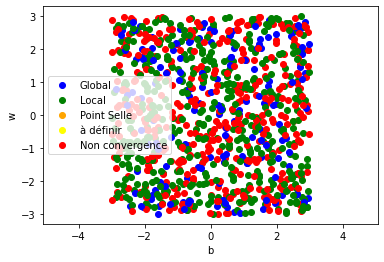

In [47]:
code=["blue", "green", "orange","yellow", "red"]
sign=["Global", "Local", "Point Selle", "à définir", "Non convergence"]
for i in range(len(sign)):
  plt.scatter(WEIGHTS_INIT[i][0], WEIGHTS_INIT[i][1],color=code[i], label=sign[i])
for i in range(Nb_tirages-1):
    plt.scatter(WEIGHTS_INIT[i][0], WEIGHTS_INIT[i][1],color=code[res[i]])
plt.legend()
plt.xlabel("b")
plt.ylabel("w")
plt.axis('equal')
plt.show()